## Germany PV Cut Scenario with 130 €/t CO2 price

In [80]:
import pypsa 
import matplotlib.pyplot as plt
plt.style.use("bmh")
import pandas as pd
from pypsa.plot import add_legend_patches
import gurobipy
import cartopy.crs as ccrs
from pypsa.optimization import optimize
import matplotlib.cm as cm
import numpy as np
import os

pd.set_option("display.max_rows", None)  # Display all rows
pd.set_option("display.max_columns", None)  # Display all columns


## Import Network

In [166]:
n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\elec_s_20_ec_lv1.5_3h.nc")
n.name = 'base'

INFO:pypsa.io:Imported network elec_s_20_ec_lv1.5_3h.nc has buses, carriers, generators, global_constraints, lines, links, loads, storage_units


In [167]:
# add co2price
co2_price = 130 #€/t

for index in n.generators.index:
    emission = n.carriers.co2_emissions.filter(like= n.generators.carrier[index]) #t/MWh_th
    n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3184507867.py:6: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  n.generators.at[index,'marginal_cost'] = n.generators.at[index,'marginal_cost'] + (emission * co2_price/n.generators.at[index,'efficiency']) # €/MWhel


In [168]:
for c in n.iterate_components(list(n.components.keys())[2:]):
    print("Component '{}' has {} entries".format(c.name,len(c.df)))

Component 'Bus' has 20 entries
Component 'Carrier' has 21 entries
Component 'GlobalConstraint' has 1 entries
Component 'Line' has 27 entries
Component 'LineType' has 34 entries
Component 'TransformerType' has 14 entries
Component 'Link' has 28 entries
Component 'Load' has 20 entries
Component 'Generator' has 261 entries
Component 'StorageUnit' has 65 entries


In [169]:
#remove nuclear fleet from germany
n.generators.loc[n.generators.index.str.startswith('DE') & n.generators.index.str.endswith('nuclear'), 'p_nom'] = 0


In [170]:
# set marginal cost of load shedding to 3000€/MWh
for bus in n.generators.bus:
    for index in n.generators.index:
        if not bus.endswith('H2') and index.endswith('load'):
            n.generators.loc[index, 'marginal_cost'] = 3000

#edit load shedding's unit from kW to MW
for index in n.generators.index:
    if index.endswith('load') and not index.endswith('H2 load'):
        n.generators.loc[index, 'sign'] = 1

In [171]:
#solve network
n.optimize(solver_name='gurobi')
#n = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\PV Cut\\20240511\\base.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.19it/s]
INFO:linopy.io: Writing time: 39.0s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhav51lx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhav51lx.lp


Reading time = 11.11 seconds


INFO:gurobipy:Reading time = 11.11 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x61697209


INFO:gurobipy:Model fingerprint: 0x61697209


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e-02, 1e+03]


INFO:gurobipy:  Matrix range     [1e-02, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns (presolve time = 5s) ...


Presolve removed 2121745 rows and 372364 columns


INFO:gurobipy:Presolve removed 2121745 rows and 372364 columns


Presolve time: 6.25s


INFO:gurobipy:Presolve time: 6.25s


Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:Presolved: 1143118 rows, 1149138 columns, 3794406 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.04s


INFO:gurobipy:Ordering time: 14.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 181


INFO:gurobipy: Dense cols : 181


 AA' NZ     : 4.035e+06


INFO:gurobipy: AA' NZ     : 4.035e+06


 Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


INFO:gurobipy: Factor NZ  : 2.941e+07 (roughly 1.2 GB of memory)


 Factor Ops : 6.354e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 6.354e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


INFO:gurobipy:   0   6.31157124e+17 -8.63354864e+18  2.85e+10 9.06e+04  8.83e+13    25s


   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    26s


INFO:gurobipy:   1   5.51458664e+17 -3.71126918e+18  1.77e+10 3.08e+04  5.63e+13    26s


   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    28s


INFO:gurobipy:   2   4.54011429e+17 -1.88917555e+18  1.41e+10 1.23e+04  3.89e+13    28s


   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    31s


INFO:gurobipy:   3   3.43180565e+17 -1.41946105e+18  9.28e+09 7.90e+03  2.50e+13    31s


   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    33s


INFO:gurobipy:   4   2.83738437e+17 -7.56568029e+17  4.86e+09 2.98e+03  1.25e+13    33s


   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    34s


INFO:gurobipy:   5   2.26118710e+17 -2.64872401e+17  1.84e+09 7.83e+02  4.50e+12    34s


   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    36s


INFO:gurobipy:   6   1.35222323e+17 -5.53237846e+16  4.83e+08 1.16e+02  1.15e+12    36s


   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    39s


INFO:gurobipy:   7   2.28256107e+16 -8.54538102e+15  6.64e+06 2.19e+00  2.73e+10    39s


   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    41s


INFO:gurobipy:   8   2.91979562e+15 -1.32124122e+15  7.02e+05 1.29e-01  3.12e+09    41s


   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    42s


INFO:gurobipy:   9   1.61348842e+15 -8.30010086e+14  3.60e+05 6.04e-02  1.66e+09    42s


  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    44s


INFO:gurobipy:  10   1.35911604e+15 -5.59390786e+14  2.97e+05 3.24e-02  1.29e+09    44s


  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    46s


INFO:gurobipy:  11   7.75630251e+14 -3.53498737e+14  1.61e+05 1.54e-02  7.18e+08    46s


  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    47s


INFO:gurobipy:  12   6.10073702e+14 -1.38289402e+14  1.22e+05 1.48e-03  4.67e+08    47s


  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    49s


INFO:gurobipy:  13   3.97725550e+14 -6.93846975e+13  7.53e+04 6.60e-05  2.74e+08    49s


  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    52s


INFO:gurobipy:  14   1.81848850e+14 -2.93036011e+13  2.78e+04 1.28e-04  1.14e+08    52s


  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    54s


INFO:gurobipy:  15   4.63160681e+13 -1.13997956e+13  2.09e+03 2.81e-05  2.84e+07    54s


  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    55s


INFO:gurobipy:  16   1.82917956e+13 -8.31382949e+12  8.01e+02 1.94e-05  1.24e+07    55s


  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    57s


INFO:gurobipy:  17   1.10627860e+13 -6.91851544e+12  4.81e+02 1.47e-05  8.16e+06    57s


  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    59s


INFO:gurobipy:  18   7.96947901e+12 -6.30291485e+12  3.50e+02 1.20e-05  6.37e+06    59s


  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    61s


INFO:gurobipy:  19   4.58792449e+12 -4.72300730e+12  1.95e+02 8.55e-06  4.03e+06    61s


  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    63s


INFO:gurobipy:  20   2.74552537e+12 -4.49619093e+12  1.16e+02 8.15e-06  3.07e+06    63s


  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    66s


INFO:gurobipy:  21   1.62406758e+12 -3.03273530e+12  5.93e+01 5.46e-06  1.93e+06    66s


  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    68s


INFO:gurobipy:  22   1.04086591e+12 -2.06170517e+12  3.52e+01 3.76e-06  1.27e+06    68s


  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    71s


INFO:gurobipy:  23   6.41931981e+11 -1.52095841e+12  1.90e+01 2.84e-06  8.77e+05    71s


  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    73s


INFO:gurobipy:  24   4.38837530e+11 -1.01386303e+12  1.10e+01 2.00e-06  5.86e+05    73s


  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    75s


INFO:gurobipy:  25   4.29500145e+11 -9.40410895e+11  1.07e+01 1.87e-06  5.52e+05    75s


  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    76s


INFO:gurobipy:  26   3.15933489e+11 -5.91600951e+11  6.96e+00 1.20e-06  3.65e+05    76s


  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    78s


INFO:gurobipy:  27   2.43461664e+11 -3.06974439e+11  4.73e+00 6.56e-07  2.21e+05    78s


  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    81s


INFO:gurobipy:  28   1.81568049e+11 -2.01432424e+11  2.97e+00 4.63e-07  1.53e+05    81s


  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    84s


INFO:gurobipy:  29   1.47688052e+11 -3.25756298e+10  2.07e+00 1.49e-07  7.22e+04    84s


  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    86s


INFO:gurobipy:  30   1.16305615e+11  3.78568294e+09  1.33e+00 8.45e-08  4.50e+04    86s


  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    89s


INFO:gurobipy:  31   1.06934615e+11  1.53041595e+10  1.12e+00 6.31e-08  3.67e+04    89s


  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    92s


INFO:gurobipy:  32   1.04032349e+11  2.16699393e+10  1.06e+00 5.23e-08  3.29e+04    92s


  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    94s


INFO:gurobipy:  33   9.69853961e+10  2.64807408e+10  9.03e-01 4.35e-08  2.82e+04    94s


  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04    97s


INFO:gurobipy:  34   8.79203368e+10  2.99054913e+10  7.18e-01 3.95e-08  2.32e+04    97s


  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   100s


INFO:gurobipy:  35   8.20614197e+10  3.44994763e+10  5.99e-01 3.01e-08  1.90e+04   100s


  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   104s


INFO:gurobipy:  36   7.75405160e+10  3.89908811e+10  5.05e-01 2.22e-08  1.54e+04   104s


  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   107s


INFO:gurobipy:  37   7.23921699e+10  4.17940448e+10  3.99e-01 1.96e-08  1.22e+04   107s


  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   111s


INFO:gurobipy:  38   6.77117200e+10  4.44347006e+10  2.98e-01 1.52e-08  9.31e+03   111s


  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   114s


INFO:gurobipy:  39   6.49658757e+10  4.63008898e+10  2.39e-01 1.03e-08  7.46e+03   114s


  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   118s


INFO:gurobipy:  40   6.24770146e+10  4.83234493e+10  1.85e-01 9.42e-09  5.66e+03   118s


  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   121s


INFO:gurobipy:  41   6.15383370e+10  4.94934328e+10  1.66e-01 6.34e-09  4.82e+03   121s


  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   125s


INFO:gurobipy:  42   5.98720565e+10  5.04034990e+10  1.32e-01 4.55e-09  3.79e+03   125s


  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   128s


INFO:gurobipy:  43   5.88434754e+10  5.10195734e+10  1.10e-01 3.97e-09  3.13e+03   128s


  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   132s


INFO:gurobipy:  44   5.77190189e+10  5.15753594e+10  8.67e-02 3.23e-09  2.46e+03   132s


  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   135s


INFO:gurobipy:  45   5.67929840e+10  5.19043347e+10  6.71e-02 3.19e-09  1.95e+03   135s


  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   138s


INFO:gurobipy:  46   5.63532644e+10  5.20774182e+10  5.81e-02 8.54e-09  1.71e+03   138s


  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   141s


INFO:gurobipy:  47   5.58355045e+10  5.23522070e+10  4.72e-02 3.12e-08  1.39e+03   141s


  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   144s


INFO:gurobipy:  48   5.56260213e+10  5.25602548e+10  4.31e-02 5.61e-08  1.23e+03   144s


  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   147s


INFO:gurobipy:  49   5.54710674e+10  5.26135160e+10  4.00e-02 6.41e-08  1.14e+03   147s


  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   150s


INFO:gurobipy:  50   5.53559062e+10  5.27013815e+10  3.76e-02 7.14e-08  1.06e+03   150s


  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   153s


INFO:gurobipy:  51   5.51806220e+10  5.27552818e+10  3.37e-02 7.59e-08  9.70e+02   153s


  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   156s


INFO:gurobipy:  52   5.49807490e+10  5.28632526e+10  2.97e-02 9.08e-08  8.47e+02   156s


  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   160s


INFO:gurobipy:  53   5.48689410e+10  5.29293571e+10  2.73e-02 9.87e-08  7.76e+02   160s


  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   164s


INFO:gurobipy:  54   5.47269476e+10  5.30280365e+10  2.43e-02 1.12e-07  6.79e+02   164s


  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   167s


INFO:gurobipy:  55   5.45884440e+10  5.31069918e+10  2.15e-02 1.20e-07  5.92e+02   167s


  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   170s


INFO:gurobipy:  56   5.44171176e+10  5.31676257e+10  1.79e-02 1.30e-07  5.00e+02   170s


  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   173s


INFO:gurobipy:  57   5.42802549e+10  5.32359772e+10  1.50e-02 1.35e-07  4.18e+02   173s


  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   177s


INFO:gurobipy:  58   5.41063097e+10  5.32603856e+10  1.15e-02 1.34e-07  3.38e+02   177s


  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   180s


INFO:gurobipy:  59   5.39932143e+10  5.33052204e+10  9.18e-03 1.34e-07  2.75e+02   180s


  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   183s


INFO:gurobipy:  60   5.39091711e+10  5.33312836e+10  7.47e-03 1.33e-07  2.31e+02   183s


  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   186s


INFO:gurobipy:  61   5.38574914e+10  5.33410201e+10  6.42e-03 1.31e-07  2.07e+02   186s


  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   189s


INFO:gurobipy:  62   5.38264688e+10  5.33653237e+10  5.78e-03 1.25e-07  1.84e+02   189s


  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   192s


INFO:gurobipy:  63   5.37630379e+10  5.34016462e+10  4.49e-03 1.23e-07  1.45e+02   192s


  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   195s


INFO:gurobipy:  64   5.37322524e+10  5.34193020e+10  3.87e-03 1.18e-07  1.25e+02   195s


  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   197s


INFO:gurobipy:  65   5.37186713e+10  5.34322797e+10  3.59e-03 1.14e-07  1.15e+02   197s


  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   199s


INFO:gurobipy:  66   5.37104631e+10  5.34393334e+10  3.43e-03 1.12e-07  1.08e+02   199s


  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   202s


INFO:gurobipy:  67   5.36751064e+10  5.34568664e+10  2.73e-03 1.07e-07  8.73e+01   202s


  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   205s


INFO:gurobipy:  68   5.36626366e+10  5.34678003e+10  2.48e-03 1.01e-07  7.79e+01   205s


  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   208s


INFO:gurobipy:  69   5.36439509e+10  5.34785249e+10  2.11e-03 9.61e-08  6.61e+01   208s


  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   211s


INFO:gurobipy:  70   5.36278603e+10  5.34831749e+10  1.80e-03 9.29e-08  5.79e+01   211s


  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   213s


INFO:gurobipy:  71   5.36104318e+10  5.34926503e+10  1.46e-03 8.39e-08  4.71e+01   213s


  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   216s


INFO:gurobipy:  72   5.36049844e+10  5.35038623e+10  1.35e-03 6.88e-08  4.04e+01   216s


  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   219s


INFO:gurobipy:  73   5.35961792e+10  5.35067579e+10  1.18e-03 6.61e-08  3.58e+01   219s


  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   222s


INFO:gurobipy:  74   5.35824492e+10  5.35108135e+10  9.19e-04 5.97e-08  2.86e+01   222s


  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   225s


INFO:gurobipy:  75   5.35747358e+10  5.35144237e+10  7.71e-04 5.24e-08  2.41e+01   225s


  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   228s


INFO:gurobipy:  76   5.35691941e+10  5.35177526e+10  6.65e-04 4.47e-08  2.06e+01   228s


  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   231s


INFO:gurobipy:  77   5.35626827e+10  5.35209379e+10  5.40e-04 3.87e-08  1.67e+01   231s


  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   234s


INFO:gurobipy:  78   5.35570911e+10  5.35231066e+10  4.34e-04 3.61e-08  1.36e+01   234s


  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   237s


INFO:gurobipy:  79   5.35542979e+10  5.35241419e+10  3.89e-04 3.44e-08  1.21e+01   237s


  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   240s


INFO:gurobipy:  80   5.35509802e+10  5.35257093e+10  3.85e-04 3.15e-08  1.01e+01   240s


  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   243s


INFO:gurobipy:  81   5.35471903e+10  5.35271543e+10  2.50e-04 2.78e-08  8.01e+00   243s


  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   246s


INFO:gurobipy:  82   5.35455600e+10  5.35287158e+10  2.19e-04 2.43e-08  6.74e+00   246s


  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   249s


INFO:gurobipy:  83   5.35430624e+10  5.35299004e+10  1.74e-04 2.15e-08  5.26e+00   249s


  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   252s


INFO:gurobipy:  84   5.35408063e+10  5.35306991e+10  1.34e-04 1.92e-08  4.04e+00   252s


  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   255s


INFO:gurobipy:  85   5.35388751e+10  5.35314543e+10  1.43e-04 1.68e-08  2.97e+00   255s


  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   258s


INFO:gurobipy:  86   5.35376069e+10  5.35321339e+10  1.89e-04 1.52e-08  2.19e+00   258s


  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   260s


INFO:gurobipy:  87   5.35363642e+10  5.35324977e+10  1.34e-04 1.43e-08  1.55e+00   260s


  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   263s


INFO:gurobipy:  88   5.35355949e+10  5.35328659e+10  1.77e-04 1.29e-08  1.09e+00   263s


  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   266s


INFO:gurobipy:  89   5.35350122e+10  5.35330886e+10  1.11e-04 1.03e-08  7.69e-01   266s


  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   269s


INFO:gurobipy:  90   5.35344997e+10  5.35331733e+10  1.51e-04 1.08e-08  5.30e-01   269s


  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   272s


INFO:gurobipy:  91   5.35343985e+10  5.35333935e+10  1.35e-04 1.16e-08  4.02e-01   272s


  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   276s


INFO:gurobipy:  92   5.35342500e+10  5.35334851e+10  9.55e-05 1.31e-08  3.06e-01   276s


  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   279s


INFO:gurobipy:  93   5.35339605e+10  5.35335730e+10  3.64e-05 7.63e-09  1.55e-01   279s


  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   283s


INFO:gurobipy:  94   5.35338792e+10  5.35336410e+10  2.26e-05 5.16e-09  9.52e-02   283s


  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   286s


INFO:gurobipy:  95   5.35338569e+10  5.35336962e+10  1.89e-05 3.19e-09  6.42e-02   286s


  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   289s


INFO:gurobipy:  96   5.35338125e+10  5.35337044e+10  1.15e-05 2.86e-09  4.32e-02   289s


  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   292s


INFO:gurobipy:  97   5.35338104e+10  5.35337065e+10  1.12e-05 2.76e-09  4.16e-02   292s


  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   294s


INFO:gurobipy:  98   5.35338011e+10  5.35337099e+10  9.63e-06 2.59e-09  3.65e-02   294s


  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   296s


INFO:gurobipy:  99   5.35337951e+10  5.35337139e+10  8.68e-06 2.36e-09  3.25e-02   296s


 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   298s


INFO:gurobipy: 100   5.35337853e+10  5.35337193e+10  7.06e-06 2.04e-09  2.64e-02   298s


 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   300s


INFO:gurobipy: 101   5.35337804e+10  5.35337306e+10  6.30e-06 1.58e-09  1.99e-02   300s


 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   303s


INFO:gurobipy: 102   5.35337627e+10  5.35337336e+10  3.48e-06 1.72e-09  1.17e-02   303s


 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   306s


INFO:gurobipy: 103   5.35337597e+10  5.35337343e+10  3.00e-06 1.22e-09  1.02e-02   306s


 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   308s


INFO:gurobipy: 104   5.35337572e+10  5.35337369e+10  2.59e-06 2.33e-09  8.12e-03   308s


 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   311s


INFO:gurobipy: 105   5.35337495e+10  5.35337379e+10  1.42e-06 1.24e-09  4.66e-03   311s


 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   314s


INFO:gurobipy: 106   5.35337475e+10  5.35337388e+10  1.10e-06 2.71e-09  3.48e-03   314s


 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   316s


INFO:gurobipy: 107   5.35337437e+10  5.35337395e+10  1.86e-04 1.70e-09  1.68e-03   316s


 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   318s


INFO:gurobipy: 108   5.35337422e+10  5.35337398e+10  1.08e-04 1.85e-09  9.59e-04   318s


 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   320s


INFO:gurobipy: 109   5.35337417e+10  5.35337400e+10  7.86e-05 7.15e-09  6.65e-04   320s


 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   323s


INFO:gurobipy: 110   5.35337405e+10  5.35337401e+10  1.80e-05 3.02e-09  1.64e-04   323s


 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   325s


INFO:gurobipy: 111   5.35337402e+10  5.35337401e+10  1.35e-05 1.88e-09  5.15e-05   325s


 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   326s


INFO:gurobipy: 112   5.35337402e+10  5.35337401e+10  6.87e-06 3.46e-09  1.07e-05   326s


 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   328s


INFO:gurobipy: 113   5.35337401e+10  5.35337401e+10  2.17e-06 2.66e-09  1.68e-06   328s


 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   330s


INFO:gurobipy: 114   5.35337401e+10  5.35337401e+10  8.82e-07 3.18e-09  5.97e-07   330s


 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   332s


INFO:gurobipy: 115   5.35337401e+10  5.35337401e+10  5.19e-07 2.19e-08  3.95e-08   332s


 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   334s


INFO:gurobipy: 116   5.35337401e+10  5.35337401e+10  5.49e-09 2.19e-08  6.53e-11   334s


INFO:gurobipy:


Barrier solved model in 116 iterations and 333.64 seconds (111.79 work units)


INFO:gurobipy:Barrier solved model in 116 iterations and 333.64 seconds (111.79 work units)


Optimal objective 5.35337401e+10


INFO:gurobipy:Optimal objective 5.35337401e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  458079 variables added to crossover basis                      337s


INFO:gurobipy:  458079 variables added to crossover basis                      337s


  560746 variables added to crossover basis                      340s


INFO:gurobipy:  560746 variables added to crossover basis                      340s


  564880 variables added to crossover basis                      345s


INFO:gurobipy:  564880 variables added to crossover basis                      345s


  567417 variables added to crossover basis                      350s


INFO:gurobipy:  567417 variables added to crossover basis                      350s


  569213 variables added to crossover basis                      355s


INFO:gurobipy:  569213 variables added to crossover basis                      355s


  570863 variables added to crossover basis                      360s


INFO:gurobipy:  570863 variables added to crossover basis                      360s


  572311 variables added to crossover basis                      365s


INFO:gurobipy:  572311 variables added to crossover basis                      365s


  573541 variables added to crossover basis                      370s


INFO:gurobipy:  573541 variables added to crossover basis                      370s


  574944 variables added to crossover basis                      375s


INFO:gurobipy:  574944 variables added to crossover basis                      375s


  576112 variables added to crossover basis                      380s


INFO:gurobipy:  576112 variables added to crossover basis                      380s


  577250 variables added to crossover basis                      385s


INFO:gurobipy:  577250 variables added to crossover basis                      385s


  578234 variables added to crossover basis                      390s


INFO:gurobipy:  578234 variables added to crossover basis                      390s


  579247 variables added to crossover basis                      395s


INFO:gurobipy:  579247 variables added to crossover basis                      395s


  580174 variables added to crossover basis                      400s


INFO:gurobipy:  580174 variables added to crossover basis                      400s


  580979 variables added to crossover basis                      405s


INFO:gurobipy:  580979 variables added to crossover basis                      405s


  581873 variables added to crossover basis                      410s


INFO:gurobipy:  581873 variables added to crossover basis                      410s


  582675 variables added to crossover basis                      415s


INFO:gurobipy:  582675 variables added to crossover basis                      415s


INFO:gurobipy:


  560354 DPushes remaining with DInf 0.0000000e+00               416s


INFO:gurobipy:  560354 DPushes remaining with DInf 0.0000000e+00               416s


   93302 DPushes remaining with DInf 0.0000000e+00               534s


INFO:gurobipy:   93302 DPushes remaining with DInf 0.0000000e+00               534s


   12132 DPushes remaining with DInf 0.0000000e+00               558s


INFO:gurobipy:   12132 DPushes remaining with DInf 0.0000000e+00               558s


    1486 DPushes remaining with DInf 0.0000000e+00               571s


INFO:gurobipy:    1486 DPushes remaining with DInf 0.0000000e+00               571s


     130 DPushes remaining with DInf 0.0000000e+00               583s


INFO:gurobipy:     130 DPushes remaining with DInf 0.0000000e+00               583s


       0 DPushes remaining with DInf 0.0000000e+00               586s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               586s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


    5624 PPushes remaining with PInf 0.0000000e+00               587s


INFO:gurobipy:    5624 PPushes remaining with PInf 0.0000000e+00               587s


    3969 PPushes remaining with PInf 0.0000000e+00               598s


INFO:gurobipy:    3969 PPushes remaining with PInf 0.0000000e+00               598s


    3567 PPushes remaining with PInf 0.0000000e+00               605s


INFO:gurobipy:    3567 PPushes remaining with PInf 0.0000000e+00               605s


    1845 PPushes remaining with PInf 0.0000000e+00               606s


INFO:gurobipy:    1845 PPushes remaining with PInf 0.0000000e+00               606s


       0 PPushes remaining with PInf 0.0000000e+00               607s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               607s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    608s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 2.5288307e-06    608s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  313088    5.3533740e+10   0.000000e+00   2.514331e-06    609s


INFO:gurobipy:  313088    5.3533740e+10   0.000000e+00   2.514331e-06    609s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


  313095    5.3533740e+10   0.000000e+00   0.000000e+00    618s


INFO:gurobipy:  313095    5.3533740e+10   0.000000e+00   0.000000e+00    618s


INFO:gurobipy:


Solved in 313095 iterations and 617.81 seconds (314.18 work units)


INFO:gurobipy:Solved in 313095 iterations and 617.81 seconds (314.18 work units)


Optimal objective  5.353374014e+10


INFO:gurobipy:Optimal objective  5.353374014e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 5.35e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [172]:
#dir = os.getcwd()
#file = "base.nc"
#output_path = os.path.join(dir, file)

#n.export_to_netcdf(output_path)

In [173]:
def system_cost(n): #n.statistics.capex()
    stat = n.statistics()
    tsc = stat['Capital Expenditure'] + stat['Operational Expenditure']
    return tsc.droplevel(0).div(1e6) # million €/a

In [174]:
tot_cos_base=n.objective/1e9
system_cost_base = system_cost(n)
marg_price_region_base = n.buses_t.marginal_price.mean()
stat_base = n.statistics()

## Plot Network

<function matplotlib.pyplot.show(close=None, block=None)>

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '
c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


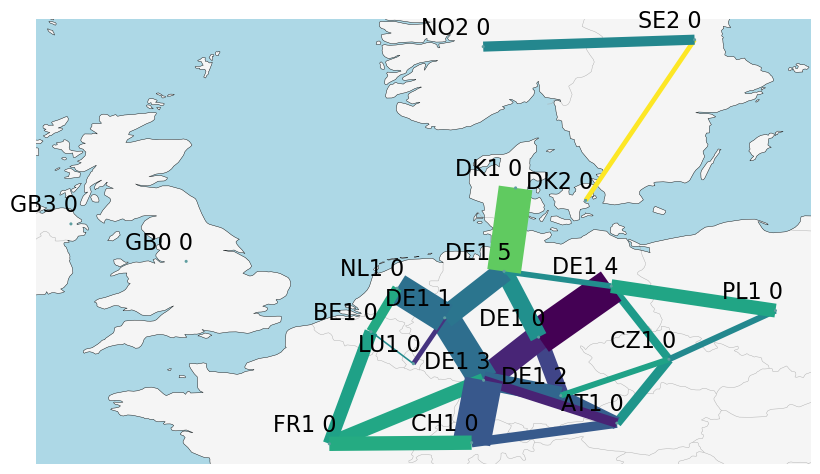

In [175]:
loading = (n.lines_t.p0.abs().mean().sort_index()/(n.lines.s_nom_opt*n.lines.s_max_pu).sort_index()).fillna(0.)

fig, ax = plt.subplots(
    figsize=(10,10),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

n.plot(
    ax=ax,
    branch_components=["Line"],
    line_widths=n.lines.s_nom_opt/1e3, #GW
    line_colors=loading,
    line_cmap=plt.cm.viridis,
    color_geomap=True,
    bus_sizes=0.003
)

bus = n.buses
region = []
for index, row in bus.iterrows():
    x = row['x']
    y = row['y']
    if "H2" in index:
        pass
    else:
        region.append(index)
        ax.annotate(
        index,
        xy=(x, y),
        xytext=(5, 5),  # Adjust the position of the annotation
        textcoords="offset points",
        ha='right', va='bottom'
    )

plt.show


## Installed Capacity Map Plot

In [176]:
#color list for installed cap
tech_list = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
tech_list.remove('load')
color_cap = []

for i in range(len(tech_list)):
    for j in range(len(n.carriers.index)):
        if tech_list[i] == n.carriers.index[j]:
            color_cap.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

cap = n.generators[n.generators['carrier']!='load'].groupby(['bus', 'carrier']).p_nom_opt.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3847545614.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_cap.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


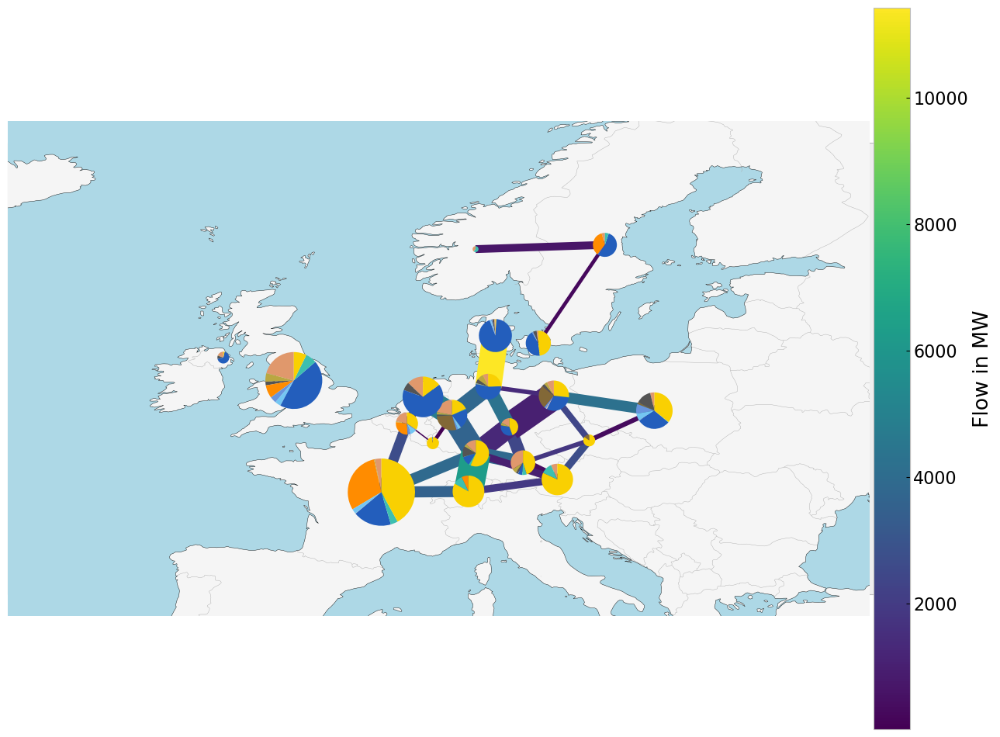

In [177]:
fig, ax = plt.subplots(
    figsize=(15,15),
    subplot_kw={"projection": ccrs.PlateCarree()}
)

collection = n.plot(
    bus_sizes=cap / 5e4,
    bus_colors = color_cap,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
        
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Generation Map Plot

In [178]:
#color list for energy generated 
tech_list_gen_table = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().unstack().columns.tolist()
colors_gen_table = []

for i in range(len(tech_list_gen_table)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen_table[i] == n.carriers.index[j]:
            colors_gen_table.append(n.carriers.color[j])
            break  # break the inner loop once a match is found 

#Adjust Load shedding's unit to MW from kW
#for column in n.generators_t.p.columns:
#    if column.endswith('load') and not column.endswith('H2 load'):
#        n.generators_t.p[column]/=1e3
        

gen = n.generators.assign(g=n.generators_t.p.mean()).groupby(["bus", "carrier"]).g.sum()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\971004373.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen_table.append(n.carriers.color[j])


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


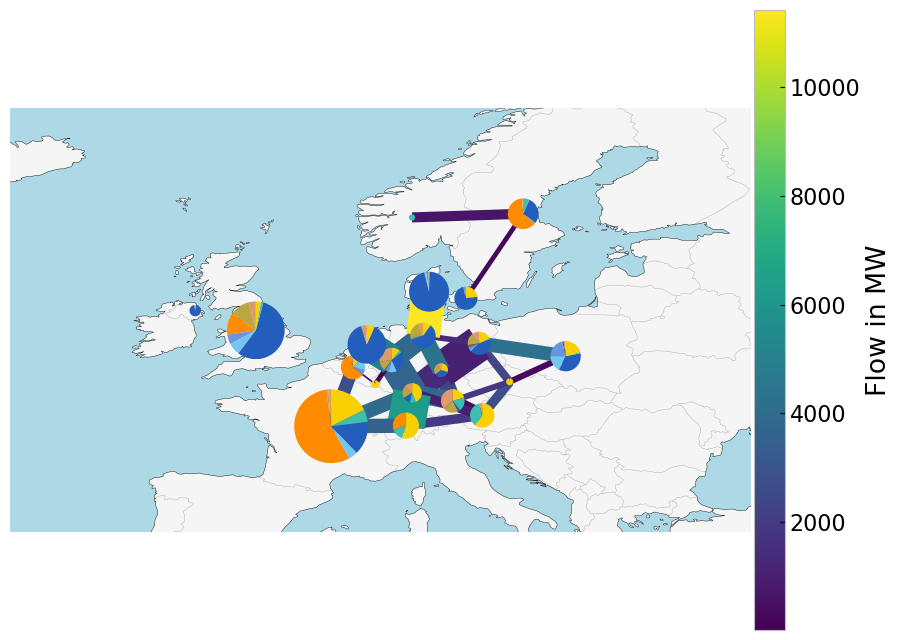

In [179]:
carriers = n.generators.carrier.unique()

plt.figure(figsize =(10,10))

collection = n.plot(
    bus_sizes=gen / 1e4,
    bus_colors = colors_gen_table,
    margin=0.5,
    #flow="mean",
    line_widths=n.lines.s_nom_opt/1e3, #GW
    link_widths=0,
    color_geomap=True,
    line_colors=n.lines_t.p0.mean().abs(),
)
plt.colorbar(collection[2], fraction=0.04, pad=0.004, label="Flow in MW")
plt.show()

## Installed Capacity

<Figure size 640x480 with 0 Axes>

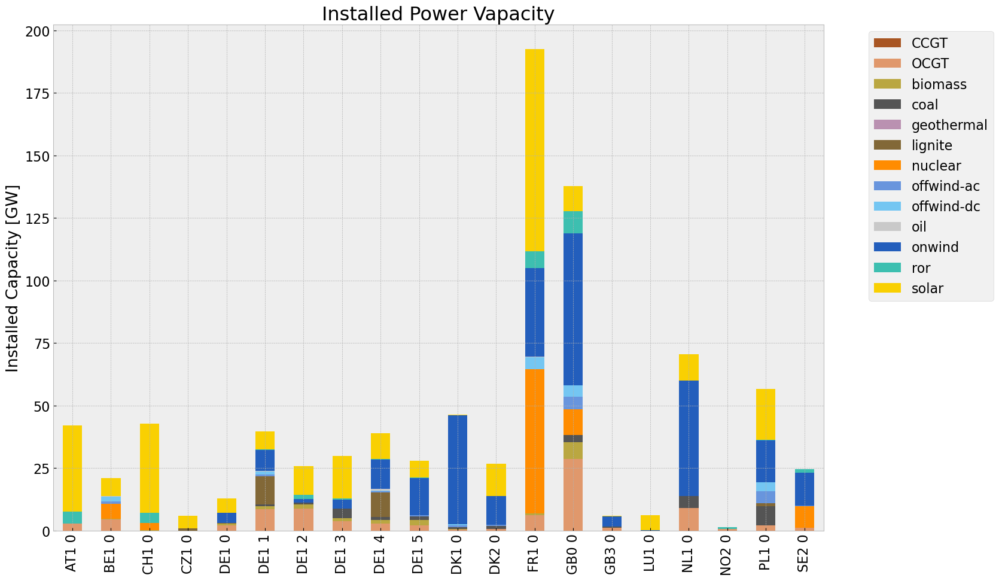

In [180]:
def inst_cap_table(n,colors):

    capacities = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Vapacity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_installed_cap.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    plt.show()

    

    return capacities

# consolidated istalled cap without load_shedding

#capacities_base = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_base.fillna(0, inplace=True)
#gen = (capacities_base.unstack()/1000).drop(columns=['load'],inplace=False)

capacities_base = inst_cap_table(n, color_cap)

<Figure size 640x480 with 0 Axes>

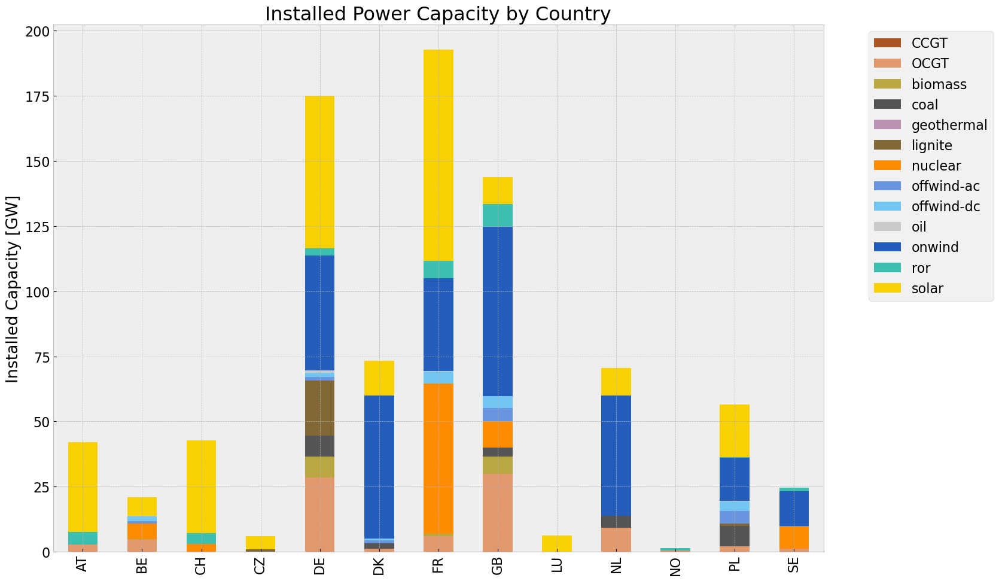

In [181]:
#aggregate installed capacities by country
def inst_cap_table_country(n,colors):
    
    model = n
    capacities = model.generators
    capacities['country'] = capacities['bus'].str[:2]
    capacities = capacities.groupby(['country', 'carrier']).p_nom_opt.sum()
    capacities.fillna(0, inplace=True)
    gen = (capacities.unstack()/1000).drop(columns=['load'],inplace=False)
    gen.fillna(0, inplace=True)

    plt.figure()
    plt.rcParams.update({'font.size': 16})

    gen.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=colors,
                                grid=True,
                                xlabel="",
                                ylabel="Installed Capacity [GW]",
                                title=f"Installed Power Capacity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_installed_cap_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()
    
     

    return gen

cap_base_country= inst_cap_table_country(n, color_cap)

## Generation

<Figure size 640x480 with 0 Axes>

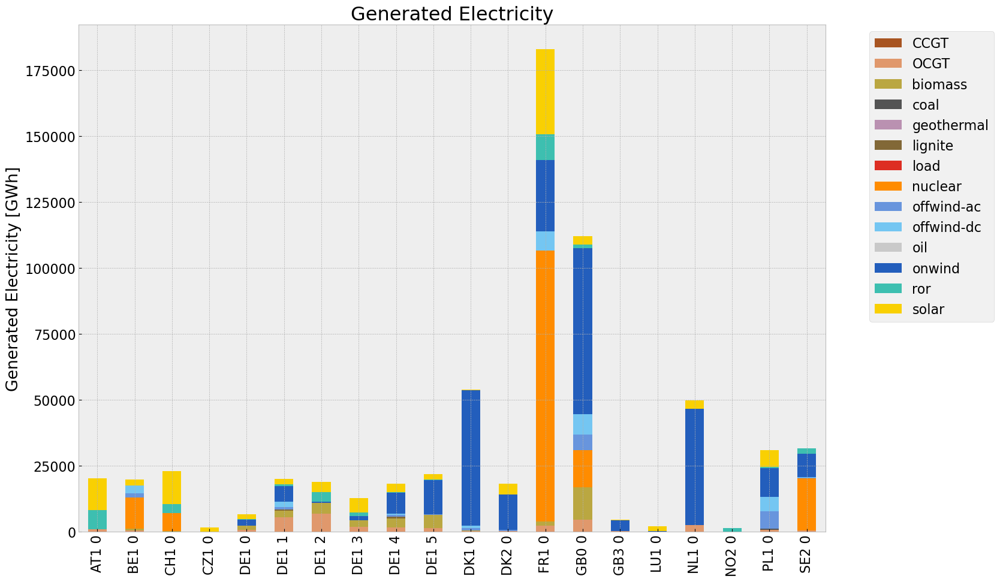

In [182]:
def gen_power_table(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

     # Save plot to the current working directory
    filename = f"{n.name}_gen_elec.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)

    plt.show()

    

    return generations

gen_base = gen_power_table(n,colors_gen_table)

<Figure size 640x480 with 0 Axes>

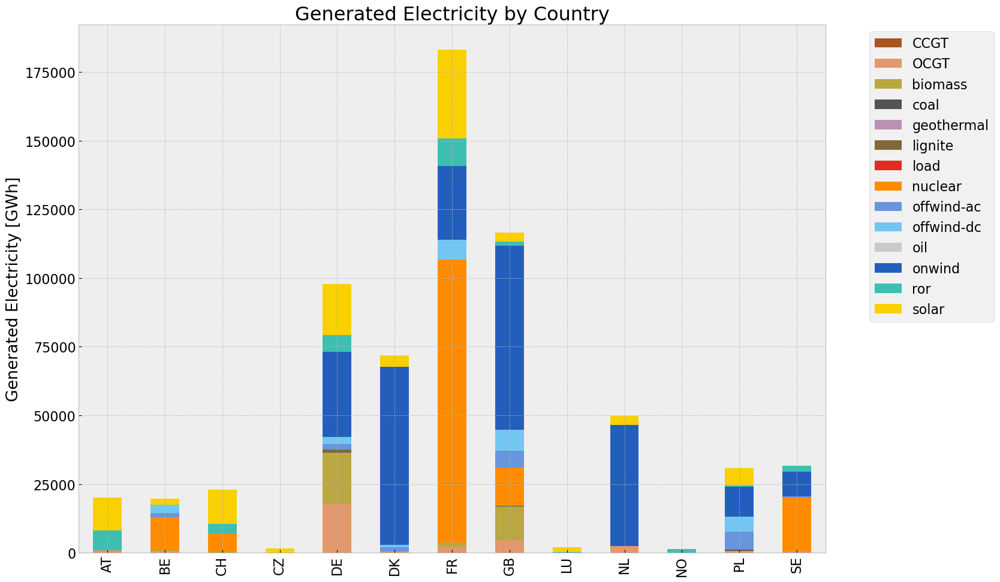

In [183]:
def gen_power_table_country(n, color):

    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    #generations = n.generators
    #generations['country'] = generations['bus'].str[:2]
    #generations = pd.Series(index = n.generators.groupby(['country', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack()/1000)#GWh
    generations['country'] = generations.index.str[:2]
    generations = generations.groupby(['country']).sum()   
    #generations['load']/=1e3


    plt.figure()
    plt.rcParams.update({'font.size': 16})

    generations.plot.bar(figsize=(17,10),
                                stacked=True,
                                color=color,
                                grid=True,
                                xlabel="",
                                ylabel="Generated Electricity [GWh]",
                                title=f"Generated Electricity by Country"
    )
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # Save plot to the current working directory
    filename = f"{n.name}_gen_elec_country.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    plt.show()
    return generations

gen_base_country = gen_power_table_country(n,colors_gen_table)

## Snapshot

In [184]:
sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()

#links = n.links_t.p0.groupby(n.links.carrier, axis =1).sum().drop(['DC','H2 electrolysis'], axis=1, inplace =False).head()
tech_list_gen = pd.concat([tech_list_gen, sto], axis=1).columns.tolist()

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\318663498.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\318663498.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  tech_list_gen = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum()


In [185]:
colors_gen = []

for i in range(len(tech_list_gen)):
    for j in range(len(n.carriers.index)):
        if tech_list_gen[i] == n.carriers.index[j]:
            colors_gen.append(n.carriers.color[j])
            break  # break the inner loop once a match is found  

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\4040974225.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_gen.append(n.carriers.color[j])


In [186]:
def gen_curve(n, start, end, colors,ctr):

    plt.rcParams.update({'font.size': 16})

    #import export 
    lines_ctr_bus0 = n.lines[n.lines['bus0'].str.startswith(ctr) & ~n.lines['bus1'].str.startswith(ctr)].index
    lines_ctr_bus1 = n.lines[n.lines['bus1'].str.startswith(ctr) & ~n.lines['bus0'].str.startswith(ctr)].index
    links_ctr_bus0 = n.links[n.links['bus0'].str.startswith(ctr) & ~n.links['bus1'].str.startswith(ctr)].index
    links_ctr_bus1 = n.links[n.links['bus1'].str.startswith(ctr) & ~n.links['bus0'].str.startswith(ctr)].index


    df_lines_ctr_bus0 = n.lines_t.p0[lines_ctr_bus0]
    df_lines_ctr_bus1 = n.lines_t.p1[lines_ctr_bus1]
    df_links_ctr_bus0 = n.links_t.p0[links_ctr_bus0]
    df_links_ctr_bus1 = n.links_t.p1[links_ctr_bus1]


    import_export = pd.concat([df_lines_ctr_bus0, df_lines_ctr_bus1, df_links_ctr_bus0, df_links_ctr_bus1], axis=1).sum(axis=1)*-1 #MW

    columns_gen = [col for col in  n.generators_t.p.columns if col.startswith(ctr)]
    p_country = n.generators_t.p[columns_gen]

    p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
    

    #add import color
    colors.append('#133337') #for Import

    #p_by_carrier['load'] /= 1e3

    #links fuel cell
    #links = n.links_t.p1.groupby(n.links.carrier, axis=1).sum().div(1e3)
    #links = links.drop(columns='DC', inplace=False)
    #links['H2 fuel cell']*=-1
       
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        col_sto = [col for col in  n.storage_units_t.p.columns if col.startswith(ctr)]
        sto_ctr = n.storage_units_t.p[col_sto]
        sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier['Import/Export'] = import_export 
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    col_load = [col for col in  n.loads_t.p_set.columns if col.startswith(ctr)]
    loads_ctr = n.loads_t.p_set[col_load]
    loads = loads_ctr.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")
    ax.set_ylim(-50,150)
    # Save plot to the current working directory
    fig.tight_layout()
    filename = f"{n.name}_gen_{start}_to_{end}.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)


    
    

In [187]:
#e_balance = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC",:].droplevel(2)
#e_balance.to_excel('energybalance.xlsx', index=True) 


In [188]:
#tes = n.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :].droplevel(2)
#tes.to_csv('energybalance.csv', index=True)

In [189]:
#n.loads_t.p_set.sum(axis=1).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].div(1e3).plot(ax=ax, c='k',grid=True)


In [190]:
#p_by_carrier.where(p_by_carrier>0).loc[pd.date_range(start='2013-01-08', end='2013-01-14', freq='3H')].sum(axis=1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\a

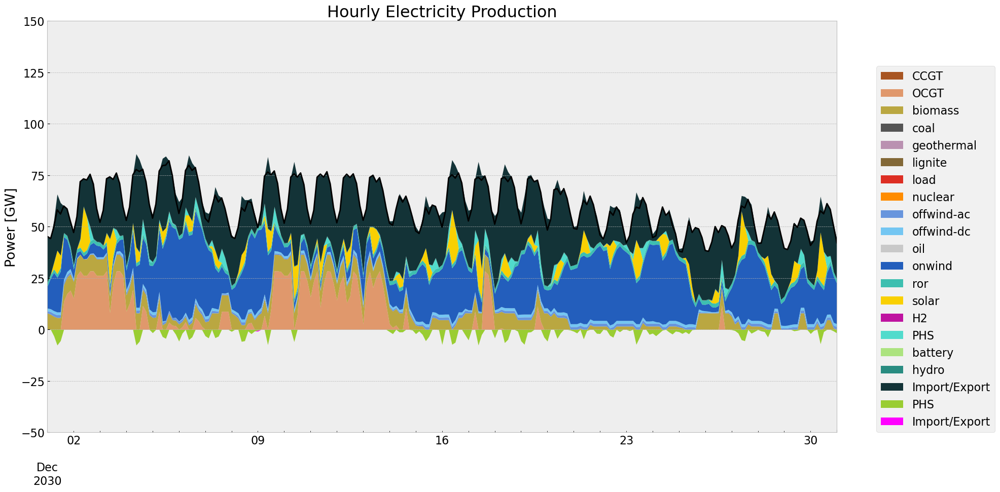

In [191]:
# winter
gen_curve(n, '2030-12-01', '2030-12-31', colors_gen,'DE')

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\a

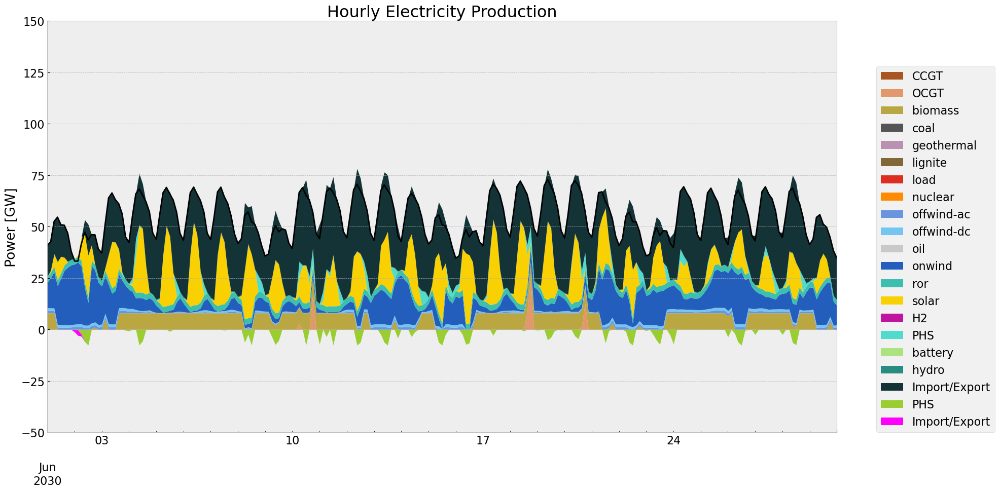

In [192]:
#summer
gen_curve(n, '2030-06-01', '2030-06-30', colors_gen,'DE')

In [193]:
def gen_curve_tot(n, start, end, colors):

    plt.rcParams.update({'font.size': 16})

    p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
    
    # join generator, lines, links, and storage unit
    if not n.storage_units.empty:
        sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW     
        p_by_carrier = pd.concat([p_by_carrier, sto], axis=1)
        p_by_carrier = p_by_carrier.div(1e3) #GW
        
    p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    start_date = start
    end_date = end
    
    # Create a date range for the specified time range
    time = pd.date_range(start=start_date, end=end_date, freq='3H')
    
    fig, ax = plt.subplots(figsize=(20, 10))
    
    #p_no_H = p_by_carrier.drop(columns = 'H2 electrolysis', inplace = False)
    p_by_carrier.where(p_by_carrier>0).loc[time].plot.area(
        ax=ax,
        linewidth=0,
        color=colors,
        grid=True,

    )
    
    charge = p_by_carrier.where(p_by_carrier<0).dropna(how='all', axis=1).loc[time]
    
    
    if not charge.empty:

        charge.plot.area(
            ax=ax,
            linewidth=0,
            color=["yellowgreen", "magenta", "purple", "grey"],
            grid=True,
        )
    
    loads = n.loads_t.p_set.sum(axis=1).div(1e3)
    loads.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
    
    loads.loc[time].plot(ax=ax, c='k',grid=True)


    plt.legend(loc=(1.05,0))
    ax.set_ylim(-50,370)
    fig.tight_layout()

    # Adjust the spacing around the plot (add extra space at the top)
    fig.subplots_adjust(top=0.95, right=0.85, left = 0.05)
    
    ax.set_ylabel("Power [GW]")
    ax.set_title(f"Hourly Electricity Production")

    filename = f"{n.name}_gen_{start}_to_{end}_total.png" if hasattr(n, 'name') else "installed_cap.png"
    output_path = os.path.join(os.getcwd(), filename)
    
    plt.savefig(output_path)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')

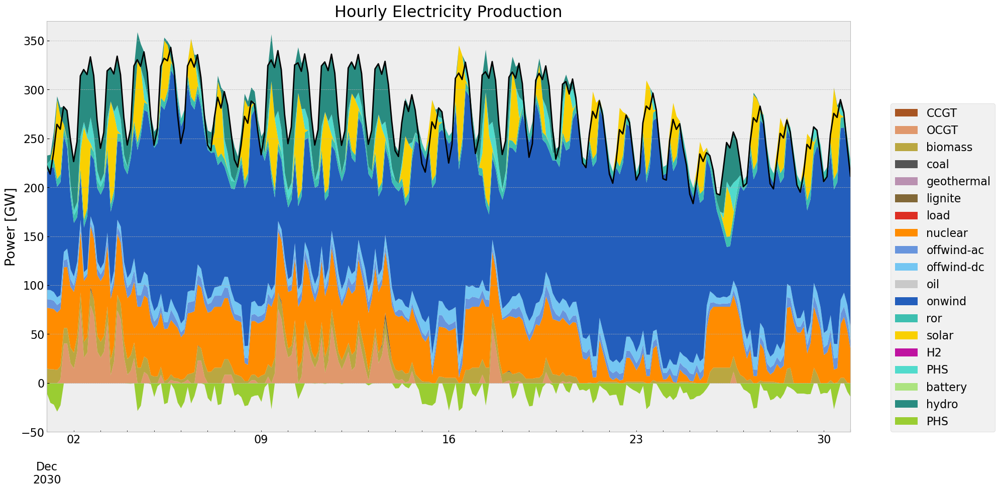

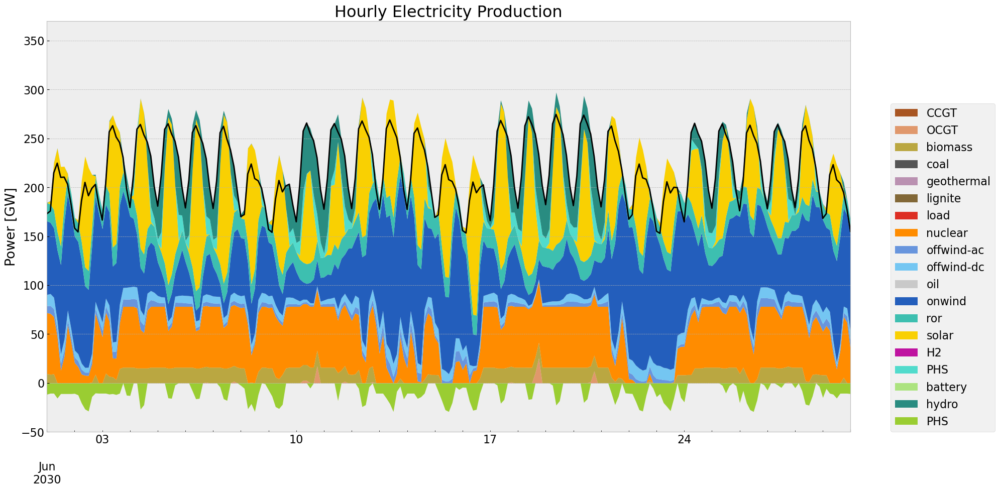

In [194]:
#generation curve all countries
#winter
gen_curve_tot(n, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n, '2030-06-01', '2030-06-30', colors_gen)

## Storage

In [195]:
def inst_store_table(n):
    
    plt.rcParams.update({'font.size': 16})
    storage = n.storage_units
    storage['country'] = storage['bus'].str[:2]

    (storage.groupby(['country','carrier']).p_nom_opt.sum().unstack()/1000).plot.bar(figsize=(17,10),
                                stacked=True,
                                color=["yellowgreen","magenta","red","blue"],
                                grid=True,
                                xlabel="",
                                ylabel="Installed capacity [GW]",
                                title=f"Installed Power Capacity of Storage Systems By Country",
                                #ylim=[0,20]
    )
    store = storage.groupby(['country','carrier']).p_nom_opt.sum()/1000 #GW
    store.fillna(0, inplace=True)

    plt.tight_layout()

    filename = f"{n.name}_installed_storage.png" if hasattr(n, 'name') else "installed_storage.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    
    return store

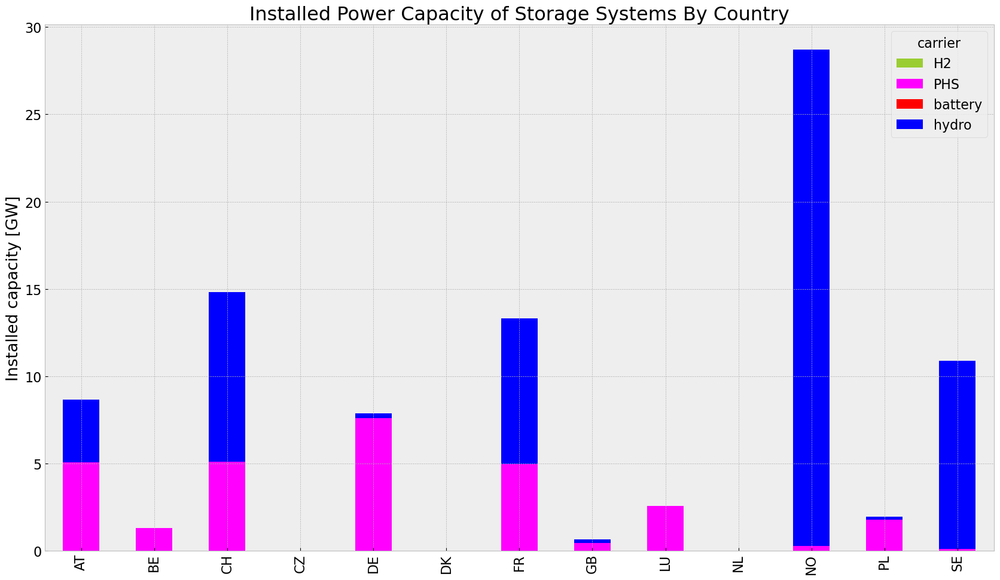

In [196]:
store_base = inst_store_table(n)

In [197]:
def state_of_charge_plot(n):
    
    soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)

    soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    soc.plot(ax=ax,
        grid=True,
        ylabel="State of charge [GWh]",
        xlabel="Time",
        title=f"State of charge of Storage Systems",
        linewidth=1.5,
    )
    plt.tight_layout()
    filename = f"{n.name}_soc.png" if hasattr(n, 'name') else "soc.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)



plt.show(n)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


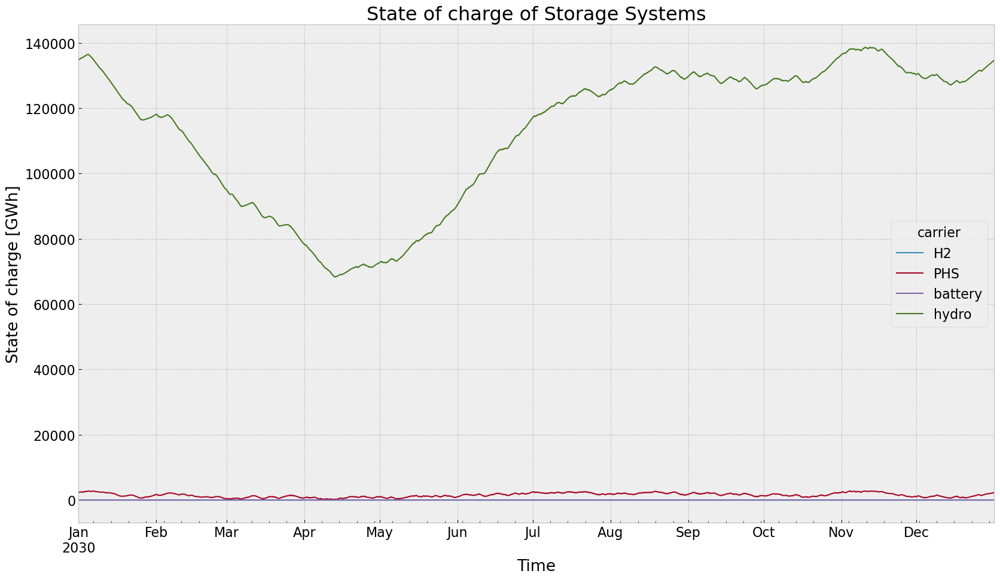

In [198]:
state_of_charge_plot(n)

## Electricity Price

In [199]:
def price_dur_curve_plot(n):

    #buses without store
    columns_to_keep =[]

    for i in n.buses_t.marginal_price.columns.tolist():
        if not i.endswith('H2'):
            columns_to_keep.append(i)
    
    price_dur_curve = pd.DataFrame()
    for region in columns_to_keep:
        price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))

    price_dur_curve.plot(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Time steps",
                    title=f"Duration curves of the marginal price",
                    linewidth=3,
)
    plt.tight_layout()
    filename = f"{n.name}_pd_curve.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
plt.show()

In [200]:
#columns_to_keep =[]

#for i in n.buses_t.marginal_price.columns.tolist():
    #if not i.endswith('H2'):
        #columns_to_keep.append(i)

#buses without store
#columns_to_keep =[]

#price_dur_curve = pd.DataFrame()
#for region in columns_to_keep:
    #price_dur_curve[region] = n.buses_t.marginal_price[region].sort_values(ascending=False).reset_index(drop=True)


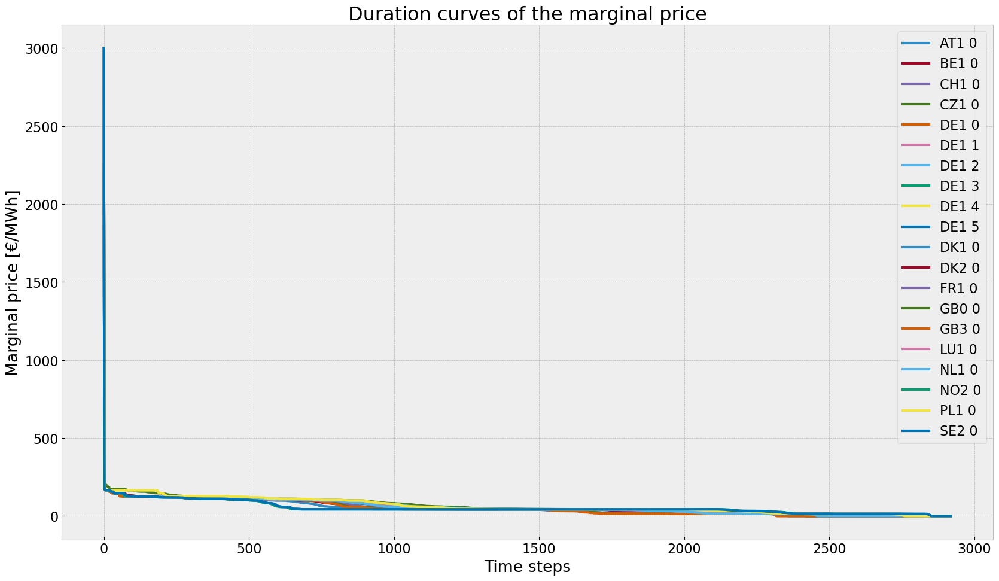

In [201]:
price_dur_curve_plot(n)

In [202]:
#demand weighted average electricity price
def price_regions_table(n):

    plt.rcParams.update({'font.size': 16})

    fig, ax = plt.subplots(figsize=(17,10))
    
    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    
    price_df.plot.bar(ax=ax,
                    grid=True,
                    ylabel="Marginal price [€/MWh]",
                    xlabel="Region",
                    title=f"Demand-Weighted Average Marginal Price",
                    linewidth=3,
    )
    fig.tight_layout()                
    filename = f"{n.name}_average_eprice.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)                                    
    


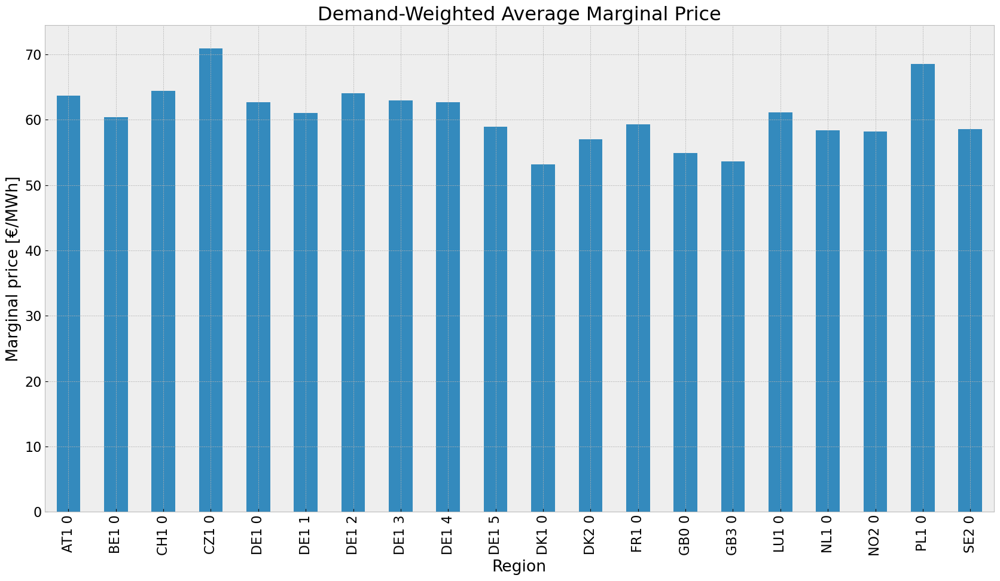

In [203]:
price_regions_table(n)

In [204]:
def price_regions(n):
    # Assuming 'n.buses_t.marginal_price' returns a DataFrame or similar structure with 'mean()' method

    price_df = pd.Series(dtype='float64')

    for price_index in n.buses_t.marginal_price.columns:
        for load_index in  n.loads_t.p_set.columns:
            if price_index == load_index:
                sumweight = (n.buses_t.marginal_price[price_index]*n.loads_t.p_set[load_index]).sum()
                weight = n.loads_t.p_set[load_index].sum()
                weighted_eprice = sumweight/weight
                price_df[price_index] = weighted_eprice

    #hprice = mean_p.filter(like='H2')
    #eprice = mean_p.drop(hprice.index)

    # Setup figure and subplots with 1 row and 2 columns
    fig, ax = plt.subplots(subplot_kw={"projection": ccrs.PlateCarree()}, figsize=(8, 8))

    # Plot for eprice
    hb= plt.hexbin(
        n.buses.x,
        n.buses.y,
        gridsize=20,
        C=price_df,
        cmap=plt.cm.jet,
        zorder=3,
    )

    n.plot(ax=ax, line_widths=pd.Series(0.5, n.lines.index), bus_sizes=0)  # Plot network on the second subplot

    ax.set_title("Demand-Weighted Average Marginal Price")
    
    cb = fig.colorbar(hb, ax=ax, location='bottom')
    cb.set_label("Mean Electricity Marginal Price (EUR/MWh)")

    fig.tight_layout()
    filename = f"{n.name}_price_map.png" if hasattr(n, 'name') else "pd_curve.png"
    output_path = os.path.join(os.getcwd(), filename)
    plt.savefig(output_path)
    

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


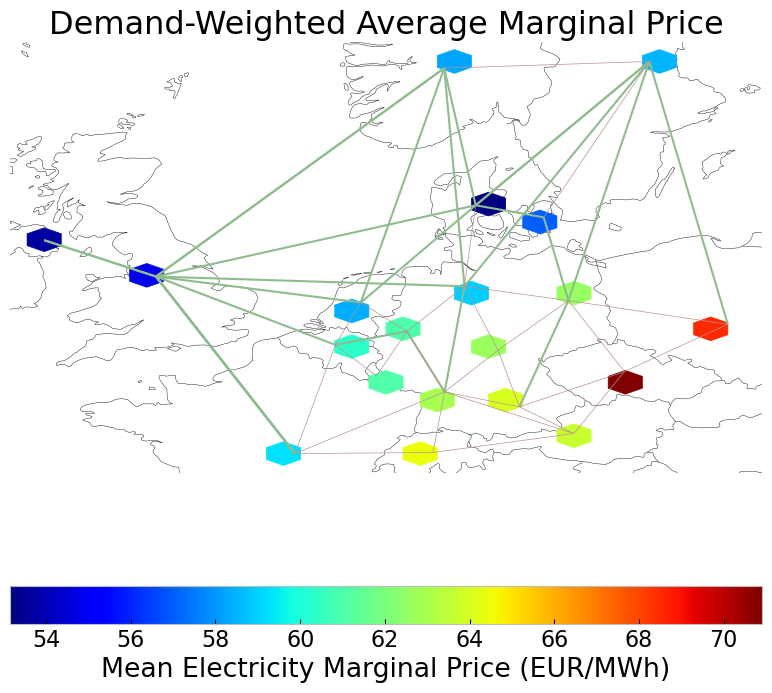

In [205]:
price_regions(n)

## Emission

In [206]:
def em_table(n):
    carrier = n.generators.carrier.unique()
    df_tot_generation = n.generators_t.p.sum()

    generations = pd.Series(index = n.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

    for r in region:
        for tech in carrier:
            key = f"{r} {tech}"
            if key in df_tot_generation.index:
                try:
                    generations.loc[r, tech] = df_tot_generation[key]
                    #print(generations.loc[r, tech])
                except KeyError:
                    print('error')
    generations.fillna(0, inplace=True)

    generations = (generations.unstack())#MWh

    #mean efficiency of each carrier
    eff = n.generators.groupby('carrier').efficiency.mean()

    e = generations.sum()
    emission = []

    for index in e.index:
        for index_c in n.carriers.index:
            for index_eff in eff.index:
                if index == index_c == index_eff:
                    em = n.carriers.loc[index_c,"co2_emissions"]
                    emission.append(em)

    df = e.to_frame()
    df.rename(columns={0: 'Generation in MWh'}, inplace=True)
    df['efficiency'] = eff
    df['emissions in Tonnes CO2/MWh'] = emission
    df['emissions in Tonnes CO2']= df['Generation in MWh']/df['efficiency']*df['emissions in Tonnes CO2/MWh']
    df['emissions in Tonnes CO2'].sum() 
    return df

em_base =em_table(n)
em_base

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,2.950103e+07,0.451621,0.1980,1.293387e+07
biomass,3.377481e+07,0.468000,0.0000,0.000000e+00
coal,7.117319e+05,0.329908,0.3361,7.250902e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,9.211707e+05,0.337285,0.4069,1.111300e+06
load,3.775349e+03,1.000000,0.0000,0.000000e+00
nuclear,1.554148e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.794435e+07,1.000000,0.0000,0.000000e+00


# PV Cut Scenario



In [221]:
#p_max_pu of offwind generators across all regions are subtracted by 10% from 01.06.2013 to 31.12.13
cut_start=pd.to_datetime('2013-02-01 00:00:00')
duration = 180 #days
#cut_end = pd.to_datetime('2013-12-31 21:00:00')
reduction = 0.2

def pvscenario(n, cut_start, duration, reduction):
    #copy network
    n_new=n.copy()
    cut_end = cut_start + pd.Timedelta(days= duration)
    #implement pv cut
    for column in n_new.generators_t.p_max_pu.columns:
            if column.endswith('solar'):
                    for index,row in n_new.generators_t.p_max_pu[column].items():
                            if index >= cut_start and index <= cut_end:
                                    new_p_max_pu = n_new.generators_t.p_max_pu.at[index, column] * reduction #0.9
                                    n_new.generators_t.p_max_pu.at[index, column] = new_p_max_pu
                                    if new_p_max_pu<0:
                                        n_new.generators_t.p_max_pu.at[index, column] = 0
    return n_new

n1 = pvscenario(n, cut_start, duration, reduction)
n1.name = 'inv'          

## 1. Scenario: allow additional investment of extendable generators and storage

### Allow investment

In [225]:
def allow_inv(n1,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n1.generators.p_nom_extendable.items():
        if value:  
            n1.generators.at[index, 'p_nom_min'] = n.generators.at[index, 'p_nom_opt']


    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n1.storage_units.p_nom_extendable.items():
        if value:  
            n1.storage_units.at[index, 'p_nom_min'] = n.storage_units.at[index, 'p_nom_opt']

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n1.lines.s_nom_extendable.items():
        if value:  
            n1.lines.at[index, 's_nom_min'] = n.lines.at[index, 's_nom_opt']

    #set the optimal capacity of links from the base scenario as the new minimum capacity 
    for index, value in n1.links.p_nom_extendable.items():
        if value:  
            n1.links.at[index, 'p_nom_min'] = n.links.at[index, 'p_nom_opt'] 

allow_inv(n1,n)

In [227]:
n1.optimize(solver_name= "gurobi")
#n1 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\PV Cut\\20240511\\inv.nc")

Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 12/12 [00:05<00:00,  2.12it/s]
INFO:linopy.io: Writing time: 38.02s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3g11uvbe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3g11uvbe.lp


Reading time = 11.80 seconds


INFO:gurobipy:Reading time = 11.80 seconds


obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


INFO:gurobipy:obj: 3264863 rows, 1521502 columns, 6235954 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


INFO:gurobipy:Optimize a model with 3264863 rows, 1521502 columns and 6235954 nonzeros


Model fingerprint: 0x3087d0a3


INFO:gurobipy:Model fingerprint: 0x3087d0a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [2e-03, 1e+03]


INFO:gurobipy:  Matrix range     [2e-03, 1e+03]


  Objective range  [3e-02, 3e+05]


INFO:gurobipy:  Objective range  [3e-02, 3e+05]


  Bounds range     [1e+00, 2e+10]


INFO:gurobipy:  Bounds range     [1e+00, 2e+10]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


INFO:gurobipy:Warning: Model contains large bounds


         Consider reformulating model or setting NumericFocus parameter


INFO:gurobipy:         Consider reformulating model or setting NumericFocus parameter


         to avoid numerical issues.


INFO:gurobipy:         to avoid numerical issues.


Presolve removed 2150043 rows and 372373 columns (presolve time = 5s) ...


INFO:gurobipy:Presolve removed 2150043 rows and 372373 columns (presolve time = 5s) ...


Presolve removed 2150043 rows and 372373 columns


INFO:gurobipy:Presolve removed 2150043 rows and 372373 columns


Presolve time: 6.45s


INFO:gurobipy:Presolve time: 6.45s


Presolved: 1114820 rows, 1149129 columns, 3737809 nonzeros


INFO:gurobipy:Presolved: 1114820 rows, 1149129 columns, 3737809 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Elapsed ordering time = 8s


INFO:gurobipy:Elapsed ordering time = 8s


Ordering time: 14.01s


INFO:gurobipy:Ordering time: 14.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 Dense cols : 172


INFO:gurobipy: Dense cols : 172


 AA' NZ     : 3.970e+06


INFO:gurobipy: AA' NZ     : 3.970e+06


 Factor NZ  : 2.876e+07 (roughly 1.1 GB of memory)


INFO:gurobipy: Factor NZ  : 2.876e+07 (roughly 1.1 GB of memory)


 Factor Ops : 5.991e+09 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 5.991e+09 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   6.28182802e+17 -6.60372214e+18  2.51e+10 6.74e+04  6.77e+13    25s


INFO:gurobipy:   0   6.28182802e+17 -6.60372214e+18  2.51e+10 6.74e+04  6.77e+13    25s


   1   5.48906699e+17 -2.96571133e+18  2.19e+10 2.38e+04  4.27e+13    27s


INFO:gurobipy:   1   5.48906699e+17 -2.96571133e+18  2.19e+10 2.38e+04  4.27e+13    27s


   2   4.52221735e+17 -1.63911918e+18  1.71e+10 1.08e+04  3.02e+13    29s


INFO:gurobipy:   2   4.52221735e+17 -1.63911918e+18  1.71e+10 1.08e+04  3.02e+13    29s


   3   2.51960701e+17 -8.35245208e+17  5.64e+09 3.63e+03  1.05e+13    32s


INFO:gurobipy:   3   2.51960701e+17 -8.35245208e+17  5.64e+09 3.63e+03  1.05e+13    32s


   4   2.06837642e+17 -2.94185698e+17  2.08e+09 8.55e+02  3.75e+12    34s


INFO:gurobipy:   4   2.06837642e+17 -2.94185698e+17  2.08e+09 8.55e+02  3.75e+12    34s


   5   1.35091490e+17 -5.70142795e+16  6.81e+08 1.65e+02  1.18e+12    36s


INFO:gurobipy:   5   1.35091490e+17 -5.70142795e+16  6.81e+08 1.65e+02  1.18e+12    36s


   6   2.69872544e+16 -8.40878984e+15  1.22e+07 6.08e+00  3.52e+10    38s


INFO:gurobipy:   6   2.69872544e+16 -8.40878984e+15  1.22e+07 6.08e+00  3.52e+10    38s


   7   1.09894101e+16 -1.33537240e+15  4.04e+06 4.66e-01  1.09e+10    39s


INFO:gurobipy:   7   1.09894101e+16 -1.33537240e+15  4.04e+06 4.66e-01  1.09e+10    39s


   8   3.40628515e+15 -4.78354337e+14  1.14e+06 5.08e-05  3.23e+09    42s


INFO:gurobipy:   8   3.40628515e+15 -4.78354337e+14  1.14e+06 5.08e-05  3.23e+09    42s


   9   1.63821925e+15 -2.98096054e+14  5.35e+05 1.03e-05  1.51e+09    44s


INFO:gurobipy:   9   1.63821925e+15 -2.98096054e+14  5.35e+05 1.03e-05  1.51e+09    44s


  10   1.14552470e+15 -1.95396039e+14  3.67e+05 1.98e-05  9.95e+08    46s


INFO:gurobipy:  10   1.14552470e+15 -1.95396039e+14  3.67e+05 1.98e-05  9.95e+08    46s


  11   8.83722422e+14 -1.48829712e+14  2.77e+05 8.81e-06  7.33e+08    48s


INFO:gurobipy:  11   8.83722422e+14 -1.48829712e+14  2.77e+05 8.81e-06  7.33e+08    48s


  12   7.45634828e+14 -1.19148175e+14  2.31e+05 1.01e-05  5.94e+08    50s


INFO:gurobipy:  12   7.45634828e+14 -1.19148175e+14  2.31e+05 1.01e-05  5.94e+08    50s


  13   5.19736473e+14 -7.34913486e+13  1.60e+05 2.59e-05  3.87e+08    52s


INFO:gurobipy:  13   5.19736473e+14 -7.34913486e+13  1.60e+05 2.59e-05  3.87e+08    52s


  14   3.37825045e+14 -4.52433773e+13  1.03e+05 1.46e-05  2.38e+08    55s


INFO:gurobipy:  14   3.37825045e+14 -4.52433773e+13  1.03e+05 1.46e-05  2.38e+08    55s


  15   2.56308268e+14 -2.92315577e+13  7.81e+04 9.32e-06  1.70e+08    57s


INFO:gurobipy:  15   2.56308268e+14 -2.92315577e+13  7.81e+04 9.32e-06  1.70e+08    57s


  16   2.07282434e+14 -2.04695604e+13  6.26e+04 2.31e-05  1.30e+08    59s


INFO:gurobipy:  16   2.07282434e+14 -2.04695604e+13  6.26e+04 2.31e-05  1.30e+08    59s


  17   1.11907987e+14 -1.18316049e+13  3.30e+04 1.29e-05  6.74e+07    61s


INFO:gurobipy:  17   1.11907987e+14 -1.18316049e+13  3.30e+04 1.29e-05  6.74e+07    61s


  18   8.99645681e+13 -7.74231060e+12  2.68e+04 2.65e-05  5.21e+07    63s


INFO:gurobipy:  18   8.99645681e+13 -7.74231060e+12  2.68e+04 2.65e-05  5.21e+07    63s


  19   4.59992891e+13 -6.45885264e+12  1.37e+04 8.12e-06  2.72e+07    66s


INFO:gurobipy:  19   4.59992891e+13 -6.45885264e+12  1.37e+04 8.12e-06  2.72e+07    66s


  20   4.15150766e+13 -5.94498214e+12  1.23e+04 5.51e-06  2.44e+07    68s


INFO:gurobipy:  20   4.15150766e+13 -5.94498214e+12  1.23e+04 5.51e-06  2.44e+07    68s


  21   3.31964114e+13 -5.45456594e+12  9.70e+03 4.55e-06  1.96e+07    70s


INFO:gurobipy:  21   3.31964114e+13 -5.45456594e+12  9.70e+03 4.55e-06  1.96e+07    70s


  22   2.53422952e+13 -5.13816109e+12  7.26e+03 2.66e-06  1.52e+07    72s


INFO:gurobipy:  22   2.53422952e+13 -5.13816109e+12  7.26e+03 2.66e-06  1.52e+07    72s


  23   1.64647628e+13 -4.57317394e+12  4.78e+03 2.72e-06  1.03e+07    74s


INFO:gurobipy:  23   1.64647628e+13 -4.57317394e+12  4.78e+03 2.72e-06  1.03e+07    74s


  24   1.30916652e+13 -4.40026530e+12  3.85e+03 2.53e-06  8.51e+06    77s


INFO:gurobipy:  24   1.30916652e+13 -4.40026530e+12  3.85e+03 2.53e-06  8.51e+06    77s


  25   9.57894716e+12 -2.96923224e+12  2.84e+03 1.80e-06  5.98e+06    79s


INFO:gurobipy:  25   9.57894716e+12 -2.96923224e+12  2.84e+03 1.80e-06  5.98e+06    79s


  26   6.54241255e+12 -2.86221678e+12  1.92e+03 1.55e-06  4.41e+06    83s


INFO:gurobipy:  26   6.54241255e+12 -2.86221678e+12  1.92e+03 1.55e-06  4.41e+06    83s


  27   3.70089770e+12 -2.06436801e+12  1.07e+03 3.64e-06  2.62e+06    85s


INFO:gurobipy:  27   3.70089770e+12 -2.06436801e+12  1.07e+03 3.64e-06  2.62e+06    85s


  28   1.85713723e+12 -1.71996431e+12  5.11e+02 2.26e-06  1.57e+06    88s


INFO:gurobipy:  28   1.85713723e+12 -1.71996431e+12  5.11e+02 2.26e-06  1.57e+06    88s


  29   1.42706159e+12 -1.38620644e+12  3.81e+02 1.53e-06  1.22e+06    91s


INFO:gurobipy:  29   1.42706159e+12 -1.38620644e+12  3.81e+02 1.53e-06  1.22e+06    91s


  30   1.14613044e+12 -1.17046717e+12  2.94e+02 9.91e-07  9.97e+05    93s


INFO:gurobipy:  30   1.14613044e+12 -1.17046717e+12  2.94e+02 9.91e-07  9.97e+05    93s


  31   9.56205603e+11 -1.00948871e+12  2.38e+02 1.26e-07  8.40e+05    95s


INFO:gurobipy:  31   9.56205603e+11 -1.00948871e+12  2.38e+02 1.26e-07  8.40e+05    95s


  32   8.17153610e+11 -7.97678110e+11  2.00e+02 1.48e-06  6.87e+05    97s


INFO:gurobipy:  32   8.17153610e+11 -7.97678110e+11  2.00e+02 1.48e-06  6.87e+05    97s


  33   5.79229332e+11 -5.46453136e+11  1.33e+02 5.38e-06  4.74e+05   100s


INFO:gurobipy:  33   5.79229332e+11 -5.46453136e+11  1.33e+02 5.38e-06  4.74e+05   100s


  34   4.20052346e+11 -1.62589560e+11  8.91e+01 3.08e-06  2.45e+05   103s


INFO:gurobipy:  34   4.20052346e+11 -1.62589560e+11  8.91e+01 3.08e-06  2.45e+05   103s


  35   2.71958768e+11 -6.10154244e+10  5.07e+01 6.99e-10  1.40e+05   106s


INFO:gurobipy:  35   2.71958768e+11 -6.10154244e+10  5.07e+01 6.99e-10  1.40e+05   106s


  36   2.08226762e+11  4.33719951e+09  3.51e+01 8.87e-06  8.58e+04   109s


INFO:gurobipy:  36   2.08226762e+11  4.33719951e+09  3.51e+01 8.87e-06  8.58e+04   109s


  37   1.72586024e+11  1.95856281e+10  2.65e+01 4.72e-06  6.44e+04   111s


INFO:gurobipy:  37   1.72586024e+11  1.95856281e+10  2.65e+01 4.72e-06  6.44e+04   111s


  38   1.46406482e+11  2.91923282e+10  2.01e+01 5.25e-06  4.93e+04   112s


INFO:gurobipy:  38   1.46406482e+11  2.91923282e+10  2.01e+01 5.25e-06  4.93e+04   112s


  39   1.42839497e+11  3.15948014e+10  1.93e+01 3.47e-06  4.68e+04   114s


INFO:gurobipy:  39   1.42839497e+11  3.15948014e+10  1.93e+01 3.47e-06  4.68e+04   114s


  40   1.36774550e+11  3.72986299e+10  1.79e+01 1.88e-06  4.19e+04   115s


INFO:gurobipy:  40   1.36774550e+11  3.72986299e+10  1.79e+01 1.88e-06  4.19e+04   115s


  41   1.19297545e+11  4.23166542e+10  1.40e+01 2.03e-06  3.24e+04   118s


INFO:gurobipy:  41   1.19297545e+11  4.23166542e+10  1.40e+01 2.03e-06  3.24e+04   118s


  42   1.04870875e+11  4.61910638e+10  1.06e+01 2.26e-06  2.47e+04   120s


INFO:gurobipy:  42   1.04870875e+11  4.61910638e+10  1.06e+01 2.26e-06  2.47e+04   120s


  43   9.80186536e+10  4.96243211e+10  9.19e+00 2.94e-06  2.04e+04   123s


INFO:gurobipy:  43   9.80186536e+10  4.96243211e+10  9.19e+00 2.94e-06  2.04e+04   123s


  44   8.76118621e+10  5.15771936e+10  6.85e+00 1.01e-06  1.52e+04   126s


INFO:gurobipy:  44   8.76118621e+10  5.15771936e+10  6.85e+00 1.01e-06  1.52e+04   126s


  45   8.10793268e+10  5.39943441e+10  5.25e+00 1.05e-09  1.15e+04   129s


INFO:gurobipy:  45   8.10793268e+10  5.39943441e+10  5.25e+00 1.05e-09  1.15e+04   129s


  46   7.65099762e+10  5.51346278e+10  4.15e+00 3.47e-06  9.04e+03   132s


INFO:gurobipy:  46   7.65099762e+10  5.51346278e+10  4.15e+00 3.47e-06  9.04e+03   132s


  47   7.30926455e+10  5.64165661e+10  3.24e+00 1.01e-06  7.05e+03   136s


INFO:gurobipy:  47   7.30926455e+10  5.64165661e+10  3.24e+00 1.01e-06  7.05e+03   136s


  48   7.04578579e+10  5.75940910e+10  2.53e+00 1.88e-06  5.44e+03   139s


INFO:gurobipy:  48   7.04578579e+10  5.75940910e+10  2.53e+00 1.88e-06  5.44e+03   139s


  49   6.84506975e+10  5.84788494e+10  2.00e+00 5.22e-06  4.22e+03   142s


INFO:gurobipy:  49   6.84506975e+10  5.84788494e+10  2.00e+00 5.22e-06  4.22e+03   142s


  50   6.68587081e+10  5.89677133e+10  1.58e+00 8.63e-06  3.34e+03   145s


INFO:gurobipy:  50   6.68587081e+10  5.89677133e+10  1.58e+00 8.63e-06  3.34e+03   145s


  51   6.57893153e+10  5.93998039e+10  1.29e+00 6.70e-06  2.71e+03   149s


INFO:gurobipy:  51   6.57893153e+10  5.93998039e+10  1.29e+00 6.70e-06  2.71e+03   149s


  52   6.47198230e+10  5.97208366e+10  9.97e-01 4.89e-06  2.12e+03   152s


INFO:gurobipy:  52   6.47198230e+10  5.97208366e+10  9.97e-01 4.89e-06  2.12e+03   152s


  53   6.39126575e+10  6.00126302e+10  7.85e-01 2.79e-06  1.65e+03   155s


INFO:gurobipy:  53   6.39126575e+10  6.00126302e+10  7.85e-01 2.79e-06  1.65e+03   155s


  54   6.33503631e+10  6.01571492e+10  6.37e-01 3.99e-06  1.35e+03   158s


INFO:gurobipy:  54   6.33503631e+10  6.01571492e+10  6.37e-01 3.99e-06  1.35e+03   158s


  55   6.30132949e+10  6.02929039e+10  5.43e-01 6.04e-06  1.15e+03   161s


INFO:gurobipy:  55   6.30132949e+10  6.02929039e+10  5.43e-01 6.04e-06  1.15e+03   161s


  56   6.27009894e+10  6.04040624e+10  4.55e-01 5.13e-06  9.71e+02   164s


INFO:gurobipy:  56   6.27009894e+10  6.04040624e+10  4.55e-01 5.13e-06  9.71e+02   164s


  57   6.23856196e+10  6.04862266e+10  3.66e-01 4.60e-06  8.02e+02   167s


INFO:gurobipy:  57   6.23856196e+10  6.04862266e+10  3.66e-01 4.60e-06  8.02e+02   167s


  58   6.22216034e+10  6.06045744e+10  3.20e-01 1.14e-06  6.83e+02   170s


INFO:gurobipy:  58   6.22216034e+10  6.06045744e+10  3.20e-01 1.14e-06  6.83e+02   170s


  59   6.20270128e+10  6.06616095e+10  2.68e-01 1.34e-06  5.76e+02   173s


INFO:gurobipy:  59   6.20270128e+10  6.06616095e+10  2.68e-01 1.34e-06  5.76e+02   173s


  60   6.18962835e+10  6.06988200e+10  2.32e-01 8.25e-07  5.05e+02   177s


INFO:gurobipy:  60   6.18962835e+10  6.06988200e+10  2.32e-01 8.25e-07  5.05e+02   177s


  61   6.17957030e+10  6.07751842e+10  2.06e-01 2.40e-06  4.31e+02   180s


INFO:gurobipy:  61   6.17957030e+10  6.07751842e+10  2.06e-01 2.40e-06  4.31e+02   180s


  62   6.16665814e+10  6.08002659e+10  1.70e-01 3.17e-06  3.65e+02   183s


INFO:gurobipy:  62   6.16665814e+10  6.08002659e+10  1.70e-01 3.17e-06  3.65e+02   183s


  63   6.15373568e+10  6.08349930e+10  1.34e-01 3.93e-06  2.95e+02   186s


INFO:gurobipy:  63   6.15373568e+10  6.08349930e+10  1.34e-01 3.93e-06  2.95e+02   186s


  64   6.14976571e+10  6.08739794e+10  1.23e-01 4.51e-06  2.63e+02   188s


INFO:gurobipy:  64   6.14976571e+10  6.08739794e+10  1.23e-01 4.51e-06  2.63e+02   188s


  65   6.14133912e+10  6.08876824e+10  1.01e-01 4.39e-06  2.21e+02   191s


INFO:gurobipy:  65   6.14133912e+10  6.08876824e+10  1.01e-01 4.39e-06  2.21e+02   191s


  66   6.13823461e+10  6.09142319e+10  9.24e-02 4.79e-06  1.97e+02   194s


INFO:gurobipy:  66   6.13823461e+10  6.09142319e+10  9.24e-02 4.79e-06  1.97e+02   194s


  67   6.13353159e+10  6.09304768e+10  7.94e-02 3.04e-06  1.70e+02   197s


INFO:gurobipy:  67   6.13353159e+10  6.09304768e+10  7.94e-02 3.04e-06  1.70e+02   197s


  68   6.13065150e+10  6.09408972e+10  7.14e-02 3.05e-06  1.53e+02   200s


INFO:gurobipy:  68   6.13065150e+10  6.09408972e+10  7.14e-02 3.05e-06  1.53e+02   200s


  69   6.12677622e+10  6.09533930e+10  6.09e-02 2.49e-06  1.32e+02   203s


INFO:gurobipy:  69   6.12677622e+10  6.09533930e+10  6.09e-02 2.49e-06  1.32e+02   203s


  70   6.12199922e+10  6.09648871e+10  4.78e-02 4.12e-06  1.07e+02   206s


INFO:gurobipy:  70   6.12199922e+10  6.09648871e+10  4.78e-02 4.12e-06  1.07e+02   206s


  71   6.11802565e+10  6.09881666e+10  3.69e-02 6.68e-06  8.04e+01   209s


INFO:gurobipy:  71   6.11802565e+10  6.09881666e+10  3.69e-02 6.68e-06  8.04e+01   209s


  72   6.11579233e+10  6.09951562e+10  3.08e-02 4.32e-06  6.81e+01   212s


INFO:gurobipy:  72   6.11579233e+10  6.09951562e+10  3.08e-02 4.32e-06  6.81e+01   212s


  73   6.11471602e+10  6.09977349e+10  2.80e-02 3.82e-06  6.25e+01   215s


INFO:gurobipy:  73   6.11471602e+10  6.09977349e+10  2.80e-02 3.82e-06  6.25e+01   215s


  74   6.11301562e+10  6.10024227e+10  2.35e-02 2.49e-06  5.33e+01   218s


INFO:gurobipy:  74   6.11301562e+10  6.10024227e+10  2.35e-02 2.49e-06  5.33e+01   218s


  75   6.11206833e+10  6.10078870e+10  2.10e-02 2.09e-06  4.71e+01   221s


INFO:gurobipy:  75   6.11206833e+10  6.10078870e+10  2.10e-02 2.09e-06  4.71e+01   221s


  76   6.11078197e+10  6.10115491e+10  1.76e-02 1.90e-06  4.02e+01   224s


INFO:gurobipy:  76   6.11078197e+10  6.10115491e+10  1.76e-02 1.90e-06  4.02e+01   224s


  77   6.10957991e+10  6.10175319e+10  1.44e-02 1.60e-06  3.27e+01   227s


INFO:gurobipy:  77   6.10957991e+10  6.10175319e+10  1.44e-02 1.60e-06  3.27e+01   227s


  78   6.10861202e+10  6.10207840e+10  1.18e-02 8.06e-07  2.72e+01   231s


INFO:gurobipy:  78   6.10861202e+10  6.10207840e+10  1.18e-02 8.06e-07  2.72e+01   231s


  79   6.10778810e+10  6.10225652e+10  9.60e-03 6.00e-07  2.30e+01   234s


INFO:gurobipy:  79   6.10778810e+10  6.10225652e+10  9.60e-03 6.00e-07  2.30e+01   234s


  80   6.10714327e+10  6.10268991e+10  7.88e-03 7.89e-07  1.86e+01   237s


INFO:gurobipy:  80   6.10714327e+10  6.10268991e+10  7.88e-03 7.89e-07  1.86e+01   237s


  81   6.10669317e+10  6.10283493e+10  6.68e-03 1.25e-06  1.61e+01   240s


INFO:gurobipy:  81   6.10669317e+10  6.10283493e+10  6.68e-03 1.25e-06  1.61e+01   240s


  82   6.10658801e+10  6.10285948e+10  6.39e-03 9.63e-07  1.55e+01   242s


INFO:gurobipy:  82   6.10658801e+10  6.10285948e+10  6.39e-03 9.63e-07  1.55e+01   242s


  83   6.10630112e+10  6.10330540e+10  5.61e-03 5.47e-07  1.25e+01   245s


INFO:gurobipy:  83   6.10630112e+10  6.10330540e+10  5.61e-03 5.47e-07  1.25e+01   245s


  84   6.10579537e+10  6.10348063e+10  4.29e-03 4.31e-07  9.66e+00   248s


INFO:gurobipy:  84   6.10579537e+10  6.10348063e+10  4.29e-03 4.31e-07  9.66e+00   248s


  85   6.10542909e+10  6.10370814e+10  3.32e-03 1.72e-06  7.20e+00   251s


INFO:gurobipy:  85   6.10542909e+10  6.10370814e+10  3.32e-03 1.72e-06  7.20e+00   251s


  86   6.10514191e+10  6.10374896e+10  2.60e-03 1.09e-06  5.82e+00   253s


INFO:gurobipy:  86   6.10514191e+10  6.10374896e+10  2.60e-03 1.09e-06  5.82e+00   253s


  87   6.10495362e+10  6.10386235e+10  2.12e-03 4.77e-07  4.57e+00   256s


INFO:gurobipy:  87   6.10495362e+10  6.10386235e+10  2.12e-03 4.77e-07  4.57e+00   256s


  88   6.10467447e+10  6.10393781e+10  1.41e-03 5.22e-07  3.08e+00   259s


INFO:gurobipy:  88   6.10467447e+10  6.10393781e+10  1.41e-03 5.22e-07  3.08e+00   259s


  89   6.10440295e+10  6.10397116e+10  7.19e-04 8.34e-07  1.80e+00   262s


INFO:gurobipy:  89   6.10440295e+10  6.10397116e+10  7.19e-04 8.34e-07  1.80e+00   262s


  90   6.10434087e+10  6.10402262e+10  5.64e-04 5.96e-07  1.33e+00   265s


INFO:gurobipy:  90   6.10434087e+10  6.10402262e+10  5.64e-04 5.96e-07  1.33e+00   265s


  91   6.10419982e+10  6.10406096e+10  2.14e-04 1.56e-06  5.77e-01   269s


INFO:gurobipy:  91   6.10419982e+10  6.10406096e+10  2.14e-04 1.56e-06  5.77e-01   269s


  92   6.10416016e+10  6.10408705e+10  1.17e-04 1.09e-06  3.04e-01   271s


INFO:gurobipy:  92   6.10416016e+10  6.10408705e+10  1.17e-04 1.09e-06  3.04e-01   271s


  93   6.10415654e+10  6.10409222e+10  1.08e-04 9.09e-07  2.68e-01   273s


INFO:gurobipy:  93   6.10415654e+10  6.10409222e+10  1.08e-04 9.09e-07  2.68e-01   273s


  94   6.10414916e+10  6.10409320e+10  9.10e-05 8.64e-07  2.33e-01   275s


INFO:gurobipy:  94   6.10414916e+10  6.10409320e+10  9.10e-05 8.64e-07  2.33e-01   275s


  95   6.10413360e+10  6.10409743e+10  5.44e-05 9.09e-07  1.50e-01   277s


INFO:gurobipy:  95   6.10413360e+10  6.10409743e+10  5.44e-05 9.09e-07  1.50e-01   277s


  96   6.10413098e+10  6.10410021e+10  4.83e-05 7.15e-07  1.28e-01   279s


INFO:gurobipy:  96   6.10413098e+10  6.10410021e+10  4.83e-05 7.15e-07  1.28e-01   279s


  97   6.10412426e+10  6.10410347e+10  3.27e-05 4.62e-07  8.66e-02   281s


INFO:gurobipy:  97   6.10412426e+10  6.10410347e+10  3.27e-05 4.62e-07  8.66e-02   281s


  98   6.10412014e+10  6.10410563e+10  2.31e-05 3.13e-07  6.04e-02   283s


INFO:gurobipy:  98   6.10412014e+10  6.10410563e+10  2.31e-05 3.13e-07  6.04e-02   283s


  99   6.10411816e+10  6.10410745e+10  1.85e-05 1.24e-06  4.47e-02   285s


INFO:gurobipy:  99   6.10411816e+10  6.10410745e+10  1.85e-05 1.24e-06  4.47e-02   285s


 100   6.10411450e+10  6.10410854e+10  9.94e-06 8.79e-07  2.49e-02   286s


INFO:gurobipy: 100   6.10411450e+10  6.10410854e+10  9.94e-06 8.79e-07  2.49e-02   286s


 101   6.10411314e+10  6.10410924e+10  6.81e-06 1.36e-06  1.63e-02   288s


INFO:gurobipy: 101   6.10411314e+10  6.10410924e+10  6.81e-06 1.36e-06  1.63e-02   288s


 102   6.10411192e+10  6.10410957e+10  3.98e-06 1.92e-06  9.80e-03   290s


INFO:gurobipy: 102   6.10411192e+10  6.10410957e+10  3.98e-06 1.92e-06  9.80e-03   290s


 103   6.10411092e+10  6.10410977e+10  1.68e-06 1.33e-06  4.79e-03   292s


INFO:gurobipy: 103   6.10411092e+10  6.10410977e+10  1.68e-06 1.33e-06  4.79e-03   292s


 104   6.10411056e+10  6.10411003e+10  8.05e-07 5.51e-07  2.20e-03   295s


INFO:gurobipy: 104   6.10411056e+10  6.10411003e+10  8.05e-07 5.51e-07  2.20e-03   295s


 105   6.10411040e+10  6.10411012e+10  4.23e-07 3.20e-07  1.16e-03   297s


INFO:gurobipy: 105   6.10411040e+10  6.10411012e+10  4.23e-07 3.20e-07  1.16e-03   297s


 106   6.10411028e+10  6.10411018e+10  1.13e-07 2.00e-07  4.40e-04   299s


INFO:gurobipy: 106   6.10411028e+10  6.10411018e+10  1.13e-07 2.00e-07  4.40e-04   299s


 107   6.10411026e+10  6.10411021e+10  2.10e-05 1.31e-05  1.99e-04   302s


INFO:gurobipy: 107   6.10411026e+10  6.10411021e+10  2.10e-05 1.31e-05  1.99e-04   302s


 108   6.10411024e+10  6.10411022e+10  9.95e-06 3.68e-06  9.42e-05   304s


INFO:gurobipy: 108   6.10411024e+10  6.10411022e+10  9.95e-06 3.68e-06  9.42e-05   304s


 109   6.10411023e+10  6.10411022e+10  3.08e-06 7.30e-07  2.58e-05   306s


INFO:gurobipy: 109   6.10411023e+10  6.10411022e+10  3.08e-06 7.30e-07  2.58e-05   306s


 110   6.10411023e+10  6.10411023e+10  1.49e-06 2.38e-07  1.17e-05   308s


INFO:gurobipy: 110   6.10411023e+10  6.10411023e+10  1.49e-06 2.38e-07  1.17e-05   308s


 111   6.10411023e+10  6.10411023e+10  4.24e-07 3.19e-07  2.34e-06   311s


INFO:gurobipy: 111   6.10411023e+10  6.10411023e+10  4.24e-07 3.19e-07  2.34e-06   311s


 112   6.10411023e+10  6.10411023e+10  1.17e-07 1.61e-07  2.51e-07   314s


INFO:gurobipy: 112   6.10411023e+10  6.10411023e+10  1.17e-07 1.61e-07  2.51e-07   314s


 113   6.10411023e+10  6.10411023e+10  5.09e-08 3.18e-07  3.29e-08   316s


INFO:gurobipy: 113   6.10411023e+10  6.10411023e+10  5.09e-08 3.18e-07  3.29e-08   316s


 114   6.10411023e+10  6.10411023e+10  9.53e-09 1.43e-07  3.90e-09   319s


INFO:gurobipy: 114   6.10411023e+10  6.10411023e+10  9.53e-09 1.43e-07  3.90e-09   319s


INFO:gurobipy:


Barrier solved model in 114 iterations and 318.58 seconds (102.70 work units)


INFO:gurobipy:Barrier solved model in 114 iterations and 318.58 seconds (102.70 work units)


Optimal objective 6.10411023e+10


INFO:gurobipy:Optimal objective 6.10411023e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


  555333 DPushes remaining with DInf 0.0000000e+00               320s


INFO:gurobipy:  555333 DPushes remaining with DInf 0.0000000e+00               320s


   92652 DPushes remaining with DInf 0.0000000e+00               327s


INFO:gurobipy:   92652 DPushes remaining with DInf 0.0000000e+00               327s


    1014 DPushes remaining with DInf 0.0000000e+00               331s


INFO:gurobipy:    1014 DPushes remaining with DInf 0.0000000e+00               331s


       0 DPushes remaining with DInf 0.0000000e+00               333s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00               333s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.25


INFO:gurobipy:


   24250 PPushes remaining with PInf 6.5737869e-05               333s


INFO:gurobipy:   24250 PPushes remaining with PInf 6.5737869e-05               333s


    6271 PPushes remaining with PInf 5.3240151e-06               347s


INFO:gurobipy:    6271 PPushes remaining with PInf 5.3240151e-06               347s


    5648 PPushes remaining with PInf 5.3237695e-06               354s


INFO:gurobipy:    5648 PPushes remaining with PInf 5.3237695e-06               354s


    4336 PPushes remaining with PInf 5.3237811e-06               355s


INFO:gurobipy:    4336 PPushes remaining with PInf 5.3237811e-06               355s


       0 PPushes remaining with PInf 0.0000000e+00               358s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00               358s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6443547e-02    358s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6443547e-02    358s


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


  324045    6.1041102e+10   0.000000e+00   1.644354e-02    359s


INFO:gurobipy:  324045    6.1041102e+10   0.000000e+00   1.644354e-02    359s


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


  324052    6.1041102e+10   0.000000e+00   0.000000e+00    363s


INFO:gurobipy:  324052    6.1041102e+10   0.000000e+00   0.000000e+00    363s


INFO:gurobipy:


Solved in 324052 iterations and 362.95 seconds (115.24 work units)


INFO:gurobipy:Solved in 324052 iterations and 362.95 seconds (115.24 work units)


Optimal objective  6.104110227e+10


INFO:gurobipy:Optimal objective  6.104110227e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521502 primals, 3264863 duals
Objective: 6.10e+10
Solver model: available
Solver message: 2

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\pypsa\optimization\optimize.py:357: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  n.df(c)[attr + "_opt"].update(df)
INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-uppe

('ok', 'optimal')

### Export model for later use

In [ ]:
#file = "inv.nc"
#output_path = os.path.join(os.getcwd(), file)
#n1.export_to_netcdf(output_path)

In [228]:
tot_cos_inv=n1.objective/1e9 # billion €
system_cost_inv = system_cost(n1) #million€/a
marg_price_region_inv = n1.buses_t.marginal_price.mean()
stat_inv = n1.statistics()

<Figure size 640x480 with 0 Axes>

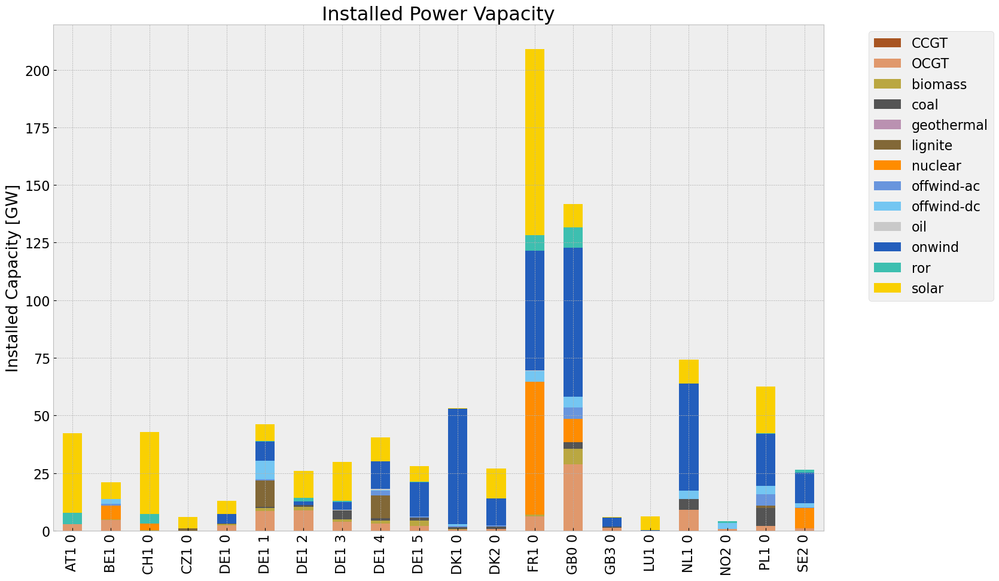

<Figure size 640x480 with 0 Axes>

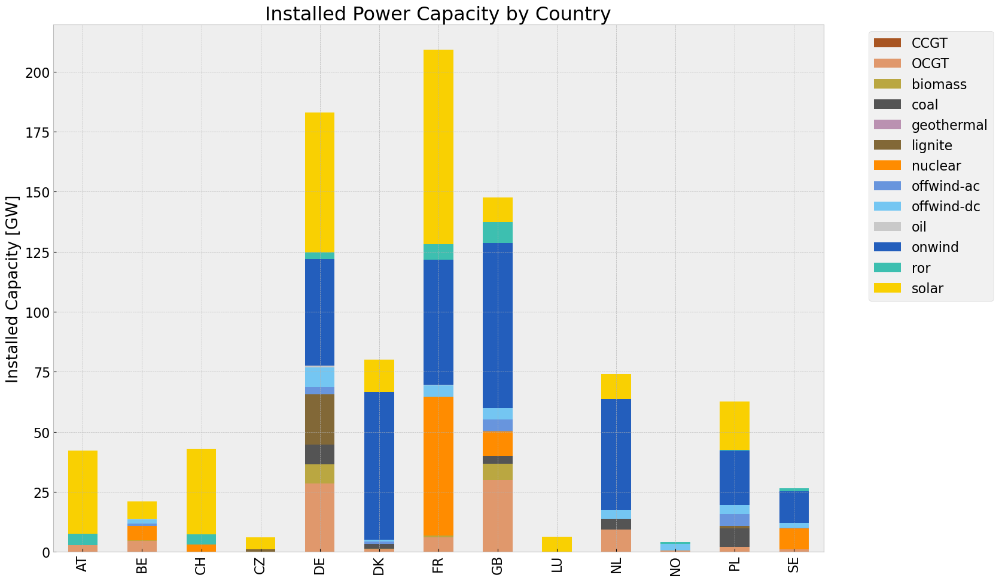

In [229]:
# consolidated istalled cap without load_shedding

#capacities_inv = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_inv.fillna(0, inplace=True)
#gen_1 = (capacities_inv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv = inst_cap_table(n1, color_cap)
cap_inv_country= inst_cap_table_country(n1, color_cap)


## Generation

<Figure size 640x480 with 0 Axes>

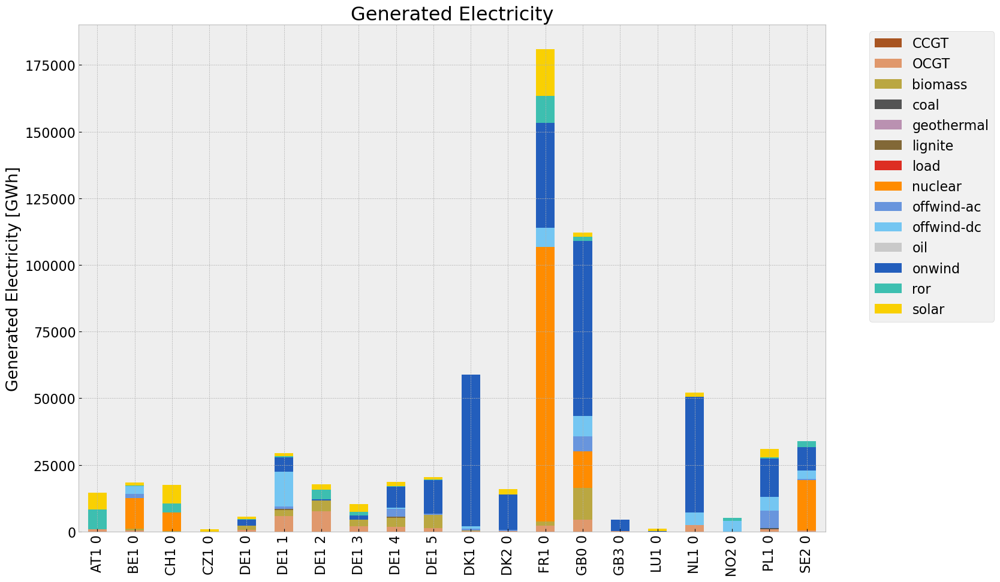

<Figure size 640x480 with 0 Axes>

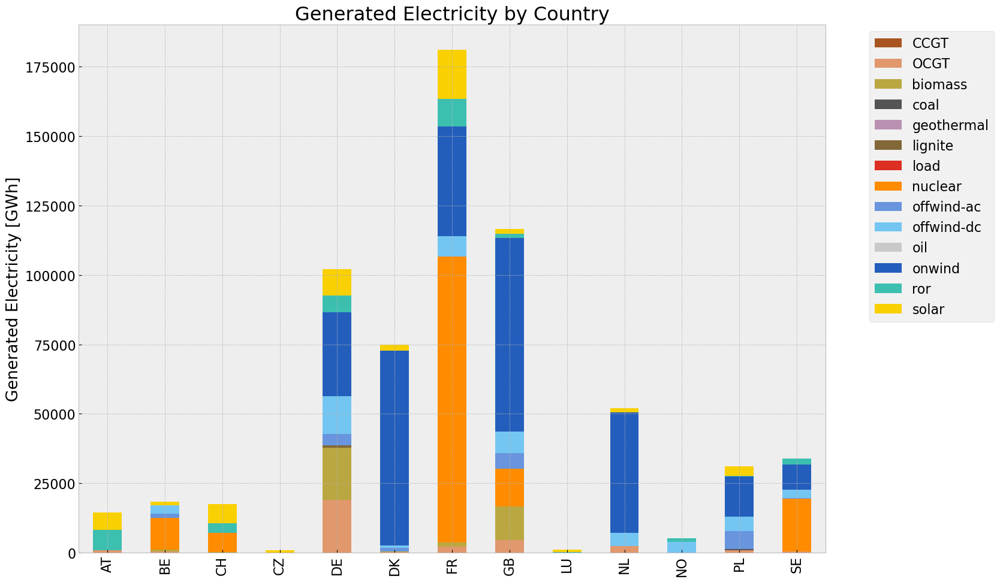

In [230]:
# consolidated generation table
#carrier = n1.generators.carrier.unique()
#df_tot_generation = n1.generators_t.p.sum()

#generations = pd.Series(index = n1.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
           # except KeyError:
               # print('error')
                
#generations.fillna(0, inplace=True)
#gen_inv = generations.unstack()/1000#Gwh


gen_inv = gen_power_table(n1,colors_gen_table)
gen_inv_country = gen_power_table_country(n1,colors_gen_table)

## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\a

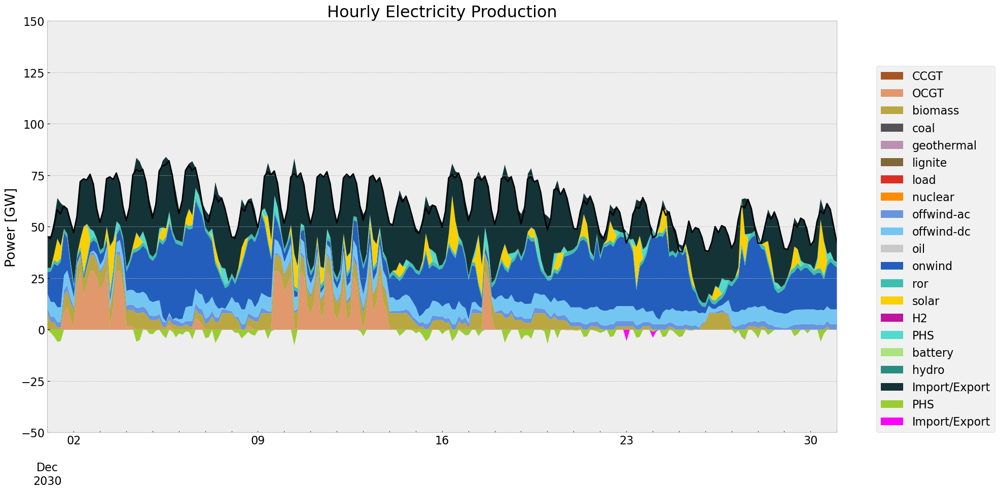

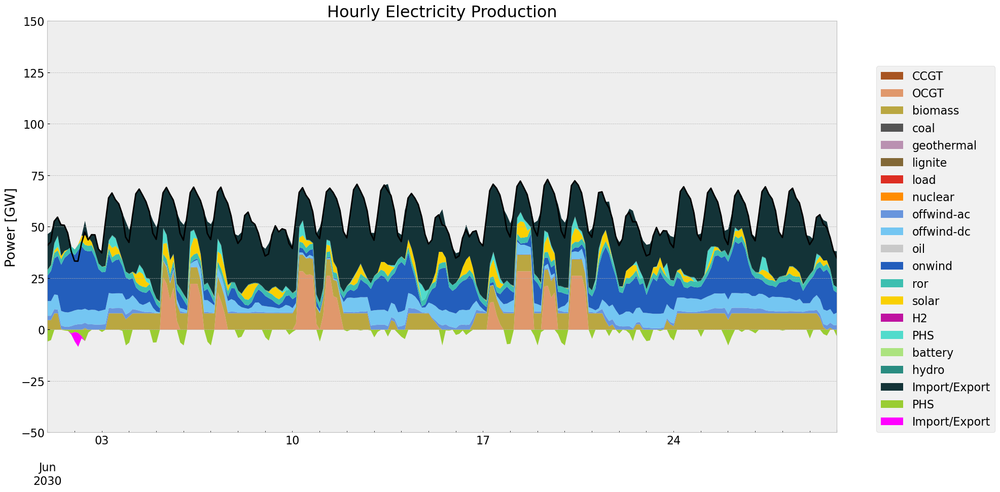

In [231]:
gen_curve(n1, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n1, '2030-06-1', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')

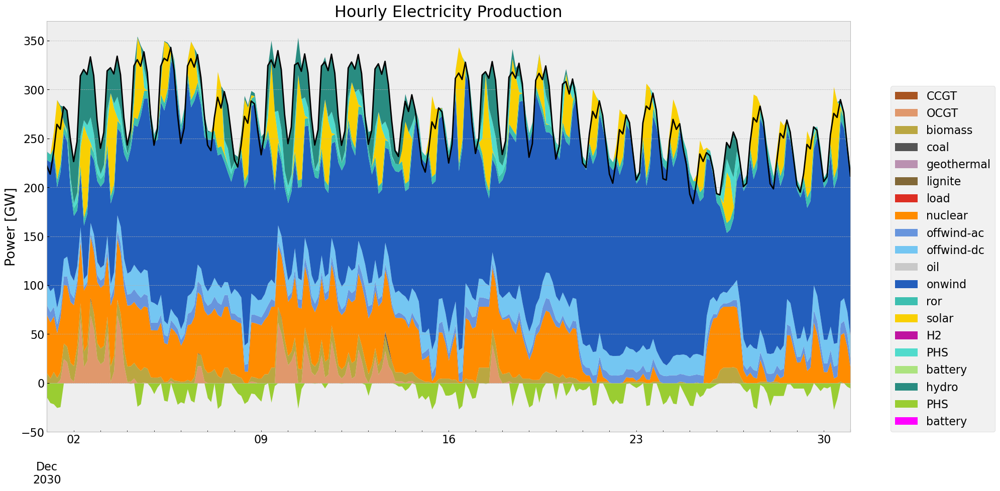

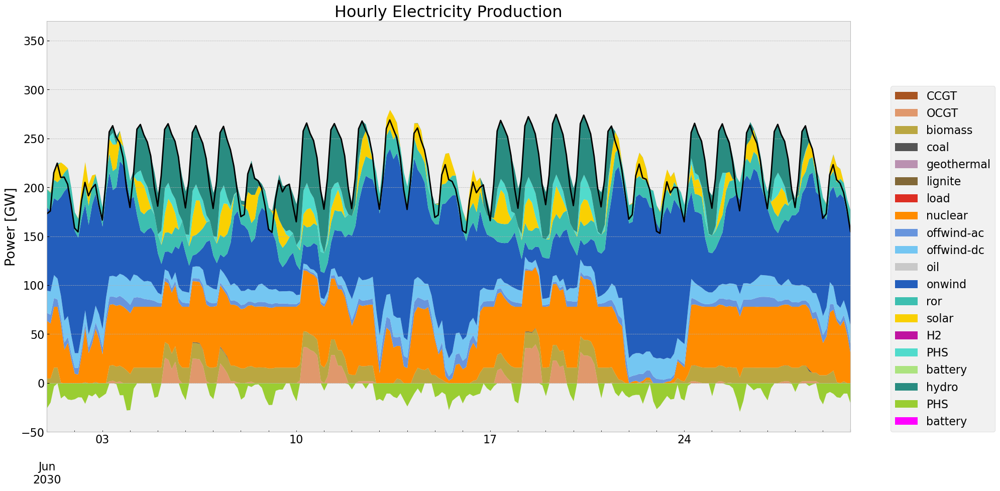

In [232]:
#generation curve all countries
#winter
gen_curve_tot(n1, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n1, '2030-06-01', '2030-06-30', colors_gen)

## Storage

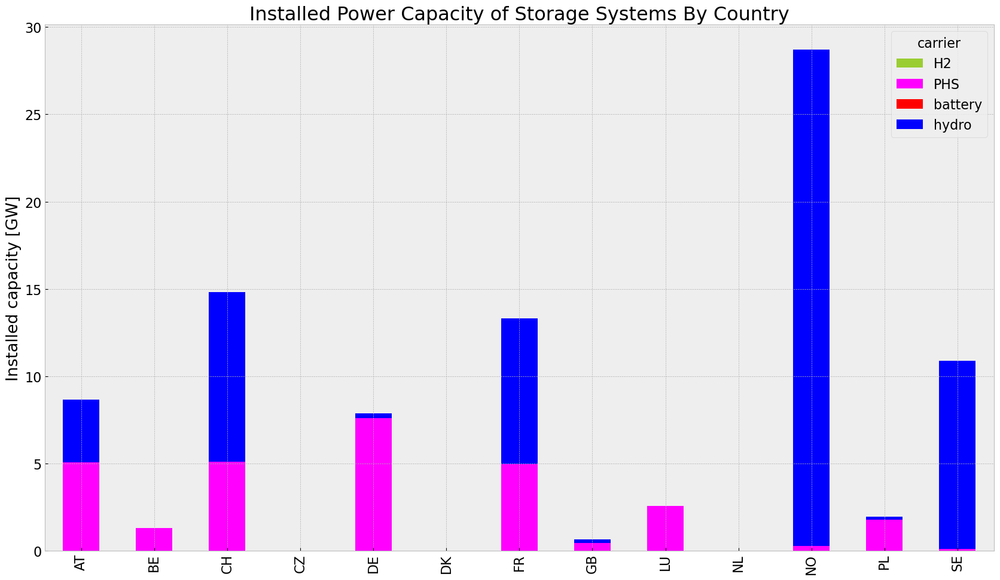

In [233]:
store_inv = inst_store_table(n1)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')


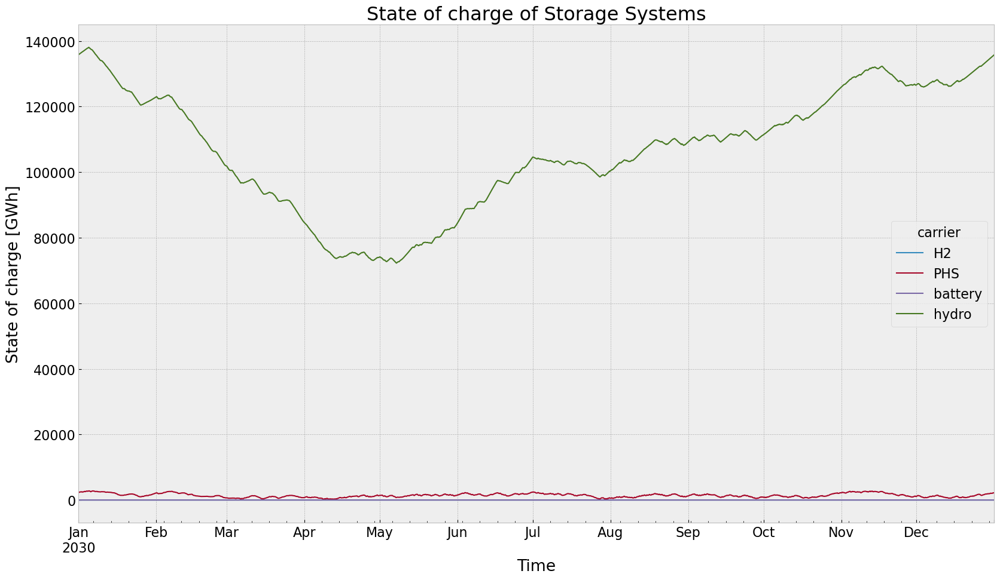

In [234]:
state_of_charge_plot(n1)


## Electricity Price


c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


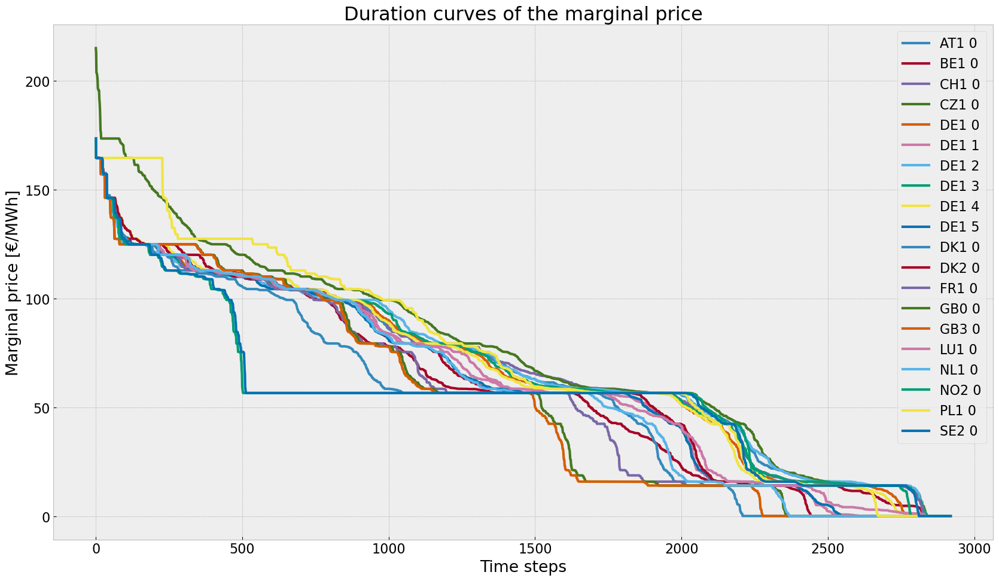

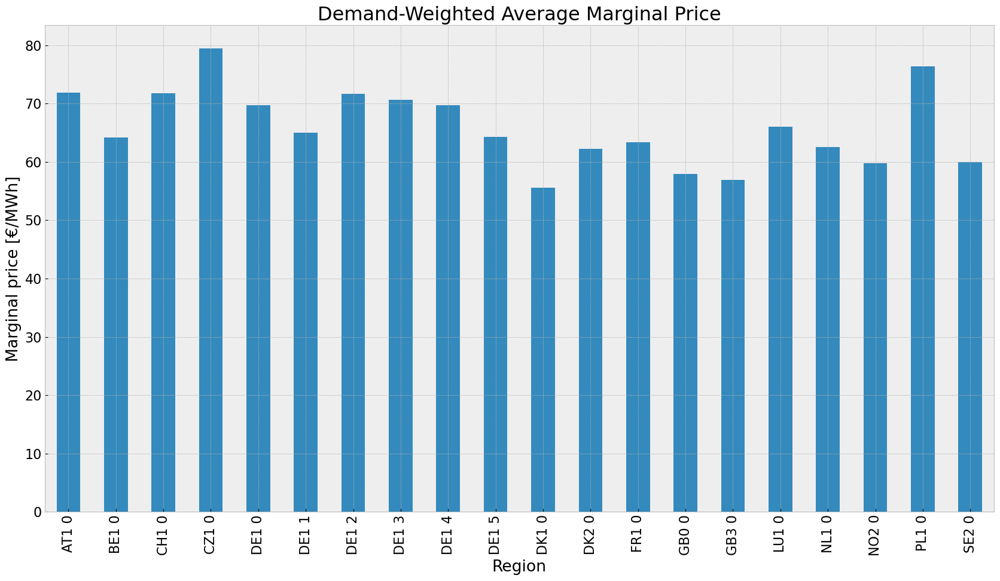

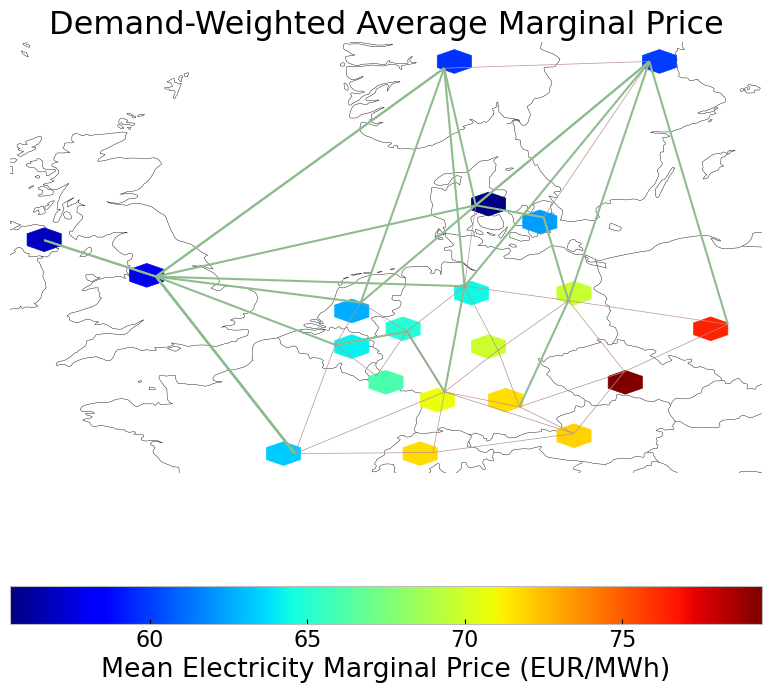

In [235]:
price_dur_curve_plot(n1)
price_regions_table(n1)
price_regions(n1)


## Emission

In [236]:
em_inv =em_table(n1)
em_inv

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,3.100764e+07,0.451621,0.1980,1.359440e+07
biomass,3.320961e+07,0.468000,0.0000,0.000000e+00
coal,6.555226e+05,0.329908,0.3361,6.678259e+05
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,8.601814e+05,0.337285,0.4069,1.037722e+06
load,0.000000e+00,1.000000,0.0000,0.000000e+00
nuclear,1.541101e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.954008e+07,1.000000,0.0000,0.000000e+00


## 2. Scenario: perfect foresight with no additional investment

In [253]:
n2 = pvscenario(n, cut_start, duration, reduction)
n2.name = 'noinv'     

### No Investment

In [254]:
def no_inv(n2,n):
    #set the optimal capacity of generators from the base scenario as the new minimum capacity 
    for index, value in n2.generators.p_nom_extendable.items():
        if value:  
            n2.generators.at[index, 'p_nom'] = n.generators.at[index, 'p_nom_opt']
            #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
            n2.generators.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of storage units from the base scenario as the new minimum capacity 
    for index, value in n2.storage_units.p_nom_extendable.items():
        if value:  
            n2.storage_units.at[index, 'p_nom'] = n.storage_units.at[index, 'p_nom_opt']
            #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
            n2.storage_units.at[index,'p_nom_extendable'] = False

    #set the optimal capacity of stores from the base scenario as the new minimum capacity 
    for index, value in n2.stores.e_nom_extendable.items():
        if value:  
            n2.stores.at[index, 'e_nom'] = n.stores.at[index, 'e_nom_opt']
            #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
            n2.stores.at[index, 'e_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.lines.s_nom_extendable.items():
        if value:  
            n2.lines.at[index, 's_nom'] = n.lines.at[index, 's_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.lines.at[index, 's_nom_extendable'] =False

    #set the optimal capacity of lines from the base scenario as the new minimum capacity 
    for index, value in n2.links.p_nom_extendable.items():
        if value:  
            n2.links.at[index, 's_nom'] = n.links.at[index, 'p_nom_opt']
            #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
            n2.links.at[index, 'p_nom_extendable'] =False

no_inv(n2,n)                 

In [255]:
n2.optimize(solver_name ='gurobi')
#n2 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\PV Cut\\20240511\\noinv.nc")

INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:05<00:00,  1.31it/s]
INFO:linopy.io: Writing time: 36.13s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kc7ednxv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kc7ednxv.lp


Reading time = 10.50 seconds


INFO:gurobipy:Reading time = 10.50 seconds


obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


INFO:gurobipy:obj: 3264560 rows, 1521320 columns, 5349440 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


INFO:gurobipy:Optimize a model with 3264560 rows, 1521320 columns and 5349440 nonzeros


Model fingerprint: 0x5667beff


INFO:gurobipy:Model fingerprint: 0x5667beff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 3e+04]


INFO:gurobipy:  Bounds range     [1e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 3102058 rows and 853422 columns


INFO:gurobipy:Presolve removed 3102058 rows and 853422 columns


Presolve time: 3.83s


INFO:gurobipy:Presolve time: 3.83s


Presolved: 162502 rows, 667898 columns, 1108778 nonzeros


INFO:gurobipy:Presolved: 162502 rows, 667898 columns, 1108778 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.31s


INFO:gurobipy:Ordering time: 0.31s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 4.647e+05


INFO:gurobipy: AA' NZ     : 4.647e+05


 Factor NZ  : 5.751e+06 (roughly 400 MB of memory)


INFO:gurobipy: Factor NZ  : 5.751e+06 (roughly 400 MB of memory)


 Factor Ops : 4.303e+08 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 4.303e+08 (less than 1 second per iteration)


 Threads    : 3


INFO:gurobipy: Threads    : 3


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.53203156e+13 -1.93240591e+15  7.20e+05 1.03e+03  2.38e+09     5s


INFO:gurobipy:   0   3.53203156e+13 -1.93240591e+15  7.20e+05 1.03e+03  2.38e+09     5s


   1   1.03754399e+13 -6.01880104e+13  7.75e+04 1.27e-11  1.38e+08     6s


INFO:gurobipy:   1   1.03754399e+13 -6.01880104e+13  7.75e+04 1.27e-11  1.38e+08     6s


   2   1.86742340e+12 -1.45691546e+13  3.90e+03 1.09e-11  1.54e+07     6s


INFO:gurobipy:   2   1.86742340e+12 -1.45691546e+13  3.90e+03 1.09e-11  1.54e+07     6s


   3   5.71301394e+11 -3.48762751e+12  4.07e+02 6.73e-11  3.21e+06     6s


INFO:gurobipy:   3   5.71301394e+11 -3.48762751e+12  4.07e+02 6.73e-11  3.21e+06     6s


   4   1.94786792e+11 -1.86141891e+12  1.25e+02 3.09e-11  1.58e+06     7s


INFO:gurobipy:   4   1.94786792e+11 -1.86141891e+12  1.25e+02 3.09e-11  1.58e+06     7s


   5   1.38570384e+11 -7.77216197e+11  6.99e+01 1.64e-11  6.97e+05     7s


INFO:gurobipy:   5   1.38570384e+11 -7.77216197e+11  6.99e+01 1.64e-11  6.97e+05     7s


   6   1.11465240e+11 -2.54648662e+11  3.95e+01 1.82e-11  2.78e+05     7s


INFO:gurobipy:   6   1.11465240e+11 -2.54648662e+11  3.95e+01 1.82e-11  2.78e+05     7s


   7   9.11750102e+10 -1.27182920e+11  2.17e+01 1.46e-11  1.65e+05     8s


INFO:gurobipy:   7   9.11750102e+10 -1.27182920e+11  2.17e+01 1.46e-11  1.65e+05     8s


   8   6.19116264e+10 -2.14746983e+10  5.21e+00 1.09e-11  6.26e+04     8s


INFO:gurobipy:   8   6.19116264e+10 -2.14746983e+10  5.21e+00 1.09e-11  6.26e+04     8s


   9   5.60589600e+10  6.92100358e+09  3.36e+00 1.09e-11  3.69e+04     8s


INFO:gurobipy:   9   5.60589600e+10  6.92100358e+09  3.36e+00 1.09e-11  3.69e+04     8s


  10   4.74121780e+10  2.45844700e+10  1.10e+00 7.28e-12  1.71e+04     9s


INFO:gurobipy:  10   4.74121780e+10  2.45844700e+10  1.10e+00 7.28e-12  1.71e+04     9s


  11   4.58385372e+10  3.14413496e+10  8.15e-01 3.64e-12  1.08e+04     9s


INFO:gurobipy:  11   4.58385372e+10  3.14413496e+10  8.15e-01 3.64e-12  1.08e+04     9s


  12   4.37406477e+10  3.51333021e+10  4.56e-01 3.64e-12  6.45e+03     9s


INFO:gurobipy:  12   4.37406477e+10  3.51333021e+10  4.56e-01 3.64e-12  6.45e+03     9s


  13   4.22733943e+10  3.77814987e+10  2.26e-01 3.64e-12  3.36e+03    10s


INFO:gurobipy:  13   4.22733943e+10  3.77814987e+10  2.26e-01 3.64e-12  3.36e+03    10s


  14   4.15474711e+10  3.84138565e+10  1.21e-01 1.92e-12  2.35e+03    10s


INFO:gurobipy:  14   4.15474711e+10  3.84138565e+10  1.21e-01 1.92e-12  2.35e+03    10s


  15   4.13775904e+10  3.91187240e+10  9.71e-02 3.64e-12  1.69e+03    10s


INFO:gurobipy:  15   4.13775904e+10  3.91187240e+10  9.71e-02 3.64e-12  1.69e+03    10s


  16   4.12500765e+10  3.94387945e+10  7.96e-02 3.64e-12  1.36e+03    11s


INFO:gurobipy:  16   4.12500765e+10  3.94387945e+10  7.96e-02 3.64e-12  1.36e+03    11s


  17   4.11388139e+10  3.97305691e+10  6.45e-02 3.64e-12  1.05e+03    11s


INFO:gurobipy:  17   4.11388139e+10  3.97305691e+10  6.45e-02 3.64e-12  1.05e+03    11s


  18   4.10298060e+10  4.00034234e+10  4.99e-02 3.64e-12  7.68e+02    11s


INFO:gurobipy:  18   4.10298060e+10  4.00034234e+10  4.99e-02 3.64e-12  7.68e+02    11s


  19   4.09488366e+10  4.01964673e+10  3.92e-02 3.64e-12  5.63e+02    12s


INFO:gurobipy:  19   4.09488366e+10  4.01964673e+10  3.92e-02 3.64e-12  5.63e+02    12s


  20   4.08803856e+10  4.03052111e+10  3.03e-02 2.33e-12  4.31e+02    12s


INFO:gurobipy:  20   4.08803856e+10  4.03052111e+10  3.03e-02 2.33e-12  4.31e+02    12s


  21   4.08523308e+10  4.03698783e+10  2.67e-02 1.82e-12  3.61e+02    13s


INFO:gurobipy:  21   4.08523308e+10  4.03698783e+10  2.67e-02 1.82e-12  3.61e+02    13s


  22   4.08292772e+10  4.04279753e+10  2.37e-02 3.64e-12  3.00e+02    13s


INFO:gurobipy:  22   4.08292772e+10  4.04279753e+10  2.37e-02 3.64e-12  3.00e+02    13s


  23   4.08066640e+10  4.04747481e+10  2.09e-02 2.69e-12  2.49e+02    13s


INFO:gurobipy:  23   4.08066640e+10  4.04747481e+10  2.09e-02 2.69e-12  2.49e+02    13s


  24   4.07873058e+10  4.04997513e+10  1.84e-02 3.07e-12  2.15e+02    14s


INFO:gurobipy:  24   4.07873058e+10  4.04997513e+10  1.84e-02 3.07e-12  2.15e+02    14s


  25   4.07184807e+10  4.05479396e+10  9.68e-03 3.64e-12  1.28e+02    14s


INFO:gurobipy:  25   4.07184807e+10  4.05479396e+10  9.68e-03 3.64e-12  1.28e+02    14s


  26   4.06974180e+10  4.05709900e+10  7.09e-03 4.13e-10  9.47e+01    15s


INFO:gurobipy:  26   4.06974180e+10  4.05709900e+10  7.09e-03 4.13e-10  9.47e+01    15s


  27   4.06852841e+10  4.05834148e+10  5.58e-03 6.77e-09  7.63e+01    15s


INFO:gurobipy:  27   4.06852841e+10  4.05834148e+10  5.58e-03 6.77e-09  7.63e+01    15s


  28   4.06786476e+10  4.05947159e+10  4.74e-03 1.52e-08  6.28e+01    16s


INFO:gurobipy:  28   4.06786476e+10  4.05947159e+10  4.74e-03 1.52e-08  6.28e+01    16s


  29   4.06708629e+10  4.06054121e+10  3.76e-03 2.72e-08  4.90e+01    16s


INFO:gurobipy:  29   4.06708629e+10  4.06054121e+10  3.76e-03 2.72e-08  4.90e+01    16s


  30   4.06641043e+10  4.06129318e+10  2.92e-03 2.24e-08  3.83e+01    17s


INFO:gurobipy:  30   4.06641043e+10  4.06129318e+10  2.92e-03 2.24e-08  3.83e+01    17s


  31   4.06581287e+10  4.06184834e+10  2.18e-03 1.86e-08  2.97e+01    17s


INFO:gurobipy:  31   4.06581287e+10  4.06184834e+10  2.18e-03 1.86e-08  2.97e+01    17s


  32   4.06547228e+10  4.06248480e+10  1.74e-03 1.49e-08  2.24e+01    17s


INFO:gurobipy:  32   4.06547228e+10  4.06248480e+10  1.74e-03 1.49e-08  2.24e+01    17s


  33   4.06513549e+10  4.06306871e+10  1.31e-03 1.06e-08  1.55e+01    18s


INFO:gurobipy:  33   4.06513549e+10  4.06306871e+10  1.31e-03 1.06e-08  1.55e+01    18s


  34   4.06487526e+10  4.06340089e+10  9.92e-04 7.72e-09  1.10e+01    18s


INFO:gurobipy:  34   4.06487526e+10  4.06340089e+10  9.92e-04 7.72e-09  1.10e+01    18s


  35   4.06463820e+10  4.06354997e+10  7.02e-04 6.40e-09  8.15e+00    19s


INFO:gurobipy:  35   4.06463820e+10  4.06354997e+10  7.02e-04 6.40e-09  8.15e+00    19s


  36   4.06458031e+10  4.06368845e+10  6.33e-04 5.18e-09  6.68e+00    19s


INFO:gurobipy:  36   4.06458031e+10  4.06368845e+10  6.33e-04 5.18e-09  6.68e+00    19s


  37   4.06439252e+10  4.06371592e+10  3.92e-04 4.85e-09  5.07e+00    20s


INFO:gurobipy:  37   4.06439252e+10  4.06371592e+10  3.92e-04 4.85e-09  5.07e+00    20s


  38   4.06438441e+10  4.06373468e+10  3.82e-04 4.67e-09  4.86e+00    20s


INFO:gurobipy:  38   4.06438441e+10  4.06373468e+10  3.82e-04 4.67e-09  4.86e+00    20s


  39   4.06431051e+10  4.06381952e+10  2.86e-04 4.98e-09  3.68e+00    21s


INFO:gurobipy:  39   4.06431051e+10  4.06381952e+10  2.86e-04 4.98e-09  3.68e+00    21s


  40   4.06425434e+10  4.06390768e+10  2.13e-04 3.73e-09  2.60e+00    21s


INFO:gurobipy:  40   4.06425434e+10  4.06390768e+10  2.13e-04 3.73e-09  2.60e+00    21s


  41   4.06419888e+10  4.06393639e+10  1.43e-04 4.57e-09  1.97e+00    21s


INFO:gurobipy:  41   4.06419888e+10  4.06393639e+10  1.43e-04 4.57e-09  1.97e+00    21s


  42   4.06416233e+10  4.06402919e+10  9.49e-05 2.43e-09  9.97e-01    22s


INFO:gurobipy:  42   4.06416233e+10  4.06402919e+10  9.49e-05 2.43e-09  9.97e-01    22s


  43   4.06412822e+10  4.06403928e+10  5.20e-05 2.03e-09  6.66e-01    22s


INFO:gurobipy:  43   4.06412822e+10  4.06403928e+10  5.20e-05 2.03e-09  6.66e-01    22s


  44   4.06411291e+10  4.06406020e+10  3.31e-05 1.61e-09  3.95e-01    23s


INFO:gurobipy:  44   4.06411291e+10  4.06406020e+10  3.31e-05 1.61e-09  3.95e-01    23s


  45   4.06410631e+10  4.06407168e+10  2.51e-05 1.38e-09  2.59e-01    23s


INFO:gurobipy:  45   4.06410631e+10  4.06407168e+10  2.51e-05 1.38e-09  2.59e-01    23s


  46   4.06410160e+10  4.06407806e+10  1.94e-05 1.23e-09  1.76e-01    23s


INFO:gurobipy:  46   4.06410160e+10  4.06407806e+10  1.94e-05 1.23e-09  1.76e-01    23s


  47   4.06409338e+10  4.06407999e+10  9.72e-06 1.06e-09  1.00e-01    24s


INFO:gurobipy:  47   4.06409338e+10  4.06407999e+10  9.72e-06 1.06e-09  1.00e-01    24s


  48   4.06409117e+10  4.06408266e+10  7.11e-06 8.19e-10  6.38e-02    24s


INFO:gurobipy:  48   4.06409117e+10  4.06408266e+10  7.11e-06 8.19e-10  6.38e-02    24s


  49   4.06408792e+10  4.06408398e+10  3.32e-06 4.13e-10  2.95e-02    24s


INFO:gurobipy:  49   4.06408792e+10  4.06408398e+10  3.32e-06 4.13e-10  2.95e-02    24s


  50   4.06408662e+10  4.06408445e+10  1.84e-06 2.72e-10  1.62e-02    25s


INFO:gurobipy:  50   4.06408662e+10  4.06408445e+10  1.84e-06 2.72e-10  1.62e-02    25s


  51   4.06408567e+10  4.06408475e+10  7.46e-07 1.80e-10  6.83e-03    25s


INFO:gurobipy:  51   4.06408567e+10  4.06408475e+10  7.46e-07 1.80e-10  6.83e-03    25s


  52   4.06408525e+10  4.06408491e+10  2.99e-07 8.12e-11  2.57e-03    26s


INFO:gurobipy:  52   4.06408525e+10  4.06408491e+10  2.99e-07 8.12e-11  2.57e-03    26s


  53   4.06408502e+10  4.06408494e+10  2.15e-07 9.65e-11  6.10e-04    26s


INFO:gurobipy:  53   4.06408502e+10  4.06408494e+10  2.15e-07 9.65e-11  6.10e-04    26s


  54   4.06408498e+10  4.06408496e+10  5.54e-08 2.39e-11  1.48e-04    26s


INFO:gurobipy:  54   4.06408498e+10  4.06408496e+10  5.54e-08 2.39e-11  1.48e-04    26s


  55   4.06408497e+10  4.06408496e+10  1.80e-08 1.33e-11  2.17e-05    27s


INFO:gurobipy:  55   4.06408497e+10  4.06408496e+10  1.80e-08 1.33e-11  2.17e-05    27s


  56   4.06408496e+10  4.06408496e+10  1.69e-08 5.46e-12  8.40e-07    27s


INFO:gurobipy:  56   4.06408496e+10  4.06408496e+10  1.69e-08 5.46e-12  8.40e-07    27s


  57   4.06408496e+10  4.06408496e+10  1.11e-08 3.64e-12  1.23e-08    28s


INFO:gurobipy:  57   4.06408496e+10  4.06408496e+10  1.11e-08 3.64e-12  1.23e-08    28s


  58   4.06408496e+10  4.06408496e+10  1.36e-08 5.46e-12  2.24e-10    28s


INFO:gurobipy:  58   4.06408496e+10  4.06408496e+10  1.36e-08 5.46e-12  2.24e-10    28s


INFO:gurobipy:


Barrier solved model in 58 iterations and 28.09 seconds (14.14 work units)


INFO:gurobipy:Barrier solved model in 58 iterations and 28.09 seconds (14.14 work units)


Optimal objective 4.06408496e+10


INFO:gurobipy:Optimal objective 4.06408496e+10


INFO:gurobipy:


Crossover log...


INFO:gurobipy:Crossover log...


INFO:gurobipy:


   14785 DPushes remaining with DInf 0.0000000e+00                29s


INFO:gurobipy:   14785 DPushes remaining with DInf 0.0000000e+00                29s


       0 DPushes remaining with DInf 0.0000000e+00                30s


INFO:gurobipy:       0 DPushes remaining with DInf 0.0000000e+00                30s


INFO:gurobipy:Warning: Markowitz tolerance tightened to 0.5


INFO:gurobipy:


   16464 PPushes remaining with PInf 0.0000000e+00                30s


INFO:gurobipy:   16464 PPushes remaining with PInf 0.0000000e+00                30s


       0 PPushes remaining with PInf 0.0000000e+00                34s


INFO:gurobipy:       0 PPushes remaining with PInf 0.0000000e+00                34s


INFO:gurobipy:


  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6838061e-09     34s


INFO:gurobipy:  Push phase complete: Pinf 0.0000000e+00, Dinf 1.6838061e-09     34s


INFO:gurobipy:


INFO:gurobipy:


Solved with barrier


INFO:gurobipy:Solved with barrier


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


   31252    4.0640850e+10   0.000000e+00   0.000000e+00     36s


INFO:gurobipy:   31252    4.0640850e+10   0.000000e+00   0.000000e+00     36s


INFO:gurobipy:


Solved in 31252 iterations and 36.47 seconds (17.06 work units)


INFO:gurobipy:Solved in 31252 iterations and 36.47 seconds (17.06 work units)


Optimal objective  4.064084964e+10


INFO:gurobipy:Optimal objective  4.064084964e+10
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 1521320 primals, 3264560 duals
Objective: 4.06e+10
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


('ok', 'optimal')

### Export model for later use

In [256]:
#file = "noinv.nc"
#output_path = os.path.join(os.getcwd(), file)
#n2.export_to_netcdf(output_path)

In [257]:
tot_cos_noinv=n2.objective/1e9 #billion €
system_cost_noinv = system_cost(n2) #million €/a
marg_price_region_noinv = n2.buses_t.marginal_price.mean()
stat_noinv = n2.statistics()

## Installed Capacity

Since expansion is not allowed in this scenario, the installed capacity will equal to that of the base scenario.

<Figure size 640x480 with 0 Axes>

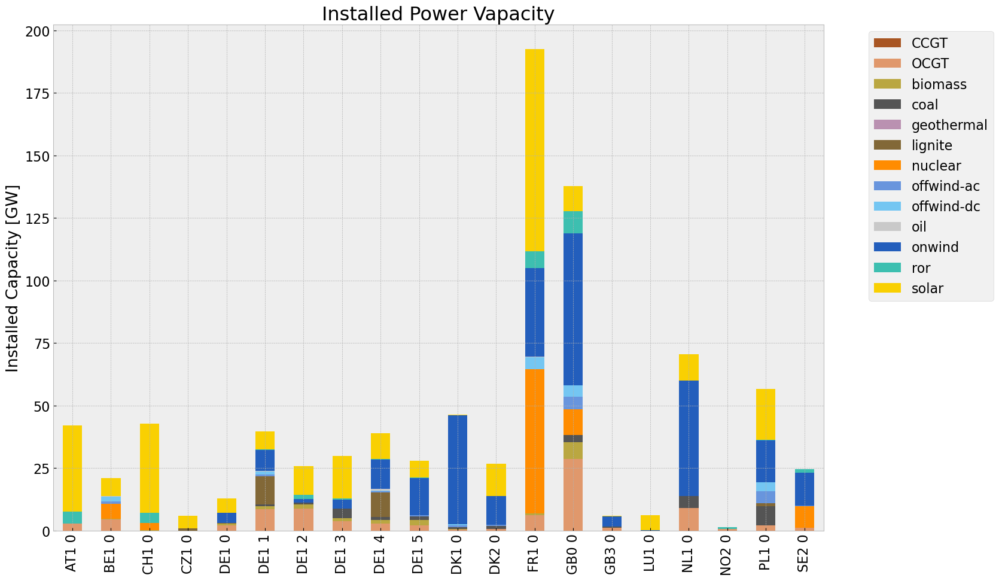

<Figure size 640x480 with 0 Axes>

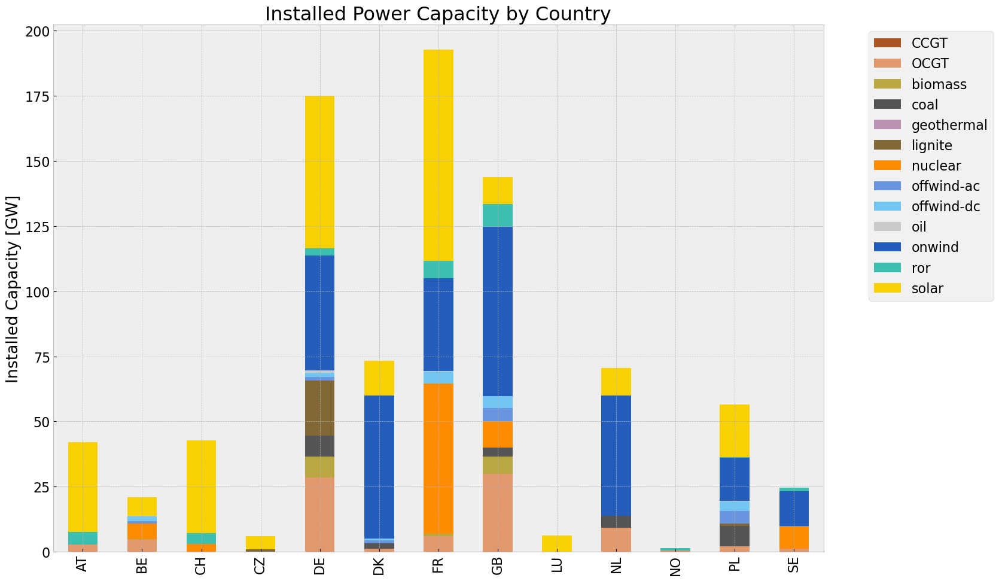

In [258]:
# consolidated istalled cap without load_shedding

#capacities_noinv = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv.fillna(0, inplace=True)
#gen = (capacities_noinv.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv = inst_cap_table(n2, color_cap)
cap_noinv_country= inst_cap_table_country(n2, color_cap)



## Generation

<Figure size 640x480 with 0 Axes>

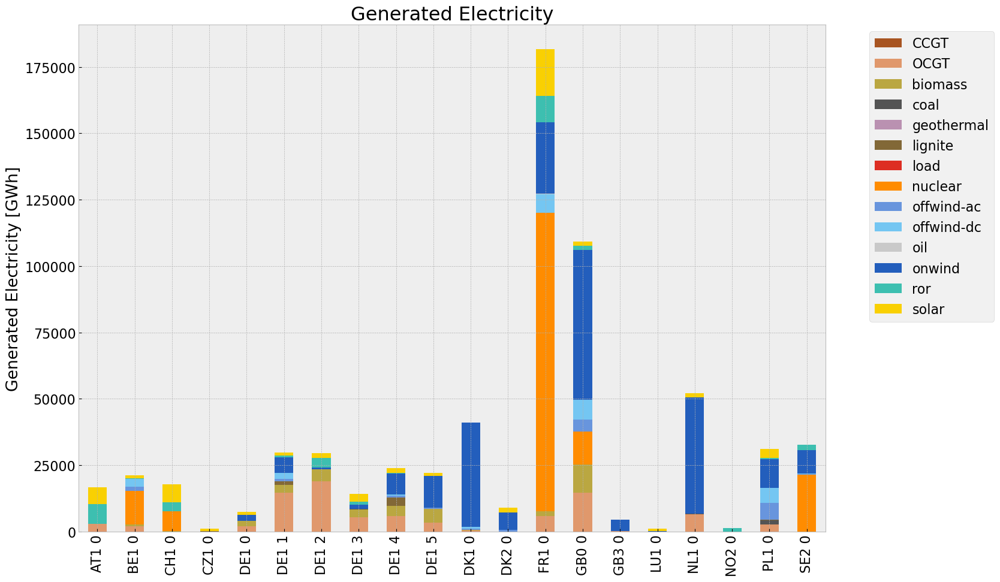

<Figure size 640x480 with 0 Axes>

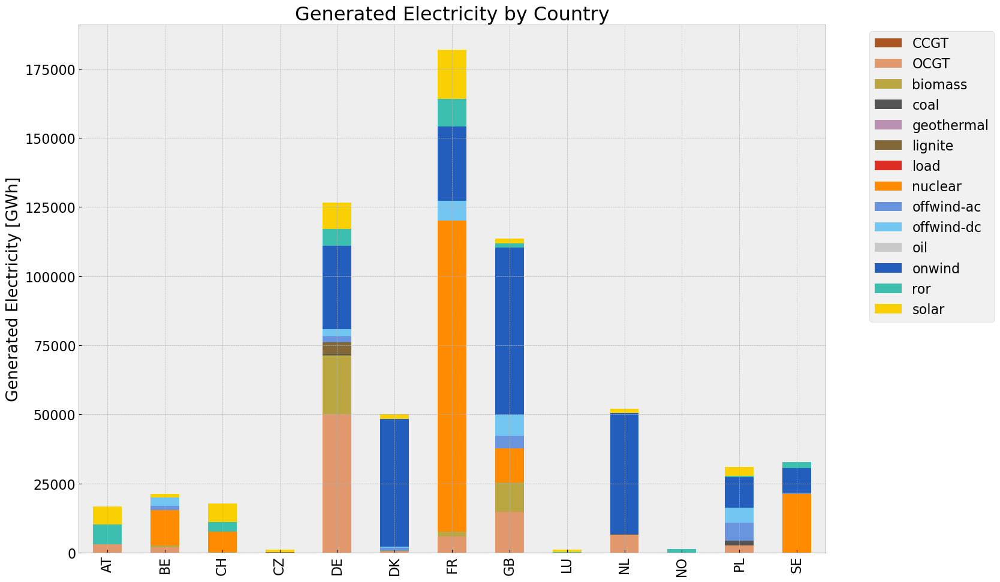

In [259]:
# consolidated generation table
#carrier = n2.generators.carrier.unique()
#df_tot_generation = n2.generators_t.p.sum()

#generations = pd.Series(index = n2.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
        #key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
                #generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')

#generations.fillna(0, inplace=True)
#gen_noinv = generations.unstack()/1000#GWh

gen_noinv= gen_power_table(n2,colors_gen_table)
gen_noinv_country = gen_power_table_country(n2,colors_gen_table)


## Snapshot

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2796143640.py:1: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2796143640.py:2: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #M

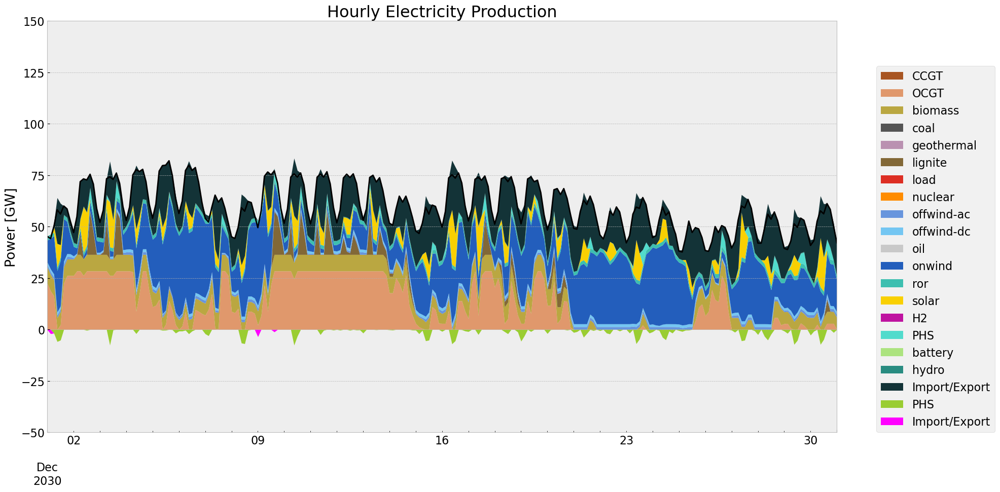

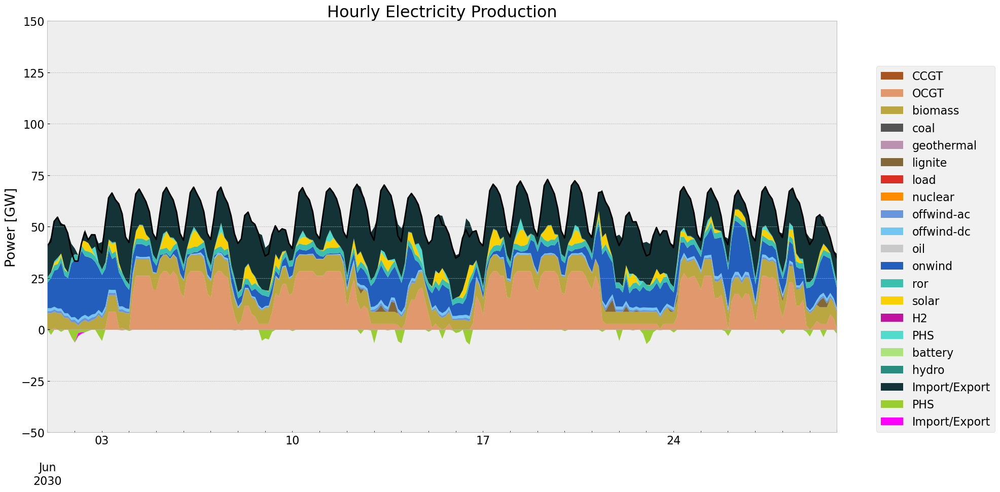

In [260]:
p = n2.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
sto = n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n2, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n2, '2030-06-01', '2030-06-30', colors_gen,'DE')


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:5: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = n.generators_t.p.groupby(n.generators.carrier, axis=1).sum() # MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:9: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = n.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:13: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\2535220694.py:19: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')

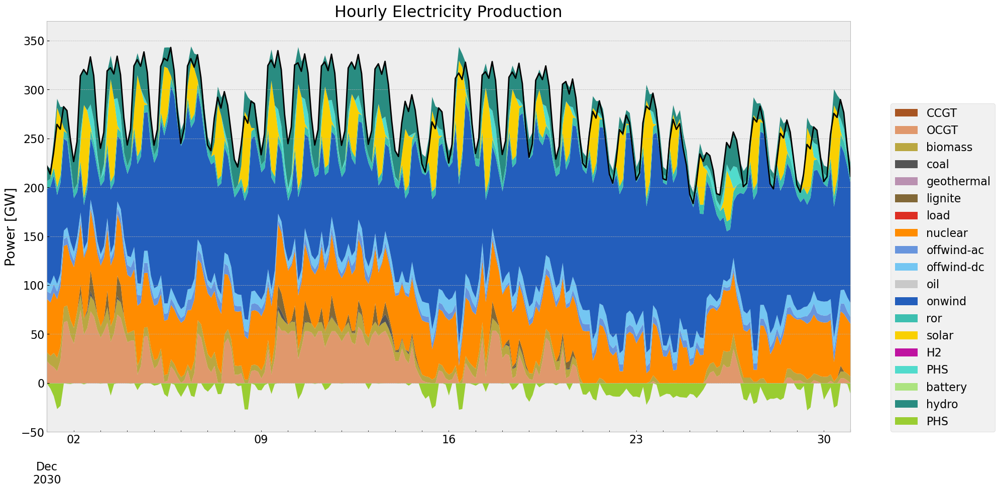

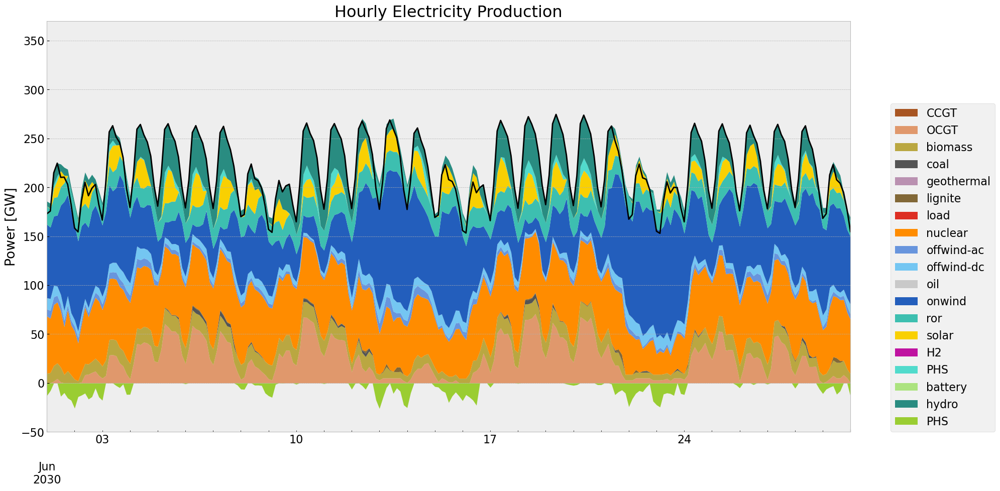

In [261]:
#generation curve all countries
#winter
gen_curve_tot(n2, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n2, '2030-06-01', '2030-06-30', colors_gen)

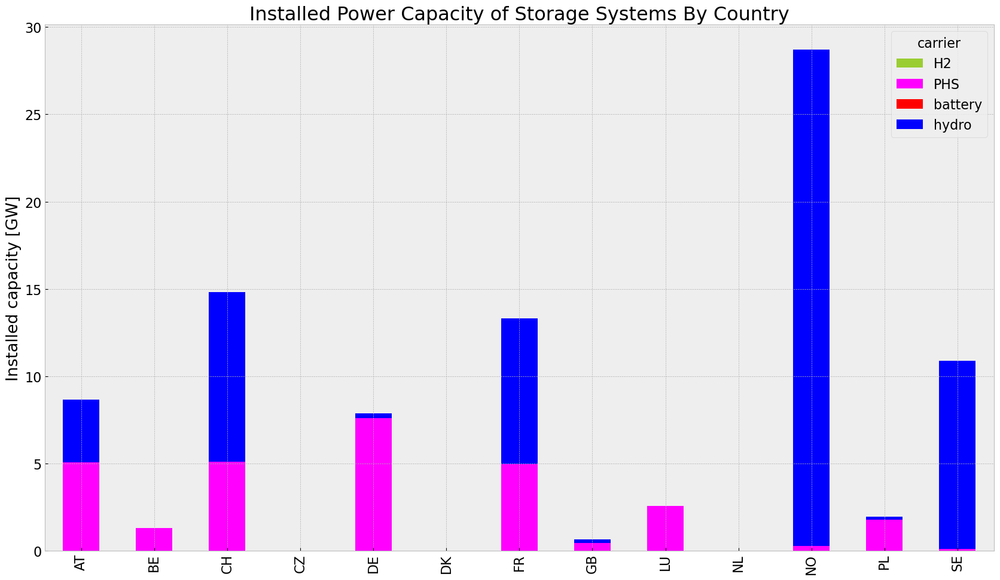

In [262]:
#storage unit capacities
store_noinv = inst_store_table(n2)

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3576090030.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  soc = n.storage_units_t.state_of_charge.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3576090030.py:5: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  soc.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\1117423567.py:3: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\1117423567.py:3: FutureWarning: 'H' is deprecated and will be removed in a future versi

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.554172e+07,0.451621,0.1980,3.750327e+07
biomass,3.484756e+07,0.468000,0.0000,0.000000e+00
coal,2.261011e+06,0.329908,0.3361,2.303448e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,4.781352e+06,0.337285,0.4069,5.768218e+06
load,1.437184e+04,1.000000,0.0000,0.000000e+00
nuclear,1.658296e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.598762e+07,1.000000,0.0000,0.000000e+00


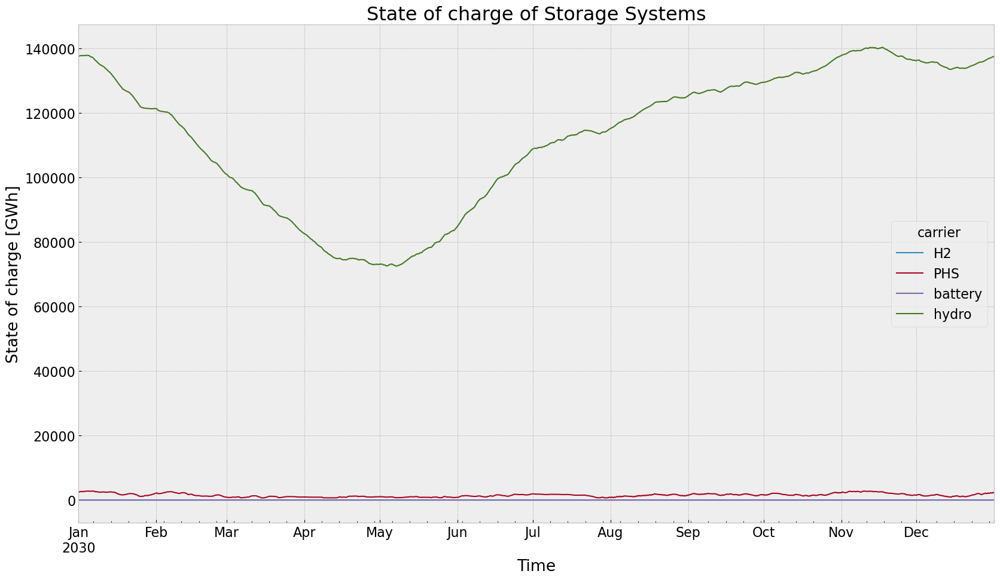

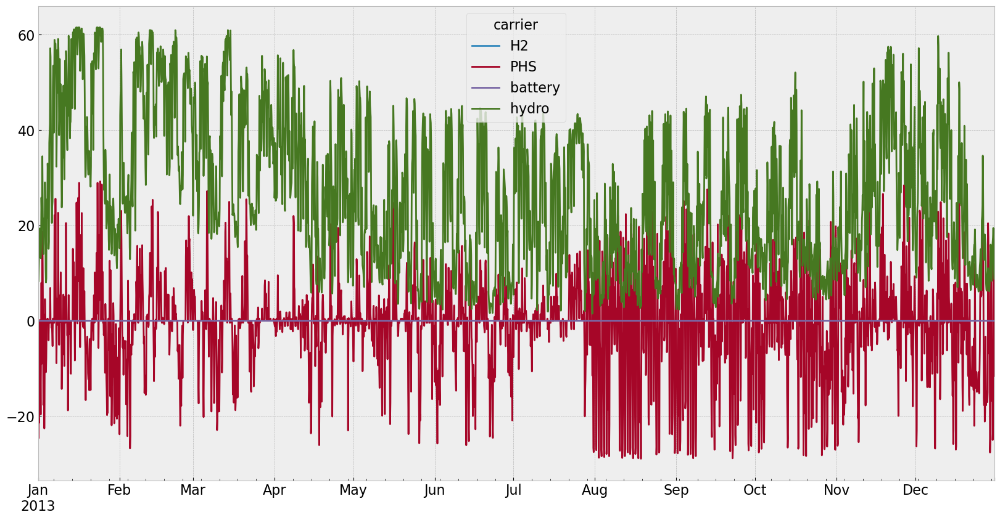

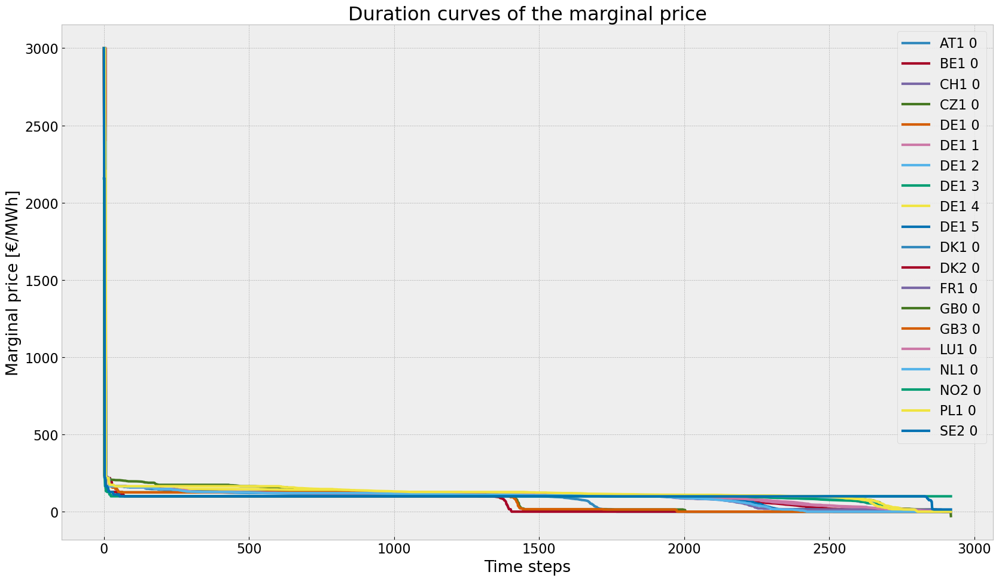

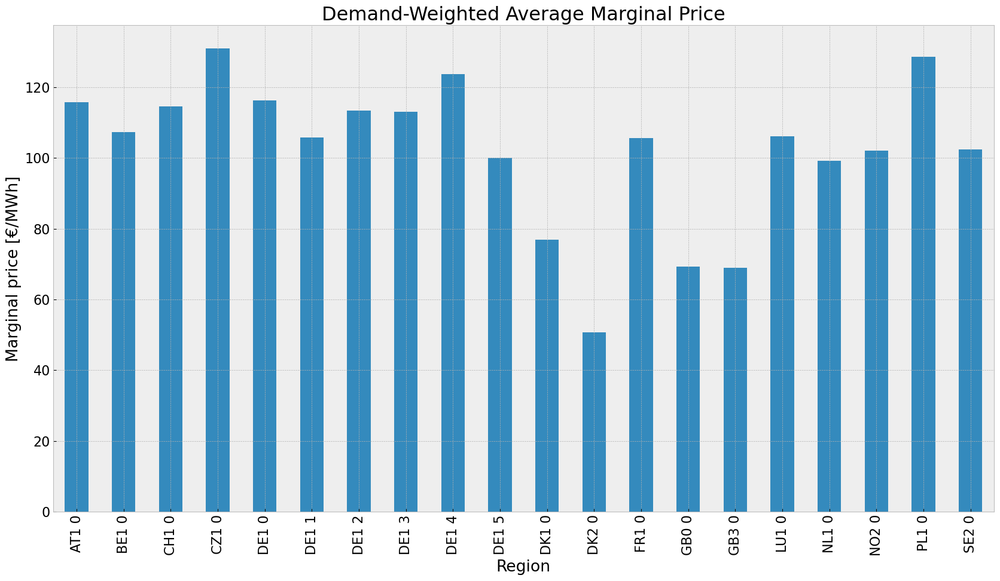

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


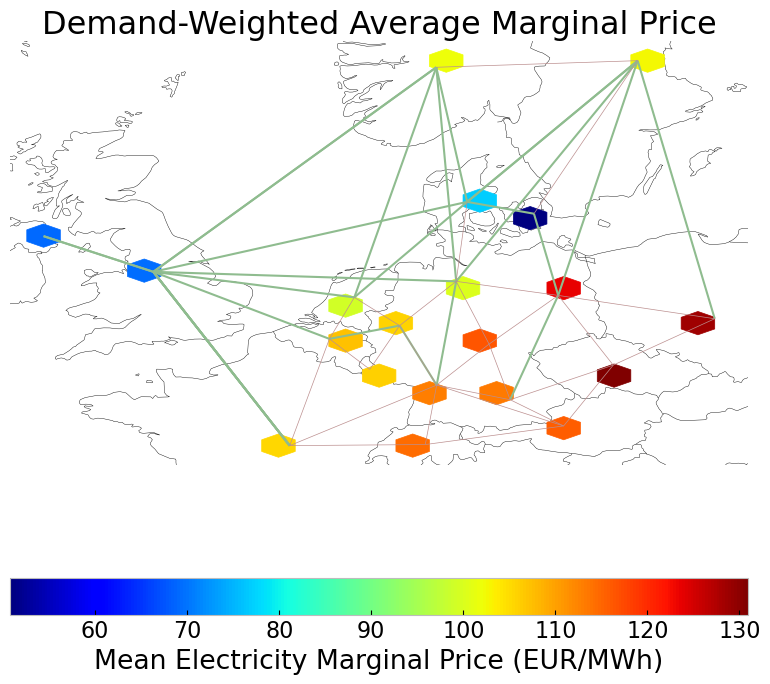

In [263]:
#state of charge
state_of_charge_plot(n2)
n2.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))
#price
price_dur_curve_plot(n2)
price_regions_table(n2)
price_regions(n2)
#emission
em_noinv =em_table(n2)
em_noinv

## 3. Scenario: rolling horizon foresight with no additional investment

In [264]:
n3= n2.copy()
n3.name = 'noinv_roll'
horizon = 24
n3.storage_units['cyclic_state_of_charge'] = False
n3.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n3, horizon=horizon, overlap=0, solver_name='gurobi')
#n3 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\PV Cut\\20240511\\noinv_roll.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8vzqejgb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8vzqejgb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x49f3e75e


INFO:gurobipy:Model fingerprint: 0x49f3e75e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25506 rows and 7247 columns


INFO:gurobipy:Presolve removed 25506 rows and 7247 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5257 columns, 8826 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


 Factor Ops : 1.344e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.344e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04238941e+11 -5.21872770e+11  8.83e+04 1.14e+04  5.13e+08     0s


INFO:gurobipy:   0   2.04238941e+11 -5.21872770e+11  8.83e+04 1.14e+04  5.13e+08     0s


   1   4.13805607e+10 -2.72055706e+11  1.09e+04 8.00e-11  7.77e+07     0s


INFO:gurobipy:   1   4.13805607e+10 -2.72055706e+11  1.09e+04 8.00e-11  7.77e+07     0s


   2   6.66080941e+09 -7.41322431e+10  6.66e+02 1.02e-10  9.83e+06     0s


INFO:gurobipy:   2   6.66080941e+09 -7.41322431e+10  6.66e+02 1.02e-10  9.83e+06     0s


   3   1.94994144e+09 -1.46242410e+10  1.26e+02 2.26e-09  1.76e+06     0s


INFO:gurobipy:   3   1.94994144e+09 -1.46242410e+10  1.26e+02 2.26e-09  1.76e+06     0s


   4   7.13892388e+08 -3.25030054e+09  1.76e+01 5.68e-10  3.90e+05     0s


INFO:gurobipy:   4   7.13892388e+08 -3.25030054e+09  1.76e+01 5.68e-10  3.90e+05     0s


   5   4.53063807e+08 -9.34990946e+08  6.43e+00 2.04e-10  1.34e+05     0s


INFO:gurobipy:   5   4.53063807e+08 -9.34990946e+08  6.43e+00 2.04e-10  1.34e+05     0s


   6   2.96215102e+08 -2.69210832e+08  2.56e+00 7.28e-11  5.42e+04     0s


INFO:gurobipy:   6   2.96215102e+08 -2.69210832e+08  2.56e+00 7.28e-11  5.42e+04     0s


   7   2.07935173e+08 -5.64859823e+07  7.42e-01 3.09e-11  2.52e+04     0s


INFO:gurobipy:   7   2.07935173e+08 -5.64859823e+07  7.42e-01 3.09e-11  2.52e+04     0s


   8   1.92088088e+08  3.60279676e+07  4.89e-01 2.91e-11  1.49e+04     0s


INFO:gurobipy:   8   1.92088088e+08  3.60279676e+07  4.89e-01 2.91e-11  1.49e+04     0s


   9   1.71920487e+08  1.19368536e+08  1.48e-01 2.59e-11  5.00e+03     0s


INFO:gurobipy:   9   1.71920487e+08  1.19368536e+08  1.48e-01 2.59e-11  5.00e+03     0s


  10   1.61485161e+08  1.46780121e+08  1.17e-02 2.43e-11  1.40e+03     0s


INFO:gurobipy:  10   1.61485161e+08  1.46780121e+08  1.17e-02 2.43e-11  1.40e+03     0s


  11   1.58994873e+08  1.53052957e+08  2.55e-03 2.36e-11  5.65e+02     0s


INFO:gurobipy:  11   1.58994873e+08  1.53052957e+08  2.55e-03 2.36e-11  5.65e+02     0s


  12   1.58159073e+08  1.55974141e+08  9.91e-04 2.91e-11  2.08e+02     0s


INFO:gurobipy:  12   1.58159073e+08  1.55974141e+08  9.91e-04 2.91e-11  2.08e+02     0s


  13   1.57814985e+08  1.56974656e+08  3.98e-04 2.22e-11  7.98e+01     0s


INFO:gurobipy:  13   1.57814985e+08  1.56974656e+08  3.98e-04 2.22e-11  7.98e+01     0s


  14   1.57670254e+08  1.57281900e+08  1.71e-04 2.91e-11  3.69e+01     0s


INFO:gurobipy:  14   1.57670254e+08  1.57281900e+08  1.71e-04 2.91e-11  3.69e+01     0s


  15   1.57585384e+08  1.57483312e+08  3.77e-05 3.07e-11  9.70e+00     0s


INFO:gurobipy:  15   1.57585384e+08  1.57483312e+08  3.77e-05 3.07e-11  9.70e+00     0s


  16   1.57559255e+08  1.57547477e+08  6.22e-06 2.37e-11  1.12e+00     0s


INFO:gurobipy:  16   1.57559255e+08  1.57547477e+08  6.22e-06 2.37e-11  1.12e+00     0s


  17   1.57553791e+08  1.57551323e+08  6.10e-07 3.10e-11  2.35e-01     0s


INFO:gurobipy:  17   1.57553791e+08  1.57551323e+08  6.10e-07 3.10e-11  2.35e-01     0s


  18   1.57553267e+08  1.57552612e+08  1.62e-07 2.36e-11  6.22e-02     0s


INFO:gurobipy:  18   1.57553267e+08  1.57552612e+08  1.62e-07 2.36e-11  6.22e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1937    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1937    1.5755305e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1937 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1937 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.575530467e+08


INFO:gurobipy:Optimal objective  1.575530467e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xs0glywz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xs0glywz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd73a046a


INFO:gurobipy:Model fingerprint: 0xd73a046a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7031 columns


INFO:gurobipy:Presolve removed 25490 rows and 7031 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5473 columns, 9090 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.469e+04 (roughly 3 MB of memory)


 Factor Ops : 1.588e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.588e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


INFO:gurobipy:   0   2.26282219e+11 -5.20341425e+11  8.53e+04 1.14e+04  4.95e+08     0s


   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


INFO:gurobipy:   1   4.73648387e+10 -2.77044347e+11  1.04e+04 7.28e-11  7.53e+07     0s


   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


INFO:gurobipy:   2   8.83927117e+09 -7.09364057e+10  6.95e+02 1.74e+02  9.52e+06     0s


   3   2.44295641e+09 -1.21888882e+10  9.78e+01 5.53e-10  1.49e+06     0s


INFO:gurobipy:   3   2.44295641e+09 -1.21888882e+10  9.78e+01 5.53e-10  1.49e+06     0s


   4   1.43378101e+09 -2.57481348e+09  3.63e+01 3.06e-10  3.95e+05     0s


INFO:gurobipy:   4   1.43378101e+09 -2.57481348e+09  3.63e+01 3.06e-10  3.95e+05     0s


   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.02e-10  1.44e+05     0s


INFO:gurobipy:   5   9.17511386e+08 -5.91929271e+08  1.35e+01 1.02e-10  1.44e+05     0s


   6   7.35733632e+08  8.44111859e+06  7.02e+00 7.28e-11  6.87e+04     0s


INFO:gurobipy:   6   7.35733632e+08  8.44111859e+06  7.02e+00 7.28e-11  6.87e+04     0s


   7   5.58663609e+08  2.75067293e+08  1.49e+00 4.37e-11  2.63e+04     0s


INFO:gurobipy:   7   5.58663609e+08  2.75067293e+08  1.49e+00 4.37e-11  2.63e+04     0s


   8   5.25953990e+08  3.91796375e+08  9.04e-01 4.37e-11  1.24e+04     0s


INFO:gurobipy:   8   5.25953990e+08  3.91796375e+08  9.04e-01 4.37e-11  1.24e+04     0s


   9   4.98468978e+08  4.33234602e+08  4.69e-01 2.91e-11  6.04e+03     0s


INFO:gurobipy:   9   4.98468978e+08  4.33234602e+08  4.69e-01 2.91e-11  6.04e+03     0s


  10   4.80394205e+08  4.47968887e+08  1.89e-01 2.91e-11  2.99e+03     0s


INFO:gurobipy:  10   4.80394205e+08  4.47968887e+08  1.89e-01 2.91e-11  2.99e+03     0s


  11   4.71068110e+08  4.60024095e+08  5.77e-02 2.91e-11  1.02e+03     0s


INFO:gurobipy:  11   4.71068110e+08  4.60024095e+08  5.77e-02 2.91e-11  1.02e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1625    4.6632198e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1625 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1625 iterations and 0.18 seconds (0.05 work units)


Optimal objective  4.663219780e+08


INFO:gurobipy:Optimal objective  4.663219780e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.66e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mv50wrq9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mv50wrq9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x46dd4333


INFO:gurobipy:Model fingerprint: 0x46dd4333


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 7054 columns


INFO:gurobipy:Presolve removed 25488 rows and 7054 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5450 columns, 9073 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


INFO:gurobipy:   0   2.64857572e+11 -5.02292307e+11  9.18e+04 1.39e+04  5.25e+08     0s


   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


INFO:gurobipy:   1   5.88873881e+10 -2.67732804e+11  1.17e+04 7.28e-11  8.09e+07     0s


   2   1.40936083e+10 -6.42334191e+10  7.46e+02 1.16e-10  9.61e+06     0s


INFO:gurobipy:   2   1.40936083e+10 -6.42334191e+10  7.46e+02 1.16e-10  9.61e+06     0s


   3   6.66122863e+09 -1.60306457e+10  1.79e+02 2.18e-10  2.44e+06     0s


INFO:gurobipy:   3   6.66122863e+09 -1.60306457e+10  1.79e+02 2.18e-10  2.44e+06     0s


   4   4.21406475e+09 -3.73458527e+09  7.71e+01 2.33e-10  8.27e+05     0s


INFO:gurobipy:   4   4.21406475e+09 -3.73458527e+09  7.71e+01 2.33e-10  8.27e+05     0s


   5   3.08850139e+09 -3.38046182e+07  3.94e+01 1.46e-10  3.20e+05     0s


INFO:gurobipy:   5   3.08850139e+09 -3.38046182e+07  3.94e+01 1.46e-10  3.20e+05     0s


   6   2.63967297e+09  1.05497972e+09  2.06e+01 2.04e-10  1.59e+05     0s


INFO:gurobipy:   6   2.63967297e+09  1.05497972e+09  2.06e+01 2.04e-10  1.59e+05     0s


   7   2.33568386e+09  1.85786014e+09  5.21e+00 8.73e-11  4.64e+04     0s


INFO:gurobipy:   7   2.33568386e+09  1.85786014e+09  5.21e+00 8.73e-11  4.64e+04     0s


   8   2.27087154e+09  2.00700418e+09  2.91e+00 8.73e-11  2.55e+04     0s


INFO:gurobipy:   8   2.27087154e+09  2.00700418e+09  2.91e+00 8.73e-11  2.55e+04     0s


   9   2.24300000e+09  2.08385321e+09  2.02e+00 5.82e-11  1.54e+04     0s


INFO:gurobipy:   9   2.24300000e+09  2.08385321e+09  2.02e+00 5.82e-11  1.54e+04     0s


  10   2.18578650e+09  2.13034740e+09  3.48e-01 7.28e-11  5.21e+03     0s


INFO:gurobipy:  10   2.18578650e+09  2.13034740e+09  3.48e-01 7.28e-11  5.21e+03     0s


  11   2.17480518e+09  2.14930061e+09  1.55e-01 4.37e-11  2.39e+03     0s


INFO:gurobipy:  11   2.17480518e+09  2.14930061e+09  1.55e-01 4.37e-11  2.39e+03     0s


  12   2.17039992e+09  2.15701190e+09  8.68e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:  12   2.17039992e+09  2.15701190e+09  8.68e-02 2.91e-11  1.26e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1736    2.1642518e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1736 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1736 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.164251827e+09


INFO:gurobipy:Optimal objective  2.164251827e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.16e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqfelwmx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sqfelwmx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc68f5075


INFO:gurobipy:Model fingerprint: 0xc68f5075


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 7012 columns


INFO:gurobipy:Presolve removed 25488 rows and 7012 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5492 columns, 9115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


INFO:gurobipy:   0   1.65888249e+11 -5.12668918e+11  5.56e+04 1.44e+04  3.38e+08     0s


   1   3.92901440e+10 -2.30660053e+11  6.23e+03 7.28e-11  5.09e+07     0s


INFO:gurobipy:   1   3.92901440e+10 -2.30660053e+11  6.23e+03 7.28e-11  5.09e+07     0s


   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


INFO:gurobipy:   2   1.04930116e+10 -5.56712191e+10  4.10e+02 3.84e+02  7.25e+06     0s


   3   3.80969691e+09 -1.07121039e+10  7.27e+01 1.28e-09  1.43e+06     0s


INFO:gurobipy:   3   3.80969691e+09 -1.07121039e+10  7.27e+01 1.28e-09  1.43e+06     0s


   4   2.68598226e+09 -2.28883931e+09  3.31e+01 5.02e-10  4.81e+05     0s


INFO:gurobipy:   4   2.68598226e+09 -2.28883931e+09  3.31e+01 5.02e-10  4.81e+05     0s


   5   2.24506463e+09  2.58510303e+08  1.26e+01 2.00e-10  1.87e+05     0s


INFO:gurobipy:   5   2.24506463e+09  2.58510303e+08  1.26e+01 2.00e-10  1.87e+05     0s


   6   2.06345426e+09  1.35043442e+09  5.19e+00 5.82e-11  6.65e+04     0s


INFO:gurobipy:   6   2.06345426e+09  1.35043442e+09  5.19e+00 5.82e-11  6.65e+04     0s


   7   1.90606375e+09  1.69123132e+09  7.25e-01 4.37e-11  1.97e+04     0s


INFO:gurobipy:   7   1.90606375e+09  1.69123132e+09  7.25e-01 4.37e-11  1.97e+04     0s


   8   1.88115847e+09  1.77046857e+09  4.38e-01 4.37e-11  1.02e+04     0s


INFO:gurobipy:   8   1.88115847e+09  1.77046857e+09  4.38e-01 4.37e-11  1.02e+04     0s


   9   1.85152230e+09  1.79686151e+09  1.38e-01 2.91e-11  5.00e+03     0s


INFO:gurobipy:   9   1.85152230e+09  1.79686151e+09  1.38e-01 2.91e-11  5.00e+03     0s


  10   1.84280899e+09  1.81528955e+09  6.24e-02 2.91e-11  2.51e+03     0s


INFO:gurobipy:  10   1.84280899e+09  1.81528955e+09  6.24e-02 2.91e-11  2.51e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1636    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1636    1.8341509e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1636 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1636 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.834150870e+09


INFO:gurobipy:Optimal objective  1.834150870e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wttvj5ij.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-wttvj5ij.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7b09c12e


INFO:gurobipy:Model fingerprint: 0x7b09c12e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25489 rows and 7042 columns


INFO:gurobipy:Presolve removed 25489 rows and 7042 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5462 columns, 9079 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


INFO:gurobipy:   0   2.55607579e+11 -4.99775732e+11  8.86e+04 1.39e+04  5.04e+08     0s


   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


INFO:gurobipy:   1   5.80339706e+10 -2.65187554e+11  1.13e+04 7.28e-11  7.85e+07     0s


   2   1.42105367e+10 -6.59877202e+10  7.08e+02 7.28e-11  9.64e+06     0s


INFO:gurobipy:   2   1.42105367e+10 -6.59877202e+10  7.08e+02 7.28e-11  9.64e+06     0s


   3   7.61831725e+09 -1.55886806e+10  1.78e+02 7.42e-10  2.48e+06     0s


INFO:gurobipy:   3   7.61831725e+09 -1.55886806e+10  1.78e+02 7.42e-10  2.48e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1557    3.3376665e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1557 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1557 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.337666524e+09


INFO:gurobipy:Optimal objective  3.337666524e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgbfgz4h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgbfgz4h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x35f44c8f


INFO:gurobipy:Model fingerprint: 0x35f44c8f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25500 rows and 7129 columns


INFO:gurobipy:Presolve removed 25500 rows and 7129 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5375 columns, 8969 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.566e+04 (roughly 3 MB of memory)


 Factor Ops : 1.695e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.695e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


INFO:gurobipy:   0   2.50905467e+11 -4.99170839e+11  8.84e+04 1.55e+04  5.06e+08     0s


   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


INFO:gurobipy:   1   6.02460504e+10 -2.66202320e+11  1.13e+04 7.28e-11  7.97e+07     0s


   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


INFO:gurobipy:   2   1.76459119e+10 -5.98131702e+10  7.53e+02 4.81e+01  9.67e+06     0s


   3   1.12596102e+10 -7.88151022e+09  1.85e+02 2.33e-10  2.15e+06     0s


INFO:gurobipy:   3   1.12596102e+10 -7.88151022e+09  1.85e+02 2.33e-10  2.15e+06     0s


   4   8.42518611e+09  2.46706111e+09  6.08e+01 2.04e-10  6.41e+05     0s


INFO:gurobipy:   4   8.42518611e+09  2.46706111e+09  6.08e+01 2.04e-10  6.41e+05     0s


   5   7.46530401e+09  4.68005728e+09  2.71e+01 1.16e-10  2.90e+05     0s


INFO:gurobipy:   5   7.46530401e+09  4.68005728e+09  2.71e+01 1.16e-10  2.90e+05     0s


   6   7.12903168e+09  5.77393555e+09  1.46e+01 1.46e-10  1.40e+05     0s


INFO:gurobipy:   6   7.12903168e+09  5.77393555e+09  1.46e+01 1.46e-10  1.40e+05     0s


   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.16e-10  7.14e+04     0s


INFO:gurobipy:   7   6.88790829e+09  6.17157051e+09  5.49e+00 1.16e-10  7.14e+04     0s


   8   6.82896302e+09  6.42728293e+09  3.65e+00 4.37e-11  4.03e+04     0s


INFO:gurobipy:   8   6.82896302e+09  6.42728293e+09  3.65e+00 4.37e-11  4.03e+04     0s


   9   6.77092450e+09  6.55396596e+09  1.94e+00 4.37e-11  2.17e+04     0s


INFO:gurobipy:   9   6.77092450e+09  6.55396596e+09  1.94e+00 4.37e-11  2.17e+04     0s


  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


INFO:gurobipy:  10   6.72791564e+09  6.60833448e+09  7.25e-01 4.37e-11  1.17e+04     0s


  11   6.71319524e+09  6.66238006e+09  3.60e-01 2.91e-11  4.98e+03     0s


INFO:gurobipy:  11   6.71319524e+09  6.66238006e+09  3.60e-01 2.91e-11  4.98e+03     0s


  12   6.71061442e+09  6.67699121e+09  3.03e-01 2.91e-11  3.34e+03     0s


INFO:gurobipy:  12   6.71061442e+09  6.67699121e+09  3.03e-01 2.91e-11  3.34e+03     0s


  13   6.70709840e+09  6.68766146e+09  2.28e-01 4.37e-11  1.97e+03     0s


INFO:gurobipy:  13   6.70709840e+09  6.68766146e+09  2.28e-01 4.37e-11  1.97e+03     0s


  14   6.70398933e+09  6.69114993e+09  1.63e-01 2.91e-11  1.31e+03     0s


INFO:gurobipy:  14   6.70398933e+09  6.69114993e+09  1.63e-01 2.91e-11  1.31e+03     0s


  15   6.69990294e+09  6.69390177e+09  7.94e-02 4.37e-11  6.14e+02     0s


INFO:gurobipy:  15   6.69990294e+09  6.69390177e+09  7.94e-02 4.37e-11  6.14e+02     0s


  16   6.69780208e+09  6.69510931e+09  3.77e-02 4.37e-11  2.77e+02     0s


INFO:gurobipy:  16   6.69780208e+09  6.69510931e+09  3.77e-02 4.37e-11  2.77e+02     0s


  17   6.69643836e+09  6.69586834e+09  6.95e-03 2.91e-11  5.79e+01     0s


INFO:gurobipy:  17   6.69643836e+09  6.69586834e+09  6.95e-03 2.91e-11  5.79e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.32 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.32 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    6.6960779e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.36 seconds (0.05 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.36 seconds (0.05 work units)


Optimal objective  6.696077858e+09


INFO:gurobipy:Optimal objective  6.696077858e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nj6lrij6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nj6lrij6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x66bc76b3


INFO:gurobipy:Model fingerprint: 0x66bc76b3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7154 columns


INFO:gurobipy:Presolve removed 25492 rows and 7154 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5350 columns, 8960 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.563e+04 (roughly 3 MB of memory)


 Factor Ops : 1.708e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.708e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


INFO:gurobipy:   0   2.11988749e+11 -5.09158460e+11  8.12e+04 1.19e+04  4.73e+08     0s


   1   4.63804182e+10 -2.60547400e+11  1.04e+04 7.28e-11  7.40e+07     0s


INFO:gurobipy:   1   4.63804182e+10 -2.60547400e+11  1.04e+04 7.28e-11  7.40e+07     0s


   2   1.12221216e+10 -6.73454169e+10  7.56e+02 1.16e-10  9.79e+06     0s


INFO:gurobipy:   2   1.12221216e+10 -6.73454169e+10  7.56e+02 1.16e-10  9.79e+06     0s


   3   4.94963077e+09 -1.50116695e+10  1.87e+02 1.18e-09  2.20e+06     0s


INFO:gurobipy:   3   4.94963077e+09 -1.50116695e+10  1.87e+02 1.18e-09  2.20e+06     0s


   4   3.28877808e+09 -6.91441546e+08  5.96e+01 4.95e-10  4.26e+05     0s


INFO:gurobipy:   4   3.28877808e+09 -6.91441546e+08  5.96e+01 4.95e-10  4.26e+05     0s


   5   2.83469995e+09  9.40231583e+08  2.98e+01 2.04e-10  1.96e+05     0s


INFO:gurobipy:   5   2.83469995e+09  9.40231583e+08  2.98e+01 2.04e-10  1.96e+05     0s


   6   2.66330263e+09  1.57073279e+09  1.96e+01 1.02e-10  1.11e+05     0s


INFO:gurobipy:   6   2.66330263e+09  1.57073279e+09  1.96e+01 1.02e-10  1.11e+05     0s


   7   2.43322597e+09  1.91485954e+09  7.10e+00 1.46e-10  5.08e+04     0s


INFO:gurobipy:   7   2.43322597e+09  1.91485954e+09  7.10e+00 1.46e-10  5.08e+04     0s


   8   2.37390006e+09  2.08251652e+09  4.63e+00 1.02e-10  2.85e+04     0s


INFO:gurobipy:   8   2.37390006e+09  2.08251652e+09  4.63e+00 1.02e-10  2.85e+04     0s


   9   2.31146310e+09  2.16052876e+09  2.32e+00 1.16e-10  1.46e+04     0s


INFO:gurobipy:   9   2.31146310e+09  2.16052876e+09  2.32e+00 1.16e-10  1.46e+04     0s


  10   2.27051763e+09  2.21362528e+09  9.11e-01 5.82e-11  5.48e+03     0s


INFO:gurobipy:  10   2.27051763e+09  2.21362528e+09  9.11e-01 5.82e-11  5.48e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    2.2384556e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.238455646e+09


INFO:gurobipy:Optimal objective  2.238455646e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oscqm0io.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oscqm0io.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8c14b95a


INFO:gurobipy:Model fingerprint: 0x8c14b95a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7121 columns


INFO:gurobipy:Presolve removed 25489 rows and 7121 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5383 columns, 9000 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


INFO:gurobipy:   0   2.05495400e+11 -5.00031897e+11  6.87e+04 1.43e+04  4.03e+08     0s


   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


INFO:gurobipy:   1   4.94569550e+10 -2.36052924e+11  8.43e+03 7.28e-11  6.22e+07     0s


   2   1.65244836e+10 -5.20833022e+10  5.85e+02 1.60e-10  8.20e+06     0s


INFO:gurobipy:   2   1.65244836e+10 -5.20833022e+10  5.85e+02 1.60e-10  8.20e+06     0s


   3   1.07185709e+10 -8.69543212e+09  1.67e+02 7.71e-10  2.14e+06     0s


INFO:gurobipy:   3   1.07185709e+10 -8.69543212e+09  1.67e+02 7.71e-10  2.14e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1694    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1694    6.6649866e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1694 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1694 iterations and 0.14 seconds (0.05 work units)


Optimal objective  6.664986619e+09


INFO:gurobipy:Optimal objective  6.664986619e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.5s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_195ashf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_195ashf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0527c196


INFO:gurobipy:Model fingerprint: 0x0527c196


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25514 rows and 7281 columns


INFO:gurobipy:Presolve removed 25514 rows and 7281 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5223 columns, 8767 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.749e+03


INFO:gurobipy: AA' NZ     : 3.749e+03


 Factor NZ  : 3.243e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.243e+04 (roughly 3 MB of memory)


 Factor Ops : 1.296e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.296e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08477019e+11 -4.96500793e+11  8.26e+04 1.67e+04  4.81e+08     0s


INFO:gurobipy:   0   2.08477019e+11 -4.96500793e+11  8.26e+04 1.67e+04  4.81e+08     0s


   1   3.04455872e+10 -2.51614570e+11  5.93e+03 7.28e-11  5.27e+07     0s


INFO:gurobipy:   1   3.04455872e+10 -2.51614570e+11  5.93e+03 7.28e-11  5.27e+07     0s


   2   1.02130431e+10 -5.62616669e+10  4.44e+02 1.16e-10  7.70e+06     0s


INFO:gurobipy:   2   1.02130431e+10 -5.62616669e+10  4.44e+02 1.16e-10  7.70e+06     0s


   3   5.91062912e+09 -1.13042312e+10  1.09e+02 5.53e-10  1.83e+06     0s


INFO:gurobipy:   3   5.91062912e+09 -1.13042312e+10  1.09e+02 5.53e-10  1.83e+06     0s


   4   4.34204037e+09  5.44042376e+07  3.06e+01 2.04e-10  4.39e+05     0s


INFO:gurobipy:   4   4.34204037e+09  5.44042376e+07  3.06e+01 2.04e-10  4.39e+05     0s


   5   3.86154235e+09  2.26424527e+09  1.16e+01 1.60e-10  1.60e+05     0s


INFO:gurobipy:   5   3.86154235e+09  2.26424527e+09  1.16e+01 1.60e-10  1.60e+05     0s


   6   3.63177126e+09  2.99868309e+09  4.54e+00 1.02e-10  6.28e+04     0s


INFO:gurobipy:   6   3.63177126e+09  2.99868309e+09  4.54e+00 1.02e-10  6.28e+04     0s


   7   3.50433140e+09  3.26725283e+09  1.15e+00 7.28e-11  2.32e+04     0s


INFO:gurobipy:   7   3.50433140e+09  3.26725283e+09  1.15e+00 7.28e-11  2.32e+04     0s


   8   3.47563399e+09  3.35420968e+09  5.94e-01 4.37e-11  1.18e+04     0s


INFO:gurobipy:   8   3.47563399e+09  3.35420968e+09  5.94e-01 4.37e-11  1.18e+04     0s


   9   3.45535165e+09  3.40430884e+09  2.32e-01 3.12e-11  4.97e+03     0s


INFO:gurobipy:   9   3.45535165e+09  3.40430884e+09  2.32e-01 3.12e-11  4.97e+03     0s


  10   3.44686195e+09  3.42898235e+09  1.03e-01 2.91e-11  1.75e+03     0s


INFO:gurobipy:  10   3.44686195e+09  3.42898235e+09  1.03e-01 2.91e-11  1.75e+03     0s


  11   3.44252185e+09  3.43523386e+09  4.47e-02 2.91e-11  7.13e+02     0s


INFO:gurobipy:  11   3.44252185e+09  3.43523386e+09  4.47e-02 2.91e-11  7.13e+02     0s


  12   3.44084786e+09  3.43677825e+09  2.37e-02 2.91e-11  3.98e+02     0s


INFO:gurobipy:  12   3.44084786e+09  3.43677825e+09  2.37e-02 2.91e-11  3.98e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1828    3.4388451e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1828 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1828 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.438845078e+09


INFO:gurobipy:Optimal objective  3.438845078e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.44e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 69.30it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q1vdvjw6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q1vdvjw6.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7dcc7ec2


INFO:gurobipy:Model fingerprint: 0x7dcc7ec2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25526 rows and 7367 columns


INFO:gurobipy:Presolve removed 25526 rows and 7367 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:Presolved: 1306 rows, 5137 columns, 8645 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.719e+03


INFO:gurobipy: AA' NZ     : 3.719e+03


 Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.246e+04 (roughly 3 MB of memory)


 Factor Ops : 1.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


INFO:gurobipy:   0   1.18856426e+11 -5.03063156e+11  4.85e+04 1.18e+04  3.09e+08     0s


   1   1.92700404e+10 -2.23875205e+11  3.22e+03 6.55e-11  3.75e+07     0s


INFO:gurobipy:   1   1.92700404e+10 -2.23875205e+11  3.22e+03 6.55e-11  3.75e+07     0s


   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


INFO:gurobipy:   2   6.25739419e+09 -4.30773737e+10  1.81e+02 2.68e+02  5.28e+06     0s


   3   2.78387438e+09 -6.90781663e+09  5.38e+01 5.97e-10  1.00e+06     0s


INFO:gurobipy:   3   2.78387438e+09 -6.90781663e+09  5.38e+01 5.97e-10  1.00e+06     0s


   4   1.60928431e+09 -6.40072599e+08  1.08e+01 5.82e-11  2.25e+05     0s


INFO:gurobipy:   4   1.60928431e+09 -6.40072599e+08  1.08e+01 5.82e-11  2.25e+05     0s


   5   1.35877454e+09  2.38080059e+08  5.47e+00 4.37e-11  1.11e+05     0s


INFO:gurobipy:   5   1.35877454e+09  2.38080059e+08  5.47e+00 4.37e-11  1.11e+05     0s


   6   1.24181182e+09  6.52935371e+08  3.29e+00 4.37e-11  5.81e+04     0s


INFO:gurobipy:   6   1.24181182e+09  6.52935371e+08  3.29e+00 4.37e-11  5.81e+04     0s


   7   1.12085062e+09  8.52927256e+08  1.09e+00 2.91e-11  2.63e+04     0s


INFO:gurobipy:   7   1.12085062e+09  8.52927256e+08  1.09e+00 2.91e-11  2.63e+04     0s


   8   1.09929641e+09  9.27206250e+08  7.69e-01 2.37e-11  1.69e+04     0s


INFO:gurobipy:   8   1.09929641e+09  9.27206250e+08  7.69e-01 2.37e-11  1.69e+04     0s


   9   1.06147008e+09  9.83324162e+08  2.21e-01 2.18e-11  7.64e+03     0s


INFO:gurobipy:   9   1.06147008e+09  9.83324162e+08  2.21e-01 2.18e-11  7.64e+03     0s


  10   1.05059707e+09  1.01282603e+09  8.52e-02 2.91e-11  3.69e+03     0s


INFO:gurobipy:  10   1.05059707e+09  1.01282603e+09  8.52e-02 2.91e-11  3.69e+03     0s


  11   1.04759323e+09  1.02757596e+09  5.42e-02 2.65e-11  1.95e+03     0s


INFO:gurobipy:  11   1.04759323e+09  1.02757596e+09  5.42e-02 2.65e-11  1.95e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1970    1.0412247e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1970 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1970 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.041224709e+09


INFO:gurobipy:Optimal objective  1.041224709e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5a54vfea.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5a54vfea.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x799fc673


INFO:gurobipy:Model fingerprint: 0x799fc673


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25519 rows and 7135 columns


INFO:gurobipy:Presolve removed 25519 rows and 7135 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1313 rows, 5369 columns, 8918 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5369 columns, 8918 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.747e+03


INFO:gurobipy: AA' NZ     : 3.747e+03


 Factor NZ  : 3.421e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.421e+04 (roughly 3 MB of memory)


 Factor Ops : 1.582e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.582e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81956217e+11 -5.02391918e+11  7.05e+04 1.19e+04  4.17e+08     0s


INFO:gurobipy:   0   1.81956217e+11 -5.02391918e+11  7.05e+04 1.19e+04  4.17e+08     0s


   1   3.93988802e+10 -2.61233545e+11  9.04e+03 7.28e-11  6.74e+07     0s


INFO:gurobipy:   1   3.93988802e+10 -2.61233545e+11  9.04e+03 7.28e-11  6.74e+07     0s


   2   8.58870965e+09 -6.57586838e+10  6.10e+02 1.39e+02  8.85e+06     0s


INFO:gurobipy:   2   8.58870965e+09 -6.57586838e+10  6.10e+02 1.39e+02  8.85e+06     0s


   3   3.92892584e+09 -1.58965042e+10  1.54e+02 2.02e-09  2.11e+06     0s


INFO:gurobipy:   3   3.92892584e+09 -1.58965042e+10  1.54e+02 2.02e-09  2.11e+06     0s


   4   2.67158384e+09 -1.68695125e+09  5.58e+01 8.15e-10  4.56e+05     0s


INFO:gurobipy:   4   2.67158384e+09 -1.68695125e+09  5.58e+01 8.15e-10  4.56e+05     0s


   5   2.12238260e+09  5.46784777e+08  2.13e+01 1.46e-10  1.58e+05     0s


INFO:gurobipy:   5   2.12238260e+09  5.46784777e+08  2.13e+01 1.46e-10  1.58e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1781    1.6131273e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1781    1.6131273e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1781 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1781 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.613127302e+09


INFO:gurobipy:Optimal objective  1.613127302e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5sxy7e4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t5sxy7e4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f6b3b86


INFO:gurobipy:Model fingerprint: 0x2f6b3b86


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25572 rows and 7366 columns


INFO:gurobipy:Presolve removed 25572 rows and 7366 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1260 rows, 5138 columns, 8558 nonzeros


INFO:gurobipy:Presolved: 1260 rows, 5138 columns, 8558 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.630e+03


INFO:gurobipy: AA' NZ     : 3.630e+03


 Factor NZ  : 3.220e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.220e+04 (roughly 3 MB of memory)


 Factor Ops : 1.416e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.416e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72416410e+11 -4.99374907e+11  7.14e+04 1.17e+04  4.23e+08     0s


INFO:gurobipy:   0   1.72416410e+11 -4.99374907e+11  7.14e+04 1.17e+04  4.23e+08     0s


   1   2.86832595e+10 -2.49692699e+11  6.80e+03 7.28e-11  5.64e+07     0s


INFO:gurobipy:   1   2.86832595e+10 -2.49692699e+11  6.80e+03 7.28e-11  5.64e+07     0s


   2   7.30409728e+09 -5.77359113e+10  5.10e+02 8.73e-11  7.87e+06     0s


INFO:gurobipy:   2   7.30409728e+09 -5.77359113e+10  5.10e+02 8.73e-11  7.87e+06     0s


   3   3.55923129e+09 -1.22893325e+10  1.37e+02 1.19e-09  1.77e+06     0s


INFO:gurobipy:   3   3.55923129e+09 -1.22893325e+10  1.37e+02 1.19e-09  1.77e+06     0s


   4   2.40195626e+09 -1.27485776e+09  3.44e+01 3.93e-10  3.89e+05     0s


INFO:gurobipy:   4   2.40195626e+09 -1.27485776e+09  3.44e+01 3.93e-10  3.89e+05     0s


   5   2.11113143e+09  4.79231511e+08  1.54e+01 2.62e-10  1.67e+05     0s


INFO:gurobipy:   5   2.11113143e+09  4.79231511e+08  1.54e+01 2.62e-10  1.67e+05     0s


   6   1.95942009e+09  1.21785179e+09  8.40e+00 1.46e-10  7.51e+04     0s


INFO:gurobipy:   6   1.95942009e+09  1.21785179e+09  8.40e+00 1.46e-10  7.51e+04     0s


   7   1.78491892e+09  1.44669891e+09  1.92e+00 1.60e-10  3.34e+04     0s


INFO:gurobipy:   7   1.78491892e+09  1.44669891e+09  1.92e+00 1.60e-10  3.34e+04     0s


   8   1.74652149e+09  1.55209803e+09  1.12e+00 7.28e-11  1.92e+04     0s


INFO:gurobipy:   8   1.74652149e+09  1.55209803e+09  1.12e+00 7.28e-11  1.92e+04     0s


   9   1.71784252e+09  1.62167563e+09  5.82e-01 1.16e-10  9.47e+03     0s


INFO:gurobipy:   9   1.71784252e+09  1.62167563e+09  5.82e-01 1.16e-10  9.47e+03     0s


  10   1.70065423e+09  1.66754403e+09  2.93e-01 5.82e-11  3.27e+03     0s


INFO:gurobipy:  10   1.70065423e+09  1.66754403e+09  2.93e-01 5.82e-11  3.27e+03     0s


  11   1.69497749e+09  1.67346093e+09  2.00e-01 4.37e-11  2.13e+03     0s


INFO:gurobipy:  11   1.69497749e+09  1.67346093e+09  2.00e-01 4.37e-11  2.13e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1821    1.6828373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1821    1.6828373e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1821 iterations and 0.19 seconds (0.07 work units)


INFO:gurobipy:Solved in 1821 iterations and 0.19 seconds (0.07 work units)


Optimal objective  1.682837313e+09


INFO:gurobipy:Optimal objective  1.682837313e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-017xgzrc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-017xgzrc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x83f5be56


INFO:gurobipy:Model fingerprint: 0x83f5be56


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25495 rows and 6986 columns


INFO:gurobipy:Presolve removed 25495 rows and 6986 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1337 rows, 5518 columns, 9117 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5518 columns, 9117 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


 Factor Ops : 1.457e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.457e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18616133e+11 -4.92164991e+11  7.64e+04 1.33e+04  4.40e+08     0s


INFO:gurobipy:   0   2.18616133e+11 -4.92164991e+11  7.64e+04 1.33e+04  4.40e+08     0s


   1   5.21128305e+10 -2.35235392e+11  9.75e+03 7.28e-11  6.75e+07     0s


INFO:gurobipy:   1   5.21128305e+10 -2.35235392e+11  9.75e+03 7.28e-11  6.75e+07     0s


   2   1.32555301e+10 -5.16173337e+10  6.23e+02 1.16e-10  7.84e+06     0s


INFO:gurobipy:   2   1.32555301e+10 -5.16173337e+10  6.23e+02 1.16e-10  7.84e+06     0s


   3   6.24908298e+09 -5.71707731e+09  1.15e+02 1.89e-09  1.28e+06     0s


INFO:gurobipy:   3   6.24908298e+09 -5.71707731e+09  1.15e+02 1.89e-09  1.28e+06     0s


   4   4.15217798e+09  1.27955537e+08  4.67e+01 3.93e-10  4.14e+05     0s


INFO:gurobipy:   4   4.15217798e+09  1.27955537e+08  4.67e+01 3.93e-10  4.14e+05     0s


   5   3.49818428e+09  2.14153478e+09  1.65e+01 2.18e-10  1.33e+05     0s


INFO:gurobipy:   5   3.49818428e+09  2.14153478e+09  1.65e+01 2.18e-10  1.33e+05     0s


   6   3.35334145e+09  2.81431015e+09  7.24e+00 7.28e-11  5.14e+04     0s


INFO:gurobipy:   6   3.35334145e+09  2.81431015e+09  7.24e+00 7.28e-11  5.14e+04     0s


   7   3.26077274e+09  3.00246318e+09  2.23e+00 1.16e-10  2.40e+04     0s


INFO:gurobipy:   7   3.26077274e+09  3.00246318e+09  2.23e+00 1.16e-10  2.40e+04     0s


   8   3.23266965e+09  3.09339613e+09  1.36e+00 7.28e-11  1.29e+04     0s


INFO:gurobipy:   8   3.23266965e+09  3.09339613e+09  1.36e+00 7.28e-11  1.29e+04     0s


   9   3.19501760e+09  3.13422078e+09  4.75e-01 2.91e-11  5.59e+03     0s


INFO:gurobipy:   9   3.19501760e+09  3.13422078e+09  4.75e-01 2.91e-11  5.59e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1739    3.1672014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1739    3.1672014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1739 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1739 iterations and 0.17 seconds (0.06 work units)


Optimal objective  3.167201375e+09


INFO:gurobipy:Optimal objective  3.167201375e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.17e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7oqnsbfs.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7oqnsbfs.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xaaa69c5a


INFO:gurobipy:Model fingerprint: 0xaaa69c5a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25493 rows and 7047 columns


INFO:gurobipy:Presolve removed 25493 rows and 7047 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 5457 columns, 9062 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5457 columns, 9062 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


 Factor Ops : 1.365e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.365e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00884162e+11 -4.84708127e+11  6.92e+04 1.45e+04  4.03e+08     0s


INFO:gurobipy:   0   2.00884162e+11 -4.84708127e+11  6.92e+04 1.45e+04  4.03e+08     0s


   1   4.58046226e+10 -2.38388857e+11  8.35e+03 7.28e-11  6.15e+07     0s


INFO:gurobipy:   1   4.58046226e+10 -2.38388857e+11  8.35e+03 7.28e-11  6.15e+07     0s


   2   1.19915819e+10 -5.67154806e+10  5.07e+02 1.81e+02  7.87e+06     0s


INFO:gurobipy:   2   1.19915819e+10 -5.67154806e+10  5.07e+02 1.81e+02  7.87e+06     0s


   3   6.03255754e+09 -1.06700125e+10  1.25e+02 2.61e-01  1.75e+06     0s


INFO:gurobipy:   3   6.03255754e+09 -1.06700125e+10  1.25e+02 2.61e-01  1.75e+06     0s


   4   3.99411126e+09 -1.00802728e+08  2.75e+01 6.69e-10  4.03e+05     0s


INFO:gurobipy:   4   3.99411126e+09 -1.00802728e+08  2.75e+01 6.69e-10  4.03e+05     0s


   5   3.53906844e+09  1.77715042e+09  1.32e+01 2.91e-10  1.71e+05     0s


INFO:gurobipy:   5   3.53906844e+09  1.77715042e+09  1.32e+01 2.91e-10  1.71e+05     0s


   6   3.25252170e+09  2.47479335e+09  4.95e+00 2.04e-10  7.40e+04     0s


INFO:gurobipy:   6   3.25252170e+09  2.47479335e+09  4.95e+00 2.04e-10  7.40e+04     0s


   7   3.11226587e+09  2.84852580e+09  1.45e+00 2.47e-10  2.48e+04     0s


INFO:gurobipy:   7   3.11226587e+09  2.84852580e+09  1.45e+00 2.47e-10  2.48e+04     0s


   8   3.07105680e+09  2.94781752e+09  7.33e-01 1.02e-10  1.16e+04     0s


INFO:gurobipy:   8   3.07105680e+09  2.94781752e+09  7.33e-01 1.02e-10  1.16e+04     0s


   9   3.04307965e+09  2.98865308e+09  2.90e-01 7.28e-11  5.10e+03     0s


INFO:gurobipy:   9   3.04307965e+09  2.98865308e+09  2.90e-01 7.28e-11  5.10e+03     0s


  10   3.02628785e+09  3.00915284e+09  6.07e-02 5.82e-11  1.59e+03     0s


INFO:gurobipy:  10   3.02628785e+09  3.00915284e+09  6.07e-02 5.82e-11  1.59e+03     0s


  11   3.02275166e+09  3.01573044e+09  2.34e-02 2.91e-11  6.52e+02     0s


INFO:gurobipy:  11   3.02275166e+09  3.01573044e+09  2.34e-02 2.91e-11  6.52e+02     0s


  12   3.02132268e+09  3.01843894e+09  9.27e-03 2.91e-11  2.67e+02     0s


INFO:gurobipy:  12   3.02132268e+09  3.01843894e+09  9.27e-03 2.91e-11  2.67e+02     0s


  13   3.02087973e+09  3.01961689e+09  5.00e-03 2.91e-11  1.17e+02     0s


INFO:gurobipy:  13   3.02087973e+09  3.01961689e+09  5.00e-03 2.91e-11  1.17e+02     0s


  14   3.02056294e+09  3.02001914e+09  2.16e-03 3.20e-11  5.06e+01     0s


INFO:gurobipy:  14   3.02056294e+09  3.02001914e+09  2.16e-03 3.20e-11  5.06e+01     0s


  15   3.02041200e+09  3.02025063e+09  8.11e-04 2.91e-11  1.51e+01     0s


INFO:gurobipy:  15   3.02041200e+09  3.02025063e+09  8.11e-04 2.91e-11  1.51e+01     0s


  16   3.02032116e+09  3.02030221e+09  1.91e-05 3.04e-11  1.74e+00     0s


INFO:gurobipy:  16   3.02032116e+09  3.02030221e+09  1.91e-05 3.04e-11  1.74e+00     0s


  17   3.02031681e+09  3.02031133e+09  2.26e-06 2.97e-11  5.03e-01     0s


INFO:gurobipy:  17   3.02031681e+09  3.02031133e+09  2.26e-06 2.97e-11  5.03e-01     0s


  18   3.02031646e+09  3.02031453e+09  1.20e-06 2.91e-11  1.76e-01     0s


INFO:gurobipy:  18   3.02031646e+09  3.02031453e+09  1.20e-06 2.91e-11  1.76e-01     0s


  19   3.02031618e+09  3.02031549e+09  4.40e-07 2.91e-11  6.36e-02     0s


INFO:gurobipy:  19   3.02031618e+09  3.02031549e+09  4.40e-07 2.91e-11  6.36e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1854    3.0203160e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1854    3.0203160e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1854 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1854 iterations and 0.21 seconds (0.05 work units)


Optimal objective  3.020316013e+09


INFO:gurobipy:Optimal objective  3.020316013e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2kqlxh3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w2kqlxh3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f7d1ab2


INFO:gurobipy:Model fingerprint: 0x0f7d1ab2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25490 rows and 7128 columns


INFO:gurobipy:Presolve removed 25490 rows and 7128 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1342 rows, 5376 columns, 8992 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5376 columns, 8992 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.387e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.387e+04 (roughly 3 MB of memory)


 Factor Ops : 1.456e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.456e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99368937e+11 -4.78525877e+11  7.03e+04 1.35e+04  4.09e+08     0s


INFO:gurobipy:   0   1.99368937e+11 -4.78525877e+11  7.03e+04 1.35e+04  4.09e+08     0s


   1   4.77633008e+10 -2.34172764e+11  8.82e+03 7.28e-11  6.38e+07     0s


INFO:gurobipy:   1   4.77633008e+10 -2.34172764e+11  8.82e+03 7.28e-11  6.38e+07     0s


   2   1.58066048e+10 -5.31766757e+10  5.89e+02 1.32e+02  8.28e+06     0s


INFO:gurobipy:   2   1.58066048e+10 -5.31766757e+10  5.89e+02 1.32e+02  8.28e+06     0s


   3   9.61173853e+09 -3.30093728e+09  9.67e+01 1.27e-09  1.37e+06     0s


INFO:gurobipy:   3   9.61173853e+09 -3.30093728e+09  9.67e+01 1.27e-09  1.37e+06     0s


   4   7.64048955e+09  2.97778247e+09  2.39e+01 5.38e-10  4.65e+05     0s


INFO:gurobipy:   4   7.64048955e+09  2.97778247e+09  2.39e+01 5.38e-10  4.65e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1750    6.7632332e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1750    6.7632332e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1750 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1750 iterations and 0.14 seconds (0.05 work units)


Optimal objective  6.763233216e+09


INFO:gurobipy:Optimal objective  6.763233216e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.76e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 94.59it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_y94jta.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b_y94jta.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2576942b


INFO:gurobipy:Model fingerprint: 0x2576942b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 7115 columns


INFO:gurobipy:Presolve removed 25489 rows and 7115 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5389 columns, 9006 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5389 columns, 9006 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64167011e+11 -4.75619308e+11  5.53e+04 1.42e+04  3.30e+08     0s


INFO:gurobipy:   0   1.64167011e+11 -4.75619308e+11  5.53e+04 1.42e+04  3.30e+08     0s


   1   3.96157666e+10 -2.18843994e+11  6.79e+03 7.28e-11  5.24e+07     0s


INFO:gurobipy:   1   3.96157666e+10 -2.18843994e+11  6.79e+03 7.28e-11  5.24e+07     0s


   2   1.27664127e+10 -4.81846642e+10  4.63e+02 2.62e+02  7.06e+06     0s


INFO:gurobipy:   2   1.27664127e+10 -4.81846642e+10  4.63e+02 2.62e+02  7.06e+06     0s


   3   7.11603046e+09 -5.27694658e+09  7.47e+01 3.06e-10  1.28e+06     0s


INFO:gurobipy:   3   7.11603046e+09 -5.27694658e+09  7.47e+01 3.06e-10  1.28e+06     0s


   4   5.01861240e+09  1.62730002e+09  1.54e+01 3.78e-10  3.33e+05     0s


INFO:gurobipy:   4   5.01861240e+09  1.62730002e+09  1.54e+01 3.78e-10  3.33e+05     0s


   5   4.56732194e+09  3.07911783e+09  7.19e+00 1.46e-10  1.45e+05     0s


INFO:gurobipy:   5   4.56732194e+09  3.07911783e+09  7.19e+00 1.46e-10  1.45e+05     0s


   6   4.33448691e+09  3.79259620e+09  2.51e+00 1.02e-10  5.22e+04     0s


INFO:gurobipy:   6   4.33448691e+09  3.79259620e+09  2.51e+00 1.02e-10  5.22e+04     0s


   7   4.26133085e+09  4.02316595e+09  1.11e+00 5.82e-11  2.29e+04     0s


INFO:gurobipy:   7   4.26133085e+09  4.02316595e+09  1.11e+00 5.82e-11  2.29e+04     0s


   8   4.22450323e+09  4.11421486e+09  4.98e-01 4.37e-11  1.06e+04     0s


INFO:gurobipy:   8   4.22450323e+09  4.11421486e+09  4.98e-01 4.37e-11  1.06e+04     0s


   9   4.20073537e+09  4.15579675e+09  1.46e-01 2.91e-11  4.26e+03     0s


INFO:gurobipy:   9   4.20073537e+09  4.15579675e+09  1.46e-01 2.91e-11  4.26e+03     0s


  10   4.18925700e+09  4.18121142e+09  4.38e-03 2.91e-11  7.48e+02     0s


INFO:gurobipy:  10   4.18925700e+09  4.18121142e+09  4.38e-03 2.91e-11  7.48e+02     0s


  11   4.18886273e+09  4.18537262e+09  2.52e-03 2.91e-11  3.25e+02     0s


INFO:gurobipy:  11   4.18886273e+09  4.18537262e+09  2.52e-03 2.91e-11  3.25e+02     0s


  12   4.18841185e+09  4.18754799e+09  8.17e-04 3.46e-11  8.06e+01     0s


INFO:gurobipy:  12   4.18841185e+09  4.18754799e+09  8.17e-04 3.46e-11  8.06e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1739    4.1881589e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1739    4.1881589e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1739 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1739 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.188158866e+09


INFO:gurobipy:Optimal objective  4.188158866e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.19e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1vwgl0xe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1vwgl0xe.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x62ed2371


INFO:gurobipy:Model fingerprint: 0x62ed2371


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 7077 columns


INFO:gurobipy:Presolve removed 25489 rows and 7077 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5427 columns, 9044 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5427 columns, 9044 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86624334e+11 -4.87657249e+11  6.60e+04 1.43e+04  3.91e+08     0s


INFO:gurobipy:   0   1.86624334e+11 -4.87657249e+11  6.60e+04 1.43e+04  3.91e+08     0s


   1   4.33864849e+10 -2.34506492e+11  7.99e+03 7.28e-11  5.98e+07     0s


INFO:gurobipy:   1   4.33864849e+10 -2.34506492e+11  7.99e+03 7.28e-11  5.98e+07     0s


   2   1.26029160e+10 -5.35559826e+10  5.80e+02 1.57e+02  7.90e+06     0s


INFO:gurobipy:   2   1.26029160e+10 -5.35559826e+10  5.80e+02 1.57e+02  7.90e+06     0s


   3   6.30251067e+09 -1.39855443e+10  1.36e+02 1.38e+01  2.14e+06     0s


INFO:gurobipy:   3   6.30251067e+09 -1.39855443e+10  1.36e+02 1.38e+01  2.14e+06     0s


   4   4.28925591e+09 -1.76695970e+09  5.22e+01 7.86e-10  6.15e+05     0s


INFO:gurobipy:   4   4.28925591e+09 -1.76695970e+09  5.22e+01 7.86e-10  6.15e+05     0s


   5   3.74259615e+09  1.08221139e+09  2.94e+01 1.46e-10  2.67e+05     0s


INFO:gurobipy:   5   3.74259615e+09  1.08221139e+09  2.94e+01 1.46e-10  2.67e+05     0s


   6   3.40068648e+09  2.29278032e+09  1.32e+01 1.16e-10  1.08e+05     0s


INFO:gurobipy:   6   3.40068648e+09  2.29278032e+09  1.32e+01 1.16e-10  1.08e+05     0s


   7   3.16871633e+09  2.80262090e+09  1.03e+00 1.31e-10  3.40e+04     0s


INFO:gurobipy:   7   3.16871633e+09  2.80262090e+09  1.03e+00 1.31e-10  3.40e+04     0s


   8   3.14510601e+09  2.93922967e+09  6.48e-01 4.37e-11  1.91e+04     0s


INFO:gurobipy:   8   3.14510601e+09  2.93922967e+09  6.48e-01 4.37e-11  1.91e+04     0s


   9   3.13279073e+09  3.00493318e+09  4.95e-01 2.91e-11  1.19e+04     0s


INFO:gurobipy:   9   3.13279073e+09  3.00493318e+09  4.95e-01 2.91e-11  1.19e+04     0s


  10   3.11808800e+09  3.03899828e+09  3.42e-01 2.91e-11  7.34e+03     0s


INFO:gurobipy:  10   3.11808800e+09  3.03899828e+09  3.42e-01 2.91e-11  7.34e+03     0s


  11   3.10394240e+09  3.05337106e+09  2.14e-01 2.91e-11  4.69e+03     0s


INFO:gurobipy:  11   3.10394240e+09  3.05337106e+09  2.14e-01 2.91e-11  4.69e+03     0s


  12   3.09432033e+09  3.06449492e+09  1.31e-01 2.35e-11  2.77e+03     0s


INFO:gurobipy:  12   3.09432033e+09  3.06449492e+09  1.31e-01 2.35e-11  2.77e+03     0s


  13   3.09199013e+09  3.06924422e+09  1.14e-01 2.91e-11  2.11e+03     0s


INFO:gurobipy:  13   3.09199013e+09  3.06924422e+09  1.14e-01 2.91e-11  2.11e+03     0s


  14   3.08803843e+09  3.07270146e+09  8.47e-02 2.91e-11  1.43e+03     0s


INFO:gurobipy:  14   3.08803843e+09  3.07270146e+09  8.47e-02 2.91e-11  1.43e+03     0s


  15   3.08092855e+09  3.07470916e+09  3.49e-02 2.91e-11  5.78e+02     0s


INFO:gurobipy:  15   3.08092855e+09  3.07470916e+09  3.49e-02 2.91e-11  5.78e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.25 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1695    3.0763399e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1695    3.0763399e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1695 iterations and 0.31 seconds (0.05 work units)


INFO:gurobipy:Solved in 1695 iterations and 0.31 seconds (0.05 work units)


Optimal objective  3.076339850e+09


INFO:gurobipy:Optimal objective  3.076339850e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ze23amej.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ze23amej.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf4e80c12


INFO:gurobipy:Model fingerprint: 0xf4e80c12


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25489 rows and 6938 columns


INFO:gurobipy:Presolve removed 25489 rows and 6938 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5566 columns, 9183 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5566 columns, 9183 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86459699e+11 -4.85675806e+11  6.43e+04 1.53e+04  3.79e+08     0s


INFO:gurobipy:   0   1.86459699e+11 -4.85675806e+11  6.43e+04 1.53e+04  3.79e+08     0s


   1   4.49993928e+10 -2.33274491e+11  8.55e+03 7.28e-11  6.15e+07     0s


INFO:gurobipy:   1   4.49993928e+10 -2.33274491e+11  8.55e+03 7.28e-11  6.15e+07     0s


   2   1.16630292e+10 -5.24614641e+10  5.09e+02 9.21e+01  7.35e+06     0s


INFO:gurobipy:   2   1.16630292e+10 -5.24614641e+10  5.09e+02 9.21e+01  7.35e+06     0s


   3   5.36854745e+09 -9.47923960e+09  8.87e+01 7.28e-10  1.49e+06     0s


INFO:gurobipy:   3   5.36854745e+09 -9.47923960e+09  8.87e+01 7.28e-10  1.49e+06     0s


   4   3.89810071e+09 -5.95596643e+08  2.56e+01 2.76e-10  4.27e+05     0s


INFO:gurobipy:   4   3.89810071e+09 -5.95596643e+08  2.56e+01 2.76e-10  4.27e+05     0s


   5   3.58823892e+09  2.09671827e+09  9.14e+00 1.31e-10  1.38e+05     0s


INFO:gurobipy:   5   3.58823892e+09  2.09671827e+09  9.14e+00 1.31e-10  1.38e+05     0s


   6   3.43804287e+09  2.85749928e+09  3.63e+00 8.73e-11  5.32e+04     0s


INFO:gurobipy:   6   3.43804287e+09  2.85749928e+09  3.63e+00 8.73e-11  5.32e+04     0s


   7   3.33145430e+09  3.08548758e+09  8.20e-01 4.37e-11  2.23e+04     0s


INFO:gurobipy:   7   3.33145430e+09  3.08548758e+09  8.20e-01 4.37e-11  2.23e+04     0s


   8   3.29650561e+09  3.18397529e+09  3.79e-01 4.37e-11  1.02e+04     0s


INFO:gurobipy:   8   3.29650561e+09  3.18397529e+09  3.79e-01 4.37e-11  1.02e+04     0s


   9   3.27210779e+09  3.22445302e+09  1.22e-01 2.91e-11  4.30e+03     0s


INFO:gurobipy:   9   3.27210779e+09  3.22445302e+09  1.22e-01 2.91e-11  4.30e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1692    3.2550212e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1692    3.2550212e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1692 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1692 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.255021237e+09


INFO:gurobipy:Optimal objective  3.255021237e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.26e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0eph8ws.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0eph8ws.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x995d80cf


INFO:gurobipy:Model fingerprint: 0x995d80cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25489 rows and 7051 columns


INFO:gurobipy:Presolve removed 25489 rows and 7051 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5453 columns, 9070 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5453 columns, 9070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59726473e+11 -4.82694979e+11  5.62e+04 1.34e+04  3.39e+08     0s


INFO:gurobipy:   0   1.59726473e+11 -4.82694979e+11  5.62e+04 1.34e+04  3.39e+08     0s


   1   3.68343997e+10 -2.20255944e+11  6.22e+03 7.28e-11  4.99e+07     0s


INFO:gurobipy:   1   3.68343997e+10 -2.20255944e+11  6.22e+03 7.28e-11  4.99e+07     0s


   2   1.12053436e+10 -4.74450780e+10  4.19e+02 2.07e+02  6.64e+06     0s


INFO:gurobipy:   2   1.12053436e+10 -4.74450780e+10  4.19e+02 2.07e+02  6.64e+06     0s


   3   4.85776009e+09 -8.05960343e+09  7.22e+01 6.11e-10  1.31e+06     0s


INFO:gurobipy:   3   4.85776009e+09 -8.05960343e+09  7.22e+01 6.11e-10  1.31e+06     0s


   4   3.37168253e+09 -1.53042189e+09  2.45e+01 3.49e-10  4.76e+05     0s


INFO:gurobipy:   4   3.37168253e+09 -1.53042189e+09  2.45e+01 3.49e-10  4.76e+05     0s


   5   2.91012774e+09  7.03641144e+08  1.15e+01 1.60e-10  2.11e+05     0s


INFO:gurobipy:   5   2.91012774e+09  7.03641144e+08  1.15e+01 1.60e-10  2.11e+05     0s


   6   2.68462727e+09  1.77284699e+09  4.49e+00 1.60e-10  8.58e+04     0s


INFO:gurobipy:   6   2.68462727e+09  1.77284699e+09  4.49e+00 1.60e-10  8.58e+04     0s


   7   2.60279074e+09  2.17944390e+09  1.75e+00 7.28e-11  3.94e+04     0s


INFO:gurobipy:   7   2.60279074e+09  2.17944390e+09  1.75e+00 7.28e-11  3.94e+04     0s


   8   2.55725641e+09  2.34620024e+09  6.94e-01 4.37e-11  1.95e+04     0s


INFO:gurobipy:   8   2.55725641e+09  2.34620024e+09  6.94e-01 4.37e-11  1.95e+04     0s


   9   2.53059935e+09  2.43054760e+09  2.97e-01 1.02e-10  9.23e+03     0s


INFO:gurobipy:   9   2.53059935e+09  2.43054760e+09  2.97e-01 1.02e-10  9.23e+03     0s


  10   2.51361086e+09  2.45955393e+09  1.16e-01 2.91e-11  4.97e+03     0s


INFO:gurobipy:  10   2.51361086e+09  2.45955393e+09  1.16e-01 2.91e-11  4.97e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1620    2.4961436e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1620    2.4961436e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1620 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1620 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.496143606e+09


INFO:gurobipy:Optimal objective  2.496143606e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2kwd393.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-b2kwd393.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x091b505e


INFO:gurobipy:Model fingerprint: 0x091b505e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 7005 columns


INFO:gurobipy:Presolve removed 25489 rows and 7005 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5499 columns, 9116 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5499 columns, 9116 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83850063e+11 -4.80122744e+11  6.19e+04 1.57e+04  3.67e+08     0s


INFO:gurobipy:   0   1.83850063e+11 -4.80122744e+11  6.19e+04 1.57e+04  3.67e+08     0s


   1   4.56501272e+10 -2.27366528e+11  7.94e+03 7.28e-11  5.87e+07     0s


INFO:gurobipy:   1   4.56501272e+10 -2.27366528e+11  7.94e+03 7.28e-11  5.87e+07     0s


   2   1.36553153e+10 -4.93656011e+10  5.16e+02 1.57e+02  7.34e+06     0s


INFO:gurobipy:   2   1.36553153e+10 -4.93656011e+10  5.16e+02 1.57e+02  7.34e+06     0s


   3   6.86433026e+09 -6.00023040e+09  8.61e+01 5.97e-10  1.33e+06     0s


INFO:gurobipy:   3   6.86433026e+09 -6.00023040e+09  8.61e+01 5.97e-10  1.33e+06     0s


   4   4.61877292e+09  9.66615243e+08  2.44e+01 3.64e-10  3.60e+05     0s


INFO:gurobipy:   4   4.61877292e+09  9.66615243e+08  2.44e+01 3.64e-10  3.60e+05     0s


   5   4.14432419e+09  2.33253732e+09  1.33e+01 1.60e-10  1.77e+05     0s


INFO:gurobipy:   5   4.14432419e+09  2.33253732e+09  1.33e+01 1.60e-10  1.77e+05     0s


   6   3.88966572e+09  2.96428531e+09  6.62e+00 1.60e-10  8.90e+04     0s


INFO:gurobipy:   6   3.88966572e+09  2.96428531e+09  6.62e+00 1.60e-10  8.90e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1804    3.5940567e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1804    3.5940567e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1804 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1804 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.594056716e+09


INFO:gurobipy:Optimal objective  3.594056716e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.59e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c83xc_w8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c83xc_w8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x042c9510


INFO:gurobipy:Model fingerprint: 0x042c9510


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25489 rows and 7024 columns


INFO:gurobipy:Presolve removed 25489 rows and 7024 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5480 columns, 9097 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5480 columns, 9097 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50160110e+11 -4.83715321e+11  5.19e+04 1.65e+04  3.16e+08     0s


INFO:gurobipy:   0   1.50160110e+11 -4.83715321e+11  5.19e+04 1.65e+04  3.16e+08     0s


   1   3.60270338e+10 -2.14778931e+11  6.37e+03 1.02e-10  4.97e+07     0s


INFO:gurobipy:   1   3.60270338e+10 -2.14778931e+11  6.37e+03 1.02e-10  4.97e+07     0s


   2   8.99950281e+09 -5.08364066e+10  3.91e+02 2.70e+02  6.63e+06     0s


INFO:gurobipy:   2   8.99950281e+09 -5.08364066e+10  3.91e+02 2.70e+02  6.63e+06     0s


   3   3.90720521e+09 -9.27977405e+09  9.89e+01 1.10e-01  1.36e+06     0s


INFO:gurobipy:   3   3.90720521e+09 -9.27977405e+09  9.89e+01 1.10e-01  1.36e+06     0s


   4   2.50445621e+09 -5.09988877e+07  2.39e+01 5.09e-10  2.51e+05     0s


INFO:gurobipy:   4   2.50445621e+09 -5.09988877e+07  2.39e+01 5.09e-10  2.51e+05     0s


   5   2.15563997e+09  1.10410459e+09  1.03e+01 1.84e-10  1.01e+05     0s


INFO:gurobipy:   5   2.15563997e+09  1.10410459e+09  1.03e+01 1.84e-10  1.01e+05     0s


   6   2.00502323e+09  1.52824299e+09  5.31e+00 6.09e-11  4.51e+04     0s


INFO:gurobipy:   6   2.00502323e+09  1.52824299e+09  5.31e+00 6.09e-11  4.51e+04     0s


   7   1.84787409e+09  1.66204225e+09  1.09e+00 2.91e-11  1.72e+04     0s


INFO:gurobipy:   7   1.84787409e+09  1.66204225e+09  1.09e+00 2.91e-11  1.72e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1664    1.7742185e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1664    1.7742185e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1664 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1664 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.774218513e+09


INFO:gurobipy:Optimal objective  1.774218513e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d3ywsx15.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d3ywsx15.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd5321e73


INFO:gurobipy:Model fingerprint: 0xd5321e73


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25490 rows and 7018 columns


INFO:gurobipy:Presolve removed 25490 rows and 7018 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5486 columns, 9102 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5486 columns, 9102 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.383e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.383e+04 (roughly 3 MB of memory)


 Factor Ops : 1.454e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.454e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72576917e+11 -4.84644018e+11  6.16e+04 1.58e+04  3.67e+08     0s


INFO:gurobipy:   0   1.72576917e+11 -4.84644018e+11  6.16e+04 1.58e+04  3.67e+08     0s


   1   4.17739408e+10 -2.30787833e+11  7.97e+03 7.28e-11  5.89e+07     0s


INFO:gurobipy:   1   4.17739408e+10 -2.30787833e+11  7.97e+03 7.28e-11  5.89e+07     0s


   2   1.03775190e+10 -5.37972400e+10  5.11e+02 1.14e+02  7.43e+06     0s


INFO:gurobipy:   2   1.03775190e+10 -5.37972400e+10  5.11e+02 1.14e+02  7.43e+06     0s


   3   4.50362505e+09 -9.68157993e+09  8.15e+01 6.26e-10  1.42e+06     0s


INFO:gurobipy:   3   4.50362505e+09 -9.68157993e+09  8.15e+01 6.26e-10  1.42e+06     0s


   4   3.17579866e+09 -9.05594271e+08  2.94e+01 5.09e-10  3.98e+05     0s


INFO:gurobipy:   4   3.17579866e+09 -9.05594271e+08  2.94e+01 5.09e-10  3.98e+05     0s


   5   2.76583731e+09  1.29190299e+09  1.06e+01 2.91e-10  1.40e+05     0s


INFO:gurobipy:   5   2.76583731e+09  1.29190299e+09  1.06e+01 2.91e-10  1.40e+05     0s


   6   2.60278223e+09  2.01404354e+09  4.88e+00 1.46e-10  5.52e+04     0s


INFO:gurobipy:   6   2.60278223e+09  2.01404354e+09  4.88e+00 1.46e-10  5.52e+04     0s


   7   2.50661173e+09  2.22118021e+09  2.10e+00 8.73e-11  2.65e+04     0s


INFO:gurobipy:   7   2.50661173e+09  2.22118021e+09  2.10e+00 8.73e-11  2.65e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1725    2.3910589e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1725    2.3910589e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1725 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1725 iterations and 0.16 seconds (0.05 work units)


Optimal objective  2.391058912e+09


INFO:gurobipy:Optimal objective  2.391058912e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.39e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n9li4y_s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n9li4y_s.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x91c47477


INFO:gurobipy:Model fingerprint: 0x91c47477


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25505 rows and 7186 columns


INFO:gurobipy:Presolve removed 25505 rows and 7186 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1327 rows, 5318 columns, 8893 nonzeros


INFO:gurobipy:Presolved: 1327 rows, 5318 columns, 8893 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.773e+03


INFO:gurobipy: AA' NZ     : 3.773e+03


 Factor NZ  : 3.407e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.407e+04 (roughly 3 MB of memory)


 Factor Ops : 1.542e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.542e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.67796263e+11 -4.90226520e+11  6.78e+04 1.17e+04  4.08e+08     0s


INFO:gurobipy:   0   1.67796263e+11 -4.90226520e+11  6.78e+04 1.17e+04  4.08e+08     0s


   1   2.89829947e+10 -2.47650454e+11  6.92e+03 7.28e-11  5.65e+07     0s


INFO:gurobipy:   1   2.89829947e+10 -2.47650454e+11  6.92e+03 7.28e-11  5.65e+07     0s


   2   7.25305745e+09 -5.68692605e+10  5.09e+02 2.35e+00  7.60e+06     0s


INFO:gurobipy:   2   7.25305745e+09 -5.68692605e+10  5.09e+02 2.35e+00  7.60e+06     0s


   3   3.65726691e+09 -7.34697831e+09  1.06e+02 3.74e-09  1.19e+06     0s


INFO:gurobipy:   3   3.65726691e+09 -7.34697831e+09  1.06e+02 3.74e-09  1.19e+06     0s


   4   2.63710143e+09  3.62194539e+08  1.88e+01 4.66e-10  2.27e+05     0s


INFO:gurobipy:   4   2.63710143e+09  3.62194539e+08  1.88e+01 4.66e-10  2.27e+05     0s


   5   2.34310022e+09  1.41203722e+09  6.65e+00 1.89e-10  9.04e+04     0s


INFO:gurobipy:   5   2.34310022e+09  1.41203722e+09  6.65e+00 1.89e-10  9.04e+04     0s


   6   2.20634864e+09  1.80368897e+09  2.63e+00 1.02e-10  3.86e+04     0s


INFO:gurobipy:   6   2.20634864e+09  1.80368897e+09  2.63e+00 1.02e-10  3.86e+04     0s


   7   2.12238533e+09  1.98236771e+09  6.12e-01 5.82e-11  1.33e+04     0s


INFO:gurobipy:   7   2.12238533e+09  1.98236771e+09  6.12e-01 5.82e-11  1.33e+04     0s


   8   2.09856038e+09  2.04770492e+09  2.16e-01 4.37e-11  4.82e+03     0s


INFO:gurobipy:   8   2.09856038e+09  2.04770492e+09  2.16e-01 4.37e-11  4.82e+03     0s


   9   2.08988209e+09  2.07022050e+09  1.00e-01 2.91e-11  1.86e+03     0s


INFO:gurobipy:   9   2.08988209e+09  2.07022050e+09  1.00e-01 2.91e-11  1.86e+03     0s


  10   2.08624719e+09  2.07776080e+09  5.53e-02 4.37e-11  8.07e+02     0s


INFO:gurobipy:  10   2.08624719e+09  2.07776080e+09  5.53e-02 4.37e-11  8.07e+02     0s


  11   2.08360987e+09  2.07982881e+09  2.17e-02 2.91e-11  3.59e+02     0s


INFO:gurobipy:  11   2.08360987e+09  2.07982881e+09  2.17e-02 2.91e-11  3.59e+02     0s


  12   2.08325730e+09  2.08015771e+09  1.78e-02 2.91e-11  2.94e+02     0s


INFO:gurobipy:  12   2.08325730e+09  2.08015771e+09  1.78e-02 2.91e-11  2.94e+02     0s


  13   2.08292241e+09  2.08067536e+09  1.38e-02 2.62e-11  2.13e+02     0s


INFO:gurobipy:  13   2.08292241e+09  2.08067536e+09  1.38e-02 2.62e-11  2.13e+02     0s


  14   2.08270168e+09  2.08078579e+09  1.13e-02 2.56e-11  1.82e+02     0s


INFO:gurobipy:  14   2.08270168e+09  2.08078579e+09  1.13e-02 2.56e-11  1.82e+02     0s


  15   2.08258263e+09  2.08094319e+09  1.01e-02 3.34e-11  1.56e+02     0s


INFO:gurobipy:  15   2.08258263e+09  2.08094319e+09  1.01e-02 3.34e-11  1.56e+02     0s


  16   2.08249468e+09  2.08117570e+09  9.18e-03 2.92e-11  1.25e+02     0s


INFO:gurobipy:  16   2.08249468e+09  2.08117570e+09  9.18e-03 2.92e-11  1.25e+02     0s


  17   2.08223889e+09  2.08146213e+09  6.22e-03 2.91e-11  7.40e+01     0s


INFO:gurobipy:  17   2.08223889e+09  2.08146213e+09  6.22e-03 2.91e-11  7.40e+01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1866    2.0816739e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1866    2.0816739e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1866 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1866 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.081673921e+09


INFO:gurobipy:Optimal objective  2.081673921e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.08e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9cqa83cc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9cqa83cc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xabe6e7fd


INFO:gurobipy:Model fingerprint: 0xabe6e7fd


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25538 rows and 7142 columns


INFO:gurobipy:Presolve removed 25538 rows and 7142 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1294 rows, 5362 columns, 8879 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5362 columns, 8879 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.711e+03


INFO:gurobipy: AA' NZ     : 3.711e+03


 Factor NZ  : 3.356e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.356e+04 (roughly 3 MB of memory)


 Factor Ops : 1.452e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.452e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.26966723e+11 -4.84733913e+11  8.14e+04 1.33e+04  4.72e+08     0s


INFO:gurobipy:   0   2.26966723e+11 -4.84733913e+11  8.14e+04 1.33e+04  4.72e+08     0s


   1   5.10767188e+10 -2.51880565e+11  1.02e+04 7.28e-11  7.27e+07     0s


INFO:gurobipy:   1   5.10767188e+10 -2.51880565e+11  1.02e+04 7.28e-11  7.27e+07     0s


   2   1.34918226e+10 -5.32134437e+10  7.09e+02 8.73e-11  8.49e+06     0s


INFO:gurobipy:   2   1.34918226e+10 -5.32134437e+10  7.09e+02 8.73e-11  8.49e+06     0s


   3   6.39067472e+09 -6.85018834e+09  9.22e+01 1.96e-09  1.40e+06     0s


INFO:gurobipy:   3   6.39067472e+09 -6.85018834e+09  9.22e+01 1.96e-09  1.40e+06     0s


   4   4.57701453e+09  1.07866023e+09  2.34e+01 8.88e-10  3.48e+05     0s


INFO:gurobipy:   4   4.57701453e+09  1.07866023e+09  2.34e+01 8.88e-10  3.48e+05     0s


   5   4.13642037e+09  2.58548172e+09  8.97e+00 4.07e-10  1.50e+05     0s


INFO:gurobipy:   5   4.13642037e+09  2.58548172e+09  8.97e+00 4.07e-10  1.50e+05     0s


   6   3.96742166e+09  3.35691953e+09  3.01e+00 1.75e-10  5.80e+04     0s


INFO:gurobipy:   6   3.96742166e+09  3.35691953e+09  3.01e+00 1.75e-10  5.80e+04     0s


   7   3.86687430e+09  3.61357091e+09  6.35e-01 7.28e-11  2.38e+04     0s


INFO:gurobipy:   7   3.86687430e+09  3.61357091e+09  6.35e-01 7.28e-11  2.38e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1658    3.7975190e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1658    3.7975190e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1658 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1658 iterations and 0.16 seconds (0.06 work units)


Optimal objective  3.797518981e+09


INFO:gurobipy:Optimal objective  3.797518981e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.80e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_y5zxx8a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_y5zxx8a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7f8681a7


INFO:gurobipy:Model fingerprint: 0x7f8681a7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25491 rows and 7093 columns


INFO:gurobipy:Presolve removed 25491 rows and 7093 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5411 columns, 9014 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5411 columns, 9014 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.597e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.597e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82115918e+11 -4.80440721e+11  6.49e+04 1.54e+04  3.84e+08     0s


INFO:gurobipy:   0   1.82115918e+11 -4.80440721e+11  6.49e+04 1.54e+04  3.84e+08     0s


   1   4.35850906e+10 -2.31595109e+11  8.20e+03 7.28e-11  6.04e+07     0s


INFO:gurobipy:   1   4.35850906e+10 -2.31595109e+11  8.20e+03 7.28e-11  6.04e+07     0s


   2   1.24664346e+10 -4.91203374e+10  5.87e+02 6.93e-01  7.50e+06     0s


INFO:gurobipy:   2   1.24664346e+10 -4.91203374e+10  5.87e+02 6.93e-01  7.50e+06     0s


   3   6.73764380e+09 -7.22393677e+09  1.05e+02 8.88e-10  1.47e+06     0s


INFO:gurobipy:   3   6.73764380e+09 -7.22393677e+09  1.05e+02 8.88e-10  1.47e+06     0s


   4   5.06572430e+09  9.51854172e+08  2.15e+01 3.20e-10  4.02e+05     0s


INFO:gurobipy:   4   5.06572430e+09  9.51854172e+08  2.15e+01 3.20e-10  4.02e+05     0s


   5   4.67228454e+09  2.86022683e+09  1.01e+01 2.62e-10  1.75e+05     0s


INFO:gurobipy:   5   4.67228454e+09  2.86022683e+09  1.01e+01 2.62e-10  1.75e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1779    4.2497894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1779    4.2497894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1779 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1779 iterations and 0.14 seconds (0.05 work units)


Optimal objective  4.249789374e+09


INFO:gurobipy:Optimal objective  4.249789374e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.25e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snk7y84_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-snk7y84_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc3149b85


INFO:gurobipy:Model fingerprint: 0xc3149b85


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25489 rows and 7095 columns


INFO:gurobipy:Presolve removed 25489 rows and 7095 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5409 columns, 9026 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5409 columns, 9026 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57967151e+11 -4.80256737e+11  5.97e+04 1.19e+04  3.63e+08     0s


INFO:gurobipy:   0   1.57967151e+11 -4.80256737e+11  5.97e+04 1.19e+04  3.63e+08     0s


   1   3.51658478e+10 -2.28489928e+11  7.10e+03 7.28e-11  5.52e+07     0s


INFO:gurobipy:   1   3.51658478e+10 -2.28489928e+11  7.10e+03 7.28e-11  5.52e+07     0s


   2   8.82110779e+09 -5.33044126e+10  4.97e+02 8.34e+01  7.28e+06     0s


INFO:gurobipy:   2   8.82110779e+09 -5.33044126e+10  4.97e+02 8.34e+01  7.28e+06     0s


   3   3.88438268e+09 -6.09674227e+09  8.86e+01 1.31e-09  1.05e+06     0s


INFO:gurobipy:   3   3.88438268e+09 -6.09674227e+09  8.86e+01 1.31e-09  1.05e+06     0s


   4   2.94800293e+09  7.87123460e+08  1.38e+01 5.09e-10  2.09e+05     0s


INFO:gurobipy:   4   2.94800293e+09  7.87123460e+08  1.38e+01 5.09e-10  2.09e+05     0s


   5   2.72836352e+09  1.89467447e+09  5.37e+00 2.91e-10  7.92e+04     0s


INFO:gurobipy:   5   2.72836352e+09  1.89467447e+09  5.37e+00 2.91e-10  7.92e+04     0s


   6   2.62613546e+09  2.25073731e+09  2.65e+00 7.28e-11  3.54e+04     0s


INFO:gurobipy:   6   2.62613546e+09  2.25073731e+09  2.65e+00 7.28e-11  3.54e+04     0s


   7   2.53088591e+09  2.39099178e+09  6.39e-01 8.73e-11  1.31e+04     0s


INFO:gurobipy:   7   2.53088591e+09  2.39099178e+09  6.39e-01 8.73e-11  1.31e+04     0s


   8   2.50436101e+09  2.43463298e+09  3.04e-01 8.73e-11  6.50e+03     0s


INFO:gurobipy:   8   2.50436101e+09  2.43463298e+09  3.04e-01 8.73e-11  6.50e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1704    2.4768266e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1704    2.4768266e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1704 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1704 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.476826607e+09


INFO:gurobipy:Optimal objective  2.476826607e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.48e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zyksoflq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zyksoflq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x34b85c1f


INFO:gurobipy:Model fingerprint: 0x34b85c1f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25509 rows and 7202 columns


INFO:gurobipy:Presolve removed 25509 rows and 7202 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1323 rows, 5302 columns, 8858 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5302 columns, 8858 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.323e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.323e+04 (roughly 3 MB of memory)


 Factor Ops : 1.417e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.417e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.54016250e+11 -4.68986699e+11  5.86e+04 1.24e+04  3.51e+08     0s


INFO:gurobipy:   0   1.54016250e+11 -4.68986699e+11  5.86e+04 1.24e+04  3.51e+08     0s


   1   3.40273790e+10 -2.03874660e+11  6.58e+03 7.28e-11  5.01e+07     0s


INFO:gurobipy:   1   3.40273790e+10 -2.03874660e+11  6.58e+03 7.28e-11  5.01e+07     0s


   2   1.12666282e+10 -4.27141321e+10  6.84e+02 1.46e-10  7.12e+06     0s


INFO:gurobipy:   2   1.12666282e+10 -4.27141321e+10  6.84e+02 1.46e-10  7.12e+06     0s


   3   5.07233075e+09 -7.09208780e+09  1.04e+02 1.75e-10  1.32e+06     0s


INFO:gurobipy:   3   5.07233075e+09 -7.09208780e+09  1.04e+02 1.75e-10  1.32e+06     0s


   4   3.98391778e+09  4.18434608e+08  2.56e+01 2.62e-10  3.58e+05     0s


INFO:gurobipy:   4   3.98391778e+09  4.18434608e+08  2.56e+01 2.62e-10  3.58e+05     0s


   5   3.57210176e+09  2.28606736e+09  9.75e+00 2.18e-10  1.26e+05     0s


INFO:gurobipy:   5   3.57210176e+09  2.28606736e+09  9.75e+00 2.18e-10  1.26e+05     0s


   6   3.40612293e+09  2.83174831e+09  4.26e+00 7.28e-11  5.55e+04     0s


INFO:gurobipy:   6   3.40612293e+09  2.83174831e+09  4.26e+00 7.28e-11  5.55e+04     0s


   7   3.27763902e+09  3.08816326e+09  7.80e-01 3.10e-11  1.80e+04     0s


INFO:gurobipy:   7   3.27763902e+09  3.08816326e+09  7.80e-01 3.10e-11  1.80e+04     0s


   8   3.24789362e+09  3.16851485e+09  4.24e-01 8.73e-11  7.55e+03     0s


INFO:gurobipy:   8   3.24789362e+09  3.16851485e+09  4.24e-01 8.73e-11  7.55e+03     0s


   9   3.22722151e+09  3.19134210e+09  2.01e-01 1.02e-10  3.41e+03     0s


INFO:gurobipy:   9   3.22722151e+09  3.19134210e+09  2.01e-01 1.02e-10  3.41e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    3.2071587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    3.2071587e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.207158749e+09


INFO:gurobipy:Optimal objective  3.207158749e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-14gkis96.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-14gkis96.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x95ff151b


INFO:gurobipy:Model fingerprint: 0x95ff151b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25522 rows and 7217 columns


INFO:gurobipy:Presolve removed 25522 rows and 7217 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1310 rows, 5287 columns, 8802 nonzeros


INFO:gurobipy:Presolved: 1310 rows, 5287 columns, 8802 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.725e+03


INFO:gurobipy: AA' NZ     : 3.725e+03


 Factor NZ  : 3.310e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.310e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.15096965e+11 -4.75758375e+11  4.47e+04 1.09e+04  2.81e+08     0s


INFO:gurobipy:   0   1.15096965e+11 -4.75758375e+11  4.47e+04 1.09e+04  2.81e+08     0s


   1   2.28347425e+10 -1.99982581e+11  4.45e+03 7.28e-11  3.97e+07     0s


INFO:gurobipy:   1   2.28347425e+10 -1.99982581e+11  4.45e+03 7.28e-11  3.97e+07     0s


   2   6.94780498e+09 -4.33391880e+10  4.06e+02 2.10e+02  5.92e+06     0s


INFO:gurobipy:   2   6.94780498e+09 -4.33391880e+10  4.06e+02 2.10e+02  5.92e+06     0s


   3   3.58407463e+09 -4.14730440e+09  6.26e+01 1.46e-10  8.15e+05     0s


INFO:gurobipy:   3   3.58407463e+09 -4.14730440e+09  6.26e+01 1.46e-10  8.15e+05     0s


   4   2.99627683e+09  5.88714364e+08  1.25e+01 5.82e-11  2.36e+05     0s


INFO:gurobipy:   4   2.99627683e+09  5.88714364e+08  1.25e+01 5.82e-11  2.36e+05     0s


   5   2.80938182e+09  1.86032647e+09  5.54e+00 4.37e-11  9.19e+04     0s


INFO:gurobipy:   5   2.80938182e+09  1.86032647e+09  5.54e+00 4.37e-11  9.19e+04     0s


   6   2.70466613e+09  2.26555596e+09  2.79e+00 2.91e-11  4.22e+04     0s


INFO:gurobipy:   6   2.70466613e+09  2.26555596e+09  2.79e+00 2.91e-11  4.22e+04     0s


   7   2.60047607e+09  2.41939707e+09  7.23e-01 2.91e-11  1.73e+04     0s


INFO:gurobipy:   7   2.60047607e+09  2.41939707e+09  7.23e-01 2.91e-11  1.73e+04     0s


   8   2.57095341e+09  2.47946987e+09  3.36e-01 4.37e-11  8.71e+03     0s


INFO:gurobipy:   8   2.57095341e+09  2.47946987e+09  3.36e-01 4.37e-11  8.71e+03     0s


   9   2.55452543e+09  2.51743840e+09  1.54e-01 3.41e-11  3.53e+03     0s


INFO:gurobipy:   9   2.55452543e+09  2.51743840e+09  1.54e-01 3.41e-11  3.53e+03     0s


  10   2.54313639e+09  2.53188488e+09  3.58e-02 2.91e-11  1.07e+03     0s


INFO:gurobipy:  10   2.54313639e+09  2.53188488e+09  3.58e-02 2.91e-11  1.07e+03     0s


  11   2.54044087e+09  2.53531999e+09  1.13e-02 2.91e-11  4.86e+02     0s


INFO:gurobipy:  11   2.54044087e+09  2.53531999e+09  1.13e-02 2.91e-11  4.86e+02     0s


  12   2.53962322e+09  2.53709237e+09  4.98e-03 2.55e-11  2.40e+02     0s


INFO:gurobipy:  12   2.53962322e+09  2.53709237e+09  4.98e-03 2.55e-11  2.40e+02     0s


  13   2.53944514e+09  2.53799786e+09  3.61e-03 2.44e-11  1.37e+02     0s


INFO:gurobipy:  13   2.53944514e+09  2.53799786e+09  3.61e-03 2.44e-11  1.37e+02     0s


  14   2.53916818e+09  2.53833266e+09  1.65e-03 3.54e-11  7.92e+01     0s


INFO:gurobipy:  14   2.53916818e+09  2.53833266e+09  1.65e-03 3.54e-11  7.92e+01     0s


  15   2.53906590e+09  2.53862185e+09  9.02e-04 2.91e-11  4.21e+01     0s


INFO:gurobipy:  15   2.53906590e+09  2.53862185e+09  9.02e-04 2.91e-11  4.21e+01     0s


  16   2.53895254e+09  2.53888328e+09  1.94e-04 3.89e-11  6.58e+00     0s


INFO:gurobipy:  16   2.53895254e+09  2.53888328e+09  1.94e-04 3.89e-11  6.58e+00     0s


  17   2.53892238e+09  2.53890730e+09  2.24e-05 3.14e-11  1.43e+00     0s


INFO:gurobipy:  17   2.53892238e+09  2.53890730e+09  2.24e-05 3.14e-11  1.43e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1880    2.5389168e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1880    2.5389168e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1880 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 1880 iterations and 0.20 seconds (0.07 work units)


Optimal objective  2.538916841e+09


INFO:gurobipy:Optimal objective  2.538916841e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hub3mv75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hub3mv75.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe8dcfc96


INFO:gurobipy:Model fingerprint: 0xe8dcfc96


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 6964 columns


INFO:gurobipy:Presolve removed 25490 rows and 6964 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5540 columns, 9151 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5540 columns, 9151 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.461e+04 (roughly 3 MB of memory)


 Factor Ops : 1.523e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.523e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86935846e+11 -4.69791515e+11  6.70e+04 1.39e+04  3.90e+08     0s


INFO:gurobipy:   0   1.86935846e+11 -4.69791515e+11  6.70e+04 1.39e+04  3.90e+08     0s


   1   4.26407578e+10 -2.27962191e+11  8.43e+03 8.73e-11  6.03e+07     0s


INFO:gurobipy:   1   4.26407578e+10 -2.27962191e+11  8.43e+03 8.73e-11  6.03e+07     0s


   2   1.10861353e+10 -4.59284156e+10  5.33e+02 1.02e-10  6.76e+06     0s


INFO:gurobipy:   2   1.10861353e+10 -4.59284156e+10  5.33e+02 1.02e-10  6.76e+06     0s


   3   4.74430246e+09 -6.23281431e+09  8.52e+01 7.13e-10  1.12e+06     0s


INFO:gurobipy:   3   4.74430246e+09 -6.23281431e+09  8.52e+01 7.13e-10  1.12e+06     0s


   4   3.78746053e+09  9.29120113e+08  1.97e+01 5.09e-10  2.73e+05     0s


INFO:gurobipy:   4   3.78746053e+09  9.29120113e+08  1.97e+01 5.09e-10  2.73e+05     0s


   5   3.50577690e+09  2.39093562e+09  7.48e+00 3.06e-10  1.04e+05     0s


INFO:gurobipy:   5   3.50577690e+09  2.39093562e+09  7.48e+00 3.06e-10  1.04e+05     0s


   6   3.37662416e+09  2.84416298e+09  3.35e+00 2.18e-10  4.90e+04     0s


INFO:gurobipy:   6   3.37662416e+09  2.84416298e+09  3.35e+00 2.18e-10  4.90e+04     0s


   7   3.27791029e+09  3.03183479e+09  1.13e+00 1.16e-10  2.24e+04     0s


INFO:gurobipy:   7   3.27791029e+09  3.03183479e+09  1.13e+00 1.16e-10  2.24e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1662    3.1838894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1662    3.1838894e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1662 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1662 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.183889449e+09


INFO:gurobipy:Optimal objective  3.183889449e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.18e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.53s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fa753jax.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fa753jax.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcf07b1fb


INFO:gurobipy:Model fingerprint: 0xcf07b1fb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 6920 columns


INFO:gurobipy:Presolve removed 25489 rows and 6920 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.46472532e+11 -4.69154084e+11  5.00e+04 1.40e+04  3.02e+08     0s


INFO:gurobipy:   0   1.46472532e+11 -4.69154084e+11  5.00e+04 1.40e+04  3.02e+08     0s


   1   3.34598491e+10 -2.00623273e+11  5.65e+03 7.28e-11  4.45e+07     0s


INFO:gurobipy:   1   3.34598491e+10 -2.00623273e+11  5.65e+03 7.28e-11  4.45e+07     0s


   2   8.71107891e+09 -4.29524321e+10  4.13e+02 1.56e+02  5.83e+06     0s


INFO:gurobipy:   2   8.71107891e+09 -4.29524321e+10  4.13e+02 1.56e+02  5.83e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1640    2.4213387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1640    2.4213387e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1640 iterations and 0.11 seconds (0.05 work units)


INFO:gurobipy:Solved in 1640 iterations and 0.11 seconds (0.05 work units)


Optimal objective  2.421338739e+09


INFO:gurobipy:Optimal objective  2.421338739e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5rx63o6c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5rx63o6c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f891458


INFO:gurobipy:Model fingerprint: 0x2f891458


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 6917 columns


INFO:gurobipy:Presolve removed 25489 rows and 6917 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5587 columns, 9204 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5587 columns, 9204 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.22043495e+11 -4.75670155e+11  4.23e+04 1.15e+04  2.63e+08     0s


INFO:gurobipy:   0   1.22043495e+11 -4.75670155e+11  4.23e+04 1.15e+04  2.63e+08     0s


   1   2.79722087e+10 -1.99455166e+11  4.60e+03 5.82e-11  3.94e+07     0s


INFO:gurobipy:   1   2.79722087e+10 -1.99455166e+11  4.60e+03 5.82e-11  3.94e+07     0s


   2   8.10834241e+09 -4.23288848e+10  2.70e+02 1.97e+02  5.27e+06     0s


INFO:gurobipy:   2   8.10834241e+09 -4.23288848e+10  2.70e+02 1.97e+02  5.27e+06     0s


   3   4.45352889e+09 -4.43753880e+09  8.70e+01 2.01e-09  8.99e+05     0s


INFO:gurobipy:   3   4.45352889e+09 -4.43753880e+09  8.70e+01 2.01e-09  8.99e+05     0s


   4   3.17620452e+09  9.82918664e+08  2.01e+01 5.68e-10  2.09e+05     0s


INFO:gurobipy:   4   3.17620452e+09  9.82918664e+08  2.01e+01 5.68e-10  2.09e+05     0s


   5   2.81408409e+09  2.00970186e+09  7.55e+00 2.62e-10  7.50e+04     0s


INFO:gurobipy:   5   2.81408409e+09  2.00970186e+09  7.55e+00 2.62e-10  7.50e+04     0s


   6   2.66201488e+09  2.26593801e+09  3.36e+00 1.31e-10  3.64e+04     0s


INFO:gurobipy:   6   2.66201488e+09  2.26593801e+09  3.36e+00 1.31e-10  3.64e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1692    2.4971382e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1692    2.4971382e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1692 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1692 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.497138190e+09


INFO:gurobipy:Optimal objective  2.497138190e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcthpptz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rcthpptz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7c287a6a


INFO:gurobipy:Model fingerprint: 0x7c287a6a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6984 columns


INFO:gurobipy:Presolve removed 25503 rows and 6984 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5520 columns, 9105 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5520 columns, 9105 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


 Factor Ops : 1.538e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.538e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93224140e+11 -4.71508568e+11  6.76e+04 1.53e+04  3.95e+08     0s


INFO:gurobipy:   0   1.93224140e+11 -4.71508568e+11  6.76e+04 1.53e+04  3.95e+08     0s


   1   4.49948532e+10 -2.29855499e+11  9.12e+03 7.28e-11  6.38e+07     0s


INFO:gurobipy:   1   4.49948532e+10 -2.29855499e+11  9.12e+03 7.28e-11  6.38e+07     0s


   2   1.02489203e+10 -4.63178385e+10  5.66e+02 5.82e-11  6.86e+06     0s


INFO:gurobipy:   2   1.02489203e+10 -4.63178385e+10  5.66e+02 5.82e-11  6.86e+06     0s


   3   4.22808981e+09 -8.44196931e+09  9.55e+01 8.44e-10  1.30e+06     0s


INFO:gurobipy:   3   4.22808981e+09 -8.44196931e+09  9.55e+01 8.44e-10  1.30e+06     0s


   4   3.16022549e+09  7.18322621e+08  1.71e+01 4.95e-10  2.34e+05     0s


INFO:gurobipy:   4   3.16022549e+09  7.18322621e+08  1.71e+01 4.95e-10  2.34e+05     0s


   5   2.93104477e+09  1.96164812e+09  7.54e+00 4.15e-10  9.11e+04     0s


INFO:gurobipy:   5   2.93104477e+09  1.96164812e+09  7.54e+00 4.15e-10  9.11e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1688    2.6087663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1688    2.6087663e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1688 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 1688 iterations and 0.13 seconds (0.06 work units)


Optimal objective  2.608766263e+09


INFO:gurobipy:Optimal objective  2.608766263e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9qi3rbr_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9qi3rbr_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf8cfc6b5


INFO:gurobipy:Model fingerprint: 0xf8cfc6b5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25503 rows and 7030 columns


INFO:gurobipy:Presolve removed 25503 rows and 7030 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1329 rows, 5474 columns, 9064 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5474 columns, 9064 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.783e+03


INFO:gurobipy: AA' NZ     : 3.783e+03


 Factor NZ  : 3.483e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.483e+04 (roughly 3 MB of memory)


 Factor Ops : 1.573e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.573e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.83080292e+11 -4.72841018e+11  6.58e+04 1.51e+04  3.89e+08     0s


INFO:gurobipy:   0   1.83080292e+11 -4.72841018e+11  6.58e+04 1.51e+04  3.89e+08     0s


   1   4.22191112e+10 -2.34049230e+11  7.83e+03 7.28e-11  5.90e+07     0s


INFO:gurobipy:   1   4.22191112e+10 -2.34049230e+11  7.83e+03 7.28e-11  5.90e+07     0s


   2   9.87435578e+09 -4.42100449e+10  4.78e+02 5.82e-11  6.38e+06     0s


INFO:gurobipy:   2   9.87435578e+09 -4.42100449e+10  4.78e+02 5.82e-11  6.38e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1591    2.6465229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1591    2.6465229e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1591 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1591 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.646522897e+09


INFO:gurobipy:Optimal objective  2.646522897e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f5uwvo68.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f5uwvo68.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb4d2890c


INFO:gurobipy:Model fingerprint: 0xb4d2890c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25503 rows and 7017 columns


INFO:gurobipy:Presolve removed 25503 rows and 7017 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5487 columns, 9072 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5487 columns, 9072 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


 Factor Ops : 1.538e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.538e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.26086040e+11 -4.76468350e+11  4.40e+04 1.53e+04  2.74e+08     0s


INFO:gurobipy:   0   1.26086040e+11 -4.76468350e+11  4.40e+04 1.53e+04  2.74e+08     0s


   1   3.05247299e+10 -1.95260616e+11  5.26e+03 7.28e-11  4.23e+07     0s


INFO:gurobipy:   1   3.05247299e+10 -1.95260616e+11  5.26e+03 7.28e-11  4.23e+07     0s


   2   8.46547349e+09 -4.14773947e+10  3.77e+02 1.60e+02  5.63e+06     0s


INFO:gurobipy:   2   8.46547349e+09 -4.14773947e+10  3.77e+02 1.60e+02  5.63e+06     0s


   3   4.50420743e+09 -4.86977166e+09  1.12e+02 3.93e-10  1.01e+06     0s


INFO:gurobipy:   3   4.50420743e+09 -4.86977166e+09  1.12e+02 3.93e-10  1.01e+06     0s


   4   3.33804765e+09  1.10088500e+09  2.01e+01 1.89e-10  2.18e+05     0s


INFO:gurobipy:   4   3.33804765e+09  1.10088500e+09  2.01e+01 1.89e-10  2.18e+05     0s


   5   3.11096028e+09  2.15212908e+09  1.02e+01 1.16e-10  9.18e+04     0s


INFO:gurobipy:   5   3.11096028e+09  2.15212908e+09  1.02e+01 1.16e-10  9.18e+04     0s


   6   2.96880856e+09  2.47283489e+09  5.57e+00 1.02e-10  4.70e+04     0s


INFO:gurobipy:   6   2.96880856e+09  2.47283489e+09  5.57e+00 1.02e-10  4.70e+04     0s


   7   2.82494515e+09  2.61142332e+09  1.74e+00 8.73e-11  1.99e+04     0s


INFO:gurobipy:   7   2.82494515e+09  2.61142332e+09  1.74e+00 8.73e-11  1.99e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1646    2.7308011e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1646    2.7308011e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1646 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1646 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.730801098e+09


INFO:gurobipy:Optimal objective  2.730801098e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.73e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r58ed1r6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r58ed1r6.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd916116e


INFO:gurobipy:Model fingerprint: 0xd916116e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25557 rows and 7185 columns


INFO:gurobipy:Presolve removed 25557 rows and 7185 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1275 rows, 5319 columns, 8770 nonzeros


INFO:gurobipy:Presolved: 1275 rows, 5319 columns, 8770 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.659e+03


INFO:gurobipy: AA' NZ     : 3.659e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.345e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.345e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02141432e+11 -4.89883618e+11  3.79e+04 1.28e+04  2.46e+08     0s


INFO:gurobipy:   0   1.02141432e+11 -4.89883618e+11  3.79e+04 1.28e+04  2.46e+08     0s


   1   2.26441592e+10 -1.93819260e+11  3.86e+03 7.28e-11  3.62e+07     0s


INFO:gurobipy:   1   2.26441592e+10 -1.93819260e+11  3.86e+03 7.28e-11  3.62e+07     0s


   2   5.21467121e+09 -4.13813442e+10  2.20e+02 2.06e+02  4.97e+06     0s


INFO:gurobipy:   2   5.21467121e+09 -4.13813442e+10  2.20e+02 2.06e+02  4.97e+06     0s


   3   2.64994110e+09 -5.48858504e+09  3.20e+01 4.66e-10  7.99e+05     0s


INFO:gurobipy:   3   2.64994110e+09 -5.48858504e+09  3.20e+01 4.66e-10  7.99e+05     0s


   4   1.80129812e+09 -3.08081269e+08  8.52e+00 4.95e-10  2.02e+05     0s


INFO:gurobipy:   4   1.80129812e+09 -3.08081269e+08  8.52e+00 4.95e-10  2.02e+05     0s


   5   1.52193022e+09  6.96933398e+08  3.63e+00 2.04e-10  7.86e+04     0s


INFO:gurobipy:   5   1.52193022e+09  6.96933398e+08  3.63e+00 2.04e-10  7.86e+04     0s


   6   1.38417836e+09  9.97391024e+08  1.75e+00 7.28e-11  3.67e+04     0s


INFO:gurobipy:   6   1.38417836e+09  9.97391024e+08  1.75e+00 7.28e-11  3.67e+04     0s


   7   1.28291517e+09  1.14609247e+09  4.39e-01 4.37e-11  1.29e+04     0s


INFO:gurobipy:   7   1.28291517e+09  1.14609247e+09  4.39e-01 4.37e-11  1.29e+04     0s


   8   1.26002730e+09  1.19391791e+09  2.25e-01 3.47e-11  6.24e+03     0s


INFO:gurobipy:   8   1.26002730e+09  1.19391791e+09  2.25e-01 3.47e-11  6.24e+03     0s


   9   1.24603424e+09  1.22294796e+09  1.03e-01 3.94e-11  2.18e+03     0s


INFO:gurobipy:   9   1.24603424e+09  1.22294796e+09  1.03e-01 3.94e-11  2.18e+03     0s


  10   1.23669989e+09  1.22956642e+09  2.72e-02 2.91e-11  6.73e+02     0s


INFO:gurobipy:  10   1.23669989e+09  1.22956642e+09  2.72e-02 2.91e-11  6.73e+02     0s


  11   1.23493446e+09  1.23178246e+09  1.35e-02 2.91e-11  2.98e+02     0s


INFO:gurobipy:  11   1.23493446e+09  1.23178246e+09  1.35e-02 2.91e-11  2.98e+02     0s


  12   1.23403340e+09  1.23252963e+09  6.92e-03 2.91e-11  1.42e+02     0s


INFO:gurobipy:  12   1.23403340e+09  1.23252963e+09  6.92e-03 2.91e-11  1.42e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1627    1.2330752e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1627    1.2330752e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1627 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1627 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.233075241e+09


INFO:gurobipy:Optimal objective  1.233075241e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.23e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hstulhx0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hstulhx0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x596ccece


INFO:gurobipy:Model fingerprint: 0x596ccece


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25597 rows and 7387 columns


INFO:gurobipy:Presolve removed 25597 rows and 7387 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1235 rows, 5117 columns, 8485 nonzeros


INFO:gurobipy:Presolved: 1235 rows, 5117 columns, 8485 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.579e+03


INFO:gurobipy: AA' NZ     : 3.579e+03


 Factor NZ  : 2.958e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.958e+04 (roughly 3 MB of memory)


 Factor Ops : 1.101e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.101e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.28345464e+11 -5.01788092e+11  9.51e+04 1.15e+04  5.49e+08     0s


INFO:gurobipy:   0   2.28345464e+11 -5.01788092e+11  9.51e+04 1.15e+04  5.49e+08     0s


   1   3.67148434e+10 -2.57234585e+11  9.92e+03 8.00e-11  7.22e+07     0s


INFO:gurobipy:   1   3.67148434e+10 -2.57234585e+11  9.92e+03 8.00e-11  7.22e+07     0s


   2   7.01725525e+09 -5.30774882e+10  6.42e+02 8.73e-11  7.83e+06     0s


INFO:gurobipy:   2   7.01725525e+09 -5.30774882e+10  6.42e+02 8.73e-11  7.83e+06     0s


   3   2.05803238e+09 -8.48784954e+09  5.09e+01 6.40e-10  1.10e+06     0s


INFO:gurobipy:   3   2.05803238e+09 -8.48784954e+09  5.09e+01 6.40e-10  1.10e+06     0s


   4   1.21951926e+09 -8.10069207e+08  8.34e+00 2.62e-10  2.03e+05     0s


INFO:gurobipy:   4   1.21951926e+09 -8.10069207e+08  8.34e+00 2.62e-10  2.03e+05     0s


   5   1.04112418e+09 -5.25542698e+06  4.61e+00 1.31e-10  1.04e+05     0s


INFO:gurobipy:   5   1.04112418e+09 -5.25542698e+06  4.61e+00 1.31e-10  1.04e+05     0s


   6   8.79510411e+08  3.68337576e+08  1.92e+00 5.82e-11  5.04e+04     0s


INFO:gurobipy:   6   8.79510411e+08  3.68337576e+08  1.92e+00 5.82e-11  5.04e+04     0s


   7   7.88358596e+08  5.81785871e+08  6.12e-01 2.91e-11  2.03e+04     0s


INFO:gurobipy:   7   7.88358596e+08  5.81785871e+08  6.12e-01 2.91e-11  2.03e+04     0s


   8   7.72159129e+08  6.51616210e+08  4.27e-01 2.38e-11  1.18e+04     0s


INFO:gurobipy:   8   7.72159129e+08  6.51616210e+08  4.27e-01 2.38e-11  1.18e+04     0s


   9   7.41739498e+08  6.98397582e+08  7.73e-02 2.91e-11  4.24e+03     0s


INFO:gurobipy:   9   7.41739498e+08  6.98397582e+08  7.73e-02 2.91e-11  4.24e+03     0s


  10   7.32429938e+08  7.17218974e+08  1.40e-02 2.80e-11  1.49e+03     0s


INFO:gurobipy:  10   7.32429938e+08  7.17218974e+08  1.40e-02 2.80e-11  1.49e+03     0s


  11   7.30364483e+08  7.24903353e+08  4.93e-03 2.91e-11  5.34e+02     0s


INFO:gurobipy:  11   7.30364483e+08  7.24903353e+08  4.93e-03 2.91e-11  5.34e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    7.2885494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    7.2885494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.16 seconds (0.06 work units)


Optimal objective  7.288549428e+08


INFO:gurobipy:Optimal objective  7.288549428e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.29e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 111.10it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fuwxn2_v.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fuwxn2_v.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1536f2db


INFO:gurobipy:Model fingerprint: 0x1536f2db


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25566 rows and 7109 columns


INFO:gurobipy:Presolve removed 25566 rows and 7109 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5395 columns, 8859 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5395 columns, 8859 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.659e+03


INFO:gurobipy: AA' NZ     : 3.659e+03


 Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


 Factor Ops : 1.413e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.413e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02653969e+11 -5.18734483e+11  3.58e+04 1.32e+04  2.36e+08     0s


INFO:gurobipy:   0   1.02653969e+11 -5.18734483e+11  3.58e+04 1.32e+04  2.36e+08     0s


   1   2.22847356e+10 -1.88913574e+11  3.80e+03 7.28e-11  3.49e+07     0s


INFO:gurobipy:   1   2.22847356e+10 -1.88913574e+11  3.80e+03 7.28e-11  3.49e+07     0s


   2   4.41016373e+09 -4.58989083e+10  1.69e+02 4.20e+02  5.11e+06     0s


INFO:gurobipy:   2   4.41016373e+09 -4.58989083e+10  1.69e+02 4.20e+02  5.11e+06     0s


   3   1.44263570e+09 -4.80636966e+09  9.31e+00 3.15e+01  5.88e+05     0s


INFO:gurobipy:   3   1.44263570e+09 -4.80636966e+09  9.31e+00 3.15e+01  5.88e+05     0s


   4   7.13553249e+08 -4.56464309e+08  1.85e+00 1.38e-10  1.09e+05     0s


INFO:gurobipy:   4   7.13553249e+08 -4.56464309e+08  1.85e+00 1.38e-10  1.09e+05     0s


   5   5.41264943e+08 -5.86783514e+07  9.29e-01 7.28e-11  5.57e+04     0s


INFO:gurobipy:   5   5.41264943e+08 -5.86783514e+07  9.29e-01 7.28e-11  5.57e+04     0s


   6   4.26437076e+08  1.43700169e+08  3.90e-01 3.27e-11  2.62e+04     0s


INFO:gurobipy:   6   4.26437076e+08  1.43700169e+08  3.90e-01 3.27e-11  2.62e+04     0s


   7   3.65666696e+08  2.58690843e+08  1.28e-01 2.91e-11  9.92e+03     0s


INFO:gurobipy:   7   3.65666696e+08  2.58690843e+08  1.28e-01 2.91e-11  9.92e+03     0s


   8   3.50117904e+08  2.83670173e+08  7.62e-02 1.95e-11  6.16e+03     0s


INFO:gurobipy:   8   3.50117904e+08  2.83670173e+08  7.62e-02 1.95e-11  6.16e+03     0s


   9   3.36405547e+08  3.07739502e+08  2.97e-02 2.14e-11  2.66e+03     0s


INFO:gurobipy:   9   3.36405547e+08  3.07739502e+08  2.97e-02 2.14e-11  2.66e+03     0s


  10   3.29094120e+08  3.20088148e+08  8.29e-03 2.91e-11  8.35e+02     0s


INFO:gurobipy:  10   3.29094120e+08  3.20088148e+08  8.29e-03 2.91e-11  8.35e+02     0s


  11   3.26551808e+08  3.22835101e+08  2.21e-03 2.35e-11  3.44e+02     0s


INFO:gurobipy:  11   3.26551808e+08  3.22835101e+08  2.21e-03 2.35e-11  3.44e+02     0s


  12   3.26079705e+08  3.24405430e+08  1.19e-03 2.91e-11  1.55e+02     0s


INFO:gurobipy:  12   3.26079705e+08  3.24405430e+08  1.19e-03 2.91e-11  1.55e+02     0s


  13   3.25754570e+08  3.24827567e+08  5.26e-04 2.63e-11  8.59e+01     0s


INFO:gurobipy:  13   3.25754570e+08  3.24827567e+08  5.26e-04 2.63e-11  8.59e+01     0s


  14   3.25561995e+08  3.25275842e+08  1.82e-04 2.91e-11  2.65e+01     0s


INFO:gurobipy:  14   3.25561995e+08  3.25275842e+08  1.82e-04 2.91e-11  2.65e+01     0s


  15   3.25496380e+08  3.25396575e+08  7.44e-05 2.91e-11  9.25e+00     0s


INFO:gurobipy:  15   3.25496380e+08  3.25396575e+08  7.44e-05 2.91e-11  9.25e+00     0s


  16   3.25452476e+08  3.25441919e+08  3.07e-06 2.91e-11  9.78e-01     0s


INFO:gurobipy:  16   3.25452476e+08  3.25441919e+08  3.07e-06 2.91e-11  9.78e-01     0s


  17   3.25448695e+08  3.25447727e+08  3.39e-08 2.91e-11  8.97e-02     0s


INFO:gurobipy:  17   3.25448695e+08  3.25447727e+08  3.39e-08 2.91e-11  8.97e-02     0s


  18   3.25448634e+08  3.25448399e+08  1.46e-08 2.91e-11  2.18e-02     0s


INFO:gurobipy:  18   3.25448634e+08  3.25448399e+08  1.46e-08 2.91e-11  2.18e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1687    3.2544858e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1687    3.2544858e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1687 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1687 iterations and 0.27 seconds (0.06 work units)


Optimal objective  3.254485777e+08


INFO:gurobipy:Optimal objective  3.254485777e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g14f1a_8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g14f1a_8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbecb4daf


INFO:gurobipy:Model fingerprint: 0xbecb4daf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25574 rows and 7255 columns


INFO:gurobipy:Presolve removed 25574 rows and 7255 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 5249 columns, 8689 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5249 columns, 8689 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.639e+03


INFO:gurobipy: AA' NZ     : 3.639e+03


 Factor NZ  : 3.267e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.267e+04 (roughly 3 MB of memory)


 Factor Ops : 1.434e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.434e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.21813987e+11 -5.13415929e+11  8.51e+04 1.43e+04  4.95e+08     0s


INFO:gurobipy:   0   2.21813987e+11 -5.13415929e+11  8.51e+04 1.43e+04  4.95e+08     0s


   1   4.90402344e+10 -2.68427716e+11  1.15e+04 7.28e-11  8.02e+07     0s


INFO:gurobipy:   1   4.90402344e+10 -2.68427716e+11  1.15e+04 7.28e-11  8.02e+07     0s


   2   7.64650551e+09 -5.74759656e+10  6.10e+02 7.28e-11  8.08e+06     0s


INFO:gurobipy:   2   7.64650551e+09 -5.74759656e+10  6.10e+02 7.28e-11  8.08e+06     0s


   3   1.93188891e+09 -1.04442259e+10  5.44e+01 1.72e-09  1.26e+06     0s


INFO:gurobipy:   3   1.93188891e+09 -1.04442259e+10  5.44e+01 1.72e-09  1.26e+06     0s


   4   1.07671722e+09 -1.54523167e+09  6.31e+00 5.09e-10  2.53e+05     0s


INFO:gurobipy:   4   1.07671722e+09 -1.54523167e+09  6.31e+00 5.09e-10  2.53e+05     0s


   5   8.52470125e+08 -7.71274388e+07  2.42e+00 1.75e-10  8.92e+04     0s


INFO:gurobipy:   5   8.52470125e+08 -7.71274388e+07  2.42e+00 1.75e-10  8.92e+04     0s


   6   7.39059799e+08  2.97658457e+08  1.16e+00 5.82e-11  4.22e+04     0s


INFO:gurobipy:   6   7.39059799e+08  2.97658457e+08  1.16e+00 5.82e-11  4.22e+04     0s


   7   6.22693784e+08  4.81379253e+08  2.47e-01 2.91e-11  1.35e+04     0s


INFO:gurobipy:   7   6.22693784e+08  4.81379253e+08  2.47e-01 2.91e-11  1.35e+04     0s


   8   5.92243273e+08  5.26282385e+08  9.03e-02 2.91e-11  6.29e+03     0s


INFO:gurobipy:   8   5.92243273e+08  5.26282385e+08  9.03e-02 2.91e-11  6.29e+03     0s


   9   5.79500249e+08  5.55735921e+08  3.09e-02 2.91e-11  2.27e+03     0s


INFO:gurobipy:   9   5.79500249e+08  5.55735921e+08  3.09e-02 2.91e-11  2.27e+03     0s


  10   5.73713801e+08  5.65595247e+08  7.43e-03 2.91e-11  7.73e+02     0s


INFO:gurobipy:  10   5.73713801e+08  5.65595247e+08  7.43e-03 2.91e-11  7.73e+02     0s


  11   5.72458494e+08  5.69650670e+08  3.28e-03 2.17e-11  2.68e+02     0s


INFO:gurobipy:  11   5.72458494e+08  5.69650670e+08  3.28e-03 2.17e-11  2.68e+02     0s


  12   5.71850811e+08  5.70652980e+08  1.46e-03 2.50e-11  1.14e+02     0s


INFO:gurobipy:  12   5.71850811e+08  5.70652980e+08  1.46e-03 2.50e-11  1.14e+02     0s


  13   5.71591760e+08  5.71056492e+08  7.10e-04 2.13e-11  5.10e+01     0s


INFO:gurobipy:  13   5.71591760e+08  5.71056492e+08  7.10e-04 2.13e-11  5.10e+01     0s


  14   5.71436417e+08  5.71183699e+08  2.69e-04 2.91e-11  2.41e+01     0s


INFO:gurobipy:  14   5.71436417e+08  5.71183699e+08  2.69e-04 2.91e-11  2.41e+01     0s


  15   5.71352680e+08  5.71313535e+08  4.50e-05 3.37e-11  3.73e+00     0s


INFO:gurobipy:  15   5.71352680e+08  5.71313535e+08  4.50e-05 3.37e-11  3.73e+00     0s


  16   5.71336032e+08  5.71330908e+08  3.02e-06 3.48e-11  4.88e-01     0s


INFO:gurobipy:  16   5.71336032e+08  5.71330908e+08  3.02e-06 3.48e-11  4.88e-01     0s


  17   5.71334907e+08  5.71334067e+08  5.20e-07 2.75e-11  7.99e-02     0s


INFO:gurobipy:  17   5.71334907e+08  5.71334067e+08  5.20e-07 2.75e-11  7.99e-02     0s


  18   5.71334731e+08  5.71334506e+08  1.54e-07 1.58e-11  2.15e-02     0s


INFO:gurobipy:  18   5.71334731e+08  5.71334506e+08  1.54e-07 1.58e-11  2.15e-02     0s


  19   5.71334659e+08  5.71334614e+08  1.73e-08 2.91e-11  4.30e-03     0s


INFO:gurobipy:  19   5.71334659e+08  5.71334614e+08  1.73e-08 2.91e-11  4.30e-03     0s


  20   5.71334653e+08  5.71334646e+08  8.15e-09 2.91e-11  6.59e-04     0s


INFO:gurobipy:  20   5.71334653e+08  5.71334646e+08  8.15e-09 2.91e-11  6.59e-04     0s


INFO:gurobipy:


Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 20 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1604    5.7133465e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1604    5.7133465e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1604 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1604 iterations and 0.28 seconds (0.06 work units)


Optimal objective  5.713346505e+08


INFO:gurobipy:Optimal objective  5.713346505e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q51fph75.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q51fph75.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1479cf26


INFO:gurobipy:Model fingerprint: 0x1479cf26


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7051 columns


INFO:gurobipy:Presolve removed 25560 rows and 7051 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1272 rows, 5453 columns, 8935 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5453 columns, 8935 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.36804446e+11 -5.00182899e+11  8.34e+04 1.63e+04  4.78e+08     0s


INFO:gurobipy:   0   2.36804446e+11 -5.00182899e+11  8.34e+04 1.63e+04  4.78e+08     0s


   1   5.31767111e+10 -2.54083593e+11  1.25e+04 7.28e-11  8.18e+07     0s


INFO:gurobipy:   1   5.31767111e+10 -2.54083593e+11  1.25e+04 7.28e-11  8.18e+07     0s


   2   8.44034669e+09 -5.89648769e+10  6.71e+02 5.82e-11  8.30e+06     0s


INFO:gurobipy:   2   8.44034669e+09 -5.89648769e+10  6.71e+02 5.82e-11  8.30e+06     0s


   3   3.00695364e+09 -1.25542086e+10  9.98e+01 8.59e-10  1.60e+06     0s


INFO:gurobipy:   3   3.00695364e+09 -1.25542086e+10  9.98e+01 8.59e-10  1.60e+06     0s


   4   2.01966252e+09 -5.75862343e+08  1.78e+01 3.06e-10  2.51e+05     0s


INFO:gurobipy:   4   2.01966252e+09 -5.75862343e+08  1.78e+01 3.06e-10  2.51e+05     0s


   5   1.74827781e+09  7.25214589e+08  7.80e+00 5.75e-10  9.73e+04     0s


INFO:gurobipy:   5   1.74827781e+09  7.25214589e+08  7.80e+00 5.75e-10  9.73e+04     0s


   6   1.57268112e+09  1.19155304e+09  3.28e+00 1.16e-10  3.59e+04     0s


INFO:gurobipy:   6   1.57268112e+09  1.19155304e+09  3.28e+00 1.16e-10  3.59e+04     0s


   7   1.45205080e+09  1.32896320e+09  7.74e-01 5.82e-11  1.15e+04     0s


INFO:gurobipy:   7   1.45205080e+09  1.32896320e+09  7.74e-01 5.82e-11  1.15e+04     0s


   8   1.42455834e+09  1.37197555e+09  3.51e-01 7.28e-11  4.89e+03     0s


INFO:gurobipy:   8   1.42455834e+09  1.37197555e+09  3.51e-01 7.28e-11  4.89e+03     0s


   9   1.40767608e+09  1.38857654e+09  1.06e-01 4.37e-11  1.77e+03     0s


INFO:gurobipy:   9   1.40767608e+09  1.38857654e+09  1.06e-01 4.37e-11  1.77e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1613    1.3988363e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1613    1.3988363e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1613 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1613 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.398836260e+09


INFO:gurobipy:Optimal objective  1.398836260e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zrjwv2yx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zrjwv2yx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4886133


INFO:gurobipy:Model fingerprint: 0xd4886133


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25598 rows and 7339 columns


INFO:gurobipy:Presolve removed 25598 rows and 7339 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1234 rows, 5165 columns, 8539 nonzeros


INFO:gurobipy:Presolved: 1234 rows, 5165 columns, 8539 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.581e+03


INFO:gurobipy: AA' NZ     : 3.581e+03


 Factor NZ  : 3.090e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.090e+04 (roughly 3 MB of memory)


 Factor Ops : 1.264e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.264e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43725216e+11 -4.93042357e+11  5.55e+04 1.23e+04  3.40e+08     0s


INFO:gurobipy:   0   1.43725216e+11 -4.93042357e+11  5.55e+04 1.23e+04  3.40e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1634    7.1931779e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1634    7.1931779e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1634 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 1634 iterations and 0.13 seconds (0.06 work units)


Optimal objective  7.193177879e+08


INFO:gurobipy:Optimal objective  7.193177879e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x70x_00c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x70x_00c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xce29fe7a


INFO:gurobipy:Model fingerprint: 0xce29fe7a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25587 rows and 7120 columns


INFO:gurobipy:Presolve removed 25587 rows and 7120 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1245 rows, 5384 columns, 8807 nonzeros


INFO:gurobipy:Presolved: 1245 rows, 5384 columns, 8807 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.617e+03


INFO:gurobipy: AA' NZ     : 3.617e+03


 Factor NZ  : 3.295e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.295e+04 (roughly 3 MB of memory)


 Factor Ops : 1.480e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.480e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50612215e+11 -4.81993497e+11  5.29e+04 1.39e+04  3.19e+08     0s


INFO:gurobipy:   0   1.50612215e+11 -4.81993497e+11  5.29e+04 1.39e+04  3.19e+08     0s


   1   3.67637384e+10 -2.15940253e+11  6.99e+03 7.28e-11  5.26e+07     0s


INFO:gurobipy:   1   3.67637384e+10 -2.15940253e+11  6.99e+03 7.28e-11  5.26e+07     0s


   2   6.81727303e+09 -4.75262492e+10  3.52e+02 8.85e+01  6.07e+06     0s


INFO:gurobipy:   2   6.81727303e+09 -4.75262492e+10  3.52e+02 8.85e+01  6.07e+06     0s


   3   2.48052358e+09 -7.51005282e+09  4.13e+01 1.50e-09  9.83e+05     0s


INFO:gurobipy:   3   2.48052358e+09 -7.51005282e+09  4.13e+01 1.50e-09  9.83e+05     0s


   4   1.61254211e+09 -3.33555522e+08  8.07e+00 3.78e-10  1.85e+05     0s


INFO:gurobipy:   4   1.61254211e+09 -3.33555522e+08  8.07e+00 3.78e-10  1.85e+05     0s


   5   1.38679985e+09  5.96419118e+08  4.06e+00 1.02e-10  7.48e+04     0s


INFO:gurobipy:   5   1.38679985e+09  5.96419118e+08  4.06e+00 1.02e-10  7.48e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1532    1.0610919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1532    1.0610919e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1532 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1532 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.061091879e+09


INFO:gurobipy:Optimal objective  1.061091879e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.06e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1h0ck2fc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1h0ck2fc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x49462349


INFO:gurobipy:Model fingerprint: 0x49462349


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25598 rows and 7195 columns


INFO:gurobipy:Presolve removed 25598 rows and 7195 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1234 rows, 5309 columns, 8708 nonzeros


INFO:gurobipy:Presolved: 1234 rows, 5309 columns, 8708 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.594e+03


INFO:gurobipy: AA' NZ     : 3.594e+03


 Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


 Factor Ops : 1.293e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.293e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14810837e+11 -4.82411855e+11  4.13e+04 1.32e+04  2.63e+08     0s


INFO:gurobipy:   0   1.14810837e+11 -4.82411855e+11  4.13e+04 1.32e+04  2.63e+08     0s


   1   2.60575173e+10 -1.90878437e+11  4.45e+03 7.28e-11  3.88e+07     0s


INFO:gurobipy:   1   2.60575173e+10 -1.90878437e+11  4.45e+03 7.28e-11  3.88e+07     0s


   2   5.03855455e+09 -4.31133120e+10  2.52e+02 2.74e+02  5.23e+06     0s


INFO:gurobipy:   2   5.03855455e+09 -4.31133120e+10  2.52e+02 2.74e+02  5.23e+06     0s


   3   1.66671738e+09 -8.24272224e+09  2.34e+01 1.22e-09  9.64e+05     0s


INFO:gurobipy:   3   1.66671738e+09 -8.24272224e+09  2.34e+01 1.22e-09  9.64e+05     0s


   4   1.00061188e+09 -8.70431012e+08  4.31e+00 1.46e-10  1.78e+05     0s


INFO:gurobipy:   4   1.00061188e+09 -8.70431012e+08  4.31e+00 1.46e-10  1.78e+05     0s


   5   8.05261804e+08  2.94120295e+07  2.21e+00 2.91e-11  7.37e+04     0s


INFO:gurobipy:   5   8.05261804e+08  2.94120295e+07  2.21e+00 2.91e-11  7.37e+04     0s


   6   6.84781034e+08  3.13680651e+08  1.23e+00 3.53e-11  3.52e+04     0s


INFO:gurobipy:   6   6.84781034e+08  3.13680651e+08  1.23e+00 3.53e-11  3.52e+04     0s


   7   5.80623526e+08  4.48841810e+08  4.14e-01 2.91e-11  1.25e+04     0s


INFO:gurobipy:   7   5.80623526e+08  4.48841810e+08  4.14e-01 2.91e-11  1.25e+04     0s


   8   5.46174004e+08  4.85583025e+08  1.93e-01 2.67e-11  5.72e+03     0s


INFO:gurobipy:   8   5.46174004e+08  4.85583025e+08  1.93e-01 2.67e-11  5.72e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1593    5.1363525e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1593    5.1363525e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1593 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1593 iterations and 0.16 seconds (0.06 work units)


Optimal objective  5.136352484e+08


INFO:gurobipy:Optimal objective  5.136352484e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vj12rk_i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vj12rk_i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfe429ca3


INFO:gurobipy:Model fingerprint: 0xfe429ca3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25614 rows and 7235 columns


INFO:gurobipy:Presolve removed 25614 rows and 7235 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1218 rows, 5269 columns, 8643 nonzeros


INFO:gurobipy:Presolved: 1218 rows, 5269 columns, 8643 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.568e+03


INFO:gurobipy: AA' NZ     : 3.568e+03


 Factor NZ  : 3.092e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.092e+04 (roughly 3 MB of memory)


 Factor Ops : 1.249e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.249e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03065155e+11 -4.83363726e+11  3.74e+04 1.37e+04  2.43e+08     0s


INFO:gurobipy:   0   1.03065155e+11 -4.83363726e+11  3.74e+04 1.37e+04  2.43e+08     0s


   1   2.26566235e+10 -1.78343988e+11  3.91e+03 8.00e-11  3.50e+07     0s


INFO:gurobipy:   1   2.26566235e+10 -1.78343988e+11  3.91e+03 8.00e-11  3.50e+07     0s


   2   4.42838859e+09 -4.11242444e+10  2.01e+02 1.14e+02  4.86e+06     0s


INFO:gurobipy:   2   4.42838859e+09 -4.11242444e+10  2.01e+02 1.14e+02  4.86e+06     0s


   3   1.67301879e+09 -5.21162974e+09  3.00e+01 3.78e-10  6.85e+05     0s


INFO:gurobipy:   3   1.67301879e+09 -5.21162974e+09  3.00e+01 3.78e-10  6.85e+05     0s


   4   8.16255947e+08 -1.10194942e+09  5.29e+00 1.02e-10  1.85e+05     0s


INFO:gurobipy:   4   8.16255947e+08 -1.10194942e+09  5.29e+00 1.02e-10  1.85e+05     0s


   5   6.03719577e+08 -2.34096793e+08  2.30e+00 5.82e-11  8.01e+04     0s


INFO:gurobipy:   5   6.03719577e+08 -2.34096793e+08  2.30e+00 5.82e-11  8.01e+04     0s


   6   5.14946367e+08  1.22386621e+08  1.36e+00 4.37e-11  3.74e+04     0s


INFO:gurobipy:   6   5.14946367e+08  1.22386621e+08  1.36e+00 4.37e-11  3.74e+04     0s


   7   4.22364734e+08  2.57938571e+08  4.84e-01 2.00e-11  1.56e+04     0s


INFO:gurobipy:   7   4.22364734e+08  2.57938571e+08  4.84e-01 2.00e-11  1.56e+04     0s


   8   3.91967511e+08  3.00453565e+08  2.67e-01 2.91e-11  8.70e+03     0s


INFO:gurobipy:   8   3.91967511e+08  3.00453565e+08  2.67e-01 2.91e-11  8.70e+03     0s


   9   3.69120277e+08  3.24321926e+08  1.06e-01 2.62e-11  4.25e+03     0s


INFO:gurobipy:   9   3.69120277e+08  3.24321926e+08  1.06e-01 2.62e-11  4.25e+03     0s


  10   3.64066798e+08  3.38936415e+08  7.46e-02 2.11e-11  2.39e+03     0s


INFO:gurobipy:  10   3.64066798e+08  3.38936415e+08  7.46e-02 2.11e-11  2.39e+03     0s


  11   3.54027349e+08  3.47169384e+08  1.45e-02 1.98e-11  6.51e+02     0s


INFO:gurobipy:  11   3.54027349e+08  3.47169384e+08  1.45e-02 1.98e-11  6.51e+02     0s


  12   3.53157149e+08  3.49297696e+08  1.01e-02 2.83e-11  3.66e+02     0s


INFO:gurobipy:  12   3.53157149e+08  3.49297696e+08  1.01e-02 2.83e-11  3.66e+02     0s


  13   3.51421773e+08  3.50626213e+08  1.57e-03 2.91e-11  7.55e+01     0s


INFO:gurobipy:  13   3.51421773e+08  3.50626213e+08  1.57e-03 2.91e-11  7.55e+01     0s


  14   3.51167366e+08  3.50884236e+08  4.22e-04 2.91e-11  2.69e+01     0s


INFO:gurobipy:  14   3.51167366e+08  3.50884236e+08  4.22e-04 2.91e-11  2.69e+01     0s


  15   3.51082538e+08  3.51035676e+08  6.22e-05 2.91e-11  4.45e+00     0s


INFO:gurobipy:  15   3.51082538e+08  3.51035676e+08  6.22e-05 2.91e-11  4.45e+00     0s


  16   3.51065101e+08  3.51061345e+08  2.21e-06 2.91e-11  3.56e-01     0s


INFO:gurobipy:  16   3.51065101e+08  3.51061345e+08  2.21e-06 2.91e-11  3.56e-01     0s


  17   3.51064186e+08  3.51063699e+08  3.04e-07 2.91e-11  4.63e-02     0s


INFO:gurobipy:  17   3.51064186e+08  3.51063699e+08  3.04e-07 2.91e-11  4.63e-02     0s


  18   3.51063994e+08  3.51063917e+08  1.13e-07 2.34e-11  7.23e-03     0s


INFO:gurobipy:  18   3.51063994e+08  3.51063917e+08  1.13e-07 2.34e-11  7.23e-03     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.24 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1697    3.5106396e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1697    3.5106396e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1697 iterations and 0.26 seconds (0.06 work units)


INFO:gurobipy:Solved in 1697 iterations and 0.26 seconds (0.06 work units)


Optimal objective  3.510639573e+08


INFO:gurobipy:Optimal objective  3.510639573e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3i3avfxe.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3i3avfxe.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x83cc0754


INFO:gurobipy:Model fingerprint: 0x83cc0754


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25558 rows and 7199 columns


INFO:gurobipy:Presolve removed 25558 rows and 7199 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1274 rows, 5305 columns, 8782 nonzeros


INFO:gurobipy:Presolved: 1274 rows, 5305 columns, 8782 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.204e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.204e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09667096e+11 -5.13331584e+11  8.72e+04 1.26e+04  5.06e+08     0s


INFO:gurobipy:   0   2.09667096e+11 -5.13331584e+11  8.72e+04 1.26e+04  5.06e+08     0s


   1   4.47781358e+10 -2.74781738e+11  1.14e+04 7.28e-11  8.10e+07     0s


INFO:gurobipy:   1   4.47781358e+10 -2.74781738e+11  1.14e+04 7.28e-11  8.10e+07     0s


   2   5.70040445e+09 -6.17972835e+10  5.95e+02 6.06e+01  8.26e+06     0s


INFO:gurobipy:   2   5.70040445e+09 -6.17972835e+10  5.95e+02 6.06e+01  8.26e+06     0s


   3   1.20597305e+09 -9.89040814e+09  6.73e+01 1.31e-09  1.14e+06     0s


INFO:gurobipy:   3   1.20597305e+09 -9.89040814e+09  6.73e+01 1.31e-09  1.14e+06     0s


   4   6.14411741e+08 -2.15506659e+09  1.74e+01 5.24e-10  2.72e+05     0s


INFO:gurobipy:   4   6.14411741e+08 -2.15506659e+09  1.74e+01 5.24e-10  2.72e+05     0s


   5   2.92267848e+08 -7.08050202e+08  3.76e+00 1.89e-10  9.54e+04     0s


INFO:gurobipy:   5   2.92267848e+08 -7.08050202e+08  3.76e+00 1.89e-10  9.54e+04     0s


   6   1.68540120e+08 -2.70594403e+08  1.48e+00 1.02e-10  4.16e+04     0s


INFO:gurobipy:   6   1.68540120e+08 -2.70594403e+08  1.48e+00 1.02e-10  4.16e+04     0s


   7   9.79434478e+07 -1.21135682e+08  3.45e-01 5.82e-11  2.07e+04     0s


INFO:gurobipy:   7   9.79434478e+07 -1.21135682e+08  3.45e-01 5.82e-11  2.07e+04     0s


   8   8.63818148e+07 -2.79831937e+07  2.23e-01 2.91e-11  1.08e+04     0s


INFO:gurobipy:   8   8.63818148e+07 -2.79831937e+07  2.23e-01 2.91e-11  1.08e+04     0s


   9   7.71384588e+07  1.00554834e+07  1.36e-01 2.41e-11  6.32e+03     0s


INFO:gurobipy:   9   7.71384588e+07  1.00554834e+07  1.36e-01 2.41e-11  6.32e+03     0s


  10   6.70867910e+07  3.63906080e+07  4.68e-02 3.08e-11  2.89e+03     0s


INFO:gurobipy:  10   6.70867910e+07  3.63906080e+07  4.68e-02 3.08e-11  2.89e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1814    5.8498847e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1814    5.8498847e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1814 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1814 iterations and 0.19 seconds (0.06 work units)


Optimal objective  5.849884707e+07


INFO:gurobipy:Optimal objective  5.849884707e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.85e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qok0zslb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qok0zslb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x15e06cb3


INFO:gurobipy:Model fingerprint: 0x15e06cb3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25556 rows and 7192 columns


INFO:gurobipy:Presolve removed 25556 rows and 7192 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1276 rows, 5312 columns, 8781 nonzeros


INFO:gurobipy:Presolved: 1276 rows, 5312 columns, 8781 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


 Factor Ops : 1.300e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.300e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.15853531e+11 -5.38829749e+11  8.69e+04 1.33e+04  5.08e+08     0s


INFO:gurobipy:   0   2.15853531e+11 -5.38829749e+11  8.69e+04 1.33e+04  5.08e+08     0s


   1   4.41880973e+10 -2.79758865e+11  1.05e+04 7.28e-11  7.69e+07     0s


INFO:gurobipy:   1   4.41880973e+10 -2.79758865e+11  1.05e+04 7.28e-11  7.69e+07     0s


   2   6.70384145e+09 -7.05207575e+10  5.77e+02 1.16e+02  9.12e+06     0s


INFO:gurobipy:   2   6.70384145e+09 -7.05207575e+10  5.77e+02 1.16e+02  9.12e+06     0s


   3   1.42748348e+09 -1.11594604e+10  6.83e+01 2.02e-09  1.28e+06     0s


INFO:gurobipy:   3   1.42748348e+09 -1.11594604e+10  6.83e+01 2.02e-09  1.28e+06     0s


   4   6.63054108e+08 -2.25674486e+09  2.87e+00 6.11e-10  2.76e+05     0s


INFO:gurobipy:   4   6.63054108e+08 -2.25674486e+09  2.87e+00 6.11e-10  2.76e+05     0s


   5   4.19976092e+08 -9.33923685e+08  9.02e-01 2.84e-10  1.28e+05     0s


INFO:gurobipy:   5   4.19976092e+08 -9.33923685e+08  9.02e-01 2.84e-10  1.28e+05     0s


   6   2.81716023e+08 -3.35375601e+08  4.06e-01 1.16e-10  5.81e+04     0s


INFO:gurobipy:   6   2.81716023e+08 -3.35375601e+08  4.06e-01 1.16e-10  5.81e+04     0s


   7   1.74545052e+08 -2.28343875e+07  1.22e-01 3.46e-11  1.86e+04     0s


INFO:gurobipy:   7   1.74545052e+08 -2.28343875e+07  1.22e-01 3.46e-11  1.86e+04     0s


   8   1.39246427e+08  5.16768800e+07  5.44e-02 1.69e-11  8.24e+03     0s


INFO:gurobipy:   8   1.39246427e+08  5.16768800e+07  5.44e-02 1.69e-11  8.24e+03     0s


   9   1.24508330e+08  8.14513554e+07  2.82e-02 2.07e-11  4.05e+03     0s


INFO:gurobipy:   9   1.24508330e+08  8.14513554e+07  2.82e-02 2.07e-11  4.05e+03     0s


  10   1.15468803e+08  9.49414136e+07  1.19e-02 1.16e-11  1.93e+03     0s


INFO:gurobipy:  10   1.15468803e+08  9.49414136e+07  1.19e-02 1.16e-11  1.93e+03     0s


  11   1.12140765e+08  9.99864434e+07  6.14e-03 1.71e-11  1.14e+03     0s


INFO:gurobipy:  11   1.12140765e+08  9.99864434e+07  6.14e-03 1.71e-11  1.14e+03     0s


  12   1.11595105e+08  1.02149605e+08  5.27e-03 1.71e-11  8.88e+02     0s


INFO:gurobipy:  12   1.11595105e+08  1.02149605e+08  5.27e-03 1.71e-11  8.88e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1807    1.0803195e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1807    1.0803195e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1807 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1807 iterations and 0.21 seconds (0.06 work units)


Optimal objective  1.080319470e+08


INFO:gurobipy:Optimal objective  1.080319470e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ec7yoo8p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ec7yoo8p.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2912e304


INFO:gurobipy:Model fingerprint: 0x2912e304


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25536 rows and 7073 columns


INFO:gurobipy:Presolve removed 25536 rows and 7073 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1296 rows, 5431 columns, 8960 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5431 columns, 8960 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00938756e+11 -5.34661663e+11  7.37e+04 1.40e+04  4.34e+08     0s


INFO:gurobipy:   0   2.00938756e+11 -5.34661663e+11  7.37e+04 1.40e+04  4.34e+08     0s


   1   4.16387685e+10 -2.51981929e+11  9.17e+03 5.82e-11  6.65e+07     0s


INFO:gurobipy:   1   4.16387685e+10 -2.51981929e+11  9.17e+03 5.82e-11  6.65e+07     0s


   2   5.59301448e+09 -5.72726615e+10  4.18e+02 1.74e+01  7.06e+06     0s


INFO:gurobipy:   2   5.59301448e+09 -5.72726615e+10  4.18e+02 1.74e+01  7.06e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1624    2.7970160e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1624    2.7970160e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1624 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1624 iterations and 0.12 seconds (0.05 work units)


Optimal objective  2.797016024e+08


INFO:gurobipy:Optimal objective  2.797016024e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hqmv20eo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hqmv20eo.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf60e1d30


INFO:gurobipy:Model fingerprint: 0xf60e1d30


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25536 rows and 6987 columns


INFO:gurobipy:Presolve removed 25536 rows and 6987 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1296 rows, 5517 columns, 9046 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5517 columns, 9046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14858784e+11 -5.39647799e+11  7.64e+04 1.44e+04  4.45e+08     0s


INFO:gurobipy:   0   2.14858784e+11 -5.39647799e+11  7.64e+04 1.44e+04  4.45e+08     0s


   1   4.69976893e+10 -2.59919543e+11  1.07e+04 7.28e-11  7.37e+07     0s


INFO:gurobipy:   1   4.69976893e+10 -2.59919543e+11  1.07e+04 7.28e-11  7.37e+07     0s


   2   5.60236929e+09 -7.25523969e+10  4.58e+02 2.50e+02  8.55e+06     0s


INFO:gurobipy:   2   5.60236929e+09 -7.25523969e+10  4.58e+02 2.50e+02  8.55e+06     0s


   3   1.30191032e+09 -8.47693604e+09  5.76e+01 8.88e-10  9.60e+05     0s


INFO:gurobipy:   3   1.30191032e+09 -8.47693604e+09  5.76e+01 8.88e-10  9.60e+05     0s


   4   7.16054158e+08 -1.05166464e+09  4.19e+00 2.11e-10  1.62e+05     0s


INFO:gurobipy:   4   7.16054158e+08 -1.05166464e+09  4.19e+00 2.11e-10  1.62e+05     0s


   5   5.61924172e+08 -2.98492318e+08  2.09e+00 8.55e-11  7.84e+04     0s


INFO:gurobipy:   5   5.61924172e+08 -2.98492318e+08  2.09e+00 8.55e-11  7.84e+04     0s


   6   4.14907450e+08  3.98356404e+07  8.58e-01 2.91e-11  3.40e+04     0s


INFO:gurobipy:   6   4.14907450e+08  3.98356404e+07  8.58e-01 2.91e-11  3.40e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1642    2.5371372e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1642    2.5371372e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1642 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1642 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.537137166e+08


INFO:gurobipy:Optimal objective  2.537137166e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_w_4xklv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_w_4xklv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0635bd0e


INFO:gurobipy:Model fingerprint: 0x0635bd0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25552 rows and 7209 columns


INFO:gurobipy:Presolve removed 25552 rows and 7209 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1280 rows, 5295 columns, 8775 nonzeros


INFO:gurobipy:Presolved: 1280 rows, 5295 columns, 8775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.680e+03


INFO:gurobipy: AA' NZ     : 3.680e+03


 Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


 Factor Ops : 1.611e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.611e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.55831652e+10 -5.73656831e+11  3.46e+04 1.32e+04  2.37e+08     0s


INFO:gurobipy:   0   9.55831652e+10 -5.73656831e+11  3.46e+04 1.32e+04  2.37e+08     0s


   1   2.28284259e+10 -1.73383793e+11  3.66e+03 7.28e-11  3.31e+07     0s


INFO:gurobipy:   1   2.28284259e+10 -1.73383793e+11  3.66e+03 7.28e-11  3.31e+07     0s


   2   5.23095238e+09 -4.55237600e+10  2.91e+02 3.95e+02  5.57e+06     0s


INFO:gurobipy:   2   5.23095238e+09 -4.55237600e+10  2.91e+02 3.95e+02  5.57e+06     0s


   3   1.20056424e+09 -4.79955082e+09  2.81e+01 1.46e-10  5.94e+05     0s


INFO:gurobipy:   3   1.20056424e+09 -4.79955082e+09  2.81e+01 1.46e-10  5.94e+05     0s


   4   5.44533191e+08 -9.87994910e+08  2.99e-01 7.28e-11  1.45e+05     0s


INFO:gurobipy:   4   5.44533191e+08 -9.87994910e+08  2.99e-01 7.28e-11  1.45e+05     0s


   5   4.36298033e+08 -1.83904328e+08  1.38e-01 5.82e-11  5.86e+04     0s


INFO:gurobipy:   5   4.36298033e+08 -1.83904328e+08  1.38e-01 5.82e-11  5.86e+04     0s


   6   3.65819780e+08  1.62011403e+07  8.08e-02 2.91e-11  3.30e+04     0s


INFO:gurobipy:   6   3.65819780e+08  1.62011403e+07  8.08e-02 2.91e-11  3.30e+04     0s


   7   2.79633542e+08  1.38293237e+08  2.34e-02 2.91e-11  1.33e+04     0s


INFO:gurobipy:   7   2.79633542e+08  1.38293237e+08  2.34e-02 2.91e-11  1.33e+04     0s


   8   2.58192143e+08  1.90836707e+08  1.37e-02 1.84e-11  6.36e+03     0s


INFO:gurobipy:   8   2.58192143e+08  1.90836707e+08  1.37e-02 1.84e-11  6.36e+03     0s


   9   2.39289452e+08  2.13876626e+08  5.53e-03 2.20e-11  2.40e+03     0s


INFO:gurobipy:   9   2.39289452e+08  2.13876626e+08  5.53e-03 2.20e-11  2.40e+03     0s


  10   2.32259967e+08  2.19845042e+08  2.52e-03 1.71e-11  1.17e+03     0s


INFO:gurobipy:  10   2.32259967e+08  2.19845042e+08  2.52e-03 1.71e-11  1.17e+03     0s


  11   2.27907556e+08  2.23420247e+08  7.01e-04 2.37e-11  4.23e+02     0s


INFO:gurobipy:  11   2.27907556e+08  2.23420247e+08  7.01e-04 2.37e-11  4.23e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1572    2.2602119e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1572    2.2602119e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1572 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1572 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.260211863e+08


INFO:gurobipy:Optimal objective  2.260211863e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_crs7tav.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_crs7tav.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x03cf9593


INFO:gurobipy:Model fingerprint: 0x03cf9593


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25554 rows and 7118 columns


INFO:gurobipy:Presolve removed 25554 rows and 7118 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1278 rows, 5386 columns, 8858 nonzeros


INFO:gurobipy:Presolved: 1278 rows, 5386 columns, 8858 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.250e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.250e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.22072294e+11 -5.77697160e+11  4.62e+04 1.25e+04  2.97e+08     0s


INFO:gurobipy:   0   1.22072294e+11 -5.77697160e+11  4.62e+04 1.25e+04  2.97e+08     0s


   1   2.49254394e+10 -2.00242211e+11  5.07e+03 7.28e-11  4.19e+07     0s


INFO:gurobipy:   1   2.49254394e+10 -2.00242211e+11  5.07e+03 7.28e-11  4.19e+07     0s


   2   4.51952851e+09 -4.85960386e+10  4.26e+02 3.02e+02  6.10e+06     0s


INFO:gurobipy:   2   4.51952851e+09 -4.85960386e+10  4.26e+02 3.02e+02  6.10e+06     0s


   3   1.13195128e+09 -4.42632315e+09  4.28e+01 3.13e-10  5.62e+05     0s


INFO:gurobipy:   3   1.13195128e+09 -4.42632315e+09  4.28e+01 3.13e-10  5.62e+05     0s


   4   4.56980860e+08 -8.98745013e+08  2.83e+00 8.73e-11  1.27e+05     0s


INFO:gurobipy:   4   4.56980860e+08 -8.98745013e+08  2.83e+00 8.73e-11  1.27e+05     0s


   5   3.61529032e+08 -2.71747484e+08  1.68e+00 3.09e-11  5.91e+04     0s


INFO:gurobipy:   5   3.61529032e+08 -2.71747484e+08  1.68e+00 3.09e-11  5.91e+04     0s


   6   2.65944742e+08 -3.64583510e+07  8.44e-01 1.46e-11  2.81e+04     0s


INFO:gurobipy:   6   2.65944742e+08 -3.64583510e+07  8.44e-01 1.46e-11  2.81e+04     0s


   7   1.82215219e+08  5.82279446e+07  2.50e-01 1.98e-11  1.15e+04     0s


INFO:gurobipy:   7   1.82215219e+08  5.82279446e+07  2.50e-01 1.98e-11  1.15e+04     0s


   8   1.68786861e+08  1.00992657e+08  1.70e-01 1.65e-11  6.29e+03     0s


INFO:gurobipy:   8   1.68786861e+08  1.00992657e+08  1.70e-01 1.65e-11  6.29e+03     0s


   9   1.54231841e+08  1.23204054e+08  8.08e-02 1.57e-11  2.88e+03     0s


INFO:gurobipy:   9   1.54231841e+08  1.23204054e+08  8.08e-02 1.57e-11  2.88e+03     0s


  10   1.48434195e+08  1.32314374e+08  4.90e-02 2.57e-11  1.50e+03     0s


INFO:gurobipy:  10   1.48434195e+08  1.32314374e+08  4.90e-02 2.57e-11  1.50e+03     0s


  11   1.44056677e+08  1.35107399e+08  2.64e-02 3.44e-11  8.30e+02     0s


INFO:gurobipy:  11   1.44056677e+08  1.35107399e+08  2.64e-02 3.44e-11  8.30e+02     0s


  12   1.42421166e+08  1.36970396e+08  1.80e-02 1.92e-11  5.06e+02     0s


INFO:gurobipy:  12   1.42421166e+08  1.36970396e+08  1.80e-02 1.92e-11  5.06e+02     0s


  13   1.41540960e+08  1.37869451e+08  1.36e-02 1.60e-11  3.41e+02     0s


INFO:gurobipy:  13   1.41540960e+08  1.37869451e+08  1.36e-02 1.60e-11  3.41e+02     0s


  14   1.40602997e+08  1.38302411e+08  8.94e-03 1.80e-11  2.13e+02     0s


INFO:gurobipy:  14   1.40602997e+08  1.38302411e+08  8.94e-03 1.80e-11  2.13e+02     0s


  15   1.39780331e+08  1.38468900e+08  4.89e-03 1.64e-11  1.22e+02     0s


INFO:gurobipy:  15   1.39780331e+08  1.38468900e+08  4.89e-03 1.64e-11  1.22e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1588    1.3875797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1588    1.3875797e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1588 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1588 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.387579696e+08


INFO:gurobipy:Optimal objective  1.387579696e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 126.37it/s]
INFO:linopy.io: Writing time: 0.37s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t39our5w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-t39our5w.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5689247c


INFO:gurobipy:Model fingerprint: 0x5689247c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25540 rows and 7047 columns


INFO:gurobipy:Presolve removed 25540 rows and 7047 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1292 rows, 5457 columns, 8972 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5457 columns, 8972 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.709e+03


INFO:gurobipy: AA' NZ     : 3.709e+03


 Factor NZ  : 3.293e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.293e+04 (roughly 3 MB of memory)


 Factor Ops : 1.388e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.388e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10032341e+11 -5.82718639e+11  3.84e+04 1.26e+04  2.56e+08     0s


INFO:gurobipy:   0   1.10032341e+11 -5.82718639e+11  3.84e+04 1.26e+04  2.56e+08     0s


   1   2.36276228e+10 -1.79909259e+11  3.92e+03 7.28e-11  3.45e+07     0s


INFO:gurobipy:   1   2.36276228e+10 -1.79909259e+11  3.92e+03 7.28e-11  3.45e+07     0s


   2   5.31673626e+09 -4.78314534e+10  3.75e+02 3.40e+02  5.90e+06     0s


INFO:gurobipy:   2   5.31673626e+09 -4.78314534e+10  3.75e+02 3.40e+02  5.90e+06     0s


   3   1.16568512e+09 -4.72392518e+09  2.42e+01 1.75e-10  5.65e+05     0s


INFO:gurobipy:   3   1.16568512e+09 -4.72392518e+09  2.42e+01 1.75e-10  5.65e+05     0s


   4   6.09613171e+08 -6.57344564e+08  7.18e-01 2.91e-11  1.16e+05     0s


INFO:gurobipy:   4   6.09613171e+08 -6.57344564e+08  7.18e-01 2.91e-11  1.16e+05     0s


   5   4.89460109e+08 -7.59745858e+07  3.34e-01 1.64e-11  5.18e+04     0s


INFO:gurobipy:   5   4.89460109e+08 -7.59745858e+07  3.34e-01 1.64e-11  5.18e+04     0s


   6   4.16747083e+08  1.32208877e+08  1.80e-01 1.72e-11  2.61e+04     0s


INFO:gurobipy:   6   4.16747083e+08  1.32208877e+08  1.80e-01 1.72e-11  2.61e+04     0s


   7   3.44177179e+08  2.27311893e+08  6.07e-02 1.58e-11  1.07e+04     0s


INFO:gurobipy:   7   3.44177179e+08  2.27311893e+08  6.07e-02 1.58e-11  1.07e+04     0s


   8   3.27146447e+08  2.63874888e+08  3.64e-02 1.66e-11  5.79e+03     0s


INFO:gurobipy:   8   3.27146447e+08  2.63874888e+08  3.64e-02 1.66e-11  5.79e+03     0s


   9   3.10493951e+08  2.83619296e+08  1.44e-02 2.27e-11  2.46e+03     0s


INFO:gurobipy:   9   3.10493951e+08  2.83619296e+08  1.44e-02 2.27e-11  2.46e+03     0s


  10   3.02936521e+08  2.92299063e+08  5.47e-03 1.66e-11  9.74e+02     0s


INFO:gurobipy:  10   3.02936521e+08  2.92299063e+08  5.47e-03 1.66e-11  9.74e+02     0s


  11   2.99709472e+08  2.95945072e+08  1.99e-03 1.97e-11  3.45e+02     0s


INFO:gurobipy:  11   2.99709472e+08  2.95945072e+08  1.99e-03 1.97e-11  3.45e+02     0s


  12   2.98682014e+08  2.97009281e+08  9.10e-04 1.85e-11  1.53e+02     0s


INFO:gurobipy:  12   2.98682014e+08  2.97009281e+08  9.10e-04 1.85e-11  1.53e+02     0s


  13   2.98205169e+08  2.97373636e+08  4.08e-04 1.78e-11  7.61e+01     0s


INFO:gurobipy:  13   2.98205169e+08  2.97373636e+08  4.08e-04 1.78e-11  7.61e+01     0s


  14   2.97923487e+08  2.97575634e+08  1.28e-04 1.77e-11  3.19e+01     0s


INFO:gurobipy:  14   2.97923487e+08  2.97575634e+08  1.28e-04 1.77e-11  3.19e+01     0s


  15   2.97823982e+08  2.97735876e+08  3.32e-05 1.33e-11  8.07e+00     0s


INFO:gurobipy:  15   2.97823982e+08  2.97735876e+08  3.32e-05 1.33e-11  8.07e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1519    2.9777933e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1519    2.9777933e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1519 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1519 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.977793259e+08


INFO:gurobipy:Optimal objective  2.977793259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khbhn50t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-khbhn50t.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3eb4243d


INFO:gurobipy:Model fingerprint: 0x3eb4243d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25596 rows and 7163 columns


INFO:gurobipy:Presolve removed 25596 rows and 7163 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1236 rows, 5341 columns, 8750 nonzeros


INFO:gurobipy:Presolved: 1236 rows, 5341 columns, 8750 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.602e+03


INFO:gurobipy: AA' NZ     : 3.602e+03


 Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


 Factor Ops : 1.640e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.640e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.34585119e+11 -5.97185336e+11  1.36e+05 1.36e+04  7.74e+08     0s


INFO:gurobipy:   0   3.34585119e+11 -5.97185336e+11  1.36e+05 1.36e+04  7.74e+08     0s


   1   6.48190380e+10 -3.39500168e+11  1.82e+04 7.28e-11  1.22e+08     0s


INFO:gurobipy:   1   6.48190380e+10 -3.39500168e+11  1.82e+04 7.28e-11  1.22e+08     0s


   2   5.46900876e+09 -8.95910982e+10  7.52e+02 6.55e-11  1.15e+07     0s


INFO:gurobipy:   2   5.46900876e+09 -8.95910982e+10  7.52e+02 6.55e-11  1.15e+07     0s


   3   1.07692507e+09 -1.01854164e+10  9.29e+01 3.35e-10  1.19e+06     0s


INFO:gurobipy:   3   1.07692507e+09 -1.01854164e+10  9.29e+01 3.35e-10  1.19e+06     0s


   4   5.15000665e+08 -1.60241421e+09  1.49e+01 1.31e-10  2.07e+05     0s


INFO:gurobipy:   4   5.15000665e+08 -1.60241421e+09  1.49e+01 1.31e-10  2.07e+05     0s


   5   2.97011029e+08 -5.83090594e+08  5.99e+00 4.55e-11  8.40e+04     0s


INFO:gurobipy:   5   2.97011029e+08 -5.83090594e+08  5.99e+00 4.55e-11  8.40e+04     0s


   6   1.93830201e+08 -2.97493982e+08  3.31e+00 2.91e-11  4.65e+04     0s


INFO:gurobipy:   6   1.93830201e+08 -2.97493982e+08  3.31e+00 2.91e-11  4.65e+04     0s


   7   1.36681364e+08 -9.22494277e+07  1.72e+00 1.62e-11  2.16e+04     0s


INFO:gurobipy:   7   1.36681364e+08 -9.22494277e+07  1.72e+00 1.62e-11  2.16e+04     0s


   8   1.08198041e+08 -4.51090875e+06  8.94e-01 2.91e-11  1.06e+04     0s


INFO:gurobipy:   8   1.08198041e+08 -4.51090875e+06  8.94e-01 2.91e-11  1.06e+04     0s


   9   8.12007782e+07  4.16097625e+07  1.73e-01 1.54e-11  3.71e+03     0s


INFO:gurobipy:   9   8.12007782e+07  4.16097625e+07  1.73e-01 1.54e-11  3.71e+03     0s


  10   7.29398766e+07  6.12984082e+07  3.13e-02 2.26e-11  1.09e+03     0s


INFO:gurobipy:  10   7.29398766e+07  6.12984082e+07  3.13e-02 2.26e-11  1.09e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1555    6.9012578e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1555    6.9012578e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1555 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1555 iterations and 0.18 seconds (0.06 work units)


Optimal objective  6.901257760e+07


INFO:gurobipy:Optimal objective  6.901257760e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.90e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdnav3u1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xdnav3u1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x15e8a0a5


INFO:gurobipy:Model fingerprint: 0x15e8a0a5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25612 rows and 7205 columns


INFO:gurobipy:Presolve removed 25612 rows and 7205 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1220 rows, 5299 columns, 8673 nonzeros


INFO:gurobipy:Presolved: 1220 rows, 5299 columns, 8673 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.568e+03


INFO:gurobipy: AA' NZ     : 3.568e+03


 Factor NZ  : 3.144e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.144e+04 (roughly 3 MB of memory)


 Factor Ops : 1.308e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.308e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12443958e+11 -5.94711559e+11  4.04e+04 1.46e+04  2.69e+08     0s


INFO:gurobipy:   0   1.12443958e+11 -5.94711559e+11  4.04e+04 1.46e+04  2.69e+08     0s


   1   2.44195948e+10 -1.79903478e+11  4.68e+03 7.28e-11  3.82e+07     0s


INFO:gurobipy:   1   2.44195948e+10 -1.79903478e+11  4.68e+03 7.28e-11  3.82e+07     0s


   2   5.36546617e+09 -4.78810192e+10  4.41e+02 2.73e+02  6.25e+06     0s


INFO:gurobipy:   2   5.36546617e+09 -4.78810192e+10  4.41e+02 2.73e+02  6.25e+06     0s


   3   1.20369335e+09 -3.97226708e+09  3.72e+01 6.26e-10  5.29e+05     0s


INFO:gurobipy:   3   1.20369335e+09 -3.97226708e+09  3.72e+01 6.26e-10  5.29e+05     0s


   4   5.94666562e+08 -8.03303504e+08  1.25e+00 1.56e-10  1.32e+05     0s


INFO:gurobipy:   4   5.94666562e+08 -8.03303504e+08  1.25e+00 1.56e-10  1.32e+05     0s


   5   4.87210535e+08 -1.07485447e+08  6.32e-01 5.46e-11  5.62e+04     0s


INFO:gurobipy:   5   4.87210535e+08 -1.07485447e+08  6.32e-01 5.46e-11  5.62e+04     0s


   6   4.06374998e+08  1.03252963e+08  3.47e-01 2.28e-11  2.86e+04     0s


INFO:gurobipy:   6   4.06374998e+08  1.03252963e+08  3.47e-01 2.28e-11  2.86e+04     0s


   7   3.19563423e+08  2.08652046e+08  9.24e-02 1.24e-11  1.05e+04     0s


INFO:gurobipy:   7   3.19563423e+08  2.08652046e+08  9.24e-02 1.24e-11  1.05e+04     0s


   8   3.01309648e+08  2.39960099e+08  5.29e-02 2.23e-11  5.79e+03     0s


INFO:gurobipy:   8   3.01309648e+08  2.39960099e+08  5.29e-02 2.23e-11  5.79e+03     0s


   9   2.83814505e+08  2.58824595e+08  1.62e-02 1.41e-11  2.36e+03     0s


INFO:gurobipy:   9   2.83814505e+08  2.58824595e+08  1.62e-02 1.41e-11  2.36e+03     0s


  10   2.77713722e+08  2.68814258e+08  5.38e-03 2.01e-11  8.39e+02     0s


INFO:gurobipy:  10   2.77713722e+08  2.68814258e+08  5.38e-03 2.01e-11  8.39e+02     0s


  11   2.75407176e+08  2.72502519e+08  1.85e-03 1.16e-11  2.74e+02     0s


INFO:gurobipy:  11   2.75407176e+08  2.72502519e+08  1.85e-03 1.16e-11  2.74e+02     0s


  12   2.74714408e+08  2.73098782e+08  8.67e-04 1.04e-11  1.52e+02     0s


INFO:gurobipy:  12   2.74714408e+08  2.73098782e+08  8.67e-04 1.04e-11  1.52e+02     0s


  13   2.74465520e+08  2.73710181e+08  5.11e-04 2.05e-11  7.12e+01     0s


INFO:gurobipy:  13   2.74465520e+08  2.73710181e+08  5.11e-04 2.05e-11  7.12e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1431    2.7406857e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1431    2.7406857e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1431 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1431 iterations and 0.18 seconds (0.06 work units)


Optimal objective  2.740685727e+08


INFO:gurobipy:Optimal objective  2.740685727e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96ix9ag7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-96ix9ag7.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe69cd2c4


INFO:gurobipy:Model fingerprint: 0xe69cd2c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25610 rows and 7218 columns


INFO:gurobipy:Presolve removed 25610 rows and 7218 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5286 columns, 8667 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5286 columns, 8667 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.06170438e+11 -6.10660814e+11  1.12e+05 1.38e+04  6.51e+08     0s


INFO:gurobipy:   0   3.06170438e+11 -6.10660814e+11  1.12e+05 1.38e+04  6.51e+08     0s


   1   6.60988153e+10 -2.98777005e+11  1.60e+04 1.02e-10  1.06e+08     0s


INFO:gurobipy:   1   6.60988153e+10 -2.98777005e+11  1.60e+04 1.02e-10  1.06e+08     0s


   2   7.16097792e+09 -7.91219088e+10  6.68e+02 9.85e+01  1.05e+07     0s


INFO:gurobipy:   2   7.16097792e+09 -7.91219088e+10  6.68e+02 9.85e+01  1.05e+07     0s


   3   1.47074267e+09 -1.28891857e+10  7.96e+01 2.08e-09  1.49e+06     0s


INFO:gurobipy:   3   1.47074267e+09 -1.28891857e+10  7.96e+01 2.08e-09  1.49e+06     0s


   4   8.27197898e+08 -1.50130579e+09  5.25e+00 4.84e-10  2.23e+05     0s


INFO:gurobipy:   4   8.27197898e+08 -1.50130579e+09  5.25e+00 4.84e-10  2.23e+05     0s


   5   6.39169097e+08 -3.19824376e+08  2.22e+00 1.67e-10  9.13e+04     0s


INFO:gurobipy:   5   6.39169097e+08 -3.19824376e+08  2.22e+00 1.67e-10  9.13e+04     0s


   6   5.03519056e+08  1.31263512e+07  1.05e+00 7.55e-11  4.65e+04     0s


INFO:gurobipy:   6   5.03519056e+08  1.31263512e+07  1.05e+00 7.55e-11  4.65e+04     0s


   7   3.75464900e+08  1.98545682e+08  2.40e-01 2.68e-11  1.67e+04     0s


INFO:gurobipy:   7   3.75464900e+08  1.98545682e+08  2.40e-01 2.68e-11  1.67e+04     0s


   8   3.46786731e+08  2.56089485e+08  1.11e-01 1.52e-11  8.58e+03     0s


INFO:gurobipy:   8   3.46786731e+08  2.56089485e+08  1.11e-01 1.52e-11  8.58e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1585    3.1867929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1585    3.1867929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1585 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1585 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.186792898e+08


INFO:gurobipy:Optimal objective  3.186792898e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vpmt863e.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vpmt863e.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x448a877c


INFO:gurobipy:Model fingerprint: 0x448a877c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25615 rows and 7160 columns


INFO:gurobipy:Presolve removed 25615 rows and 7160 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1217 rows, 5344 columns, 8710 nonzeros


INFO:gurobipy:Presolved: 1217 rows, 5344 columns, 8710 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.561e+03


INFO:gurobipy: AA' NZ     : 3.561e+03


 Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


 Factor Ops : 1.264e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.264e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.95590587e+11 -5.71144245e+11  1.07e+05 1.23e+04  6.10e+08     0s


INFO:gurobipy:   0   2.95590587e+11 -5.71144245e+11  1.07e+05 1.23e+04  6.10e+08     0s


   1   5.97088633e+10 -2.92935039e+11  1.39e+04 8.73e-11  9.44e+07     0s


INFO:gurobipy:   1   5.97088633e+10 -2.92935039e+11  1.39e+04 8.73e-11  9.44e+07     0s


   2   7.07229746e+09 -7.81854866e+10  6.43e+02 1.09e+02  1.02e+07     0s


INFO:gurobipy:   2   7.07229746e+09 -7.81854866e+10  6.43e+02 1.09e+02  1.02e+07     0s


   3   1.43198030e+09 -1.19223264e+10  6.29e+01 2.62e-10  1.35e+06     0s


INFO:gurobipy:   3   1.43198030e+09 -1.19223264e+10  6.29e+01 2.62e-10  1.35e+06     0s


   4   8.29148446e+08 -1.73575787e+09  1.60e+00 9.82e-11  2.41e+05     0s


INFO:gurobipy:   4   8.29148446e+08 -1.73575787e+09  1.60e+00 9.82e-11  2.41e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1393    3.6295404e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1393    3.6295404e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1393 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1393 iterations and 0.13 seconds (0.05 work units)


Optimal objective  3.629540406e+08


INFO:gurobipy:Optimal objective  3.629540406e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zr5enydq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zr5enydq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdffb21f1


INFO:gurobipy:Model fingerprint: 0xdffb21f1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25610 rows and 7311 columns


INFO:gurobipy:Presolve removed 25610 rows and 7311 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5193 columns, 8574 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5193 columns, 8574 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.47271188e+11 -5.92831918e+11  9.99e+04 1.33e+04  5.79e+08     0s


INFO:gurobipy:   0   2.47271188e+11 -5.92831918e+11  9.99e+04 1.33e+04  5.79e+08     0s


   1   4.67477710e+10 -2.84364771e+11  1.14e+04 7.28e-11  8.23e+07     0s


INFO:gurobipy:   1   4.67477710e+10 -2.84364771e+11  1.14e+04 7.28e-11  8.23e+07     0s


   2   5.49199582e+09 -7.04029892e+10  4.98e+02 1.19e+02  8.90e+06     0s


INFO:gurobipy:   2   5.49199582e+09 -7.04029892e+10  4.98e+02 1.19e+02  8.90e+06     0s


   3   1.04588580e+09 -8.58859301e+09  5.45e+01 2.98e-10  9.96e+05     0s


INFO:gurobipy:   3   1.04588580e+09 -8.58859301e+09  5.45e+01 2.98e-10  9.96e+05     0s


   4   5.09134277e+08 -1.61670515e+09  5.71e+00 7.28e-11  2.07e+05     0s


INFO:gurobipy:   4   5.09134277e+08 -1.61670515e+09  5.71e+00 7.28e-11  2.07e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1484    8.2474283e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1484    8.2474283e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1484 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1484 iterations and 0.13 seconds (0.05 work units)


Optimal objective  8.247428259e+07


INFO:gurobipy:Optimal objective  8.247428259e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.25e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-br6_3hsu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-br6_3hsu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4cc2ba51


INFO:gurobipy:Model fingerprint: 0x4cc2ba51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25617 rows and 7277 columns


INFO:gurobipy:Presolve removed 25617 rows and 7277 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1215 rows, 5227 columns, 8588 nonzeros


INFO:gurobipy:Presolved: 1215 rows, 5227 columns, 8588 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.557e+03


INFO:gurobipy: AA' NZ     : 3.557e+03


 Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


 Factor Ops : 1.437e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.437e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07640667e+11 -5.92232335e+11  4.15e+04 1.35e+04  2.79e+08     0s


INFO:gurobipy:   0   1.07640667e+11 -5.92232335e+11  4.15e+04 1.35e+04  2.79e+08     0s


   1   2.22908837e+10 -1.86490779e+11  4.52e+03 5.82e-11  3.86e+07     0s


INFO:gurobipy:   1   2.22908837e+10 -1.86490779e+11  4.52e+03 5.82e-11  3.86e+07     0s


   2   3.86762929e+09 -4.64408506e+10  3.55e+02 3.05e+02  5.78e+06     0s


INFO:gurobipy:   2   3.86762929e+09 -4.64408506e+10  3.55e+02 3.05e+02  5.78e+06     0s


   3   1.03016705e+09 -3.68985050e+09  3.45e+01 2.47e-10  4.87e+05     0s


INFO:gurobipy:   3   1.03016705e+09 -3.68985050e+09  3.45e+01 2.47e-10  4.87e+05     0s


   4   4.48539425e+08 -8.85338952e+08  4.41e+00 6.55e-11  1.30e+05     0s


INFO:gurobipy:   4   4.48539425e+08 -8.85338952e+08  4.41e+00 6.55e-11  1.30e+05     0s


   5   3.32136547e+08 -3.34505409e+08  2.36e+00 4.37e-11  6.43e+04     0s


INFO:gurobipy:   5   3.32136547e+08 -3.34505409e+08  2.36e+00 4.37e-11  6.43e+04     0s


   6   2.44758724e+08 -1.12192095e+08  1.19e+00 2.91e-11  3.43e+04     0s


INFO:gurobipy:   6   2.44758724e+08 -1.12192095e+08  1.19e+00 2.91e-11  3.43e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1480    1.3313508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1480    1.3313508e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1480 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1480 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.331350778e+08


INFO:gurobipy:Optimal objective  1.331350778e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.33e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w43cc_ae.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w43cc_ae.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x65d49641


INFO:gurobipy:Model fingerprint: 0x65d49641


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25610 rows and 7177 columns


INFO:gurobipy:Presolve removed 25610 rows and 7177 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5327 columns, 8708 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5327 columns, 8708 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.64222244e+11 -5.68485803e+11  9.22e+04 1.42e+04  5.33e+08     0s


INFO:gurobipy:   0   2.64222244e+11 -5.68485803e+11  9.22e+04 1.42e+04  5.33e+08     0s


   1   5.77951627e+10 -2.65101177e+11  1.30e+04 7.28e-11  8.68e+07     0s


INFO:gurobipy:   1   5.77951627e+10 -2.65101177e+11  1.30e+04 7.28e-11  8.68e+07     0s


   2   7.44912658e+09 -6.76212071e+10  5.47e+02 1.41e+02  8.84e+06     0s


INFO:gurobipy:   2   7.44912658e+09 -6.76212071e+10  5.47e+02 1.41e+02  8.84e+06     0s


   3   1.68204121e+09 -1.08150601e+10  6.77e+01 1.09e-09  1.28e+06     0s


INFO:gurobipy:   3   1.68204121e+09 -1.08150601e+10  6.77e+01 1.09e-09  1.28e+06     0s


   4   9.43092635e+08 -9.80671261e+08  1.81e+00 3.02e-10  1.81e+05     0s


INFO:gurobipy:   4   9.43092635e+08 -9.80671261e+08  1.81e+00 3.02e-10  1.81e+05     0s


   5   7.65374511e+08 -1.29513118e+07  6.59e-01 1.06e-10  7.32e+04     0s


INFO:gurobipy:   5   7.65374511e+08 -1.29513118e+07  6.59e-01 1.06e-10  7.32e+04     0s


   6   6.56432616e+08  2.72504389e+08  3.34e-01 4.37e-11  3.61e+04     0s


INFO:gurobipy:   6   6.56432616e+08  2.72504389e+08  3.34e-01 4.37e-11  3.61e+04     0s


   7   5.69435190e+08  4.49636835e+08  1.16e-01 2.91e-11  1.12e+04     0s


INFO:gurobipy:   7   5.69435190e+08  4.49636835e+08  1.16e-01 2.91e-11  1.12e+04     0s


   8   5.42450534e+08  4.80079774e+08  6.03e-02 1.94e-11  5.85e+03     0s


INFO:gurobipy:   8   5.42450534e+08  4.80079774e+08  6.03e-02 1.94e-11  5.85e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1467    5.1026935e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1467    5.1026935e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1467 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1467 iterations and 0.17 seconds (0.05 work units)


Optimal objective  5.102693543e+08


INFO:gurobipy:Optimal objective  5.102693543e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mu5ouf8n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mu5ouf8n.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xec519fbc


INFO:gurobipy:Model fingerprint: 0xec519fbc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25627 rows and 7382 columns


INFO:gurobipy:Presolve removed 25627 rows and 7382 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1205 rows, 5122 columns, 8454 nonzeros


INFO:gurobipy:Presolved: 1205 rows, 5122 columns, 8454 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.533e+03


INFO:gurobipy: AA' NZ     : 3.533e+03


 Factor NZ  : 3.068e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.068e+04 (roughly 3 MB of memory)


 Factor Ops : 1.238e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.238e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04607407e+11 -5.78878422e+11  8.77e+04 1.21e+04  5.20e+08     0s


INFO:gurobipy:   0   2.04607407e+11 -5.78878422e+11  8.77e+04 1.21e+04  5.20e+08     0s


   1   4.19115112e+10 -2.69370874e+11  1.12e+04 8.73e-11  8.00e+07     0s


INFO:gurobipy:   1   4.19115112e+10 -2.69370874e+11  1.12e+04 8.73e-11  8.00e+07     0s


   2   4.13591304e+09 -5.91151310e+10  4.57e+02 9.12e+01  7.61e+06     0s


INFO:gurobipy:   2   4.13591304e+09 -5.91151310e+10  4.57e+02 9.12e+01  7.61e+06     0s


   3   7.35357174e+08 -4.89326447e+09  1.84e+01 1.89e-09  5.71e+05     0s


INFO:gurobipy:   3   7.35357174e+08 -4.89326447e+09  1.84e+01 1.89e-09  5.71e+05     0s


   4   3.59129061e+08 -1.04859873e+09  1.64e+00 4.47e-10  1.38e+05     0s


INFO:gurobipy:   4   3.59129061e+08 -1.04859873e+09  1.64e+00 4.47e-10  1.38e+05     0s


   5   2.48539109e+08 -3.65532242e+08  7.86e-01 1.57e-10  6.01e+04     0s


INFO:gurobipy:   5   2.48539109e+08 -3.65532242e+08  7.86e-01 1.57e-10  6.01e+04     0s


   6   1.57081771e+08 -1.31998428e+08  3.21e-01 6.55e-11  2.82e+04     0s


INFO:gurobipy:   6   1.57081771e+08 -1.31998428e+08  3.21e-01 6.55e-11  2.82e+04     0s


   7   9.78484432e+07 -6.48904395e+06  7.05e-02 2.81e-11  1.02e+04     0s


INFO:gurobipy:   7   9.78484432e+07 -6.48904395e+06  7.05e-02 2.81e-11  1.02e+04     0s


   8   8.36517022e+07  3.57959951e+07  2.68e-02 1.67e-11  4.67e+03     0s


INFO:gurobipy:   8   8.36517022e+07  3.57959951e+07  2.68e-02 1.67e-11  4.67e+03     0s


   9   7.66232500e+07  5.46901564e+07  9.44e-03 1.10e-11  2.14e+03     0s


INFO:gurobipy:   9   7.66232500e+07  5.46901564e+07  9.44e-03 1.10e-11  2.14e+03     0s


  10   7.31619748e+07  6.47845732e+07  2.54e-03 1.26e-11  8.17e+02     0s


INFO:gurobipy:  10   7.31619748e+07  6.47845732e+07  2.54e-03 1.26e-11  8.17e+02     0s


  11   7.20424348e+07  6.85077890e+07  8.38e-04 1.98e-11  3.45e+02     0s


INFO:gurobipy:  11   7.20424348e+07  6.85077890e+07  8.38e-04 1.98e-11  3.45e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1768    7.1259464e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1768    7.1259464e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1768 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1768 iterations and 0.15 seconds (0.05 work units)


Optimal objective  7.125946422e+07


INFO:gurobipy:Optimal objective  7.125946422e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.13e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eln860os.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-eln860os.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x610f5ed2


INFO:gurobipy:Model fingerprint: 0x610f5ed2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25616 rows and 7222 columns


INFO:gurobipy:Presolve removed 25616 rows and 7222 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1216 rows, 5282 columns, 8644 nonzeros


INFO:gurobipy:Presolved: 1216 rows, 5282 columns, 8644 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.558e+03


INFO:gurobipy: AA' NZ     : 3.558e+03


 Factor NZ  : 3.287e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.287e+04 (roughly 3 MB of memory)


 Factor Ops : 1.518e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.518e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78714446e+11 -5.73273541e+11  6.59e+04 1.40e+04  4.04e+08     0s


INFO:gurobipy:   0   1.78714446e+11 -5.73273541e+11  6.59e+04 1.40e+04  4.04e+08     0s


   1   3.94599074e+10 -2.34287966e+11  8.50e+03 7.28e-11  6.25e+07     0s


INFO:gurobipy:   1   3.94599074e+10 -2.34287966e+11  8.50e+03 7.28e-11  6.25e+07     0s


   2   4.98188753e+09 -6.46948438e+10  3.60e+02 2.94e+02  7.72e+06     0s


INFO:gurobipy:   2   4.98188753e+09 -6.46948438e+10  3.60e+02 2.94e+02  7.72e+06     0s


   3   1.25503679e+09 -6.36873547e+09  4.47e+01 5.82e-10  7.73e+05     0s


INFO:gurobipy:   3   1.25503679e+09 -6.36873547e+09  4.47e+01 5.82e-10  7.73e+05     0s


   4   5.96114496e+08 -9.80088230e+08  2.28e+00 2.07e-10  1.50e+05     0s


INFO:gurobipy:   4   5.96114496e+08 -9.80088230e+08  2.28e+00 2.07e-10  1.50e+05     0s


   5   4.91905080e+08 -2.69967093e+08  1.36e+00 8.37e-11  7.24e+04     0s


INFO:gurobipy:   5   4.91905080e+08 -2.69967093e+08  1.36e+00 8.37e-11  7.24e+04     0s


   6   3.73187693e+08 -2.49767077e+05  6.15e-01 3.73e-11  3.54e+04     0s


INFO:gurobipy:   6   3.73187693e+08 -2.49767077e+05  6.15e-01 3.73e-11  3.54e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1542    2.2504472e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1542    2.2504472e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1542 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1542 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.250447223e+08


INFO:gurobipy:Optimal objective  2.250447223e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zoco0p2r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zoco0p2r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x671d9a36


INFO:gurobipy:Model fingerprint: 0x671d9a36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25612 rows and 7264 columns


INFO:gurobipy:Presolve removed 25612 rows and 7264 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1220 rows, 5240 columns, 8615 nonzeros


INFO:gurobipy:Presolved: 1220 rows, 5240 columns, 8615 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.569e+03


INFO:gurobipy: AA' NZ     : 3.569e+03


 Factor NZ  : 3.200e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.200e+04 (roughly 3 MB of memory)


 Factor Ops : 1.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01315055e+11 -5.78251377e+11  3.78e+04 1.26e+04  2.57e+08     0s


INFO:gurobipy:   0   1.01315055e+11 -5.78251377e+11  3.78e+04 1.26e+04  2.57e+08     0s


   1   2.17744298e+10 -1.73132226e+11  3.98e+03 7.28e-11  3.47e+07     0s


INFO:gurobipy:   1   2.17744298e+10 -1.73132226e+11  3.98e+03 7.28e-11  3.47e+07     0s


   2   4.07426905e+09 -4.35277552e+10  2.78e+02 2.70e+02  5.29e+06     0s


INFO:gurobipy:   2   4.07426905e+09 -4.35277552e+10  2.78e+02 2.70e+02  5.29e+06     0s


   3   1.07271058e+09 -3.53786002e+09  2.46e+01 1.38e-09  4.63e+05     0s


INFO:gurobipy:   3   1.07271058e+09 -3.53786002e+09  2.46e+01 1.38e-09  4.63e+05     0s


   4   4.56182776e+08 -8.84597443e+08  1.15e+00 3.53e-10  1.28e+05     0s


INFO:gurobipy:   4   4.56182776e+08 -8.84597443e+08  1.15e+00 3.53e-10  1.28e+05     0s


   5   3.54890124e+08 -2.57629516e+08  5.74e-01 1.38e-10  5.85e+04     0s


INFO:gurobipy:   5   3.54890124e+08 -2.57629516e+08  5.74e-01 1.38e-10  5.85e+04     0s


   6   2.63888063e+08 -4.24542386e+06  2.29e-01 5.18e-11  2.56e+04     0s


INFO:gurobipy:   6   2.63888063e+08 -4.24542386e+06  2.29e-01 5.18e-11  2.56e+04     0s


   7   2.02003819e+08  9.39110810e+07  6.49e-02 2.33e-11  1.03e+04     0s


INFO:gurobipy:   7   2.02003819e+08  9.39110810e+07  6.49e-02 2.33e-11  1.03e+04     0s


   8   1.86677388e+08  1.37682402e+08  2.92e-02 2.09e-11  4.67e+03     0s


INFO:gurobipy:   8   1.86677388e+08  1.37682402e+08  2.92e-02 2.09e-11  4.67e+03     0s


   9   1.79097339e+08  1.56162540e+08  1.34e-02 2.20e-11  2.19e+03     0s


INFO:gurobipy:   9   1.79097339e+08  1.56162540e+08  1.34e-02 2.20e-11  2.19e+03     0s


  10   1.74117949e+08  1.67726528e+08  3.95e-03 2.08e-11  6.10e+02     0s


INFO:gurobipy:  10   1.74117949e+08  1.67726528e+08  3.95e-03 2.08e-11  6.10e+02     0s


  11   1.72357521e+08  1.70495956e+08  1.22e-03 2.77e-11  1.78e+02     0s


INFO:gurobipy:  11   1.72357521e+08  1.70495956e+08  1.22e-03 2.77e-11  1.78e+02     0s


  12   1.71926933e+08  1.71023505e+08  6.07e-04 1.95e-11  8.62e+01     0s


INFO:gurobipy:  12   1.71926933e+08  1.71023505e+08  6.07e-04 1.95e-11  8.62e+01     0s


  13   1.71725081e+08  1.71327515e+08  3.35e-04 1.64e-11  3.79e+01     0s


INFO:gurobipy:  13   1.71725081e+08  1.71327515e+08  3.35e-04 1.64e-11  3.79e+01     0s


  14   1.71604157e+08  1.71399922e+08  1.75e-04 1.65e-11  1.95e+01     0s


INFO:gurobipy:  14   1.71604157e+08  1.71399922e+08  1.75e-04 1.65e-11  1.95e+01     0s


  15   1.71488323e+08  1.71447125e+08  2.29e-05 1.46e-11  3.93e+00     0s


INFO:gurobipy:  15   1.71488323e+08  1.71447125e+08  2.29e-05 1.46e-11  3.93e+00     0s


  16   1.71469535e+08  1.71464578e+08  1.56e-06 1.50e-11  4.73e-01     0s


INFO:gurobipy:  16   1.71469535e+08  1.71464578e+08  1.56e-06 1.50e-11  4.73e-01     0s


  17   1.71467890e+08  1.71466671e+08  2.24e-07 2.20e-11  1.16e-01     0s


INFO:gurobipy:  17   1.71467890e+08  1.71466671e+08  2.24e-07 2.20e-11  1.16e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1558    1.7146756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1558    1.7146756e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1558 iterations and 0.25 seconds (0.05 work units)


INFO:gurobipy:Solved in 1558 iterations and 0.25 seconds (0.05 work units)


Optimal objective  1.714675588e+08


INFO:gurobipy:Optimal objective  1.714675588e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q577z3rl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q577z3rl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6511860e


INFO:gurobipy:Model fingerprint: 0x6511860e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25612 rows and 7159 columns


INFO:gurobipy:Presolve removed 25612 rows and 7159 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1220 rows, 5345 columns, 8738 nonzeros


INFO:gurobipy:Presolved: 1220 rows, 5345 columns, 8738 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.594e+03


INFO:gurobipy: AA' NZ     : 3.594e+03


 Factor NZ  : 3.217e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.217e+04 (roughly 3 MB of memory)


 Factor Ops : 1.410e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.410e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.95823774e+11 -6.04097332e+11  2.99e+05 1.37e+04  1.03e+09     0s


INFO:gurobipy:   0   4.95823774e+11 -6.04097332e+11  2.99e+05 1.37e+04  1.03e+09     0s


   1   1.00932982e+11 -3.68206957e+11  4.37e+04 7.28e-11  1.69e+08     0s


INFO:gurobipy:   1   1.00932982e+11 -3.68206957e+11  4.37e+04 7.28e-11  1.69e+08     0s


   2   7.81932557e+09 -1.07825567e+11  1.35e+03 7.28e-11  1.39e+07     0s


INFO:gurobipy:   2   7.81932557e+09 -1.07825567e+11  1.35e+03 7.28e-11  1.39e+07     0s


   3   1.40503202e+09 -1.47536597e+10  9.90e+01 7.28e-10  1.61e+06     0s


INFO:gurobipy:   3   1.40503202e+09 -1.47536597e+10  9.90e+01 7.28e-10  1.61e+06     0s


   4   7.07177694e+08 -1.72297217e+09  2.56e+00 1.93e-10  2.28e+05     0s


INFO:gurobipy:   4   7.07177694e+08 -1.72297217e+09  2.56e+00 1.93e-10  2.28e+05     0s


   5   5.00715998e+08 -6.49532714e+08  9.99e-01 8.37e-11  1.08e+05     0s


INFO:gurobipy:   5   5.00715998e+08 -6.49532714e+08  9.99e-01 8.37e-11  1.08e+05     0s


   6   3.59232111e+08 -2.15768710e+08  3.84e-01 4.00e-11  5.38e+04     0s


INFO:gurobipy:   6   3.59232111e+08 -2.15768710e+08  3.84e-01 4.00e-11  5.38e+04     0s


   7   2.55540248e+08 -2.38348002e+07  8.46e-02 2.05e-11  2.61e+04     0s


INFO:gurobipy:   7   2.55540248e+08 -2.38348002e+07  8.46e-02 2.05e-11  2.61e+04     0s


   8   2.25067105e+08  9.74978954e+07  3.79e-02 1.46e-11  1.19e+04     0s


INFO:gurobipy:   8   2.25067105e+08  9.74978954e+07  3.79e-02 1.46e-11  1.19e+04     0s


   9   2.04682909e+08  1.65426575e+08  1.15e-02 1.60e-11  3.67e+03     0s


INFO:gurobipy:   9   2.04682909e+08  1.65426575e+08  1.15e-02 1.60e-11  3.67e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1385    1.9222659e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1385    1.9222659e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1385 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1385 iterations and 0.15 seconds (0.04 work units)


Optimal objective  1.922265867e+08


INFO:gurobipy:Optimal objective  1.922265867e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwvmz6p0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nwvmz6p0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7a104f51


INFO:gurobipy:Model fingerprint: 0x7a104f51


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25568 rows and 7086 columns


INFO:gurobipy:Presolve removed 25568 rows and 7086 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1264 rows, 5418 columns, 8874 nonzeros


INFO:gurobipy:Presolved: 1264 rows, 5418 columns, 8874 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.652e+03


INFO:gurobipy: AA' NZ     : 3.652e+03


 Factor NZ  : 3.397e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.397e+04 (roughly 3 MB of memory)


 Factor Ops : 1.615e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.615e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48948696e+11 -5.83863474e+11  5.28e+04 1.23e+04  3.32e+08     0s


INFO:gurobipy:   0   1.48948696e+11 -5.83863474e+11  5.28e+04 1.23e+04  3.32e+08     0s


   1   3.13901502e+10 -2.16582295e+11  6.07e+03 7.28e-11  4.82e+07     0s


INFO:gurobipy:   1   3.13901502e+10 -2.16582295e+11  6.07e+03 7.28e-11  4.82e+07     0s


   2   6.18834423e+09 -5.94656316e+10  4.09e+02 3.67e+02  7.27e+06     0s


INFO:gurobipy:   2   6.18834423e+09 -5.94656316e+10  4.09e+02 3.67e+02  7.27e+06     0s


   3   1.61555004e+09 -1.36848827e+10  6.97e+01 4.10e+01  1.52e+06     0s


INFO:gurobipy:   3   1.61555004e+09 -1.36848827e+10  6.97e+01 4.10e+01  1.52e+06     0s


   4   8.33030659e+08 -1.55170253e+09  1.68e+00 1.27e-10  2.21e+05     0s


INFO:gurobipy:   4   8.33030659e+08 -1.55170253e+09  1.68e+00 1.27e-10  2.21e+05     0s


   5   6.78036133e+08 -2.15257877e+08  6.41e-01 4.00e-11  8.26e+04     0s


INFO:gurobipy:   5   6.78036133e+08 -2.15257877e+08  6.41e-01 4.00e-11  8.26e+04     0s


   6   5.77100188e+08  1.51687641e+08  3.36e-01 2.91e-11  3.93e+04     0s


INFO:gurobipy:   6   5.77100188e+08  1.51687641e+08  3.36e-01 2.91e-11  3.93e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1459    4.0044581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1459    4.0044581e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1459 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1459 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.004458091e+08


INFO:gurobipy:Optimal objective  4.004458091e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.00e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-enrj0hjy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-enrj0hjy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a223a80


INFO:gurobipy:Model fingerprint: 0x6a223a80


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25564 rows and 6960 columns


INFO:gurobipy:Presolve removed 25564 rows and 6960 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1268 rows, 5544 columns, 9013 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5544 columns, 9013 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.663e+03


INFO:gurobipy: AA' NZ     : 3.663e+03


 Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.25650235e+11 -5.78442459e+11  7.92e+04 1.30e+04  4.63e+08     0s


INFO:gurobipy:   0   2.25650235e+11 -5.78442459e+11  7.92e+04 1.30e+04  4.63e+08     0s


   1   4.87864919e+10 -2.64370567e+11  1.08e+04 7.28e-11  7.47e+07     0s


INFO:gurobipy:   1   4.87864919e+10 -2.64370567e+11  1.08e+04 7.28e-11  7.47e+07     0s


   2   5.39239562e+09 -6.73257889e+10  4.52e+02 1.85e+02  7.98e+06     0s


INFO:gurobipy:   2   5.39239562e+09 -6.73257889e+10  4.52e+02 1.85e+02  7.98e+06     0s


   3   1.23682939e+09 -6.84083976e+09  4.71e+01 3.93e-10  7.88e+05     0s


INFO:gurobipy:   3   1.23682939e+09 -6.84083976e+09  4.71e+01 3.93e-10  7.88e+05     0s


   4   6.97345144e+08 -1.01797212e+09  4.22e+00 8.00e-11  1.57e+05     0s


INFO:gurobipy:   4   6.97345144e+08 -1.01797212e+09  4.22e+00 8.00e-11  1.57e+05     0s


   5   5.88047512e+08 -2.78146793e+08  2.44e+00 4.37e-11  7.87e+04     0s


INFO:gurobipy:   5   5.88047512e+08 -2.78146793e+08  2.44e+00 4.37e-11  7.87e+04     0s


   6   4.73251554e+08  5.40985922e+07  1.25e+00 3.64e-11  3.79e+04     0s


INFO:gurobipy:   6   4.73251554e+08  5.40985922e+07  1.25e+00 3.64e-11  3.79e+04     0s


   7   3.48379438e+08  1.95725623e+08  2.62e-01 1.46e-11  1.38e+04     0s


INFO:gurobipy:   7   3.48379438e+08  1.95725623e+08  2.62e-01 1.46e-11  1.38e+04     0s


   8   3.26400897e+08  2.45114179e+08  1.57e-01 1.28e-11  7.33e+03     0s


INFO:gurobipy:   8   3.26400897e+08  2.45114179e+08  1.57e-01 1.28e-11  7.33e+03     0s


   9   3.06423166e+08  2.69962238e+08  7.00e-02 1.63e-11  3.29e+03     0s


INFO:gurobipy:   9   3.06423166e+08  2.69962238e+08  7.00e-02 1.63e-11  3.29e+03     0s


  10   2.94738019e+08  2.83251235e+08  2.08e-02 1.56e-11  1.04e+03     0s


INFO:gurobipy:  10   2.94738019e+08  2.83251235e+08  2.08e-02 1.56e-11  1.04e+03     0s


  11   2.91227733e+08  2.86786845e+08  7.93e-03 3.04e-11  4.00e+02     0s


INFO:gurobipy:  11   2.91227733e+08  2.86786845e+08  7.93e-03 3.04e-11  4.00e+02     0s


  12   2.90001853e+08  2.88271774e+08  3.67e-03 1.88e-11  1.56e+02     0s


INFO:gurobipy:  12   2.90001853e+08  2.88271774e+08  3.67e-03 1.88e-11  1.56e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1572    2.8889957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1572    2.8889957e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1572 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1572 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.888995725e+08


INFO:gurobipy:Optimal objective  2.888995725e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.89e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyfgibl0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dyfgibl0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x10c992a9


INFO:gurobipy:Model fingerprint: 0x10c992a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25562 rows and 7062 columns


INFO:gurobipy:Presolve removed 25562 rows and 7062 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5442 columns, 8917 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5442 columns, 8917 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39730914e+11 -5.76409274e+11  4.86e+04 1.39e+04  3.08e+08     0s


INFO:gurobipy:   0   1.39730914e+11 -5.76409274e+11  4.86e+04 1.39e+04  3.08e+08     0s


   1   3.28083030e+10 -2.08066991e+11  6.13e+03 7.28e-11  4.73e+07     0s


INFO:gurobipy:   1   3.28083030e+10 -2.08066991e+11  6.13e+03 7.28e-11  4.73e+07     0s


   2   6.00493645e+09 -5.30977324e+10  4.11e+02 2.90e+02  6.60e+06     0s


INFO:gurobipy:   2   6.00493645e+09 -5.30977324e+10  4.11e+02 2.90e+02  6.60e+06     0s


   3   1.62200879e+09 -8.47304241e+09  6.05e+01 2.62e-10  1.01e+06     0s


INFO:gurobipy:   3   1.62200879e+09 -8.47304241e+09  6.05e+01 2.62e-10  1.01e+06     0s


   4   8.18597109e+08 -1.01190229e+09  1.07e+00 9.82e-11  1.69e+05     0s


INFO:gurobipy:   4   8.18597109e+08 -1.01190229e+09  1.07e+00 9.82e-11  1.69e+05     0s


   5   6.78962125e+08 -8.01276176e+07  4.68e-01 3.64e-11  6.98e+04     0s


INFO:gurobipy:   5   6.78962125e+08 -8.01276176e+07  4.68e-01 3.64e-11  6.98e+04     0s


   6   5.96824779e+08  1.61637103e+08  2.79e-01 2.18e-11  4.00e+04     0s


INFO:gurobipy:   6   5.96824779e+08  1.61637103e+08  2.79e-01 2.18e-11  4.00e+04     0s


   7   4.97463776e+08  2.97929252e+08  1.08e-01 2.00e-11  1.83e+04     0s


INFO:gurobipy:   7   4.97463776e+08  2.97929252e+08  1.08e-01 2.00e-11  1.83e+04     0s


   8   4.64087916e+08  3.60638861e+08  5.75e-02 1.70e-11  9.50e+03     0s


INFO:gurobipy:   8   4.64087916e+08  3.60638861e+08  5.75e-02 1.70e-11  9.50e+03     0s


   9   4.41166706e+08  3.93910621e+08  2.51e-02 1.57e-11  4.34e+03     0s


INFO:gurobipy:   9   4.41166706e+08  3.93910621e+08  2.51e-02 1.57e-11  4.34e+03     0s


  10   4.31191498e+08  4.12587002e+08  1.22e-02 1.63e-11  1.71e+03     0s


INFO:gurobipy:  10   4.31191498e+08  4.12587002e+08  1.22e-02 1.63e-11  1.71e+03     0s


  11   4.24702686e+08  4.17240335e+08  4.63e-03 1.62e-11  6.85e+02     0s


INFO:gurobipy:  11   4.24702686e+08  4.17240335e+08  4.63e-03 1.62e-11  6.85e+02     0s


  12   4.23065928e+08  4.18134160e+08  2.68e-03 1.98e-11  4.53e+02     0s


INFO:gurobipy:  12   4.23065928e+08  4.18134160e+08  2.68e-03 1.98e-11  4.53e+02     0s


  13   4.21543528e+08  4.19782755e+08  9.09e-04 1.89e-11  1.62e+02     0s


INFO:gurobipy:  13   4.21543528e+08  4.19782755e+08  9.09e-04 1.89e-11  1.62e+02     0s


  14   4.21001976e+08  4.20397849e+08  3.41e-04 2.14e-11  5.55e+01     0s


INFO:gurobipy:  14   4.21001976e+08  4.20397849e+08  3.41e-04 2.14e-11  5.55e+01     0s


  15   4.20793023e+08  4.20595660e+08  1.27e-04 2.02e-11  1.81e+01     0s


INFO:gurobipy:  15   4.20793023e+08  4.20595660e+08  1.27e-04 2.02e-11  1.81e+01     0s


  16   4.20683426e+08  4.20634769e+08  1.96e-05 1.88e-11  4.47e+00     0s


INFO:gurobipy:  16   4.20683426e+08  4.20634769e+08  1.96e-05 1.88e-11  4.47e+00     0s


  17   4.20662295e+08  4.20657139e+08  1.08e-06 1.93e-11  4.73e-01     0s


INFO:gurobipy:  17   4.20662295e+08  4.20657139e+08  1.08e-06 1.93e-11  4.73e-01     0s


  18   4.20661514e+08  4.20659458e+08  5.51e-07 1.95e-11  1.89e-01     0s


INFO:gurobipy:  18   4.20661514e+08  4.20659458e+08  5.51e-07 1.95e-11  1.89e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.21 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.21 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1544    4.2066065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1544    4.2066065e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1544 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1544 iterations and 0.23 seconds (0.05 work units)


Optimal objective  4.206606536e+08


INFO:gurobipy:Optimal objective  4.206606536e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2etwnecp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2etwnecp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf24b0da3


INFO:gurobipy:Model fingerprint: 0xf24b0da3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25566 rows and 7085 columns


INFO:gurobipy:Presolve removed 25566 rows and 7085 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5419 columns, 8881 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5419 columns, 8881 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.657e+03


INFO:gurobipy: AA' NZ     : 3.657e+03


 Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


 Factor Ops : 1.407e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.407e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02020803e+11 -5.70171662e+11  7.37e+04 1.43e+04  4.47e+08     0s


INFO:gurobipy:   0   2.02020803e+11 -5.70171662e+11  7.37e+04 1.43e+04  4.47e+08     0s


   1   4.38034506e+10 -2.68779573e+11  9.69e+03 7.28e-11  7.17e+07     0s


INFO:gurobipy:   1   4.38034506e+10 -2.68779573e+11  9.69e+03 7.28e-11  7.17e+07     0s


   2   5.26746821e+09 -6.64298764e+10  4.11e+02 1.53e+02  7.93e+06     0s


INFO:gurobipy:   2   5.26746821e+09 -6.64298764e+10  4.11e+02 1.53e+02  7.93e+06     0s


   3   1.29256679e+09 -1.00291095e+10  4.46e+01 8.15e-10  1.11e+06     0s


INFO:gurobipy:   3   1.29256679e+09 -1.00291095e+10  4.46e+01 8.15e-10  1.11e+06     0s


   4   6.83519008e+08 -1.04818319e+09  5.87e-01 1.38e-10  1.60e+05     0s


INFO:gurobipy:   4   6.83519008e+08 -1.04818319e+09  5.87e-01 1.38e-10  1.60e+05     0s


   5   5.20509052e+08 -1.19596270e+08  2.16e-01 4.00e-11  5.91e+04     0s


INFO:gurobipy:   5   5.20509052e+08 -1.19596270e+08  2.16e-01 4.00e-11  5.91e+04     0s


   6   4.25702957e+08  1.52180265e+08  9.60e-02 2.25e-11  2.52e+04     0s


INFO:gurobipy:   6   4.25702957e+08  1.52180265e+08  9.60e-02 2.25e-11  2.52e+04     0s


   7   3.59376344e+08  2.53979971e+08  2.92e-02 2.06e-11  9.72e+03     0s


INFO:gurobipy:   7   3.59376344e+08  2.53979971e+08  2.92e-02 2.06e-11  9.72e+03     0s


   8   3.38733476e+08  2.89483380e+08  1.21e-02 1.81e-11  4.54e+03     0s


INFO:gurobipy:   8   3.38733476e+08  2.89483380e+08  1.21e-02 1.81e-11  4.54e+03     0s


   9   3.30466216e+08  3.08704934e+08  5.31e-03 2.80e-11  2.01e+03     0s


INFO:gurobipy:   9   3.30466216e+08  3.08704934e+08  5.31e-03 2.80e-11  2.01e+03     0s


  10   3.26021783e+08  3.17291295e+08  2.06e-03 2.56e-11  8.05e+02     0s


INFO:gurobipy:  10   3.26021783e+08  3.17291295e+08  2.06e-03 2.56e-11  8.05e+02     0s


  11   3.24294510e+08  3.20157984e+08  7.44e-04 2.41e-11  3.81e+02     0s


INFO:gurobipy:  11   3.24294510e+08  3.20157984e+08  7.44e-04 2.41e-11  3.81e+02     0s


  12   3.23629943e+08  3.21623566e+08  3.48e-04 1.31e-11  1.85e+02     0s


INFO:gurobipy:  12   3.23629943e+08  3.21623566e+08  3.48e-04 1.31e-11  1.85e+02     0s


  13   3.23457664e+08  3.22648995e+08  2.48e-04 1.27e-11  7.46e+01     0s


INFO:gurobipy:  13   3.23457664e+08  3.22648995e+08  2.48e-04 1.27e-11  7.46e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1691    3.2300667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1691    3.2300667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1691 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1691 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.230066682e+08


INFO:gurobipy:Optimal objective  3.230066682e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.23e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou6j91l_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ou6j91l_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfb21cdd6


INFO:gurobipy:Model fingerprint: 0xfb21cdd6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7144 columns


INFO:gurobipy:Presolve removed 25562 rows and 7144 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5360 columns, 8835 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5360 columns, 8835 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08716411e+11 -5.70269706e+11  7.62e+04 1.46e+04  4.57e+08     0s


INFO:gurobipy:   0   2.08716411e+11 -5.70269706e+11  7.62e+04 1.46e+04  4.57e+08     0s


   1   4.62041494e+10 -2.57943863e+11  1.01e+04 7.28e-11  7.22e+07     0s


INFO:gurobipy:   1   4.62041494e+10 -2.57943863e+11  1.01e+04 7.28e-11  7.22e+07     0s


   2   6.32405547e+09 -6.42084908e+10  4.11e+02 1.94e+02  7.88e+06     0s


INFO:gurobipy:   2   6.32405547e+09 -6.42084908e+10  4.11e+02 1.94e+02  7.88e+06     0s


   3   1.50933114e+09 -7.23477425e+09  5.54e+01 6.98e-10  8.87e+05     0s


INFO:gurobipy:   3   1.50933114e+09 -7.23477425e+09  5.54e+01 6.98e-10  8.87e+05     0s


   4   8.49918814e+08 -8.07258815e+08  3.07e+00 1.31e-10  1.56e+05     0s


INFO:gurobipy:   4   8.49918814e+08 -8.07258815e+08  3.07e+00 1.31e-10  1.56e+05     0s


   5   7.50553388e+08  5.56510216e+07  1.54e+00 4.37e-11  6.51e+04     0s


INFO:gurobipy:   5   7.50553388e+08  5.56510216e+07  1.54e+00 4.37e-11  6.51e+04     0s


   6   6.57211598e+08  3.03748079e+08  7.94e-01 2.00e-11  3.30e+04     0s


INFO:gurobipy:   6   6.57211598e+08  3.03748079e+08  7.94e-01 2.00e-11  3.30e+04     0s


   7   5.82901062e+08  4.14276506e+08  3.51e-01 2.00e-11  1.57e+04     0s


INFO:gurobipy:   7   5.82901062e+08  4.14276506e+08  3.51e-01 2.00e-11  1.57e+04     0s


   8   5.59059984e+08  4.60201032e+08  2.37e-01 2.19e-11  9.22e+03     0s


INFO:gurobipy:   8   5.59059984e+08  4.60201032e+08  2.37e-01 2.19e-11  9.22e+03     0s


   9   5.41819262e+08  4.81924927e+08  1.56e-01 2.19e-11  5.59e+03     0s


INFO:gurobipy:   9   5.41819262e+08  4.81924927e+08  1.56e-01 2.19e-11  5.59e+03     0s


  10   5.17721239e+08  4.98500106e+08  3.96e-02 2.57e-11  1.79e+03     0s


INFO:gurobipy:  10   5.17721239e+08  4.98500106e+08  3.96e-02 2.57e-11  1.79e+03     0s


  11   5.13482840e+08  5.04232427e+08  2.32e-02 1.40e-11  8.62e+02     0s


INFO:gurobipy:  11   5.13482840e+08  5.04232427e+08  2.32e-02 1.40e-11  8.62e+02     0s


  12   5.11675256e+08  5.05535971e+08  1.62e-02 2.22e-11  5.72e+02     0s


INFO:gurobipy:  12   5.11675256e+08  5.05535971e+08  1.62e-02 2.22e-11  5.72e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1435    5.0750677e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1435    5.0750677e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1435 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1435 iterations and 0.17 seconds (0.05 work units)


Optimal objective  5.075067675e+08


INFO:gurobipy:Optimal objective  5.075067675e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.08e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apcea9ut.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-apcea9ut.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbcfa4921


INFO:gurobipy:Model fingerprint: 0xbcfa4921


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25562 rows and 7068 columns


INFO:gurobipy:Presolve removed 25562 rows and 7068 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5436 columns, 8911 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5436 columns, 8911 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07749829e+11 -5.65776556e+11  3.69e+04 1.36e+04  2.46e+08     0s


INFO:gurobipy:   0   1.07749829e+11 -5.65776556e+11  3.69e+04 1.36e+04  2.46e+08     0s


   1   2.28409556e+10 -1.76153388e+11  3.92e+03 7.28e-11  3.39e+07     0s


INFO:gurobipy:   1   2.28409556e+10 -1.76153388e+11  3.92e+03 7.28e-11  3.39e+07     0s


   2   4.68775130e+09 -4.37858836e+10  3.34e+02 2.89e+02  5.33e+06     0s


INFO:gurobipy:   2   4.68775130e+09 -4.37858836e+10  3.34e+02 2.89e+02  5.33e+06     0s


   3   1.28856498e+09 -4.36222776e+09  2.64e+01 2.91e-10  5.46e+05     0s


INFO:gurobipy:   3   1.28856498e+09 -4.36222776e+09  2.64e+01 2.91e-10  5.46e+05     0s


   4   6.28831192e+08 -4.86239709e+08  1.34e+00 7.64e-11  1.03e+05     0s


INFO:gurobipy:   4   6.28831192e+08 -4.86239709e+08  1.34e+00 7.64e-11  1.03e+05     0s


   5   5.20055328e+08 -1.14018429e+07  6.91e-01 3.37e-11  4.90e+04     0s


INFO:gurobipy:   5   5.20055328e+08 -1.14018429e+07  6.91e-01 3.37e-11  4.90e+04     0s


   6   4.45766148e+08  2.03819120e+08  3.24e-01 1.56e-11  2.23e+04     0s


INFO:gurobipy:   6   4.45766148e+08  2.03819120e+08  3.24e-01 1.56e-11  2.23e+04     0s


   7   3.84421082e+08  2.94986586e+08  8.84e-02 1.46e-11  8.23e+03     0s


INFO:gurobipy:   7   3.84421082e+08  2.94986586e+08  8.84e-02 1.46e-11  8.23e+03     0s


   8   3.70284993e+08  3.21289309e+08  5.02e-02 2.44e-11  4.51e+03     0s


INFO:gurobipy:   8   3.70284993e+08  3.21289309e+08  5.02e-02 2.44e-11  4.51e+03     0s


   9   3.60117736e+08  3.37593474e+08  2.43e-02 1.64e-11  2.07e+03     0s


INFO:gurobipy:   9   3.60117736e+08  3.37593474e+08  2.43e-02 1.64e-11  2.07e+03     0s


  10   3.55393903e+08  3.43234339e+08  1.29e-02 1.31e-11  1.12e+03     0s


INFO:gurobipy:  10   3.55393903e+08  3.43234339e+08  1.29e-02 1.31e-11  1.12e+03     0s


  11   3.52214070e+08  3.47570395e+08  5.59e-03 1.51e-11  4.27e+02     0s


INFO:gurobipy:  11   3.52214070e+08  3.47570395e+08  5.59e-03 1.51e-11  4.27e+02     0s


  12   3.51047576e+08  3.48308239e+08  2.99e-03 1.44e-11  2.52e+02     0s


INFO:gurobipy:  12   3.51047576e+08  3.48308239e+08  2.99e-03 1.44e-11  2.52e+02     0s


  13   3.50324837e+08  3.49209113e+08  1.47e-03 1.48e-11  1.03e+02     0s


INFO:gurobipy:  13   3.50324837e+08  3.49209113e+08  1.47e-03 1.48e-11  1.03e+02     0s


  14   3.49784166e+08  3.49462897e+08  3.59e-04 1.87e-11  2.95e+01     0s


INFO:gurobipy:  14   3.49784166e+08  3.49462897e+08  3.59e-04 1.87e-11  2.95e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1575    3.4960154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1575    3.4960154e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1575 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1575 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.496015371e+08


INFO:gurobipy:Optimal objective  3.496015371e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kquury77.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kquury77.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9944e7c7


INFO:gurobipy:Model fingerprint: 0x9944e7c7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25561 rows and 7075 columns


INFO:gurobipy:Presolve removed 25561 rows and 7075 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1271 rows, 5429 columns, 8910 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5429 columns, 8910 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.379e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.379e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.15803729e+11 -5.51769888e+11  7.39e+04 1.39e+04  4.33e+08     0s


INFO:gurobipy:   0   2.15803729e+11 -5.51769888e+11  7.39e+04 1.39e+04  4.33e+08     0s


   1   4.78968302e+10 -2.59529045e+11  9.56e+03 7.28e-11  6.90e+07     0s


INFO:gurobipy:   1   4.78968302e+10 -2.59529045e+11  9.56e+03 7.28e-11  6.90e+07     0s


   2   6.35398077e+09 -6.79944451e+10  4.27e+02 1.53e+02  8.18e+06     0s


INFO:gurobipy:   2   6.35398077e+09 -6.79944451e+10  4.27e+02 1.53e+02  8.18e+06     0s


   3   1.62933510e+09 -1.19942967e+10  6.64e+01 3.35e-10  1.35e+06     0s


INFO:gurobipy:   3   1.62933510e+09 -1.19942967e+10  6.64e+01 3.35e-10  1.35e+06     0s


   4   9.29106011e+08 -1.07490797e+09  1.62e+00 9.46e-11  1.85e+05     0s


INFO:gurobipy:   4   9.29106011e+08 -1.07490797e+09  1.62e+00 9.46e-11  1.85e+05     0s


   5   7.56000386e+08  1.72749662e+07  6.22e-01 4.37e-11  6.81e+04     0s


INFO:gurobipy:   5   7.56000386e+08  1.72749662e+07  6.22e-01 4.37e-11  6.81e+04     0s


   6   6.54462524e+08  3.14822593e+08  2.92e-01 2.18e-11  3.13e+04     0s


INFO:gurobipy:   6   6.54462524e+08  3.14822593e+08  2.92e-01 2.18e-11  3.13e+04     0s


   7   5.79048841e+08  4.52890898e+08  8.40e-02 2.27e-11  1.16e+04     0s


INFO:gurobipy:   7   5.79048841e+08  4.52890898e+08  8.40e-02 2.27e-11  1.16e+04     0s


   8   5.56242731e+08  4.92481553e+08  4.15e-02 1.14e-11  5.87e+03     0s


INFO:gurobipy:   8   5.56242731e+08  4.92481553e+08  4.15e-02 1.14e-11  5.87e+03     0s


   9   5.38919813e+08  5.16217013e+08  1.10e-02 1.96e-11  2.09e+03     0s


INFO:gurobipy:   9   5.38919813e+08  5.16217013e+08  1.10e-02 1.96e-11  2.09e+03     0s


  10   5.34524619e+08  5.27042598e+08  4.22e-03 1.08e-11  6.89e+02     0s


INFO:gurobipy:  10   5.34524619e+08  5.27042598e+08  4.22e-03 1.08e-11  6.89e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1390    5.3142903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1390    5.3142903e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1390 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1390 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.314290315e+08


INFO:gurobipy:Optimal objective  5.314290315e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y6fhh2dz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-y6fhh2dz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0399633d


INFO:gurobipy:Model fingerprint: 0x0399633d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25560 rows and 7214 columns


INFO:gurobipy:Presolve removed 25560 rows and 7214 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5290 columns, 8772 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5290 columns, 8772 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10335173e+11 -5.34640260e+11  7.05e+04 1.35e+04  4.14e+08     0s


INFO:gurobipy:   0   2.10335173e+11 -5.34640260e+11  7.05e+04 1.35e+04  4.14e+08     0s


   1   4.78965280e+10 -2.46911217e+11  9.01e+03 7.28e-11  6.57e+07     0s


INFO:gurobipy:   1   4.78965280e+10 -2.46911217e+11  9.01e+03 7.28e-11  6.57e+07     0s


   2   8.32429549e+09 -5.85770943e+10  4.26e+02 1.41e+02  7.61e+06     0s


INFO:gurobipy:   2   8.32429549e+09 -5.85770943e+10  4.26e+02 1.41e+02  7.61e+06     0s


   3   2.30612097e+09 -1.28822791e+10  6.33e+01 5.68e-10  1.54e+06     0s


INFO:gurobipy:   3   2.30612097e+09 -1.28822791e+10  6.33e+01 5.68e-10  1.54e+06     0s


   4   1.35823380e+09 -1.48791276e+09  5.58e+00 2.29e-10  2.72e+05     0s


INFO:gurobipy:   4   1.35823380e+09 -1.48791276e+09  5.58e+00 2.29e-10  2.72e+05     0s


   5   1.09750676e+09  5.43448496e+07  1.68e+00 8.00e-11  9.91e+04     0s


INFO:gurobipy:   5   1.09750676e+09  5.43448496e+07  1.68e+00 8.00e-11  9.91e+04     0s


   6   9.75232692e+08  4.80608023e+08  6.07e-01 3.64e-11  4.68e+04     0s


INFO:gurobipy:   6   9.75232692e+08  4.80608023e+08  6.07e-01 3.64e-11  4.68e+04     0s


   7   8.70661566e+08  7.00466533e+08  8.21e-02 2.44e-11  1.61e+04     0s


INFO:gurobipy:   7   8.70661566e+08  7.00466533e+08  8.21e-02 2.44e-11  1.61e+04     0s


   8   8.46267352e+08  7.78688741e+08  3.07e-02 1.80e-11  6.39e+03     0s


INFO:gurobipy:   8   8.46267352e+08  7.78688741e+08  3.07e-02 1.80e-11  6.39e+03     0s


   9   8.33454123e+08  8.12234009e+08  7.76e-03 1.69e-11  2.00e+03     0s


INFO:gurobipy:   9   8.33454123e+08  8.12234009e+08  7.76e-03 1.69e-11  2.00e+03     0s


  10   8.29996838e+08  8.23283427e+08  2.95e-03 1.80e-11  6.34e+02     0s


INFO:gurobipy:  10   8.29996838e+08  8.23283427e+08  2.95e-03 1.80e-11  6.34e+02     0s


  11   8.28731606e+08  8.25540897e+08  1.37e-03 1.96e-11  3.01e+02     0s


INFO:gurobipy:  11   8.28731606e+08  8.25540897e+08  1.37e-03 1.96e-11  3.01e+02     0s


  12   8.28240361e+08  8.26026607e+08  7.86e-04 2.17e-11  2.09e+02     0s


INFO:gurobipy:  12   8.28240361e+08  8.26026607e+08  7.86e-04 2.17e-11  2.09e+02     0s


  13   8.27851542e+08  8.27107082e+08  3.32e-04 1.86e-11  7.03e+01     0s


INFO:gurobipy:  13   8.27851542e+08  8.27107082e+08  3.32e-04 1.86e-11  7.03e+01     0s


  14   8.27775835e+08  8.27419342e+08  2.43e-04 2.05e-11  3.37e+01     0s


INFO:gurobipy:  14   8.27775835e+08  8.27419342e+08  2.43e-04 2.05e-11  3.37e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1534    8.2755630e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1534    8.2755630e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1534 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1534 iterations and 0.17 seconds (0.05 work units)


Optimal objective  8.275562953e+08


INFO:gurobipy:Optimal objective  8.275562953e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0x4_urx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0x4_urx.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa5d46e0b


INFO:gurobipy:Model fingerprint: 0xa5d46e0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25562 rows and 7042 columns


INFO:gurobipy:Presolve removed 25562 rows and 7042 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5462 columns, 8942 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5462 columns, 8942 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.672e+03


INFO:gurobipy: AA' NZ     : 3.672e+03


 Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


 Factor Ops : 1.516e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.516e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.93143086e+11 -5.41622032e+11  6.81e+04 1.29e+04  4.06e+08     0s


INFO:gurobipy:   0   1.93143086e+11 -5.41622032e+11  6.81e+04 1.29e+04  4.06e+08     0s


   1   3.99285178e+10 -2.50245171e+11  7.93e+03 7.28e-11  6.06e+07     0s


INFO:gurobipy:   1   3.99285178e+10 -2.50245171e+11  7.93e+03 7.28e-11  6.06e+07     0s


   2   5.49421498e+09 -5.91658654e+10  3.45e+02 1.38e+02  6.96e+06     0s


INFO:gurobipy:   2   5.49421498e+09 -5.91658654e+10  3.45e+02 1.38e+02  6.96e+06     0s


   3   1.39460822e+09 -6.64814836e+09  4.83e+01 7.28e-10  7.92e+05     0s


INFO:gurobipy:   3   1.39460822e+09 -6.64814836e+09  4.83e+01 7.28e-10  7.92e+05     0s


   4   6.97238644e+08 -8.94792847e+08  3.19e+00 1.09e-10  1.47e+05     0s


INFO:gurobipy:   4   6.97238644e+08 -8.94792847e+08  3.19e+00 1.09e-10  1.47e+05     0s


   5   5.59522938e+08 -1.12009595e+08  1.34e+00 4.00e-11  6.17e+04     0s


INFO:gurobipy:   5   5.59522938e+08 -1.12009595e+08  1.34e+00 4.00e-11  6.17e+04     0s


   6   4.70797657e+08  1.18324015e+08  7.29e-01 2.18e-11  3.23e+04     0s


INFO:gurobipy:   6   4.70797657e+08  1.18324015e+08  7.29e-01 2.18e-11  3.23e+04     0s


   7   3.76989218e+08  2.29024791e+08  2.47e-01 2.60e-11  1.35e+04     0s


INFO:gurobipy:   7   3.76989218e+08  2.29024791e+08  2.47e-01 2.60e-11  1.35e+04     0s


   8   3.50853699e+08  2.79463230e+08  1.30e-01 1.94e-11  6.53e+03     0s


INFO:gurobipy:   8   3.50853699e+08  2.79463230e+08  1.30e-01 1.94e-11  6.53e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1563    3.1855028e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1563    3.1855028e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1563 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1563 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.185502761e+08


INFO:gurobipy:Optimal objective  3.185502761e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.19e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pc09cngb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pc09cngb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4f5301f


INFO:gurobipy:Model fingerprint: 0xd4f5301f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7029 columns


INFO:gurobipy:Presolve removed 25560 rows and 7029 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5475 columns, 8957 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5475 columns, 8957 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02837895e+11 -5.63869081e+11  7.58e+04 1.33e+04  4.50e+08     0s


INFO:gurobipy:   0   2.02837895e+11 -5.63869081e+11  7.58e+04 1.33e+04  4.50e+08     0s


   1   4.23284601e+10 -2.74074197e+11  9.33e+03 7.28e-11  6.95e+07     0s


INFO:gurobipy:   1   4.23284601e+10 -2.74074197e+11  9.33e+03 7.28e-11  6.95e+07     0s


   2   4.94995377e+09 -6.51032840e+10  3.94e+02 9.24e+01  7.60e+06     0s


INFO:gurobipy:   2   4.94995377e+09 -6.51032840e+10  3.94e+02 9.24e+01  7.60e+06     0s


   3   1.15808603e+09 -5.41955601e+09  4.07e+01 3.20e-10  6.44e+05     0s


INFO:gurobipy:   3   1.15808603e+09 -5.41955601e+09  4.07e+01 3.20e-10  6.44e+05     0s


   4   5.31204733e+08 -1.08273995e+09  6.05e+00 9.09e-11  1.50e+05     0s


INFO:gurobipy:   4   5.31204733e+08 -1.08273995e+09  6.05e+00 9.09e-11  1.50e+05     0s


   5   3.74030715e+08 -3.40498673e+08  2.93e+00 3.09e-11  6.58e+04     0s


INFO:gurobipy:   5   3.74030715e+08 -3.40498673e+08  2.93e+00 3.09e-11  6.58e+04     0s


   6   2.40821492e+08 -6.69281440e+07  1.22e+00 2.91e-11  2.82e+04     0s


INFO:gurobipy:   6   2.40821492e+08 -6.69281440e+07  1.22e+00 2.91e-11  2.82e+04     0s


   7   1.60698278e+08  3.53776488e+07  4.02e-01 1.46e-11  1.15e+04     0s


INFO:gurobipy:   7   1.60698278e+08  3.53776488e+07  4.02e-01 1.46e-11  1.15e+04     0s


   8   1.34244566e+08  7.95479814e+07  1.89e-01 2.03e-11  4.99e+03     0s


INFO:gurobipy:   8   1.34244566e+08  7.95479814e+07  1.89e-01 2.03e-11  4.99e+03     0s


   9   1.15234316e+08  9.66462271e+07  3.99e-02 2.41e-11  1.70e+03     0s


INFO:gurobipy:   9   1.15234316e+08  9.66462271e+07  3.99e-02 2.41e-11  1.70e+03     0s


  10   1.11477645e+08  1.05271417e+08  1.53e-02 1.40e-11  5.66e+02     0s


INFO:gurobipy:  10   1.11477645e+08  1.05271417e+08  1.53e-02 1.40e-11  5.66e+02     0s


  11   1.09695132e+08  1.07414090e+08  5.01e-03 1.97e-11  2.08e+02     0s


INFO:gurobipy:  11   1.09695132e+08  1.07414090e+08  5.01e-03 1.97e-11  2.08e+02     0s


  12   1.09118923e+08  1.08159513e+08  2.02e-03 2.02e-11  8.75e+01     0s


INFO:gurobipy:  12   1.09118923e+08  1.08159513e+08  2.02e-03 2.02e-11  8.75e+01     0s


  13   1.08827146e+08  1.08528308e+08  5.45e-04 1.58e-11  2.73e+01     0s


INFO:gurobipy:  13   1.08827146e+08  1.08528308e+08  5.45e-04 1.58e-11  2.73e+01     0s


  14   1.08762159e+08  1.08645963e+08  2.32e-04 2.56e-11  1.06e+01     0s


INFO:gurobipy:  14   1.08762159e+08  1.08645963e+08  2.32e-04 2.56e-11  1.06e+01     0s


  15   1.08719805e+08  1.08694977e+08  4.08e-05 8.57e-12  2.27e+00     0s


INFO:gurobipy:  15   1.08719805e+08  1.08694977e+08  4.08e-05 8.57e-12  2.27e+00     0s


  16   1.08711166e+08  1.08705754e+08  6.97e-06 1.74e-11  4.94e-01     0s


INFO:gurobipy:  16   1.08711166e+08  1.08705754e+08  6.97e-06 1.74e-11  4.94e-01     0s


  17   1.08709589e+08  1.08708793e+08  1.26e-06 3.48e-11  7.26e-02     0s


INFO:gurobipy:  17   1.08709589e+08  1.08708793e+08  1.26e-06 3.48e-11  7.26e-02     0s


  18   1.08709320e+08  1.08709070e+08  4.83e-07 1.88e-11  2.28e-02     0s


INFO:gurobipy:  18   1.08709320e+08  1.08709070e+08  4.83e-07 1.88e-11  2.28e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1624    1.0870915e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1624    1.0870915e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1624 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1624 iterations and 0.27 seconds (0.05 work units)


Optimal objective  1.087091513e+08


INFO:gurobipy:Optimal objective  1.087091513e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.09e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkuyirp8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tkuyirp8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8dc2a548


INFO:gurobipy:Model fingerprint: 0x8dc2a548


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25581 rows and 7253 columns


INFO:gurobipy:Presolve removed 25581 rows and 7253 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1251 rows, 5251 columns, 8675 nonzeros


INFO:gurobipy:Presolved: 1251 rows, 5251 columns, 8675 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.625e+03


INFO:gurobipy: AA' NZ     : 3.625e+03


 Factor NZ  : 3.114e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.114e+04 (roughly 3 MB of memory)


 Factor Ops : 1.239e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.239e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.91535176e+11 -5.60720575e+11  7.61e+04 1.44e+04  4.53e+08     0s


INFO:gurobipy:   0   1.91535176e+11 -5.60720575e+11  7.61e+04 1.44e+04  4.53e+08     0s


   1   3.99313575e+10 -2.69486903e+11  1.02e+04 7.28e-11  7.39e+07     0s


INFO:gurobipy:   1   3.99313575e+10 -2.69486903e+11  1.02e+04 7.28e-11  7.39e+07     0s


   2   4.15537232e+09 -6.50946408e+10  4.49e+02 1.06e+02  7.98e+06     0s


INFO:gurobipy:   2   4.15537232e+09 -6.50946408e+10  4.49e+02 1.06e+02  7.98e+06     0s


   3   8.69594461e+08 -4.95841422e+09  2.76e+01 1.60e-10  5.85e+05     0s


INFO:gurobipy:   3   8.69594461e+08 -4.95841422e+09  2.76e+01 1.60e-10  5.85e+05     0s


   4   3.86265337e+08 -1.11050254e+09  3.83e+00 7.28e-11  1.44e+05     0s


INFO:gurobipy:   4   3.86265337e+08 -1.11050254e+09  3.83e+00 7.28e-11  1.44e+05     0s


   5   2.78454875e+08 -4.01431490e+08  2.17e+00 2.91e-11  6.51e+04     0s


INFO:gurobipy:   5   2.78454875e+08 -4.01431490e+08  2.17e+00 2.91e-11  6.51e+04     0s


   6   1.55584919e+08 -1.69705888e+08  8.42e-01 1.46e-11  3.10e+04     0s


INFO:gurobipy:   6   1.55584919e+08 -1.69705888e+08  8.42e-01 1.46e-11  3.10e+04     0s


   7   8.83993920e+07 -4.67443005e+07  2.50e-01 1.48e-11  1.29e+04     0s


INFO:gurobipy:   7   8.83993920e+07 -4.67443005e+07  2.50e-01 1.48e-11  1.29e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.10 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.10 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1524    5.1366616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1524    5.1366616e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1524 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1524 iterations and 0.14 seconds (0.05 work units)


Optimal objective  5.136661550e+07


INFO:gurobipy:Optimal objective  5.136661550e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1jrxqec.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1jrxqec.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x970639ba


INFO:gurobipy:Model fingerprint: 0x970639ba


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7161 columns


INFO:gurobipy:Presolve removed 25560 rows and 7161 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96739713e+11 -5.51043859e+11  7.31e+04 1.42e+04  4.34e+08     0s


INFO:gurobipy:   0   1.96739713e+11 -5.51043859e+11  7.31e+04 1.42e+04  4.34e+08     0s


   1   4.30179145e+10 -2.64112981e+11  9.62e+03 7.28e-11  7.02e+07     0s


INFO:gurobipy:   1   4.30179145e+10 -2.64112981e+11  9.62e+03 7.28e-11  7.02e+07     0s


   2   5.28374534e+09 -6.36332858e+10  4.07e+02 9.03e+01  7.69e+06     0s


INFO:gurobipy:   2   5.28374534e+09 -6.36332858e+10  4.07e+02 9.03e+01  7.69e+06     0s


   3   1.29218965e+09 -6.19388553e+09  4.56e+01 3.06e-10  7.51e+05     0s


INFO:gurobipy:   3   1.29218965e+09 -6.19388553e+09  4.56e+01 3.06e-10  7.51e+05     0s


   4   5.76677398e+08 -8.62363744e+08  2.11e+00 6.91e-11  1.35e+05     0s


INFO:gurobipy:   4   5.76677398e+08 -8.62363744e+08  2.11e+00 6.91e-11  1.35e+05     0s


   5   4.28538897e+08 -1.96674175e+08  1.02e+00 2.91e-11  5.87e+04     0s


INFO:gurobipy:   5   4.28538897e+08 -1.96674175e+08  1.02e+00 2.91e-11  5.87e+04     0s


   6   3.19356000e+08  3.38248338e+07  4.32e-01 2.18e-11  2.67e+04     0s


INFO:gurobipy:   6   3.19356000e+08  3.38248338e+07  4.32e-01 2.18e-11  2.67e+04     0s


   7   2.53147796e+08  1.54530749e+08  1.07e-01 2.19e-11  9.22e+03     0s


INFO:gurobipy:   7   2.53147796e+08  1.54530749e+08  1.07e-01 2.19e-11  9.22e+03     0s


   8   2.36978991e+08  1.89195351e+08  5.42e-02 1.46e-11  4.47e+03     0s


INFO:gurobipy:   8   2.36978991e+08  1.89195351e+08  5.42e-02 1.46e-11  4.47e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1713    2.1825900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1713    2.1825900e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1713 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1713 iterations and 0.18 seconds (0.06 work units)


Optimal objective  2.182589999e+08


INFO:gurobipy:Optimal objective  2.182589999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.46s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7bfc85c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d7bfc85c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4d989271


INFO:gurobipy:Model fingerprint: 0x4d989271


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25560 rows and 7052 columns


INFO:gurobipy:Presolve removed 25560 rows and 7052 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5452 columns, 8934 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5452 columns, 8934 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.86154412e+11 -5.55125629e+11  6.77e+04 1.39e+04  4.03e+08     0s


INFO:gurobipy:   0   1.86154412e+11 -5.55125629e+11  6.77e+04 1.39e+04  4.03e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1559    2.0285717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1559    2.0285717e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1559 iterations and 0.11 seconds (0.04 work units)


INFO:gurobipy:Solved in 1559 iterations and 0.11 seconds (0.04 work units)


Optimal objective  2.028571664e+08


INFO:gurobipy:Optimal objective  2.028571664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gil0cjn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4gil0cjn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3dda4659


INFO:gurobipy:Model fingerprint: 0x3dda4659


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25563 rows and 7170 columns


INFO:gurobipy:Presolve removed 25563 rows and 7170 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1269 rows, 5334 columns, 8813 nonzeros


INFO:gurobipy:Presolved: 1269 rows, 5334 columns, 8813 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


 Factor Ops : 1.464e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.464e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.49013338e+10 -5.72530879e+11  3.62e+04 1.34e+04  2.49e+08     0s


INFO:gurobipy:   0   9.49013338e+10 -5.72530879e+11  3.62e+04 1.34e+04  2.49e+08     0s


   1   2.01964993e+10 -1.85091547e+11  3.92e+03 5.82e-11  3.52e+07     0s


INFO:gurobipy:   1   2.01964993e+10 -1.85091547e+11  3.92e+03 5.82e-11  3.52e+07     0s


   2   2.87019121e+09 -4.98099193e+10  2.16e+02 3.57e+02  5.50e+06     0s


INFO:gurobipy:   2   2.87019121e+09 -4.98099193e+10  2.16e+02 3.57e+02  5.50e+06     0s


   3   9.56982459e+08 -3.36822330e+09  2.10e+01 6.11e-10  4.22e+05     0s


INFO:gurobipy:   3   9.56982459e+08 -3.36822330e+09  2.10e+01 6.11e-10  4.22e+05     0s


   4   3.27440311e+08 -9.02503884e+08  2.22e+00 1.42e-10  1.16e+05     0s


INFO:gurobipy:   4   3.27440311e+08 -9.02503884e+08  2.22e+00 1.42e-10  1.16e+05     0s


   5   1.96548563e+08 -4.03394332e+08  9.91e-01 6.37e-11  5.64e+04     0s


INFO:gurobipy:   5   1.96548563e+08 -4.03394332e+08  9.91e-01 6.37e-11  5.64e+04     0s


   6   1.39386031e+08 -1.19987513e+08  5.69e-01 2.62e-11  2.43e+04     0s


INFO:gurobipy:   6   1.39386031e+08 -1.19987513e+08  5.69e-01 2.62e-11  2.43e+04     0s


   7   8.66972307e+07 -3.09065680e+07  1.66e-01 2.01e-11  1.10e+04     0s


INFO:gurobipy:   7   8.66972307e+07 -3.09065680e+07  1.66e-01 2.01e-11  1.10e+04     0s


   8   7.72887007e+07  1.04886139e+07  1.04e-01 2.28e-11  6.26e+03     0s


INFO:gurobipy:   8   7.72887007e+07  1.04886139e+07  1.04e-01 2.28e-11  6.26e+03     0s


   9   6.68490184e+07  3.58472337e+07  3.82e-02 1.94e-11  2.91e+03     0s


INFO:gurobipy:   9   6.68490184e+07  3.58472337e+07  3.82e-02 1.94e-11  2.91e+03     0s


  10   6.40360683e+07  4.95893809e+07  2.50e-02 2.49e-11  1.35e+03     0s


INFO:gurobipy:  10   6.40360683e+07  4.95893809e+07  2.50e-02 2.49e-11  1.35e+03     0s


  11   6.12947646e+07  5.44698381e+07  1.28e-02 1.71e-11  6.40e+02     0s


INFO:gurobipy:  11   6.12947646e+07  5.44698381e+07  1.28e-02 1.71e-11  6.40e+02     0s


  12   6.02795527e+07  5.59311304e+07  8.65e-03 1.81e-11  4.07e+02     0s


INFO:gurobipy:  12   6.02795527e+07  5.59311304e+07  8.65e-03 1.81e-11  4.07e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1632    5.8094602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1632    5.8094602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1632 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1632 iterations and 0.17 seconds (0.05 work units)


Optimal objective  5.809460202e+07


INFO:gurobipy:Optimal objective  5.809460202e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.81e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4hbhmjw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z4hbhmjw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa1d773e6


INFO:gurobipy:Model fingerprint: 0xa1d773e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7162 columns


INFO:gurobipy:Presolve removed 25562 rows and 7162 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5342 columns, 8817 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5342 columns, 8817 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.97797445e+10 -5.56955996e+11  3.68e+04 1.28e+04  2.47e+08     0s


INFO:gurobipy:   0   9.97797445e+10 -5.56955996e+11  3.68e+04 1.28e+04  2.47e+08     0s


   1   2.05634983e+10 -1.82446152e+11  3.70e+03 5.82e-11  3.38e+07     0s


INFO:gurobipy:   1   2.05634983e+10 -1.82446152e+11  3.70e+03 5.82e-11  3.38e+07     0s


   2   3.19311246e+09 -4.60774807e+10  2.38e+02 3.63e+02  5.22e+06     0s


INFO:gurobipy:   2   3.19311246e+09 -4.60774807e+10  2.38e+02 3.63e+02  5.22e+06     0s


   3   1.06365557e+09 -3.56397143e+09  2.07e+01 1.53e-10  4.51e+05     0s


INFO:gurobipy:   3   1.06365557e+09 -3.56397143e+09  2.07e+01 1.53e-10  4.51e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1650    8.8593765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1650    8.8593765e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1650 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1650 iterations and 0.12 seconds (0.05 work units)


Optimal objective  8.859376471e+07


INFO:gurobipy:Optimal objective  8.859376471e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p7lw5f6l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p7lw5f6l.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1dbfa7a3


INFO:gurobipy:Model fingerprint: 0x1dbfa7a3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25587 rows and 7209 columns


INFO:gurobipy:Presolve removed 25587 rows and 7209 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1245 rows, 5295 columns, 8697 nonzeros


INFO:gurobipy:Presolved: 1245 rows, 5295 columns, 8697 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.607e+03


INFO:gurobipy: AA' NZ     : 3.607e+03


 Factor NZ  : 3.206e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.206e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73610984e+11 -5.43932364e+11  6.84e+04 1.10e+04  4.11e+08     0s


INFO:gurobipy:   0   1.73610984e+11 -5.43932364e+11  6.84e+04 1.10e+04  4.11e+08     0s


   1   3.52806310e+10 -2.44067664e+11  7.60e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   3.52806310e+10 -2.44067664e+11  7.60e+03 7.28e-11  5.91e+07     0s


   2   4.53533829e+09 -6.12993646e+10  4.04e+02 2.55e+02  7.43e+06     0s


INFO:gurobipy:   2   4.53533829e+09 -6.12993646e+10  4.04e+02 2.55e+02  7.43e+06     0s


   3   9.52759168e+08 -5.36607533e+09  3.47e+01 1.77e-09  6.34e+05     0s


INFO:gurobipy:   3   9.52759168e+08 -5.36607533e+09  3.47e+01 1.77e-09  6.34e+05     0s


   4   4.10888286e+08 -9.42962921e+08  2.51e+00 3.60e-10  1.29e+05     0s


INFO:gurobipy:   4   4.10888286e+08 -9.42962921e+08  2.51e+00 3.60e-10  1.29e+05     0s


   5   3.08942614e+08 -3.29341970e+08  1.31e+00 1.44e-10  6.05e+04     0s


INFO:gurobipy:   5   3.08942614e+08 -3.29341970e+08  1.31e+00 1.44e-10  6.05e+04     0s


   6   1.99413491e+08 -6.23683880e+07  4.46e-01 5.09e-11  2.47e+04     0s


INFO:gurobipy:   6   1.99413491e+08 -6.23683880e+07  4.46e-01 5.09e-11  2.47e+04     0s


   7   1.42303481e+08  4.92302990e+07  1.37e-01 2.48e-11  8.79e+03     0s


INFO:gurobipy:   7   1.42303481e+08  4.92302990e+07  1.37e-01 2.48e-11  8.79e+03     0s


   8   1.24438147e+08  8.37000469e+07  6.45e-02 2.04e-11  3.85e+03     0s


INFO:gurobipy:   8   1.24438147e+08  8.37000469e+07  6.45e-02 2.04e-11  3.85e+03     0s


   9   1.16584016e+08  9.67745815e+07  3.45e-02 1.29e-11  1.87e+03     0s


INFO:gurobipy:   9   1.16584016e+08  9.67745815e+07  3.45e-02 1.29e-11  1.87e+03     0s


  10   1.09431780e+08  1.01640516e+08  6.90e-03 1.66e-11  7.35e+02     0s


INFO:gurobipy:  10   1.09431780e+08  1.01640516e+08  6.90e-03 1.66e-11  7.35e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1527    1.0717375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1527    1.0717375e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1527 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1527 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.071737478e+08


INFO:gurobipy:Optimal objective  1.071737478e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w02fo6pn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-w02fo6pn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x933a61b9


INFO:gurobipy:Model fingerprint: 0x933a61b9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7164 columns


INFO:gurobipy:Presolve removed 25562 rows and 7164 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5340 columns, 8815 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5340 columns, 8815 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97356627e+11 -5.40444037e+11  7.02e+04 1.46e+04  4.14e+08     0s


INFO:gurobipy:   0   1.97356627e+11 -5.40444037e+11  7.02e+04 1.46e+04  4.14e+08     0s


   1   4.38784362e+10 -2.42754398e+11  9.32e+03 8.73e-11  6.62e+07     0s


INFO:gurobipy:   1   4.38784362e+10 -2.42754398e+11  9.32e+03 8.73e-11  6.62e+07     0s


   2   6.29620599e+09 -6.36349934e+10  4.18e+02 2.69e+02  7.82e+06     0s


INFO:gurobipy:   2   6.29620599e+09 -6.36349934e+10  4.18e+02 2.69e+02  7.82e+06     0s


   3   1.50858728e+09 -8.95482174e+09  5.92e+01 1.59e-09  1.06e+06     0s


INFO:gurobipy:   3   1.50858728e+09 -8.95482174e+09  5.92e+01 1.59e-09  1.06e+06     0s


   4   8.37822571e+08 -9.99594937e+08  2.30e+00 3.42e-10  1.73e+05     0s


INFO:gurobipy:   4   8.37822571e+08 -9.99594937e+08  2.30e+00 3.42e-10  1.73e+05     0s


   5   6.84269785e+08 -9.90632986e+07  1.05e+00 1.13e-10  7.36e+04     0s


INFO:gurobipy:   5   6.84269785e+08 -9.90632986e+07  1.05e+00 1.13e-10  7.36e+04     0s


   6   5.81834830e+08  1.47710715e+08  5.96e-01 4.73e-11  4.07e+04     0s


INFO:gurobipy:   6   5.81834830e+08  1.47710715e+08  5.96e-01 4.73e-11  4.07e+04     0s


   7   4.59115052e+08  3.16509200e+08  1.54e-01 3.29e-11  1.34e+04     0s


INFO:gurobipy:   7   4.59115052e+08  3.16509200e+08  1.54e-01 3.29e-11  1.34e+04     0s


   8   4.38647537e+08  3.47185002e+08  1.05e-01 2.18e-11  8.56e+03     0s


INFO:gurobipy:   8   4.38647537e+08  3.47185002e+08  1.05e-01 2.18e-11  8.56e+03     0s


   9   4.14284318e+08  3.74353680e+08  4.80e-02 2.24e-11  3.74e+03     0s


INFO:gurobipy:   9   4.14284318e+08  3.74353680e+08  4.80e-02 2.24e-11  3.74e+03     0s


  10   4.04254021e+08  3.82221975e+08  2.60e-02 1.51e-11  2.06e+03     0s


INFO:gurobipy:  10   4.04254021e+08  3.82221975e+08  2.60e-02 1.51e-11  2.06e+03     0s


  11   3.98064727e+08  3.89225056e+08  1.27e-02 2.51e-11  8.27e+02     0s


INFO:gurobipy:  11   3.98064727e+08  3.89225056e+08  1.27e-02 2.51e-11  8.27e+02     0s


  12   3.95105913e+08  3.90346302e+08  6.57e-03 2.43e-11  4.45e+02     0s


INFO:gurobipy:  12   3.95105913e+08  3.90346302e+08  6.57e-03 2.43e-11  4.45e+02     0s


  13   3.93650769e+08  3.91320762e+08  3.52e-03 1.67e-11  2.18e+02     0s


INFO:gurobipy:  13   3.93650769e+08  3.91320762e+08  3.52e-03 1.67e-11  2.18e+02     0s


  14   3.93133684e+08  3.91593445e+08  2.44e-03 2.34e-11  1.44e+02     0s


INFO:gurobipy:  14   3.93133684e+08  3.91593445e+08  2.44e-03 2.34e-11  1.44e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1545    3.9193060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1545    3.9193060e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1545 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1545 iterations and 0.21 seconds (0.05 work units)


Optimal objective  3.919306004e+08


INFO:gurobipy:Optimal objective  3.919306004e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm48jox8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gm48jox8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf213777a


INFO:gurobipy:Model fingerprint: 0xf213777a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25561 rows and 7072 columns


INFO:gurobipy:Presolve removed 25561 rows and 7072 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1271 rows, 5432 columns, 8913 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5432 columns, 8913 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.719e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.719e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09259125e+11 -5.58990778e+11  3.95e+04 1.40e+04  2.60e+08     0s


INFO:gurobipy:   0   1.09259125e+11 -5.58990778e+11  3.95e+04 1.40e+04  2.60e+08     0s


   1   2.23952249e+10 -1.91630454e+11  5.00e+03 8.73e-11  4.00e+07     0s


INFO:gurobipy:   1   2.23952249e+10 -1.91630454e+11  5.00e+03 8.73e-11  4.00e+07     0s


   2   3.37501098e+09 -5.08304388e+10  2.99e+02 3.00e+02  5.81e+06     0s


INFO:gurobipy:   2   3.37501098e+09 -5.08304388e+10  2.99e+02 3.00e+02  5.81e+06     0s


   3   1.02017486e+09 -5.91071328e+09  2.53e+01 5.53e-10  6.65e+05     0s


INFO:gurobipy:   3   1.02017486e+09 -5.91071328e+09  2.53e+01 5.53e-10  6.65e+05     0s


   4   5.18165250e+08 -9.51655945e+08  4.07e+00 3.64e-11  1.37e+05     0s


INFO:gurobipy:   4   5.18165250e+08 -9.51655945e+08  4.07e+00 3.64e-11  1.37e+05     0s


   5   3.93744758e+08 -3.67012632e+08  2.34e+00 2.55e-11  7.04e+04     0s


INFO:gurobipy:   5   3.93744758e+08 -3.67012632e+08  2.34e+00 2.55e-11  7.04e+04     0s


   6   2.72262425e+08 -7.22279064e+07  1.09e+00 2.47e-11  3.18e+04     0s


INFO:gurobipy:   6   2.72262425e+08 -7.22279064e+07  1.09e+00 2.47e-11  3.18e+04     0s


   7   2.04204787e+08  4.14685482e+07  5.20e-01 2.72e-11  1.50e+04     0s


INFO:gurobipy:   7   2.04204787e+08  4.14685482e+07  5.20e-01 2.72e-11  1.50e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1645    1.3764570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1645    1.3764570e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1645 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1645 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.376456972e+08


INFO:gurobipy:Optimal objective  1.376456972e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ukyre64.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ukyre64.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x08a633c4


INFO:gurobipy:Model fingerprint: 0x08a633c4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25557 rows and 7091 columns


INFO:gurobipy:Presolve removed 25557 rows and 7091 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1275 rows, 5413 columns, 8921 nonzeros


INFO:gurobipy:Presolved: 1275 rows, 5413 columns, 8921 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.700e+03


INFO:gurobipy: AA' NZ     : 3.700e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.537e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.537e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.16473557e+11 -5.34401606e+11  6.09e+04 1.54e+04  2.54e+08     0s


INFO:gurobipy:   0   1.16473557e+11 -5.34401606e+11  6.09e+04 1.54e+04  2.54e+08     0s


   1   2.87926722e+10 -1.85516276e+11  8.33e+03 5.82e-11  4.13e+07     0s


INFO:gurobipy:   1   2.87926722e+10 -1.85516276e+11  8.33e+03 5.82e-11  4.13e+07     0s


   2   6.08237942e+09 -5.28309671e+10  5.89e+02 3.92e+02  6.51e+06     0s


INFO:gurobipy:   2   6.08237942e+09 -5.28309671e+10  5.89e+02 3.92e+02  6.51e+06     0s


   3   1.68412193e+09 -8.73583162e+09  9.98e+01 5.53e-10  1.05e+06     0s


INFO:gurobipy:   3   1.68412193e+09 -8.73583162e+09  9.98e+01 5.53e-10  1.05e+06     0s


   4   8.09573185e+08 -1.10997771e+09  1.16e+00 3.06e-10  1.78e+05     0s


INFO:gurobipy:   4   8.09573185e+08 -1.10997771e+09  1.16e+00 3.06e-10  1.78e+05     0s


   5   6.94962388e+08 -1.75356306e+08  5.66e-01 1.16e-10  8.04e+04     0s


INFO:gurobipy:   5   6.94962388e+08 -1.75356306e+08  5.66e-01 1.16e-10  8.04e+04     0s


   6   5.77435440e+08  1.46637593e+08  2.47e-01 5.09e-11  3.98e+04     0s


INFO:gurobipy:   6   5.77435440e+08  1.46637593e+08  2.47e-01 5.09e-11  3.98e+04     0s


   7   4.89006984e+08  3.16162125e+08  7.69e-02 2.00e-11  1.60e+04     0s


INFO:gurobipy:   7   4.89006984e+08  3.16162125e+08  7.69e-02 2.00e-11  1.60e+04     0s


   8   4.63126494e+08  3.60681128e+08  4.58e-02 1.69e-11  9.46e+03     0s


INFO:gurobipy:   8   4.63126494e+08  3.60681128e+08  4.58e-02 1.69e-11  9.46e+03     0s


   9   4.42862602e+08  3.99138847e+08  2.17e-02 1.81e-11  4.04e+03     0s


INFO:gurobipy:   9   4.42862602e+08  3.99138847e+08  2.17e-02 1.81e-11  4.04e+03     0s


  10   4.28257371e+08  4.11814842e+08  5.72e-03 2.27e-11  1.52e+03     0s


INFO:gurobipy:  10   4.28257371e+08  4.11814842e+08  5.72e-03 2.27e-11  1.52e+03     0s


  11   4.24996440e+08  4.17098418e+08  2.88e-03 1.93e-11  7.29e+02     0s


INFO:gurobipy:  11   4.24996440e+08  4.17098418e+08  2.88e-03 1.93e-11  7.29e+02     0s


  12   4.23390317e+08  4.19529018e+08  1.51e-03 1.46e-11  3.56e+02     0s


INFO:gurobipy:  12   4.23390317e+08  4.19529018e+08  1.51e-03 1.46e-11  3.56e+02     0s


  13   4.22949473e+08  4.20556998e+08  1.14e-03 1.97e-11  2.21e+02     0s


INFO:gurobipy:  13   4.22949473e+08  4.20556998e+08  1.14e-03 1.97e-11  2.21e+02     0s


  14   4.22170088e+08  4.20913202e+08  4.78e-04 9.96e-12  1.16e+02     0s


INFO:gurobipy:  14   4.22170088e+08  4.20913202e+08  4.78e-04 9.96e-12  1.16e+02     0s


  15   4.21837655e+08  4.21123859e+08  2.12e-04 1.11e-11  6.59e+01     0s


INFO:gurobipy:  15   4.21837655e+08  4.21123859e+08  2.12e-04 1.11e-11  6.59e+01     0s


  16   4.21671801e+08  4.21424387e+08  8.72e-05 1.97e-11  2.28e+01     0s


INFO:gurobipy:  16   4.21671801e+08  4.21424387e+08  8.72e-05 1.97e-11  2.28e+01     0s


  17   4.21583756e+08  4.21518170e+08  2.57e-05 2.86e-11  6.05e+00     0s


INFO:gurobipy:  17   4.21583756e+08  4.21518170e+08  2.57e-05 2.86e-11  6.05e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1451    4.2154467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1451    4.2154467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1451 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1451 iterations and 0.23 seconds (0.05 work units)


Optimal objective  4.215446739e+08


INFO:gurobipy:Optimal objective  4.215446739e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.22e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.45s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qcrrlwrm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qcrrlwrm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2ab1c823


INFO:gurobipy:Model fingerprint: 0x2ab1c823


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25536 rows and 7115 columns


INFO:gurobipy:Presolve removed 25536 rows and 7115 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1296 rows, 5389 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5389 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.746e+03


INFO:gurobipy: AA' NZ     : 3.746e+03


 Factor NZ  : 3.296e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.296e+04 (roughly 3 MB of memory)


 Factor Ops : 1.430e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.430e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.92849804e+11 -5.42232882e+11  9.37e+04 1.31e+04  4.33e+08     0s


INFO:gurobipy:   0   1.92849804e+11 -5.42232882e+11  9.37e+04 1.31e+04  4.33e+08     0s


   1   4.06608812e+10 -2.62808441e+11  1.09e+04 7.28e-11  6.49e+07     0s


INFO:gurobipy:   1   4.06608812e+10 -2.62808441e+11  1.09e+04 7.28e-11  6.49e+07     0s


   2   5.43862912e+09 -6.88658334e+10  4.70e+02 1.19e+02  8.02e+06     0s


INFO:gurobipy:   2   5.43862912e+09 -6.88658334e+10  4.70e+02 1.19e+02  8.02e+06     0s


   3   1.20220691e+09 -8.85466596e+09  5.89e+01 5.24e-10  9.87e+05     0s


INFO:gurobipy:   3   1.20220691e+09 -8.85466596e+09  5.89e+01 5.24e-10  9.87e+05     0s


   4   6.23880816e+08 -1.16109015e+09  2.13e+00 1.06e-10  1.66e+05     0s


INFO:gurobipy:   4   6.23880816e+08 -1.16109015e+09  2.13e+00 1.06e-10  1.66e+05     0s


   5   4.84065131e+08 -3.76339655e+08  1.09e+00 4.37e-11  7.99e+04     0s


INFO:gurobipy:   5   4.84065131e+08 -3.76339655e+08  1.09e+00 4.37e-11  7.99e+04     0s


   6   3.80532820e+08 -9.84299282e+07  6.06e-01 2.18e-11  4.44e+04     0s


INFO:gurobipy:   6   3.80532820e+08 -9.84299282e+07  6.06e-01 2.18e-11  4.44e+04     0s


   7   2.50684339e+08  4.92634332e+07  1.10e-01 2.13e-11  1.87e+04     0s


INFO:gurobipy:   7   2.50684339e+08  4.92634332e+07  1.10e-01 2.13e-11  1.87e+04     0s


   8   2.30153890e+08  1.26119037e+08  6.50e-02 2.47e-11  9.64e+03     0s


INFO:gurobipy:   8   2.30153890e+08  1.26119037e+08  6.50e-02 2.47e-11  9.64e+03     0s


   9   2.06745188e+08  1.60678165e+08  1.71e-02 2.23e-11  4.27e+03     0s


INFO:gurobipy:   9   2.06745188e+08  1.60678165e+08  1.71e-02 2.23e-11  4.27e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1623    1.9480795e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1623    1.9480795e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1623 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1623 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.948079521e+08


INFO:gurobipy:Optimal objective  1.948079521e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_fu6ejbb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_fu6ejbb.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1de88136


INFO:gurobipy:Model fingerprint: 0x1de88136


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25510 rows and 7154 columns


INFO:gurobipy:Presolve removed 25510 rows and 7154 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1322 rows, 5350 columns, 8907 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5350 columns, 8907 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.760e+03


INFO:gurobipy: AA' NZ     : 3.760e+03


 Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


 Factor Ops : 1.421e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.421e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00218559e+11 -5.48222431e+11  4.01e+04 1.13e+04  2.63e+08     0s


INFO:gurobipy:   0   1.00218559e+11 -5.48222431e+11  4.01e+04 1.13e+04  2.63e+08     0s


   1   2.08165938e+10 -1.89837070e+11  4.23e+03 5.82e-11  3.69e+07     0s


INFO:gurobipy:   1   2.08165938e+10 -1.89837070e+11  4.23e+03 5.82e-11  3.69e+07     0s


   2   3.58704130e+09 -5.19315772e+10  2.90e+02 3.91e+02  5.98e+06     0s


INFO:gurobipy:   2   3.58704130e+09 -5.19315772e+10  2.90e+02 3.91e+02  5.98e+06     0s


   3   9.99069665e+08 -4.12719278e+09  2.56e+01 1.24e-10  5.03e+05     0s


INFO:gurobipy:   3   9.99069665e+08 -4.12719278e+09  2.56e+01 1.24e-10  5.03e+05     0s


   4   3.24995907e+08 -1.06970989e+09  1.02e+00 3.64e-11  1.31e+05     0s


INFO:gurobipy:   4   3.24995907e+08 -1.06970989e+09  1.02e+00 3.64e-11  1.31e+05     0s


   5   2.28809018e+08 -3.81219841e+08  5.00e-01 2.55e-11  5.70e+04     0s


INFO:gurobipy:   5   2.28809018e+08 -3.81219841e+08  5.00e-01 2.55e-11  5.70e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1626    7.4386273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1626    7.4386273e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1626 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1626 iterations and 0.15 seconds (0.05 work units)


Optimal objective  7.438627280e+07


INFO:gurobipy:Optimal objective  7.438627280e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.44e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vupngjf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vupngjf.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x99e3667b


INFO:gurobipy:Model fingerprint: 0x99e3667b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25488 rows and 7039 columns


INFO:gurobipy:Presolve removed 25488 rows and 7039 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5465 columns, 9088 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5465 columns, 9088 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20762798e+11 -5.34023470e+11  4.23e+04 1.45e+04  2.71e+08     0s


INFO:gurobipy:   0   1.20762798e+11 -5.34023470e+11  4.23e+04 1.45e+04  2.71e+08     0s


   1   2.92298738e+10 -1.90288432e+11  5.22e+03 7.28e-11  4.13e+07     0s


INFO:gurobipy:   1   2.92298738e+10 -1.90288432e+11  5.22e+03 7.28e-11  4.13e+07     0s


   2   5.56762443e+09 -5.07243482e+10  3.34e+02 3.62e+02  6.09e+06     0s


INFO:gurobipy:   2   5.56762443e+09 -5.07243482e+10  3.34e+02 3.62e+02  6.09e+06     0s


   3   1.52728132e+09 -1.01060373e+10  4.96e+01 1.60e-10  1.13e+06     0s


INFO:gurobipy:   3   1.52728132e+09 -1.01060373e+10  4.96e+01 1.60e-10  1.13e+06     0s


   4   7.44009397e+08 -1.19332768e+09  2.32e+00 1.09e-10  1.78e+05     0s


INFO:gurobipy:   4   7.44009397e+08 -1.19332768e+09  2.32e+00 1.09e-10  1.78e+05     0s


   5   5.46345730e+08 -2.97793827e+08  7.53e-01 4.91e-11  7.74e+04     0s


INFO:gurobipy:   5   5.46345730e+08 -2.97793827e+08  7.53e-01 4.91e-11  7.74e+04     0s


   6   4.40931557e+08  6.37353023e+07  3.24e-01 1.96e-11  3.45e+04     0s


INFO:gurobipy:   6   4.40931557e+08  6.37353023e+07  3.24e-01 1.96e-11  3.45e+04     0s


   7   3.49780284e+08  2.06567983e+08  5.34e-02 1.46e-11  1.31e+04     0s


INFO:gurobipy:   7   3.49780284e+08  2.06567983e+08  5.34e-02 1.46e-11  1.31e+04     0s


   8   3.32649859e+08  2.51650645e+08  2.81e-02 1.62e-11  7.41e+03     0s


INFO:gurobipy:   8   3.32649859e+08  2.51650645e+08  2.81e-02 1.62e-11  7.41e+03     0s


   9   3.21972121e+08  2.83019910e+08  1.38e-02 2.25e-11  3.56e+03     0s


INFO:gurobipy:   9   3.21972121e+08  2.83019910e+08  1.38e-02 2.25e-11  3.56e+03     0s


  10   3.13927759e+08  2.99647913e+08  3.87e-03 1.51e-11  1.31e+03     0s


INFO:gurobipy:  10   3.13927759e+08  2.99647913e+08  3.87e-03 1.51e-11  1.31e+03     0s


  11   3.11227645e+08  3.06409382e+08  1.15e-03 1.49e-11  4.40e+02     0s


INFO:gurobipy:  11   3.11227645e+08  3.06409382e+08  1.15e-03 1.49e-11  4.40e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1834    3.0978642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1834    3.0978642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1834 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1834 iterations and 0.22 seconds (0.05 work units)


Optimal objective  3.097864216e+08


INFO:gurobipy:Optimal objective  3.097864216e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02e1x0w8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-02e1x0w8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa8ffe735


INFO:gurobipy:Model fingerprint: 0xa8ffe735


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25491 rows and 6965 columns


INFO:gurobipy:Presolve removed 25491 rows and 6965 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5539 columns, 9155 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5539 columns, 9155 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.382e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.382e+04 (roughly 3 MB of memory)


 Factor Ops : 1.453e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.453e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85573103e+11 -5.27565094e+11  6.97e+04 1.33e+04  4.13e+08     0s


INFO:gurobipy:   0   1.85573103e+11 -5.27565094e+11  6.97e+04 1.33e+04  4.13e+08     0s


   1   3.84061554e+10 -2.51866754e+11  8.45e+03 8.73e-11  6.29e+07     0s


INFO:gurobipy:   1   3.84061554e+10 -2.51866754e+11  8.45e+03 8.73e-11  6.29e+07     0s


   2   4.86591654e+09 -6.78940832e+10  3.55e+02 1.89e+02  7.67e+06     0s


INFO:gurobipy:   2   4.86591654e+09 -6.78940832e+10  3.55e+02 1.89e+02  7.67e+06     0s


   3   1.25458152e+09 -5.36281573e+09  4.65e+01 7.71e-10  6.48e+05     0s


INFO:gurobipy:   3   1.25458152e+09 -5.36281573e+09  4.65e+01 7.71e-10  6.48e+05     0s


   4   5.46510498e+08 -8.75277877e+08  4.38e+00 2.11e-10  1.30e+05     0s


INFO:gurobipy:   4   5.46510498e+08 -8.75277877e+08  4.38e+00 2.11e-10  1.30e+05     0s


   5   4.02667487e+08 -1.75235515e+08  2.25e+00 6.73e-11  5.25e+04     0s


INFO:gurobipy:   5   4.02667487e+08 -1.75235515e+08  2.25e+00 6.73e-11  5.25e+04     0s


   6   3.05507999e+08  5.03058244e+07  1.14e+00 2.50e-11  2.31e+04     0s


INFO:gurobipy:   6   3.05507999e+08  5.03058244e+07  1.14e+00 2.50e-11  2.31e+04     0s


   7   2.30338349e+08  1.18322505e+08  3.22e-01 1.14e-11  1.01e+04     0s


INFO:gurobipy:   7   2.30338349e+08  1.18322505e+08  3.22e-01 1.14e-11  1.01e+04     0s


   8   2.12736134e+08  1.57221632e+08  1.68e-01 1.13e-11  5.01e+03     0s


INFO:gurobipy:   8   2.12736134e+08  1.57221632e+08  1.68e-01 1.13e-11  5.01e+03     0s


   9   2.01123467e+08  1.76246659e+08  7.21e-02 2.09e-11  2.24e+03     0s


INFO:gurobipy:   9   2.01123467e+08  1.76246659e+08  7.21e-02 2.09e-11  2.24e+03     0s


  10   1.93699917e+08  1.86759479e+08  1.51e-02 1.67e-11  6.26e+02     0s


INFO:gurobipy:  10   1.93699917e+08  1.86759479e+08  1.51e-02 1.67e-11  6.26e+02     0s


  11   1.91745688e+08  1.89875159e+08  3.13e-03 1.42e-11  1.69e+02     0s


INFO:gurobipy:  11   1.91745688e+08  1.89875159e+08  3.13e-03 1.42e-11  1.69e+02     0s


  12   1.91326166e+08  1.90601702e+08  9.95e-04 2.43e-11  6.53e+01     0s


INFO:gurobipy:  12   1.91326166e+08  1.90601702e+08  9.95e-04 2.43e-11  6.53e+01     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1741    1.9110113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1741    1.9110113e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1741 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1741 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.911011302e+08


INFO:gurobipy:Optimal objective  1.911011302e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gej7qby.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_gej7qby.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6c154fb5


INFO:gurobipy:Model fingerprint: 0x6c154fb5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25488 rows and 6929 columns


INFO:gurobipy:Presolve removed 25488 rows and 6929 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5575 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


INFO:gurobipy:   0   1.73205319e+11 -5.27553400e+11  6.09e+04 1.43e+04  3.64e+08     0s


   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


INFO:gurobipy:   1   3.94993373e+10 -2.28282612e+11  7.91e+03 7.28e-11  5.73e+07     0s


   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


INFO:gurobipy:   2   7.15327425e+09 -6.29102203e+10  4.19e+02 3.62e+02  7.56e+06     0s


   3   1.81067485e+09 -1.06004573e+10  7.91e+01 8.44e-10  1.22e+06     0s


INFO:gurobipy:   3   1.81067485e+09 -1.06004573e+10  7.91e+01 8.44e-10  1.22e+06     0s


   4   8.54267105e+08 -1.26965397e+09  1.43e+00 7.28e-11  1.91e+05     0s


INFO:gurobipy:   4   8.54267105e+08 -1.26965397e+09  1.43e+00 7.28e-11  1.91e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1653    4.1979544e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1653 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1653 iterations and 0.16 seconds (0.06 work units)


Optimal objective  4.197954400e+08


INFO:gurobipy:Optimal objective  4.197954400e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.20e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgsyunoc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-fgsyunoc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf649431f


INFO:gurobipy:Model fingerprint: 0xf649431f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25504 rows and 7054 columns


INFO:gurobipy:Presolve removed 25504 rows and 7054 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5450 columns, 9025 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.426e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.426e+04 (roughly 3 MB of memory)


 Factor Ops : 1.501e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.501e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09134935e+11 -5.36721308e+11  4.02e+04 1.41e+04  2.61e+08     0s


INFO:gurobipy:   0   1.09134935e+11 -5.36721308e+11  4.02e+04 1.41e+04  2.61e+08     0s


   1   2.49830448e+10 -1.86349513e+11  4.46e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   2.49830448e+10 -1.86349513e+11  4.46e+03 7.28e-11  3.75e+07     0s


   2   4.51035155e+09 -4.74004156e+10  2.89e+02 3.41e+02  5.54e+06     0s


INFO:gurobipy:   2   4.51035155e+09 -4.74004156e+10  2.89e+02 3.41e+02  5.54e+06     0s


   3   1.26549753e+09 -9.97993187e+09  4.29e+01 2.91e-10  1.08e+06     0s


INFO:gurobipy:   3   1.26549753e+09 -9.97993187e+09  4.29e+01 2.91e-10  1.08e+06     0s


   4   5.97640716e+08 -1.35701983e+09  3.64e-01 1.38e-10  1.79e+05     0s


INFO:gurobipy:   4   5.97640716e+08 -1.35701983e+09  3.64e-01 1.38e-10  1.79e+05     0s


   5   4.55735492e+08 -3.69729670e+08  1.33e-01 4.73e-11  7.57e+04     0s


INFO:gurobipy:   5   4.55735492e+08 -3.69729670e+08  1.33e-01 4.73e-11  7.57e+04     0s


   6   3.78959741e+08 -6.20429337e+07  7.52e-02 2.18e-11  4.04e+04     0s


INFO:gurobipy:   6   3.78959741e+08 -6.20429337e+07  7.52e-02 2.18e-11  4.04e+04     0s


   7   2.88821054e+08  8.84903777e+07  2.21e-02 2.23e-11  1.84e+04     0s


INFO:gurobipy:   7   2.88821054e+08  8.84903777e+07  2.21e-02 2.23e-11  1.84e+04     0s


   8   2.65076497e+08  1.55359968e+08  1.23e-02 1.46e-11  1.01e+04     0s


INFO:gurobipy:   8   2.65076497e+08  1.55359968e+08  1.23e-02 1.46e-11  1.01e+04     0s


   9   2.48285778e+08  1.87364128e+08  5.63e-03 1.22e-11  5.58e+03     0s


INFO:gurobipy:   9   2.48285778e+08  1.87364128e+08  5.63e-03 1.22e-11  5.58e+03     0s


  10   2.40956939e+08  2.13590362e+08  2.77e-03 1.65e-11  2.51e+03     0s


INFO:gurobipy:  10   2.40956939e+08  2.13590362e+08  2.77e-03 1.65e-11  2.51e+03     0s


  11   2.36049246e+08  2.21909262e+08  1.12e-03 1.66e-11  1.30e+03     0s


INFO:gurobipy:  11   2.36049246e+08  2.21909262e+08  1.12e-03 1.66e-11  1.30e+03     0s


  12   2.34895911e+08  2.25586207e+08  7.75e-04 2.31e-11  8.53e+02     0s


INFO:gurobipy:  12   2.34895911e+08  2.25586207e+08  7.75e-04 2.31e-11  8.53e+02     0s


  13   2.33422606e+08  2.28667434e+08  3.59e-04 9.30e-12  4.36e+02     0s


INFO:gurobipy:  13   2.33422606e+08  2.28667434e+08  3.59e-04 9.30e-12  4.36e+02     0s


  14   2.32699541e+08  2.30499112e+08  1.70e-04 2.37e-11  2.02e+02     0s


INFO:gurobipy:  14   2.32699541e+08  2.30499112e+08  1.70e-04 2.37e-11  2.02e+02     0s


  15   2.32140878e+08  2.31485203e+08  3.01e-05 2.17e-11  6.01e+01     0s


INFO:gurobipy:  15   2.32140878e+08  2.31485203e+08  3.01e-05 2.17e-11  6.01e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1902    2.3198467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1902    2.3198467e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1902 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1902 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.319846722e+08


INFO:gurobipy:Optimal objective  2.319846722e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6elntz_y.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6elntz_y.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf56d87ce


INFO:gurobipy:Model fingerprint: 0xf56d87ce


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25508 rows and 7131 columns


INFO:gurobipy:Presolve removed 25508 rows and 7131 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5373 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.765e+03


INFO:gurobipy: AA' NZ     : 3.765e+03


 Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.325e+04 (roughly 3 MB of memory)


 Factor Ops : 1.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


INFO:gurobipy:   0   1.66071976e+11 -5.40628151e+11  6.58e+04 1.17e+04  3.96e+08     0s


   1   3.69353520e+10 -2.45313679e+11  7.78e+03 6.55e-11  5.97e+07     0s


INFO:gurobipy:   1   3.69353520e+10 -2.45313679e+11  7.78e+03 6.55e-11  5.97e+07     0s


   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


INFO:gurobipy:   2   6.05907118e+09 -6.68014130e+10  3.58e+02 3.62e+02  7.87e+06     0s


   3   1.36351600e+09 -7.13842577e+09  5.76e+01 3.35e-10  8.55e+05     0s


INFO:gurobipy:   3   1.36351600e+09 -7.13842577e+09  5.76e+01 3.35e-10  8.55e+05     0s


   4   6.71078284e+08 -1.23846109e+09  1.10e+01 9.82e-11  1.83e+05     0s


INFO:gurobipy:   4   6.71078284e+08 -1.23846109e+09  1.10e+01 9.82e-11  1.83e+05     0s


   5   5.08599626e+08 -4.01190085e+08  6.01e+00 3.82e-11  8.61e+04     0s


INFO:gurobipy:   5   5.08599626e+08 -4.01190085e+08  6.01e+00 3.82e-11  8.61e+04     0s


   6   3.47153718e+08 -8.18620413e+07  2.55e+00 2.55e-11  4.02e+04     0s


INFO:gurobipy:   6   3.47153718e+08 -8.18620413e+07  2.55e+00 2.55e-11  4.02e+04     0s


   7   2.37108912e+08  6.13689018e+07  6.12e-01 2.32e-11  1.64e+04     0s


INFO:gurobipy:   7   2.37108912e+08  6.13689018e+07  6.12e-01 2.32e-11  1.64e+04     0s


   8   2.12618116e+08  1.17700026e+08  3.31e-01 2.91e-11  8.84e+03     0s


INFO:gurobipy:   8   2.12618116e+08  1.17700026e+08  3.31e-01 2.91e-11  8.84e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1718    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1718    1.7935326e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1718 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1718 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.793532577e+08


INFO:gurobipy:Optimal objective  1.793532577e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jr0bzgf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2jr0bzgf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd95d2de9


INFO:gurobipy:Model fingerprint: 0xd95d2de9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6920 columns


INFO:gurobipy:Presolve removed 25490 rows and 6920 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5584 columns, 9201 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


INFO:gurobipy:   0   1.14796249e+11 -5.49464747e+11  3.95e+04 1.21e+04  2.55e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1730    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1730    2.3796668e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1730 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1730 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.379666841e+08


INFO:gurobipy:Optimal objective  2.379666841e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.38e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i38bnzy8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i38bnzy8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0894dad0


INFO:gurobipy:Model fingerprint: 0x0894dad0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7060 columns


INFO:gurobipy:Presolve removed 25492 rows and 7060 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5444 columns, 9055 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5444 columns, 9055 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84242814e+11 -5.55138168e+11  7.00e+04 1.47e+04  4.18e+08     0s


INFO:gurobipy:   0   1.84242814e+11 -5.55138168e+11  7.00e+04 1.47e+04  4.18e+08     0s


   1   4.02273629e+10 -2.61683220e+11  8.94e+03 7.28e-11  6.63e+07     0s


INFO:gurobipy:   1   4.02273629e+10 -2.61683220e+11  8.94e+03 7.28e-11  6.63e+07     0s


   2   4.93353337e+09 -6.97552138e+10  3.76e+02 1.79e+02  8.01e+06     0s


INFO:gurobipy:   2   4.93353337e+09 -6.97552138e+10  3.76e+02 1.79e+02  8.01e+06     0s


   3   1.35921522e+09 -6.14379064e+09  5.44e+01 3.64e-10  7.47e+05     0s


INFO:gurobipy:   3   1.35921522e+09 -6.14379064e+09  5.44e+01 3.64e-10  7.47e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1613    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1613    2.2791696e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1613 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1613 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.279169554e+08


INFO:gurobipy:Optimal objective  2.279169554e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xf7p6k2b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xf7p6k2b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x082e7f7d


INFO:gurobipy:Model fingerprint: 0x082e7f7d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6952 columns


INFO:gurobipy:Presolve removed 25488 rows and 6952 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5552 columns, 9175 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20908654e+11 -5.32664767e+11  4.02e+04 1.55e+04  2.57e+08     0s


INFO:gurobipy:   0   1.20908654e+11 -5.32664767e+11  4.02e+04 1.55e+04  2.57e+08     0s


   1   2.99926822e+10 -1.82513634e+11  4.85e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.99926822e+10 -1.82513634e+11  4.85e+03 7.28e-11  3.86e+07     0s


   2   7.19456294e+09 -4.78590731e+10  4.13e+02 3.98e+02  6.12e+06     0s


INFO:gurobipy:   2   7.19456294e+09 -4.78590731e+10  4.13e+02 3.98e+02  6.12e+06     0s


   3   2.16035515e+09 -8.61566895e+09  9.35e+01 1.46e-10  1.10e+06     0s


INFO:gurobipy:   3   2.16035515e+09 -8.61566895e+09  9.35e+01 1.46e-10  1.10e+06     0s


   4   1.01223254e+09 -1.26289576e+09  5.26e+00 1.09e-10  2.08e+05     0s


INFO:gurobipy:   4   1.01223254e+09 -1.26289576e+09  5.26e+00 1.09e-10  2.08e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1848    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1848    5.5003423e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1848 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1848 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.500342259e+08


INFO:gurobipy:Optimal objective  5.500342259e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-acn3c8b8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-acn3c8b8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3e1662bf


INFO:gurobipy:Model fingerprint: 0x3e1662bf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25489 rows and 6928 columns


INFO:gurobipy:Presolve removed 25489 rows and 6928 columns


Presolve time: 0.10s


INFO:gurobipy:Presolve time: 0.10s


Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5576 columns, 9198 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.814e+03


INFO:gurobipy: AA' NZ     : 3.814e+03


 Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.459e+04 (roughly 3 MB of memory)


 Factor Ops : 1.552e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.552e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


INFO:gurobipy:   0   2.12297013e+11 -5.25719707e+11  8.23e+04 1.12e+04  4.74e+08     0s


   1   4.24990163e+10 -2.67691673e+11  1.12e+04 7.28e-11  7.65e+07     0s


INFO:gurobipy:   1   4.24990163e+10 -2.67691673e+11  1.12e+04 7.28e-11  7.65e+07     0s


   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


INFO:gurobipy:   2   5.24195004e+09 -7.80802037e+10  5.16e+02 9.37e+01  9.14e+06     0s


   3   1.25549607e+09 -1.03097216e+10  8.43e+01 1.56e-09  1.15e+06     0s


INFO:gurobipy:   3   1.25549607e+09 -1.03097216e+10  8.43e+01 1.56e-09  1.15e+06     0s


   4   5.47271566e+08 -1.35246075e+09  7.42e+00 1.16e-10  1.74e+05     0s


INFO:gurobipy:   4   5.47271566e+08 -1.35246075e+09  7.42e+00 1.16e-10  1.74e+05     0s


   5   3.21305585e+08 -6.23050394e+08  2.71e+00 4.37e-11  8.54e+04     0s


INFO:gurobipy:   5   3.21305585e+08 -6.23050394e+08  2.71e+00 4.37e-11  8.54e+04     0s


   6   2.19727793e+08 -3.12076095e+08  1.39e+00 2.91e-11  4.79e+04     0s


INFO:gurobipy:   6   2.19727793e+08 -3.12076095e+08  1.39e+00 2.91e-11  4.79e+04     0s


   7   1.20618654e+08 -1.27710301e+08  3.14e-01 2.30e-11  2.23e+04     0s


INFO:gurobipy:   7   1.20618654e+08 -1.27710301e+08  3.14e-01 2.30e-11  2.23e+04     0s


   8   1.04181924e+08 -6.15692684e+07  1.98e-01 1.76e-11  1.49e+04     0s


INFO:gurobipy:   8   1.04181924e+08 -6.15692684e+07  1.98e-01 1.76e-11  1.49e+04     0s


   9   9.03821173e+07  5.17103835e+06  1.04e-01 1.87e-11  7.63e+03     0s


INFO:gurobipy:   9   9.03821173e+07  5.17103835e+06  1.04e-01 1.87e-11  7.63e+03     0s


  10   8.13374106e+07  5.03549111e+07  3.40e-02 2.21e-11  2.78e+03     0s


INFO:gurobipy:  10   8.13374106e+07  5.03549111e+07  3.40e-02 2.21e-11  2.78e+03     0s


  11   7.66113830e+07  6.28965194e+07  1.18e-02 2.43e-11  1.23e+03     0s


INFO:gurobipy:  11   7.66113830e+07  6.28965194e+07  1.18e-02 2.43e-11  1.23e+03     0s


  12   7.55336388e+07  6.71402177e+07  8.12e-03 1.70e-11  7.52e+02     0s


INFO:gurobipy:  12   7.55336388e+07  6.71402177e+07  8.12e-03 1.70e-11  7.52e+02     0s


  13   7.40971708e+07  6.92192004e+07  3.68e-03 1.97e-11  4.37e+02     0s


INFO:gurobipy:  13   7.40971708e+07  6.92192004e+07  3.68e-03 1.97e-11  4.37e+02     0s


  14   7.35421845e+07  7.09777436e+07  2.18e-03 2.07e-11  2.30e+02     0s


INFO:gurobipy:  14   7.35421845e+07  7.09777436e+07  2.18e-03 2.07e-11  2.30e+02     0s


  15   7.30130473e+07  7.18154820e+07  8.06e-04 1.59e-11  1.07e+02     0s


INFO:gurobipy:  15   7.30130473e+07  7.18154820e+07  8.06e-04 1.59e-11  1.07e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.29 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.29 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1826    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1826    7.2633305e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1826 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1826 iterations and 0.34 seconds (0.06 work units)


Optimal objective  7.263330490e+07


INFO:gurobipy:Optimal objective  7.263330490e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.26e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0fjgihy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q0fjgihy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdf9aaad9


INFO:gurobipy:Model fingerprint: 0xdf9aaad9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 7112 columns


INFO:gurobipy:Presolve removed 25498 rows and 7112 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5392 columns, 8985 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.439e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.439e+04 (roughly 3 MB of memory)


 Factor Ops : 1.504e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.504e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50986913e+11 -5.39452920e+11  6.13e+04 1.35e+04  3.72e+08     0s


INFO:gurobipy:   0   1.50986913e+11 -5.39452920e+11  6.13e+04 1.35e+04  3.72e+08     0s


   1   2.66589472e+10 -2.47437496e+11  6.51e+03 8.73e-11  5.34e+07     0s


INFO:gurobipy:   1   2.66589472e+10 -2.47437496e+11  6.51e+03 8.73e-11  5.34e+07     0s


   2   4.89634321e+09 -6.45129692e+10  3.76e+02 1.46e+02  7.55e+06     0s


INFO:gurobipy:   2   4.89634321e+09 -6.45129692e+10  3.76e+02 1.46e+02  7.55e+06     0s


   3   1.39072557e+09 -1.04759396e+10  8.00e+01 1.70e+01  1.20e+06     0s


INFO:gurobipy:   3   1.39072557e+09 -1.04759396e+10  8.00e+01 1.70e+01  1.20e+06     0s


   4   6.20380107e+08 -1.75658328e+09  1.14e+01 2.33e-10  2.27e+05     0s


INFO:gurobipy:   4   6.20380107e+08 -1.75658328e+09  1.14e+01 2.33e-10  2.27e+05     0s


   5   3.74785637e+08 -6.88428003e+08  4.00e+00 1.02e-10  9.97e+04     0s


INFO:gurobipy:   5   3.74785637e+08 -6.88428003e+08  4.00e+00 1.02e-10  9.97e+04     0s


   6   2.59121007e+08 -2.66442316e+08  1.92e+00 3.64e-11  4.90e+04     0s


INFO:gurobipy:   6   2.59121007e+08 -2.66442316e+08  1.92e+00 3.64e-11  4.90e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1932    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1932    9.0277858e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1932 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1932 iterations and 0.16 seconds (0.05 work units)


Optimal objective  9.027785847e+07


INFO:gurobipy:Optimal objective  9.027785847e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_izfc1i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e_izfc1i.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8edc9d62


INFO:gurobipy:Model fingerprint: 0x8edc9d62


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 7004 columns


INFO:gurobipy:Presolve removed 25492 rows and 7004 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5500 columns, 9111 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


INFO:gurobipy:   0   1.55092129e+11 -5.39690333e+11  5.89e+04 1.38e+04  3.58e+08     0s


   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.00e-11  5.32e+07     0s


INFO:gurobipy:   1   3.28786910e+10 -2.38480427e+11  6.70e+03 8.00e-11  5.32e+07     0s


   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


INFO:gurobipy:   2   4.95216841e+09 -6.03222255e+10  3.53e+02 1.76e+02  6.98e+06     0s


   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


INFO:gurobipy:   3   1.34962254e+09 -1.03846841e+10  6.66e+01 2.09e+01  1.15e+06     0s


   4   5.57369540e+08 -1.44008904e+09  2.10e+00 5.09e-11  1.82e+05     0s


INFO:gurobipy:   4   5.57369540e+08 -1.44008904e+09  2.10e+00 5.09e-11  1.82e+05     0s


   5   3.65629352e+08 -5.55281789e+08  6.80e-01 6.55e-11  8.38e+04     0s


INFO:gurobipy:   5   3.65629352e+08 -5.55281789e+08  6.80e-01 6.55e-11  8.38e+04     0s


   6   2.67845329e+08 -1.13235927e+08  3.09e-01 4.37e-11  3.46e+04     0s


INFO:gurobipy:   6   2.67845329e+08 -1.13235927e+08  3.09e-01 4.37e-11  3.46e+04     0s


   7   1.73356953e+08  3.98015602e+07  4.81e-02 2.18e-11  1.21e+04     0s


INFO:gurobipy:   7   1.73356953e+08  3.98015602e+07  4.81e-02 2.18e-11  1.21e+04     0s


   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.66e-11  5.92e+03     0s


INFO:gurobipy:   8   1.59158489e+08  9.39440920e+07  2.71e-02 1.66e-11  5.92e+03     0s


   9   1.42705699e+08  1.24058713e+08  5.29e-03 2.71e-11  1.69e+03     0s


INFO:gurobipy:   9   1.42705699e+08  1.24058713e+08  5.29e-03 2.71e-11  1.69e+03     0s


  10   1.38814547e+08  1.34235149e+08  1.69e-03 1.70e-11  4.16e+02     0s


INFO:gurobipy:  10   1.38814547e+08  1.34235149e+08  1.69e-03 1.70e-11  4.16e+02     0s


  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.39e-11  2.01e+02     0s


INFO:gurobipy:  11   1.37667970e+08  1.35457050e+08  7.70e-04 1.39e-11  2.01e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1933    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1933    1.3665406e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1933 iterations and 0.18 seconds (0.07 work units)


INFO:gurobipy:Solved in 1933 iterations and 0.18 seconds (0.07 work units)


Optimal objective  1.366540600e+08


INFO:gurobipy:Optimal objective  1.366540600e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-in7vrh46.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-in7vrh46.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5ffb287a


INFO:gurobipy:Model fingerprint: 0x5ffb287a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25500 rows and 7056 columns


INFO:gurobipy:Presolve removed 25500 rows and 7056 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5448 columns, 9035 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5448 columns, 9035 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.303e+04 (roughly 3 MB of memory)


 Factor Ops : 1.364e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.364e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07803422e+11 -5.52258270e+11  3.93e+04 1.31e+04  2.58e+08     0s


INFO:gurobipy:   0   1.07803422e+11 -5.52258270e+11  3.93e+04 1.31e+04  2.58e+08     0s


   1   2.43777346e+10 -1.83587975e+11  4.19e+03 6.55e-11  3.61e+07     0s


INFO:gurobipy:   1   2.43777346e+10 -1.83587975e+11  4.19e+03 6.55e-11  3.61e+07     0s


   2   5.83684001e+09 -4.87628793e+10  3.70e+02 3.81e+02  6.04e+06     0s


INFO:gurobipy:   2   5.83684001e+09 -4.87628793e+10  3.70e+02 3.81e+02  6.04e+06     0s


   3   1.79410750e+09 -7.34260388e+09  8.42e+01 8.73e-11  9.39e+05     0s


INFO:gurobipy:   3   1.79410750e+09 -7.34260388e+09  8.42e+01 8.73e-11  9.39e+05     0s


   4   7.43367609e+08 -1.19628059e+09  6.52e+00 7.28e-11  1.82e+05     0s


INFO:gurobipy:   4   7.43367609e+08 -1.19628059e+09  6.52e+00 7.28e-11  1.82e+05     0s


   5   5.55370132e+08 -2.42035264e+08  2.36e+00 3.27e-11  7.37e+04     0s


INFO:gurobipy:   5   5.55370132e+08 -2.42035264e+08  2.36e+00 3.27e-11  7.37e+04     0s


   6   4.71783962e+08  1.14311279e+08  1.21e+00 1.46e-11  3.29e+04     0s


INFO:gurobipy:   6   4.71783962e+08  1.14311279e+08  1.21e+00 1.46e-11  3.29e+04     0s


   7   3.88894379e+08  2.42391962e+08  3.36e-01 2.16e-11  1.34e+04     0s


INFO:gurobipy:   7   3.88894379e+08  2.42391962e+08  3.36e-01 2.16e-11  1.34e+04     0s


   8   3.67863882e+08  2.88195084e+08  1.87e-01 2.72e-11  7.31e+03     0s


INFO:gurobipy:   8   3.67863882e+08  2.88195084e+08  1.87e-01 2.72e-11  7.31e+03     0s


   9   3.50725883e+08  3.07620376e+08  7.89e-02 1.29e-11  3.95e+03     0s


INFO:gurobipy:   9   3.50725883e+08  3.07620376e+08  7.89e-02 1.29e-11  3.95e+03     0s


  10   3.40833981e+08  3.29140698e+08  2.20e-02 2.46e-11  1.07e+03     0s


INFO:gurobipy:  10   3.40833981e+08  3.29140698e+08  2.20e-02 2.46e-11  1.07e+03     0s


  11   3.37860586e+08  3.33318726e+08  8.71e-03 1.38e-11  4.16e+02     0s


INFO:gurobipy:  11   3.37860586e+08  3.33318726e+08  8.71e-03 1.38e-11  4.16e+02     0s


  12   3.36732646e+08  3.34772123e+08  4.03e-03 2.11e-11  1.80e+02     0s


INFO:gurobipy:  12   3.36732646e+08  3.34772123e+08  4.03e-03 2.11e-11  1.80e+02     0s


  13   3.36375113e+08  3.35318336e+08  2.60e-03 1.66e-11  9.69e+01     0s


INFO:gurobipy:  13   3.36375113e+08  3.35318336e+08  2.60e-03 1.66e-11  9.69e+01     0s


  14   3.36182529e+08  3.35511524e+08  1.84e-03 2.25e-11  6.15e+01     0s


INFO:gurobipy:  14   3.36182529e+08  3.35511524e+08  1.84e-03 2.25e-11  6.15e+01     0s


  15   3.35839631e+08  3.35642564e+08  4.77e-04 3.20e-11  1.81e+01     0s


INFO:gurobipy:  15   3.35839631e+08  3.35642564e+08  4.77e-04 3.20e-11  1.81e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1752    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1752    3.3570905e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1752 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1752 iterations and 0.20 seconds (0.05 work units)


Optimal objective  3.357090460e+08


INFO:gurobipy:Optimal objective  3.357090460e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.36e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-74c5i_8w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-74c5i_8w.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9847c8f7


INFO:gurobipy:Model fingerprint: 0x9847c8f7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7029 columns


INFO:gurobipy:Presolve removed 25492 rows and 7029 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5475 columns, 9086 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14318974e+11 -5.62723171e+11  4.09e+04 1.51e+04  2.66e+08     0s


INFO:gurobipy:   0   1.14318974e+11 -5.62723171e+11  4.09e+04 1.51e+04  2.66e+08     0s


   1   2.72396469e+10 -1.89697213e+11  4.66e+03 8.73e-11  3.87e+07     0s


INFO:gurobipy:   1   2.72396469e+10 -1.89697213e+11  4.66e+03 8.73e-11  3.87e+07     0s


   2   5.53894528e+09 -5.28396978e+10  3.26e+02 3.96e+02  6.24e+06     0s


INFO:gurobipy:   2   5.53894528e+09 -5.28396978e+10  3.26e+02 3.96e+02  6.24e+06     0s


   3   1.55120767e+09 -1.00521366e+10  6.25e+01 1.02e-10  1.14e+06     0s


INFO:gurobipy:   3   1.55120767e+09 -1.00521366e+10  6.25e+01 1.02e-10  1.14e+06     0s


   4   6.03354833e+08 -1.42873260e+09  8.32e-01 1.09e-10  1.86e+05     0s


INFO:gurobipy:   4   6.03354833e+08 -1.42873260e+09  8.32e-01 1.09e-10  1.86e+05     0s


   5   4.42115171e+08 -3.59815086e+08  2.60e-01 4.37e-11  7.32e+04     0s


INFO:gurobipy:   5   4.42115171e+08 -3.59815086e+08  2.60e-01 4.37e-11  7.32e+04     0s


   6   3.63922731e+08  7.26149328e+02  1.40e-01 2.04e-11  3.32e+04     0s


INFO:gurobipy:   6   3.63922731e+08  7.26149328e+02  1.40e-01 2.04e-11  3.32e+04     0s


   7   2.63488207e+08  1.31545265e+08  2.24e-02 3.84e-11  1.20e+04     0s


INFO:gurobipy:   7   2.63488207e+08  1.31545265e+08  2.24e-02 3.84e-11  1.20e+04     0s


   8   2.48737364e+08  1.78780045e+08  1.30e-02 2.22e-11  6.38e+03     0s


INFO:gurobipy:   8   2.48737364e+08  1.78780045e+08  1.30e-02 2.22e-11  6.38e+03     0s


   9   2.33965784e+08  1.99944783e+08  4.58e-03 2.18e-11  3.10e+03     0s


INFO:gurobipy:   9   2.33965784e+08  1.99944783e+08  4.58e-03 2.18e-11  3.10e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1763    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1763    2.2442759e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1763 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1763 iterations and 0.19 seconds (0.06 work units)


Optimal objective  2.244275857e+08


INFO:gurobipy:Optimal objective  2.244275857e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.24e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 90.91it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3se8fame.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3se8fame.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x27f6f5b4


INFO:gurobipy:Model fingerprint: 0x27f6f5b4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6919 columns


INFO:gurobipy:Presolve removed 25488 rows and 6919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5585 columns, 9208 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


INFO:gurobipy:   0   2.41628638e+11 -5.53042611e+11  8.77e+04 1.38e+04  5.09e+08     0s


   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


INFO:gurobipy:   1   5.05182944e+10 -2.85529590e+11  1.11e+04 7.28e-11  7.94e+07     0s


   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


INFO:gurobipy:   2   7.28415631e+09 -7.83438341e+10  5.35e+02 2.82e+02  9.42e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1653    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1653    3.1262548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1653 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1653 iterations and 0.14 seconds (0.05 work units)


Optimal objective  3.126254774e+08


INFO:gurobipy:Optimal objective  3.126254774e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2f5089yw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2f5089yw.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x737443c8


INFO:gurobipy:Model fingerprint: 0x737443c8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25491 rows and 7028 columns


INFO:gurobipy:Presolve removed 25491 rows and 7028 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5476 columns, 9092 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


 Factor Ops : 1.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


INFO:gurobipy:   0   2.38040193e+11 -5.43205280e+11  8.89e+04 1.39e+04  5.11e+08     0s


   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


INFO:gurobipy:   1   5.22253448e+10 -2.90286876e+11  1.15e+04 7.28e-11  8.17e+07     0s


   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


INFO:gurobipy:   2   8.50994813e+09 -7.84202723e+10  5.61e+02 2.57e+02  9.75e+06     0s


   3   2.08003368e+09 -1.43218591e+10  6.48e+01 5.82e-10  1.60e+06     0s


INFO:gurobipy:   3   2.08003368e+09 -1.43218591e+10  6.48e+01 5.82e-10  1.60e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    3.3434009e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.343400910e+08


INFO:gurobipy:Optimal objective  3.343400910e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.34e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hjqecvi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0hjqecvi.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3844cb8e


INFO:gurobipy:Model fingerprint: 0x3844cb8e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6933 columns


INFO:gurobipy:Presolve removed 25494 rows and 6933 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5571 columns, 9176 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


 Factor Ops : 1.420e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.420e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


INFO:gurobipy:   0   2.11406469e+11 -5.42784169e+11  8.16e+04 1.32e+04  4.76e+08     0s


   1   4.21150761e+10 -2.73829037e+11  1.01e+04 5.82e-11  7.25e+07     0s


INFO:gurobipy:   1   4.21150761e+10 -2.73829037e+11  1.01e+04 5.82e-11  7.25e+07     0s


   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


INFO:gurobipy:   2   5.71106715e+09 -7.92789869e+10  5.31e+02 1.64e+02  9.33e+06     0s


   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


INFO:gurobipy:   3   1.32543861e+09 -1.49556425e+10  8.33e+01 1.83e+01  1.58e+06     0s


   4   4.91915577e+08 -2.18654075e+09  1.93e+00 6.55e-11  2.41e+05     0s


INFO:gurobipy:   4   4.91915577e+08 -2.18654075e+09  1.93e+00 6.55e-11  2.41e+05     0s


   5   2.80480600e+08 -8.54828650e+08  6.79e-01 4.37e-11  1.02e+05     0s


INFO:gurobipy:   5   2.80480600e+08 -8.54828650e+08  6.79e-01 4.37e-11  1.02e+05     0s


   6   1.74377468e+08 -3.62119867e+08  2.87e-01 2.18e-11  4.81e+04     0s


INFO:gurobipy:   6   1.74377468e+08 -3.62119867e+08  2.87e-01 2.18e-11  4.81e+04     0s


   7   1.01288773e+08 -1.73098006e+08  8.52e-02 1.91e-11  2.46e+04     0s


INFO:gurobipy:   7   1.01288773e+08 -1.73098006e+08  8.52e-02 1.91e-11  2.46e+04     0s


   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.90e-11  1.51e+04     0s


INFO:gurobipy:   8   8.52600331e+07 -8.28028153e+07  5.39e-02 1.90e-11  1.51e+04     0s


   9   7.06631329e+07 -1.71181111e+05  2.16e-02 1.29e-11  6.35e+03     0s


INFO:gurobipy:   9   7.06631329e+07 -1.71181111e+05  2.16e-02 1.29e-11  6.35e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1745    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1745    5.4879500e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1745 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1745 iterations and 0.17 seconds (0.05 work units)


Optimal objective  5.487949979e+07


INFO:gurobipy:Optimal objective  5.487949979e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z1n3n85o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z1n3n85o.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8c432ce2


INFO:gurobipy:Model fingerprint: 0x8c432ce2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25504 rows and 7211 columns


INFO:gurobipy:Presolve removed 25504 rows and 7211 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5293 columns, 8868 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5293 columns, 8868 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


 Factor Ops : 1.381e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.381e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.06805512e+11 -5.48928334e+11  4.22e+04 1.53e+04  2.79e+08     0s


INFO:gurobipy:   0   1.06805512e+11 -5.48928334e+11  4.22e+04 1.53e+04  2.79e+08     0s


   1   2.46749387e+10 -1.97084887e+11  4.74e+03 7.28e-11  4.07e+07     0s


INFO:gurobipy:   1   2.46749387e+10 -1.97084887e+11  4.74e+03 7.28e-11  4.07e+07     0s


   2   5.07642877e+09 -5.41438308e+10  3.62e+02 4.03e+02  6.62e+06     0s


INFO:gurobipy:   2   5.07642877e+09 -5.41438308e+10  3.62e+02 4.03e+02  6.62e+06     0s


   3   1.42470020e+09 -1.21503018e+10  9.55e+01 1.31e-10  1.41e+06     0s


INFO:gurobipy:   3   1.42470020e+09 -1.21503018e+10  9.55e+01 1.31e-10  1.41e+06     0s


   4   5.62911232e+08 -1.80283297e+09  5.54e+00 8.00e-11  2.27e+05     0s


INFO:gurobipy:   4   5.62911232e+08 -1.80283297e+09  5.54e+00 8.00e-11  2.27e+05     0s


   5   3.64770734e+08 -7.23895483e+08  2.31e+00 2.91e-11  1.03e+05     0s


INFO:gurobipy:   5   3.64770734e+08 -7.23895483e+08  2.31e+00 2.91e-11  1.03e+05     0s


   6   2.52532299e+08 -3.60281220e+08  1.19e+00 3.16e-11  5.81e+04     0s


INFO:gurobipy:   6   2.52532299e+08 -3.60281220e+08  1.19e+00 3.16e-11  5.81e+04     0s


   7   1.41907204e+08 -1.12702522e+08  2.74e-01 2.18e-11  2.41e+04     0s


INFO:gurobipy:   7   1.41907204e+08 -1.12702522e+08  2.74e-01 2.18e-11  2.41e+04     0s


   8   1.23449806e+08 -1.20180290e+07  1.86e-01 2.50e-11  1.28e+04     0s


INFO:gurobipy:   8   1.23449806e+08 -1.20180290e+07  1.86e-01 2.50e-11  1.28e+04     0s


   9   9.93662135e+07  3.49756944e+07  8.47e-02 8.62e-12  6.08e+03     0s


INFO:gurobipy:   9   9.93662135e+07  3.49756944e+07  8.47e-02 8.62e-12  6.08e+03     0s


  10   8.93332131e+07  6.08769469e+07  4.69e-02 1.87e-11  2.69e+03     0s


INFO:gurobipy:  10   8.93332131e+07  6.08769469e+07  4.69e-02 1.87e-11  2.69e+03     0s


  11   8.63328778e+07  6.95847710e+07  3.52e-02 1.12e-11  1.58e+03     0s


INFO:gurobipy:  11   8.63328778e+07  6.95847710e+07  3.52e-02 1.12e-11  1.58e+03     0s


  12   8.43351730e+07  7.11528589e+07  2.72e-02 1.76e-11  1.24e+03     0s


INFO:gurobipy:  12   8.43351730e+07  7.11528589e+07  2.72e-02 1.76e-11  1.24e+03     0s


  13   8.34590146e+07  7.20856949e+07  2.36e-02 2.69e-11  1.07e+03     0s


INFO:gurobipy:  13   8.34590146e+07  7.20856949e+07  2.36e-02 2.69e-11  1.07e+03     0s


  14   8.20798681e+07  7.35235155e+07  1.78e-02 1.08e-11  8.08e+02     0s


INFO:gurobipy:  14   8.20798681e+07  7.35235155e+07  1.78e-02 1.08e-11  8.08e+02     0s


  15   8.07077446e+07  7.43179601e+07  1.23e-02 1.51e-11  6.03e+02     0s


INFO:gurobipy:  15   8.07077446e+07  7.43179601e+07  1.23e-02 1.51e-11  6.03e+02     0s


  16   7.99901654e+07  7.51914806e+07  9.50e-03 1.33e-11  4.53e+02     0s


INFO:gurobipy:  16   7.99901654e+07  7.51914806e+07  9.50e-03 1.33e-11  4.53e+02     0s


  17   7.98201876e+07  7.57157493e+07  8.81e-03 1.12e-11  3.87e+02     0s


INFO:gurobipy:  17   7.98201876e+07  7.57157493e+07  8.81e-03 1.12e-11  3.87e+02     0s


  18   7.88866085e+07  7.61957422e+07  4.71e-03 6.99e-12  2.54e+02     0s


INFO:gurobipy:  18   7.88866085e+07  7.61957422e+07  4.71e-03 6.99e-12  2.54e+02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1856    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1856    7.7651089e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1856 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1856 iterations and 0.20 seconds (0.06 work units)


Optimal objective  7.765108907e+07


INFO:gurobipy:Optimal objective  7.765108907e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.77e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5i5m4nwb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5i5m4nwb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x50fea345


INFO:gurobipy:Model fingerprint: 0x50fea345


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25518 rows and 7267 columns


INFO:gurobipy:Presolve removed 25518 rows and 7267 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5237 columns, 8770 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.740e+03


INFO:gurobipy: AA' NZ     : 3.740e+03


 Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.434e+04 (roughly 3 MB of memory)


 Factor Ops : 1.536e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.536e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57290774e+11 -5.60826430e+11  6.99e+04 1.35e+04  4.21e+08     0s


INFO:gurobipy:   0   1.57290774e+11 -5.60826430e+11  6.99e+04 1.35e+04  4.21e+08     0s


   1   3.18764365e+10 -2.62753241e+11  7.75e+03 6.55e-11  6.17e+07     0s


INFO:gurobipy:   1   3.18764365e+10 -2.62753241e+11  7.75e+03 6.55e-11  6.17e+07     0s


   2   4.40308702e+09 -6.72266907e+10  3.90e+02 1.35e+02  8.01e+06     0s


INFO:gurobipy:   2   4.40308702e+09 -6.72266907e+10  3.90e+02 1.35e+02  8.01e+06     0s


   3   1.08816882e+09 -9.75544021e+09  6.84e+01 2.18e-10  1.12e+06     0s


INFO:gurobipy:   3   1.08816882e+09 -9.75544021e+09  6.84e+01 2.18e-10  1.12e+06     0s


   4   3.77418424e+08 -1.62336579e+09  4.04e+00 9.46e-11  1.93e+05     0s


INFO:gurobipy:   4   3.77418424e+08 -1.62336579e+09  4.04e+00 9.46e-11  1.93e+05     0s


   5   2.46134527e+08 -6.65358143e+08  1.91e+00 4.00e-11  8.74e+04     0s


INFO:gurobipy:   5   2.46134527e+08 -6.65358143e+08  1.91e+00 4.00e-11  8.74e+04     0s


   6   1.52233261e+08 -3.06895921e+08  9.06e-01 2.32e-11  4.39e+04     0s


INFO:gurobipy:   6   1.52233261e+08 -3.06895921e+08  9.06e-01 2.32e-11  4.39e+04     0s


   7   1.06235468e+08 -1.25490103e+08  5.10e-01 2.07e-11  2.21e+04     0s


INFO:gurobipy:   7   1.06235468e+08 -1.25490103e+08  5.10e-01 2.07e-11  2.21e+04     0s


   8   7.28888026e+07 -5.31624031e+07  2.42e-01 1.87e-11  1.20e+04     0s


INFO:gurobipy:   8   7.28888026e+07 -5.31624031e+07  2.42e-01 1.87e-11  1.20e+04     0s


   9   5.47079692e+07 -1.10327040e+07  1.08e-01 1.77e-11  6.27e+03     0s


INFO:gurobipy:   9   5.47079692e+07 -1.10327040e+07  1.08e-01 1.77e-11  6.27e+03     0s


  10   4.46072309e+07  2.47563882e+07  3.99e-02 2.91e-11  1.89e+03     0s


INFO:gurobipy:  10   4.46072309e+07  2.47563882e+07  3.99e-02 2.91e-11  1.89e+03     0s


  11   3.99687336e+07  3.13312008e+07  1.52e-02 1.51e-11  8.24e+02     0s


INFO:gurobipy:  11   3.99687336e+07  3.13312008e+07  1.52e-02 1.51e-11  8.24e+02     0s


  12   3.85208795e+07  3.41713371e+07  7.87e-03 1.52e-11  4.15e+02     0s


INFO:gurobipy:  12   3.85208795e+07  3.41713371e+07  7.87e-03 1.52e-11  4.15e+02     0s


  13   3.75545458e+07  3.53078788e+07  2.96e-03 1.43e-11  2.14e+02     0s


INFO:gurobipy:  13   3.75545458e+07  3.53078788e+07  2.96e-03 1.43e-11  2.14e+02     0s


  14   3.72998683e+07  3.60731736e+07  1.70e-03 1.56e-11  1.17e+02     0s


INFO:gurobipy:  14   3.72998683e+07  3.60731736e+07  1.70e-03 1.56e-11  1.17e+02     0s


  15   3.70202962e+07  3.67401004e+07  3.76e-04 2.84e-11  2.67e+01     0s


INFO:gurobipy:  15   3.70202962e+07  3.67401004e+07  3.76e-04 2.84e-11  2.67e+01     0s


  16   3.69333266e+07  3.68694337e+07  1.93e-05 1.90e-11  6.09e+00     0s


INFO:gurobipy:  16   3.69333266e+07  3.68694337e+07  1.93e-05 1.90e-11  6.09e+00     0s


  17   3.69291619e+07  3.68919758e+07  1.16e-05 1.16e-11  3.55e+00     0s


INFO:gurobipy:  17   3.69291619e+07  3.68919758e+07  1.16e-05 1.16e-11  3.55e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1724    3.6920718e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1724 iterations and 0.21 seconds (0.04 work units)


INFO:gurobipy:Solved in 1724 iterations and 0.21 seconds (0.04 work units)


Optimal objective  3.692071829e+07


INFO:gurobipy:Optimal objective  3.692071829e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.69e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhn8j44k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lhn8j44k.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfb345bc4


INFO:gurobipy:Model fingerprint: 0xfb345bc4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25500 rows and 7198 columns


INFO:gurobipy:Presolve removed 25500 rows and 7198 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5306 columns, 8893 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5306 columns, 8893 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.396e+04 (roughly 3 MB of memory)


 Factor Ops : 1.492e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.492e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20315677e+11 -5.72546049e+11  5.08e+04 1.34e+04  3.22e+08     0s


INFO:gurobipy:   0   1.20315677e+11 -5.72546049e+11  5.08e+04 1.34e+04  3.22e+08     0s


   1   2.12789048e+10 -2.23774747e+11  4.90e+03 7.28e-11  4.36e+07     0s


INFO:gurobipy:   1   2.12789048e+10 -2.23774747e+11  4.90e+03 7.28e-11  4.36e+07     0s


   2   4.39156668e+09 -5.97095014e+10  3.82e+02 3.94e+02  7.12e+06     0s


INFO:gurobipy:   2   4.39156668e+09 -5.97095014e+10  3.82e+02 3.94e+02  7.12e+06     0s


   3   1.18254630e+09 -1.15221933e+10  9.33e+01 1.09e-10  1.32e+06     0s


INFO:gurobipy:   3   1.18254630e+09 -1.15221933e+10  9.33e+01 1.09e-10  1.32e+06     0s


   4   4.61053423e+08 -1.91408240e+09  8.76e+00 1.16e-10  2.28e+05     0s


INFO:gurobipy:   4   4.61053423e+08 -1.91408240e+09  8.76e+00 1.16e-10  2.28e+05     0s


   5   2.83476591e+08 -9.13318172e+08  3.73e+00 2.91e-11  1.14e+05     0s


INFO:gurobipy:   5   2.83476591e+08 -9.13318172e+08  3.73e+00 2.91e-11  1.14e+05     0s


   6   1.84212295e+08 -4.27467496e+08  2.00e+00 1.61e-11  5.79e+04     0s


INFO:gurobipy:   6   1.84212295e+08 -4.27467496e+08  2.00e+00 1.61e-11  5.79e+04     0s


   7   1.11444918e+08 -2.01562587e+08  8.99e-01 2.15e-11  2.96e+04     0s


INFO:gurobipy:   7   1.11444918e+08 -2.01562587e+08  8.99e-01 2.15e-11  2.96e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1752    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1752    3.4148683e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1752 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1752 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.414868312e+07


INFO:gurobipy:Optimal objective  3.414868312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.41e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__bj84lc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-__bj84lc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd4fb9a1a


INFO:gurobipy:Model fingerprint: 0xd4fb9a1a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25501 rows and 7135 columns


INFO:gurobipy:Presolve removed 25501 rows and 7135 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1331 rows, 5369 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.784e+03


INFO:gurobipy: AA' NZ     : 3.784e+03


 Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.516e+04 (roughly 3 MB of memory)


 Factor Ops : 1.622e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.622e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


INFO:gurobipy:   0   2.03504399e+11 -5.44530698e+11  8.29e+04 1.31e+04  4.86e+08     0s


   1   4.33661347e+10 -2.75481914e+11  1.09e+04 7.28e-11  7.73e+07     0s


INFO:gurobipy:   1   4.33661347e+10 -2.75481914e+11  1.09e+04 7.28e-11  7.73e+07     0s


   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


INFO:gurobipy:   2   5.96183076e+09 -7.23504922e+10  5.61e+02 9.78e+01  9.08e+06     0s


   3   1.31306125e+09 -1.07432359e+10  9.43e+01 5.38e-10  1.25e+06     0s


INFO:gurobipy:   3   1.31306125e+09 -1.07432359e+10  9.43e+01 5.38e-10  1.25e+06     0s


   4   5.32290220e+08 -1.85541312e+09  6.72e+00 1.02e-10  2.26e+05     0s


INFO:gurobipy:   4   5.32290220e+08 -1.85541312e+09  6.72e+00 1.02e-10  2.26e+05     0s


   5   3.24060577e+08 -6.32722437e+08  2.29e+00 4.00e-11  8.96e+04     0s


INFO:gurobipy:   5   3.24060577e+08 -6.32722437e+08  2.29e+00 4.00e-11  8.96e+04     0s


   6   2.00969833e+08 -2.91454675e+08  1.00e+00 1.78e-11  4.59e+04     0s


INFO:gurobipy:   6   2.00969833e+08 -2.91454675e+08  1.00e+00 1.78e-11  4.59e+04     0s


   7   1.18879176e+08 -1.17647245e+08  3.07e-01 1.78e-11  2.20e+04     0s


INFO:gurobipy:   7   1.18879176e+08 -1.17647245e+08  3.07e-01 1.78e-11  2.20e+04     0s


   8   1.01684123e+08 -3.24477793e+07  2.04e-01 1.46e-11  1.25e+04     0s


INFO:gurobipy:   8   1.01684123e+08 -3.24477793e+07  2.04e-01 1.46e-11  1.25e+04     0s


   9   8.66341887e+07  1.92605021e+07  1.23e-01 1.66e-11  6.27e+03     0s


INFO:gurobipy:   9   8.66341887e+07  1.92605021e+07  1.23e-01 1.66e-11  6.27e+03     0s


  10   7.50587679e+07  4.35711574e+07  6.65e-02 1.94e-11  2.93e+03     0s


INFO:gurobipy:  10   7.50587679e+07  4.35711574e+07  6.65e-02 1.94e-11  2.93e+03     0s


  11   6.89661730e+07  5.28942889e+07  4.05e-02 1.84e-11  1.49e+03     0s


INFO:gurobipy:  11   6.89661730e+07  5.28942889e+07  4.05e-02 1.84e-11  1.49e+03     0s


  12   6.71742299e+07  5.63381826e+07  3.30e-02 1.55e-11  1.01e+03     0s


INFO:gurobipy:  12   6.71742299e+07  5.63381826e+07  3.30e-02 1.55e-11  1.01e+03     0s


  13   6.46878991e+07  5.74599708e+07  2.23e-02 1.01e-11  6.72e+02     0s


INFO:gurobipy:  13   6.46878991e+07  5.74599708e+07  2.23e-02 1.01e-11  6.72e+02     0s


  14   6.26859990e+07  5.82077512e+07  1.37e-02 1.51e-11  4.17e+02     0s


INFO:gurobipy:  14   6.26859990e+07  5.82077512e+07  1.37e-02 1.51e-11  4.17e+02     0s


  15   6.05023281e+07  5.89887505e+07  4.61e-03 2.28e-11  1.41e+02     0s


INFO:gurobipy:  15   6.05023281e+07  5.89887505e+07  4.61e-03 2.28e-11  1.41e+02     0s


  16   6.00414185e+07  5.90544251e+07  2.75e-03 2.10e-11  9.18e+01     0s


INFO:gurobipy:  16   6.00414185e+07  5.90544251e+07  2.75e-03 2.10e-11  9.18e+01     0s


  17   5.97041173e+07  5.92586959e+07  1.36e-03 2.26e-11  4.14e+01     0s


INFO:gurobipy:  17   5.97041173e+07  5.92586959e+07  1.36e-03 2.26e-11  4.14e+01     0s


  18   5.96055463e+07  5.92863768e+07  9.76e-04 1.84e-11  2.97e+01     0s


INFO:gurobipy:  18   5.96055463e+07  5.92863768e+07  9.76e-04 1.84e-11  2.97e+01     0s


  19   5.93842575e+07  5.93460573e+07  9.58e-05 2.65e-11  3.55e+00     0s


INFO:gurobipy:  19   5.93842575e+07  5.93460573e+07  9.58e-05 2.65e-11  3.55e+00     0s


  20   5.93564971e+07  5.93527641e+07  4.05e-06 1.33e-11  3.47e-01     0s


INFO:gurobipy:  20   5.93564971e+07  5.93527641e+07  4.05e-06 1.33e-11  3.47e-01     0s


  21   5.93554424e+07  5.93547811e+07  1.02e-06 8.69e-12  6.15e-02     0s


INFO:gurobipy:  21   5.93554424e+07  5.93547811e+07  1.02e-06 8.69e-12  6.15e-02     0s


INFO:gurobipy:


Barrier performed 21 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 21 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1981    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1981    5.9355073e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1981 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1981 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.935507295e+07


INFO:gurobipy:Optimal objective  5.935507295e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ikta9x27.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ikta9x27.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb87e42b6


INFO:gurobipy:Model fingerprint: 0xb87e42b6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25498 rows and 7142 columns


INFO:gurobipy:Presolve removed 25498 rows and 7142 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5362 columns, 8955 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


 Factor Ops : 1.585e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.585e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


INFO:gurobipy:   0   1.11633886e+11 -5.59989182e+11  4.46e+04 1.39e+04  2.87e+08     0s


   1   2.55054353e+10 -2.05037669e+11  4.99e+03 7.28e-11  4.19e+07     0s


INFO:gurobipy:   1   2.55054353e+10 -2.05037669e+11  4.99e+03 7.28e-11  4.19e+07     0s


   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


INFO:gurobipy:   2   5.14176618e+09 -5.87239515e+10  4.01e+02 4.66e+02  7.09e+06     0s


   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


INFO:gurobipy:   3   1.50919606e+09 -1.16416386e+10  8.42e+01 2.15e+00  1.34e+06     0s


   4   4.60970554e+08 -2.05877363e+09  2.78e+00 5.09e-11  2.36e+05     0s


INFO:gurobipy:   4   4.60970554e+08 -2.05877363e+09  2.78e+00 5.09e-11  2.36e+05     0s


   5   3.15606251e+08 -8.19800198e+08  1.19e+00 1.82e-11  1.06e+05     0s


INFO:gurobipy:   5   3.15606251e+08 -8.19800198e+08  1.19e+00 1.82e-11  1.06e+05     0s


   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


INFO:gurobipy:   6   2.03928815e+08 -3.62412918e+08  5.47e-01 1.65e-11  5.28e+04     0s


   7   1.26707523e+08 -2.09694745e+08  1.95e-01 1.62e-11  3.14e+04     0s


INFO:gurobipy:   7   1.26707523e+08 -2.09694745e+08  1.95e-01 1.62e-11  3.14e+04     0s


   8   1.11834676e+08 -5.79513668e+07  1.29e-01 1.45e-11  1.58e+04     0s


INFO:gurobipy:   8   1.11834676e+08 -5.79513668e+07  1.29e-01 1.45e-11  1.58e+04     0s


   9   9.12665164e+07  3.56279352e+07  3.76e-02 1.85e-11  5.18e+03     0s


INFO:gurobipy:   9   9.12665164e+07  3.56279352e+07  3.76e-02 1.85e-11  5.18e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    7.4466235e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.16 seconds (0.06 work units)


Optimal objective  7.446623491e+07


INFO:gurobipy:Optimal objective  7.446623491e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.45e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkgsbb6_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pkgsbb6_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9c7c6a2c


INFO:gurobipy:Model fingerprint: 0x9c7c6a2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25496 rows and 7047 columns


INFO:gurobipy:Presolve removed 25496 rows and 7047 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:Presolved: 1336 rows, 5457 columns, 9056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.266e+04 (roughly 3 MB of memory)


 Factor Ops : 1.330e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.330e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


INFO:gurobipy:   0   1.85232221e+11 -5.53876298e+11  6.94e+04 1.24e+04  4.15e+08     0s


   1   4.18256198e+10 -2.61475040e+11  8.45e+03 7.28e-11  6.42e+07     0s


INFO:gurobipy:   1   4.18256198e+10 -2.61475040e+11  8.45e+03 7.28e-11  6.42e+07     0s


   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


INFO:gurobipy:   2   7.73143672e+09 -6.90870046e+10  4.62e+02 1.54e+02  8.46e+06     0s


   3   1.76740718e+09 -1.06559814e+10  6.86e+01 7.57e-10  1.23e+06     0s


INFO:gurobipy:   3   1.76740718e+09 -1.06559814e+10  6.86e+01 7.57e-10  1.23e+06     0s


   4   9.47635996e+08 -2.92916530e+09  1.17e+01 2.04e-10  3.63e+05     0s


INFO:gurobipy:   4   9.47635996e+08 -2.92916530e+09  1.17e+01 2.04e-10  3.63e+05     0s


   5   6.17461866e+08 -8.30572727e+08  3.75e+00 1.31e-10  1.34e+05     0s


INFO:gurobipy:   5   6.17461866e+08 -8.30572727e+08  3.75e+00 1.31e-10  1.34e+05     0s


   6   5.04868790e+08 -2.26194054e+08  2.08e+00 5.82e-11  6.72e+04     0s


INFO:gurobipy:   6   5.04868790e+08 -2.26194054e+08  2.08e+00 5.82e-11  6.72e+04     0s


   7   3.41073483e+08  4.70630269e+07  2.89e-01 1.50e-11  2.69e+04     0s


INFO:gurobipy:   7   3.41073483e+08  4.70630269e+07  2.89e-01 1.50e-11  2.69e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1762    2.6105268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1762 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1762 iterations and 0.20 seconds (0.05 work units)


Optimal objective  2.610526831e+08


INFO:gurobipy:Optimal objective  2.610526831e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85_2f2z_.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-85_2f2z_.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7ec6ab3b


INFO:gurobipy:Model fingerprint: 0x7ec6ab3b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25495 rows and 7014 columns


INFO:gurobipy:Presolve removed 25495 rows and 7014 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5490 columns, 9094 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


 Factor Ops : 1.451e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.451e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     0s


INFO:gurobipy:   0   1.90915588e+11 -5.58965184e+11  7.33e+04 1.35e+04  4.36e+08     0s


   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     0s


INFO:gurobipy:   1   4.03628173e+10 -2.67744791e+11  9.09e+03 7.28e-11  6.75e+07     0s


   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     0s


INFO:gurobipy:   2   6.11468983e+09 -7.73773449e+10  4.70e+02 2.29e+02  9.07e+06     0s


   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     0s


INFO:gurobipy:   3   1.40821795e+09 -1.34666599e+10  8.05e+01 2.42e+01  1.46e+06     0s


   4   5.74570401e+08 -2.63989799e+09  1.27e+00 1.02e-10  2.93e+05     0s


INFO:gurobipy:   4   5.74570401e+08 -2.63989799e+09  1.27e+00 1.02e-10  2.93e+05     0s


   5   3.85069166e+08 -8.64376545e+08  4.24e-01 3.64e-11  1.14e+05     0s


INFO:gurobipy:   5   3.85069166e+08 -8.64376545e+08  4.24e-01 3.64e-11  1.14e+05     0s


   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.91e-11  4.98e+04     0s


INFO:gurobipy:   6   2.54123725e+08 -2.93218601e+08  1.74e-01 2.91e-11  4.98e+04     0s


   7   1.66979804e+08 -7.18653732e+07  3.67e-02 2.69e-11  2.17e+04     0s


INFO:gurobipy:   7   1.66979804e+08 -7.18653732e+07  3.67e-02 2.69e-11  2.17e+04     0s


   8   1.43715796e+08  2.71914351e+07  1.78e-02 1.46e-11  1.06e+04     0s


INFO:gurobipy:   8   1.43715796e+08  2.71914351e+07  1.78e-02 1.46e-11  1.06e+04     0s


   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.53e-11  5.40e+03     0s


INFO:gurobipy:   9   1.25961442e+08  6.65659072e+07  4.69e-03 1.53e-11  5.40e+03     0s


  10   1.19286229e+08  1.04538911e+08  1.13e-03 1.91e-11  1.34e+03     0s


INFO:gurobipy:  10   1.19286229e+08  1.04538911e+08  1.13e-03 1.91e-11  1.34e+03     0s


  11   1.16645368e+08  1.11866698e+08  2.83e-04 1.79e-11  4.35e+02     0s


INFO:gurobipy:  11   1.16645368e+08  1.11866698e+08  2.83e-04 1.79e-11  4.35e+02     0s


  12   1.16009970e+08  1.13817965e+08  1.36e-04 2.04e-11  1.99e+02     0s


INFO:gurobipy:  12   1.16009970e+08  1.13817965e+08  1.36e-04 2.04e-11  1.99e+02     0s


  13   1.15719564e+08  1.14755698e+08  7.31e-05 2.00e-11  8.77e+01     0s


INFO:gurobipy:  13   1.15719564e+08  1.14755698e+08  7.31e-05 2.00e-11  8.77e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1750    1.1536130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1750    1.1536130e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1750 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1750 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.153612999e+08


INFO:gurobipy:Optimal objective  1.153612999e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.15e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.63it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_uuk6itj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_uuk6itj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd674628e


INFO:gurobipy:Model fingerprint: 0xd674628e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 7175 columns


INFO:gurobipy:Presolve removed 25502 rows and 7175 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5329 columns, 8909 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.316e+04 (roughly 3 MB of memory)


 Factor Ops : 1.370e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.370e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


INFO:gurobipy:   0   2.06515176e+11 -5.47903146e+11  7.86e+04 1.15e+04  4.72e+08     0s


   1   4.66441538e+10 -2.81844425e+11  9.65e+03 7.28e-11  7.40e+07     0s


INFO:gurobipy:   1   4.66441538e+10 -2.81844425e+11  9.65e+03 7.28e-11  7.40e+07     0s


   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


INFO:gurobipy:   2   8.71024279e+09 -7.45247194e+10  5.08e+02 3.08e+02  9.45e+06     0s


   3   1.85709627e+09 -1.36566375e+10  6.84e+01 1.21e-09  1.56e+06     0s


INFO:gurobipy:   3   1.85709627e+09 -1.36566375e+10  6.84e+01 1.21e-09  1.56e+06     0s


   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.46e-10  2.48e+05     0s


INFO:gurobipy:   4   9.24564654e+08 -1.70138857e+09  4.12e+00 1.46e-10  2.48e+05     0s


   5   6.95498923e+08 -4.86557329e+08  1.70e+00 6.21e-11  1.11e+05     0s


INFO:gurobipy:   5   6.95498923e+08 -4.86557329e+08  1.70e+00 6.21e-11  1.11e+05     0s


   6   5.83705274e+08 -1.37342390e+08  9.30e-01 4.34e-11  6.77e+04     0s


INFO:gurobipy:   6   5.83705274e+08 -1.37342390e+08  9.30e-01 4.34e-11  6.77e+04     0s


   7   4.67150575e+08  1.12110981e+08  3.68e-01 2.07e-11  3.33e+04     0s


INFO:gurobipy:   7   4.67150575e+08  1.12110981e+08  3.68e-01 2.07e-11  3.33e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1702    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1702    3.5592557e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1702 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1702 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.559255714e+08


INFO:gurobipy:Optimal objective  3.559255714e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ciausv5c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ciausv5c.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf41fb6c3


INFO:gurobipy:Model fingerprint: 0xf41fb6c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25490 rows and 7075 columns


INFO:gurobipy:Presolve removed 25490 rows and 7075 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5429 columns, 9046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.577e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.577e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


INFO:gurobipy:   0   2.18735221e+11 -5.41671441e+11  7.96e+04 1.54e+04  4.66e+08     0s


   1   4.79788836e+10 -2.72402149e+11  1.03e+04 7.28e-11  7.42e+07     0s


INFO:gurobipy:   1   4.79788836e+10 -2.72402149e+11  1.03e+04 7.28e-11  7.42e+07     0s


   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


INFO:gurobipy:   2   8.19940148e+09 -6.55728656e+10  5.06e+02 2.07e+02  8.39e+06     0s


   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


INFO:gurobipy:   3   2.18400495e+09 -1.65034877e+10  8.02e+01 3.27e+01  1.85e+06     0s


   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.55e-10  3.25e+05     0s


INFO:gurobipy:   4   1.14513528e+09 -2.31905364e+09  9.53e+00 2.55e-10  3.25e+05     0s


   5   8.35558416e+08 -5.14883294e+08  2.78e+00 9.82e-11  1.25e+05     0s


INFO:gurobipy:   5   8.35558416e+08 -5.14883294e+08  2.78e+00 9.82e-11  1.25e+05     0s


   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.00e-11  5.63e+04     0s


INFO:gurobipy:   6   6.95921379e+08  8.55202560e+07  1.11e+00 4.00e-11  5.63e+04     0s


   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.91e-11  1.93e+04     0s


INFO:gurobipy:   7   5.91873521e+08  3.81756584e+08  2.13e-01 2.91e-11  1.93e+04     0s


   8   5.65198846e+08  4.72439545e+08  9.15e-02 2.15e-11  8.54e+03     0s


INFO:gurobipy:   8   5.65198846e+08  4.72439545e+08  9.15e-02 2.15e-11  8.54e+03     0s


   9   5.48820402e+08  5.12981170e+08  3.18e-02 1.92e-11  3.30e+03     0s


INFO:gurobipy:   9   5.48820402e+08  5.12981170e+08  3.18e-02 1.92e-11  3.30e+03     0s


  10   5.42173427e+08  5.25118321e+08  1.21e-02 1.07e-11  1.57e+03     0s


INFO:gurobipy:  10   5.42173427e+08  5.25118321e+08  1.21e-02 1.07e-11  1.57e+03     0s


  11   5.38191264e+08  5.32744447e+08  1.68e-03 1.78e-11  5.01e+02     0s


INFO:gurobipy:  11   5.38191264e+08  5.32744447e+08  1.68e-03 1.78e-11  5.01e+02     0s


  12   5.37612553e+08  5.35638969e+08  5.40e-04 2.26e-11  1.82e+02     0s


INFO:gurobipy:  12   5.37612553e+08  5.35638969e+08  5.40e-04 2.26e-11  1.82e+02     0s


  13   5.37395337e+08  5.36447975e+08  2.38e-04 1.80e-11  8.72e+01     0s


INFO:gurobipy:  13   5.37395337e+08  5.36447975e+08  2.38e-04 1.80e-11  8.72e+01     0s


  14   5.37308584e+08  5.36999486e+08  1.11e-04 1.51e-11  2.84e+01     0s


INFO:gurobipy:  14   5.37308584e+08  5.36999486e+08  1.11e-04 1.51e-11  2.84e+01     0s


  15   5.37251266e+08  5.37152691e+08  4.09e-05 2.34e-11  9.07e+00     0s


INFO:gurobipy:  15   5.37251266e+08  5.37152691e+08  4.09e-05 2.34e-11  9.07e+00     0s


  16   5.37227871e+08  5.37204126e+08  1.35e-05 1.84e-11  2.18e+00     0s


INFO:gurobipy:  16   5.37227871e+08  5.37204126e+08  1.35e-05 1.84e-11  2.18e+00     0s


  17   5.37216526e+08  5.37210222e+08  2.72e-06 1.86e-11  5.80e-01     0s


INFO:gurobipy:  17   5.37216526e+08  5.37210222e+08  2.72e-06 1.86e-11  5.80e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1743    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1743    5.3721336e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1743 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1743 iterations and 0.20 seconds (0.05 work units)


Optimal objective  5.372133582e+08


INFO:gurobipy:Optimal objective  5.372133582e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.37e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7iw9_drr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7iw9_drr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1e927fc5


INFO:gurobipy:Model fingerprint: 0x1e927fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25500 rows and 7043 columns


INFO:gurobipy:Presolve removed 25500 rows and 7043 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:Presolved: 1332 rows, 5461 columns, 9048 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.785e+03


INFO:gurobipy: AA' NZ     : 3.785e+03


 Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.478e+04 (roughly 3 MB of memory)


 Factor Ops : 1.594e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.594e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


INFO:gurobipy:   0   2.16231608e+11 -5.31285115e+11  7.62e+04 1.37e+04  4.44e+08     0s


   1   4.81257545e+10 -2.61357868e+11  1.01e+04 5.82e-11  7.19e+07     0s


INFO:gurobipy:   1   4.81257545e+10 -2.61357868e+11  1.01e+04 5.82e-11  7.19e+07     0s


   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


INFO:gurobipy:   2   1.05785360e+10 -7.43208044e+10  5.94e+02 1.51e+02  9.69e+06     0s


   3   3.16877991e+09 -1.57256748e+10  6.25e+01 4.07e-10  1.84e+06     0s


INFO:gurobipy:   3   3.16877991e+09 -1.57256748e+10  6.25e+01 4.07e-10  1.84e+06     0s


   4   1.56320024e+09 -7.23923471e+09  2.47e+01 1.60e-10  8.33e+05     0s


INFO:gurobipy:   4   1.56320024e+09 -7.23923471e+09  2.47e+01 1.60e-10  8.33e+05     0s


   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.16e-10  2.60e+05     0s


INFO:gurobipy:   5   1.26585566e+09 -1.52216376e+09  1.06e+01 1.16e-10  2.60e+05     0s


   6   1.00487467e+09 -5.74685349e+07  4.12e+00 4.37e-11  9.81e+04     0s


INFO:gurobipy:   6   1.00487467e+09 -5.74685349e+07  4.12e+00 4.37e-11  9.81e+04     0s


   7   8.63887533e+08  4.38957670e+08  1.20e+00 4.37e-11  3.90e+04     0s


INFO:gurobipy:   7   8.63887533e+08  4.38957670e+08  1.20e+00 4.37e-11  3.90e+04     0s


   8   8.02607968e+08  5.93655549e+08  5.41e-01 2.91e-11  1.91e+04     0s


INFO:gurobipy:   8   8.02607968e+08  5.93655549e+08  5.41e-01 2.91e-11  1.91e+04     0s


   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.71e-11  7.21e+03     0s


INFO:gurobipy:   9   7.50006058e+08  6.71225041e+08  1.24e-01 1.71e-11  7.21e+03     0s


  10   7.30263354e+08  7.00736495e+08  2.86e-02 5.46e-12  2.70e+03     0s


INFO:gurobipy:  10   7.30263354e+08  7.00736495e+08  2.86e-02 5.46e-12  2.70e+03     0s


  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.59e-11  1.40e+03     0s


INFO:gurobipy:  11   7.25168002e+08  7.09844717e+08  1.10e-02 1.59e-11  1.40e+03     0s


  12   7.23939856e+08  7.14127726e+08  7.02e-03 1.86e-11  8.97e+02     0s


INFO:gurobipy:  12   7.23939856e+08  7.14127726e+08  7.02e-03 1.86e-11  8.97e+02     0s


  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.72e-11  7.12e+02     0s


INFO:gurobipy:  13   7.23220557e+08  7.15433495e+08  4.96e-03 1.72e-11  7.12e+02     0s


  14   7.22942827e+08  7.16730637e+08  4.15e-03 2.31e-11  5.68e+02     0s


INFO:gurobipy:  14   7.22942827e+08  7.16730637e+08  4.15e-03 2.31e-11  5.68e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1835    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1835    7.2135912e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1835 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1835 iterations and 0.19 seconds (0.06 work units)


Optimal objective  7.213591248e+08


INFO:gurobipy:Optimal objective  7.213591248e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.21e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70_8cf8t.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-70_8cf8t.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x44f1f332


INFO:gurobipy:Model fingerprint: 0x44f1f332


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25492 rows and 6996 columns


INFO:gurobipy:Presolve removed 25492 rows and 6996 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5508 columns, 9119 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


INFO:gurobipy:   0   1.43244029e+11 -5.35747465e+11  4.72e+04 1.52e+04  2.94e+08     0s


   1   3.57805573e+10 -1.98365996e+11  5.75e+03 7.28e-11  4.47e+07     0s


INFO:gurobipy:   1   3.57805573e+10 -1.98365996e+11  5.75e+03 7.28e-11  4.47e+07     0s


   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


INFO:gurobipy:   2   9.85738428e+09 -5.10545663e+10  4.53e+02 4.67e+02  6.85e+06     0s


   3   2.77263393e+09 -1.00309104e+10  6.56e+01 1.56e-09  1.26e+06     0s


INFO:gurobipy:   3   2.77263393e+09 -1.00309104e+10  6.56e+01 1.56e-09  1.26e+06     0s


   4   1.51945407e+09 -3.42632150e+09  2.54e+01 8.59e-10  4.71e+05     0s


INFO:gurobipy:   4   1.51945407e+09 -3.42632150e+09  2.54e+01 8.59e-10  4.71e+05     0s


   5   1.17445427e+09 -5.30306395e+08  9.42e+00 3.78e-10  1.59e+05     0s


INFO:gurobipy:   5   1.17445427e+09 -5.30306395e+08  9.42e+00 3.78e-10  1.59e+05     0s


   6   9.94811838e+08  3.43211500e+08  3.65e+00 1.53e-10  5.98e+04     0s


INFO:gurobipy:   6   9.94811838e+08  3.43211500e+08  3.65e+00 1.53e-10  5.98e+04     0s


   7   8.81149653e+08  5.80533344e+08  1.00e+00 5.82e-11  2.74e+04     0s


INFO:gurobipy:   7   8.81149653e+08  5.80533344e+08  1.00e+00 5.82e-11  2.74e+04     0s


   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.91e-11  1.48e+04     0s


INFO:gurobipy:   8   8.45212601e+08  6.82493729e+08  5.48e-01 2.91e-11  1.48e+04     0s


   9   8.04478989e+08  7.23419459e+08  1.38e-01 2.18e-11  7.36e+03     0s


INFO:gurobipy:   9   8.04478989e+08  7.23419459e+08  1.38e-01 2.18e-11  7.36e+03     0s


  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.60e-11  3.82e+03     0s


INFO:gurobipy:  10   7.91664651e+08  7.49627342e+08  5.68e-02 1.60e-11  3.82e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    7.8038211e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.22 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.22 seconds (0.05 work units)


Optimal objective  7.803821088e+08


INFO:gurobipy:Optimal objective  7.803821088e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1rf03cc5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1rf03cc5.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa982badf


INFO:gurobipy:Model fingerprint: 0xa982badf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 7018 columns


INFO:gurobipy:Presolve removed 25488 rows and 7018 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5486 columns, 9109 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


INFO:gurobipy:   0   1.43865246e+11 -5.37441275e+11  4.99e+04 1.53e+04  3.10e+08     0s


   1   3.48028291e+10 -2.09999879e+11  6.21e+03 8.73e-11  4.80e+07     0s


INFO:gurobipy:   1   3.48028291e+10 -2.09999879e+11  6.21e+03 8.73e-11  4.80e+07     0s


   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


INFO:gurobipy:   2   8.48499825e+09 -5.81475744e+10  4.88e+02 4.65e+02  7.52e+06     0s


   3   2.06064838e+09 -9.20804816e+09  6.89e+01 2.76e-10  1.12e+06     0s


INFO:gurobipy:   3   2.06064838e+09 -9.20804816e+09  6.89e+01 2.76e-10  1.12e+06     0s


   4   1.19310122e+09 -1.11125991e+09  1.47e+01 2.04e-10  2.18e+05     0s


INFO:gurobipy:   4   1.19310122e+09 -1.11125991e+09  1.47e+01 2.04e-10  2.18e+05     0s


   5   8.97929207e+08 -7.32762418e+06  5.62e+00 7.64e-11  8.40e+04     0s


INFO:gurobipy:   5   8.97929207e+08 -7.32762418e+06  5.62e+00 7.64e-11  8.40e+04     0s


   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.91e-11  4.16e+04     0s


INFO:gurobipy:   6   8.01386564e+08  3.48881981e+08  3.27e+00 2.91e-11  4.16e+04     0s


   7   6.84805334e+08  4.68493827e+08  1.02e+00 1.87e-11  1.98e+04     0s


INFO:gurobipy:   7   6.84805334e+08  4.68493827e+08  1.02e+00 1.87e-11  1.98e+04     0s


   8   6.49842541e+08  5.38471361e+08  5.47e-01 2.09e-11  1.02e+04     0s


INFO:gurobipy:   8   6.49842541e+08  5.38471361e+08  5.47e-01 2.09e-11  1.02e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1520    5.9756952e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1520 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1520 iterations and 0.15 seconds (0.05 work units)


Optimal objective  5.975695158e+08


INFO:gurobipy:Optimal objective  5.975695158e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.98e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2uf25kh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l2uf25kh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdf1d2bb8


INFO:gurobipy:Model fingerprint: 0xdf1d2bb8


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25502 rows and 7241 columns


INFO:gurobipy:Presolve removed 25502 rows and 7241 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5263 columns, 8844 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


INFO:gurobipy:   0   2.16537921e+11 -5.27251967e+11  8.15e+04 1.60e+04  4.85e+08     0s


   1   4.87909770e+10 -2.70153674e+11  1.08e+04 5.82e-11  7.81e+07     0s


INFO:gurobipy:   1   4.87909770e+10 -2.70153674e+11  1.08e+04 5.82e-11  7.81e+07     0s


   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


INFO:gurobipy:   2   1.12360567e+10 -7.58875814e+10  6.42e+02 2.97e+02  1.04e+07     0s


   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


INFO:gurobipy:   3   3.20695124e+09 -1.62549736e+10  8.66e+01 3.10e+01  2.00e+06     0s


   4   1.84913803e+09 -5.63064832e+09  4.34e+01 3.20e-10  7.54e+05     0s


INFO:gurobipy:   4   1.84913803e+09 -5.63064832e+09  4.34e+01 3.20e-10  7.54e+05     0s


   5   1.30892570e+09 -2.83685445e+09  2.29e+01 2.62e-10  4.10e+05     0s


INFO:gurobipy:   5   1.30892570e+09 -2.83685445e+09  2.29e+01 2.62e-10  4.10e+05     0s


   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.16e-10  2.18e+05     0s


INFO:gurobipy:   6   1.11058497e+09 -1.10324267e+09  1.66e+01 1.16e-10  2.18e+05     0s


   7   9.02065442e+08 -1.02511634e+08  7.24e+00 7.28e-11  9.71e+04     0s


INFO:gurobipy:   7   9.02065442e+08 -1.02511634e+08  7.24e+00 7.28e-11  9.71e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1942    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1942    5.7942784e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1942 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1942 iterations and 0.20 seconds (0.06 work units)


Optimal objective  5.794278407e+08


INFO:gurobipy:Optimal objective  5.794278407e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.54s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uwed4hw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4uwed4hw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xab5200c2


INFO:gurobipy:Model fingerprint: 0xab5200c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25490 rows and 7047 columns


INFO:gurobipy:Presolve removed 25490 rows and 7047 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5457 columns, 9074 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


INFO:gurobipy:   0   1.39625156e+11 -5.31571841e+11  4.93e+04 1.43e+04  3.07e+08     0s


   1   3.24702201e+10 -2.08769683e+11  5.46e+03 7.28e-11  4.48e+07     0s


INFO:gurobipy:   1   3.24702201e+10 -2.08769683e+11  5.46e+03 7.28e-11  4.48e+07     0s


   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


INFO:gurobipy:   2   7.91131481e+09 -5.95181027e+10  4.36e+02 5.31e+02  7.46e+06     0s


   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


INFO:gurobipy:   3   2.06818695e+09 -1.06658746e+10  8.58e+01 5.50e+01  1.28e+06     0s


   4   1.00096016e+09 -1.85101267e+09  3.55e+00 1.60e-10  2.63e+05     0s


INFO:gurobipy:   4   1.00096016e+09 -1.85101267e+09  3.55e+00 1.60e-10  2.63e+05     0s


   5   7.17593088e+08 -5.39414382e+08  7.48e-01 6.55e-11  1.15e+05     0s


INFO:gurobipy:   5   7.17593088e+08 -5.39414382e+08  7.48e-01 6.55e-11  1.15e+05     0s


   6   6.32837089e+08 -2.81646963e+07  3.29e-01 3.64e-11  6.06e+04     0s


INFO:gurobipy:   6   6.32837089e+08 -2.81646963e+07  3.29e-01 3.64e-11  6.06e+04     0s


   7   5.37979244e+08  2.70480486e+08  4.00e-02 2.18e-11  2.45e+04     0s


INFO:gurobipy:   7   5.37979244e+08  2.70480486e+08  4.00e-02 2.18e-11  2.45e+04     0s


   8   5.08572413e+08  3.47341865e+08  1.76e-02 2.99e-11  1.48e+04     0s


INFO:gurobipy:   8   5.08572413e+08  3.47341865e+08  1.76e-02 2.99e-11  1.48e+04     0s


   9   4.91340848e+08  4.29353262e+08  6.01e-03 2.01e-11  5.68e+03     0s


INFO:gurobipy:   9   4.91340848e+08  4.29353262e+08  6.01e-03 2.01e-11  5.68e+03     0s


  10   4.82419253e+08  4.56843960e+08  1.90e-03 2.78e-11  2.34e+03     0s


INFO:gurobipy:  10   4.82419253e+08  4.56843960e+08  1.90e-03 2.78e-11  2.34e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1665    4.7664642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1665    4.7664642e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1665 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1665 iterations and 0.15 seconds (0.05 work units)


Optimal objective  4.766464249e+08


INFO:gurobipy:Optimal objective  4.766464249e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idyvlrxg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-idyvlrxg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbf4c9886


INFO:gurobipy:Model fingerprint: 0xbf4c9886


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25502 rows and 7249 columns


INFO:gurobipy:Presolve removed 25502 rows and 7249 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5255 columns, 8836 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


 Factor Ops : 1.460e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.460e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


INFO:gurobipy:   0   1.58916570e+11 -5.27277459e+11  6.04e+04 1.41e+04  3.73e+08     0s


   1   3.83294286e+10 -2.45732047e+11  7.36e+03 8.73e-11  5.91e+07     0s


INFO:gurobipy:   1   3.83294286e+10 -2.45732047e+11  7.36e+03 8.73e-11  5.91e+07     0s


   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


INFO:gurobipy:   2   9.88108756e+09 -6.34592335e+10  4.86e+02 3.60e+02  8.48e+06     0s


   3   3.15012507e+09 -1.28835187e+10  9.08e+01 3.20e-10  1.67e+06     0s


INFO:gurobipy:   3   3.15012507e+09 -1.28835187e+10  9.08e+01 3.20e-10  1.67e+06     0s


   4   1.91010866e+09 -5.80219856e+09  5.16e+01 1.89e-10  7.87e+05     0s


INFO:gurobipy:   4   1.91010866e+09 -5.80219856e+09  5.16e+01 1.89e-10  7.87e+05     0s


   5   1.25090272e+09 -2.49124179e+09  2.85e+01 8.73e-11  3.75e+05     0s


INFO:gurobipy:   5   1.25090272e+09 -2.49124179e+09  2.85e+01 8.73e-11  3.75e+05     0s


   6   9.10698107e+08 -7.40629099e+08  1.46e+01 7.28e-11  1.62e+05     0s


INFO:gurobipy:   6   9.10698107e+08 -7.40629099e+08  1.46e+01 7.28e-11  1.62e+05     0s


   7   7.22893067e+08 -4.83302976e+07  7.42e+00 7.28e-11  7.49e+04     0s


INFO:gurobipy:   7   7.22893067e+08 -4.83302976e+07  7.42e+00 7.28e-11  7.49e+04     0s


   8   6.52847530e+08  1.34736200e+08  5.01e+00 4.00e-11  5.00e+04     0s


INFO:gurobipy:   8   6.52847530e+08  1.34736200e+08  5.01e+00 4.00e-11  5.00e+04     0s


   9   5.44718765e+08  2.91960413e+08  1.58e+00 2.36e-11  2.42e+04     0s


INFO:gurobipy:   9   5.44718765e+08  2.91960413e+08  1.58e+00 2.36e-11  2.42e+04     0s


  10   5.04097095e+08  3.63438172e+08  6.37e-01 1.76e-11  1.34e+04     0s


INFO:gurobipy:  10   5.04097095e+08  3.63438172e+08  6.37e-01 1.76e-11  1.34e+04     0s


  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.28e-11  7.53e+03     0s


INFO:gurobipy:  11   4.85268372e+08  4.06167504e+08  2.98e-01 1.28e-11  7.53e+03     0s


  12   4.78309771e+08  4.30179403e+08  1.93e-01 1.62e-11  4.58e+03     0s


INFO:gurobipy:  12   4.78309771e+08  4.30179403e+08  1.93e-01 1.62e-11  4.58e+03     0s


  13   4.72301129e+08  4.45025557e+08  1.11e-01 1.28e-11  2.59e+03     0s


INFO:gurobipy:  13   4.72301129e+08  4.45025557e+08  1.11e-01 1.28e-11  2.59e+03     0s


  14   4.68706535e+08  4.53294676e+08  6.61e-02 1.58e-11  1.47e+03     0s


INFO:gurobipy:  14   4.68706535e+08  4.53294676e+08  6.61e-02 1.58e-11  1.47e+03     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1985    4.6229607e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1985    4.6229607e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1985 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1985 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.622960653e+08


INFO:gurobipy:Optimal objective  4.622960653e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.62e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qqwjrr7l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qqwjrr7l.lp


Reading time = 0.14 seconds


INFO:gurobipy:Reading time = 0.14 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe5400852


INFO:gurobipy:Model fingerprint: 0xe5400852


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25509 rows and 7277 columns


INFO:gurobipy:Presolve removed 25509 rows and 7277 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5227 columns, 8789 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.454e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.454e+04 (roughly 3 MB of memory)


 Factor Ops : 1.566e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.566e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


INFO:gurobipy:   0   1.29926757e+11 -5.29057988e+11  5.13e+04 1.40e+04  3.25e+08     0s


   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


INFO:gurobipy:   1   2.92417433e+10 -2.25303103e+11  5.62e+03 7.28e-11  4.84e+07     0s


   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


INFO:gurobipy:   2   6.37971623e+09 -5.91911525e+10  2.96e+02 4.03e+02  7.16e+06     0s


   3   1.71173091e+09 -9.22485957e+09  5.89e+01 4.51e-10  1.12e+06     0s


INFO:gurobipy:   3   1.71173091e+09 -9.22485957e+09  5.89e+01 4.51e-10  1.12e+06     0s


   4   7.18533815e+08 -2.58261763e+09  1.21e+01 8.73e-11  3.23e+05     0s


INFO:gurobipy:   4   7.18533815e+08 -2.58261763e+09  1.21e+01 8.73e-11  3.23e+05     0s


   5   4.66244888e+08 -1.01274872e+09  4.45e+00 6.55e-11  1.43e+05     0s


INFO:gurobipy:   5   4.66244888e+08 -1.01274872e+09  4.45e+00 6.55e-11  1.43e+05     0s


   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.37e-11  7.98e+04     0s


INFO:gurobipy:   6   3.67837704e+08 -4.61802835e+08  2.41e+00 4.37e-11  7.98e+04     0s


   7   2.64550639e+08 -9.73221754e+07  8.97e-01 2.18e-11  3.47e+04     0s


INFO:gurobipy:   7   2.64550639e+08 -9.73221754e+07  8.97e-01 2.18e-11  3.47e+04     0s


   8   2.20890441e+08  4.27469633e+07  4.26e-01 1.47e-11  1.70e+04     0s


INFO:gurobipy:   8   2.20890441e+08  4.27469633e+07  4.26e-01 1.47e-11  1.70e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.23 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.23 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1695    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1695    1.6105347e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1695 iterations and 0.26 seconds (0.05 work units)


INFO:gurobipy:Solved in 1695 iterations and 0.26 seconds (0.05 work units)


Optimal objective  1.610534675e+08


INFO:gurobipy:Optimal objective  1.610534675e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sudtux4p.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sudtux4p.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x671e1395


INFO:gurobipy:Model fingerprint: 0x671e1395


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25507 rows and 7168 columns


INFO:gurobipy:Presolve removed 25507 rows and 7168 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5336 columns, 8908 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.772e+03


INFO:gurobipy: AA' NZ     : 3.772e+03


 Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


INFO:gurobipy:   0   1.68556806e+11 -5.23577347e+11  6.15e+04 1.21e+04  3.73e+08     0s


   1   3.38563623e+10 -2.37833912e+11  6.53e+03 5.82e-11  5.34e+07     0s


INFO:gurobipy:   1   3.38563623e+10 -2.37833912e+11  6.53e+03 5.82e-11  5.34e+07     0s


   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


INFO:gurobipy:   2   1.06439844e+10 -6.14593625e+10  4.45e+02 4.21e+02  8.13e+06     0s


   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


INFO:gurobipy:   3   4.41278748e+09 -1.29831740e+10  9.14e+01 8.12e+00  1.78e+06     0s


   4   2.14459298e+09 -5.59449315e+09  2.84e+01 5.97e-10  7.57e+05     0s


INFO:gurobipy:   4   2.14459298e+09 -5.59449315e+09  2.84e+01 5.97e-10  7.57e+05     0s


   5   1.64151908e+09 -1.73587199e+09  1.72e+01 2.04e-10  3.28e+05     0s


INFO:gurobipy:   5   1.64151908e+09 -1.73587199e+09  1.72e+01 2.04e-10  3.28e+05     0s


   6   1.33854511e+09 -3.67776361e+08  7.34e+00 7.28e-11  1.63e+05     0s


INFO:gurobipy:   6   1.33854511e+09 -3.67776361e+08  7.34e+00 7.28e-11  1.63e+05     0s


   7   1.27422248e+09  1.42220518e+08  5.48e+00 5.82e-11  1.08e+05     0s


INFO:gurobipy:   7   1.27422248e+09  1.42220518e+08  5.48e+00 5.82e-11  1.08e+05     0s


   8   1.14861799e+09  7.51479764e+08  1.24e+00 5.09e-11  3.74e+04     0s


INFO:gurobipy:   8   1.14861799e+09  7.51479764e+08  1.24e+00 5.09e-11  3.74e+04     0s


   9   1.11731315e+09  8.34031020e+08  7.32e-01 3.64e-11  2.66e+04     0s


INFO:gurobipy:   9   1.11731315e+09  8.34031020e+08  7.32e-01 3.64e-11  2.66e+04     0s


  10   1.10271673e+09  9.19631931e+08  5.55e-01 2.91e-11  1.72e+04     0s


INFO:gurobipy:  10   1.10271673e+09  9.19631931e+08  5.55e-01 2.91e-11  1.72e+04     0s


  11   1.09386689e+09  9.52703721e+08  4.61e-01 1.83e-11  1.33e+04     0s


INFO:gurobipy:  11   1.09386689e+09  9.52703721e+08  4.61e-01 1.83e-11  1.33e+04     0s


  12   1.08428331e+09  9.79754487e+08  3.53e-01 2.91e-11  9.82e+03     0s


INFO:gurobipy:  12   1.08428331e+09  9.79754487e+08  3.53e-01 2.91e-11  9.82e+03     0s


  13   1.07907880e+09  9.95496563e+08  3.01e-01 2.91e-11  7.85e+03     0s


INFO:gurobipy:  13   1.07907880e+09  9.95496563e+08  3.01e-01 2.91e-11  7.85e+03     0s


  14   1.06456233e+09  1.01185835e+09  1.60e-01 2.91e-11  4.95e+03     0s


INFO:gurobipy:  14   1.06456233e+09  1.01185835e+09  1.60e-01 2.91e-11  4.95e+03     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1747    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1747    1.0443157e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1747 iterations and 0.34 seconds (0.05 work units)


INFO:gurobipy:Solved in 1747 iterations and 0.34 seconds (0.05 work units)


Optimal objective  1.044315704e+09


INFO:gurobipy:Optimal objective  1.044315704e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uip9ppnl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-uip9ppnl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3b30ceee


INFO:gurobipy:Model fingerprint: 0x3b30ceee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25517 rows and 7232 columns


INFO:gurobipy:Presolve removed 25517 rows and 7232 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5272 columns, 8810 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.284e+04 (roughly 3 MB of memory)


 Factor Ops : 1.325e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.325e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


INFO:gurobipy:   0   1.58495885e+11 -5.26708870e+11  5.94e+04 1.16e+04  3.62e+08     0s


   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


INFO:gurobipy:   1   3.04722466e+10 -2.34051021e+11  5.96e+03 7.28e-11  5.04e+07     0s


   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


INFO:gurobipy:   2   9.13121192e+09 -5.99498897e+10  4.29e+02 4.18e+02  7.85e+06     0s


   3   2.80687168e+09 -1.42913690e+10  7.09e+01 3.35e-10  1.74e+06     0s


INFO:gurobipy:   3   2.80687168e+09 -1.42913690e+10  7.09e+01 3.35e-10  1.74e+06     0s


   4   1.73420596e+09 -6.18419080e+09  4.15e+01 3.64e-10  7.92e+05     0s


INFO:gurobipy:   4   1.73420596e+09 -6.18419080e+09  4.15e+01 3.64e-10  7.92e+05     0s


   5   1.11884924e+09 -2.93733649e+09  1.78e+01 2.04e-10  3.96e+05     0s


INFO:gurobipy:   5   1.11884924e+09 -2.93733649e+09  1.78e+01 2.04e-10  3.96e+05     0s


   6   8.90118355e+08 -8.18251978e+08  6.83e+00 1.09e-10  1.64e+05     0s


INFO:gurobipy:   6   8.90118355e+08 -8.18251978e+08  6.83e+00 1.09e-10  1.64e+05     0s


   7   7.21747949e+08  1.92121771e+08  1.44e+00 2.91e-11  5.04e+04     0s


INFO:gurobipy:   7   7.21747949e+08  1.92121771e+08  1.44e+00 2.91e-11  5.04e+04     0s


   8   6.66791076e+08  3.75714034e+08  7.34e-01 2.18e-11  2.76e+04     0s


INFO:gurobipy:   8   6.66791076e+08  3.75714034e+08  7.34e-01 2.18e-11  2.76e+04     0s


   9   6.02048357e+08  4.76203588e+08  1.20e-01 2.04e-11  1.19e+04     0s


INFO:gurobipy:   9   6.02048357e+08  4.76203588e+08  1.20e-01 2.04e-11  1.19e+04     0s


  10   5.81344313e+08  5.11573942e+08  3.49e-02 1.84e-11  6.61e+03     0s


INFO:gurobipy:  10   5.81344313e+08  5.11573942e+08  3.49e-02 1.84e-11  6.61e+03     0s


  11   5.73297199e+08  5.45581103e+08  1.06e-02 2.40e-11  2.63e+03     0s


INFO:gurobipy:  11   5.73297199e+08  5.45581103e+08  1.06e-02 2.40e-11  2.63e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1708    5.6761376e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1708 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1708 iterations and 0.15 seconds (0.05 work units)


Optimal objective  5.676137612e+08


INFO:gurobipy:Optimal objective  5.676137612e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.68e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5gcidnko.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5gcidnko.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x65e12220


INFO:gurobipy:Model fingerprint: 0x65e12220


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25511 rows and 7207 columns


INFO:gurobipy:Presolve removed 25511 rows and 7207 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5297 columns, 8853 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.27908295e+11 -5.37627840e+11  5.01e+04 1.10e+04  3.15e+08     0s


INFO:gurobipy:   0   1.27908295e+11 -5.37627840e+11  5.01e+04 1.10e+04  3.15e+08     0s


   1   2.37174673e+10 -2.14850125e+11  4.76e+03 7.28e-11  4.25e+07     0s


INFO:gurobipy:   1   2.37174673e+10 -2.14850125e+11  4.76e+03 7.28e-11  4.25e+07     0s


   2   6.33506316e+09 -5.73627404e+10  4.77e+02 4.24e+02  7.40e+06     0s


INFO:gurobipy:   2   6.33506316e+09 -5.73627404e+10  4.77e+02 4.24e+02  7.40e+06     0s


   3   1.70653971e+09 -1.24090821e+10  1.00e+02 1.60e+01  1.47e+06     0s


INFO:gurobipy:   3   1.70653971e+09 -1.24090821e+10  1.00e+02 1.60e+01  1.47e+06     0s


   4   6.32289786e+08 -1.74702494e+09  4.94e+00 2.40e-10  2.27e+05     0s


INFO:gurobipy:   4   6.32289786e+08 -1.74702494e+09  4.94e+00 2.40e-10  2.27e+05     0s


   5   4.63342652e+08 -6.68940060e+08  2.25e+00 1.02e-10  1.07e+05     0s


INFO:gurobipy:   5   4.63342652e+08 -6.68940060e+08  2.25e+00 1.02e-10  1.07e+05     0s


   6   3.23703392e+08 -2.88054120e+08  8.41e-01 5.28e-11  5.78e+04     0s


INFO:gurobipy:   6   3.23703392e+08 -2.88054120e+08  8.41e-01 5.28e-11  5.78e+04     0s


   7   2.22404602e+08 -5.61776101e+07  1.26e-01 2.55e-11  2.63e+04     0s


INFO:gurobipy:   7   2.22404602e+08 -5.61776101e+07  1.26e-01 2.55e-11  2.63e+04     0s


   8   1.98791387e+08  6.79454493e+07  5.79e-02 2.38e-11  1.23e+04     0s


INFO:gurobipy:   8   1.98791387e+08  6.79454493e+07  5.79e-02 2.38e-11  1.23e+04     0s


   9   1.81043660e+08  1.37265783e+08  1.72e-02 2.26e-11  4.13e+03     0s


INFO:gurobipy:   9   1.81043660e+08  1.37265783e+08  1.72e-02 2.26e-11  4.13e+03     0s


  10   1.72872387e+08  1.55510097e+08  3.66e-03 2.39e-11  1.64e+03     0s


INFO:gurobipy:  10   1.72872387e+08  1.55510097e+08  3.66e-03 2.39e-11  1.64e+03     0s


  11   1.70804535e+08  1.66682227e+08  1.40e-03 2.09e-11  3.89e+02     0s


INFO:gurobipy:  11   1.70804535e+08  1.66682227e+08  1.40e-03 2.09e-11  3.89e+02     0s


  12   1.70143781e+08  1.68065274e+08  7.87e-04 1.99e-11  1.96e+02     0s


INFO:gurobipy:  12   1.70143781e+08  1.68065274e+08  7.87e-04 1.99e-11  1.96e+02     0s


  13   1.69646099e+08  1.68835977e+08  3.50e-04 1.67e-11  7.64e+01     0s


INFO:gurobipy:  13   1.69646099e+08  1.68835977e+08  3.50e-04 1.67e-11  7.64e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1746    1.6922416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1746 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1746 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.692241639e+08


INFO:gurobipy:Optimal objective  1.692241639e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyg54jy6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jyg54jy6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x97ca5eb7


INFO:gurobipy:Model fingerprint: 0x97ca5eb7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25522 rows and 7339 columns


INFO:gurobipy:Presolve removed 25522 rows and 7339 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:Presolved: 1310 rows, 5165 columns, 8686 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.730e+03


INFO:gurobipy: AA' NZ     : 3.730e+03


 Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.344e+04 (roughly 3 MB of memory)


 Factor Ops : 1.501e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.501e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


INFO:gurobipy:   0   1.72331056e+11 -5.24620473e+11  6.92e+04 1.16e+04  4.21e+08     0s


   1   3.04961123e+10 -2.61216668e+11  6.95e+03 5.82e-11  5.91e+07     0s


INFO:gurobipy:   1   3.04961123e+10 -2.61216668e+11  6.95e+03 5.82e-11  5.91e+07     0s


   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


INFO:gurobipy:   2   7.56682575e+09 -6.80801871e+10  4.65e+02 3.63e+02  8.79e+06     0s


   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


INFO:gurobipy:   3   2.12070090e+09 -1.35840518e+10  9.81e+01 4.25e+01  1.68e+06     0s


   4   1.13366284e+09 -2.48492389e+09  3.45e+01 3.78e-10  3.75e+05     0s


INFO:gurobipy:   4   1.13366284e+09 -2.48492389e+09  3.45e+01 3.78e-10  3.75e+05     0s


   5   7.34960071e+08 -8.25201352e+08  1.59e+01 1.60e-10  1.57e+05     0s


INFO:gurobipy:   5   7.34960071e+08 -8.25201352e+08  1.59e+01 1.60e-10  1.57e+05     0s


   6   5.77645126e+08 -2.76128247e+08  9.24e+00 7.28e-11  8.47e+04     0s


INFO:gurobipy:   6   5.77645126e+08 -2.76128247e+08  9.24e+00 7.28e-11  8.47e+04     0s


   7   4.10905365e+08 -4.50994414e+07  3.78e+00 4.37e-11  4.47e+04     0s


INFO:gurobipy:   7   4.10905365e+08 -4.50994414e+07  3.78e+00 4.37e-11  4.47e+04     0s


   8   3.65961031e+08  1.00982961e+08  2.59e+00 2.55e-11  2.58e+04     0s


INFO:gurobipy:   8   3.65961031e+08  1.00982961e+08  2.59e+00 2.55e-11  2.58e+04     0s


   9   3.16193895e+08  1.81677987e+08  1.35e+00 1.87e-11  1.31e+04     0s


INFO:gurobipy:   9   3.16193895e+08  1.81677987e+08  1.35e+00 1.87e-11  1.31e+04     0s


  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.51e-11  5.34e+03     0s


INFO:gurobipy:  10   2.72429559e+08  2.17252658e+08  3.86e-01 1.51e-11  5.34e+03     0s


  11   2.59317934e+08  2.30215075e+08  1.50e-01 1.24e-11  2.82e+03     0s


INFO:gurobipy:  11   2.59317934e+08  2.30215075e+08  1.50e-01 1.24e-11  2.82e+03     0s


  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.43e-11  1.70e+03     0s


INFO:gurobipy:  12   2.55348107e+08  2.37764597e+08  8.34e-02 1.43e-11  1.70e+03     0s


  13   2.53920158e+08  2.41738636e+08  6.09e-02 2.73e-11  1.18e+03     0s


INFO:gurobipy:  13   2.53920158e+08  2.41738636e+08  6.09e-02 2.73e-11  1.18e+03     0s


  14   2.52107786e+08  2.45756175e+08  3.24e-02 1.56e-11  6.14e+02     0s


INFO:gurobipy:  14   2.52107786e+08  2.45756175e+08  3.24e-02 1.56e-11  6.14e+02     0s


  15   2.50715814e+08  2.47853860e+08  1.22e-02 1.68e-11  2.77e+02     0s


INFO:gurobipy:  15   2.50715814e+08  2.47853860e+08  1.22e-02 1.68e-11  2.77e+02     0s


  16   2.50284536e+08  2.49386492e+08  6.42e-03 1.72e-11  8.69e+01     0s


INFO:gurobipy:  16   2.50284536e+08  2.49386492e+08  6.42e-03 1.72e-11  8.69e+01     0s


  17   2.49865167e+08  2.49614000e+08  9.87e-04 1.97e-11  2.43e+01     0s


INFO:gurobipy:  17   2.49865167e+08  2.49614000e+08  9.87e-04 1.97e-11  2.43e+01     0s


  18   2.49796463e+08  2.49712255e+08  2.26e-04 1.77e-11  8.14e+00     0s


INFO:gurobipy:  18   2.49796463e+08  2.49712255e+08  2.26e-04 1.77e-11  8.14e+00     0s


  19   2.49782917e+08  2.49763380e+08  8.82e-05 1.94e-11  1.89e+00     0s


INFO:gurobipy:  19   2.49782917e+08  2.49763380e+08  8.82e-05 1.94e-11  1.89e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.25 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.25 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1946    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1946    2.4977265e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1946 iterations and 0.27 seconds (0.05 work units)


INFO:gurobipy:Solved in 1946 iterations and 0.27 seconds (0.05 work units)


Optimal objective  2.497726530e+08


INFO:gurobipy:Optimal objective  2.497726530e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.58s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcudsiws.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vcudsiws.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x46959d0b


INFO:gurobipy:Model fingerprint: 0x46959d0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25527 rows and 7406 columns


INFO:gurobipy:Presolve removed 25527 rows and 7406 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:Presolved: 1305 rows, 5098 columns, 8601 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.715e+03


INFO:gurobipy: AA' NZ     : 3.715e+03


 Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.347e+04 (roughly 3 MB of memory)


 Factor Ops : 1.500e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.500e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


INFO:gurobipy:   0   1.57620986e+11 -5.27879672e+11  6.95e+04 1.10e+04  4.24e+08     0s


   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


INFO:gurobipy:   1   1.99914970e+10 -2.68011707e+11  4.33e+03 7.28e-11  4.75e+07     0s


   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


INFO:gurobipy:   2   4.00721980e+09 -6.22359759e+10  2.64e+02 3.38e+02  7.25e+06     0s


   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


INFO:gurobipy:   3   1.17873254e+09 -1.35723848e+10  6.75e+01 5.84e+01  1.53e+06     0s


   4   3.87588654e+08 -2.02518330e+09  1.68e+00 5.82e-11  2.37e+05     0s


INFO:gurobipy:   4   3.87588654e+08 -2.02518330e+09  1.68e+00 5.82e-11  2.37e+05     0s


   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.18e-11  1.20e+05     0s


INFO:gurobipy:   5   2.23389232e+08 -9.96148229e+08  7.58e-01 2.18e-11  1.20e+05     0s


   6   1.41076708e+08 -5.63317307e+08  4.25e-01 1.82e-11  6.91e+04     0s


INFO:gurobipy:   6   1.41076708e+08 -5.63317307e+08  4.25e-01 1.82e-11  6.91e+04     0s


   7   9.20720823e+07 -3.10418566e+08  2.21e-01 1.46e-11  3.95e+04     0s


INFO:gurobipy:   7   9.20720823e+07 -3.10418566e+08  2.21e-01 1.46e-11  3.95e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1822    2.1839821e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1822 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1822 iterations and 0.16 seconds (0.06 work units)


Optimal objective  2.183982107e+07


INFO:gurobipy:Optimal objective  2.183982107e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojndfxpr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ojndfxpr.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64e29888


INFO:gurobipy:Model fingerprint: 0x64e29888


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25519 rows and 7261 columns


INFO:gurobipy:Presolve removed 25519 rows and 7261 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5243 columns, 8775 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.739e+03


INFO:gurobipy: AA' NZ     : 3.739e+03


 Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


 Factor Ops : 1.463e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.463e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


INFO:gurobipy:   0   1.64040854e+11 -5.33001252e+11  6.92e+04 1.16e+04  4.15e+08     0s


   1   3.34021121e+10 -2.58612467e+11  7.96e+03 6.55e-11  6.24e+07     0s


INFO:gurobipy:   1   3.34021121e+10 -2.58612467e+11  7.96e+03 6.55e-11  6.24e+07     0s


   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


INFO:gurobipy:   2   4.54513859e+09 -6.74650377e+10  4.04e+02 3.37e+02  8.10e+06     0s


   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


INFO:gurobipy:   3   9.79018844e+08 -1.22738345e+10  6.70e+01 3.58e+01  1.35e+06     0s


   4   4.19868166e+08 -1.63671339e+09  1.21e+00 9.46e-11  1.97e+05     0s


INFO:gurobipy:   4   4.19868166e+08 -1.63671339e+09  1.21e+00 9.46e-11  1.97e+05     0s


   5   2.41924405e+08 -6.40208829e+08  4.27e-01 4.00e-11  8.41e+04     0s


INFO:gurobipy:   5   2.41924405e+08 -6.40208829e+08  4.27e-01 4.00e-11  8.41e+04     0s


   6   1.44162920e+08 -3.77863659e+08  1.61e-01 2.36e-11  4.98e+04     0s


INFO:gurobipy:   6   1.44162920e+08 -3.77863659e+08  1.61e-01 2.36e-11  4.98e+04     0s


   7   1.09221075e+08 -7.47859119e+07  9.10e-02 1.46e-11  1.75e+04     0s


INFO:gurobipy:   7   1.09221075e+08 -7.47859119e+07  9.10e-02 1.46e-11  1.75e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1617    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1617    4.9675705e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1617 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1617 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.967570458e+07


INFO:gurobipy:Optimal objective  4.967570458e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-941o15pv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-941o15pv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2146b9e6


INFO:gurobipy:Model fingerprint: 0x2146b9e6


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25517 rows and 7276 columns


INFO:gurobipy:Presolve removed 25517 rows and 7276 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:Presolved: 1315 rows, 5228 columns, 8766 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.259e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


INFO:gurobipy:   0   1.07681969e+11 -5.41224305e+11  4.38e+04 1.14e+04  2.87e+08     0s


   1   1.60124082e+10 -2.01413691e+11  2.77e+03 5.82e-11  3.24e+07     0s


INFO:gurobipy:   1   1.60124082e+10 -2.01413691e+11  2.77e+03 5.82e-11  3.24e+07     0s


   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


INFO:gurobipy:   2   3.70783121e+09 -4.71451527e+10  2.51e+02 4.05e+02  5.51e+06     0s


   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


INFO:gurobipy:   3   1.33321429e+09 -1.01875485e+10  6.69e+01 7.09e+01  1.18e+06     0s


   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


INFO:gurobipy:   4   4.70175479e+08 -1.76855747e+09  9.08e+00 5.59e+00  2.18e+05     0s


   5   2.43583710e+08 -7.25044184e+08  3.55e+00 4.37e-11  9.34e+04     0s


INFO:gurobipy:   5   2.43583710e+08 -7.25044184e+08  3.55e+00 4.37e-11  9.34e+04     0s


   6   1.49920828e+08 -3.90021725e+08  1.89e+00 2.18e-11  5.19e+04     0s


INFO:gurobipy:   6   1.49920828e+08 -3.90021725e+08  1.89e+00 2.18e-11  5.19e+04     0s


   7   1.03974627e+08 -1.75033898e+08  1.08e+00 2.78e-11  2.67e+04     0s


INFO:gurobipy:   7   1.03974627e+08 -1.75033898e+08  1.08e+00 2.78e-11  2.67e+04     0s


   8   8.05020919e+07 -5.33172908e+07  6.67e-01 2.09e-11  1.28e+04     0s


INFO:gurobipy:   8   8.05020919e+07 -5.33172908e+07  6.67e-01 2.09e-11  1.28e+04     0s


   9   5.21236346e+07  5.38667670e+06  1.98e-01 1.18e-11  4.47e+03     0s


INFO:gurobipy:   9   5.21236346e+07  5.38667670e+06  1.98e-01 1.18e-11  4.47e+03     0s


  10   4.31426993e+07  1.77087377e+07  9.30e-02 1.32e-11  2.43e+03     0s


INFO:gurobipy:  10   4.31426993e+07  1.77087377e+07  9.30e-02 1.32e-11  2.43e+03     0s


  11   3.77850110e+07  2.62450288e+07  3.91e-02 1.89e-11  1.10e+03     0s


INFO:gurobipy:  11   3.77850110e+07  2.62450288e+07  3.91e-02 1.89e-11  1.10e+03     0s


  12   3.55434291e+07  2.95544924e+07  1.94e-02 1.64e-11  5.72e+02     0s


INFO:gurobipy:  12   3.55434291e+07  2.95544924e+07  1.94e-02 1.64e-11  5.72e+02     0s


  13   3.48162891e+07  3.13489608e+07  1.35e-02 1.25e-11  3.31e+02     0s


INFO:gurobipy:  13   3.48162891e+07  3.13489608e+07  1.35e-02 1.25e-11  3.31e+02     0s


  14   3.38669749e+07  3.22137938e+07  5.91e-03 1.92e-11  1.58e+02     0s


INFO:gurobipy:  14   3.38669749e+07  3.22137938e+07  5.91e-03 1.92e-11  1.58e+02     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1932    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1932    3.3075874e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1932 iterations and 0.27 seconds (0.06 work units)


INFO:gurobipy:Solved in 1932 iterations and 0.27 seconds (0.06 work units)


Optimal objective  3.307587412e+07


INFO:gurobipy:Optimal objective  3.307587412e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.31e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.3s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0b7q4_ur.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0b7q4_ur.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0x2fc4112b


INFO:gurobipy:Model fingerprint: 0x2fc4112b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 17006 rows and 4864 columns


INFO:gurobipy:Presolve removed 17006 rows and 4864 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:Presolved: 882 rows, 3472 columns, 5841 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


INFO:gurobipy:       0    5.2048485e+04   1.072092e+06   0.000000e+00      0s


    1267    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1267    2.5744556e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1267 iterations and 0.09 seconds (0.03 work units)


INFO:gurobipy:Solved in 1267 iterations and 0.09 seconds (0.03 work units)


Optimal objective  2.574455624e+07


INFO:gurobipy:Optimal objective  2.574455624e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 2.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'noinv_roll'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [265]:
#file = "noinv_roll.nc"
#output_path = os.path.join(os.getcwd(), file)
#n3.export_to_netcdf(output_path)

In [266]:
tot_cos_noinv_roll=n3.objective/1e9 #billion €
system_cost_noinv_roll = system_cost(n3) #million €/a
marg_price_region_noinv_roll = n3.buses_t.marginal_price.mean()
stat_noinv_roll = n3.statistics()

<Figure size 640x480 with 0 Axes>

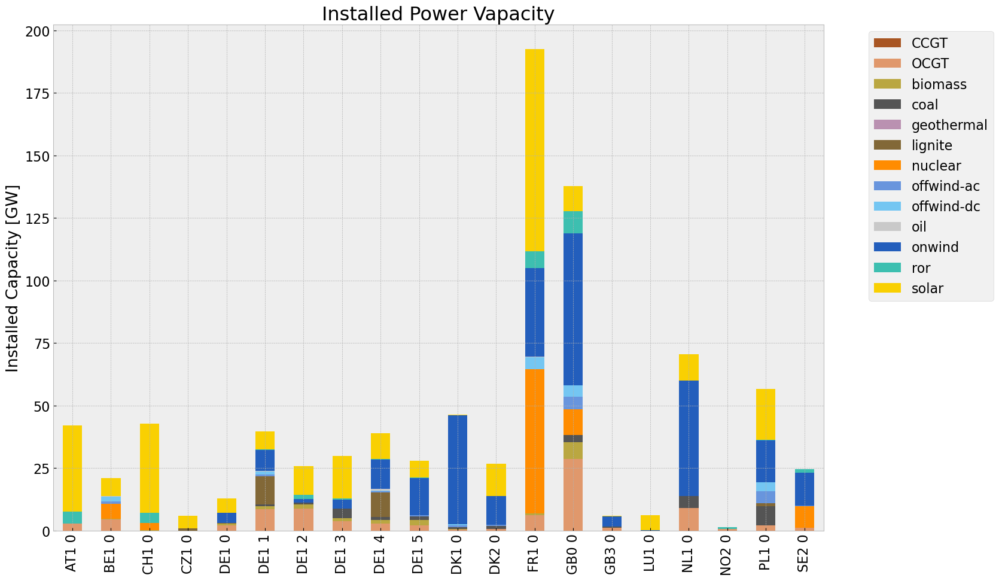

<Figure size 640x480 with 0 Axes>

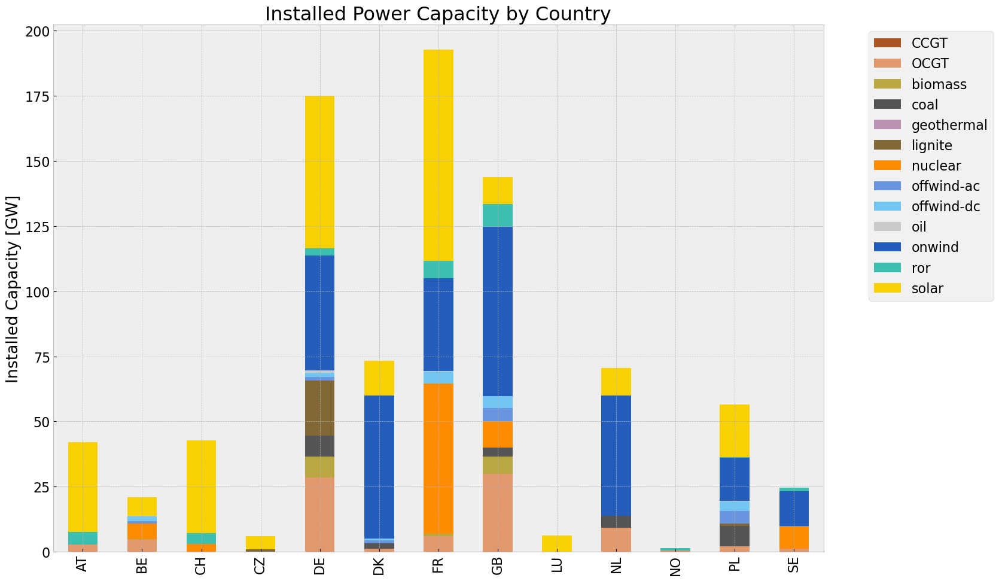

<Figure size 640x480 with 0 Axes>

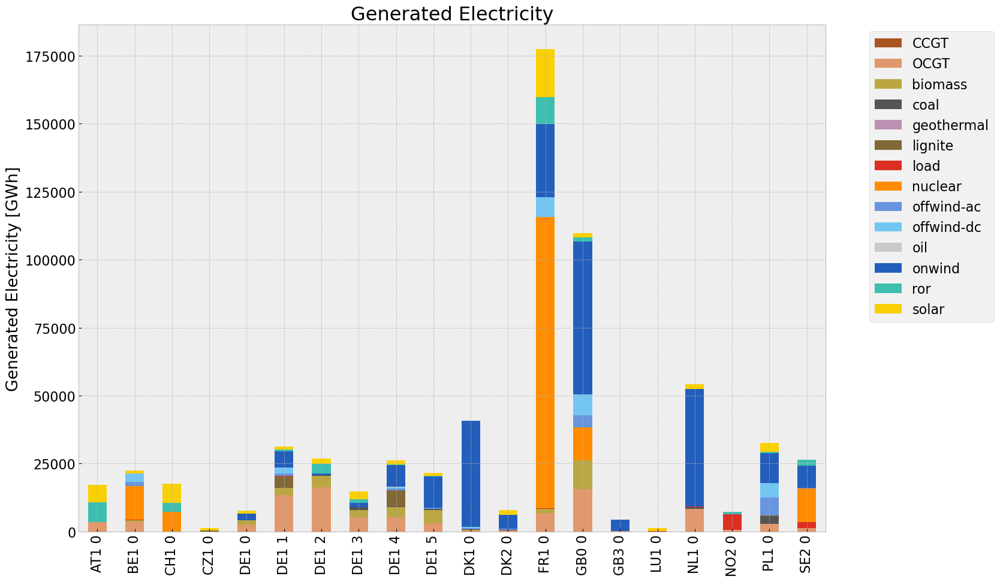

<Figure size 640x480 with 0 Axes>

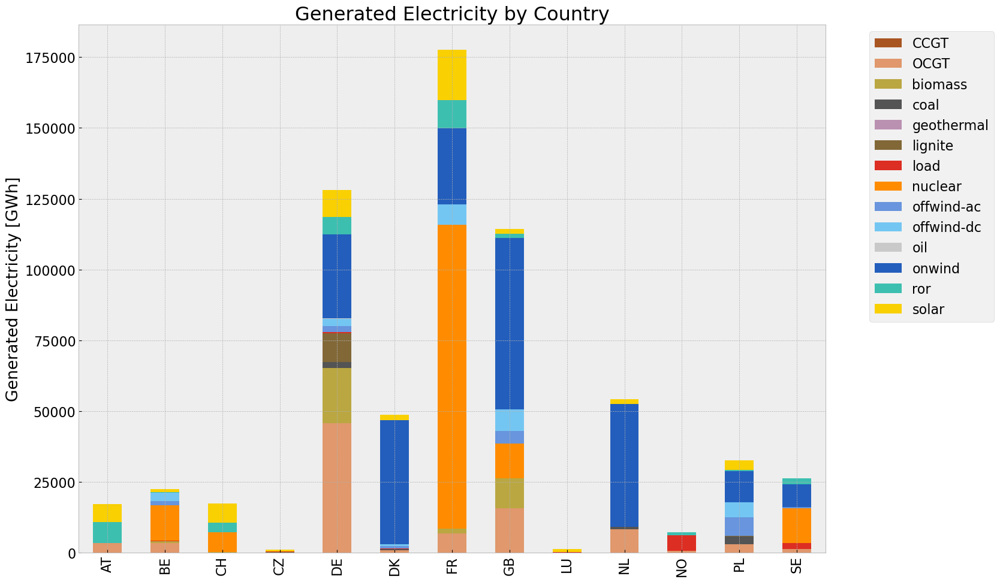

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\a

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,8.905467e+07,0.451621,0.1980,3.904343e+07
biomass,3.262835e+07,0.468000,0.0000,0.000000e+00
coal,6.266474e+06,0.329908,0.3361,6.384088e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,1.060113e+07,0.337285,0.4069,1.278919e+07
load,9.061795e+06,1.000000,0.0000,0.000000e+00
nuclear,1.509687e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.578467e+07,1.000000,0.0000,0.000000e+00


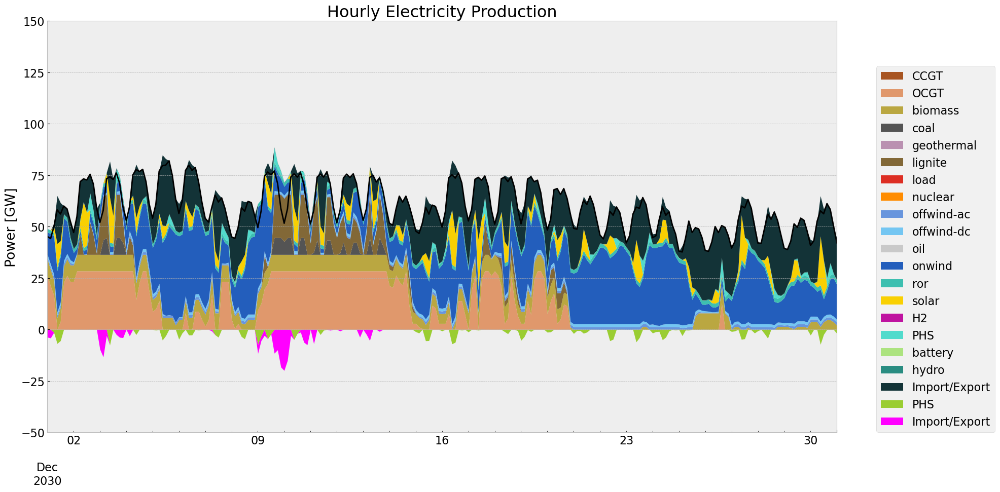

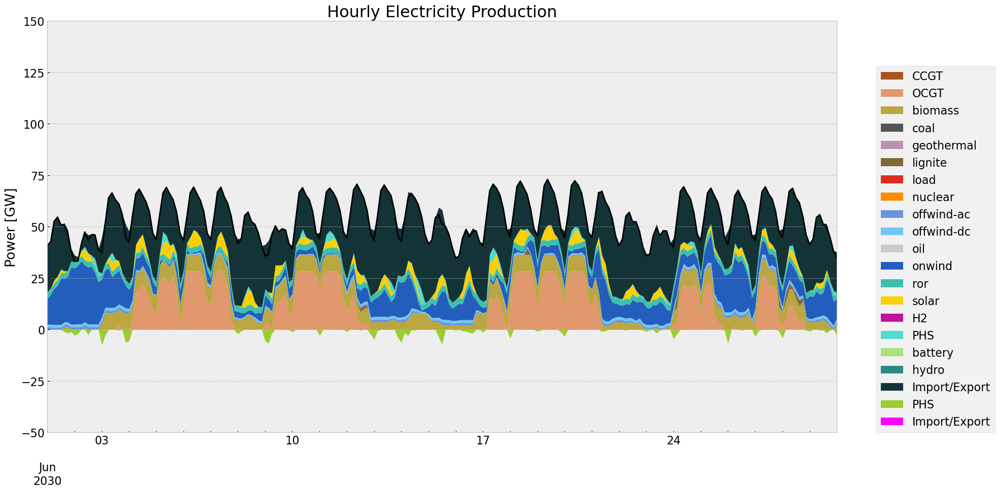

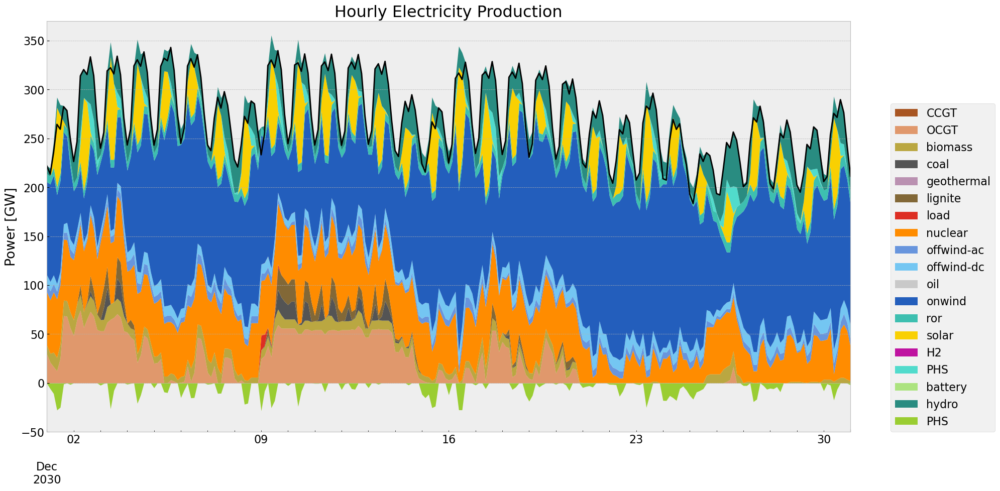

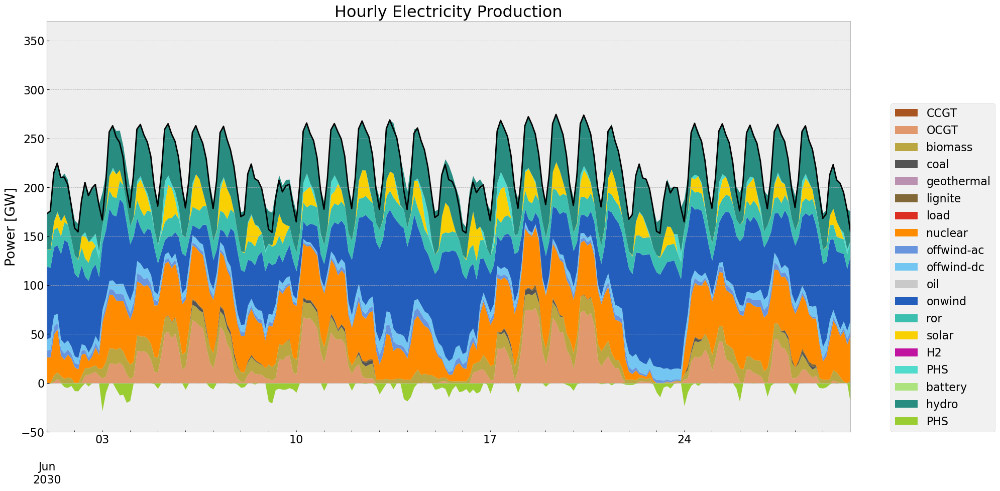

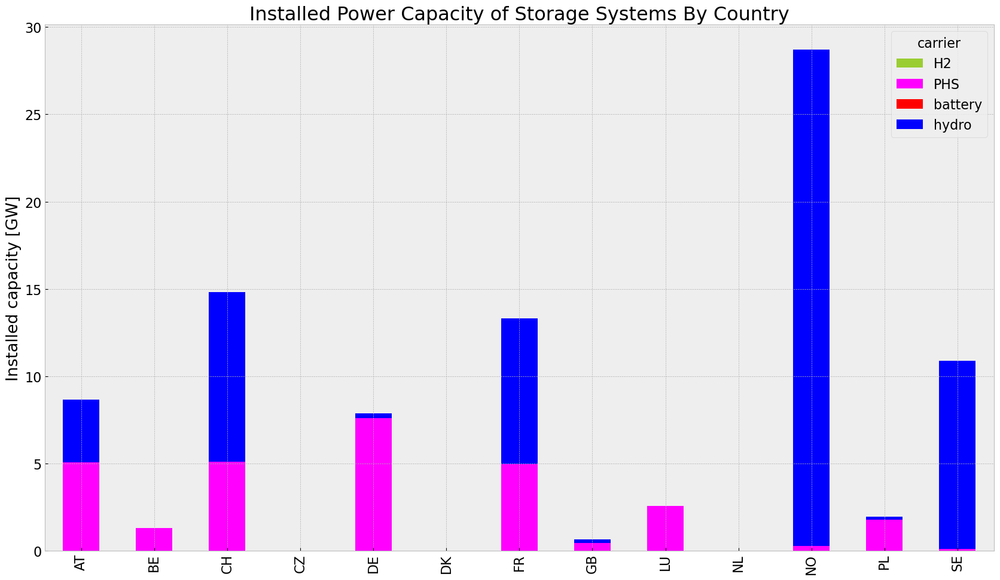

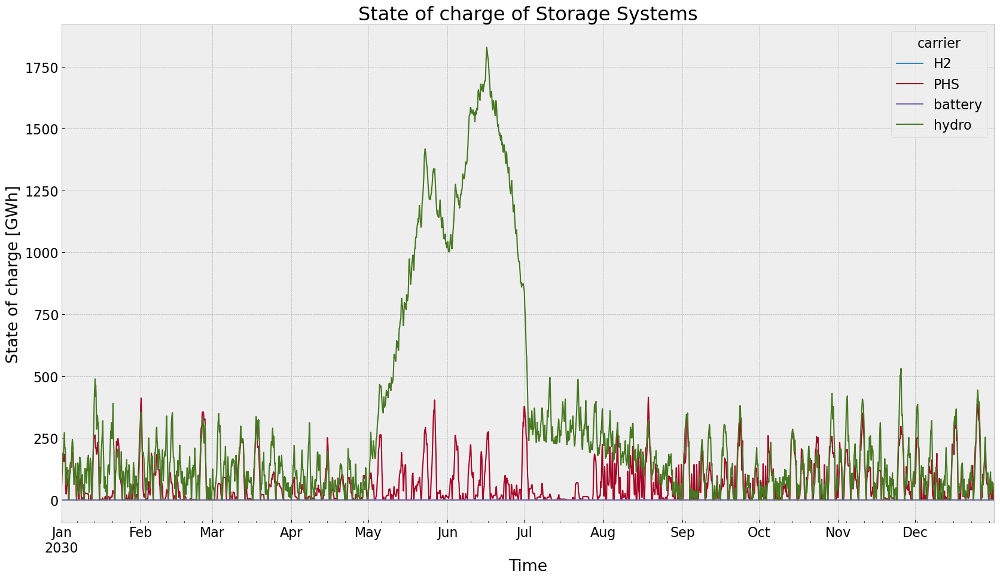

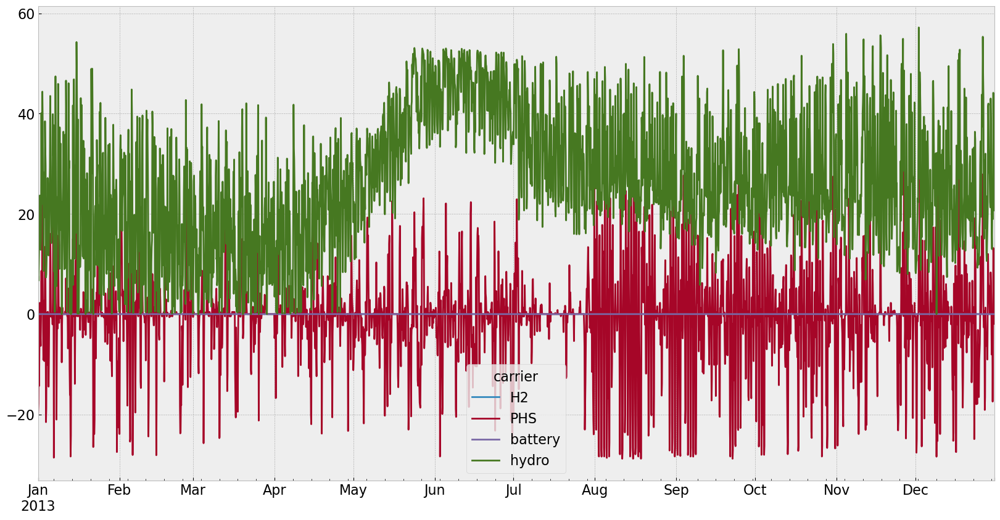

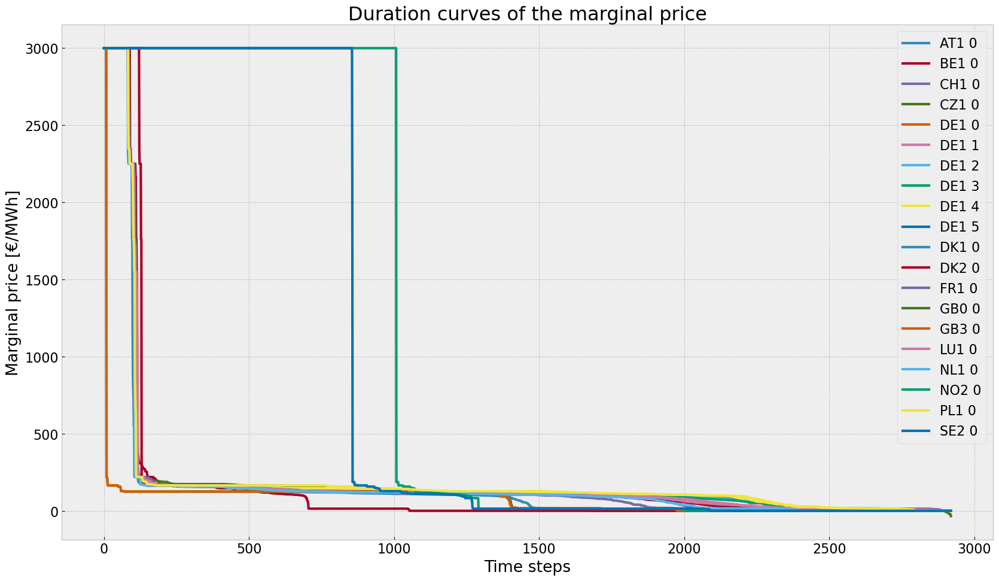

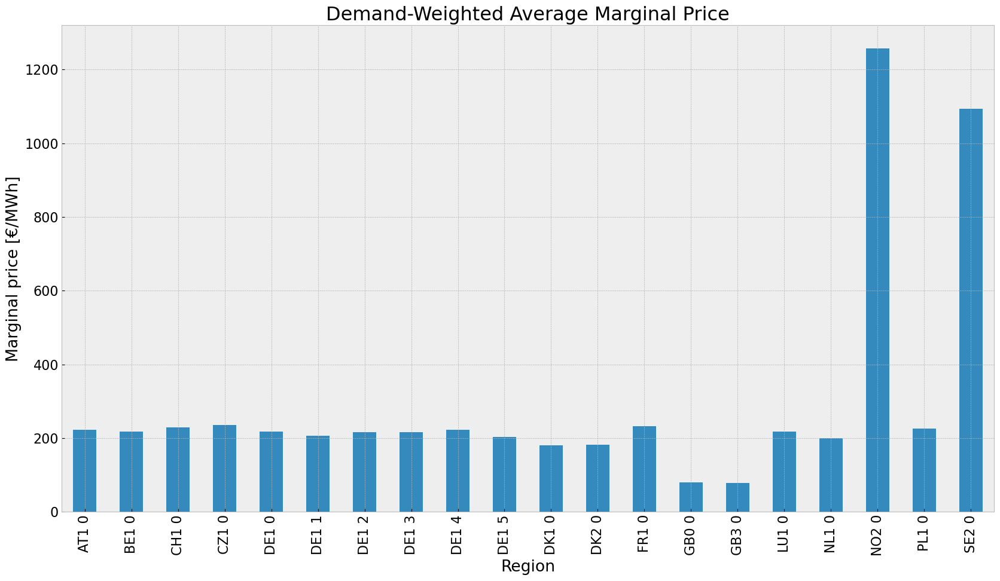

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


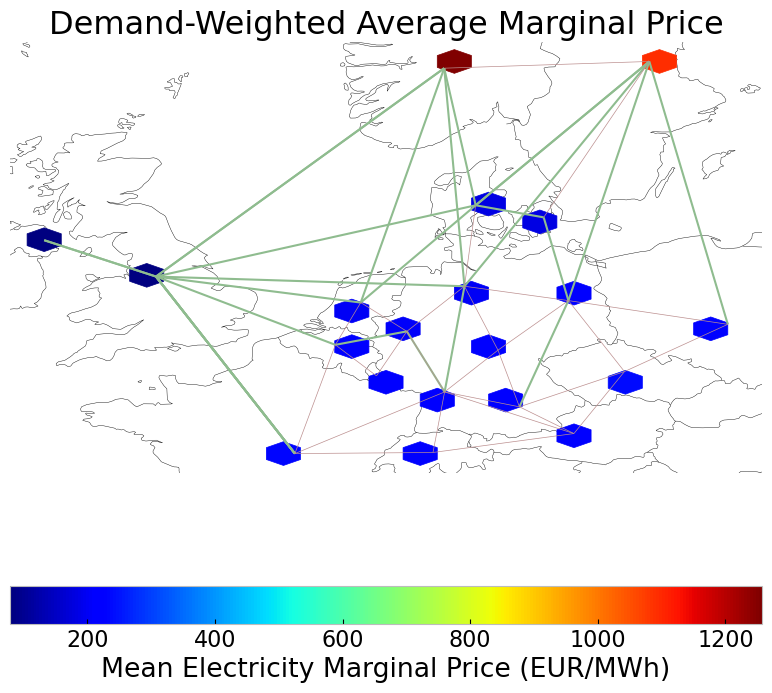

In [267]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_noinv_roll = inst_cap_table(n3, color_cap)
cap_noinv_roll_country = inst_cap_table_country(n3, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_noinv_roll  = gen_power_table(n3,colors_gen_table)
gen_noinv_roll_country = gen_power_table_country(n3,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n3, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n3, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n3, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n3, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_noinv_roll = inst_store_table(n3)

#State of Charge Storage unit
state_of_charge_plot(n3)
n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n3)

#avg electricity price
price_regions_table(n3)
price_regions(n3)

#Emission
em_noinv_roll =em_table(n3)
em_noinv_roll

## 4. Allowed Investment scenario solved with Rolling Horizon

In [268]:
n4 = n1.copy()
n4.name = 'inv_roll'
horizon = 24

no_inv(n4,n1)
#set extendable to false
#set the optimal capacity of generators from the base scenario as the new minimum capacity 
#for index, value in n4.generators.p_nom_extendable.items():
#    if value:  
#        n4.generators.at[index, 'p_nom'] = n1.generators.at[index, 'p_nom_opt']
#        #n2.generators.at[index, 'p_nom_max'] = n.generators.at[index, 'p_nom_opt']
#        n4.generators.at[index,'p_nom_extendable'] = False

#set the optimal capacity of storage units from the base scenario as the new minimum capacity 
#for index, value in n4.storage_units.p_nom_extendable.items():
#    if value:  
#        n4.storage_units.at[index, 'p_nom'] = n1.storage_units.at[index, 'p_nom_opt']
#        #n2.storage_units.at[index, 'p_nom_max'] = n.storage_units.at[index, 'p_nom_opt']
#        n4.storage_units.at[index,'p_nom_extendable'] = False

#set the optimal capacity of stores from the base scenario as the new minimum capacity 
#for index, value in n4.stores.e_nom_extendable.items():
#    if value:  
#        n4.stores.at[index, 'e_nom'] = n1.stores.at[index, 'e_nom_opt']
#        #n2.stores.at[index, 'e_nom_max'] = n.stores.at[index, 'e_nom_opt']
#        n4.stores.at[index, 'e_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n2.lines.s_nom_extendable.items():
#    if value:  
#        n4.lines.at[index, 's_nom'] = n1.lines.at[index, 's_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.lines.at[index, 's_nom_extendable'] =False

#set the optimal capacity of lines from the base scenario as the new minimum capacity 
#for index, value in n4.links.p_nom_extendable.items():
#    if value:  
#        n4.links.at[index, 's_nom'] = n1.links.at[index, 'p_nom_opt']
#        #n2.lines.at[index, 's_nom_max'] = n.lines.at[index, 's_nom_opt']
#        n4.links.at[index, 'p_nom_extendable'] =False

n4.storage_units['cyclic_state_of_charge'] = False
n4.storage_units['cyclic_state_of_charge_per_period'] = False
optimize.optimize_with_rolling_horizon(n4, horizon=horizon, overlap=0, solver_name='gurobi')
#n4 = pypsa.Network("C:\\Users\\Jeremy\\Documents\\MasterThesis\\Models\\Model_DE\\20240405_20nodes\\PV Cut\\20240511\\inv_roll.nc")

INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-01 00:00:00:2013-01-03 21:00:00] (1/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
      dtype='object', name='Generator')
INFO:linopy.model: Solve problem using Gurobi solver


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wonhxxz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1wonhxxz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4277f65f


INFO:gurobipy:Model fingerprint: 0x4277f65f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25506 rows and 7246 columns


INFO:gurobipy:Presolve removed 25506 rows and 7246 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1326 rows, 5258 columns, 8827 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5258 columns, 8827 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.268e+04 (roughly 3 MB of memory)


 Factor Ops : 1.344e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.344e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00574597e+11 -5.25187842e+11  8.83e+04 1.15e+04  5.14e+08     0s


INFO:gurobipy:   0   2.00574597e+11 -5.25187842e+11  8.83e+04 1.15e+04  5.14e+08     0s


   1   4.14072263e+10 -2.77277110e+11  1.12e+04 7.28e-11  7.96e+07     0s


INFO:gurobipy:   1   4.14072263e+10 -2.77277110e+11  1.12e+04 7.28e-11  7.96e+07     0s


   2   5.98337292e+09 -6.96378859e+10  6.26e+02 8.73e-11  9.16e+06     0s


INFO:gurobipy:   2   5.98337292e+09 -6.96378859e+10  6.26e+02 8.73e-11  9.16e+06     0s


   3   1.51847034e+09 -1.09790288e+10  1.05e+02 8.44e-10  1.33e+06     0s


INFO:gurobipy:   3   1.51847034e+09 -1.09790288e+10  1.05e+02 8.44e-10  1.33e+06     0s


   4   6.39872393e+08 -1.93645910e+09  3.16e+01 2.91e-10  2.61e+05     0s


INFO:gurobipy:   4   6.39872393e+08 -1.93645910e+09  3.16e+01 2.91e-10  2.61e+05     0s


   5   3.28419924e+08 -8.30574318e+08  1.24e+01 1.49e-10  1.14e+05     0s


INFO:gurobipy:   5   3.28419924e+08 -8.30574318e+08  1.24e+01 1.49e-10  1.14e+05     0s


   6   1.88811631e+08 -3.84218112e+08  5.87e+00 6.91e-11  5.53e+04     0s


INFO:gurobipy:   6   1.88811631e+08 -3.84218112e+08  5.87e+00 6.91e-11  5.53e+04     0s


   7   1.06503715e+08 -1.68148831e+08  2.22e+00 3.00e-11  2.63e+04     0s


INFO:gurobipy:   7   1.06503715e+08 -1.68148831e+08  2.22e+00 3.00e-11  2.63e+04     0s


   8   9.17411335e+07 -7.87778117e+07  1.63e+00 1.98e-11  1.63e+04     0s


INFO:gurobipy:   8   9.17411335e+07 -7.87778117e+07  1.63e+00 1.98e-11  1.63e+04     0s


   9   7.70079748e+07 -5.56977878e+06  1.08e+00 2.18e-11  7.87e+03     0s


INFO:gurobipy:   9   7.70079748e+07 -5.56977878e+06  1.08e+00 2.18e-11  7.87e+03     0s


  10   5.40654231e+07  2.02635591e+07  3.20e-01 1.04e-11  3.21e+03     0s


INFO:gurobipy:  10   5.40654231e+07  2.02635591e+07  3.20e-01 1.04e-11  3.21e+03     0s


  11   4.51402149e+07  3.21895922e+07  9.35e-02 2.40e-11  1.23e+03     0s


INFO:gurobipy:  11   4.51402149e+07  3.21895922e+07  9.35e-02 2.40e-11  1.23e+03     0s


  12   4.31768102e+07  3.69210800e+07  5.28e-02 1.62e-11  5.94e+02     0s


INFO:gurobipy:  12   4.31768102e+07  3.69210800e+07  5.28e-02 1.62e-11  5.94e+02     0s


  13   4.17038907e+07  3.85389811e+07  2.48e-02 2.33e-11  3.01e+02     0s


INFO:gurobipy:  13   4.17038907e+07  3.85389811e+07  2.48e-02 2.33e-11  3.01e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1940    4.0290961e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1940    4.0290961e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1940 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1940 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.029096068e+07


INFO:gurobipy:Optimal objective  4.029096068e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.03e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-04 00:00:00:2013-01-06 21:00:00] (2/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pm0_b6vd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pm0_b6vd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8d7bd404


INFO:gurobipy:Model fingerprint: 0x8d7bd404


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25492 rows and 7020 columns


INFO:gurobipy:Presolve removed 25492 rows and 7020 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5484 columns, 9095 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5484 columns, 9095 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.19160469e+11 -5.23145295e+11  8.42e+04 1.16e+04  4.90e+08     0s


INFO:gurobipy:   0   2.19160469e+11 -5.23145295e+11  8.42e+04 1.16e+04  4.90e+08     0s


   1   4.56525782e+10 -2.77672876e+11  1.02e+04 7.28e-11  7.47e+07     0s


INFO:gurobipy:   1   4.56525782e+10 -2.77672876e+11  1.02e+04 7.28e-11  7.47e+07     0s


   2   7.68443063e+09 -7.06153883e+10  5.88e+02 1.60e+02  9.01e+06     0s


INFO:gurobipy:   2   7.68443063e+09 -7.06153883e+10  5.88e+02 1.60e+02  9.01e+06     0s


   3   1.91515425e+09 -1.12991238e+10  7.85e+01 8.29e-10  1.31e+06     0s


INFO:gurobipy:   3   1.91515425e+09 -1.12991238e+10  7.85e+01 8.29e-10  1.31e+06     0s


   4   9.39088634e+08 -2.92426816e+09  2.58e+01 2.33e-10  3.70e+05     0s


INFO:gurobipy:   4   9.39088634e+08 -2.92426816e+09  2.58e+01 2.33e-10  3.70e+05     0s


   5   5.99225724e+08 -9.62754776e+08  9.54e+00 6.55e-11  1.46e+05     0s


INFO:gurobipy:   5   5.99225724e+08 -9.62754776e+08  9.54e+00 6.55e-11  1.46e+05     0s


   6   4.59803151e+08 -1.82250082e+08  4.90e+00 2.73e-11  5.92e+04     0s


INFO:gurobipy:   6   4.59803151e+08 -1.82250082e+08  4.90e+00 2.73e-11  5.92e+04     0s


   7   3.59022364e+08  2.23689157e+07  2.45e+00 2.91e-11  3.09e+04     0s


INFO:gurobipy:   7   3.59022364e+08  2.23689157e+07  2.45e+00 2.91e-11  3.09e+04     0s


   8   3.20345319e+08  1.09263313e+08  1.61e+00 1.46e-11  1.93e+04     0s


INFO:gurobipy:   8   3.20345319e+08  1.09263313e+08  1.61e+00 1.46e-11  1.93e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1691    2.3115670e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1691    2.3115670e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1691 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1691 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.311566986e+08


INFO:gurobipy:Optimal objective  2.311566986e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.31e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-07 00:00:00:2013-01-09 21:00:00] (3/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ziv5in3s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ziv5in3s.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x300b6bec


INFO:gurobipy:Model fingerprint: 0x300b6bec


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25488 rows and 7003 columns


INFO:gurobipy:Presolve removed 25488 rows and 7003 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5501 columns, 9124 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5501 columns, 9124 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.62142194e+11 -5.05558904e+11  9.14e+04 1.31e+04  5.23e+08     0s


INFO:gurobipy:   0   2.62142194e+11 -5.05558904e+11  9.14e+04 1.31e+04  5.23e+08     0s


   1   5.78176850e+10 -2.69866980e+11  1.16e+04 7.28e-11  8.04e+07     0s


INFO:gurobipy:   1   5.78176850e+10 -2.69866980e+11  1.16e+04 7.28e-11  8.04e+07     0s


   2   1.33580159e+10 -6.43918338e+10  7.41e+02 1.02e-10  9.47e+06     0s


INFO:gurobipy:   2   1.33580159e+10 -6.43918338e+10  7.41e+02 1.02e-10  9.47e+06     0s


   3   5.66021769e+09 -1.34860189e+10  1.75e+02 1.75e-10  2.06e+06     0s


INFO:gurobipy:   3   5.66021769e+09 -1.34860189e+10  1.75e+02 1.75e-10  2.06e+06     0s


   4   3.04937452e+09 -4.55186195e+09  5.62e+01 1.46e-10  7.59e+05     0s


INFO:gurobipy:   4   3.04937452e+09 -4.55186195e+09  5.62e+01 1.46e-10  7.59e+05     0s


   5   2.30011177e+09 -9.18299895e+08  3.11e+01 1.31e-10  3.17e+05     0s


INFO:gurobipy:   5   2.30011177e+09 -9.18299895e+08  3.11e+01 1.31e-10  3.17e+05     0s


   6   1.80336205e+09  5.71893022e+08  1.28e+01 7.28e-11  1.19e+05     0s


INFO:gurobipy:   6   1.80336205e+09  5.71893022e+08  1.28e+01 7.28e-11  1.19e+05     0s


   7   1.58800948e+09  1.13982676e+09  4.54e+00 4.37e-11  4.24e+04     0s


INFO:gurobipy:   7   1.58800948e+09  1.13982676e+09  4.54e+00 4.37e-11  4.24e+04     0s


   8   1.52698904e+09  1.28449602e+09  2.54e+00 2.91e-11  2.27e+04     0s


INFO:gurobipy:   8   1.52698904e+09  1.28449602e+09  2.54e+00 2.91e-11  2.27e+04     0s


   9   1.49502785e+09  1.34749920e+09  1.60e+00 2.92e-11  1.38e+04     0s


INFO:gurobipy:   9   1.49502785e+09  1.34749920e+09  1.60e+00 2.92e-11  1.38e+04     0s


  10   1.45282490e+09  1.36925894e+09  3.94e-01 2.91e-11  7.67e+03     0s


INFO:gurobipy:  10   1.45282490e+09  1.36925894e+09  3.94e-01 2.91e-11  7.67e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1726    1.4296267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1726    1.4296267e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1726 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1726 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.429626730e+09


INFO:gurobipy:Optimal objective  1.429626730e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.43e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-10 00:00:00:2013-01-12 21:00:00] (4/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i10om8vh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i10om8vh.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x314025ef


INFO:gurobipy:Model fingerprint: 0x314025ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 1e+04]


INFO:gurobipy:  Bounds range     [1e+01, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6980 columns


INFO:gurobipy:Presolve removed 25488 rows and 6980 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1344 rows, 5524 columns, 9147 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5524 columns, 9147 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.59138955e+11 -5.16883700e+11  5.40e+04 1.37e+04  3.30e+08     0s


INFO:gurobipy:   0   1.59138955e+11 -5.16883700e+11  5.40e+04 1.37e+04  3.30e+08     0s


   1   3.74476111e+10 -2.30094737e+11  6.04e+03 7.28e-11  4.97e+07     0s


INFO:gurobipy:   1   3.74476111e+10 -2.30094737e+11  6.04e+03 7.28e-11  4.97e+07     0s


   2   9.42386014e+09 -5.70857452e+10  3.89e+02 3.90e+02  7.17e+06     0s


INFO:gurobipy:   2   9.42386014e+09 -5.70857452e+10  3.89e+02 3.90e+02  7.17e+06     0s


   3   3.13431038e+09 -1.17772927e+10  6.23e+01 9.17e-10  1.44e+06     0s


INFO:gurobipy:   3   3.13431038e+09 -1.17772927e+10  6.23e+01 9.17e-10  1.44e+06     0s


   4   2.29086312e+09 -1.17023368e+09  2.97e+01 3.06e-10  3.33e+05     0s


INFO:gurobipy:   4   2.29086312e+09 -1.17023368e+09  2.97e+01 3.06e-10  3.33e+05     0s


   5   1.71160506e+09  2.94691952e+08  1.23e+01 9.82e-11  1.33e+05     0s


INFO:gurobipy:   5   1.71160506e+09  2.94691952e+08  1.23e+01 9.82e-11  1.33e+05     0s


   6   1.48459078e+09  8.35160559e+08  6.09e+00 3.82e-11  6.06e+04     0s


INFO:gurobipy:   6   1.48459078e+09  8.35160559e+08  6.09e+00 3.82e-11  6.06e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1706    1.2092014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1706    1.2092014e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1706 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1706 iterations and 0.20 seconds (0.05 work units)


Optimal objective  1.209201385e+09


INFO:gurobipy:Optimal objective  1.209201385e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-13 00:00:00:2013-01-15 21:00:00] (5/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tv48do2k.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-tv48do2k.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1779ee9b


INFO:gurobipy:Model fingerprint: 0x1779ee9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25489 rows and 6993 columns


INFO:gurobipy:Presolve removed 25489 rows and 6993 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5511 columns, 9128 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5511 columns, 9128 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.51001844e+11 -5.02245763e+11  8.75e+04 1.32e+04  4.99e+08     0s


INFO:gurobipy:   0   2.51001844e+11 -5.02245763e+11  8.75e+04 1.32e+04  4.99e+08     0s


   1   5.63448194e+10 -2.65894036e+11  1.12e+04 8.73e-11  7.75e+07     0s


INFO:gurobipy:   1   5.63448194e+10 -2.65894036e+11  1.12e+04 8.73e-11  7.75e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1517    2.8330403e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1517    2.8330403e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1517 iterations and 0.13 seconds (0.04 work units)


INFO:gurobipy:Solved in 1517 iterations and 0.13 seconds (0.04 work units)


Optimal objective  2.833040312e+09


INFO:gurobipy:Optimal objective  2.833040312e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.83e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-16 00:00:00:2013-01-18 21:00:00] (6/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 125.00it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9othr8kn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-9othr8kn.lp


Reading time = 0.10 seconds


INFO:gurobipy:Reading time = 0.10 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x445a0f10


INFO:gurobipy:Model fingerprint: 0x445a0f10


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25502 rows and 7084 columns


INFO:gurobipy:Presolve removed 25502 rows and 7084 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1330 rows, 5420 columns, 9004 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5420 columns, 9004 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.04s


INFO:gurobipy:Ordering time: 0.04s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.782e+03


INFO:gurobipy: AA' NZ     : 3.782e+03


 Factor NZ  : 3.445e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.445e+04 (roughly 3 MB of memory)


 Factor Ops : 1.582e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.582e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


Barrier performed 0 iterations in 0.17 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.17 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1779    5.3556068e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1779    5.3556068e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1779 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1779 iterations and 0.19 seconds (0.05 work units)


Optimal objective  5.355606763e+09


INFO:gurobipy:Optimal objective  5.355606763e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.36e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-19 00:00:00:2013-01-21 21:00:00] (7/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-me6uzkiy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-me6uzkiy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdd403608


INFO:gurobipy:Model fingerprint: 0xdd403608


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25493 rows and 7126 columns


INFO:gurobipy:Presolve removed 25493 rows and 7126 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1339 rows, 5378 columns, 8983 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5378 columns, 8983 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.392e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.392e+04 (roughly 3 MB of memory)


 Factor Ops : 1.476e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.476e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05347141e+11 -5.11716985e+11  7.94e+04 1.22e+04  4.63e+08     0s


INFO:gurobipy:   0   2.05347141e+11 -5.11716985e+11  7.94e+04 1.22e+04  4.63e+08     0s


   1   4.46595553e+10 -2.60236279e+11  1.04e+04 7.28e-11  7.33e+07     0s


INFO:gurobipy:   1   4.46595553e+10 -2.60236279e+11  1.04e+04 7.28e-11  7.33e+07     0s


   2   9.90638409e+09 -7.18253284e+10  7.28e+02 1.16e-10  9.95e+06     0s


INFO:gurobipy:   2   9.90638409e+09 -7.18253284e+10  7.28e+02 1.16e-10  9.95e+06     0s


   3   4.13550743e+09 -1.47447823e+10  1.93e+02 7.28e-10  2.08e+06     0s


INFO:gurobipy:   3   4.13550743e+09 -1.47447823e+10  1.93e+02 7.28e-10  2.08e+06     0s


   4   2.54934376e+09 -2.30303214e+09  6.86e+01 3.06e-10  5.17e+05     0s


INFO:gurobipy:   4   2.54934376e+09 -2.30303214e+09  6.86e+01 3.06e-10  5.17e+05     0s


   5   2.03970061e+09  2.17150982e+08  2.48e+01 1.75e-10  1.84e+05     0s


INFO:gurobipy:   5   2.03970061e+09  2.17150982e+08  2.48e+01 1.75e-10  1.84e+05     0s


   6   1.87395825e+09  9.54045251e+08  1.34e+01 1.16e-10  9.09e+04     0s


INFO:gurobipy:   6   1.87395825e+09  9.54045251e+08  1.34e+01 1.16e-10  9.09e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1821    1.5663601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1821    1.5663601e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1821 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1821 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.566360080e+09


INFO:gurobipy:Optimal objective  1.566360080e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-22 00:00:00:2013-01-24 21:00:00] (8/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pfm2aqyr.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pfm2aqyr.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x63e1b580


INFO:gurobipy:Model fingerprint: 0x63e1b580


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 9e+03]


INFO:gurobipy:  Bounds range     [1e+01, 9e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 7077 columns


INFO:gurobipy:Presolve removed 25489 rows and 7077 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5427 columns, 9044 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5427 columns, 9044 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00150385e+11 -5.04028577e+11  6.75e+04 1.36e+04  3.98e+08     0s


INFO:gurobipy:   0   2.00150385e+11 -5.04028577e+11  6.75e+04 1.36e+04  3.98e+08     0s


   1   4.76442671e+10 -2.36907181e+11  8.18e+03 7.28e-11  6.10e+07     0s


INFO:gurobipy:   1   4.76442671e+10 -2.36907181e+11  8.18e+03 7.28e-11  6.10e+07     0s


   2   1.54583439e+10 -5.35691785e+10  5.81e+02 5.82e-11  8.18e+06     0s


INFO:gurobipy:   2   1.54583439e+10 -5.35691785e+10  5.81e+02 5.82e-11  8.18e+06     0s


   3   9.17489616e+09 -9.26518386e+09  1.39e+02 4.22e-10  1.97e+06     0s


INFO:gurobipy:   3   9.17489616e+09 -9.26518386e+09  1.39e+02 4.22e-10  1.97e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1619    5.2105654e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1619    5.2105654e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1619 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1619 iterations and 0.14 seconds (0.05 work units)


Optimal objective  5.210565435e+09


INFO:gurobipy:Optimal objective  5.210565435e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-25 00:00:00:2013-01-27 21:00:00] (9/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
  

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1oo1xhw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g1oo1xhw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1b042625


INFO:gurobipy:Model fingerprint: 0x1b042625


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25516 rows and 7266 columns


INFO:gurobipy:Presolve removed 25516 rows and 7266 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1316 rows, 5238 columns, 8776 nonzeros


INFO:gurobipy:Presolved: 1316 rows, 5238 columns, 8776 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.744e+03


INFO:gurobipy: AA' NZ     : 3.744e+03


 Factor NZ  : 3.198e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.198e+04 (roughly 3 MB of memory)


 Factor Ops : 1.265e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.265e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.02544275e+11 -5.00182093e+11  8.17e+04 1.67e+04  4.77e+08     0s


INFO:gurobipy:   0   2.02544275e+11 -5.00182093e+11  8.17e+04 1.67e+04  4.77e+08     0s


   1   4.46574772e+10 -2.56367349e+11  1.03e+04 7.28e-11  7.36e+07     0s


INFO:gurobipy:   1   4.46574772e+10 -2.56367349e+11  1.03e+04 7.28e-11  7.36e+07     0s


   2   1.04565985e+10 -5.88723004e+10  6.86e+02 8.73e-11  8.77e+06     0s


INFO:gurobipy:   2   1.04565985e+10 -5.88723004e+10  6.86e+02 8.73e-11  8.77e+06     0s


   3   5.42217639e+09 -1.48160729e+10  1.71e+02 5.68e-10  2.25e+06     0s


INFO:gurobipy:   3   5.42217639e+09 -1.48160729e+10  1.71e+02 5.68e-10  2.25e+06     0s


   4   3.55457928e+09 -1.80150250e+09  4.68e+01 5.53e-10  5.60e+05     0s


INFO:gurobipy:   4   3.55457928e+09 -1.80150250e+09  4.68e+01 5.53e-10  5.60e+05     0s


   5   2.97084715e+09  1.08880753e+09  1.91e+01 2.04e-10  1.92e+05     0s


INFO:gurobipy:   5   2.97084715e+09  1.08880753e+09  1.91e+01 2.04e-10  1.92e+05     0s


   6   2.68426244e+09  1.91588392e+09  7.54e+00 1.02e-10  7.71e+04     0s


INFO:gurobipy:   6   2.68426244e+09  1.91588392e+09  7.54e+00 1.02e-10  7.71e+04     0s


   7   2.54182235e+09  2.21943037e+09  2.30e+00 8.73e-11  3.17e+04     0s


INFO:gurobipy:   7   2.54182235e+09  2.21943037e+09  2.30e+00 8.73e-11  3.17e+04     0s


   8   2.49901913e+09  2.35182156e+09  9.64e-01 5.82e-11  1.44e+04     0s


INFO:gurobipy:   8   2.49901913e+09  2.35182156e+09  9.64e-01 5.82e-11  1.44e+04     0s


   9   2.47417697e+09  2.41385294e+09  2.58e-01 2.91e-11  5.84e+03     0s


INFO:gurobipy:   9   2.47417697e+09  2.41385294e+09  2.58e-01 2.91e-11  5.84e+03     0s


  10   2.46518445e+09  2.43998329e+09  7.25e-02 3.27e-11  2.43e+03     0s


INFO:gurobipy:  10   2.46518445e+09  2.43998329e+09  7.25e-02 3.27e-11  2.43e+03     0s


  11   2.46285153e+09  2.44532374e+09  3.78e-02 2.91e-11  1.68e+03     0s


INFO:gurobipy:  11   2.46285153e+09  2.44532374e+09  3.78e-02 2.91e-11  1.68e+03     0s


  12   2.46151605e+09  2.45353438e+09  1.99e-02 2.91e-11  7.67e+02     0s


INFO:gurobipy:  12   2.46151605e+09  2.45353438e+09  1.99e-02 2.91e-11  7.67e+02     0s


  13   2.46112028e+09  2.45607916e+09  1.53e-02 2.91e-11  4.85e+02     0s


INFO:gurobipy:  13   2.46112028e+09  2.45607916e+09  1.53e-02 2.91e-11  4.85e+02     0s


  14   2.46042451e+09  2.45688945e+09  7.61e-03 2.75e-11  3.39e+02     0s


INFO:gurobipy:  14   2.46042451e+09  2.45688945e+09  7.61e-03 2.75e-11  3.39e+02     0s


  15   2.46009300e+09  2.45896113e+09  4.21e-03 2.91e-11  1.09e+02     0s


INFO:gurobipy:  15   2.46009300e+09  2.45896113e+09  4.21e-03 2.91e-11  1.09e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.28 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.28 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1855    2.4596165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1855    2.4596165e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1855 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1855 iterations and 0.33 seconds (0.05 work units)


Optimal objective  2.459616495e+09


INFO:gurobipy:Optimal objective  2.459616495e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.46e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-28 00:00:00:2013-01-30 21:00:00] (10/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06o47aw2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-06o47aw2.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x70ffa87c


INFO:gurobipy:Model fingerprint: 0x70ffa87c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25530 rows and 7387 columns


INFO:gurobipy:Presolve removed 25530 rows and 7387 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1302 rows, 5117 columns, 8614 nonzeros


INFO:gurobipy:Presolved: 1302 rows, 5117 columns, 8614 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.710e+03


INFO:gurobipy: AA' NZ     : 3.710e+03


 Factor NZ  : 3.225e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.225e+04 (roughly 3 MB of memory)


 Factor Ops : 1.360e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.360e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.12248483e+11 -5.10243339e+11  4.79e+04 1.09e+04  3.07e+08     0s


INFO:gurobipy:   0   1.12248483e+11 -5.10243339e+11  4.79e+04 1.09e+04  3.07e+08     0s


   1   1.78550884e+10 -2.23044780e+11  3.21e+03 7.28e-11  3.73e+07     0s


INFO:gurobipy:   1   1.78550884e+10 -2.23044780e+11  3.21e+03 7.28e-11  3.73e+07     0s


   2   5.50006788e+09 -5.21143108e+10  2.10e+02 2.70e+02  6.21e+06     0s


INFO:gurobipy:   2   5.50006788e+09 -5.21143108e+10  2.10e+02 2.70e+02  6.21e+06     0s


   3   2.12548643e+09 -7.75130811e+09  5.04e+01 8.73e-11  1.02e+06     0s


INFO:gurobipy:   3   2.12548643e+09 -7.75130811e+09  5.04e+01 8.73e-11  1.02e+06     0s


   4   9.88233114e+08 -1.27365576e+09  9.23e+00 4.37e-11  2.25e+05     0s


INFO:gurobipy:   4   9.88233114e+08 -1.27365576e+09  9.23e+00 4.37e-11  2.25e+05     0s


   5   7.66062006e+08 -4.37198138e+08  4.68e+00 4.37e-11  1.19e+05     0s


INFO:gurobipy:   5   7.66062006e+08 -4.37198138e+08  4.68e+00 4.37e-11  1.19e+05     0s


   6   6.50059090e+08  3.84165971e+07  2.49e+00 2.91e-11  6.02e+04     0s


INFO:gurobipy:   6   6.50059090e+08  3.84165971e+07  2.49e+00 2.91e-11  6.02e+04     0s


   7   5.97050178e+08  2.06964646e+08  1.61e+00 2.52e-11  3.83e+04     0s


INFO:gurobipy:   7   5.97050178e+08  2.06964646e+08  1.61e+00 2.52e-11  3.83e+04     0s


   8   5.68111337e+08  3.14993150e+08  1.15e+00 2.26e-11  2.49e+04     0s


INFO:gurobipy:   8   5.68111337e+08  3.14993150e+08  1.15e+00 2.26e-11  2.49e+04     0s


   9   5.19703149e+08  3.83703062e+08  4.34e-01 1.72e-11  1.33e+04     0s


INFO:gurobipy:   9   5.19703149e+08  3.83703062e+08  4.34e-01 1.72e-11  1.33e+04     0s


  10   4.99819775e+08  4.57958908e+08  1.54e-01 2.76e-11  4.10e+03     0s


INFO:gurobipy:  10   4.99819775e+08  4.57958908e+08  1.54e-01 2.76e-11  4.10e+03     0s


  11   4.87685024e+08  4.71199755e+08  2.57e-02 2.49e-11  1.61e+03     0s


INFO:gurobipy:  11   4.87685024e+08  4.71199755e+08  2.57e-02 2.49e-11  1.61e+03     0s


  12   4.85420735e+08  4.77622011e+08  1.14e-02 2.70e-11  7.62e+02     0s


INFO:gurobipy:  12   4.85420735e+08  4.77622011e+08  1.14e-02 2.70e-11  7.62e+02     0s


  13   4.84661240e+08  4.79963348e+08  7.16e-03 2.33e-11  4.59e+02     0s


INFO:gurobipy:  13   4.84661240e+08  4.79963348e+08  7.16e-03 2.33e-11  4.59e+02     0s


  14   4.83882432e+08  4.81539710e+08  2.80e-03 2.40e-11  2.29e+02     0s


INFO:gurobipy:  14   4.83882432e+08  4.81539710e+08  2.80e-03 2.40e-11  2.29e+02     0s


  15   4.83563169e+08  4.82785160e+08  1.22e-03 3.07e-11  7.60e+01     0s


INFO:gurobipy:  15   4.83563169e+08  4.82785160e+08  1.22e-03 3.07e-11  7.60e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2005    4.8327826e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2005    4.8327826e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2005 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 2005 iterations and 0.19 seconds (0.06 work units)


Optimal objective  4.832782576e+08


INFO:gurobipy:Optimal objective  4.832782576e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-01-31 00:00:00:2013-02-02 21:00:00] (11/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99qvnquz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-99qvnquz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x41f46906


INFO:gurobipy:Model fingerprint: 0x41f46906


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25518 rows and 7102 columns


INFO:gurobipy:Presolve removed 25518 rows and 7102 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1314 rows, 5402 columns, 8957 nonzeros


INFO:gurobipy:Presolved: 1314 rows, 5402 columns, 8957 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.752e+03


INFO:gurobipy: AA' NZ     : 3.752e+03


 Factor NZ  : 3.361e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.361e+04 (roughly 3 MB of memory)


 Factor Ops : 1.482e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.482e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80701899e+11 -5.10448699e+11  7.15e+04 1.15e+04  4.23e+08     0s


INFO:gurobipy:   0   1.80701899e+11 -5.10448699e+11  7.15e+04 1.15e+04  4.23e+08     0s


   1   3.67578969e+10 -2.65625956e+11  8.39e+03 7.28e-11  6.46e+07     0s


INFO:gurobipy:   1   3.67578969e+10 -2.65625956e+11  8.39e+03 7.28e-11  6.46e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1749    1.0398442e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1749    1.0398442e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1749 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1749 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.039844213e+09


INFO:gurobipy:Optimal objective  1.039844213e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.04e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-03 00:00:00:2013-02-05 21:00:00] (12/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 104.47it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sjzd_7yb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-sjzd_7yb.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd653f863


INFO:gurobipy:Model fingerprint: 0xd653f863


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 8e+03]


INFO:gurobipy:  Bounds range     [1e+01, 8e+03]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25579 rows and 7381 columns


INFO:gurobipy:Presolve removed 25579 rows and 7381 columns


Presolve time: 0.09s


INFO:gurobipy:Presolve time: 0.09s


Presolved: 1253 rows, 5123 columns, 8520 nonzeros


INFO:gurobipy:Presolved: 1253 rows, 5123 columns, 8520 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.611e+03


INFO:gurobipy: AA' NZ     : 3.611e+03


 Factor NZ  : 3.034e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.034e+04 (roughly 3 MB of memory)


 Factor Ops : 1.206e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.206e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71946058e+11 -5.06550500e+11  7.45e+04 1.22e+04  4.41e+08     0s


INFO:gurobipy:   0   1.71946058e+11 -5.06550500e+11  7.45e+04 1.22e+04  4.41e+08     0s


   1   2.86510422e+10 -2.55470292e+11  7.54e+03 7.28e-11  6.03e+07     0s


INFO:gurobipy:   1   2.86510422e+10 -2.55470292e+11  7.54e+03 7.28e-11  6.03e+07     0s


   2   6.87891704e+09 -6.15606733e+10  6.07e+02 8.73e-11  8.52e+06     0s


INFO:gurobipy:   2   6.87891704e+09 -6.15606733e+10  6.07e+02 8.73e-11  8.52e+06     0s


   3   3.12637605e+09 -1.22000823e+10  1.58e+02 4.22e-10  1.75e+06     0s


INFO:gurobipy:   3   3.12637605e+09 -1.22000823e+10  1.58e+02 4.22e-10  1.75e+06     0s


   4   1.84511943e+09 -1.33536476e+09  3.42e+01 5.68e-10  3.41e+05     0s


INFO:gurobipy:   4   1.84511943e+09 -1.33536476e+09  3.42e+01 5.68e-10  3.41e+05     0s


   5   1.51677427e+09  1.18048587e+07  1.69e+01 2.33e-10  1.56e+05     0s


INFO:gurobipy:   5   1.51677427e+09  1.18048587e+07  1.69e+01 2.33e-10  1.56e+05     0s


   6   1.38780825e+09  5.29130330e+08  1.06e+01 1.16e-10  8.82e+04     0s


INFO:gurobipy:   6   1.38780825e+09  5.29130330e+08  1.06e+01 1.16e-10  8.82e+04     0s


   7   1.25300846e+09  8.32443884e+08  4.75e+00 1.75e-10  4.25e+04     0s


INFO:gurobipy:   7   1.25300846e+09  8.32443884e+08  4.75e+00 1.75e-10  4.25e+04     0s


   8   1.21551001e+09  9.85604588e+08  3.33e+00 2.47e-10  2.32e+04     0s


INFO:gurobipy:   8   1.21551001e+09  9.85604588e+08  3.33e+00 2.47e-10  2.32e+04     0s


   9   1.18928402e+09  1.03588554e+09  2.32e+00 2.33e-10  1.55e+04     0s


INFO:gurobipy:   9   1.18928402e+09  1.03588554e+09  2.32e+00 2.33e-10  1.55e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1644    1.1292809e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1644    1.1292809e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1644 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1644 iterations and 0.21 seconds (0.05 work units)


Optimal objective  1.129280946e+09


INFO:gurobipy:Optimal objective  1.129280946e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-06 00:00:00:2013-02-08 21:00:00] (13/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cbjwo__l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cbjwo__l.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf9e72fc3


INFO:gurobipy:Model fingerprint: 0xf9e72fc3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25495 rows and 6941 columns


INFO:gurobipy:Presolve removed 25495 rows and 6941 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1337 rows, 5563 columns, 9162 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5563 columns, 9162 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.03s


INFO:gurobipy:Ordering time: 0.03s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.795e+03


INFO:gurobipy: AA' NZ     : 3.795e+03


 Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.441e+04 (roughly 3 MB of memory)


 Factor Ops : 1.457e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.457e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.19849579e+11 -4.97049595e+11  7.79e+04 1.25e+04  4.49e+08     0s


INFO:gurobipy:   0   2.19849579e+11 -4.97049595e+11  7.79e+04 1.25e+04  4.49e+08     0s


   1   5.15727874e+10 -2.40945137e+11  9.94e+03 8.73e-11  6.88e+07     0s


INFO:gurobipy:   1   5.15727874e+10 -2.40945137e+11  9.94e+03 8.73e-11  6.88e+07     0s


   2   1.21720122e+10 -5.40484864e+10  5.97e+02 8.73e-11  7.83e+06     0s


INFO:gurobipy:   2   1.21720122e+10 -5.40484864e+10  5.97e+02 8.73e-11  7.83e+06     0s


   3   5.18717644e+09 -1.12857990e+10  1.00e+02 7.42e-10  1.67e+06     0s


INFO:gurobipy:   3   5.18717644e+09 -1.12857990e+10  1.00e+02 7.42e-10  1.67e+06     0s


   4   3.45687687e+09 -2.24530655e+09  3.16e+01 2.18e-10  5.46e+05     0s


INFO:gurobipy:   4   3.45687687e+09 -2.24530655e+09  3.16e+01 2.18e-10  5.46e+05     0s


   5   3.08074285e+09  7.33733075e+08  1.17e+01 1.02e-10  2.18e+05     0s


INFO:gurobipy:   5   3.08074285e+09  7.33733075e+08  1.17e+01 1.02e-10  2.18e+05     0s


   6   2.91836004e+09  2.10917155e+09  4.13e+00 5.82e-11  7.41e+04     0s


INFO:gurobipy:   6   2.91836004e+09  2.10917155e+09  4.13e+00 5.82e-11  7.41e+04     0s


   7   2.80978465e+09  2.45676864e+09  1.15e+00 5.82e-11  3.20e+04     0s


INFO:gurobipy:   7   2.80978465e+09  2.45676864e+09  1.15e+00 5.82e-11  3.20e+04     0s


   8   2.77458810e+09  2.60164574e+09  6.60e-01 2.96e-11  1.57e+04     0s


INFO:gurobipy:   8   2.77458810e+09  2.60164574e+09  6.60e-01 2.96e-11  1.57e+04     0s


   9   2.72327185e+09  2.66745562e+09  1.04e-01 2.91e-11  5.03e+03     0s


INFO:gurobipy:   9   2.72327185e+09  2.66745562e+09  1.04e-01 2.91e-11  5.03e+03     0s


  10   2.70811907e+09  2.69109754e+09  1.28e-02 2.91e-11  1.53e+03     0s


INFO:gurobipy:  10   2.70811907e+09  2.69109754e+09  1.28e-02 2.91e-11  1.53e+03     0s


  11   2.70569680e+09  2.70033236e+09  4.28e-03 2.91e-11  4.82e+02     0s


INFO:gurobipy:  11   2.70569680e+09  2.70033236e+09  4.28e-03 2.91e-11  4.82e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1829    2.7042232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1829    2.7042232e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1829 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1829 iterations and 0.24 seconds (0.06 work units)


Optimal objective  2.704223176e+09


INFO:gurobipy:Optimal objective  2.704223176e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.70e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-09 00:00:00:2013-02-11 21:00:00] (14/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33xjnlbd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-33xjnlbd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6a2039cb


INFO:gurobipy:Model fingerprint: 0x6a2039cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25493 rows and 7005 columns


INFO:gurobipy:Presolve removed 25493 rows and 7005 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1339 rows, 5499 columns, 9104 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5499 columns, 9104 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.337e+04 (roughly 3 MB of memory)


 Factor Ops : 1.365e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.365e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.96447316e+11 -4.91009900e+11  6.84e+04 1.38e+04  4.01e+08     0s


INFO:gurobipy:   0   1.96447316e+11 -4.91009900e+11  6.84e+04 1.38e+04  4.01e+08     0s


   1   4.54767938e+10 -2.40817405e+11  8.61e+03 7.28e-11  6.29e+07     0s


INFO:gurobipy:   1   4.54767938e+10 -2.40817405e+11  8.61e+03 7.28e-11  6.29e+07     0s


   2   1.12660790e+10 -5.89880306e+10  5.18e+02 1.58e+02  8.02e+06     0s


INFO:gurobipy:   2   1.12660790e+10 -5.89880306e+10  5.18e+02 1.58e+02  8.02e+06     0s


   3   5.86982725e+09 -1.33612614e+10  1.31e+02 3.78e-10  1.99e+06     0s


INFO:gurobipy:   3   5.86982725e+09 -1.33612614e+10  1.31e+02 3.78e-10  1.99e+06     0s


   4   3.71613406e+09 -8.41344229e+08  3.99e+01 4.80e-10  4.54e+05     0s


INFO:gurobipy:   4   3.71613406e+09 -8.41344229e+08  3.99e+01 4.80e-10  4.54e+05     0s


   5   3.09395261e+09  1.16294524e+09  1.73e+01 1.89e-10  1.88e+05     0s


INFO:gurobipy:   5   3.09395261e+09  1.16294524e+09  1.73e+01 1.89e-10  1.88e+05     0s


   6   2.83898055e+09  2.04921310e+09  8.56e+00 1.16e-10  7.56e+04     0s


INFO:gurobipy:   6   2.83898055e+09  2.04921310e+09  8.56e+00 1.16e-10  7.56e+04     0s


   7   2.66757062e+09  2.36533748e+09  1.63e+00 8.73e-11  2.80e+04     0s


INFO:gurobipy:   7   2.66757062e+09  2.36533748e+09  1.63e+00 8.73e-11  2.80e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1774    2.5749833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1774    2.5749833e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1774 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1774 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.574983305e+09


INFO:gurobipy:Optimal objective  2.574983305e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.57e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-12 00:00:00:2013-02-14 21:00:00] (15/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-87777aoz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-87777aoz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf6804740


INFO:gurobipy:Model fingerprint: 0xf6804740


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25494 rows and 7104 columns


INFO:gurobipy:Presolve removed 25494 rows and 7104 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1338 rows, 5400 columns, 9004 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5400 columns, 9004 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.559e+04 (roughly 3 MB of memory)


 Factor Ops : 1.654e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.654e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95115701e+11 -4.81069933e+11  6.95e+04 1.30e+04  4.06e+08     0s


INFO:gurobipy:   0   1.95115701e+11 -4.81069933e+11  6.95e+04 1.30e+04  4.06e+08     0s


   1   4.61682348e+10 -2.35042587e+11  8.54e+03 7.28e-11  6.25e+07     0s


INFO:gurobipy:   1   4.61682348e+10 -2.35042587e+11  8.54e+03 7.28e-11  6.25e+07     0s


   2   1.46409015e+10 -5.41774982e+10  5.61e+02 1.51e+02  8.14e+06     0s


INFO:gurobipy:   2   1.46409015e+10 -5.41774982e+10  5.61e+02 1.51e+02  8.14e+06     0s


   3   8.53803240e+09 -4.84805423e+09  9.73e+01 6.11e-10  1.41e+06     0s


INFO:gurobipy:   3   8.53803240e+09 -4.84805423e+09  9.73e+01 6.11e-10  1.41e+06     0s


   4   6.66362531e+09  1.80520768e+09  2.82e+01 3.35e-10  4.85e+05     0s


INFO:gurobipy:   4   6.66362531e+09  1.80520768e+09  2.82e+01 3.35e-10  4.85e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1693    5.6471653e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1693    5.6471653e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1693 iterations and 0.15 seconds (0.04 work units)


INFO:gurobipy:Solved in 1693 iterations and 0.15 seconds (0.04 work units)


Optimal objective  5.647165288e+09


INFO:gurobipy:Optimal objective  5.647165288e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.65e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-15 00:00:00:2013-02-17 21:00:00] (16/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 86.42it/s]
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05ch5zgm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-05ch5zgm.lp


Reading time = 0.11 seconds


INFO:gurobipy:Reading time = 0.11 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x442d038f


INFO:gurobipy:Model fingerprint: 0x442d038f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 7068 columns


INFO:gurobipy:Presolve removed 25489 rows and 7068 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5436 columns, 9053 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5436 columns, 9053 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58591550e+11 -4.77097604e+11  5.34e+04 1.34e+04  3.21e+08     0s


INFO:gurobipy:   0   1.58591550e+11 -4.77097604e+11  5.34e+04 1.34e+04  3.21e+08     0s


   1   3.79347064e+10 -2.16605481e+11  6.47e+03 8.73e-11  5.05e+07     0s


INFO:gurobipy:   1   3.79347064e+10 -2.16605481e+11  6.47e+03 8.73e-11  5.05e+07     0s


   2   1.20708188e+10 -4.87677119e+10  4.48e+02 2.84e+02  6.96e+06     0s


INFO:gurobipy:   2   1.20708188e+10 -4.87677119e+10  4.48e+02 2.84e+02  6.96e+06     0s


   3   6.43373275e+09 -6.09414342e+09  7.23e+01 2.47e-10  1.28e+06     0s


INFO:gurobipy:   3   6.43373275e+09 -6.09414342e+09  7.23e+01 2.47e-10  1.28e+06     0s


   4   4.37463786e+09  9.77945973e+08  1.50e+01 3.93e-10  3.29e+05     0s


INFO:gurobipy:   4   4.37463786e+09  9.77945973e+08  1.50e+01 3.93e-10  3.29e+05     0s


   5   3.87514304e+09  2.40766811e+09  6.05e+00 1.89e-10  1.40e+05     0s


INFO:gurobipy:   5   3.87514304e+09  2.40766811e+09  6.05e+00 1.89e-10  1.40e+05     0s


   6   3.67954036e+09  3.11526657e+09  2.22e+00 1.16e-10  5.35e+04     0s


INFO:gurobipy:   6   3.67954036e+09  3.11526657e+09  2.22e+00 1.16e-10  5.35e+04     0s


   7   3.59886528e+09  3.41519960e+09  7.31e-01 7.28e-11  1.74e+04     0s


INFO:gurobipy:   7   3.59886528e+09  3.41519960e+09  7.31e-01 7.28e-11  1.74e+04     0s


   8   3.57540270e+09  3.47977040e+09  4.01e-01 2.91e-11  9.05e+03     0s


INFO:gurobipy:   8   3.57540270e+09  3.47977040e+09  4.01e-01 2.91e-11  9.05e+03     0s


   9   3.55193529e+09  3.51440732e+09  1.02e-01 2.91e-11  3.51e+03     0s


INFO:gurobipy:   9   3.55193529e+09  3.51440732e+09  1.02e-01 2.91e-11  3.51e+03     0s


  10   3.54628108e+09  3.52361576e+09  4.79e-02 2.91e-11  2.11e+03     0s


INFO:gurobipy:  10   3.54628108e+09  3.52361576e+09  4.79e-02 2.91e-11  2.11e+03     0s


  11   3.54445456e+09  3.52955593e+09  3.22e-02 2.91e-11  1.39e+03     0s


INFO:gurobipy:  11   3.54445456e+09  3.52955593e+09  3.22e-02 2.91e-11  1.39e+03     0s


  12   3.54242222e+09  3.53745094e+09  1.45e-02 2.91e-11  4.66e+02     0s


INFO:gurobipy:  12   3.54242222e+09  3.53745094e+09  1.45e-02 2.91e-11  4.66e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1871    3.5405756e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1871    3.5405756e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1871 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1871 iterations and 0.19 seconds (0.05 work units)


Optimal objective  3.540575617e+09


INFO:gurobipy:Optimal objective  3.540575617e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.54e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-18 00:00:00:2013-02-20 21:00:00] (17/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-goyfkhti.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-goyfkhti.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfd694fb1


INFO:gurobipy:Model fingerprint: 0xfd694fb1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 7058 columns


INFO:gurobipy:Presolve removed 25489 rows and 7058 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5446 columns, 9063 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5446 columns, 9063 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82486123e+11 -4.90775737e+11  6.53e+04 1.36e+04  3.88e+08     0s


INFO:gurobipy:   0   1.82486123e+11 -4.90775737e+11  6.53e+04 1.36e+04  3.88e+08     0s


   1   4.18965712e+10 -2.35928482e+11  7.86e+03 8.00e-11  5.92e+07     0s


INFO:gurobipy:   1   4.18965712e+10 -2.35928482e+11  7.86e+03 8.00e-11  5.92e+07     0s


   2   1.14294957e+10 -5.43491678e+10  5.51e+02 1.41e+02  7.73e+06     0s


INFO:gurobipy:   2   1.14294957e+10 -5.43491678e+10  5.51e+02 1.41e+02  7.73e+06     0s


   3   4.96520263e+09 -1.02586513e+10  1.19e+02 1.98e-09  1.59e+06     0s


INFO:gurobipy:   3   4.96520263e+09 -1.02586513e+10  1.19e+02 1.98e-09  1.59e+06     0s


   4   3.15135659e+09 -2.62222927e+09  2.88e+01 4.66e-10  5.59e+05     0s


INFO:gurobipy:   4   3.15135659e+09 -2.62222927e+09  2.88e+01 4.66e-10  5.59e+05     0s


   5   2.75409719e+09  7.90446710e+08  1.05e+01 2.04e-10  1.86e+05     0s


INFO:gurobipy:   5   2.75409719e+09  7.90446710e+08  1.05e+01 2.04e-10  1.86e+05     0s


   6   2.55962165e+09  1.84475012e+09  4.50e+00 1.60e-10  6.70e+04     0s


INFO:gurobipy:   6   2.55962165e+09  1.84475012e+09  4.50e+00 1.60e-10  6.70e+04     0s


   7   2.44008844e+09  2.12858940e+09  1.69e+00 4.37e-11  2.90e+04     0s


INFO:gurobipy:   7   2.44008844e+09  2.12858940e+09  1.69e+00 4.37e-11  2.90e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.26 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.26 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1675    2.3302845e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1675    2.3302845e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1675 iterations and 0.29 seconds (0.04 work units)


INFO:gurobipy:Solved in 1675 iterations and 0.29 seconds (0.04 work units)


Optimal objective  2.330284486e+09


INFO:gurobipy:Optimal objective  2.330284486e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.33e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-21 00:00:00:2013-02-23 21:00:00] (18/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pe3kmsrn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-pe3kmsrn.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa6ced1ea


INFO:gurobipy:Model fingerprint: 0xa6ced1ea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25489 rows and 6919 columns


INFO:gurobipy:Presolve removed 25489 rows and 6919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5585 columns, 9202 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5585 columns, 9202 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80092423e+11 -4.93407349e+11  6.38e+04 1.45e+04  3.80e+08     0s


INFO:gurobipy:   0   1.80092423e+11 -4.93407349e+11  6.38e+04 1.45e+04  3.80e+08     0s


   1   4.28496598e+10 -2.36929914e+11  8.39e+03 6.55e-11  6.12e+07     0s


INFO:gurobipy:   1   4.28496598e+10 -2.36929914e+11  8.39e+03 6.55e-11  6.12e+07     0s


   2   1.04973394e+10 -5.37485988e+10  5.06e+02 7.37e+01  7.33e+06     0s


INFO:gurobipy:   2   1.04973394e+10 -5.37485988e+10  5.06e+02 7.37e+01  7.33e+06     0s


   3   4.51982878e+09 -9.99142040e+09  8.23e+01 8.00e-10  1.43e+06     0s


INFO:gurobipy:   3   4.51982878e+09 -9.99142040e+09  8.23e+01 8.00e-10  1.43e+06     0s


   4   3.43871768e+09 -1.73360728e+08  2.82e+01 6.55e-10  3.46e+05     0s


INFO:gurobipy:   4   3.43871768e+09 -1.73360728e+08  2.82e+01 6.55e-10  3.46e+05     0s


   5   3.07216929e+09  1.75017852e+09  1.11e+01 2.18e-10  1.23e+05     0s


INFO:gurobipy:   5   3.07216929e+09  1.75017852e+09  1.11e+01 2.18e-10  1.23e+05     0s


   6   2.89805297e+09  2.31705904e+09  5.07e+00 1.16e-10  5.35e+04     0s


INFO:gurobipy:   6   2.89805297e+09  2.31705904e+09  5.07e+00 1.16e-10  5.35e+04     0s


   7   2.76969224e+09  2.54979653e+09  1.37e+00 7.28e-11  2.00e+04     0s


INFO:gurobipy:   7   2.76969224e+09  2.54979653e+09  1.37e+00 7.28e-11  2.00e+04     0s


   8   2.73400585e+09  2.58044341e+09  8.11e-01 8.73e-11  1.39e+04     0s


INFO:gurobipy:   8   2.73400585e+09  2.58044341e+09  8.11e-01 8.73e-11  1.39e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1779    2.6753740e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1779    2.6753740e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1779 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1779 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.675373958e+09


INFO:gurobipy:Optimal objective  2.675373958e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.68e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-24 00:00:00:2013-02-26 21:00:00] (19/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jocmkv3q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jocmkv3q.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd6af3756


INFO:gurobipy:Model fingerprint: 0xd6af3756


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25489 rows and 7020 columns


INFO:gurobipy:Presolve removed 25489 rows and 7020 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1343 rows, 5484 columns, 9101 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5484 columns, 9101 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50228977e+11 -4.87015073e+11  5.37e+04 1.27e+04  3.26e+08     0s


INFO:gurobipy:   0   1.50228977e+11 -4.87015073e+11  5.37e+04 1.27e+04  3.26e+08     0s


   1   3.43654776e+10 -2.19173958e+11  5.84e+03 7.28e-11  4.79e+07     0s


INFO:gurobipy:   1   3.43654776e+10 -2.19173958e+11  5.84e+03 7.28e-11  4.79e+07     0s


   2   9.57019570e+09 -4.86071432e+10  3.64e+02 2.39e+02  6.38e+06     0s


INFO:gurobipy:   2   9.57019570e+09 -4.86071432e+10  3.64e+02 2.39e+02  6.38e+06     0s


   3   3.71520173e+09 -7.59592686e+09  6.89e+01 4.37e-10  1.13e+06     0s


INFO:gurobipy:   3   3.71520173e+09 -7.59592686e+09  6.89e+01 4.37e-10  1.13e+06     0s


   4   2.59406769e+09 -2.64920324e+09  3.08e+01 1.60e-10  5.10e+05     0s


INFO:gurobipy:   4   2.59406769e+09 -2.64920324e+09  3.08e+01 1.60e-10  5.10e+05     0s


   5   2.18849569e+09  2.61736146e+08  1.45e+01 1.46e-10  1.84e+05     0s


INFO:gurobipy:   5   2.18849569e+09  2.61736146e+08  1.45e+01 1.46e-10  1.84e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1660    1.7726290e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1660    1.7726290e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1660 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1660 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.772629044e+09


INFO:gurobipy:Optimal objective  1.772629044e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-02-27 00:00:00:2013-03-01 21:00:00] (20/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8nfdgpo.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-f8nfdgpo.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64094b3f


INFO:gurobipy:Model fingerprint: 0x64094b3f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 7e+03]


INFO:gurobipy:  Bounds range     [1e+01, 7e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 6965 columns


INFO:gurobipy:Presolve removed 25489 rows and 6965 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1343 rows, 5539 columns, 9156 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5539 columns, 9156 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.78938563e+11 -4.83238817e+11  6.06e+04 1.50e+04  3.61e+08     0s


INFO:gurobipy:   0   1.78938563e+11 -4.83238817e+11  6.06e+04 1.50e+04  3.61e+08     0s


   1   4.37990395e+10 -2.27685297e+11  7.72e+03 7.28e-11  5.75e+07     0s


INFO:gurobipy:   1   4.37990395e+10 -2.27685297e+11  7.72e+03 7.28e-11  5.75e+07     0s


   2   1.23067938e+10 -5.00138894e+10  4.89e+02 1.49e+02  7.13e+06     0s


INFO:gurobipy:   2   1.23067938e+10 -5.00138894e+10  4.89e+02 1.49e+02  7.13e+06     0s


   3   5.47891443e+09 -7.80946752e+09  6.95e+01 7.57e-10  1.32e+06     0s


INFO:gurobipy:   3   5.47891443e+09 -7.80946752e+09  6.95e+01 7.57e-10  1.32e+06     0s


   4   3.72525589e+09 -6.24747522e+08  2.55e+01 3.78e-10  4.18e+05     0s


INFO:gurobipy:   4   3.72525589e+09 -6.24747522e+08  2.55e+01 3.78e-10  4.18e+05     0s


   5   3.16760657e+09  1.22047195e+09  1.31e+01 1.82e-10  1.85e+05     0s


INFO:gurobipy:   5   3.16760657e+09  1.22047195e+09  1.31e+01 1.82e-10  1.85e+05     0s


   6   2.81742825e+09  2.11966476e+09  4.33e+00 1.31e-10  6.51e+04     0s


INFO:gurobipy:   6   2.81742825e+09  2.11966476e+09  4.33e+00 1.31e-10  6.51e+04     0s


   7   2.70397988e+09  2.43415748e+09  1.41e+00 8.73e-11  2.49e+04     0s


INFO:gurobipy:   7   2.70397988e+09  2.43415748e+09  1.41e+00 8.73e-11  2.49e+04     0s


   8   2.68180192e+09  2.49575559e+09  9.66e-01 4.37e-11  1.71e+04     0s


INFO:gurobipy:   8   2.68180192e+09  2.49575559e+09  9.66e-01 4.37e-11  1.71e+04     0s


   9   2.66853743e+09  2.53675503e+09  7.29e-01 5.82e-11  1.22e+04     0s


INFO:gurobipy:   9   2.66853743e+09  2.53675503e+09  7.29e-01 5.82e-11  1.22e+04     0s


  10   2.65991010e+09  2.57446752e+09  5.84e-01 4.37e-11  7.91e+03     0s


INFO:gurobipy:  10   2.65991010e+09  2.57446752e+09  5.84e-01 4.37e-11  7.91e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.20 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.20 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1789    2.6178893e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1789    2.6178893e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1789 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1789 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.617889280e+09


INFO:gurobipy:Optimal objective  2.617889280e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.62e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-02 00:00:00:2013-03-04 21:00:00] (21/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vftf1wd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3vftf1wd.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xce091626


INFO:gurobipy:Model fingerprint: 0xce091626


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6974 columns


INFO:gurobipy:Presolve removed 25488 rows and 6974 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1344 rows, 5530 columns, 9153 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5530 columns, 9153 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45973336e+11 -4.87535185e+11  5.08e+04 1.46e+04  3.11e+08     0s


INFO:gurobipy:   0   1.45973336e+11 -4.87535185e+11  5.08e+04 1.46e+04  3.11e+08     0s


   1   3.45873772e+10 -2.15074258e+11  6.21e+03 7.28e-11  4.88e+07     0s


INFO:gurobipy:   1   3.45873772e+10 -2.15074258e+11  6.21e+03 7.28e-11  4.88e+07     0s


   2   8.27010282e+09 -5.21277995e+10  3.69e+02 2.78e+02  6.56e+06     0s


INFO:gurobipy:   2   8.27010282e+09 -5.21277995e+10  3.69e+02 2.78e+02  6.56e+06     0s


   3   2.85083614e+09 -7.25604916e+09  6.58e+01 6.55e-10  1.00e+06     0s


INFO:gurobipy:   3   2.85083614e+09 -7.25604916e+09  6.58e+01 6.55e-10  1.00e+06     0s


   4   1.78192667e+09 -5.78048454e+08  1.73e+01 2.33e-10  2.24e+05     0s


INFO:gurobipy:   4   1.78192667e+09 -5.78048454e+08  1.73e+01 2.33e-10  2.24e+05     0s


   5   1.49374825e+09  5.02475693e+08  8.01e+00 7.28e-11  9.27e+04     0s


INFO:gurobipy:   5   1.49374825e+09  5.02475693e+08  8.01e+00 7.28e-11  9.27e+04     0s


   6   1.36901452e+09  8.68544241e+08  4.70e+00 4.37e-11  4.65e+04     0s


INFO:gurobipy:   6   1.36901452e+09  8.68544241e+08  4.70e+00 4.37e-11  4.65e+04     0s


   7   1.22133515e+09  9.95499650e+08  1.33e+00 2.91e-11  2.07e+04     0s


INFO:gurobipy:   7   1.22133515e+09  9.95499650e+08  1.33e+00 2.91e-11  2.07e+04     0s


   8   1.18752066e+09  1.05603452e+09  7.78e-01 4.37e-11  1.20e+04     0s


INFO:gurobipy:   8   1.18752066e+09  1.05603452e+09  7.78e-01 4.37e-11  1.20e+04     0s


   9   1.15053494e+09  1.10399058e+09  2.37e-01 7.28e-11  4.25e+03     0s


INFO:gurobipy:   9   1.15053494e+09  1.10399058e+09  2.37e-01 7.28e-11  4.25e+03     0s


  10   1.13642099e+09  1.12386288e+09  7.42e-02 4.37e-11  1.15e+03     0s


INFO:gurobipy:  10   1.13642099e+09  1.12386288e+09  7.42e-02 4.37e-11  1.15e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1695    1.1290149e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1695    1.1290149e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1695 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1695 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.129014905e+09


INFO:gurobipy:Optimal objective  1.129014905e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-05 00:00:00:2013-03-07 21:00:00] (22/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnxyc214.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-gnxyc214.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xff131915


INFO:gurobipy:Model fingerprint: 0xff131915


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25490 rows and 6962 columns


INFO:gurobipy:Presolve removed 25490 rows and 6962 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5542 columns, 9159 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5542 columns, 9159 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.69739776e+11 -4.89559836e+11  6.13e+04 1.29e+04  3.66e+08     0s


INFO:gurobipy:   0   1.69739776e+11 -4.89559836e+11  6.13e+04 1.29e+04  3.66e+08     0s


   1   4.01548777e+10 -2.30066707e+11  8.13e+03 7.28e-11  5.91e+07     0s


INFO:gurobipy:   1   4.01548777e+10 -2.30066707e+11  8.13e+03 7.28e-11  5.91e+07     0s


   2   9.33020769e+09 -5.52025556e+10  5.28e+02 1.17e+02  7.45e+06     0s


INFO:gurobipy:   2   9.33020769e+09 -5.52025556e+10  5.28e+02 1.17e+02  7.45e+06     0s


   3   3.87921233e+09 -1.45271445e+10  1.04e+02 1.21e-09  1.85e+06     0s


INFO:gurobipy:   3   3.87921233e+09 -1.45271445e+10  1.04e+02 1.21e-09  1.85e+06     0s


   4   2.58941445e+09 -1.99718952e+09  3.62e+01 1.16e-10  4.45e+05     0s


INFO:gurobipy:   4   2.58941445e+09 -1.99718952e+09  3.62e+01 1.16e-10  4.45e+05     0s


   5   2.10939010e+09  4.65947488e+08  1.35e+01 8.73e-11  1.55e+05     0s


INFO:gurobipy:   5   2.10939010e+09  4.65947488e+08  1.35e+01 8.73e-11  1.55e+05     0s


   6   1.87323047e+09  1.22718865e+09  4.69e+00 5.82e-11  5.99e+04     0s


INFO:gurobipy:   6   1.87323047e+09  1.22718865e+09  4.69e+00 5.82e-11  5.99e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1808    1.6719466e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1808    1.6719466e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1808 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1808 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.671946642e+09


INFO:gurobipy:Optimal objective  1.671946642e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.67e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-08 00:00:00:2013-03-10 21:00:00] (23/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ixfsfurk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ixfsfurk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x09498e16


INFO:gurobipy:Model fingerprint: 0x09498e16


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25507 rows and 7160 columns


INFO:gurobipy:Presolve removed 25507 rows and 7160 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1325 rows, 5344 columns, 8913 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5344 columns, 8913 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.768e+03


INFO:gurobipy: AA' NZ     : 3.768e+03


 Factor NZ  : 3.523e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.523e+04 (roughly 3 MB of memory)


 Factor Ops : 1.725e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.725e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63436337e+11 -4.94104591e+11  6.69e+04 1.22e+04  4.04e+08     0s


INFO:gurobipy:   0   1.63436337e+11 -4.94104591e+11  6.69e+04 1.22e+04  4.04e+08     0s


   1   2.86414708e+10 -2.47105336e+11  7.19e+03 7.28e-11  5.76e+07     0s


INFO:gurobipy:   1   2.86414708e+10 -2.47105336e+11  7.19e+03 7.28e-11  5.76e+07     0s


   2   6.54242702e+09 -5.77611010e+10  5.16e+02 1.18e+01  7.61e+06     0s


INFO:gurobipy:   2   6.54242702e+09 -5.77611010e+10  5.16e+02 1.18e+01  7.61e+06     0s


   3   3.21413997e+09 -8.69071482e+09  1.13e+02 1.37e-09  1.27e+06     0s


INFO:gurobipy:   3   3.21413997e+09 -8.69071482e+09  1.13e+02 1.37e-09  1.27e+06     0s


   4   2.01719948e+09 -1.60068061e+08  1.97e+01 6.55e-10  2.17e+05     0s


INFO:gurobipy:   4   2.01719948e+09 -1.60068061e+08  1.97e+01 6.55e-10  2.17e+05     0s


   5   1.75585223e+09  8.25394650e+08  9.87e+00 1.60e-10  9.12e+04     0s


INFO:gurobipy:   5   1.75585223e+09  8.25394650e+08  9.87e+00 1.60e-10  9.12e+04     0s


   6   1.53896205e+09  1.10624350e+09  3.06e+00 1.16e-10  4.14e+04     0s


INFO:gurobipy:   6   1.53896205e+09  1.10624350e+09  3.06e+00 1.16e-10  4.14e+04     0s


   7   1.46727702e+09  1.32141203e+09  9.49e-01 8.73e-11  1.39e+04     0s


INFO:gurobipy:   7   1.46727702e+09  1.32141203e+09  9.49e-01 8.73e-11  1.39e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1931    1.4209930e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1931    1.4209930e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1931 iterations and 0.15 seconds (0.06 work units)


INFO:gurobipy:Solved in 1931 iterations and 0.15 seconds (0.06 work units)


Optimal objective  1.420993018e+09


INFO:gurobipy:Optimal objective  1.420993018e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.42e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-11 00:00:00:2013-03-13 21:00:00] (24/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr7a3aiu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-kr7a3aiu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x08d5c583


INFO:gurobipy:Model fingerprint: 0x08d5c583


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 6e+03]


INFO:gurobipy:  Bounds range     [1e+01, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25537 rows and 7077 columns


INFO:gurobipy:Presolve removed 25537 rows and 7077 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1295 rows, 5427 columns, 8950 nonzeros


INFO:gurobipy:Presolved: 1295 rows, 5427 columns, 8950 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.716e+03


INFO:gurobipy: AA' NZ     : 3.716e+03


 Factor NZ  : 3.420e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.420e+04 (roughly 3 MB of memory)


 Factor Ops : 1.514e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.514e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.28494872e+11 -4.88251799e+11  8.20e+04 1.32e+04  4.74e+08     0s


INFO:gurobipy:   0   2.28494872e+11 -4.88251799e+11  8.20e+04 1.32e+04  4.74e+08     0s


   1   5.09485265e+10 -2.55861605e+11  1.05e+04 8.00e-11  7.38e+07     0s


INFO:gurobipy:   1   5.09485265e+10 -2.55861605e+11  1.05e+04 8.00e-11  7.38e+07     0s


   2   1.27963132e+10 -5.46173039e+10  7.76e+02 5.82e-11  8.69e+06     0s


INFO:gurobipy:   2   1.27963132e+10 -5.46173039e+10  7.76e+02 5.82e-11  8.69e+06     0s


   3   5.71517983e+09 -9.46489616e+09  1.25e+02 3.49e-10  1.63e+06     0s


INFO:gurobipy:   3   5.71517983e+09 -9.46489616e+09  1.25e+02 3.49e-10  1.63e+06     0s


   4   4.13730924e+09  9.45834145e+07  3.57e+01 3.64e-10  4.08e+05     0s


INFO:gurobipy:   4   4.13730924e+09  9.45834145e+07  3.57e+01 3.64e-10  4.08e+05     0s


   5   3.69780712e+09  2.17971469e+09  1.36e+01 1.60e-10  1.48e+05     0s


INFO:gurobipy:   5   3.69780712e+09  2.17971469e+09  1.36e+01 1.60e-10  1.48e+05     0s


   6   3.52104322e+09  2.88182515e+09  6.18e+00 7.28e-11  6.11e+04     0s


INFO:gurobipy:   6   3.52104322e+09  2.88182515e+09  6.18e+00 7.28e-11  6.11e+04     0s


   7   3.39420454e+09  3.09353719e+09  1.96e+00 7.28e-11  2.82e+04     0s


INFO:gurobipy:   7   3.39420454e+09  3.09353719e+09  1.96e+00 7.28e-11  2.82e+04     0s


   8   3.36915132e+09  3.20128906e+09  1.39e+00 4.37e-11  1.58e+04     0s


INFO:gurobipy:   8   3.36915132e+09  3.20128906e+09  1.39e+00 4.37e-11  1.58e+04     0s


   9   3.31380170e+09  3.24919888e+09  3.37e-01 4.37e-11  6.01e+03     0s


INFO:gurobipy:   9   3.31380170e+09  3.24919888e+09  3.37e-01 4.37e-11  6.01e+03     0s


  10   3.29699043e+09  3.27459978e+09  1.02e-01 3.30e-11  2.08e+03     0s


INFO:gurobipy:  10   3.29699043e+09  3.27459978e+09  1.02e-01 3.30e-11  2.08e+03     0s


  11   3.29011999e+09  3.28179903e+09  2.36e-02 2.91e-11  7.70e+02     0s


INFO:gurobipy:  11   3.29011999e+09  3.28179903e+09  2.36e-02 2.91e-11  7.70e+02     0s


  12   3.28897158e+09  3.28538972e+09  1.27e-02 2.44e-11  3.32e+02     0s


INFO:gurobipy:  12   3.28897158e+09  3.28538972e+09  1.27e-02 2.44e-11  3.32e+02     0s


  13   3.28806686e+09  3.28673607e+09  4.41e-03 2.92e-11  1.23e+02     0s


INFO:gurobipy:  13   3.28806686e+09  3.28673607e+09  4.41e-03 2.92e-11  1.23e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1804    3.2875383e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1804    3.2875383e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1804 iterations and 0.19 seconds (0.06 work units)


INFO:gurobipy:Solved in 1804 iterations and 0.19 seconds (0.06 work units)


Optimal objective  3.287538334e+09


INFO:gurobipy:Optimal objective  3.287538334e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.29e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-14 00:00:00:2013-03-16 21:00:00] (25/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7e5st3k8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7e5st3k8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4d1eff3f


INFO:gurobipy:Model fingerprint: 0x4d1eff3f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25491 rows and 7054 columns


INFO:gurobipy:Presolve removed 25491 rows and 7054 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1341 rows, 5450 columns, 9053 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5450 columns, 9053 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.597e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.597e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81619754e+11 -4.85696011e+11  6.58e+04 1.46e+04  3.90e+08     0s


INFO:gurobipy:   0   1.81619754e+11 -4.85696011e+11  6.58e+04 1.46e+04  3.90e+08     0s


   1   4.25353734e+10 -2.35446714e+11  8.28e+03 8.00e-11  6.09e+07     0s


INFO:gurobipy:   1   4.25353734e+10 -2.35446714e+11  8.28e+03 8.00e-11  6.09e+07     0s


   2   1.14271536e+10 -4.84199933e+10  5.78e+02 7.28e-11  7.27e+06     0s


INFO:gurobipy:   2   1.14271536e+10 -4.84199933e+10  5.78e+02 7.28e-11  7.27e+06     0s


   3   5.68944736e+09 -8.36501114e+09  8.29e+01 3.33e-09  1.43e+06     0s


INFO:gurobipy:   3   5.68944736e+09 -8.36501114e+09  8.29e+01 3.33e-09  1.43e+06     0s


   4   4.36422693e+09  7.30791613e+08  2.80e+01 8.44e-10  3.59e+05     0s


INFO:gurobipy:   4   4.36422693e+09  7.30791613e+08  2.80e+01 8.44e-10  3.59e+05     0s


   5   3.78958585e+09  2.34927409e+09  1.02e+01 3.06e-10  1.39e+05     0s


INFO:gurobipy:   5   3.78958585e+09  2.34927409e+09  1.02e+01 3.06e-10  1.39e+05     0s


   6   3.54988442e+09  2.95495644e+09  3.72e+00 1.31e-10  5.65e+04     0s


INFO:gurobipy:   6   3.54988442e+09  2.95495644e+09  3.72e+00 1.31e-10  5.65e+04     0s


   7   3.42053341e+09  3.23146277e+09  6.62e-01 5.82e-11  1.76e+04     0s


INFO:gurobipy:   7   3.42053341e+09  3.23146277e+09  6.62e-01 5.82e-11  1.76e+04     0s


   8   3.39324763e+09  3.31083242e+09  2.72e-01 2.91e-11  7.67e+03     0s


INFO:gurobipy:   8   3.39324763e+09  3.31083242e+09  2.72e-01 2.91e-11  7.67e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1875    3.3689700e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1875    3.3689700e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1875 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1875 iterations and 0.17 seconds (0.05 work units)


Optimal objective  3.368969990e+09


INFO:gurobipy:Optimal objective  3.368969990e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.37e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-17 00:00:00:2013-03-19 21:00:00] (26/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8bvv6qw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-i8bvv6qw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82d8c1e5


INFO:gurobipy:Model fingerprint: 0x82d8c1e5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25489 rows and 7065 columns


INFO:gurobipy:Presolve removed 25489 rows and 7065 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5439 columns, 9056 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5439 columns, 9056 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.51752004e+11 -4.85758266e+11  5.84e+04 1.21e+04  3.57e+08     0s


INFO:gurobipy:   0   1.51752004e+11 -4.85758266e+11  5.84e+04 1.21e+04  3.57e+08     0s


   1   3.34458138e+10 -2.30348563e+11  6.94e+03 7.28e-11  5.44e+07     0s


INFO:gurobipy:   1   3.34458138e+10 -2.30348563e+11  6.94e+03 7.28e-11  5.44e+07     0s


   2   7.54228278e+09 -5.38584751e+10  4.41e+02 7.64e+01  6.99e+06     0s


INFO:gurobipy:   2   7.54228278e+09 -5.38584751e+10  4.41e+02 7.64e+01  6.99e+06     0s


   3   3.11813867e+09 -6.93233803e+09  8.16e+01 1.28e-09  1.03e+06     0s


INFO:gurobipy:   3   3.11813867e+09 -6.93233803e+09  8.16e+01 1.28e-09  1.03e+06     0s


   4   2.24507495e+09  1.31674490e+08  2.01e+01 5.68e-10  2.07e+05     0s


INFO:gurobipy:   4   2.24507495e+09  1.31674490e+08  2.01e+01 5.68e-10  2.07e+05     0s


   5   1.98656291e+09  1.10176084e+09  9.75e+00 1.46e-10  8.52e+04     0s


INFO:gurobipy:   5   1.98656291e+09  1.10176084e+09  9.75e+00 1.46e-10  8.52e+04     0s


   6   1.83884206e+09  1.39365397e+09  4.74e+00 5.82e-11  4.23e+04     0s


INFO:gurobipy:   6   1.83884206e+09  1.39365397e+09  4.74e+00 5.82e-11  4.23e+04     0s


   7   1.76959221e+09  1.51420610e+09  2.70e+00 4.37e-11  2.42e+04     0s


INFO:gurobipy:   7   1.76959221e+09  1.51420610e+09  2.70e+00 4.37e-11  2.42e+04     0s


   8   1.73297367e+09  1.59458191e+09  1.73e+00 4.37e-11  1.31e+04     0s


INFO:gurobipy:   8   1.73297367e+09  1.59458191e+09  1.73e+00 4.37e-11  1.31e+04     0s


   9   1.67248196e+09  1.63341833e+09  2.49e-01 8.73e-11  3.64e+03     0s


INFO:gurobipy:   9   1.67248196e+09  1.63341833e+09  2.49e-01 8.73e-11  3.64e+03     0s


  10   1.66254548e+09  1.64913875e+09  7.64e-02 5.82e-11  1.25e+03     0s


INFO:gurobipy:  10   1.66254548e+09  1.64913875e+09  7.64e-02 5.82e-11  1.25e+03     0s


  11   1.65953149e+09  1.65416157e+09  3.27e-02 3.34e-11  4.99e+02     0s


INFO:gurobipy:  11   1.65953149e+09  1.65416157e+09  3.27e-02 3.34e-11  4.99e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1715    1.6570792e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1715    1.6570792e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1715 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1715 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.657079225e+09


INFO:gurobipy:Optimal objective  1.657079225e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.66e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-20 00:00:00:2013-03-22 21:00:00] (27/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ibpkrsxu.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ibpkrsxu.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xde44b466


INFO:gurobipy:Model fingerprint: 0xde44b466


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25508 rows and 7179 columns


INFO:gurobipy:Presolve removed 25508 rows and 7179 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1324 rows, 5325 columns, 8887 nonzeros


INFO:gurobipy:Presolved: 1324 rows, 5325 columns, 8887 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.267e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.267e+04 (roughly 3 MB of memory)


 Factor Ops : 1.304e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.304e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.48476879e+11 -4.74035906e+11  5.63e+04 1.22e+04  3.46e+08     0s


INFO:gurobipy:   0   1.48476879e+11 -4.74035906e+11  5.63e+04 1.22e+04  3.46e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1783    2.3975637e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1783    2.3975637e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1783 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1783 iterations and 0.12 seconds (0.05 work units)


Optimal objective  2.397563728e+09


INFO:gurobipy:Optimal objective  2.397563728e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.40e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-23 00:00:00:2013-03-25 21:00:00] (28/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5qklvi2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z5qklvi2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf293bea3


INFO:gurobipy:Model fingerprint: 0xf293bea3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+01, 5e+03]


INFO:gurobipy:  Bounds range     [1e+01, 5e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25523 rows and 7212 columns


INFO:gurobipy:Presolve removed 25523 rows and 7212 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1309 rows, 5292 columns, 8807 nonzeros


INFO:gurobipy:Presolved: 1309 rows, 5292 columns, 8807 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.725e+03


INFO:gurobipy: AA' NZ     : 3.725e+03


 Factor NZ  : 3.239e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.239e+04 (roughly 3 MB of memory)


 Factor Ops : 1.312e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.312e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09217206e+11 -4.78441593e+11  4.26e+04 1.07e+04  2.71e+08     0s


INFO:gurobipy:   0   1.09217206e+11 -4.78441593e+11  4.26e+04 1.07e+04  2.71e+08     0s


   1   1.93965647e+10 -2.00175230e+11  3.32e+03 7.28e-11  3.46e+07     0s


INFO:gurobipy:   1   1.93965647e+10 -2.00175230e+11  3.32e+03 7.28e-11  3.46e+07     0s


   2   6.34442503e+09 -4.27001056e+10  3.83e+02 2.03e+02  5.68e+06     0s


INFO:gurobipy:   2   6.34442503e+09 -4.27001056e+10  3.83e+02 2.03e+02  5.68e+06     0s


   3   3.15491760e+09 -4.33861087e+09  6.49e+01 7.28e-11  7.91e+05     0s


INFO:gurobipy:   3   3.15491760e+09 -4.33861087e+09  6.49e+01 7.28e-11  7.91e+05     0s


   4   2.50943291e+09  1.34222925e+08  1.56e+01 3.64e-11  2.35e+05     0s


INFO:gurobipy:   4   2.50943291e+09  1.34222925e+08  1.56e+01 3.64e-11  2.35e+05     0s


   5   2.29314832e+09  1.35912385e+09  6.51e+00 4.37e-11  9.08e+04     0s


INFO:gurobipy:   5   2.29314832e+09  1.35912385e+09  6.51e+00 4.37e-11  9.08e+04     0s


   6   2.16743497e+09  1.77379915e+09  3.07e+00 2.23e-11  3.80e+04     0s


INFO:gurobipy:   6   2.16743497e+09  1.77379915e+09  3.07e+00 2.23e-11  3.80e+04     0s


   7   2.07623698e+09  1.93670469e+09  9.45e-01 2.91e-11  1.34e+04     0s


INFO:gurobipy:   7   2.07623698e+09  1.93670469e+09  9.45e-01 2.91e-11  1.34e+04     0s


   8   2.05525253e+09  1.99084701e+09  5.43e-01 2.91e-11  6.19e+03     0s


INFO:gurobipy:   8   2.05525253e+09  1.99084701e+09  5.43e-01 2.91e-11  6.19e+03     0s


   9   2.03620568e+09  2.01087162e+09  1.85e-01 2.91e-11  2.43e+03     0s


INFO:gurobipy:   9   2.03620568e+09  2.01087162e+09  1.85e-01 2.91e-11  2.43e+03     0s


  10   2.03019196e+09  2.02034826e+09  8.72e-02 2.29e-11  9.45e+02     0s


INFO:gurobipy:  10   2.03019196e+09  2.02034826e+09  8.72e-02 2.29e-11  9.45e+02     0s


  11   2.02591306e+09  2.02302767e+09  1.87e-02 3.06e-11  2.76e+02     0s


INFO:gurobipy:  11   2.02591306e+09  2.02302767e+09  1.87e-02 3.06e-11  2.76e+02     0s


  12   2.02540949e+09  2.02383224e+09  1.15e-02 2.91e-11  1.51e+02     0s


INFO:gurobipy:  12   2.02540949e+09  2.02383224e+09  1.15e-02 2.91e-11  1.51e+02     0s


  13   2.02495417e+09  2.02426267e+09  5.30e-03 2.91e-11  6.62e+01     0s


INFO:gurobipy:  13   2.02495417e+09  2.02426267e+09  5.30e-03 2.91e-11  6.62e+01     0s


  14   2.02470618e+09  2.02439558e+09  2.00e-03 3.46e-11  2.97e+01     0s


INFO:gurobipy:  14   2.02470618e+09  2.02439558e+09  2.00e-03 3.46e-11  2.97e+01     0s


  15   2.02463556e+09  2.02450784e+09  1.13e-03 2.91e-11  1.23e+01     0s


INFO:gurobipy:  15   2.02463556e+09  2.02450784e+09  1.13e-03 2.91e-11  1.23e+01     0s


  16   2.02456287e+09  2.02454119e+09  1.45e-04 2.91e-11  2.07e+00     0s


INFO:gurobipy:  16   2.02456287e+09  2.02454119e+09  1.45e-04 2.91e-11  2.07e+00     0s


  17   2.02455002e+09  2.02454786e+09  3.01e-06 2.91e-11  2.05e-01     0s


INFO:gurobipy:  17   2.02455002e+09  2.02454786e+09  3.01e-06 2.91e-11  2.05e-01     0s


  18   2.02454973e+09  2.02454862e+09  1.53e-06 2.89e-11  1.06e-01     0s


INFO:gurobipy:  18   2.02454973e+09  2.02454862e+09  1.53e-06 2.89e-11  1.06e-01     0s


  19   2.02454948e+09  2.02454915e+09  3.78e-07 2.91e-11  3.13e-02     0s


INFO:gurobipy:  19   2.02454948e+09  2.02454915e+09  3.78e-07 2.91e-11  3.13e-02     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.21 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2032    2.0245494e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2032    2.0245494e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2032 iterations and 0.23 seconds (0.07 work units)


INFO:gurobipy:Solved in 2032 iterations and 0.23 seconds (0.07 work units)


Optimal objective  2.024549395e+09


INFO:gurobipy:Optimal objective  2.024549395e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.02e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-26 00:00:00:2013-03-28 21:00:00] (29/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oamfp7e2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oamfp7e2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x67e00804


INFO:gurobipy:Model fingerprint: 0x67e00804


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 6919 columns


INFO:gurobipy:Presolve removed 25489 rows and 6919 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5585 columns, 9202 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5585 columns, 9202 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.02s


INFO:gurobipy:Ordering time: 0.02s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82814658e+11 -4.73947309e+11  6.64e+04 1.14e+04  3.88e+08     0s


INFO:gurobipy:   0   1.82814658e+11 -4.73947309e+11  6.64e+04 1.14e+04  3.88e+08     0s


INFO:gurobipy:


Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 0 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1660    2.6392945e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1660    2.6392945e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1660 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1660 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.639294529e+09


INFO:gurobipy:Optimal objective  2.639294529e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.64e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-03-29 00:00:00:2013-03-31 21:00:00] (30/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czva2wmh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czva2wmh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xd0c71534


INFO:gurobipy:Model fingerprint: 0xd0c71534


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25489 rows and 6878 columns


INFO:gurobipy:Presolve removed 25489 rows and 6878 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5626 columns, 9243 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5626 columns, 9243 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41086039e+11 -4.71542634e+11  4.86e+04 1.33e+04  2.94e+08     0s


INFO:gurobipy:   0   1.41086039e+11 -4.71542634e+11  4.86e+04 1.33e+04  2.94e+08     0s


   1   3.19646352e+10 -2.00301758e+11  5.47e+03 7.28e-11  4.34e+07     0s


INFO:gurobipy:   1   3.19646352e+10 -2.00301758e+11  5.47e+03 7.28e-11  4.34e+07     0s


   2   7.74482113e+09 -4.41170496e+10  3.34e+02 1.67e+02  5.57e+06     0s


INFO:gurobipy:   2   7.74482113e+09 -4.41170496e+10  3.34e+02 1.67e+02  5.57e+06     0s


   3   3.21052260e+09 -6.50231554e+09  6.54e+01 5.53e-10  9.48e+05     0s


INFO:gurobipy:   3   3.21052260e+09 -6.50231554e+09  6.54e+01 5.53e-10  9.48e+05     0s


   4   2.29839031e+09  8.46767256e+07  1.43e+01 2.33e-10  2.05e+05     0s


INFO:gurobipy:   4   2.29839031e+09  8.46767256e+07  1.43e+01 2.33e-10  2.05e+05     0s


   5   2.06890518e+09  1.18793007e+09  5.30e+00 1.60e-10  8.03e+04     0s


INFO:gurobipy:   5   2.06890518e+09  1.18793007e+09  5.30e+00 1.60e-10  8.03e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1706    1.8080774e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1706    1.8080774e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1706 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1706 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.808077353e+09


INFO:gurobipy:Optimal objective  1.808077353e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.81e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-01 00:00:00:2013-04-03 21:00:00] (31/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9z_cp23.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x9z_cp23.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2a9dc4ef


INFO:gurobipy:Model fingerprint: 0x2a9dc4ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25489 rows and 6879 columns


INFO:gurobipy:Presolve removed 25489 rows and 6879 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1343 rows, 5625 columns, 9242 nonzeros


INFO:gurobipy:Presolved: 1343 rows, 5625 columns, 9242 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.526e+04 (roughly 3 MB of memory)


 Factor Ops : 1.670e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.670e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.19851660e+11 -4.79558336e+11  4.19e+04 1.20e+04  2.61e+08     0s


INFO:gurobipy:   0   1.19851660e+11 -4.79558336e+11  4.19e+04 1.20e+04  2.61e+08     0s


   1   2.71805354e+10 -2.00566269e+11  4.61e+03 7.28e-11  3.93e+07     0s


INFO:gurobipy:   1   2.71805354e+10 -2.00566269e+11  4.61e+03 7.28e-11  3.93e+07     0s


   2   7.32618988e+09 -4.23944498e+10  3.02e+02 1.83e+02  5.26e+06     0s


INFO:gurobipy:   2   7.32618988e+09 -4.23944498e+10  3.02e+02 1.83e+02  5.26e+06     0s


   3   4.06590981e+09 -5.06444021e+09  1.00e+02 1.60e-10  9.33e+05     0s


INFO:gurobipy:   3   4.06590981e+09 -5.06444021e+09  1.00e+02 1.60e-10  9.33e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.10 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1673    1.9620791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1673    1.9620791e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1673 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1673 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.962079146e+09


INFO:gurobipy:Optimal objective  1.962079146e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.96e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-04 00:00:00:2013-04-06 21:00:00] (32/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bq3xuv7o.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-bq3xuv7o.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc26ca7e4


INFO:gurobipy:Model fingerprint: 0xc26ca7e4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25503 rows and 6940 columns


INFO:gurobipy:Presolve removed 25503 rows and 6940 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1329 rows, 5564 columns, 9149 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5564 columns, 9149 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.779e+03


INFO:gurobipy: AA' NZ     : 3.779e+03


 Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.457e+04 (roughly 3 MB of memory)


 Factor Ops : 1.538e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.538e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04285607e+11 -4.75666073e+11  7.25e+04 1.45e+04  4.21e+08     0s


INFO:gurobipy:   0   2.04285607e+11 -4.75666073e+11  7.25e+04 1.45e+04  4.21e+08     0s


   1   4.68910730e+10 -2.28977459e+11  9.95e+03 7.28e-11  6.74e+07     0s


INFO:gurobipy:   1   4.68910730e+10 -2.28977459e+11  9.95e+03 7.28e-11  6.74e+07     0s


   2   9.55240955e+09 -5.04633166e+10  5.97e+02 7.28e-11  7.25e+06     0s


INFO:gurobipy:   2   9.55240955e+09 -5.04633166e+10  5.97e+02 7.28e-11  7.25e+06     0s


   3   3.80704630e+09 -9.05657035e+09  1.15e+02 8.29e-10  1.33e+06     0s


INFO:gurobipy:   3   3.80704630e+09 -9.05657035e+09  1.15e+02 8.29e-10  1.33e+06     0s


   4   2.73225476e+09  9.62902898e+07  2.80e+01 8.44e-10  2.59e+05     0s


INFO:gurobipy:   4   2.73225476e+09  9.62902898e+07  2.80e+01 8.44e-10  2.59e+05     0s


   5   2.43640963e+09  1.40167609e+09  1.32e+01 3.49e-10  9.90e+04     0s


INFO:gurobipy:   5   2.43640963e+09  1.40167609e+09  1.32e+01 3.49e-10  9.90e+04     0s


   6   2.27720941e+09  1.73929958e+09  6.90e+00 1.16e-10  5.06e+04     0s


INFO:gurobipy:   6   2.27720941e+09  1.73929958e+09  6.90e+00 1.16e-10  5.06e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1801    2.0347042e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1801    2.0347042e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1801 iterations and 0.13 seconds (0.06 work units)


INFO:gurobipy:Solved in 1801 iterations and 0.13 seconds (0.06 work units)


Optimal objective  2.034704165e+09


INFO:gurobipy:Optimal objective  2.034704165e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.03e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-07 00:00:00:2013-04-09 21:00:00] (33/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8838kavc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8838kavc.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcfb65173


INFO:gurobipy:Model fingerprint: 0xcfb65173


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 5e+03]


INFO:gurobipy:  Bounds range     [9e+00, 5e+03]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25503 rows and 6991 columns


INFO:gurobipy:Presolve removed 25503 rows and 6991 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1329 rows, 5513 columns, 9103 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5513 columns, 9103 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.783e+03


INFO:gurobipy: AA' NZ     : 3.783e+03


 Factor NZ  : 3.483e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.483e+04 (roughly 3 MB of memory)


 Factor Ops : 1.573e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.573e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.82778854e+11 -4.76576828e+11  6.64e+04 1.42e+04  3.92e+08     0s


INFO:gurobipy:   0   1.82778854e+11 -4.76576828e+11  6.64e+04 1.42e+04  3.92e+08     0s


   1   4.16712336e+10 -2.23443871e+11  7.88e+03 7.28e-11  5.79e+07     0s


INFO:gurobipy:   1   4.16712336e+10 -2.23443871e+11  7.88e+03 7.28e-11  5.79e+07     0s


   2   8.95534412e+09 -4.73154076e+10  4.66e+02 8.73e-11  6.50e+06     0s


INFO:gurobipy:   2   8.95534412e+09 -4.73154076e+10  4.66e+02 8.73e-11  6.50e+06     0s


   3   3.87268590e+09 -7.41582284e+09  8.33e+01 3.93e-10  1.14e+06     0s


INFO:gurobipy:   3   3.87268590e+09 -7.41582284e+09  8.33e+01 3.93e-10  1.14e+06     0s


   4   2.70436182e+09  4.76805415e+08  1.34e+01 2.47e-10  2.11e+05     0s


INFO:gurobipy:   4   2.70436182e+09  4.76805415e+08  1.34e+01 2.47e-10  2.11e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1677    2.2062107e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1677    2.2062107e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1677 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1677 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.206210717e+09


INFO:gurobipy:Optimal objective  2.206210717e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.21e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-10 00:00:00:2013-04-12 21:00:00] (34/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1sdov8i.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_1sdov8i.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xce92fb25


INFO:gurobipy:Model fingerprint: 0xce92fb25


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [9e+00, 6e+03]


INFO:gurobipy:  Bounds range     [9e+00, 6e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25502 rows and 6984 columns


INFO:gurobipy:Presolve removed 25502 rows and 6984 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1330 rows, 5520 columns, 9111 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5520 columns, 9111 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.784e+03


INFO:gurobipy: AA' NZ     : 3.784e+03


 Factor NZ  : 3.390e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.390e+04 (roughly 3 MB of memory)


 Factor Ops : 1.449e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.449e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.22091546e+11 -4.81774283e+11  4.33e+04 1.29e+04  2.71e+08     0s


INFO:gurobipy:   0   1.22091546e+11 -4.81774283e+11  4.33e+04 1.29e+04  2.71e+08     0s


   1   2.92540040e+10 -1.96377498e+11  5.17e+03 8.73e-11  4.18e+07     0s


INFO:gurobipy:   1   2.92540040e+10 -1.96377498e+11  5.17e+03 8.73e-11  4.18e+07     0s


   2   7.52240707e+09 -4.23336140e+10  3.27e+02 1.40e+02  5.44e+06     0s


INFO:gurobipy:   2   7.52240707e+09 -4.23336140e+10  3.27e+02 1.40e+02  5.44e+06     0s


   3   3.89239936e+09 -4.91106099e+09  9.74e+01 2.12e-09  9.20e+05     0s


INFO:gurobipy:   3   3.89239936e+09 -4.91106099e+09  9.74e+01 2.12e-09  9.20e+05     0s


   4   2.79180576e+09  6.43833942e+08  2.15e+01 5.09e-10  2.10e+05     0s


INFO:gurobipy:   4   2.79180576e+09  6.43833942e+08  2.15e+01 5.09e-10  2.10e+05     0s


   5   2.56219169e+09  1.59058886e+09  1.17e+01 1.75e-10  9.31e+04     0s


INFO:gurobipy:   5   2.56219169e+09  1.59058886e+09  1.17e+01 1.75e-10  9.31e+04     0s


   6   2.43142028e+09  1.88221517e+09  7.29e+00 8.73e-11  5.21e+04     0s


INFO:gurobipy:   6   2.43142028e+09  1.88221517e+09  7.29e+00 8.73e-11  5.21e+04     0s


   7   2.25662079e+09  2.03896061e+09  2.12e+00 3.05e-11  2.02e+04     0s


INFO:gurobipy:   7   2.25662079e+09  2.03896061e+09  2.12e+00 3.05e-11  2.02e+04     0s


   8   2.21603058e+09  2.10189164e+09  1.27e+00 4.37e-11  1.06e+04     0s


INFO:gurobipy:   8   2.21603058e+09  2.10189164e+09  1.27e+00 4.37e-11  1.06e+04     0s


   9   2.17957418e+09  2.13260676e+09  5.20e-01 7.28e-11  4.35e+03     0s


INFO:gurobipy:   9   2.17957418e+09  2.13260676e+09  5.20e-01 7.28e-11  4.35e+03     0s


  10   2.16009129e+09  2.14493655e+09  1.44e-01 7.28e-11  1.40e+03     0s


INFO:gurobipy:  10   2.16009129e+09  2.14493655e+09  1.44e-01 7.28e-11  1.40e+03     0s


  11   2.15459792e+09  2.14818824e+09  4.83e-02 2.91e-11  5.89e+02     0s


INFO:gurobipy:  11   2.15459792e+09  2.14818824e+09  4.83e-02 2.91e-11  5.89e+02     0s


  12   2.15282374e+09  2.15031325e+09  1.88e-02 2.91e-11  2.31e+02     0s


INFO:gurobipy:  12   2.15282374e+09  2.15031325e+09  1.88e-02 2.91e-11  2.31e+02     0s


  13   2.15220136e+09  2.15108297e+09  9.32e-03 3.38e-11  1.03e+02     0s


INFO:gurobipy:  13   2.15220136e+09  2.15108297e+09  9.32e-03 3.38e-11  1.03e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1648    2.1515502e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1648    2.1515502e+09   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1648 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1648 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.151550240e+09


INFO:gurobipy:Optimal objective  2.151550240e+09
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.15e+09
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-13 00:00:00:2013-04-15 21:00:00] (35/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d63do2sk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-d63do2sk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2c03c0f5


INFO:gurobipy:Model fingerprint: 0x2c03c0f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 7e+03]


INFO:gurobipy:  Bounds range     [8e+00, 7e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25559 rows and 7189 columns


INFO:gurobipy:Presolve removed 25559 rows and 7189 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1273 rows, 5315 columns, 8760 nonzeros


INFO:gurobipy:Presolved: 1273 rows, 5315 columns, 8760 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.654e+03


INFO:gurobipy: AA' NZ     : 3.654e+03


 Factor NZ  : 3.148e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.148e+04 (roughly 3 MB of memory)


 Factor Ops : 1.294e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.294e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.80506777e+10 -4.93316523e+11  3.73e+04 1.26e+04  2.44e+08     0s


INFO:gurobipy:   0   9.80506777e+10 -4.93316523e+11  3.73e+04 1.26e+04  2.44e+08     0s


   1   2.15322974e+10 -1.92562019e+11  3.83e+03 5.82e-11  3.58e+07     0s


INFO:gurobipy:   1   2.15322974e+10 -1.92562019e+11  3.83e+03 5.82e-11  3.58e+07     0s


   2   4.55419217e+09 -4.14779250e+10  2.14e+02 2.12e+02  4.89e+06     0s


INFO:gurobipy:   2   4.55419217e+09 -4.14779250e+10  2.14e+02 2.12e+02  4.89e+06     0s


   3   2.15122358e+09 -4.57708490e+09  3.93e+01 1.73e-09  6.72e+05     0s


INFO:gurobipy:   3   2.15122358e+09 -4.57708490e+09  3.93e+01 1.73e-09  6.72e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1624    7.4732796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1624    7.4732796e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1624 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1624 iterations and 0.16 seconds (0.05 work units)


Optimal objective  7.473279603e+08


INFO:gurobipy:Optimal objective  7.473279603e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.47e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-16 00:00:00:2013-04-18 21:00:00] (36/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2u2bi1xm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2u2bi1xm.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x97312009


INFO:gurobipy:Model fingerprint: 0x97312009


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25598 rows and 7386 columns


INFO:gurobipy:Presolve removed 25598 rows and 7386 columns


Presolve time: 0.07s


INFO:gurobipy:Presolve time: 0.07s


Presolved: 1234 rows, 5118 columns, 8486 nonzeros


INFO:gurobipy:Presolved: 1234 rows, 5118 columns, 8486 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.579e+03


INFO:gurobipy: AA' NZ     : 3.579e+03


 Factor NZ  : 3.116e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.116e+04 (roughly 3 MB of memory)


 Factor Ops : 1.293e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.293e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.18310927e+11 -5.05716557e+11  9.34e+04 1.07e+04  5.41e+08     0s


INFO:gurobipy:   0   2.18310927e+11 -5.05716557e+11  9.34e+04 1.07e+04  5.41e+08     0s


   1   3.38066867e+10 -2.56522034e+11  9.49e+03 7.28e-11  6.98e+07     0s


INFO:gurobipy:   1   3.38066867e+10 -2.56522034e+11  9.49e+03 7.28e-11  6.98e+07     0s


   2   6.21120881e+09 -5.38454149e+10  6.29e+02 5.82e-11  7.75e+06     0s


INFO:gurobipy:   2   6.21120881e+09 -5.38454149e+10  6.29e+02 5.82e-11  7.75e+06     0s


   3   1.56942882e+09 -8.91487420e+09  5.04e+01 4.95e-10  1.09e+06     0s


INFO:gurobipy:   3   1.56942882e+09 -8.91487420e+09  5.04e+01 4.95e-10  1.09e+06     0s


   4   7.46476698e+08 -1.32323492e+09  9.69e+00 1.46e-10  2.07e+05     0s


INFO:gurobipy:   4   7.46476698e+08 -1.32323492e+09  9.69e+00 1.46e-10  2.07e+05     0s


   5   5.60689219e+08 -4.76171078e+08  5.34e+00 5.82e-11  1.03e+05     0s


INFO:gurobipy:   5   5.60689219e+08 -4.76171078e+08  5.34e+00 5.82e-11  1.03e+05     0s


   6   3.87904204e+08 -5.26856130e+07  2.09e+00 2.91e-11  4.34e+04     0s


INFO:gurobipy:   6   3.87904204e+08 -5.26856130e+07  2.09e+00 2.91e-11  4.34e+04     0s


   7   3.07394950e+08  1.20990742e+08  7.01e-01 4.37e-11  1.83e+04     0s


INFO:gurobipy:   7   3.07394950e+08  1.20990742e+08  7.01e-01 4.37e-11  1.83e+04     0s


   8   2.86676151e+08  1.90660351e+08  4.09e-01 1.92e-11  9.41e+03     0s


INFO:gurobipy:   8   2.86676151e+08  1.90660351e+08  4.09e-01 1.92e-11  9.41e+03     0s


   9   2.68808770e+08  2.22876123e+08  1.93e-01 2.51e-11  4.50e+03     0s


INFO:gurobipy:   9   2.68808770e+08  2.22876123e+08  1.93e-01 2.51e-11  4.50e+03     0s


  10   2.59498979e+08  2.41146926e+08  8.66e-02 2.01e-11  1.80e+03     0s


INFO:gurobipy:  10   2.59498979e+08  2.41146926e+08  8.66e-02 2.01e-11  1.80e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1908    2.5088814e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1908    2.5088814e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1908 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1908 iterations and 0.20 seconds (0.06 work units)


Optimal objective  2.508881399e+08


INFO:gurobipy:Optimal objective  2.508881399e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.51e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-19 00:00:00:2013-04-21 21:00:00] (37/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vam01u9s.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vam01u9s.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x189c3a0b


INFO:gurobipy:Model fingerprint: 0x189c3a0b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [8e+00, 8e+03]


INFO:gurobipy:  Bounds range     [8e+00, 8e+03]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25566 rows and 7076 columns


INFO:gurobipy:Presolve removed 25566 rows and 7076 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1266 rows, 5428 columns, 8892 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5428 columns, 8892 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.659e+03


INFO:gurobipy: AA' NZ     : 3.659e+03


 Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.276e+04 (roughly 3 MB of memory)


 Factor Ops : 1.413e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.413e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.01818783e+11 -5.22770071e+11  3.64e+04 1.20e+04  2.40e+08     0s


INFO:gurobipy:   0   1.01818783e+11 -5.22770071e+11  3.64e+04 1.20e+04  2.40e+08     0s


   1   2.11762969e+10 -1.91907657e+11  3.65e+03 7.28e-11  3.44e+07     0s


INFO:gurobipy:   1   2.11762969e+10 -1.91907657e+11  3.65e+03 7.28e-11  3.44e+07     0s


   2   3.86034061e+09 -4.55211354e+10  1.65e+02 3.93e+02  4.98e+06     0s


INFO:gurobipy:   2   3.86034061e+09 -4.55211354e+10  1.65e+02 3.93e+02  4.98e+06     0s


   3   1.30454872e+09 -6.22913543e+09  1.84e+01 3.93e+01  7.12e+05     0s


INFO:gurobipy:   3   1.30454872e+09 -6.22913543e+09  1.84e+01 3.93e+01  7.12e+05     0s


   4   9.10880555e+08 -2.27745548e+09  9.79e+00 6.49e+00  2.98e+05     0s


INFO:gurobipy:   4   9.10880555e+08 -2.27745548e+09  9.79e+00 6.49e+00  2.98e+05     0s


   5   4.62493189e+08 -5.92772439e+08  2.18e+00 6.18e-11  9.76e+04     0s


INFO:gurobipy:   5   4.62493189e+08 -5.92772439e+08  2.18e+00 6.18e-11  9.76e+04     0s


   6   3.22752013e+08 -1.44514181e+08  8.63e-01 2.91e-11  4.31e+04     0s


INFO:gurobipy:   6   3.22752013e+08 -1.44514181e+08  8.63e-01 2.91e-11  4.31e+04     0s


   7   2.22591626e+08  2.89771431e+07  1.80e-01 2.21e-11  1.78e+04     0s


INFO:gurobipy:   7   2.22591626e+08  2.89771431e+07  1.80e-01 2.21e-11  1.78e+04     0s


   8   2.00833264e+08  9.06435003e+07  9.53e-02 1.37e-11  1.01e+04     0s


INFO:gurobipy:   8   2.00833264e+08  9.06435003e+07  9.53e-02 1.37e-11  1.01e+04     0s


   9   1.83562645e+08  1.27308839e+08  3.22e-02 1.92e-11  5.18e+03     0s


INFO:gurobipy:   9   1.83562645e+08  1.27308839e+08  3.22e-02 1.92e-11  5.18e+03     0s


  10   1.74949405e+08  1.53033237e+08  6.07e-03 1.30e-11  2.02e+03     0s


INFO:gurobipy:  10   1.74949405e+08  1.53033237e+08  6.07e-03 1.30e-11  2.02e+03     0s


  11   1.74175995e+08  1.63324605e+08  4.71e-03 1.97e-11  9.99e+02     0s


INFO:gurobipy:  11   1.74175995e+08  1.63324605e+08  4.71e-03 1.97e-11  9.99e+02     0s


  12   1.72788099e+08  1.67471934e+08  2.58e-03 1.71e-11  4.89e+02     0s


INFO:gurobipy:  12   1.72788099e+08  1.67471934e+08  2.58e-03 1.71e-11  4.89e+02     0s


  13   1.71748642e+08  1.69526829e+08  1.04e-03 7.81e-12  2.05e+02     0s


INFO:gurobipy:  13   1.71748642e+08  1.69526829e+08  1.04e-03 7.81e-12  2.05e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1729    1.7099351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1729    1.7099351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1729 iterations and 0.20 seconds (0.07 work units)


INFO:gurobipy:Solved in 1729 iterations and 0.20 seconds (0.07 work units)


Optimal objective  1.709935069e+08


INFO:gurobipy:Optimal objective  1.709935069e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-22 00:00:00:2013-04-24 21:00:00] (38/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80al8s93.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-80al8s93.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x259da6c2


INFO:gurobipy:Model fingerprint: 0x259da6c2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 7e+03]


INFO:gurobipy:  Bounds range     [7e+00, 7e+03]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25578 rows and 7242 columns


INFO:gurobipy:Presolve removed 25578 rows and 7242 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1254 rows, 5262 columns, 8690 nonzeros


INFO:gurobipy:Presolved: 1254 rows, 5262 columns, 8690 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.629e+03


INFO:gurobipy: AA' NZ     : 3.629e+03


 Factor NZ  : 3.214e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.214e+04 (roughly 3 MB of memory)


 Factor Ops : 1.367e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.367e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.17822732e+11 -5.16088397e+11  8.49e+04 1.36e+04  4.95e+08     0s


INFO:gurobipy:   0   2.17822732e+11 -5.16088397e+11  8.49e+04 1.36e+04  4.95e+08     0s


   1   4.76109118e+10 -2.70442784e+11  1.15e+04 7.28e-11  8.02e+07     0s


INFO:gurobipy:   1   4.76109118e+10 -2.70442784e+11  1.15e+04 7.28e-11  8.02e+07     0s


   2   6.87537878e+09 -6.29218153e+10  5.71e+02 8.73e-11  8.40e+06     0s


INFO:gurobipy:   2   6.87537878e+09 -6.29218153e+10  5.71e+02 8.73e-11  8.40e+06     0s


   3   1.72714601e+09 -1.40509124e+10  8.19e+01 1.72e-09  1.63e+06     0s


INFO:gurobipy:   3   1.72714601e+09 -1.40509124e+10  8.19e+01 1.72e-09  1.63e+06     0s


   4   8.89530794e+08 -3.17699868e+09  2.36e+01 2.91e-10  4.02e+05     0s


INFO:gurobipy:   4   8.89530794e+08 -3.17699868e+09  2.36e+01 2.91e-10  4.02e+05     0s


   5   5.69077979e+08 -7.43708900e+08  8.65e+00 8.37e-11  1.27e+05     0s


INFO:gurobipy:   5   5.69077979e+08 -7.43708900e+08  8.65e+00 8.37e-11  1.27e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    2.0335933e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1828    2.0335933e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1828 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1828 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.033593317e+08


INFO:gurobipy:Optimal objective  2.033593317e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.03e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-25 00:00:00:2013-04-27 21:00:00] (39/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_ryea5j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-2_ryea5j.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfcd6b81a


INFO:gurobipy:Model fingerprint: 0xfcd6b81a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 8e+03]


INFO:gurobipy:  Bounds range     [7e+00, 8e+03]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 6993 columns


INFO:gurobipy:Presolve removed 25560 rows and 6993 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5511 columns, 8993 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5511 columns, 8993 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.34423690e+11 -5.03452329e+11  8.31e+04 1.53e+04  4.77e+08     0s


INFO:gurobipy:   0   2.34423690e+11 -5.03452329e+11  8.31e+04 1.53e+04  4.77e+08     0s


   1   5.56251574e+10 -2.55667194e+11  1.21e+04 7.28e-11  8.02e+07     0s


INFO:gurobipy:   1   5.56251574e+10 -2.55667194e+11  1.21e+04 7.28e-11  8.02e+07     0s


   2   8.06303482e+09 -5.91373784e+10  5.90e+02 5.82e-11  7.95e+06     0s


INFO:gurobipy:   2   8.06303482e+09 -5.91373784e+10  5.90e+02 5.82e-11  7.95e+06     0s


   3   2.60052042e+09 -1.29540493e+10  8.87e+01 8.29e-10  1.56e+06     0s


INFO:gurobipy:   3   2.60052042e+09 -1.29540493e+10  8.87e+01 8.29e-10  1.56e+06     0s


   4   1.60117303e+09 -9.52426546e+08  1.69e+01 3.20e-10  2.43e+05     0s


INFO:gurobipy:   4   1.60117303e+09 -9.52426546e+08  1.69e+01 3.20e-10  2.43e+05     0s


   5   1.30326544e+09  2.43074925e+08  6.97e+00 1.16e-10  9.92e+04     0s


INFO:gurobipy:   5   1.30326544e+09  2.43074925e+08  6.97e+00 1.16e-10  9.92e+04     0s


   6   1.12032991e+09  7.21915262e+08  2.70e+00 8.73e-11  3.69e+04     0s


INFO:gurobipy:   6   1.12032991e+09  7.21915262e+08  2.70e+00 8.73e-11  3.69e+04     0s


   7   1.01147162e+09  8.88271115e+08  7.34e-01 4.41e-11  1.13e+04     0s


INFO:gurobipy:   7   1.01147162e+09  8.88271115e+08  7.34e-01 4.41e-11  1.13e+04     0s


   8   9.81912607e+08  9.19500439e+08  3.06e-01 2.91e-11  5.72e+03     0s


INFO:gurobipy:   8   9.81912607e+08  9.19500439e+08  3.06e-01 2.91e-11  5.72e+03     0s


   9   9.66908395e+08  9.45712491e+08  1.02e-01 2.91e-11  1.94e+03     0s


INFO:gurobipy:   9   9.66908395e+08  9.45712491e+08  1.02e-01 2.91e-11  1.94e+03     0s


  10   9.59679223e+08  9.55513275e+08  1.52e-02 2.91e-11  3.80e+02     0s


INFO:gurobipy:  10   9.59679223e+08  9.55513275e+08  1.52e-02 2.91e-11  3.80e+02     0s


  11   9.58414204e+08  9.57556026e+08  3.89e-03 3.05e-11  7.85e+01     0s


INFO:gurobipy:  11   9.58414204e+08  9.57556026e+08  3.89e-03 3.05e-11  7.85e+01     0s


  12   9.58090830e+08  9.57787660e+08  1.44e-03 2.98e-11  2.77e+01     0s


INFO:gurobipy:  12   9.58090830e+08  9.57787660e+08  1.44e-03 2.98e-11  2.77e+01     0s


  13   9.57962391e+08  9.57854062e+08  4.70e-04 2.91e-11  9.91e+00     0s


INFO:gurobipy:  13   9.57962391e+08  9.57854062e+08  4.70e-04 2.91e-11  9.91e+00     0s


  14   9.57924360e+08  9.57886002e+08  1.96e-04 2.91e-11  3.51e+00     0s


INFO:gurobipy:  14   9.57924360e+08  9.57886002e+08  1.96e-04 2.91e-11  3.51e+00     0s


  15   9.57897821e+08  9.57892575e+08  1.12e-05 2.59e-11  4.78e-01     0s


INFO:gurobipy:  15   9.57897821e+08  9.57892575e+08  1.12e-05 2.59e-11  4.78e-01     0s


  16   9.57895838e+08  9.57895455e+08  1.38e-07 2.91e-11  3.48e-02     0s


INFO:gurobipy:  16   9.57895838e+08  9.57895455e+08  1.38e-07 2.91e-11  3.48e-02     0s


  17   9.57895787e+08  9.57895727e+08  4.99e-08 2.91e-11  5.39e-03     0s


INFO:gurobipy:  17   9.57895787e+08  9.57895727e+08  4.99e-08 2.91e-11  5.39e-03     0s


  18   9.57895781e+08  9.57895773e+08  4.51e-08 2.91e-11  7.78e-04     0s


INFO:gurobipy:  18   9.57895781e+08  9.57895773e+08  4.51e-08 2.91e-11  7.78e-04     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.31 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.31 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1636    9.5789578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1636    9.5789578e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1636 iterations and 0.34 seconds (0.06 work units)


INFO:gurobipy:Solved in 1636 iterations and 0.34 seconds (0.06 work units)


Optimal objective  9.578957807e+08


INFO:gurobipy:Optimal objective  9.578957807e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.58e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-04-28 00:00:00:2013-04-30 21:00:00] (40/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yf7q8yn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7yf7q8yn.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2739fd18


INFO:gurobipy:Model fingerprint: 0x2739fd18


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25597 rows and 7305 columns


INFO:gurobipy:Presolve removed 25597 rows and 7305 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1235 rows, 5199 columns, 8579 nonzeros


INFO:gurobipy:Presolved: 1235 rows, 5199 columns, 8579 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.586e+03


INFO:gurobipy: AA' NZ     : 3.586e+03


 Factor NZ  : 3.061e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.061e+04 (roughly 3 MB of memory)


 Factor Ops : 1.253e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.253e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.39071460e+11 -4.96185755e+11  5.43e+04 1.27e+04  3.33e+08     0s


INFO:gurobipy:   0   1.39071460e+11 -4.96185755e+11  5.43e+04 1.27e+04  3.33e+08     0s


   1   2.79110391e+10 -2.17026790e+11  5.45e+03 8.73e-11  4.64e+07     0s


INFO:gurobipy:   1   2.79110391e+10 -2.17026790e+11  5.45e+03 8.73e-11  4.64e+07     0s


   2   5.03704622e+09 -4.60617472e+10  3.35e+02 1.04e+02  5.84e+06     0s


INFO:gurobipy:   2   5.03704622e+09 -4.60617472e+10  3.35e+02 1.04e+02  5.84e+06     0s


   3   1.48199345e+09 -6.17217581e+09  1.49e+01 2.04e-10  7.53e+05     0s


INFO:gurobipy:   3   1.48199345e+09 -6.17217581e+09  1.49e+01 2.04e-10  7.53e+05     0s


   4   8.15338665e+08 -8.61506095e+08  2.71e+00 4.37e-11  1.62e+05     0s


INFO:gurobipy:   4   8.15338665e+08 -8.61506095e+08  2.71e+00 4.37e-11  1.62e+05     0s


   5   6.72217204e+08 -1.33316196e+08  1.52e+00 4.37e-11  7.78e+04     0s


INFO:gurobipy:   5   6.72217204e+08 -1.33316196e+08  1.52e+00 4.37e-11  7.78e+04     0s


   6   5.45084576e+08  1.07906885e+08  7.46e-01 3.10e-11  4.22e+04     0s


INFO:gurobipy:   6   5.45084576e+08  1.07906885e+08  7.46e-01 3.10e-11  4.22e+04     0s


   7   4.27830067e+08  2.59241557e+08  1.95e-01 2.91e-11  1.62e+04     0s


INFO:gurobipy:   7   4.27830067e+08  2.59241557e+08  1.95e-01 2.91e-11  1.62e+04     0s


   8   3.98724557e+08  3.13107244e+08  8.23e-02 2.91e-11  8.24e+03     0s


INFO:gurobipy:   8   3.98724557e+08  3.13107244e+08  8.23e-02 2.91e-11  8.24e+03     0s


   9   3.83360754e+08  3.53488451e+08  2.91e-02 2.91e-11  2.87e+03     0s


INFO:gurobipy:   9   3.83360754e+08  3.53488451e+08  2.91e-02 2.91e-11  2.87e+03     0s


  10   3.74685883e+08  3.68903166e+08  3.45e-03 2.91e-11  5.56e+02     0s


INFO:gurobipy:  10   3.74685883e+08  3.68903166e+08  3.45e-03 2.91e-11  5.56e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1754    3.7279615e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1754    3.7279615e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1754 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1754 iterations and 0.23 seconds (0.06 work units)


Optimal objective  3.727961506e+08


INFO:gurobipy:Optimal objective  3.727961506e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.73e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-01 00:00:00:2013-05-03 21:00:00] (41/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xij4rgu3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-xij4rgu3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xae861989


INFO:gurobipy:Model fingerprint: 0xae861989


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25590 rows and 7082 columns


INFO:gurobipy:Presolve removed 25590 rows and 7082 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1242 rows, 5422 columns, 8839 nonzeros


INFO:gurobipy:Presolved: 1242 rows, 5422 columns, 8839 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.612e+03


INFO:gurobipy: AA' NZ     : 3.612e+03


 Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.49045472e+11 -4.85018057e+11  5.28e+04 1.31e+04  3.20e+08     0s


INFO:gurobipy:   0   1.49045472e+11 -4.85018057e+11  5.28e+04 1.31e+04  3.20e+08     0s


   1   3.36202349e+10 -2.19560764e+11  7.05e+03 7.28e-11  5.29e+07     0s


INFO:gurobipy:   1   3.36202349e+10 -2.19560764e+11  7.05e+03 7.28e-11  5.29e+07     0s


   2   6.06979775e+09 -5.03908931e+10  3.67e+02 8.60e+01  6.29e+06     0s


INFO:gurobipy:   2   6.06979775e+09 -5.03908931e+10  3.67e+02 8.60e+01  6.29e+06     0s


   3   2.16900341e+09 -7.87142568e+09  4.41e+01 1.16e-09  9.84e+05     0s


INFO:gurobipy:   3   2.16900341e+09 -7.87142568e+09  4.41e+01 1.16e-09  9.84e+05     0s


   4   1.10823464e+09 -9.55276010e+08  4.94e+00 2.33e-10  1.93e+05     0s


INFO:gurobipy:   4   1.10823464e+09 -9.55276010e+08  4.94e+00 2.33e-10  1.93e+05     0s


   5   8.68125452e+08 -2.96227663e+07  2.02e+00 7.28e-11  8.35e+04     0s


INFO:gurobipy:   5   8.68125452e+08 -2.96227663e+07  2.02e+00 7.28e-11  8.35e+04     0s


   6   7.24567762e+08  3.49777176e+08  7.96e-01 2.91e-11  3.47e+04     0s


INFO:gurobipy:   6   7.24567762e+08  3.49777176e+08  7.96e-01 2.91e-11  3.47e+04     0s


   7   6.46666708e+08  5.33831082e+08  2.95e-01 2.91e-11  1.05e+04     0s


INFO:gurobipy:   7   6.46666708e+08  5.33831082e+08  2.95e-01 2.91e-11  1.05e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1645    5.9467813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1645    5.9467813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1645 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1645 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.946781258e+08


INFO:gurobipy:Optimal objective  5.946781258e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.95e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-04 00:00:00:2013-05-06 21:00:00] (42/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cy87ilyw.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cy87ilyw.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x83eeca02


INFO:gurobipy:Model fingerprint: 0x83eeca02


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25599 rows and 7150 columns


INFO:gurobipy:Presolve removed 25599 rows and 7150 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1233 rows, 5354 columns, 8753 nonzeros


INFO:gurobipy:Presolved: 1233 rows, 5354 columns, 8753 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.594e+03


INFO:gurobipy: AA' NZ     : 3.594e+03


 Factor NZ  : 3.357e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.357e+04 (roughly 3 MB of memory)


 Factor Ops : 1.546e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.546e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.13722990e+11 -4.85761586e+11  4.13e+04 1.21e+04  2.63e+08     0s


INFO:gurobipy:   0   1.13722990e+11 -4.85761586e+11  4.13e+04 1.21e+04  2.63e+08     0s


   1   2.55439740e+10 -1.92792147e+11  4.41e+03 6.55e-11  3.86e+07     0s


INFO:gurobipy:   1   2.55439740e+10 -1.92792147e+11  4.41e+03 6.55e-11  3.86e+07     0s


   2   4.53286212e+09 -4.51265525e+10  2.37e+02 2.71e+02  5.29e+06     0s


INFO:gurobipy:   2   4.53286212e+09 -4.51265525e+10  2.37e+02 2.71e+02  5.29e+06     0s


   3   1.42600789e+09 -7.42505058e+09  2.79e+01 4.51e-10  8.60e+05     0s


INFO:gurobipy:   3   1.42600789e+09 -7.42505058e+09  2.79e+01 4.51e-10  8.60e+05     0s


   4   7.82899801e+08 -1.45760564e+09  5.98e+00 4.76e+00  2.12e+05     0s


INFO:gurobipy:   4   7.82899801e+08 -1.45760564e+09  5.98e+00 4.76e+00  2.12e+05     0s


   5   5.81956084e+08 -5.02890269e+08  3.01e+00 4.37e-11  1.02e+05     0s


INFO:gurobipy:   5   5.81956084e+08 -5.02890269e+08  3.01e+00 4.37e-11  1.02e+05     0s


   6   4.51123784e+08 -1.09052152e+07  1.57e+00 2.26e-11  4.34e+04     0s


INFO:gurobipy:   6   4.51123784e+08 -1.09052152e+07  1.57e+00 2.26e-11  4.34e+04     0s


   7   3.23114041e+08  1.65488750e+08  2.84e-01 3.64e-11  1.47e+04     0s


INFO:gurobipy:   7   3.23114041e+08  1.65488750e+08  2.84e-01 3.64e-11  1.47e+04     0s


   8   3.02328739e+08  2.12156289e+08  1.65e-01 1.92e-11  8.43e+03     0s


INFO:gurobipy:   8   3.02328739e+08  2.12156289e+08  1.65e-01 1.92e-11  8.43e+03     0s


   9   2.84248609e+08  2.41196797e+08  6.98e-02 2.91e-11  4.02e+03     0s


INFO:gurobipy:   9   2.84248609e+08  2.41196797e+08  6.98e-02 2.91e-11  4.02e+03     0s


  10   2.72480395e+08  2.59750746e+08  1.21e-02 2.07e-11  1.19e+03     0s


INFO:gurobipy:  10   2.72480395e+08  2.59750746e+08  1.21e-02 2.07e-11  1.19e+03     0s


  11   2.70593274e+08  2.64659893e+08  5.87e-03 1.97e-11  5.54e+02     0s


INFO:gurobipy:  11   2.70593274e+08  2.64659893e+08  5.87e-03 1.97e-11  5.54e+02     0s


  12   2.69933161e+08  2.66810221e+08  3.94e-03 2.56e-03  2.92e+02     0s


INFO:gurobipy:  12   2.69933161e+08  2.66810221e+08  3.94e-03 2.56e-03  2.92e+02     0s


  13   2.69389856e+08  2.67557374e+08  2.39e-03 2.91e-11  1.71e+02     0s


INFO:gurobipy:  13   2.69389856e+08  2.67557374e+08  2.39e-03 2.91e-11  1.71e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1685    2.6852351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1685    2.6852351e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1685 iterations and 0.21 seconds (0.07 work units)


INFO:gurobipy:Solved in 1685 iterations and 0.21 seconds (0.07 work units)


Optimal objective  2.685235142e+08


INFO:gurobipy:Optimal objective  2.685235142e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-07 00:00:00:2013-05-09 21:00:00] (43/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4z7psvj6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4z7psvj6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7fc84000


INFO:gurobipy:Model fingerprint: 0x7fc84000


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25620 rows and 7223 columns


INFO:gurobipy:Presolve removed 25620 rows and 7223 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1212 rows, 5281 columns, 8633 nonzeros


INFO:gurobipy:Presolved: 1212 rows, 5281 columns, 8633 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.550e+03


INFO:gurobipy: AA' NZ     : 3.550e+03


 Factor NZ  : 3.304e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.304e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.94252308e+10 -4.86586447e+11  3.65e+04 1.31e+04  2.39e+08     0s


INFO:gurobipy:   0   9.94252308e+10 -4.86586447e+11  3.65e+04 1.31e+04  2.39e+08     0s


   1   2.16640638e+10 -1.78046899e+11  3.71e+03 7.28e-11  3.40e+07     0s


INFO:gurobipy:   1   2.16640638e+10 -1.78046899e+11  3.71e+03 7.28e-11  3.40e+07     0s


   2   3.88025983e+09 -4.14094922e+10  1.82e+02 1.02e+02  4.76e+06     0s


INFO:gurobipy:   2   3.88025983e+09 -4.14094922e+10  1.82e+02 1.02e+02  4.76e+06     0s


   3   1.32474649e+09 -5.56019042e+09  3.08e+01 1.04e+01  6.83e+05     0s


INFO:gurobipy:   3   1.32474649e+09 -5.56019042e+09  3.08e+01 1.04e+01  6.83e+05     0s


   4   7.33628389e+08 -8.60407517e+08  8.62e+00 1.02e-10  1.54e+05     0s


INFO:gurobipy:   4   7.33628389e+08 -8.60407517e+08  8.62e+00 1.02e-10  1.54e+05     0s


   5   4.20502650e+08 -2.09847468e+08  2.50e+00 4.37e-11  6.01e+04     0s


INFO:gurobipy:   5   4.20502650e+08 -2.09847468e+08  2.50e+00 4.37e-11  6.01e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1727    2.1436368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1727    2.1436368e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1727 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1727 iterations and 0.16 seconds (0.06 work units)


Optimal objective  2.143636786e+08


INFO:gurobipy:Optimal objective  2.143636786e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-10 00:00:00:2013-05-12 21:00:00] (44/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_v677ky.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q_v677ky.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x76811205


INFO:gurobipy:Model fingerprint: 0x76811205


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25561 rows and 7177 columns


INFO:gurobipy:Presolve removed 25561 rows and 7177 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1271 rows, 5327 columns, 8796 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5327 columns, 8796 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.666e+03


INFO:gurobipy: AA' NZ     : 3.666e+03


 Factor NZ  : 3.264e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.264e+04 (roughly 3 MB of memory)


 Factor Ops : 1.394e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.394e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.05693329e+11 -5.18561075e+11  8.72e+04 1.37e+04  5.09e+08     0s


INFO:gurobipy:   0   2.05693329e+11 -5.18561075e+11  8.72e+04 1.37e+04  5.09e+08     0s


   1   4.35803018e+10 -2.77761646e+11  1.13e+04 7.28e-11  8.08e+07     0s


INFO:gurobipy:   1   4.35803018e+10 -2.77761646e+11  1.13e+04 7.28e-11  8.08e+07     0s


   2   5.23236637e+09 -6.32477532e+10  5.79e+02 8.37e+01  8.29e+06     0s


INFO:gurobipy:   2   5.23236637e+09 -6.32477532e+10  5.79e+02 8.37e+01  8.29e+06     0s


   3   1.03195076e+09 -9.61124935e+09  5.89e+01 5.53e-10  1.08e+06     0s


INFO:gurobipy:   3   1.03195076e+09 -9.61124935e+09  5.89e+01 5.53e-10  1.08e+06     0s


   4   4.81496604e+08 -1.29266174e+09  8.36e+00 1.24e-10  1.70e+05     0s


INFO:gurobipy:   4   4.81496604e+08 -1.29266174e+09  8.36e+00 1.24e-10  1.70e+05     0s


   5   2.35919013e+08 -6.36161786e+08  2.64e+00 6.18e-11  8.25e+04     0s


INFO:gurobipy:   5   2.35919013e+08 -6.36161786e+08  2.64e+00 6.18e-11  8.25e+04     0s


   6   1.32628882e+08 -3.11528007e+08  1.16e+00 3.09e-11  4.18e+04     0s


INFO:gurobipy:   6   1.32628882e+08 -3.11528007e+08  1.16e+00 3.09e-11  4.18e+04     0s


   7   6.92730305e+07 -1.36581037e+08  2.43e-01 1.70e-11  1.93e+04     0s


INFO:gurobipy:   7   6.92730305e+07 -1.36581037e+08  2.43e-01 1.70e-11  1.93e+04     0s


   8   5.79405447e+07 -6.27973944e+07  1.43e-01 2.40e-11  1.13e+04     0s


INFO:gurobipy:   8   5.79405447e+07 -6.27973944e+07  1.43e-01 2.40e-11  1.13e+04     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1672    3.5698760e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1672    3.5698760e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1672 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1672 iterations and 0.16 seconds (0.06 work units)


Optimal objective  3.569876005e+07


INFO:gurobipy:Optimal objective  3.569876005e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.57e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-13 00:00:00:2013-05-15 21:00:00] (45/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r1qhv592.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r1qhv592.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xcbf52957


INFO:gurobipy:Model fingerprint: 0xcbf52957


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25556 rows and 7176 columns


INFO:gurobipy:Presolve removed 25556 rows and 7176 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1276 rows, 5328 columns, 8797 nonzeros


INFO:gurobipy:Presolved: 1276 rows, 5328 columns, 8797 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


 Factor Ops : 1.300e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.300e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11113505e+11 -5.42676003e+11  8.69e+04 1.36e+04  5.09e+08     0s


INFO:gurobipy:   0   2.11113505e+11 -5.42676003e+11  8.69e+04 1.36e+04  5.09e+08     0s


   1   4.31086888e+10 -2.82478125e+11  1.06e+04 8.00e-11  7.74e+07     0s


INFO:gurobipy:   1   4.31086888e+10 -2.82478125e+11  1.06e+04 8.00e-11  7.74e+07     0s


   2   5.83956720e+09 -6.94059946e+10  4.96e+02 1.37e+02  8.63e+06     0s


INFO:gurobipy:   2   5.83956720e+09 -6.94059946e+10  4.96e+02 1.37e+02  8.63e+06     0s


   3   1.20278193e+09 -1.24610160e+10  5.65e+01 6.62e+00  1.36e+06     0s


INFO:gurobipy:   3   1.20278193e+09 -1.24610160e+10  5.65e+01 6.62e+00  1.36e+06     0s


   4   5.14357413e+08 -1.54491960e+09  1.09e+00 5.82e-11  1.94e+05     0s


INFO:gurobipy:   4   5.14357413e+08 -1.54491960e+09  1.09e+00 5.82e-11  1.94e+05     0s


   5   3.29448129e+08 -6.42751287e+08  5.25e-01 2.91e-11  9.13e+04     0s


INFO:gurobipy:   5   3.29448129e+08 -6.42751287e+08  5.25e-01 2.91e-11  9.13e+04     0s


   6   1.84378426e+08 -3.03503929e+08  2.18e-01 1.94e-11  4.58e+04     0s


INFO:gurobipy:   6   1.84378426e+08 -3.03503929e+08  2.18e-01 1.94e-11  4.58e+04     0s


   7   1.08897742e+08 -8.85551079e+07  5.81e-02 2.43e-11  1.85e+04     0s


INFO:gurobipy:   7   1.08897742e+08 -8.85551079e+07  5.81e-02 2.43e-11  1.85e+04     0s


   8   9.36484472e+07 -9.18783821e+06  3.46e-02 2.16e-11  9.64e+03     0s


INFO:gurobipy:   8   9.36484472e+07 -9.18783821e+06  3.46e-02 2.16e-11  9.64e+03     0s


   9   8.02670551e+07  2.14964529e+07  1.40e-02 1.74e-11  5.51e+03     0s


INFO:gurobipy:   9   8.02670551e+07  2.14964529e+07  1.40e-02 1.74e-11  5.51e+03     0s


  10   7.35560720e+07  4.36946417e+07  6.40e-03 1.68e-11  2.80e+03     0s


INFO:gurobipy:  10   7.35560720e+07  4.36946417e+07  6.40e-03 1.68e-11  2.80e+03     0s


  11   7.13417299e+07  5.83454015e+07  4.35e-03 1.51e-11  1.22e+03     0s


INFO:gurobipy:  11   7.13417299e+07  5.83454015e+07  4.35e-03 1.51e-11  1.22e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1685    6.5819116e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1685    6.5819116e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1685 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1685 iterations and 0.17 seconds (0.05 work units)


Optimal objective  6.581911599e+07


INFO:gurobipy:Optimal objective  6.581911599e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.58e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-16 00:00:00:2013-05-18 21:00:00] (46/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ugyl8pkq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ugyl8pkq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0a7c0631


INFO:gurobipy:Model fingerprint: 0x0a7c0631


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25536 rows and 7041 columns


INFO:gurobipy:Presolve removed 25536 rows and 7041 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1296 rows, 5463 columns, 8992 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5463 columns, 8992 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.97710477e+11 -5.39738490e+11  7.36e+04 1.32e+04  4.36e+08     0s


INFO:gurobipy:   0   1.97710477e+11 -5.39738490e+11  7.36e+04 1.32e+04  4.36e+08     0s


   1   4.06421240e+10 -2.54961330e+11  9.12e+03 7.28e-11  6.65e+07     0s


INFO:gurobipy:   1   4.06421240e+10 -2.54961330e+11  9.12e+03 7.28e-11  6.65e+07     0s


   2   5.19984277e+09 -5.52494664e+10  4.09e+02 5.82e-11  6.77e+06     0s


INFO:gurobipy:   2   5.19984277e+09 -5.52494664e+10  4.09e+02 5.82e-11  6.77e+06     0s


   3   1.30853940e+09 -9.29099763e+09  5.71e+01 4.51e-10  1.04e+06     0s


INFO:gurobipy:   3   1.30853940e+09 -9.29099763e+09  5.71e+01 4.51e-10  1.04e+06     0s


   4   5.97317453e+08 -1.27700616e+09  1.62e+00 1.89e-10  1.72e+05     0s


INFO:gurobipy:   4   5.97317453e+08 -1.27700616e+09  1.62e+00 1.89e-10  1.72e+05     0s


   5   4.53486190e+08 -3.45504819e+08  6.18e-01 8.00e-11  7.32e+04     0s


INFO:gurobipy:   5   4.53486190e+08 -3.45504819e+08  6.18e-01 8.00e-11  7.32e+04     0s


   6   3.73970666e+08 -6.18190523e+06  3.33e-01 2.91e-11  3.48e+04     0s


INFO:gurobipy:   6   3.73970666e+08 -6.18190523e+06  3.33e-01 2.91e-11  3.48e+04     0s


   7   2.82628789e+08  1.48112036e+08  8.60e-02 2.41e-11  1.23e+04     0s


INFO:gurobipy:   7   2.82628789e+08  1.48112036e+08  8.60e-02 2.41e-11  1.23e+04     0s


   8   2.61270262e+08  1.75964881e+08  4.84e-02 1.84e-11  7.80e+03     0s


INFO:gurobipy:   8   2.61270262e+08  1.75964881e+08  4.84e-02 1.84e-11  7.80e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1624    2.3190309e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1624    2.3190309e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1624 iterations and 0.17 seconds (0.04 work units)


INFO:gurobipy:Solved in 1624 iterations and 0.17 seconds (0.04 work units)


Optimal objective  2.319030894e+08


INFO:gurobipy:Optimal objective  2.319030894e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.32e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-19 00:00:00:2013-05-21 21:00:00] (47/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3f63_7hc.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3f63_7hc.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x562b7e65


INFO:gurobipy:Model fingerprint: 0x562b7e65


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25536 rows and 6948 columns


INFO:gurobipy:Presolve removed 25536 rows and 6948 columns


Presolve time: 0.06s


INFO:gurobipy:Presolve time: 0.06s


Presolved: 1296 rows, 5556 columns, 9085 nonzeros


INFO:gurobipy:Presolved: 1296 rows, 5556 columns, 9085 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.721e+03


INFO:gurobipy: AA' NZ     : 3.721e+03


 Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.416e+04 (roughly 3 MB of memory)


 Factor Ops : 1.570e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.570e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.12263474e+11 -5.42602163e+11  7.62e+04 1.37e+04  4.44e+08     0s


INFO:gurobipy:   0   2.12263474e+11 -5.42602163e+11  7.62e+04 1.37e+04  4.44e+08     0s


   1   4.60616513e+10 -2.61500200e+11  1.07e+04 5.82e-11  7.36e+07     0s


INFO:gurobipy:   1   4.60616513e+10 -2.61500200e+11  1.07e+04 5.82e-11  7.36e+07     0s


   2   5.25816993e+09 -7.24091856e+10  4.55e+02 2.30e+02  8.44e+06     0s


INFO:gurobipy:   2   5.25816993e+09 -7.24091856e+10  4.55e+02 2.30e+02  8.44e+06     0s


   3   1.26562385e+09 -7.25793512e+09  5.46e+01 1.27e-09  8.32e+05     0s


INFO:gurobipy:   3   1.26562385e+09 -7.25793512e+09  5.46e+01 1.27e-09  8.32e+05     0s


   4   6.90116638e+08 -1.07079436e+09  8.15e+00 1.53e-10  1.62e+05     0s


INFO:gurobipy:   4   6.90116638e+08 -1.07079436e+09  8.15e+00 1.53e-10  1.62e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1562    2.0995328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1562    2.0995328e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1562 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1562 iterations and 0.15 seconds (0.05 work units)


Optimal objective  2.099532757e+08


INFO:gurobipy:Optimal objective  2.099532757e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.10e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-22 00:00:00:2013-05-24 21:00:00] (48/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvta45ih.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hvta45ih.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7b136098


INFO:gurobipy:Model fingerprint: 0x7b136098


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25560 rows and 7206 columns


INFO:gurobipy:Presolve removed 25560 rows and 7206 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5298 columns, 8754 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5298 columns, 8754 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.660e+03


INFO:gurobipy: AA' NZ     : 3.660e+03


 Factor NZ  : 3.247e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.247e+04 (roughly 3 MB of memory)


 Factor Ops : 1.396e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.396e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.40103696e+11 -5.78654966e+11  5.39e+04 1.41e+04  3.39e+08     0s


INFO:gurobipy:   0   1.40103696e+11 -5.78654966e+11  5.39e+04 1.41e+04  3.39e+08     0s


   1   3.19238083e+10 -2.17125094e+11  6.30e+03 7.28e-11  5.00e+07     0s


INFO:gurobipy:   1   3.19238083e+10 -2.17125094e+11  6.30e+03 7.28e-11  5.00e+07     0s


   2   5.49952842e+09 -5.78651202e+10  3.69e+02 3.31e+02  7.05e+06     0s


INFO:gurobipy:   2   5.49952842e+09 -5.78651202e+10  3.69e+02 3.31e+02  7.05e+06     0s


   3   1.23989882e+09 -5.45113090e+09  4.52e+01 1.37e-09  6.78e+05     0s


INFO:gurobipy:   3   1.23989882e+09 -5.45113090e+09  4.52e+01 1.37e-09  6.78e+05     0s


   4   5.29168389e+08 -1.14578849e+09  1.48e+00 3.42e-10  1.59e+05     0s


INFO:gurobipy:   4   5.29168389e+08 -1.14578849e+09  1.48e+00 3.42e-10  1.59e+05     0s


   5   4.15790766e+08 -2.93802507e+08  7.52e-01 1.16e-10  6.71e+04     0s


INFO:gurobipy:   5   4.15790766e+08 -2.93802507e+08  7.52e-01 1.16e-10  6.71e+04     0s


   6   3.12832085e+08 -3.72237148e+07  4.03e-01 5.28e-11  3.30e+04     0s


INFO:gurobipy:   6   3.12832085e+08 -3.72237148e+07  4.03e-01 5.28e-11  3.30e+04     0s


   7   2.18703865e+08  7.95837830e+07  1.19e-01 2.39e-11  1.31e+04     0s


INFO:gurobipy:   7   2.18703865e+08  7.95837830e+07  1.19e-01 2.39e-11  1.31e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1536    1.7128722e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1536    1.7128722e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1536 iterations and 0.18 seconds (0.04 work units)


INFO:gurobipy:Solved in 1536 iterations and 0.18 seconds (0.04 work units)


Optimal objective  1.712872183e+08


INFO:gurobipy:Optimal objective  1.712872183e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.71e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-25 00:00:00:2013-05-27 21:00:00] (49/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czh6erb4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-czh6erb4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x810e116f


INFO:gurobipy:Model fingerprint: 0x810e116f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25554 rows and 7113 columns


INFO:gurobipy:Presolve removed 25554 rows and 7113 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1278 rows, 5391 columns, 8863 nonzeros


INFO:gurobipy:Presolved: 1278 rows, 5391 columns, 8863 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.250e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.250e+04 (roughly 3 MB of memory)


 Factor Ops : 1.408e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.408e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20726299e+11 -5.79163579e+11  4.62e+04 1.27e+04  2.97e+08     0s


INFO:gurobipy:   0   1.20726299e+11 -5.79163579e+11  4.62e+04 1.27e+04  2.97e+08     0s


   1   2.46255466e+10 -2.01254878e+11  5.19e+03 5.82e-11  4.24e+07     0s


INFO:gurobipy:   1   2.46255466e+10 -2.01254878e+11  5.19e+03 5.82e-11  4.24e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1539    1.1284330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1539    1.1284330e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1539 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1539 iterations and 0.13 seconds (0.05 work units)


Optimal objective  1.128433040e+08


INFO:gurobipy:Optimal objective  1.128433040e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-28 00:00:00:2013-05-30 21:00:00] (50/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cpgn8_a1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-cpgn8_a1.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x35c01902


INFO:gurobipy:Model fingerprint: 0x35c01902


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25540 rows and 7022 columns


INFO:gurobipy:Presolve removed 25540 rows and 7022 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1292 rows, 5482 columns, 8997 nonzeros


INFO:gurobipy:Presolved: 1292 rows, 5482 columns, 8997 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.709e+03


INFO:gurobipy: AA' NZ     : 3.709e+03


 Factor NZ  : 3.293e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.293e+04 (roughly 3 MB of memory)


 Factor Ops : 1.388e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.388e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.00774243e+11 -5.83703146e+11  3.61e+04 1.16e+04  2.44e+08     0s


INFO:gurobipy:   0   1.00774243e+11 -5.83703146e+11  3.61e+04 1.16e+04  2.44e+08     0s


   1   2.15359603e+10 -1.75288375e+11  3.55e+03 7.28e-11  3.22e+07     0s


INFO:gurobipy:   1   2.15359603e+10 -1.75288375e+11  3.55e+03 7.28e-11  3.22e+07     0s


   2   4.60035623e+09 -4.63116737e+10  3.14e+02 3.20e+02  5.48e+06     0s


INFO:gurobipy:   2   4.60035623e+09 -4.63116737e+10  3.14e+02 3.20e+02  5.48e+06     0s


   3   1.15705369e+09 -4.91585920e+09  2.68e+01 1.16e-10  5.80e+05     0s


INFO:gurobipy:   3   1.15705369e+09 -4.91585920e+09  2.68e+01 1.16e-10  5.80e+05     0s


   4   5.47125550e+08 -7.11035066e+08  2.20e+00 3.27e-11  1.15e+05     0s


INFO:gurobipy:   4   5.47125550e+08 -7.11035066e+08  2.20e+00 3.27e-11  1.15e+05     0s


   5   4.25544277e+08 -2.05238169e+08  1.11e+00 2.53e-11  5.77e+04     0s


INFO:gurobipy:   5   4.25544277e+08 -2.05238169e+08  1.11e+00 2.53e-11  5.77e+04     0s


   6   3.19858764e+08  6.50525426e+06  4.35e-01 1.72e-11  2.86e+04     0s


INFO:gurobipy:   6   3.19858764e+08  6.50525426e+06  4.35e-01 1.72e-11  2.86e+04     0s


   7   2.53296978e+08  1.33177374e+08  9.31e-02 2.03e-11  1.10e+04     0s


INFO:gurobipy:   7   2.53296978e+08  1.33177374e+08  9.31e-02 2.03e-11  1.10e+04     0s


   8   2.36116715e+08  1.80320942e+08  4.42e-02 1.51e-11  5.09e+03     0s


INFO:gurobipy:   8   2.36116715e+08  1.80320942e+08  4.42e-02 1.51e-11  5.09e+03     0s


   9   2.25150031e+08  2.02136526e+08  1.60e-02 1.72e-11  2.10e+03     0s


INFO:gurobipy:   9   2.25150031e+08  2.02136526e+08  1.60e-02 1.72e-11  2.10e+03     0s


  10   2.19376496e+08  2.13695956e+08  3.00e-03 2.66e-11  5.18e+02     0s


INFO:gurobipy:  10   2.19376496e+08  2.13695956e+08  3.00e-03 2.66e-11  5.18e+02     0s


  11   2.18558620e+08  2.16633360e+08  1.57e-03 3.59e-11  1.75e+02     0s


INFO:gurobipy:  11   2.18558620e+08  2.16633360e+08  1.57e-03 3.59e-11  1.75e+02     0s


  12   2.17982901e+08  2.17195455e+08  6.02e-04 1.98e-11  7.18e+01     0s


INFO:gurobipy:  12   2.17982901e+08  2.17195455e+08  6.02e-04 1.98e-11  7.18e+01     0s


  13   2.17807372e+08  2.17391410e+08  3.28e-04 1.75e-11  3.79e+01     0s


INFO:gurobipy:  13   2.17807372e+08  2.17391410e+08  3.28e-04 1.75e-11  3.79e+01     0s


  14   2.17667828e+08  2.17525332e+08  1.15e-04 1.70e-11  1.30e+01     0s


INFO:gurobipy:  14   2.17667828e+08  2.17525332e+08  1.15e-04 1.70e-11  1.30e+01     0s


  15   2.17611234e+08  2.17571118e+08  3.29e-05 1.32e-11  3.66e+00     0s


INFO:gurobipy:  15   2.17611234e+08  2.17571118e+08  3.29e-05 1.32e-11  3.66e+00     0s


  16   2.17589878e+08  2.17584227e+08  3.20e-06 1.10e-11  5.15e-01     0s


INFO:gurobipy:  16   2.17589878e+08  2.17584227e+08  3.20e-06 1.10e-11  5.15e-01     0s


  17   2.17587853e+08  2.17586422e+08  9.48e-07 1.31e-11  1.30e-01     0s


INFO:gurobipy:  17   2.17587853e+08  2.17586422e+08  9.48e-07 1.31e-11  1.30e-01     0s


  18   2.17587223e+08  2.17586778e+08  3.01e-07 2.19e-11  4.06e-02     0s


INFO:gurobipy:  18   2.17587223e+08  2.17586778e+08  3.01e-07 2.19e-11  4.06e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.20 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1589    2.1758693e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1589    2.1758693e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1589 iterations and 0.23 seconds (0.06 work units)


INFO:gurobipy:Solved in 1589 iterations and 0.23 seconds (0.06 work units)


Optimal objective  2.175869255e+08


INFO:gurobipy:Optimal objective  2.175869255e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.18e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-05-31 00:00:00:2013-06-02 21:00:00] (51/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qguzlm9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qguzlm9a.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc7af8aee


INFO:gurobipy:Model fingerprint: 0xc7af8aee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25596 rows and 7152 columns


INFO:gurobipy:Presolve removed 25596 rows and 7152 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1236 rows, 5352 columns, 8761 nonzeros


INFO:gurobipy:Presolved: 1236 rows, 5352 columns, 8761 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.602e+03


INFO:gurobipy: AA' NZ     : 3.602e+03


 Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.425e+04 (roughly 3 MB of memory)


 Factor Ops : 1.640e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.640e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   3.29678165e+11 -6.00942276e+11  1.35e+05 1.37e+04  7.73e+08     0s


INFO:gurobipy:   0   3.29678165e+11 -6.00942276e+11  1.35e+05 1.37e+04  7.73e+08     0s


   1   6.29194362e+10 -3.42280184e+11  1.79e+04 7.28e-11  1.20e+08     0s


INFO:gurobipy:   1   6.29194362e+10 -3.42280184e+11  1.79e+04 7.28e-11  1.20e+08     0s


   2   5.22864033e+09 -8.95201417e+10  7.66e+02 5.82e-11  1.15e+07     0s


INFO:gurobipy:   2   5.22864033e+09 -8.95201417e+10  7.66e+02 5.82e-11  1.15e+07     0s


   3   1.10324616e+09 -9.68894995e+09  9.83e+01 2.04e-10  1.15e+06     0s


INFO:gurobipy:   3   1.10324616e+09 -9.68894995e+09  9.83e+01 2.04e-10  1.15e+06     0s


   4   4.55039008e+08 -1.54901611e+09  1.44e+01 9.46e-11  1.95e+05     0s


INFO:gurobipy:   4   4.55039008e+08 -1.54901611e+09  1.44e+01 9.46e-11  1.95e+05     0s


   5   2.76600484e+08 -7.16029422e+08  7.00e+00 4.73e-11  9.49e+04     0s


INFO:gurobipy:   5   2.76600484e+08 -7.16029422e+08  7.00e+00 4.73e-11  9.49e+04     0s


   6   1.80015752e+08 -3.60372224e+08  3.73e+00 2.73e-11  5.11e+04     0s


INFO:gurobipy:   6   1.80015752e+08 -3.60372224e+08  3.73e+00 2.73e-11  5.11e+04     0s


   7   1.09661587e+08 -1.09450012e+08  1.32e+00 2.18e-11  2.06e+04     0s


INFO:gurobipy:   7   1.09661587e+08 -1.09450012e+08  1.32e+00 2.18e-11  2.06e+04     0s


   8   8.36450967e+07 -1.41663873e+07  5.91e-01 2.27e-11  9.16e+03     0s


INFO:gurobipy:   8   8.36450967e+07 -1.41663873e+07  5.91e-01 2.27e-11  9.16e+03     0s


   9   6.71794205e+07  3.08888771e+07  2.29e-01 1.89e-11  3.39e+03     0s


INFO:gurobipy:   9   6.71794205e+07  3.08888771e+07  2.29e-01 1.89e-11  3.39e+03     0s


  10   5.98812303e+07  4.71969984e+07  9.54e-02 2.34e-11  1.18e+03     0s


INFO:gurobipy:  10   5.98812303e+07  4.71969984e+07  9.54e-02 2.34e-11  1.18e+03     0s


  11   5.66765039e+07  5.07726065e+07  4.50e-02 1.51e-11  5.51e+02     0s


INFO:gurobipy:  11   5.66765039e+07  5.07726065e+07  4.50e-02 1.51e-11  5.51e+02     0s


  12   5.55391351e+07  5.20194031e+07  2.80e-02 1.82e-11  3.29e+02     0s


INFO:gurobipy:  12   5.55391351e+07  5.20194031e+07  2.80e-02 1.82e-11  3.29e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1585    5.3532544e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1585    5.3532544e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1585 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1585 iterations and 0.17 seconds (0.06 work units)


Optimal objective  5.353254393e+07


INFO:gurobipy:Optimal objective  5.353254393e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.35e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-03 00:00:00:2013-06-05 21:00:00] (52/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr58ws0q.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dr58ws0q.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6dd47c1c


INFO:gurobipy:Model fingerprint: 0x6dd47c1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 3e+04]


INFO:gurobipy:  Bounds range     [5e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25612 rows and 7191 columns


INFO:gurobipy:Presolve removed 25612 rows and 7191 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1220 rows, 5313 columns, 8687 nonzeros


INFO:gurobipy:Presolved: 1220 rows, 5313 columns, 8687 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.568e+03


INFO:gurobipy: AA' NZ     : 3.568e+03


 Factor NZ  : 3.144e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.144e+04 (roughly 3 MB of memory)


 Factor Ops : 1.308e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.308e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.10473685e+11 -5.99003211e+11  4.05e+04 1.47e+04  2.70e+08     0s


INFO:gurobipy:   0   1.10473685e+11 -5.99003211e+11  4.05e+04 1.47e+04  2.70e+08     0s


   1   2.37771888e+10 -1.81664759e+11  4.69e+03 7.28e-11  3.83e+07     0s


INFO:gurobipy:   1   2.37771888e+10 -1.81664759e+11  4.69e+03 7.28e-11  3.83e+07     0s


   2   4.66412186e+09 -4.88714110e+10  3.97e+02 2.73e+02  6.13e+06     0s


INFO:gurobipy:   2   4.66412186e+09 -4.88714110e+10  3.97e+02 2.73e+02  6.13e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1508    2.2598416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1508    2.2598416e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1508 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1508 iterations and 0.16 seconds (0.06 work units)


Optimal objective  2.259841586e+08


INFO:gurobipy:Optimal objective  2.259841586e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.26e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-06 00:00:00:2013-06-08 21:00:00] (53/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdczoaxx.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-mdczoaxx.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa9e999ff


INFO:gurobipy:Model fingerprint: 0xa9e999ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25610 rows and 7218 columns


INFO:gurobipy:Presolve removed 25610 rows and 7218 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5286 columns, 8667 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5286 columns, 8667 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.97301635e+11 -6.08074455e+11  1.12e+05 1.53e+04  6.48e+08     0s


INFO:gurobipy:   0   2.97301635e+11 -6.08074455e+11  1.12e+05 1.53e+04  6.48e+08     0s


   1   6.35233632e+10 -3.09027094e+11  1.60e+04 8.73e-11  1.07e+08     0s


INFO:gurobipy:   1   6.35233632e+10 -3.09027094e+11  1.60e+04 8.73e-11  1.07e+08     0s


   2   6.87753417e+09 -7.69075197e+10  6.75e+02 3.94e+01  1.02e+07     0s


INFO:gurobipy:   2   6.87753417e+09 -7.69075197e+10  6.75e+02 3.94e+01  1.02e+07     0s


   3   1.37840686e+09 -1.24345473e+10  7.40e+01 7.28e-10  1.42e+06     0s


INFO:gurobipy:   3   1.37840686e+09 -1.24345473e+10  7.40e+01 7.28e-10  1.42e+06     0s


   4   7.63158782e+08 -1.53743258e+09  3.91e+00 2.26e-10  2.20e+05     0s


INFO:gurobipy:   4   7.63158782e+08 -1.53743258e+09  3.91e+00 2.26e-10  2.20e+05     0s


   5   5.83326628e+08 -4.15104071e+08  1.64e+00 8.37e-11  9.48e+04     0s


INFO:gurobipy:   5   5.83326628e+08 -4.15104071e+08  1.64e+00 8.37e-11  9.48e+04     0s


   6   4.42661992e+08 -3.89771763e+07  6.87e-01 3.18e-11  4.56e+04     0s


INFO:gurobipy:   6   4.42661992e+08 -3.89771763e+07  6.87e-01 3.18e-11  4.56e+04     0s


   7   3.19988409e+08  1.58012215e+08  8.45e-02 1.46e-11  1.53e+04     0s


INFO:gurobipy:   7   3.19988409e+08  1.58012215e+08  8.45e-02 1.46e-11  1.53e+04     0s


   8   3.03974650e+08  2.23864964e+08  5.02e-02 1.56e-11  7.57e+03     0s


INFO:gurobipy:   8   3.03974650e+08  2.23864964e+08  5.02e-02 1.56e-11  7.57e+03     0s


   9   2.94496028e+08  2.33555642e+08  3.14e-02 1.53e-11  5.76e+03     0s


INFO:gurobipy:   9   2.94496028e+08  2.33555642e+08  3.14e-02 1.53e-11  5.76e+03     0s


  10   2.84579008e+08  2.60408427e+08  1.09e-02 1.38e-11  2.28e+03     0s


INFO:gurobipy:  10   2.84579008e+08  2.60408427e+08  1.09e-02 1.38e-11  2.28e+03     0s


  11   2.81274354e+08  2.69400971e+08  5.80e-03 1.80e-11  1.12e+03     0s


INFO:gurobipy:  11   2.81274354e+08  2.69400971e+08  5.80e-03 1.80e-11  1.12e+03     0s


  12   2.79227513e+08  2.72315477e+08  2.93e-03 1.28e-11  6.53e+02     0s


INFO:gurobipy:  12   2.79227513e+08  2.72315477e+08  2.93e-03 1.28e-11  6.53e+02     0s


  13   2.78478683e+08  2.74354111e+08  1.96e-03 1.01e-11  3.90e+02     0s


INFO:gurobipy:  13   2.78478683e+08  2.74354111e+08  1.96e-03 1.01e-11  3.90e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1621    2.7685832e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1621    2.7685832e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1621 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1621 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.768583153e+08


INFO:gurobipy:Optimal objective  2.768583153e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-09 00:00:00:2013-06-11 21:00:00] (54/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5uzreosb.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5uzreosb.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x64985cc9


INFO:gurobipy:Model fingerprint: 0x64985cc9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25615 rows and 7130 columns


INFO:gurobipy:Presolve removed 25615 rows and 7130 columns


Presolve time: 0.05s


INFO:gurobipy:Presolve time: 0.05s


Presolved: 1217 rows, 5374 columns, 8740 nonzeros


INFO:gurobipy:Presolved: 1217 rows, 5374 columns, 8740 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.561e+03


INFO:gurobipy: AA' NZ     : 3.561e+03


 Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.111e+04 (roughly 3 MB of memory)


 Factor Ops : 1.264e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.264e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.93515592e+11 -5.78863466e+11  1.09e+05 1.23e+04  6.21e+08     0s


INFO:gurobipy:   0   2.93515592e+11 -5.78863466e+11  1.09e+05 1.23e+04  6.21e+08     0s


   1   5.91070114e+10 -2.97580072e+11  1.40e+04 8.73e-11  9.55e+07     0s


INFO:gurobipy:   1   5.91070114e+10 -2.97580072e+11  1.40e+04 8.73e-11  9.55e+07     0s


   2   6.71213585e+09 -7.74973040e+10  5.95e+02 1.12e+02  9.86e+06     0s


INFO:gurobipy:   2   6.71213585e+09 -7.74973040e+10  5.95e+02 1.12e+02  9.86e+06     0s


   3   1.34569830e+09 -1.14138614e+10  5.96e+01 7.71e-10  1.28e+06     0s


INFO:gurobipy:   3   1.34569830e+09 -1.14138614e+10  5.96e+01 7.71e-10  1.28e+06     0s


   4   7.70023078e+08 -1.75989931e+09  7.39e-01 2.66e-10  2.36e+05     0s


INFO:gurobipy:   4   7.70023078e+08 -1.75989931e+09  7.39e-01 2.66e-10  2.36e+05     0s


   5   6.02396870e+08 -4.05805901e+08  2.14e-01 9.82e-11  9.38e+04     0s


INFO:gurobipy:   5   6.02396870e+08 -4.05805901e+08  2.14e-01 9.82e-11  9.38e+04     0s


   6   4.73033145e+08  9.18926745e+07  7.90e-02 3.00e-11  3.55e+04     0s


INFO:gurobipy:   6   4.73033145e+08  9.18926745e+07  7.90e-02 3.00e-11  3.55e+04     0s


   7   3.80194302e+08  2.36629958e+08  2.10e-02 1.92e-11  1.34e+04     0s


INFO:gurobipy:   7   3.80194302e+08  2.36629958e+08  2.10e-02 1.92e-11  1.34e+04     0s


   8   3.53784862e+08  2.94587312e+08  9.48e-03 2.96e-11  5.51e+03     0s


INFO:gurobipy:   8   3.53784862e+08  2.94587312e+08  9.48e-03 2.96e-11  5.51e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1445    3.3020971e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1445    3.3020971e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1445 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1445 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.302097119e+08


INFO:gurobipy:Optimal objective  3.302097119e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.30e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-12 00:00:00:2013-06-14 21:00:00] (55/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l3geue0x.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l3geue0x.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3589d9b7


INFO:gurobipy:Model fingerprint: 0x3589d9b7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25610 rows and 7306 columns


INFO:gurobipy:Presolve removed 25610 rows and 7306 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5198 columns, 8579 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5198 columns, 8579 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.43098636e+11 -5.95916718e+11  9.99e+04 1.35e+04  5.80e+08     0s


INFO:gurobipy:   0   2.43098636e+11 -5.95916718e+11  9.99e+04 1.35e+04  5.80e+08     0s


   1   4.99144004e+10 -2.86834287e+11  1.33e+04 8.73e-11  9.10e+07     0s


INFO:gurobipy:   1   4.99144004e+10 -2.86834287e+11  1.33e+04 8.73e-11  9.10e+07     0s


   2   5.30838801e+09 -6.87042209e+10  5.55e+02 5.82e-11  8.91e+06     0s


INFO:gurobipy:   2   5.30838801e+09 -6.87042209e+10  5.55e+02 5.82e-11  8.91e+06     0s


   3   1.13354398e+09 -7.29071952e+09  7.01e+01 1.08e-09  8.96e+05     0s


INFO:gurobipy:   3   1.13354398e+09 -7.29071952e+09  7.01e+01 1.08e-09  8.96e+05     0s


   4   4.89934867e+08 -1.43107526e+09  1.15e+01 2.22e-10  1.91e+05     0s


INFO:gurobipy:   4   4.89934867e+08 -1.43107526e+09  1.15e+01 2.22e-10  1.91e+05     0s


   5   2.74289287e+08 -6.39930047e+08  4.70e+00 9.46e-11  8.92e+04     0s


INFO:gurobipy:   5   2.74289287e+08 -6.39930047e+08  4.70e+00 9.46e-11  8.92e+04     0s


   6   1.61903797e+08 -2.52756009e+08  2.01e+00 4.09e-11  4.02e+04     0s


INFO:gurobipy:   6   1.61903797e+08 -2.52756009e+08  2.01e+00 4.09e-11  4.02e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1491    5.7258620e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1491    5.7258620e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1491 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1491 iterations and 0.20 seconds (0.05 work units)


Optimal objective  5.725861981e+07


INFO:gurobipy:Optimal objective  5.725861981e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.73e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-15 00:00:00:2013-06-17 21:00:00] (56/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4sq5n_vm.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4sq5n_vm.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x17b6f7e7


INFO:gurobipy:Model fingerprint: 0x17b6f7e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 3e+04]


INFO:gurobipy:  Bounds range     [4e+00, 3e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25617 rows and 7267 columns


INFO:gurobipy:Presolve removed 25617 rows and 7267 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1215 rows, 5237 columns, 8598 nonzeros


INFO:gurobipy:Presolved: 1215 rows, 5237 columns, 8598 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.557e+03


INFO:gurobipy: AA' NZ     : 3.557e+03


 Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.241e+04 (roughly 3 MB of memory)


 Factor Ops : 1.437e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.437e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.04782588e+11 -5.94560155e+11  4.12e+04 1.36e+04  2.77e+08     0s


INFO:gurobipy:   0   1.04782588e+11 -5.94560155e+11  4.12e+04 1.36e+04  2.77e+08     0s


   1   2.25526452e+10 -1.87988815e+11  4.85e+03 7.28e-11  4.01e+07     0s


INFO:gurobipy:   1   2.25526452e+10 -1.87988815e+11  4.85e+03 7.28e-11  4.01e+07     0s


   2   3.42866585e+09 -4.56597200e+10  3.13e+02 3.04e+02  5.53e+06     0s


INFO:gurobipy:   2   3.42866585e+09 -4.56597200e+10  3.13e+02 3.04e+02  5.53e+06     0s


   3   9.88596134e+08 -3.29450117e+09  2.93e+01 1.38e-10  4.36e+05     0s


INFO:gurobipy:   3   9.88596134e+08 -3.29450117e+09  2.93e+01 1.38e-10  4.36e+05     0s


   4   3.44308876e+08 -1.02731102e+09  1.18e+00 4.37e-11  1.31e+05     0s


INFO:gurobipy:   4   3.44308876e+08 -1.02731102e+09  1.18e+00 4.37e-11  1.31e+05     0s


   5   2.54229621e+08 -3.90619402e+08  6.04e-01 2.91e-11  6.17e+04     0s


INFO:gurobipy:   5   2.54229621e+08 -3.90619402e+08  6.04e-01 2.91e-11  6.17e+04     0s


   6   1.97987733e+08 -1.21555898e+08  3.21e-01 2.18e-11  3.05e+04     0s


INFO:gurobipy:   6   1.97987733e+08 -1.21555898e+08  3.21e-01 2.18e-11  3.05e+04     0s


   7   1.51126627e+08  2.64166856e+07  1.11e-01 1.83e-11  1.19e+04     0s


INFO:gurobipy:   7   1.51126627e+08  2.64166856e+07  1.11e-01 1.83e-11  1.19e+04     0s


   8   1.34563182e+08  7.38685860e+07  5.25e-02 1.29e-11  5.80e+03     0s


INFO:gurobipy:   8   1.34563182e+08  7.38685860e+07  5.25e-02 1.29e-11  5.80e+03     0s


   9   1.23670314e+08  9.99447463e+07  1.63e-02 1.52e-11  2.27e+03     0s


INFO:gurobipy:   9   1.23670314e+08  9.99447463e+07  1.63e-02 1.52e-11  2.27e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1475    1.1665217e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1475    1.1665217e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1475 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1475 iterations and 0.17 seconds (0.05 work units)


Optimal objective  1.166521679e+08


INFO:gurobipy:Optimal objective  1.166521679e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.17e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-18 00:00:00:2013-06-20 21:00:00] (57/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o59rbfka.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o59rbfka.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6dbf8681


INFO:gurobipy:Model fingerprint: 0x6dbf8681


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25610 rows and 7121 columns


INFO:gurobipy:Presolve removed 25610 rows and 7121 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1222 rows, 5383 columns, 8764 nonzeros


INFO:gurobipy:Presolved: 1222 rows, 5383 columns, 8764 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.574e+03


INFO:gurobipy: AA' NZ     : 3.574e+03


 Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.199e+04 (roughly 3 MB of memory)


 Factor Ops : 1.371e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.371e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.62574429e+11 -5.71037795e+11  9.21e+04 1.34e+04  5.32e+08     0s


INFO:gurobipy:   0   2.62574429e+11 -5.71037795e+11  9.21e+04 1.34e+04  5.32e+08     0s


   1   5.70151090e+10 -2.66847314e+11  1.30e+04 7.28e-11  8.68e+07     0s


INFO:gurobipy:   1   5.70151090e+10 -2.66847314e+11  1.30e+04 7.28e-11  8.68e+07     0s


   2   7.10563834e+09 -6.74615289e+10  5.46e+02 1.17e+02  8.71e+06     0s


INFO:gurobipy:   2   7.10563834e+09 -6.74615289e+10  5.46e+02 1.17e+02  8.71e+06     0s


   3   1.57596701e+09 -1.03089310e+10  6.24e+01 2.17e-09  1.19e+06     0s


INFO:gurobipy:   3   1.57596701e+09 -1.03089310e+10  6.24e+01 2.17e-09  1.19e+06     0s


   4   8.78790446e+08 -1.01891325e+09  9.70e-01 3.71e-10  1.77e+05     0s


INFO:gurobipy:   4   8.78790446e+08 -1.01891325e+09  9.70e-01 3.71e-10  1.77e+05     0s


   5   7.17695930e+08 -6.61374571e+07  4.15e-01 1.27e-10  7.29e+04     0s


INFO:gurobipy:   5   7.17695930e+08 -6.61374571e+07  4.15e-01 1.27e-10  7.29e+04     0s


   6   6.12485395e+08  2.07731868e+08  2.16e-01 5.28e-11  3.76e+04     0s


INFO:gurobipy:   6   6.12485395e+08  2.07731868e+08  2.16e-01 5.28e-11  3.76e+04     0s


   7   5.13909377e+08  3.62088009e+08  8.04e-02 1.79e-11  1.41e+04     0s


INFO:gurobipy:   7   5.13909377e+08  3.62088009e+08  8.04e-02 1.79e-11  1.41e+04     0s


   8   4.76166143e+08  4.03724184e+08  3.62e-02 2.07e-11  6.73e+03     0s


INFO:gurobipy:   8   4.76166143e+08  4.03724184e+08  3.62e-02 2.07e-11  6.73e+03     0s


   9   4.52422491e+08  4.23989122e+08  9.81e-03 1.98e-11  2.64e+03     0s


INFO:gurobipy:   9   4.52422491e+08  4.23989122e+08  9.81e-03 1.98e-11  2.64e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1410    4.4185251e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1410    4.4185251e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1410 iterations and 0.22 seconds (0.04 work units)


INFO:gurobipy:Solved in 1410 iterations and 0.22 seconds (0.04 work units)


Optimal objective  4.418525102e+08


INFO:gurobipy:Optimal objective  4.418525102e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.42e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-21 00:00:00:2013-06-23 21:00:00] (58/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7g8rmx8c.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-7g8rmx8c.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x11235063


INFO:gurobipy:Model fingerprint: 0x11235063


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25630 rows and 7387 columns


INFO:gurobipy:Presolve removed 25630 rows and 7387 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1202 rows, 5117 columns, 8438 nonzeros


INFO:gurobipy:Presolved: 1202 rows, 5117 columns, 8438 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.524e+03


INFO:gurobipy: AA' NZ     : 3.524e+03


 Factor NZ  : 2.987e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 2.987e+04 (roughly 3 MB of memory)


 Factor Ops : 1.148e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.148e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.00851215e+11 -5.80376730e+11  8.77e+04 1.19e+04  5.19e+08     0s


INFO:gurobipy:   0   2.00851215e+11 -5.80376730e+11  8.77e+04 1.19e+04  5.19e+08     0s


   1   4.01469136e+10 -2.69967081e+11  1.08e+04 5.82e-11  7.80e+07     0s


INFO:gurobipy:   1   4.01469136e+10 -2.69967081e+11  1.08e+04 5.82e-11  7.80e+07     0s


   2   3.86802458e+09 -5.58199238e+10  4.37e+02 5.19e+01  7.18e+06     0s


INFO:gurobipy:   2   3.86802458e+09 -5.58199238e+10  4.37e+02 5.19e+01  7.18e+06     0s


   3   7.55577901e+08 -4.26929865e+09  2.47e+01 7.79e-10  5.17e+05     0s


INFO:gurobipy:   3   7.55577901e+08 -4.26929865e+09  2.47e+01 7.79e-10  5.17e+05     0s


   4   2.80140917e+08 -1.05268226e+09  5.36e-01 1.82e-10  1.30e+05     0s


INFO:gurobipy:   4   2.80140917e+08 -1.05268226e+09  5.36e-01 1.82e-10  1.30e+05     0s


   5   1.78082413e+08 -3.74388286e+08  2.66e-01 6.91e-11  5.40e+04     0s


INFO:gurobipy:   5   1.78082413e+08 -3.74388286e+08  2.66e-01 6.91e-11  5.40e+04     0s


   6   1.19558423e+08 -1.42162189e+08  1.27e-01 3.00e-11  2.56e+04     0s


INFO:gurobipy:   6   1.19558423e+08 -1.42162189e+08  1.27e-01 3.00e-11  2.56e+04     0s


   7   8.09239304e+07 -1.53773963e+07  3.36e-02 1.64e-11  9.41e+03     0s


INFO:gurobipy:   7   8.09239304e+07 -1.53773963e+07  3.36e-02 1.64e-11  9.41e+03     0s


   8   7.16802920e+07  1.75624882e+07  1.75e-02 1.12e-11  5.29e+03     0s


INFO:gurobipy:   8   7.16802920e+07  1.75624882e+07  1.75e-02 1.12e-11  5.29e+03     0s


   9   6.61643387e+07  4.41806682e+07  8.67e-03 2.69e-11  2.15e+03     0s


INFO:gurobipy:   9   6.61643387e+07  4.41806682e+07  8.67e-03 2.69e-11  2.15e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1626    5.9710652e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1626    5.9710652e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1626 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1626 iterations and 0.15 seconds (0.05 work units)


Optimal objective  5.971065193e+07


INFO:gurobipy:Optimal objective  5.971065193e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.97e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-24 00:00:00:2013-06-26 21:00:00] (59/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l7x5eqqi.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-l7x5eqqi.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa9a98483


INFO:gurobipy:Model fingerprint: 0xa9a98483


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25616 rows and 7197 columns


INFO:gurobipy:Presolve removed 25616 rows and 7197 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1216 rows, 5307 columns, 8669 nonzeros


INFO:gurobipy:Presolved: 1216 rows, 5307 columns, 8669 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.558e+03


INFO:gurobipy: AA' NZ     : 3.558e+03


 Factor NZ  : 3.287e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.287e+04 (roughly 3 MB of memory)


 Factor Ops : 1.518e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.518e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.75383650e+11 -5.74449614e+11  6.59e+04 1.19e+04  4.04e+08     0s


INFO:gurobipy:   0   1.75383650e+11 -5.74449614e+11  6.59e+04 1.19e+04  4.04e+08     0s


   1   3.78041092e+10 -2.36235610e+11  8.33e+03 6.55e-11  6.17e+07     0s


INFO:gurobipy:   1   3.78041092e+10 -2.36235610e+11  8.33e+03 6.55e-11  6.17e+07     0s


   2   4.58264231e+09 -6.48474350e+10  3.51e+02 2.70e+02  7.63e+06     0s


INFO:gurobipy:   2   4.58264231e+09 -6.48474350e+10  3.51e+02 2.70e+02  7.63e+06     0s


   3   1.24316987e+09 -4.45857120e+09  4.84e+01 8.29e-10  5.87e+05     0s


INFO:gurobipy:   3   1.24316987e+09 -4.45857120e+09  4.84e+01 8.29e-10  5.87e+05     0s


   4   4.66258362e+08 -1.04544958e+09  8.00e-01 1.64e-10  1.43e+05     0s


INFO:gurobipy:   4   4.66258362e+08 -1.04544958e+09  8.00e-01 1.64e-10  1.43e+05     0s


   5   3.66895177e+08 -3.79787786e+08  4.58e-01 7.64e-11  7.04e+04     0s


INFO:gurobipy:   5   3.66895177e+08 -3.79787786e+08  4.58e-01 7.64e-11  7.04e+04     0s


   6   2.69488848e+08 -4.37636733e+07  2.12e-01 2.82e-11  2.95e+04     0s


INFO:gurobipy:   6   2.69488848e+08 -4.37636733e+07  2.12e-01 2.82e-11  2.95e+04     0s


   7   1.96811229e+08  9.83774689e+07  4.41e-02 2.21e-11  9.27e+03     0s


INFO:gurobipy:   7   1.96811229e+08  9.83774689e+07  4.41e-02 2.21e-11  9.27e+03     0s


   8   1.80678668e+08  1.27207880e+08  1.88e-02 2.52e-11  5.04e+03     0s


INFO:gurobipy:   8   1.80678668e+08  1.27207880e+08  1.88e-02 2.52e-11  5.04e+03     0s


   9   1.70556186e+08  1.55248639e+08  3.51e-03 2.02e-11  1.44e+03     0s


INFO:gurobipy:   9   1.70556186e+08  1.55248639e+08  3.51e-03 2.02e-11  1.44e+03     0s


  10   1.67779164e+08  1.63498226e+08  8.64e-04 2.89e-11  4.03e+02     0s


INFO:gurobipy:  10   1.67779164e+08  1.63498226e+08  8.64e-04 2.89e-11  4.03e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1469    1.6653643e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1469    1.6653643e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1469 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1469 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.665364327e+08


INFO:gurobipy:Optimal objective  1.665364327e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.67e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-27 00:00:00:2013-06-29 21:00:00] (60/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dqkg4pz7.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-dqkg4pz7.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7661c3a9


INFO:gurobipy:Model fingerprint: 0x7661c3a9


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25609 rows and 7195 columns


INFO:gurobipy:Presolve removed 25609 rows and 7195 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1223 rows, 5309 columns, 8702 nonzeros


INFO:gurobipy:Presolved: 1223 rows, 5309 columns, 8702 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.589e+03


INFO:gurobipy: AA' NZ     : 3.589e+03


 Factor NZ  : 3.094e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.094e+04 (roughly 3 MB of memory)


 Factor Ops : 1.255e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.255e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.77390784e+11 -6.13780625e+11  1.41e+05 1.28e+04  6.36e+08     0s


INFO:gurobipy:   0   2.77390784e+11 -6.13780625e+11  1.41e+05 1.28e+04  6.36e+08     0s


   1   5.73055862e+10 -3.11612302e+11  1.94e+04 8.73e-11  1.02e+08     0s


INFO:gurobipy:   1   5.73055862e+10 -3.11612302e+11  1.94e+04 8.73e-11  1.02e+08     0s


   2   5.75172940e+09 -7.59760238e+10  7.86e+02 7.28e-11  9.74e+06     0s


INFO:gurobipy:   2   5.75172940e+09 -7.59760238e+10  7.86e+02 7.28e-11  9.74e+06     0s


   3   1.22276576e+09 -7.96421618e+09  9.93e+01 1.30e-09  9.66e+05     0s


INFO:gurobipy:   3   1.22276576e+09 -7.96421618e+09  9.93e+01 1.30e-09  9.66e+05     0s


   4   5.44583347e+08 -1.37801852e+09  1.05e+01 2.26e-10  1.85e+05     0s


INFO:gurobipy:   4   5.44583347e+08 -1.37801852e+09  1.05e+01 2.26e-10  1.85e+05     0s


   5   3.70740863e+08 -4.63467844e+08  4.93e+00 8.37e-11  7.95e+04     0s


INFO:gurobipy:   5   3.70740863e+08 -4.63467844e+08  4.93e+00 8.37e-11  7.95e+04     0s


   6   2.56891459e+08 -1.23733732e+08  2.20e+00 3.46e-11  3.60e+04     0s


INFO:gurobipy:   6   2.56891459e+08 -1.23733732e+08  2.20e+00 3.46e-11  3.60e+04     0s


   7   1.83004336e+08  1.95001525e+07  9.00e-01 2.91e-11  1.54e+04     0s


INFO:gurobipy:   7   1.83004336e+08  1.95001525e+07  9.00e-01 2.91e-11  1.54e+04     0s


   8   1.58120014e+08  7.64033380e+07  4.90e-01 2.16e-11  7.70e+03     0s


INFO:gurobipy:   8   1.58120014e+08  7.64033380e+07  4.90e-01 2.16e-11  7.70e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.16 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.16 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1631    1.2500765e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1631    1.2500765e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1631 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1631 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.250076493e+08


INFO:gurobipy:Optimal objective  1.250076493e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.25e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-06-30 00:00:00:2013-07-02 21:00:00] (61/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m7ka4gz5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m7ka4gz5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5c77da3


INFO:gurobipy:Model fingerprint: 0xb5c77da3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25605 rows and 7102 columns


INFO:gurobipy:Presolve removed 25605 rows and 7102 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1227 rows, 5402 columns, 8798 nonzeros


INFO:gurobipy:Presolved: 1227 rows, 5402 columns, 8798 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.598e+03


INFO:gurobipy: AA' NZ     : 3.598e+03


 Factor NZ  : 3.163e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.163e+04 (roughly 3 MB of memory)


 Factor Ops : 1.335e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.335e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   4.63172495e+11 -6.07622571e+11  2.70e+05 1.30e+04  9.74e+08     0s


INFO:gurobipy:   0   4.63172495e+11 -6.07622571e+11  2.70e+05 1.30e+04  9.74e+08     0s


   1   9.39928919e+10 -3.69533886e+11  3.89e+04 7.28e-11  1.59e+08     0s


INFO:gurobipy:   1   9.39928919e+10 -3.69533886e+11  3.89e+04 7.28e-11  1.59e+08     0s


   2   7.39838805e+09 -1.11716032e+11  1.24e+03 7.28e-11  1.40e+07     0s


INFO:gurobipy:   2   7.39838805e+09 -1.11716032e+11  1.24e+03 7.28e-11  1.40e+07     0s


   3   1.32930989e+09 -1.44806700e+10  9.79e+01 1.40e-09  1.56e+06     0s


INFO:gurobipy:   3   1.32930989e+09 -1.44806700e+10  9.79e+01 1.40e-09  1.56e+06     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1366    1.5569506e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1366    1.5569506e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1366 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1366 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.556950552e+08


INFO:gurobipy:Optimal objective  1.556950552e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-03 00:00:00:2013-07-05 21:00:00] (62/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4xbr_r__.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4xbr_r__.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbd43738f


INFO:gurobipy:Model fingerprint: 0xbd43738f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25574 rows and 7079 columns


INFO:gurobipy:Presolve removed 25574 rows and 7079 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1258 rows, 5425 columns, 8863 nonzeros


INFO:gurobipy:Presolved: 1258 rows, 5425 columns, 8863 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.637e+03


INFO:gurobipy: AA' NZ     : 3.637e+03


 Factor NZ  : 3.310e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.310e+04 (roughly 3 MB of memory)


 Factor Ops : 1.473e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.473e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.46787965e+11 -5.97199960e+11  5.27e+04 1.26e+04  3.38e+08     0s


INFO:gurobipy:   0   1.46787965e+11 -5.97199960e+11  5.27e+04 1.26e+04  3.38e+08     0s


   1   3.01944606e+10 -2.21185882e+11  5.71e+03 7.28e-11  4.74e+07     0s


INFO:gurobipy:   1   3.01944606e+10 -2.21185882e+11  5.71e+03 7.28e-11  4.74e+07     0s


   2   5.52207084e+09 -6.02750914e+10  3.18e+02 3.76e+02  7.00e+06     0s


INFO:gurobipy:   2   5.52207084e+09 -6.02750914e+10  3.18e+02 3.76e+02  7.00e+06     0s


   3   1.40616891e+09 -1.02622413e+10  4.17e+01 3.23e+00  1.13e+06     0s


INFO:gurobipy:   3   1.40616891e+09 -1.02622413e+10  4.17e+01 3.23e+00  1.13e+06     0s


   4   7.04809712e+08 -1.24784332e+09  2.52e-01 9.46e-11  1.80e+05     0s


INFO:gurobipy:   4   7.04809712e+08 -1.24784332e+09  2.52e-01 9.46e-11  1.80e+05     0s


   5   5.75347536e+08 -2.35461838e+08  1.05e-01 3.64e-11  7.47e+04     0s


INFO:gurobipy:   5   5.75347536e+08 -2.35461838e+08  1.05e-01 3.64e-11  7.47e+04     0s


   6   4.62171947e+08  7.61753685e+07  4.02e-02 2.18e-11  3.56e+04     0s


INFO:gurobipy:   6   4.62171947e+08  7.61753685e+07  4.02e-02 2.18e-11  3.56e+04     0s


   7   3.80917580e+08  2.23134790e+08  1.01e-02 2.35e-11  1.45e+04     0s


INFO:gurobipy:   7   3.80917580e+08  2.23134790e+08  1.01e-02 2.35e-11  1.45e+04     0s


   8   3.60027296e+08  2.87275763e+08  4.54e-03 1.68e-11  6.70e+03     0s


INFO:gurobipy:   8   3.60027296e+08  2.87275763e+08  4.54e-03 1.68e-11  6.70e+03     0s


   9   3.48742717e+08  3.09934314e+08  1.78e-03 1.75e-11  3.58e+03     0s


INFO:gurobipy:   9   3.48742717e+08  3.09934314e+08  1.78e-03 1.75e-11  3.58e+03     0s


  10   3.42890705e+08  3.29142183e+08  5.01e-04 2.11e-11  1.27e+03     0s


INFO:gurobipy:  10   3.42890705e+08  3.29142183e+08  5.01e-04 2.11e-11  1.27e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1408    3.3979967e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1408    3.3979967e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1408 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1408 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.397996712e+08


INFO:gurobipy:Optimal objective  3.397996712e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.40e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-06 00:00:00:2013-07-08 21:00:00] (63/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ewownrp.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0ewownrp.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0c8a8bee


INFO:gurobipy:Model fingerprint: 0x0c8a8bee


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25564 rows and 6927 columns


INFO:gurobipy:Presolve removed 25564 rows and 6927 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1268 rows, 5577 columns, 9046 nonzeros


INFO:gurobipy:Presolved: 1268 rows, 5577 columns, 9046 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.663e+03


INFO:gurobipy: AA' NZ     : 3.663e+03


 Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.519e+04 (roughly 3 MB of memory)


 Factor Ops : 1.742e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.742e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.21482882e+11 -5.82503615e+11  7.89e+04 1.47e+04  4.63e+08     0s


INFO:gurobipy:   0   2.21482882e+11 -5.82503615e+11  7.89e+04 1.47e+04  4.63e+08     0s


   1   4.76355365e+10 -2.65927668e+11  1.08e+04 5.82e-11  7.45e+07     0s


INFO:gurobipy:   1   4.76355365e+10 -2.65927668e+11  1.08e+04 5.82e-11  7.45e+07     0s


   2   5.13918957e+09 -6.49868108e+10  4.48e+02 1.35e+02  7.69e+06     0s


INFO:gurobipy:   2   5.13918957e+09 -6.49868108e+10  4.48e+02 1.35e+02  7.69e+06     0s


   3   1.12204301e+09 -6.14433880e+09  3.82e+01 7.86e-10  6.98e+05     0s


INFO:gurobipy:   3   1.12204301e+09 -6.14433880e+09  3.82e+01 7.86e-10  6.98e+05     0s


   4   6.49590286e+08 -9.54951713e+08  3.66e+00 1.86e-10  1.45e+05     0s


INFO:gurobipy:   4   6.49590286e+08 -9.54951713e+08  3.66e+00 1.86e-10  1.45e+05     0s


   5   5.32574858e+08 -2.28316794e+08  2.02e+00 6.91e-11  6.86e+04     0s


INFO:gurobipy:   5   5.32574858e+08 -2.28316794e+08  2.02e+00 6.91e-11  6.86e+04     0s


   6   4.20154150e+08  6.52374826e+07  1.02e+00 2.73e-11  3.19e+04     0s


INFO:gurobipy:   6   4.20154150e+08  6.52374826e+07  1.02e+00 2.73e-11  3.19e+04     0s


   7   3.42659601e+08  1.86996180e+08  5.45e-01 2.10e-11  1.40e+04     0s


INFO:gurobipy:   7   3.42659601e+08  1.86996180e+08  5.45e-01 2.10e-11  1.40e+04     0s


   8   2.92316068e+08  2.19710443e+08  2.38e-01 1.77e-11  6.51e+03     0s


INFO:gurobipy:   8   2.92316068e+08  2.19710443e+08  2.38e-01 1.77e-11  6.51e+03     0s


   9   2.68045865e+08  2.39702922e+08  9.24e-02 2.96e-11  2.54e+03     0s


INFO:gurobipy:   9   2.68045865e+08  2.39702922e+08  9.24e-02 2.96e-11  2.54e+03     0s


  10   2.59417882e+08  2.47172473e+08  4.18e-02 1.15e-11  1.10e+03     0s


INFO:gurobipy:  10   2.59417882e+08  2.47172473e+08  4.18e-02 1.15e-11  1.10e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1554    2.5175804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1554    2.5175804e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1554 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1554 iterations and 0.19 seconds (0.05 work units)


Optimal objective  2.517580433e+08


INFO:gurobipy:Optimal objective  2.517580433e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-09 00:00:00:2013-07-11 21:00:00] (64/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcrikg2b.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zcrikg2b.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x18db0229


INFO:gurobipy:Model fingerprint: 0x18db0229


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25562 rows and 7049 columns


INFO:gurobipy:Presolve removed 25562 rows and 7049 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5455 columns, 8930 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5455 columns, 8930 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.35957440e+11 -5.81697157e+11  4.86e+04 1.34e+04  3.09e+08     0s


INFO:gurobipy:   0   1.35957440e+11 -5.81697157e+11  4.86e+04 1.34e+04  3.09e+08     0s


   1   3.15715043e+10 -2.10469069e+11  6.04e+03 7.28e-11  4.71e+07     0s


INFO:gurobipy:   1   3.15715043e+10 -2.10469069e+11  6.04e+03 7.28e-11  4.71e+07     0s


   2   5.36533742e+09 -5.40171210e+10  3.47e+02 2.85e+02  6.42e+06     0s


INFO:gurobipy:   2   5.36533742e+09 -5.40171210e+10  3.47e+02 2.85e+02  6.42e+06     0s


   3   1.56332388e+09 -6.45452930e+09  5.38e+01 1.18e-09  7.93e+05     0s


INFO:gurobipy:   3   1.56332388e+09 -6.45452930e+09  5.38e+01 1.18e-09  7.93e+05     0s


   4   7.13502112e+08 -8.40722937e+08  1.73e+00 3.46e-10  1.43e+05     0s


INFO:gurobipy:   4   7.13502112e+08 -8.40722937e+08  1.73e+00 3.46e-10  1.43e+05     0s


   5   6.00689456e+08 -7.69640368e+07  9.40e-01 1.15e-10  6.23e+04     0s


INFO:gurobipy:   5   6.00689456e+08 -7.69640368e+07  9.40e-01 1.15e-10  6.23e+04     0s


   6   5.04417117e+08  1.25797492e+08  5.59e-01 5.37e-11  3.47e+04     0s


INFO:gurobipy:   6   5.04417117e+08  1.25797492e+08  5.59e-01 5.37e-11  3.47e+04     0s


   7   3.98451944e+08  2.56758376e+08  1.70e-01 2.85e-11  1.30e+04     0s


INFO:gurobipy:   7   3.98451944e+08  2.56758376e+08  1.70e-01 2.85e-11  1.30e+04     0s


   8   3.68585246e+08  3.03560321e+08  7.67e-02 1.58e-11  5.96e+03     0s


INFO:gurobipy:   8   3.68585246e+08  3.03560321e+08  7.67e-02 1.58e-11  5.96e+03     0s


   9   3.50132575e+08  3.26054930e+08  2.04e-02 1.88e-11  2.21e+03     0s


INFO:gurobipy:   9   3.50132575e+08  3.26054930e+08  2.04e-02 1.88e-11  2.21e+03     0s


  10   3.44254030e+08  3.37114640e+08  5.49e-03 2.13e-11  6.54e+02     0s


INFO:gurobipy:  10   3.44254030e+08  3.37114640e+08  5.49e-03 2.13e-11  6.54e+02     0s


  11   3.41959891e+08  3.39106419e+08  6.93e-04 1.60e-11  2.61e+02     0s


INFO:gurobipy:  11   3.41959891e+08  3.39106419e+08  6.93e-04 1.60e-11  2.61e+02     0s


  12   3.41726617e+08  3.40667354e+08  3.27e-04 2.12e-11  9.70e+01     0s


INFO:gurobipy:  12   3.41726617e+08  3.40667354e+08  3.27e-04 2.12e-11  9.70e+01     0s


  13   3.41571599e+08  3.41318515e+08  1.01e-04 1.80e-11  2.32e+01     0s


INFO:gurobipy:  13   3.41571599e+08  3.41318515e+08  1.01e-04 1.80e-11  2.32e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1623    3.4148522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1623    3.4148522e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1623 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1623 iterations and 0.18 seconds (0.05 work units)


Optimal objective  3.414852234e+08


INFO:gurobipy:Optimal objective  3.414852234e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.41e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-12 00:00:00:2013-07-14 21:00:00] (65/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npa_qren.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-npa_qren.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x9be11fc7


INFO:gurobipy:Model fingerprint: 0x9be11fc7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25566 rows and 7054 columns


INFO:gurobipy:Presolve removed 25566 rows and 7054 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1266 rows, 5450 columns, 8912 nonzeros


INFO:gurobipy:Presolved: 1266 rows, 5450 columns, 8912 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.657e+03


INFO:gurobipy: AA' NZ     : 3.657e+03


 Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


 Factor Ops : 1.407e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.407e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99018387e+11 -5.72280352e+11  7.36e+04 1.36e+04  4.47e+08     0s


INFO:gurobipy:   0   1.99018387e+11 -5.72280352e+11  7.36e+04 1.36e+04  4.47e+08     0s


   1   4.29036599e+10 -2.70130424e+11  9.68e+03 7.28e-11  7.16e+07     0s


INFO:gurobipy:   1   4.29036599e+10 -2.70130424e+11  9.68e+03 7.28e-11  7.16e+07     0s


   2   4.99908264e+09 -6.18911511e+10  4.13e+02 1.08e+02  7.43e+06     0s


INFO:gurobipy:   2   4.99908264e+09 -6.18911511e+10  4.13e+02 1.08e+02  7.43e+06     0s


   3   1.20621952e+09 -7.63596146e+09  3.80e+01 7.42e-10  8.59e+05     0s


INFO:gurobipy:   3   1.20621952e+09 -7.63596146e+09  3.80e+01 7.42e-10  8.59e+05     0s


   4   6.33955830e+08 -7.12398310e+08  5.50e-01 1.02e-10  1.24e+05     0s


INFO:gurobipy:   4   6.33955830e+08 -7.12398310e+08  5.50e-01 1.02e-10  1.24e+05     0s


   5   4.87425879e+08 -1.08070043e+08  2.67e-01 4.37e-11  5.47e+04     0s


INFO:gurobipy:   5   4.87425879e+08 -1.08070043e+08  2.67e-01 4.37e-11  5.47e+04     0s


   6   3.82750749e+08  1.21889509e+08  1.10e-01 1.46e-11  2.39e+04     0s


INFO:gurobipy:   6   3.82750749e+08  1.21889509e+08  1.10e-01 1.46e-11  2.39e+04     0s


   7   3.17694165e+08  2.15410994e+08  3.02e-02 2.38e-11  9.38e+03     0s


INFO:gurobipy:   7   3.17694165e+08  2.15410994e+08  3.02e-02 2.38e-11  9.38e+03     0s


   8   3.00530017e+08  2.53318377e+08  1.51e-02 1.91e-11  4.33e+03     0s


INFO:gurobipy:   8   3.00530017e+08  2.53318377e+08  1.51e-02 1.91e-11  4.33e+03     0s


   9   2.92869284e+08  2.67919621e+08  8.77e-03 1.92e-11  2.29e+03     0s


INFO:gurobipy:   9   2.92869284e+08  2.67919621e+08  8.77e-03 1.92e-11  2.29e+03     0s


  10   2.85962869e+08  2.76725949e+08  3.18e-03 1.56e-11  8.47e+02     0s


INFO:gurobipy:  10   2.85962869e+08  2.76725949e+08  3.18e-03 1.56e-11  8.47e+02     0s


  11   2.84257505e+08  2.78101281e+08  2.05e-03 1.83e-11  5.64e+02     0s


INFO:gurobipy:  11   2.84257505e+08  2.78101281e+08  2.05e-03 1.83e-11  5.64e+02     0s


  12   2.82821983e+08  2.79906837e+08  1.04e-03 1.63e-11  2.67e+02     0s


INFO:gurobipy:  12   2.82821983e+08  2.79906837e+08  1.04e-03 1.63e-11  2.67e+02     0s


  13   2.82315119e+08  2.80602281e+08  6.92e-04 1.75e-11  1.57e+02     0s


INFO:gurobipy:  13   2.82315119e+08  2.80602281e+08  6.92e-04 1.75e-11  1.57e+02     0s


  14   2.81542157e+08  2.80902411e+08  1.91e-04 1.27e-11  5.87e+01     0s


INFO:gurobipy:  14   2.81542157e+08  2.80902411e+08  1.91e-04 1.27e-11  5.87e+01     0s


  15   2.81299949e+08  2.81165868e+08  4.26e-05 1.91e-11  1.23e+01     0s


INFO:gurobipy:  15   2.81299949e+08  2.81165868e+08  4.26e-05 1.91e-11  1.23e+01     0s


  16   2.81232644e+08  2.81212556e+08  4.78e-06 1.93e-11  1.84e+00     0s


INFO:gurobipy:  16   2.81232644e+08  2.81212556e+08  4.78e-06 1.93e-11  1.84e+00     0s


  17   2.81224369e+08  2.81219670e+08  8.28e-07 2.13e-11  4.31e-01     0s


INFO:gurobipy:  17   2.81224369e+08  2.81219670e+08  8.28e-07 2.13e-11  4.31e-01     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1651    2.8122245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1651    2.8122245e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1651 iterations and 0.23 seconds (0.05 work units)


INFO:gurobipy:Solved in 1651 iterations and 0.23 seconds (0.05 work units)


Optimal objective  2.812224540e+08


INFO:gurobipy:Optimal objective  2.812224540e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.81e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-15 00:00:00:2013-07-17 21:00:00] (66/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gm812tg.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3gm812tg.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x950891c3


INFO:gurobipy:Model fingerprint: 0x950891c3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7125 columns


INFO:gurobipy:Presolve removed 25562 rows and 7125 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5379 columns, 8854 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5379 columns, 8854 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.08143762e+11 -5.72604954e+11  7.65e+04 1.38e+04  4.58e+08     0s


INFO:gurobipy:   0   2.08143762e+11 -5.72604954e+11  7.65e+04 1.38e+04  4.58e+08     0s


   1   4.56076240e+10 -2.60065608e+11  1.01e+04 6.55e-11  7.22e+07     0s


INFO:gurobipy:   1   4.56076240e+10 -2.60065608e+11  1.01e+04 6.55e-11  7.22e+07     0s


   2   5.95793295e+09 -6.36803755e+10  4.11e+02 1.81e+02  7.76e+06     0s


INFO:gurobipy:   2   5.95793295e+09 -6.36803755e+10  4.11e+02 1.81e+02  7.76e+06     0s


   3   1.38844109e+09 -6.76400454e+09  5.00e+01 1.16e-09  8.19e+05     0s


INFO:gurobipy:   3   1.38844109e+09 -6.76400454e+09  5.00e+01 1.16e-09  8.19e+05     0s


   4   7.93244119e+08 -7.78133864e+08  2.20e+00 2.91e-10  1.47e+05     0s


INFO:gurobipy:   4   7.93244119e+08 -7.78133864e+08  2.20e+00 2.91e-10  1.47e+05     0s


   5   6.98193159e+08  4.25421175e+07  1.14e+00 9.46e-11  6.11e+04     0s


INFO:gurobipy:   5   6.98193159e+08  4.25421175e+07  1.14e+00 9.46e-11  6.11e+04     0s


   6   6.02615237e+08  2.72558238e+08  5.57e-01 4.18e-11  3.07e+04     0s


INFO:gurobipy:   6   6.02615237e+08  2.72558238e+08  5.57e-01 4.18e-11  3.07e+04     0s


   7   5.32748695e+08  3.81256339e+08  2.28e-01 2.22e-11  1.41e+04     0s


INFO:gurobipy:   7   5.32748695e+08  3.81256339e+08  2.28e-01 2.22e-11  1.41e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1448    4.6901866e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1448    4.6901866e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1448 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1448 iterations and 0.16 seconds (0.05 work units)


Optimal objective  4.690186571e+08


INFO:gurobipy:Optimal objective  4.690186571e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-18 00:00:00:2013-07-20 21:00:00] (67/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e7oboijz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-e7oboijz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x20595a89


INFO:gurobipy:Model fingerprint: 0x20595a89


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25562 rows and 7043 columns


INFO:gurobipy:Presolve removed 25562 rows and 7043 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1270 rows, 5461 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5461 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05609368e+11 -5.70586081e+11  3.69e+04 1.28e+04  2.47e+08     0s


INFO:gurobipy:   0   1.05609368e+11 -5.70586081e+11  3.69e+04 1.28e+04  2.47e+08     0s


   1   2.23031565e+10 -1.78502340e+11  3.93e+03 5.82e-11  3.41e+07     0s


INFO:gurobipy:   1   2.23031565e+10 -1.78502340e+11  3.93e+03 5.82e-11  3.41e+07     0s


   2   3.92905999e+09 -4.45188148e+10  2.68e+02 2.76e+02  5.13e+06     0s


INFO:gurobipy:   2   3.92905999e+09 -4.45188148e+10  2.68e+02 2.76e+02  5.13e+06     0s


   3   1.28716878e+09 -3.51935098e+09  2.70e+01 1.31e-10  4.63e+05     0s


INFO:gurobipy:   3   1.28716878e+09 -3.51935098e+09  2.70e+01 1.31e-10  4.63e+05     0s


   4   5.57270738e+08 -6.56891038e+08  4.87e-01 5.09e-11  1.11e+05     0s


INFO:gurobipy:   4   5.57270738e+08 -6.56891038e+08  4.87e-01 5.09e-11  1.11e+05     0s


   5   4.49137255e+08 -6.28635300e+07  2.45e-01 1.77e-11  4.69e+04     0s


INFO:gurobipy:   5   4.49137255e+08 -6.28635300e+07  2.45e-01 1.77e-11  4.69e+04     0s


   6   3.85951090e+08  1.31001045e+08  1.35e-01 2.06e-11  2.33e+04     0s


INFO:gurobipy:   6   3.85951090e+08  1.31001045e+08  1.35e-01 2.06e-11  2.33e+04     0s


   7   3.17605373e+08  2.12151930e+08  3.19e-02 2.07e-11  9.65e+03     0s


INFO:gurobipy:   7   3.17605373e+08  2.12151930e+08  3.19e-02 2.07e-11  9.65e+03     0s


   8   3.01287577e+08  2.47212085e+08  1.61e-02 1.64e-11  4.95e+03     0s


INFO:gurobipy:   8   3.01287577e+08  2.47212085e+08  1.61e-02 1.64e-11  4.95e+03     0s


   9   2.92610761e+08  2.69669506e+08  8.45e-03 3.47e-11  2.10e+03     0s


INFO:gurobipy:   9   2.92610761e+08  2.69669506e+08  8.45e-03 3.47e-11  2.10e+03     0s


  10   2.86080167e+08  2.76004533e+08  3.13e-03 1.20e-11  9.22e+02     0s


INFO:gurobipy:  10   2.86080167e+08  2.76004533e+08  3.13e-03 1.20e-11  9.22e+02     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1563    2.8185415e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1563    2.8185415e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1563 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1563 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.818541479e+08


INFO:gurobipy:Optimal objective  2.818541479e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.82e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-21 00:00:00:2013-07-23 21:00:00] (68/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-go4juqf8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-go4juqf8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x92b47f1c


INFO:gurobipy:Model fingerprint: 0x92b47f1c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25561 rows and 7027 columns


INFO:gurobipy:Presolve removed 25561 rows and 7027 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1271 rows, 5477 columns, 8958 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5477 columns, 8958 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.379e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.379e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14199958e+11 -5.54071065e+11  7.36e+04 1.32e+04  4.32e+08     0s


INFO:gurobipy:   0   2.14199958e+11 -5.54071065e+11  7.36e+04 1.32e+04  4.32e+08     0s


   1   4.47610989e+10 -2.58040226e+11  8.85e+03 7.28e-11  6.54e+07     0s


INFO:gurobipy:   1   4.47610989e+10 -2.58040226e+11  8.85e+03 7.28e-11  6.54e+07     0s


   2   6.04392685e+09 -6.75866029e+10  4.26e+02 1.67e+02  8.04e+06     0s


INFO:gurobipy:   2   6.04392685e+09 -6.75866029e+10  4.26e+02 1.67e+02  8.04e+06     0s


   3   1.48523833e+09 -1.19469405e+10  6.04e+01 1.53e-10  1.31e+06     0s


INFO:gurobipy:   3   1.48523833e+09 -1.19469405e+10  6.04e+01 1.53e-10  1.31e+06     0s


   4   8.80455189e+08 -1.08459170e+09  1.30e+00 1.31e-10  1.80e+05     0s


INFO:gurobipy:   4   8.80455189e+08 -1.08459170e+09  1.30e+00 1.31e-10  1.80e+05     0s


   5   7.05508018e+08 -6.63699736e+07  4.07e-01 4.37e-11  7.05e+04     0s


INFO:gurobipy:   5   7.05508018e+08 -6.63699736e+07  4.07e-01 4.37e-11  7.05e+04     0s


   6   6.06826961e+08  2.57822380e+08  1.96e-01 1.73e-11  3.19e+04     0s


INFO:gurobipy:   6   6.06826961e+08  2.57822380e+08  1.96e-01 1.73e-11  3.19e+04     0s


   7   5.15835029e+08  3.92244686e+08  2.94e-02 1.66e-11  1.13e+04     0s


INFO:gurobipy:   7   5.15835029e+08  3.92244686e+08  2.94e-02 1.66e-11  1.13e+04     0s


   8   4.99250683e+08  4.39262849e+08  1.50e-02 2.16e-11  5.47e+03     0s


INFO:gurobipy:   8   4.99250683e+08  4.39262849e+08  1.50e-02 2.16e-11  5.47e+03     0s


   9   4.86580937e+08  4.64679607e+08  4.80e-03 1.98e-11  2.00e+03     0s


INFO:gurobipy:   9   4.86580937e+08  4.64679607e+08  4.80e-03 1.98e-11  2.00e+03     0s


  10   4.81529637e+08  4.75267874e+08  1.28e-03 1.42e-11  5.71e+02     0s


INFO:gurobipy:  10   4.81529637e+08  4.75267874e+08  1.28e-03 1.42e-11  5.71e+02     0s


  11   4.79819717e+08  4.77980694e+08  2.66e-04 2.89e-11  1.68e+02     0s


INFO:gurobipy:  11   4.79819717e+08  4.77980694e+08  2.66e-04 2.89e-11  1.68e+02     0s


  12   4.79555937e+08  4.78756615e+08  1.34e-04 1.32e-11  7.29e+01     0s


INFO:gurobipy:  12   4.79555937e+08  4.78756615e+08  1.34e-04 1.32e-11  7.29e+01     0s


  13   4.79419045e+08  4.79113046e+08  7.12e-05 1.55e-11  2.79e+01     0s


INFO:gurobipy:  13   4.79419045e+08  4.79113046e+08  7.12e-05 1.55e-11  2.79e+01     0s


  14   4.79348282e+08  4.79173145e+08  3.93e-05 1.37e-11  1.60e+01     0s


INFO:gurobipy:  14   4.79348282e+08  4.79173145e+08  3.93e-05 1.37e-11  1.60e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1359    4.7925657e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1359    4.7925657e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1359 iterations and 0.21 seconds (0.04 work units)


INFO:gurobipy:Solved in 1359 iterations and 0.21 seconds (0.04 work units)


Optimal objective  4.792565716e+08


INFO:gurobipy:Optimal objective  4.792565716e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.79e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-24 00:00:00:2013-07-26 21:00:00] (69/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.38s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k621rc8d.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k621rc8d.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe911fb00


INFO:gurobipy:Model fingerprint: 0xe911fb00


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25560 rows and 7161 columns


INFO:gurobipy:Presolve removed 25560 rows and 7161 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5343 columns, 8825 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.10140861e+11 -5.36629268e+11  7.05e+04 1.29e+04  4.14e+08     0s


INFO:gurobipy:   0   2.10140861e+11 -5.36629268e+11  7.05e+04 1.29e+04  4.14e+08     0s


   1   4.66101742e+10 -2.45400815e+11  8.94e+03 7.28e-11  6.49e+07     0s


INFO:gurobipy:   1   4.66101742e+10 -2.45400815e+11  8.94e+03 7.28e-11  6.49e+07     0s


   2   8.03468012e+09 -5.89884909e+10  4.29e+02 1.48e+02  7.58e+06     0s


INFO:gurobipy:   2   8.03468012e+09 -5.89884909e+10  4.29e+02 1.48e+02  7.58e+06     0s


   3   2.18390247e+09 -1.24815127e+10  6.13e+01 4.07e-10  1.47e+06     0s


INFO:gurobipy:   3   2.18390247e+09 -1.24815127e+10  6.13e+01 4.07e-10  1.47e+06     0s


   4   1.28850618e+09 -9.26895542e+08  4.99e+00 2.15e-10  2.10e+05     0s


INFO:gurobipy:   4   1.28850618e+09 -9.26895542e+08  4.99e+00 2.15e-10  2.10e+05     0s


   5   1.01156184e+09  2.06666616e+08  1.33e+00 7.46e-11  7.56e+04     0s


INFO:gurobipy:   5   1.01156184e+09  2.06666616e+08  1.33e+00 7.46e-11  7.56e+04     0s


   6   9.01162899e+08  5.84875112e+08  5.33e-01 2.46e-11  2.96e+04     0s


INFO:gurobipy:   6   9.01162899e+08  5.84875112e+08  5.33e-01 2.46e-11  2.96e+04     0s


   7   8.24631178e+08  7.14918024e+08  9.97e-02 2.47e-11  1.03e+04     0s


INFO:gurobipy:   7   8.24631178e+08  7.14918024e+08  9.97e-02 2.47e-11  1.03e+04     0s


   8   8.10778469e+08  7.58336624e+08  5.83e-02 2.54e-11  4.91e+03     0s


INFO:gurobipy:   8   8.10778469e+08  7.58336624e+08  5.83e-02 2.54e-11  4.91e+03     0s


   9   7.95600726e+08  7.79093711e+08  1.09e-02 1.98e-11  1.54e+03     0s


INFO:gurobipy:   9   7.95600726e+08  7.79093711e+08  1.09e-02 1.98e-11  1.54e+03     0s


  10   7.92720122e+08  7.86693639e+08  3.64e-03 1.95e-11  5.64e+02     0s


INFO:gurobipy:  10   7.92720122e+08  7.86693639e+08  3.64e-03 1.95e-11  5.64e+02     0s


  11   7.91785825e+08  7.88807238e+08  1.59e-03 1.68e-11  2.79e+02     0s


INFO:gurobipy:  11   7.91785825e+08  7.88807238e+08  1.59e-03 1.68e-11  2.79e+02     0s


  12   7.91536781e+08  7.89075313e+08  1.10e-03 1.15e-11  2.30e+02     0s


INFO:gurobipy:  12   7.91536781e+08  7.89075313e+08  1.10e-03 1.15e-11  2.30e+02     0s


  13   7.91338149e+08  7.90059789e+08  7.03e-04 2.60e-11  1.20e+02     0s


INFO:gurobipy:  13   7.91338149e+08  7.90059789e+08  7.03e-04 2.60e-11  1.20e+02     0s


  14   7.91092832e+08  7.90557072e+08  1.81e-04 2.02e-11  5.01e+01     0s


INFO:gurobipy:  14   7.91092832e+08  7.90557072e+08  1.81e-04 2.02e-11  5.01e+01     0s


  15   7.91061918e+08  7.90640842e+08  1.32e-04 2.55e-11  3.94e+01     0s


INFO:gurobipy:  15   7.91061918e+08  7.90640842e+08  1.32e-04 2.55e-11  3.94e+01     0s


  16   7.91012991e+08  7.90937190e+08  3.72e-05 1.93e-11  7.09e+00     0s


INFO:gurobipy:  16   7.91012991e+08  7.90937190e+08  3.72e-05 1.93e-11  7.09e+00     0s


  17   7.91001848e+08  7.90980991e+08  1.75e-05 2.74e-11  1.95e+00     0s


INFO:gurobipy:  17   7.91001848e+08  7.90980991e+08  1.75e-05 2.74e-11  1.95e+00     0s


INFO:gurobipy:


Barrier performed 17 iterations in 0.23 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 17 iterations in 0.23 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1596    7.9098940e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1596    7.9098940e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1596 iterations and 0.30 seconds (0.05 work units)


INFO:gurobipy:Solved in 1596 iterations and 0.30 seconds (0.05 work units)


Optimal objective  7.909894012e+08


INFO:gurobipy:Optimal objective  7.909894012e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.91e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-27 00:00:00:2013-07-29 21:00:00] (70/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1l0qc7d8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-1l0qc7d8.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbc621668


INFO:gurobipy:Model fingerprint: 0xbc621668


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25562 rows and 7005 columns


INFO:gurobipy:Presolve removed 25562 rows and 7005 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5499 columns, 8979 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5499 columns, 8979 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.672e+03


INFO:gurobipy: AA' NZ     : 3.672e+03


 Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.365e+04 (roughly 3 MB of memory)


 Factor Ops : 1.516e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.516e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.80026274e+11 -5.46496493e+11  6.44e+04 1.31e+04  3.88e+08     0s


INFO:gurobipy:   0   1.80026274e+11 -5.46496493e+11  6.44e+04 1.31e+04  3.88e+08     0s


   1   3.67519366e+10 -2.45137312e+11  7.42e+03 5.82e-11  5.74e+07     0s


INFO:gurobipy:   1   3.67519366e+10 -2.45137312e+11  7.42e+03 5.82e-11  5.74e+07     0s


   2   4.98744145e+09 -5.67104760e+10  3.13e+02 1.33e+02  6.54e+06     0s


INFO:gurobipy:   2   4.98744145e+09 -5.67104760e+10  3.13e+02 1.33e+02  6.54e+06     0s


   3   1.20179618e+09 -5.52920046e+09  3.43e+01 3.49e-10  6.48e+05     0s


INFO:gurobipy:   3   1.20179618e+09 -5.52920046e+09  3.43e+01 3.49e-10  6.48e+05     0s


   4   6.59386139e+08 -7.51986366e+08  4.26e+00 1.35e-10  1.30e+05     0s


INFO:gurobipy:   4   6.59386139e+08 -7.51986366e+08  4.26e+00 1.35e-10  1.30e+05     0s


   5   5.14479922e+08 -1.46908046e+08  2.04e+00 5.28e-11  6.05e+04     0s


INFO:gurobipy:   5   5.14479922e+08 -1.46908046e+08  2.04e+00 5.28e-11  6.05e+04     0s


   6   3.92248493e+08  8.15013832e+07  8.39e-01 2.91e-11  2.83e+04     0s


INFO:gurobipy:   6   3.92248493e+08  8.15013832e+07  8.39e-01 2.91e-11  2.83e+04     0s


   7   3.01736623e+08  1.92215669e+08  1.90e-01 1.79e-11  9.96e+03     0s


INFO:gurobipy:   7   3.01736623e+08  1.92215669e+08  1.90e-01 1.79e-11  9.96e+03     0s


   8   2.87986787e+08  2.26841387e+08  1.19e-01 2.20e-11  5.56e+03     0s


INFO:gurobipy:   8   2.87986787e+08  2.26841387e+08  1.19e-01 2.20e-11  5.56e+03     0s


   9   2.74639132e+08  2.43556254e+08  5.23e-02 1.65e-11  2.82e+03     0s


INFO:gurobipy:   9   2.74639132e+08  2.43556254e+08  5.23e-02 1.65e-11  2.82e+03     0s


  10   2.66723497e+08  2.54887912e+08  1.50e-02 2.54e-11  1.08e+03     0s


INFO:gurobipy:  10   2.66723497e+08  2.54887912e+08  1.50e-02 2.54e-11  1.08e+03     0s


  11   2.64438799e+08  2.59323966e+08  5.62e-03 1.35e-11  4.65e+02     0s


INFO:gurobipy:  11   2.64438799e+08  2.59323966e+08  5.62e-03 1.35e-11  4.65e+02     0s


  12   2.63554522e+08  2.61354451e+08  2.40e-03 1.66e-11  2.00e+02     0s


INFO:gurobipy:  12   2.63554522e+08  2.61354451e+08  2.40e-03 1.66e-11  2.00e+02     0s


  13   2.63087330e+08  2.62214167e+08  8.51e-04 1.39e-11  7.93e+01     0s


INFO:gurobipy:  13   2.63087330e+08  2.62214167e+08  8.51e-04 1.39e-11  7.93e+01     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1656    2.6282045e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1656    2.6282045e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1656 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1656 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.628204490e+08


INFO:gurobipy:Optimal objective  2.628204490e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-07-30 00:00:00:2013-08-01 21:00:00] (71/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndy5i1a3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ndy5i1a3.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xc6f17bf2


INFO:gurobipy:Model fingerprint: 0xc6f17bf2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7017 columns


INFO:gurobipy:Presolve removed 25560 rows and 7017 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5487 columns, 8969 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5487 columns, 8969 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.99728348e+11 -5.65162003e+11  7.58e+04 1.41e+04  4.50e+08     0s


INFO:gurobipy:   0   1.99728348e+11 -5.65162003e+11  7.58e+04 1.41e+04  4.50e+08     0s


   1   4.01204689e+10 -2.71741238e+11  9.33e+03 7.28e-11  6.89e+07     0s


INFO:gurobipy:   1   4.01204689e+10 -2.71741238e+11  9.33e+03 7.28e-11  6.89e+07     0s


   2   4.48169840e+09 -6.40580470e+10  3.92e+02 8.56e+01  7.43e+06     0s


INFO:gurobipy:   2   4.48169840e+09 -6.40580470e+10  3.92e+02 8.56e+01  7.43e+06     0s


   3   1.03487078e+09 -4.83618702e+09  3.28e+01 8.00e-10  5.68e+05     0s


INFO:gurobipy:   3   1.03487078e+09 -4.83618702e+09  3.28e+01 8.00e-10  5.68e+05     0s


   4   4.45231132e+08 -1.02978971e+09  3.24e+00 1.27e-10  1.36e+05     0s


INFO:gurobipy:   4   4.45231132e+08 -1.02978971e+09  3.24e+00 1.27e-10  1.36e+05     0s


   5   2.73173670e+08 -4.28174669e+08  1.44e+00 5.28e-11  6.41e+04     0s


INFO:gurobipy:   5   2.73173670e+08 -4.28174669e+08  1.44e+00 5.28e-11  6.41e+04     0s


   6   1.67065939e+08 -1.20485278e+08  6.04e-01 2.09e-11  2.62e+04     0s


INFO:gurobipy:   6   1.67065939e+08 -1.20485278e+08  6.04e-01 2.09e-11  2.62e+04     0s


   7   1.16286465e+08 -6.41644032e+06  2.45e-01 1.63e-11  1.12e+04     0s


INFO:gurobipy:   7   1.16286465e+08 -6.41644032e+06  2.45e-01 1.63e-11  1.12e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1565    7.4893383e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1565    7.4893383e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1565 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1565 iterations and 0.14 seconds (0.04 work units)


Optimal objective  7.489338312e+07


INFO:gurobipy:Optimal objective  7.489338312e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.49e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-02 00:00:00:2013-08-04 21:00:00] (72/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ftu8ef9w.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ftu8ef9w.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x721180e7


INFO:gurobipy:Model fingerprint: 0x721180e7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25592 rows and 7260 columns


INFO:gurobipy:Presolve removed 25592 rows and 7260 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1240 rows, 5244 columns, 8633 nonzeros


INFO:gurobipy:Presolved: 1240 rows, 5244 columns, 8633 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.596e+03


INFO:gurobipy: AA' NZ     : 3.596e+03


 Factor NZ  : 3.355e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.355e+04 (roughly 3 MB of memory)


 Factor Ops : 1.587e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.587e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87812314e+11 -5.63073134e+11  7.61e+04 1.10e+04  4.55e+08     0s


INFO:gurobipy:   0   1.87812314e+11 -5.63073134e+11  7.61e+04 1.10e+04  4.55e+08     0s


   1   3.91232128e+10 -2.68575132e+11  8.70e+03 7.28e-11  6.72e+07     0s


INFO:gurobipy:   1   3.91232128e+10 -2.68575132e+11  8.70e+03 7.28e-11  6.72e+07     0s


   2   3.93112447e+09 -5.56597752e+10  3.81e+02 6.33e+00  6.80e+06     0s


INFO:gurobipy:   2   3.93112447e+09 -5.56597752e+10  3.81e+02 6.33e+00  6.80e+06     0s


   3   8.68162782e+08 -4.51475722e+09  2.49e+01 2.55e-10  5.38e+05     0s


INFO:gurobipy:   3   8.68162782e+08 -4.51475722e+09  2.49e+01 2.55e-10  5.38e+05     0s


   4   3.21682896e+08 -9.42139959e+08  1.03e+00 6.91e-11  1.21e+05     0s


INFO:gurobipy:   4   3.21682896e+08 -9.42139959e+08  1.03e+00 6.91e-11  1.21e+05     0s


   5   1.86015720e+08 -3.74598065e+08  4.10e-01 2.73e-11  5.35e+04     0s


INFO:gurobipy:   5   1.86015720e+08 -3.74598065e+08  4.10e-01 2.73e-11  5.35e+04     0s


   6   1.11435094e+08 -1.23079443e+08  1.88e-01 1.94e-11  2.24e+04     0s


INFO:gurobipy:   6   1.11435094e+08 -1.23079443e+08  1.88e-01 1.94e-11  2.24e+04     0s


   7   7.01875068e+07 -3.60903575e+07  7.79e-02 8.25e-12  1.01e+04     0s


INFO:gurobipy:   7   7.01875068e+07 -3.60903575e+07  7.79e-02 8.25e-12  1.01e+04     0s


   8   5.75109261e+07  4.56809256e+06  4.16e-02 2.16e-11  5.04e+03     0s


INFO:gurobipy:   8   5.75109261e+07  4.56809256e+06  4.16e-02 2.16e-11  5.04e+03     0s


INFO:gurobipy:


Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 8 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1557    3.8692708e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1557    3.8692708e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1557 iterations and 0.16 seconds (0.04 work units)


INFO:gurobipy:Solved in 1557 iterations and 0.16 seconds (0.04 work units)


Optimal objective  3.869270820e+07


INFO:gurobipy:Optimal objective  3.869270820e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.87e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-05 00:00:00:2013-08-07 21:00:00] (73/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.69it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5sknujf.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-o5sknujf.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf08765d3


INFO:gurobipy:Model fingerprint: 0xf08765d3


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25560 rows and 7123 columns


INFO:gurobipy:Presolve removed 25560 rows and 7123 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1272 rows, 5381 columns, 8863 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5381 columns, 8863 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.85807790e+11 -5.52684584e+11  6.94e+04 1.35e+04  4.15e+08     0s


INFO:gurobipy:   0   1.85807790e+11 -5.52684584e+11  6.94e+04 1.35e+04  4.15e+08     0s


   1   3.99534941e+10 -2.57031541e+11  9.16e+03 7.28e-11  6.69e+07     0s


INFO:gurobipy:   1   3.99534941e+10 -2.57031541e+11  9.16e+03 7.28e-11  6.69e+07     0s


   2   4.95689119e+09 -6.18292886e+10  3.99e+02 1.01e+02  7.40e+06     0s


INFO:gurobipy:   2   4.95689119e+09 -6.18292886e+10  3.99e+02 1.01e+02  7.40e+06     0s


   3   1.09516931e+09 -5.59235074e+09  3.02e+01 8.08e-10  6.53e+05     0s


INFO:gurobipy:   3   1.09516931e+09 -5.59235074e+09  3.02e+01 8.08e-10  6.53e+05     0s


   4   5.47285890e+08 -9.00308849e+08  2.51e+00 1.56e-10  1.35e+05     0s


INFO:gurobipy:   4   5.47285890e+08 -9.00308849e+08  2.51e+00 1.56e-10  1.35e+05     0s


   5   4.09730621e+08 -2.35789619e+08  1.18e+00 5.46e-11  6.01e+04     0s


INFO:gurobipy:   5   4.09730621e+08 -2.35789619e+08  1.18e+00 5.46e-11  6.01e+04     0s


   6   2.84641700e+08  1.45666124e+07  4.85e-01 1.88e-11  2.51e+04     0s


INFO:gurobipy:   6   2.84641700e+08  1.45666124e+07  4.85e-01 1.88e-11  2.51e+04     0s


   7   2.25175071e+08  1.11760762e+08  2.00e-01 1.93e-11  1.05e+04     0s


INFO:gurobipy:   7   2.25175071e+08  1.11760762e+08  2.00e-01 1.93e-11  1.05e+04     0s


   8   1.99863495e+08  1.45610874e+08  9.16e-02 2.03e-11  5.04e+03     0s


INFO:gurobipy:   8   1.99863495e+08  1.45610874e+08  9.16e-02 2.03e-11  5.04e+03     0s


   9   1.87724970e+08  1.62542462e+08  4.12e-02 2.52e-11  2.34e+03     0s


INFO:gurobipy:   9   1.87724970e+08  1.62542462e+08  4.12e-02 2.52e-11  2.34e+03     0s


  10   1.81419270e+08  1.72124387e+08  1.59e-02 1.71e-11  8.63e+02     0s


INFO:gurobipy:  10   1.81419270e+08  1.72124387e+08  1.59e-02 1.71e-11  8.63e+02     0s


  11   1.79638688e+08  1.74757894e+08  9.32e-03 2.23e-11  4.53e+02     0s


INFO:gurobipy:  11   1.79638688e+08  1.74757894e+08  9.32e-03 2.23e-11  4.53e+02     0s


  12   1.78319439e+08  1.76020836e+08  4.67e-03 1.64e-11  2.13e+02     0s


INFO:gurobipy:  12   1.78319439e+08  1.76020836e+08  4.67e-03 1.64e-11  2.13e+02     0s


  13   1.77527776e+08  1.76537268e+08  1.92e-03 1.49e-11  9.20e+01     0s


INFO:gurobipy:  13   1.77527776e+08  1.76537268e+08  1.92e-03 1.49e-11  9.20e+01     0s


  14   1.77125071e+08  1.76810131e+08  5.37e-04 1.53e-11  2.92e+01     0s


INFO:gurobipy:  14   1.77125071e+08  1.76810131e+08  5.37e-04 1.53e-11  2.92e+01     0s


  15   1.76990498e+08  1.76919014e+08  1.03e-04 1.96e-11  6.64e+00     0s


INFO:gurobipy:  15   1.76990498e+08  1.76919014e+08  1.03e-04 1.96e-11  6.64e+00     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1663    1.7695494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1663    1.7695494e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1663 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1663 iterations and 0.20 seconds (0.06 work units)


Optimal objective  1.769549419e+08


INFO:gurobipy:Optimal objective  1.769549419e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.77e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-08 00:00:00:2013-08-10 21:00:00] (74/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lefflb8a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lefflb8a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xf5eacaea


INFO:gurobipy:Model fingerprint: 0xf5eacaea


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25560 rows and 7005 columns


INFO:gurobipy:Presolve removed 25560 rows and 7005 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1272 rows, 5499 columns, 8981 nonzeros


INFO:gurobipy:Presolved: 1272 rows, 5499 columns, 8981 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.674e+03


INFO:gurobipy: AA' NZ     : 3.674e+03


 Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.427e+04 (roughly 3 MB of memory)


 Factor Ops : 1.572e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.572e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.84865963e+11 -5.60988757e+11  6.77e+04 1.22e+04  4.04e+08     0s


INFO:gurobipy:   0   1.84865963e+11 -5.60988757e+11  6.77e+04 1.22e+04  4.04e+08     0s


   1   3.76471015e+10 -2.48370424e+11  9.03e+03 7.28e-11  6.44e+07     0s


INFO:gurobipy:   1   3.76471015e+10 -2.48370424e+11  9.03e+03 7.28e-11  6.44e+07     0s


   2   4.46816719e+09 -6.81793267e+10  3.84e+02 2.23e+02  7.79e+06     0s


INFO:gurobipy:   2   4.46816719e+09 -6.81793267e+10  3.84e+02 2.23e+02  7.79e+06     0s


   3   1.18884158e+09 -6.99079188e+09  4.06e+01 1.46e-10  7.88e+05     0s


INFO:gurobipy:   3   1.18884158e+09 -6.99079188e+09  4.06e+01 1.46e-10  7.88e+05     0s


   4   5.35090087e+08 -1.06026412e+09  7.75e-01 8.00e-11  1.45e+05     0s


INFO:gurobipy:   4   5.35090087e+08 -1.06026412e+09  7.75e-01 8.00e-11  1.45e+05     0s


   5   3.87667260e+08 -3.37150569e+08  3.40e-01 3.18e-11  6.59e+04     0s


INFO:gurobipy:   5   3.87667260e+08 -3.37150569e+08  3.40e-01 3.18e-11  6.59e+04     0s


   6   2.64735610e+08 -7.88651802e+07  1.25e-01 2.00e-11  3.12e+04     0s


INFO:gurobipy:   6   2.64735610e+08 -7.88651802e+07  1.25e-01 2.00e-11  3.12e+04     0s


   7   2.02991004e+08  6.79919835e+07  4.46e-02 1.32e-11  1.23e+04     0s


INFO:gurobipy:   7   2.02991004e+08  6.79919835e+07  4.46e-02 1.32e-11  1.23e+04     0s


   8   1.84465522e+08  1.09495420e+08  2.52e-02 2.23e-11  6.81e+03     0s


INFO:gurobipy:   8   1.84465522e+08  1.09495420e+08  2.52e-02 2.23e-11  6.81e+03     0s


   9   1.65821803e+08  1.43832766e+08  6.97e-03 2.78e-11  2.00e+03     0s


INFO:gurobipy:   9   1.65821803e+08  1.43832766e+08  6.97e-03 2.78e-11  2.00e+03     0s


  10   1.59955323e+08  1.52341668e+08  2.05e-03 2.47e-11  6.92e+02     0s


INFO:gurobipy:  10   1.59955323e+08  1.52341668e+08  2.05e-03 2.47e-11  6.92e+02     0s


  11   1.58274001e+08  1.55046058e+08  8.27e-04 2.55e-11  2.93e+02     0s


INFO:gurobipy:  11   1.58274001e+08  1.55046058e+08  8.27e-04 2.55e-11  2.93e+02     0s


  12   1.57472558e+08  1.56278633e+08  2.71e-04 1.71e-11  1.08e+02     0s


INFO:gurobipy:  12   1.57472558e+08  1.56278633e+08  2.71e-04 1.71e-11  1.08e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1631    1.5703732e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1631    1.5703732e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1631 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1631 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.570373180e+08


INFO:gurobipy:Optimal objective  1.570373180e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-11 00:00:00:2013-08-13 21:00:00] (75/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0humfu1.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-n0humfu1.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x912ec237


INFO:gurobipy:Model fingerprint: 0x912ec237


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25563 rows and 7156 columns


INFO:gurobipy:Presolve removed 25563 rows and 7156 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1269 rows, 5348 columns, 8827 nonzeros


INFO:gurobipy:Presolved: 1269 rows, 5348 columns, 8827 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.671e+03


INFO:gurobipy: AA' NZ     : 3.671e+03


 Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.298e+04 (roughly 3 MB of memory)


 Factor Ops : 1.464e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.464e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.33981171e+10 -5.73876947e+11  3.59e+04 1.27e+04  2.47e+08     0s


INFO:gurobipy:   0   9.33981171e+10 -5.73876947e+11  3.59e+04 1.27e+04  2.47e+08     0s


   1   1.95023790e+10 -1.85635376e+11  3.88e+03 7.28e-11  3.50e+07     0s


INFO:gurobipy:   1   1.95023790e+10 -1.85635376e+11  3.88e+03 7.28e-11  3.50e+07     0s


   2   2.57741248e+09 -5.19324395e+10  1.98e+02 3.38e+02  5.61e+06     0s


INFO:gurobipy:   2   2.57741248e+09 -5.19324395e+10  1.98e+02 3.38e+02  5.61e+06     0s


   3   8.81594574e+08 -3.24760164e+09  1.90e+01 3.42e-10  4.00e+05     0s


INFO:gurobipy:   3   8.81594574e+08 -3.24760164e+09  1.90e+01 3.42e-10  4.00e+05     0s


   4   2.28860868e+08 -8.69476342e+08  8.01e-01 1.22e-10  1.03e+05     0s


INFO:gurobipy:   4   2.28860868e+08 -8.69476342e+08  8.01e-01 1.22e-10  1.03e+05     0s


   5   1.48477541e+08 -4.46065105e+08  4.05e-01 5.82e-11  5.56e+04     0s


INFO:gurobipy:   5   1.48477541e+08 -4.46065105e+08  4.05e-01 5.82e-11  5.56e+04     0s


   6   1.04207540e+08 -1.78770784e+08  2.10e-01 2.64e-11  2.65e+04     0s


INFO:gurobipy:   6   1.04207540e+08 -1.78770784e+08  2.10e-01 2.64e-11  2.65e+04     0s


   7   7.01351197e+07 -6.95690933e+07  5.88e-02 1.53e-11  1.31e+04     0s


INFO:gurobipy:   7   7.01351197e+07 -6.95690933e+07  5.88e-02 1.53e-11  1.31e+04     0s


   8   6.18344900e+07 -7.76928837e+06  3.31e-02 1.60e-11  6.51e+03     0s


INFO:gurobipy:   8   6.18344900e+07 -7.76928837e+06  3.31e-02 1.60e-11  6.51e+03     0s


   9   5.34972365e+07  2.93066144e+07  1.09e-02 1.68e-11  2.26e+03     0s


INFO:gurobipy:   9   5.34972365e+07  2.93066144e+07  1.09e-02 1.68e-11  2.26e+03     0s


  10   4.87910084e+07  4.36538797e+07  1.63e-03 1.99e-11  4.80e+02     0s


INFO:gurobipy:  10   4.87910084e+07  4.36538797e+07  1.63e-03 1.99e-11  4.80e+02     0s


  11   4.78788899e+07  4.56813411e+07  4.71e-04 2.32e-11  2.05e+02     0s


INFO:gurobipy:  11   4.78788899e+07  4.56813411e+07  4.71e-04 2.32e-11  2.05e+02     0s


  12   4.76936509e+07  4.63914136e+07  2.67e-04 1.88e-11  1.22e+02     0s


INFO:gurobipy:  12   4.76936509e+07  4.63914136e+07  2.67e-04 1.88e-11  1.22e+02     0s


  13   4.75529676e+07  4.70342650e+07  1.25e-04 2.42e-11  4.85e+01     0s


INFO:gurobipy:  13   4.75529676e+07  4.70342650e+07  1.25e-04 2.42e-11  4.85e+01     0s


  14   4.75115974e+07  4.72482543e+07  8.96e-05 2.70e-11  2.46e+01     0s


INFO:gurobipy:  14   4.75115974e+07  4.72482543e+07  8.96e-05 2.70e-11  2.46e+01     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1581    4.7404020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1581    4.7404020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1581 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1581 iterations and 0.24 seconds (0.05 work units)


Optimal objective  4.740402025e+07


INFO:gurobipy:Optimal objective  4.740402025e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.74e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-14 00:00:00:2013-08-16 21:00:00] (76/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nq_4a1ur.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-nq_4a1ur.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe6cda89d


INFO:gurobipy:Model fingerprint: 0xe6cda89d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7128 columns


INFO:gurobipy:Presolve removed 25562 rows and 7128 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5376 columns, 8851 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5376 columns, 8851 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.90045813e+10 -5.59015351e+11  3.69e+04 1.26e+04  2.48e+08     0s


INFO:gurobipy:   0   9.90045813e+10 -5.59015351e+11  3.69e+04 1.26e+04  2.48e+08     0s


   1   2.01632582e+10 -1.84124402e+11  3.72e+03 7.28e-11  3.39e+07     0s


INFO:gurobipy:   1   2.01632582e+10 -1.84124402e+11  3.72e+03 7.28e-11  3.39e+07     0s


   2   3.08861057e+09 -4.98085849e+10  2.13e+02 3.78e+02  5.47e+06     0s


INFO:gurobipy:   2   3.08861057e+09 -4.98085849e+10  2.13e+02 3.78e+02  5.47e+06     0s


   3   1.00945305e+09 -3.28272817e+09  2.02e+01 2.33e-10  4.15e+05     0s


INFO:gurobipy:   3   1.00945305e+09 -3.28272817e+09  2.02e+01 2.33e-10  4.15e+05     0s


   4   3.35864930e+08 -7.98662614e+08  1.59e+00 5.09e-11  1.06e+05     0s


INFO:gurobipy:   4   3.35864930e+08 -7.98662614e+08  1.59e+00 5.09e-11  1.06e+05     0s


   5   1.97735343e+08 -3.37141839e+08  6.72e-01 2.91e-11  4.98e+04     0s


INFO:gurobipy:   5   1.97735343e+08 -3.37141839e+08  6.72e-01 2.91e-11  4.98e+04     0s


   6   1.53411576e+08 -2.05698098e+08  4.25e-01 1.84e-11  3.34e+04     0s


INFO:gurobipy:   6   1.53411576e+08 -2.05698098e+08  4.25e-01 1.84e-11  3.34e+04     0s


   7   1.00230120e+08 -4.39255279e+07  1.40e-01 2.02e-11  1.34e+04     0s


INFO:gurobipy:   7   1.00230120e+08 -4.39255279e+07  1.40e-01 2.02e-11  1.34e+04     0s


   8   9.09318677e+07 -1.05455998e+07  1.03e-01 2.03e-11  9.44e+03     0s


INFO:gurobipy:   8   9.09318677e+07 -1.05455998e+07  1.03e-01 2.03e-11  9.44e+03     0s


   9   7.87934765e+07  2.58199170e+07  5.17e-02 1.12e-11  4.93e+03     0s


INFO:gurobipy:   9   7.87934765e+07  2.58199170e+07  5.17e-02 1.12e-11  4.93e+03     0s


  10   7.05139906e+07  4.87474517e+07  1.52e-02 1.66e-11  2.02e+03     0s


INFO:gurobipy:  10   7.05139906e+07  4.87474517e+07  1.52e-02 1.66e-11  2.02e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1635    6.5486431e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1635    6.5486431e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1635 iterations and 0.20 seconds (0.05 work units)


INFO:gurobipy:Solved in 1635 iterations and 0.20 seconds (0.05 work units)


Optimal objective  6.548643054e+07


INFO:gurobipy:Optimal objective  6.548643054e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.55e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-17 00:00:00:2013-08-19 21:00:00] (77/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s2occ7zy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-s2occ7zy.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0c692737


INFO:gurobipy:Model fingerprint: 0x0c692737


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25588 rows and 7172 columns


INFO:gurobipy:Presolve removed 25588 rows and 7172 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1244 rows, 5332 columns, 8729 nonzeros


INFO:gurobipy:Presolved: 1244 rows, 5332 columns, 8729 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.603e+03


INFO:gurobipy: AA' NZ     : 3.603e+03


 Factor NZ  : 3.091e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.091e+04 (roughly 3 MB of memory)


 Factor Ops : 1.240e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.240e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72760611e+11 -5.49135619e+11  6.83e+04 1.14e+04  4.12e+08     0s


INFO:gurobipy:   0   1.72760611e+11 -5.49135619e+11  6.83e+04 1.14e+04  4.12e+08     0s


   1   3.51070657e+10 -2.46864834e+11  7.64e+03 7.28e-11  5.94e+07     0s


INFO:gurobipy:   1   3.51070657e+10 -2.46864834e+11  7.64e+03 7.28e-11  5.94e+07     0s


   2   4.06174033e+09 -6.20449330e+10  3.51e+02 2.55e+02  7.25e+06     0s


INFO:gurobipy:   2   4.06174033e+09 -6.20449330e+10  3.51e+02 2.55e+02  7.25e+06     0s


   3   8.95246136e+08 -4.25367430e+09  2.74e+01 1.46e-10  5.09e+05     0s


INFO:gurobipy:   3   8.95246136e+08 -4.25367430e+09  2.74e+01 1.46e-10  5.09e+05     0s


   4   3.74114675e+08 -8.73194148e+08  1.53e+00 3.64e-11  1.17e+05     0s


INFO:gurobipy:   4   3.74114675e+08 -8.73194148e+08  1.53e+00 3.64e-11  1.17e+05     0s


   5   2.78255272e+08 -2.89227875e+08  8.40e-01 2.18e-11  5.33e+04     0s


INFO:gurobipy:   5   2.78255272e+08 -2.89227875e+08  8.40e-01 2.18e-11  5.33e+04     0s


   6   1.67789911e+08 -8.34607997e+07  3.36e-01 1.46e-11  2.36e+04     0s


INFO:gurobipy:   6   1.67789911e+08 -8.34607997e+07  3.36e-01 1.46e-11  2.36e+04     0s


   7   1.12460047e+08  1.40752019e+07  9.85e-02 1.46e-11  9.22e+03     0s


INFO:gurobipy:   7   1.12460047e+08  1.40752019e+07  9.85e-02 1.46e-11  9.22e+03     0s


   8   1.01556036e+08  5.33661464e+07  6.26e-02 2.40e-11  4.52e+03     0s


INFO:gurobipy:   8   1.01556036e+08  5.33661464e+07  6.26e-02 2.40e-11  4.52e+03     0s


   9   8.84885124e+07  7.15936251e+07  2.08e-02 2.39e-11  1.58e+03     0s


INFO:gurobipy:   9   8.84885124e+07  7.15936251e+07  2.08e-02 2.39e-11  1.58e+03     0s


  10   8.34066001e+07  7.82319666e+07  6.17e-03 2.54e-11  4.85e+02     0s


INFO:gurobipy:  10   8.34066001e+07  7.82319666e+07  6.17e-03 2.54e-11  4.85e+02     0s


  11   8.20587902e+07  7.96192790e+07  2.65e-03 1.90e-11  2.29e+02     0s


INFO:gurobipy:  11   8.20587902e+07  7.96192790e+07  2.65e-03 1.90e-11  2.29e+02     0s


  12   8.16672329e+07  8.02404244e+07  1.68e-03 1.94e-11  1.34e+02     0s


INFO:gurobipy:  12   8.16672329e+07  8.02404244e+07  1.68e-03 1.94e-11  1.34e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1605    8.0947692e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1605    8.0947692e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1605 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1605 iterations and 0.19 seconds (0.05 work units)


Optimal objective  8.094769168e+07


INFO:gurobipy:Optimal objective  8.094769168e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.09e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-20 00:00:00:2013-08-22 21:00:00] (78/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m9iubn7r.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-m9iubn7r.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb5377578


INFO:gurobipy:Model fingerprint: 0xb5377578


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25562 rows and 7118 columns


INFO:gurobipy:Presolve removed 25562 rows and 7118 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1270 rows, 5386 columns, 8861 nonzeros


INFO:gurobipy:Presolved: 1270 rows, 5386 columns, 8861 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.01s


INFO:gurobipy:Ordering time: 0.01s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.668e+03


INFO:gurobipy: AA' NZ     : 3.668e+03


 Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.228e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.95662552e+11 -5.43605662e+11  7.00e+04 1.39e+04  4.14e+08     0s


INFO:gurobipy:   0   1.95662552e+11 -5.43605662e+11  7.00e+04 1.39e+04  4.14e+08     0s


   1   4.32400670e+10 -2.44318110e+11  9.25e+03 8.00e-11  6.59e+07     0s


INFO:gurobipy:   1   4.32400670e+10 -2.44318110e+11  9.25e+03 8.00e-11  6.59e+07     0s


   2   5.96998751e+09 -6.29591215e+10  3.97e+02 2.51e+02  7.61e+06     0s


INFO:gurobipy:   2   5.96998751e+09 -6.29591215e+10  3.97e+02 2.51e+02  7.61e+06     0s


   3   1.57325476e+09 -7.24231997e+09  5.94e+01 5.24e-10  8.89e+05     0s


INFO:gurobipy:   3   1.57325476e+09 -7.24231997e+09  5.94e+01 5.24e-10  8.89e+05     0s


   4   7.40037151e+08 -9.21547357e+08  1.51e+00 1.78e-10  1.55e+05     0s


INFO:gurobipy:   4   7.40037151e+08 -9.21547357e+08  1.51e+00 1.78e-10  1.55e+05     0s


   5   6.04553465e+08 -1.19917078e+08  6.93e-01 6.37e-11  6.74e+04     0s


INFO:gurobipy:   5   6.04553465e+08 -1.19917078e+08  6.93e-01 6.37e-11  6.74e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1511    3.5376270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1511    3.5376270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1511 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1511 iterations and 0.16 seconds (0.05 work units)


Optimal objective  3.537626956e+08


INFO:gurobipy:Optimal objective  3.537626956e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.54e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-23 00:00:00:2013-08-25 21:00:00] (79/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7kgmabq.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-q7kgmabq.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5450d247


INFO:gurobipy:Model fingerprint: 0x5450d247


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25561 rows and 7073 columns


INFO:gurobipy:Presolve removed 25561 rows and 7073 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1271 rows, 5431 columns, 8912 nonzeros


INFO:gurobipy:Presolved: 1271 rows, 5431 columns, 8912 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.673e+03


INFO:gurobipy: AA' NZ     : 3.673e+03


 Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.517e+04 (roughly 3 MB of memory)


 Factor Ops : 1.719e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.719e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05814617e+11 -5.62590784e+11  3.95e+04 1.32e+04  2.60e+08     0s


INFO:gurobipy:   0   1.05814617e+11 -5.62590784e+11  3.95e+04 1.32e+04  2.60e+08     0s


   1   2.14951697e+10 -1.93446272e+11  4.97e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:   1   2.14951697e+10 -1.93446272e+11  4.97e+03 7.28e-11  4.00e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.09 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.09 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1553    1.0652102e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1553    1.0652102e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1553 iterations and 0.12 seconds (0.05 work units)


INFO:gurobipy:Solved in 1553 iterations and 0.12 seconds (0.05 work units)


Optimal objective  1.065210210e+08


INFO:gurobipy:Optimal objective  1.065210210e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.07e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-26 00:00:00:2013-08-28 21:00:00] (80/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.44s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6dmgr2h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_6dmgr2h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x439bb7ff


INFO:gurobipy:Model fingerprint: 0x439bb7ff


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25557 rows and 7044 columns


INFO:gurobipy:Presolve removed 25557 rows and 7044 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1275 rows, 5460 columns, 8968 nonzeros


INFO:gurobipy:Presolved: 1275 rows, 5460 columns, 8968 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.700e+03


INFO:gurobipy: AA' NZ     : 3.700e+03


 Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.377e+04 (roughly 3 MB of memory)


 Factor Ops : 1.537e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.537e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.14796965e+11 -5.38005488e+11  6.07e+04 1.41e+04  2.54e+08     0s


INFO:gurobipy:   0   1.14796965e+11 -5.38005488e+11  6.07e+04 1.41e+04  2.54e+08     0s


   1   2.76841519e+10 -1.86515950e+11  8.02e+03 5.82e-11  4.04e+07     0s


INFO:gurobipy:   1   2.76841519e+10 -1.86515950e+11  8.02e+03 5.82e-11  4.04e+07     0s


INFO:gurobipy:


Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 1 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1602    3.6101471e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1602    3.6101471e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1602 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1602 iterations and 0.14 seconds (0.05 work units)


Optimal objective  3.610147137e+08


INFO:gurobipy:Optimal objective  3.610147137e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-08-29 00:00:00:2013-08-31 21:00:00] (81/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxuy8eim.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-hxuy8eim.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xb1a45458


INFO:gurobipy:Model fingerprint: 0xb1a45458


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25538 rows and 7088 columns


INFO:gurobipy:Presolve removed 25538 rows and 7088 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1294 rows, 5416 columns, 8957 nonzeros


INFO:gurobipy:Presolved: 1294 rows, 5416 columns, 8957 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.741e+03


INFO:gurobipy: AA' NZ     : 3.741e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.709e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.709e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.81153559e+11 -5.42942494e+11  8.87e+04 1.24e+04  4.12e+08     0s


INFO:gurobipy:   0   1.81153559e+11 -5.42942494e+11  8.87e+04 1.24e+04  4.12e+08     0s


   1   3.75626118e+10 -2.55653581e+11  1.03e+04 7.28e-11  6.17e+07     0s


INFO:gurobipy:   1   3.75626118e+10 -2.55653581e+11  1.03e+04 7.28e-11  6.17e+07     0s


   2   4.88968083e+09 -7.13300290e+10  4.42e+02 1.62e+02  8.10e+06     0s


INFO:gurobipy:   2   4.88968083e+09 -7.13300290e+10  4.42e+02 1.62e+02  8.10e+06     0s


   3   1.24173572e+09 -7.98965754e+09  6.18e+01 4.58e-10  9.05e+05     0s


INFO:gurobipy:   3   1.24173572e+09 -7.98965754e+09  6.18e+01 4.58e-10  9.05e+05     0s


INFO:gurobipy:


Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 3 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1637    1.6078758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1637    1.6078758e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1637 iterations and 0.14 seconds (0.04 work units)


INFO:gurobipy:Solved in 1637 iterations and 0.14 seconds (0.04 work units)


Optimal objective  1.607875848e+08


INFO:gurobipy:Optimal objective  1.607875848e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-01 00:00:00:2013-09-03 21:00:00] (82/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5657tc2h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5657tc2h.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x95d725d5


INFO:gurobipy:Model fingerprint: 0x95d725d5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25514 rows and 7148 columns


INFO:gurobipy:Presolve removed 25514 rows and 7148 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1318 rows, 5356 columns, 8901 nonzeros


INFO:gurobipy:Presolved: 1318 rows, 5356 columns, 8901 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.750e+03


INFO:gurobipy: AA' NZ     : 3.750e+03


 Factor NZ  : 3.251e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.251e+04 (roughly 3 MB of memory)


 Factor Ops : 1.308e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.308e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   9.79535608e+10 -5.51250015e+11  4.02e+04 1.15e+04  2.64e+08     0s


INFO:gurobipy:   0   9.79535608e+10 -5.51250015e+11  4.02e+04 1.15e+04  2.64e+08     0s


   1   2.02005878e+10 -1.91509153e+11  4.26e+03 5.82e-11  3.71e+07     0s


INFO:gurobipy:   1   2.02005878e+10 -1.91509153e+11  4.26e+03 5.82e-11  3.71e+07     0s


   2   3.13619455e+09 -5.26125298e+10  2.49e+02 3.80e+02  5.88e+06     0s


INFO:gurobipy:   2   3.13619455e+09 -5.26125298e+10  2.49e+02 3.80e+02  5.88e+06     0s


   3   9.19327987e+08 -3.86278668e+09  2.20e+01 1.67e-10  4.65e+05     0s


INFO:gurobipy:   3   9.19327987e+08 -3.86278668e+09  2.20e+01 1.67e-10  4.65e+05     0s


   4   2.62618461e+08 -1.00703761e+09  3.56e-01 8.73e-11  1.19e+05     0s


INFO:gurobipy:   4   2.62618461e+08 -1.00703761e+09  3.56e-01 8.73e-11  1.19e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1705    6.1986350e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1705    6.1986350e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1705 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1705 iterations and 0.15 seconds (0.05 work units)


Optimal objective  6.198635017e+07


INFO:gurobipy:Optimal objective  6.198635017e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.20e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-04 00:00:00:2013-09-06 21:00:00] (83/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7fwozpk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r7fwozpk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6f73f895


INFO:gurobipy:Model fingerprint: 0x6f73f895


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25490 rows and 7003 columns


INFO:gurobipy:Presolve removed 25490 rows and 7003 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1342 rows, 5501 columns, 9118 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5501 columns, 9118 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20154399e+11 -5.36304876e+11  4.24e+04 1.09e+04  2.71e+08     0s


INFO:gurobipy:   0   1.20154399e+11 -5.36304876e+11  4.24e+04 1.09e+04  2.71e+08     0s


   1   2.72162576e+10 -1.91267390e+11  4.62e+03 5.82e-11  3.87e+07     0s


INFO:gurobipy:   1   2.72162576e+10 -1.91267390e+11  4.62e+03 5.82e-11  3.87e+07     0s


   2   4.88988047e+09 -4.98401294e+10  2.42e+02 3.40e+02  5.64e+06     0s


INFO:gurobipy:   2   4.88988047e+09 -4.98401294e+10  2.42e+02 3.40e+02  5.64e+06     0s


INFO:gurobipy:


Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 2 iterations in 0.11 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1699    2.5576124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1699    2.5576124e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1699 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1699 iterations and 0.14 seconds (0.05 work units)


Optimal objective  2.557612413e+08


INFO:gurobipy:Optimal objective  2.557612413e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-07 00:00:00:2013-09-09 21:00:00] (84/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yruk_nk4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-yruk_nk4.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4b1d409c


INFO:gurobipy:Model fingerprint: 0x4b1d409c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25493 rows and 6956 columns


INFO:gurobipy:Presolve removed 25493 rows and 6956 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1339 rows, 5548 columns, 9158 nonzeros


INFO:gurobipy:Presolved: 1339 rows, 5548 columns, 9158 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.804e+03


INFO:gurobipy: AA' NZ     : 3.804e+03


 Factor NZ  : 3.262e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.262e+04 (roughly 3 MB of memory)


 Factor Ops : 1.306e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.306e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72807868e+11 -5.29525199e+11  6.61e+04 1.27e+04  3.95e+08     0s


INFO:gurobipy:   0   1.72807868e+11 -5.29525199e+11  6.61e+04 1.27e+04  3.95e+08     0s


   1   3.63050699e+10 -2.45901915e+11  8.35e+03 7.28e-11  6.15e+07     0s


INFO:gurobipy:   1   3.63050699e+10 -2.45901915e+11  8.35e+03 7.28e-11  6.15e+07     0s


   2   4.32457534e+09 -6.62615431e+10  3.48e+02 2.03e+02  7.43e+06     0s


INFO:gurobipy:   2   4.32457534e+09 -6.62615431e+10  3.48e+02 2.03e+02  7.43e+06     0s


   3   1.00342018e+09 -4.57483793e+09  2.60e+01 2.11e-10  5.29e+05     0s


INFO:gurobipy:   3   1.00342018e+09 -4.57483793e+09  2.60e+01 2.11e-10  5.29e+05     0s


   4   4.76100734e+08 -1.04506146e+09  1.40e+00 5.82e-11  1.38e+05     0s


INFO:gurobipy:   4   4.76100734e+08 -1.04506146e+09  1.40e+00 5.82e-11  1.38e+05     0s


   5   3.38211153e+08 -2.44673182e+08  6.36e-01 2.91e-11  5.26e+04     0s


INFO:gurobipy:   5   3.38211153e+08 -2.44673182e+08  6.36e-01 2.91e-11  5.26e+04     0s


   6   2.45531618e+08 -1.12788347e+07  2.82e-01 1.46e-11  2.31e+04     0s


INFO:gurobipy:   6   2.45531618e+08 -1.12788347e+07  2.82e-01 1.46e-11  2.31e+04     0s


   7   1.86629539e+08  7.52898847e+07  7.92e-02 1.58e-11  1.00e+04     0s


INFO:gurobipy:   7   1.86629539e+08  7.52898847e+07  7.92e-02 1.58e-11  1.00e+04     0s


   8   1.69365405e+08  1.23337503e+08  3.54e-02 1.57e-11  4.14e+03     0s


INFO:gurobipy:   8   1.69365405e+08  1.23337503e+08  3.54e-02 1.57e-11  4.14e+03     0s


   9   1.58663721e+08  1.44632266e+08  1.10e-02 2.55e-11  1.26e+03     0s


INFO:gurobipy:   9   1.58663721e+08  1.44632266e+08  1.10e-02 2.55e-11  1.26e+03     0s


  10   1.55706744e+08  1.49948078e+08  5.21e-03 1.70e-11  5.18e+02     0s


INFO:gurobipy:  10   1.55706744e+08  1.49948078e+08  5.21e-03 1.70e-11  5.18e+02     0s


  11   1.53408131e+08  1.51734301e+08  8.26e-04 1.83e-11  1.51e+02     0s


INFO:gurobipy:  11   1.53408131e+08  1.51734301e+08  8.26e-04 1.83e-11  1.51e+02     0s


  12   1.53112431e+08  1.52438242e+08  3.35e-04 3.14e-11  6.07e+01     0s


INFO:gurobipy:  12   1.53112431e+08  1.52438242e+08  3.35e-04 3.14e-11  6.07e+01     0s


  13   1.52949452e+08  1.52701877e+08  9.11e-05 2.19e-11  2.23e+01     0s


INFO:gurobipy:  13   1.52949452e+08  1.52701877e+08  9.11e-05 2.19e-11  2.23e+01     0s


  14   1.52920393e+08  1.52759857e+08  5.00e-05 2.26e-11  1.44e+01     0s


INFO:gurobipy:  14   1.52920393e+08  1.52759857e+08  5.00e-05 2.26e-11  1.44e+01     0s


  15   1.52902405e+08  1.52843524e+08  2.56e-05 1.21e-11  5.30e+00     0s


INFO:gurobipy:  15   1.52902405e+08  1.52843524e+08  2.56e-05 1.21e-11  5.30e+00     0s


  16   1.52885875e+08  1.52874366e+08  4.21e-06 1.49e-11  1.04e+00     0s


INFO:gurobipy:  16   1.52885875e+08  1.52874366e+08  4.21e-06 1.49e-11  1.04e+00     0s


  17   1.52882646e+08  1.52879438e+08  8.00e-07 1.56e-11  2.89e-01     0s


INFO:gurobipy:  17   1.52882646e+08  1.52879438e+08  8.00e-07 1.56e-11  2.89e-01     0s


  18   1.52882060e+08  1.52880763e+08  2.83e-07 1.61e-11  1.17e-01     0s


INFO:gurobipy:  18   1.52882060e+08  1.52880763e+08  2.83e-07 1.61e-11  1.17e-01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.30 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.30 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1673    1.5288170e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1673    1.5288170e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1673 iterations and 0.33 seconds (0.05 work units)


INFO:gurobipy:Solved in 1673 iterations and 0.33 seconds (0.05 work units)


Optimal objective  1.528817034e+08


INFO:gurobipy:Optimal objective  1.528817034e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.53e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-10 00:00:00:2013-09-12 21:00:00] (85/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g5rc__xl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g5rc__xl.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x4d69384d


INFO:gurobipy:Model fingerprint: 0x4d69384d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25488 rows and 6898 columns


INFO:gurobipy:Presolve removed 25488 rows and 6898 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5606 columns, 9229 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5606 columns, 9229 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.70107631e+11 -5.30167028e+11  6.09e+04 1.46e+04  3.64e+08     0s


INFO:gurobipy:   0   1.70107631e+11 -5.30167028e+11  6.09e+04 1.46e+04  3.64e+08     0s


   1   3.84757614e+10 -2.29421165e+11  7.93e+03 8.73e-11  5.74e+07     0s


INFO:gurobipy:   1   3.84757614e+10 -2.29421165e+11  7.93e+03 8.73e-11  5.74e+07     0s


   2   6.73749851e+09 -6.32425953e+10  4.04e+02 3.46e+02  7.47e+06     0s


INFO:gurobipy:   2   6.73749851e+09 -6.32425953e+10  4.04e+02 3.46e+02  7.47e+06     0s


   3   1.59476734e+09 -9.96537267e+09  6.56e+01 2.18e-10  1.11e+06     0s


INFO:gurobipy:   3   1.59476734e+09 -9.96537267e+09  6.56e+01 2.18e-10  1.11e+06     0s


   4   7.85926237e+08 -1.35172739e+09  6.93e-01 1.75e-10  1.91e+05     0s


INFO:gurobipy:   4   7.85926237e+08 -1.35172739e+09  6.93e-01 1.75e-10  1.91e+05     0s


   5   6.36901819e+08 -3.25622792e+08  2.86e-01 6.91e-11  8.58e+04     0s


INFO:gurobipy:   5   6.36901819e+08 -3.25622792e+08  2.86e-01 6.91e-11  8.58e+04     0s


   6   5.25719442e+08  9.75724618e+07  1.34e-01 2.27e-11  3.82e+04     0s


INFO:gurobipy:   6   5.25719442e+08  9.75724618e+07  1.34e-01 2.27e-11  3.82e+04     0s


   7   4.20602019e+08  2.52310479e+08  4.08e-02 1.18e-11  1.50e+04     0s


INFO:gurobipy:   7   4.20602019e+08  2.52310479e+08  4.08e-02 1.18e-11  1.50e+04     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.18 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1786    3.5585432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1786    3.5585432e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1786 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1786 iterations and 0.22 seconds (0.06 work units)


Optimal objective  3.558543246e+08


INFO:gurobipy:Optimal objective  3.558543246e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.56e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-13 00:00:00:2013-09-15 21:00:00] (86/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfeq9sua.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-jfeq9sua.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xbfa699ef


INFO:gurobipy:Model fingerprint: 0xbfa699ef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25504 rows and 7030 columns


INFO:gurobipy:Presolve removed 25504 rows and 7030 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1328 rows, 5474 columns, 9049 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5474 columns, 9049 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.426e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.426e+04 (roughly 3 MB of memory)


 Factor Ops : 1.501e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.501e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07034622e+11 -5.41343803e+11  4.00e+04 1.28e+04  2.61e+08     0s


INFO:gurobipy:   0   1.07034622e+11 -5.41343803e+11  4.00e+04 1.28e+04  2.61e+08     0s


   1   2.43419709e+10 -1.99848053e+11  4.41e+03 7.28e-11  3.86e+07     0s


INFO:gurobipy:   1   2.43419709e+10 -1.99848053e+11  4.41e+03 7.28e-11  3.86e+07     0s


   2   4.14779165e+09 -5.06363793e+10  2.36e+02 3.35e+02  5.64e+06     0s


INFO:gurobipy:   2   4.14779165e+09 -5.06363793e+10  2.36e+02 3.35e+02  5.64e+06     0s


   3   1.46544924e+09 -8.62729391e+09  4.77e+01 5.53e-10  9.74e+05     0s


INFO:gurobipy:   3   1.46544924e+09 -8.62729391e+09  4.77e+01 5.53e-10  9.74e+05     0s


   4   5.69155852e+08 -1.42670482e+09  1.17e+00 1.24e-10  1.83e+05     0s


INFO:gurobipy:   4   5.69155852e+08 -1.42670482e+09  1.17e+00 1.24e-10  1.83e+05     0s


   5   4.25183012e+08 -4.53137826e+08  4.61e-01 4.37e-11  8.03e+04     0s


INFO:gurobipy:   5   4.25183012e+08 -4.53137826e+08  4.61e-01 4.37e-11  8.03e+04     0s


   6   3.39521396e+08 -9.23792727e+07  2.39e-01 2.21e-11  3.94e+04     0s


INFO:gurobipy:   6   3.39521396e+08 -9.23792727e+07  2.39e-01 2.21e-11  3.94e+04     0s


   7   2.62092176e+08  4.90925113e+07  8.75e-02 2.14e-11  1.94e+04     0s


INFO:gurobipy:   7   2.62092176e+08  4.90925113e+07  8.75e-02 2.14e-11  1.94e+04     0s


   8   2.43337666e+08  1.20887188e+08  6.06e-02 1.59e-11  1.12e+04     0s


INFO:gurobipy:   8   2.43337666e+08  1.20887188e+08  6.06e-02 1.59e-11  1.12e+04     0s


   9   2.32245690e+08  1.61338272e+08  4.44e-02 1.79e-11  6.47e+03     0s


INFO:gurobipy:   9   2.32245690e+08  1.61338272e+08  4.44e-02 1.79e-11  6.47e+03     0s


  10   2.13149178e+08  1.85814056e+08  1.80e-02 2.44e-11  2.49e+03     0s


INFO:gurobipy:  10   2.13149178e+08  1.85814056e+08  1.80e-02 2.44e-11  2.49e+03     0s


  11   2.05376278e+08  1.92111018e+08  8.19e-03 1.31e-11  1.21e+03     0s


INFO:gurobipy:  11   2.05376278e+08  1.92111018e+08  8.19e-03 1.31e-11  1.21e+03     0s


  12   2.03385654e+08  1.95005684e+08  5.74e-03 1.58e-11  7.65e+02     0s


INFO:gurobipy:  12   2.03385654e+08  1.95005684e+08  5.74e-03 1.58e-11  7.65e+02     0s


  13   2.02611051e+08  1.95789976e+08  4.81e-03 2.04e-11  6.22e+02     0s


INFO:gurobipy:  13   2.02611051e+08  1.95789976e+08  4.81e-03 2.04e-11  6.22e+02     0s


  14   2.00573585e+08  1.97078485e+08  2.37e-03 2.27e-11  3.19e+02     0s


INFO:gurobipy:  14   2.00573585e+08  1.97078485e+08  2.37e-03 2.27e-11  3.19e+02     0s


  15   1.99638242e+08  1.97945591e+08  1.28e-03 2.61e-11  1.54e+02     0s


INFO:gurobipy:  15   1.99638242e+08  1.97945591e+08  1.28e-03 2.61e-11  1.54e+02     0s


  16   1.98879339e+08  1.98342774e+08  3.70e-04 2.05e-11  4.90e+01     0s


INFO:gurobipy:  16   1.98879339e+08  1.98342774e+08  3.70e-04 2.05e-11  4.90e+01     0s


INFO:gurobipy:


Barrier performed 16 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 16 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1907    1.9853548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1907    1.9853548e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1907 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1907 iterations and 0.19 seconds (0.05 work units)


Optimal objective  1.985354797e+08


INFO:gurobipy:Optimal objective  1.985354797e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.99e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-16 00:00:00:2013-09-18 21:00:00] (87/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0z56hmp8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-0z56hmp8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xad03654e


INFO:gurobipy:Model fingerprint: 0xad03654e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [3e-01, 1e+09]


INFO:gurobipy:  RHS range        [3e-01, 1e+09]


Presolve removed 25510 rows and 7133 columns


INFO:gurobipy:Presolve removed 25510 rows and 7133 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1322 rows, 5371 columns, 8928 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5371 columns, 8928 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.760e+03


INFO:gurobipy: AA' NZ     : 3.760e+03


 Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.363e+04 (roughly 3 MB of memory)


 Factor Ops : 1.421e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.421e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.61928982e+11 -5.44446943e+11  6.58e+04 1.26e+04  3.97e+08     0s


INFO:gurobipy:   0   1.61928982e+11 -5.44446943e+11  6.58e+04 1.26e+04  3.97e+08     0s


   1   3.56906462e+10 -2.47415408e+11  7.72e+03 7.28e-11  5.96e+07     0s


INFO:gurobipy:   1   3.56906462e+10 -2.47415408e+11  7.72e+03 7.28e-11  5.96e+07     0s


   2   5.44123183e+09 -6.62589537e+10  3.39e+02 3.44e+02  7.70e+06     0s


INFO:gurobipy:   2   5.44123183e+09 -6.62589537e+10  3.39e+02 3.44e+02  7.70e+06     0s


   3   1.33864381e+09 -5.57777363e+09  5.69e+01 3.93e-10  7.00e+05     0s


INFO:gurobipy:   3   1.33864381e+09 -5.57777363e+09  5.69e+01 3.93e-10  7.00e+05     0s


   4   6.17773830e+08 -1.08252036e+09  1.22e+01 1.13e-10  1.64e+05     0s


INFO:gurobipy:   4   6.17773830e+08 -1.08252036e+09  1.22e+01 1.13e-10  1.64e+05     0s


INFO:gurobipy:


Barrier performed 4 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 4 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1767    1.3469663e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1767    1.3469663e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1767 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1767 iterations and 0.15 seconds (0.05 work units)


Optimal objective  1.346966285e+08


INFO:gurobipy:Optimal objective  1.346966285e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.35e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-19 00:00:00:2013-09-21 21:00:00] (88/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r78nga7j.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r78nga7j.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x890fbcd4


INFO:gurobipy:Model fingerprint: 0x890fbcd4


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25490 rows and 6882 columns


INFO:gurobipy:Presolve removed 25490 rows and 6882 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5622 columns, 9239 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5622 columns, 9239 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.509e+04 (roughly 3 MB of memory)


 Factor Ops : 1.607e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.607e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41511782e+11 -5.60472674e+11  5.06e+04 1.34e+04  3.17e+08     0s


INFO:gurobipy:   0   1.41511782e+11 -5.60472674e+11  5.06e+04 1.34e+04  3.17e+08     0s


   1   2.93915051e+10 -2.21200836e+11  5.51e+03 8.73e-11  4.55e+07     0s


INFO:gurobipy:   1   2.93915051e+10 -2.21200836e+11  5.51e+03 8.73e-11  4.55e+07     0s


   2   5.11354516e+09 -6.17943826e+10  2.71e+02 4.01e+02  6.73e+06     0s


INFO:gurobipy:   2   5.11354516e+09 -6.17943826e+10  2.71e+02 4.01e+02  6.73e+06     0s


   3   1.52544449e+09 -8.63108503e+09  5.25e+01 1.89e-10  9.60e+05     0s


INFO:gurobipy:   3   1.52544449e+09 -8.63108503e+09  5.25e+01 1.89e-10  9.60e+05     0s


   4   6.03042484e+08 -1.35368869e+09  8.03e-01 1.09e-10  1.74e+05     0s


INFO:gurobipy:   4   6.03042484e+08 -1.35368869e+09  8.03e-01 1.09e-10  1.74e+05     0s


   5   4.51666766e+08 -4.10775261e+08  3.34e-01 3.64e-11  7.67e+04     0s


INFO:gurobipy:   5   4.51666766e+08 -4.10775261e+08  3.34e-01 3.64e-11  7.67e+04     0s


   6   3.48641490e+08 -6.61992018e+07  1.74e-01 1.88e-11  3.69e+04     0s


INFO:gurobipy:   6   3.48641490e+08 -6.61992018e+07  1.74e-01 1.88e-11  3.69e+04     0s


   7   2.36035660e+08  6.76506644e+07  3.83e-02 2.01e-11  1.50e+04     0s


INFO:gurobipy:   7   2.36035660e+08  6.76506644e+07  3.83e-02 2.01e-11  1.50e+04     0s


   8   2.16476023e+08  1.17093502e+08  2.31e-02 1.24e-11  8.83e+03     0s


INFO:gurobipy:   8   2.16476023e+08  1.17093502e+08  2.31e-02 1.24e-11  8.83e+03     0s


   9   1.98919664e+08  1.52428388e+08  9.61e-03 1.95e-11  4.13e+03     0s


INFO:gurobipy:   9   1.98919664e+08  1.52428388e+08  9.61e-03 1.95e-11  4.13e+03     0s


  10   1.90843301e+08  1.75860176e+08  4.22e-03 1.62e-11  1.33e+03     0s


INFO:gurobipy:  10   1.90843301e+08  1.75860176e+08  4.22e-03 1.62e-11  1.33e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1605    1.8316156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1605    1.8316156e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1605 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1605 iterations and 0.18 seconds (0.05 work units)


Optimal objective  1.831615602e+08


INFO:gurobipy:Optimal objective  1.831615602e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.83e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-22 00:00:00:2013-09-24 21:00:00] (89/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-huekid9l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-huekid9l.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5a58ffa7


INFO:gurobipy:Model fingerprint: 0x5a58ffa7


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 7043 columns


INFO:gurobipy:Presolve removed 25492 rows and 7043 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1340 rows, 5461 columns, 9072 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5461 columns, 9072 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71754500e+11 -5.58107550e+11  6.62e+04 1.45e+04  3.99e+08     0s


INFO:gurobipy:   0   1.71754500e+11 -5.58107550e+11  6.62e+04 1.45e+04  3.99e+08     0s


   1   3.68848739e+10 -2.56583707e+11  8.30e+03 7.28e-11  6.25e+07     0s


INFO:gurobipy:   1   3.68848739e+10 -2.56583707e+11  8.30e+03 7.28e-11  6.25e+07     0s


   2   4.54220119e+09 -6.75993072e+10  3.78e+02 1.87e+02  7.74e+06     0s


INFO:gurobipy:   2   4.54220119e+09 -6.75993072e+10  3.78e+02 1.87e+02  7.74e+06     0s


   3   1.18020779e+09 -5.33557438e+09  4.42e+01 1.31e-10  6.41e+05     0s


INFO:gurobipy:   3   1.18020779e+09 -5.33557438e+09  4.42e+01 1.31e-10  6.41e+05     0s


   4   4.79398617e+08 -1.27094812e+09  1.63e+00 4.37e-11  1.61e+05     0s


INFO:gurobipy:   4   4.79398617e+08 -1.27094812e+09  1.63e+00 4.37e-11  1.61e+05     0s


   5   3.72338625e+08 -3.49780609e+08  7.40e-01 2.91e-11  6.62e+04     0s


INFO:gurobipy:   5   3.72338625e+08 -3.49780609e+08  7.40e-01 2.91e-11  6.62e+04     0s


   6   2.77049639e+08 -3.23077366e+07  3.04e-01 1.67e-11  2.83e+04     0s


INFO:gurobipy:   6   2.77049639e+08 -3.23077366e+07  3.04e-01 1.67e-11  2.83e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1656    1.8559506e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1656    1.8559506e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1656 iterations and 0.14 seconds (0.05 work units)


INFO:gurobipy:Solved in 1656 iterations and 0.14 seconds (0.05 work units)


Optimal objective  1.855950567e+08


INFO:gurobipy:Optimal objective  1.855950567e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.86e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-25 00:00:00:2013-09-27 21:00:00] (90/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p5gxtey6.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-p5gxtey6.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3c3d8556


INFO:gurobipy:Model fingerprint: 0x3c3d8556


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25488 rows and 6894 columns


INFO:gurobipy:Presolve removed 25488 rows and 6894 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5610 columns, 9233 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5610 columns, 9233 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.20015179e+11 -5.35150635e+11  4.00e+04 1.47e+04  2.56e+08     0s


INFO:gurobipy:   0   1.20015179e+11 -5.35150635e+11  4.00e+04 1.47e+04  2.56e+08     0s


   1   2.94510774e+10 -1.83582048e+11  4.80e+03 5.82e-11  3.83e+07     0s


INFO:gurobipy:   1   2.94510774e+10 -1.83582048e+11  4.80e+03 5.82e-11  3.83e+07     0s


   2   6.52052671e+09 -4.97602461e+10  3.49e+02 4.14e+02  6.00e+06     0s


INFO:gurobipy:   2   6.52052671e+09 -4.97602461e+10  3.49e+02 4.14e+02  6.00e+06     0s


   3   1.95516624e+09 -8.80350798e+09  7.86e+01 1.46e-10  1.06e+06     0s


INFO:gurobipy:   3   1.95516624e+09 -8.80350798e+09  7.86e+01 1.46e-10  1.06e+06     0s


   4   9.60308042e+08 -1.14466975e+09  4.17e+00 8.73e-11  1.90e+05     0s


INFO:gurobipy:   4   9.60308042e+08 -1.14466975e+09  4.17e+00 8.73e-11  1.90e+05     0s


   5   7.98846179e+08 -1.77592705e+08  1.89e+00 4.00e-11  8.75e+04     0s


INFO:gurobipy:   5   7.98846179e+08 -1.77592705e+08  1.89e+00 4.00e-11  8.75e+04     0s


   6   6.75703546e+08  1.39543147e+08  8.57e-01 2.91e-11  4.79e+04     0s


INFO:gurobipy:   6   6.75703546e+08  1.39543147e+08  8.57e-01 2.91e-11  4.79e+04     0s


   7   5.80787199e+08  3.66208832e+08  3.18e-01 1.87e-11  1.91e+04     0s


INFO:gurobipy:   7   5.80787199e+08  3.66208832e+08  3.18e-01 1.87e-11  1.91e+04     0s


   8   5.52769589e+08  4.19729441e+08  2.12e-01 1.82e-11  1.19e+04     0s


INFO:gurobipy:   8   5.52769589e+08  4.19729441e+08  2.12e-01 1.82e-11  1.19e+04     0s


   9   5.17802074e+08  4.55655881e+08  8.09e-02 1.65e-11  5.54e+03     0s


INFO:gurobipy:   9   5.17802074e+08  4.55655881e+08  8.09e-02 1.65e-11  5.54e+03     0s


  10   5.07060687e+08  4.73349123e+08  4.53e-02 1.65e-11  3.00e+03     0s


INFO:gurobipy:  10   5.07060687e+08  4.73349123e+08  4.53e-02 1.65e-11  3.00e+03     0s


  11   5.01388805e+08  4.86603156e+08  2.72e-02 2.20e-11  1.32e+03     0s


INFO:gurobipy:  11   5.01388805e+08  4.86603156e+08  2.72e-02 2.20e-11  1.32e+03     0s


  12   4.98883022e+08  4.88432118e+08  1.96e-02 1.64e-11  9.31e+02     0s


INFO:gurobipy:  12   4.98883022e+08  4.88432118e+08  1.96e-02 1.64e-11  9.31e+02     0s


  13   4.96173945e+08  4.89646620e+08  1.14e-02 1.88e-11  5.81e+02     0s


INFO:gurobipy:  13   4.96173945e+08  4.89646620e+08  1.14e-02 1.88e-11  5.81e+02     0s


  14   4.95040780e+08  4.90836372e+08  8.14e-03 1.45e-11  3.74e+02     0s


INFO:gurobipy:  14   4.95040780e+08  4.90836372e+08  8.14e-03 1.45e-11  3.74e+02     0s


  15   4.93575497e+08  4.91679174e+08  4.13e-03 1.06e-11  1.69e+02     0s


INFO:gurobipy:  15   4.93575497e+08  4.91679174e+08  4.13e-03 1.06e-11  1.69e+02     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.18 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1759    4.9211278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1759    4.9211278e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1759 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1759 iterations and 0.24 seconds (0.05 work units)


Optimal objective  4.921127753e+08


INFO:gurobipy:Optimal objective  4.921127753e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.92e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-09-28 00:00:00:2013-09-30 21:00:00] (91/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekebrzjk.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ekebrzjk.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xdb7e3130


INFO:gurobipy:Model fingerprint: 0xdb7e3130


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25490 rows and 6906 columns


INFO:gurobipy:Presolve removed 25490 rows and 6906 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5598 columns, 9215 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5598 columns, 9215 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.487e+04 (roughly 3 MB of memory)


 Factor Ops : 1.577e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.577e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.09411685e+11 -5.28875409e+11  8.23e+04 1.20e+04  4.75e+08     0s


INFO:gurobipy:   0   2.09411685e+11 -5.28875409e+11  8.23e+04 1.20e+04  4.75e+08     0s


   1   4.15923464e+10 -2.69946495e+11  1.11e+04 7.28e-11  7.64e+07     0s


INFO:gurobipy:   1   4.15923464e+10 -2.69946495e+11  1.11e+04 7.28e-11  7.64e+07     0s


   2   4.87327033e+09 -7.70431463e+10  5.07e+02 7.15e+01  8.95e+06     0s


INFO:gurobipy:   2   4.87327033e+09 -7.70431463e+10  5.07e+02 7.15e+01  8.95e+06     0s


   3   1.18076598e+09 -1.00345075e+10  7.56e+01 5.09e-10  1.10e+06     0s


INFO:gurobipy:   3   1.18076598e+09 -1.00345075e+10  7.56e+01 5.09e-10  1.10e+06     0s


   4   5.11021301e+08 -1.41381946e+09  8.41e+00 5.46e-11  1.76e+05     0s


INFO:gurobipy:   4   5.11021301e+08 -1.41381946e+09  8.41e+00 5.46e-11  1.76e+05     0s


   5   2.93559438e+08 -6.15598369e+08  3.27e+00 2.91e-11  8.20e+04     0s


INFO:gurobipy:   5   2.93559438e+08 -6.15598369e+08  3.27e+00 2.91e-11  8.20e+04     0s


   6   1.96797679e+08 -3.52570006e+08  1.80e+00 1.73e-11  4.93e+04     0s


INFO:gurobipy:   6   1.96797679e+08 -3.52570006e+08  1.80e+00 1.73e-11  4.93e+04     0s


   7   1.17345943e+08 -1.58187487e+08  6.21e-01 2.17e-11  2.46e+04     0s


INFO:gurobipy:   7   1.17345943e+08 -1.58187487e+08  6.21e-01 2.17e-11  2.46e+04     0s


   8   1.01219526e+08 -7.19220774e+07  4.35e-01 1.38e-11  1.55e+04     0s


INFO:gurobipy:   8   1.01219526e+08 -7.19220774e+07  4.35e-01 1.38e-11  1.55e+04     0s


   9   7.96721965e+07  8.18731616e+06  1.76e-01 1.74e-11  6.38e+03     0s


INFO:gurobipy:   9   7.96721965e+07  8.18731616e+06  1.76e-01 1.74e-11  6.38e+03     0s


  10   6.42871943e+07  4.22514532e+07  3.14e-02 1.60e-11  1.97e+03     0s


INFO:gurobipy:  10   6.42871943e+07  4.22514532e+07  3.14e-02 1.60e-11  1.97e+03     0s


  11   5.98900355e+07  5.28454863e+07  7.23e-03 2.21e-11  6.28e+02     0s


INFO:gurobipy:  11   5.98900355e+07  5.28454863e+07  7.23e-03 2.21e-11  6.28e+02     0s


  12   5.90783062e+07  5.53811243e+07  4.01e-03 1.22e-11  3.30e+02     0s


INFO:gurobipy:  12   5.90783062e+07  5.53811243e+07  4.01e-03 1.22e-11  3.30e+02     0s


  13   5.84360835e+07  5.66988124e+07  1.71e-03 1.45e-11  1.55e+02     0s


INFO:gurobipy:  13   5.84360835e+07  5.66988124e+07  1.71e-03 1.45e-11  1.55e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.22 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1862    5.7884034e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1862    5.7884034e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1862 iterations and 0.28 seconds (0.06 work units)


INFO:gurobipy:Solved in 1862 iterations and 0.28 seconds (0.06 work units)


Optimal objective  5.788403354e+07


INFO:gurobipy:Optimal objective  5.788403354e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.79e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-01 00:00:00:2013-10-03 21:00:00] (92/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.63it/s]
INFO:linopy.io: Writing time: 0.55s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loycaw5h.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-loycaw5h.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x6fd97eb0


INFO:gurobipy:Model fingerprint: 0x6fd97eb0


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 1e+04]


INFO:gurobipy:  Bounds range     [1e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25504 rows and 7121 columns


INFO:gurobipy:Presolve removed 25504 rows and 7121 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1328 rows, 5383 columns, 8958 nonzeros


INFO:gurobipy:Presolved: 1328 rows, 5383 columns, 8958 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


 Factor Ops : 1.379e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.379e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41113782e+11 -5.44796501e+11  5.87e+04 1.36e+04  3.61e+08     0s


INFO:gurobipy:   0   1.41113782e+11 -5.44796501e+11  5.87e+04 1.36e+04  3.61e+08     0s


   1   2.40531324e+10 -2.45426398e+11  5.76e+03 7.28e-11  4.98e+07     0s


INFO:gurobipy:   1   2.40531324e+10 -2.45426398e+11  5.76e+03 7.28e-11  4.98e+07     0s


   2   4.14149487e+09 -6.29505980e+10  2.90e+02 1.53e+02  7.07e+06     0s


INFO:gurobipy:   2   4.14149487e+09 -6.29505980e+10  2.90e+02 1.53e+02  7.07e+06     0s


   3   1.27307483e+09 -9.11274045e+09  7.25e+01 5.38e-10  1.05e+06     0s


INFO:gurobipy:   3   1.27307483e+09 -9.11274045e+09  7.25e+01 5.38e-10  1.05e+06     0s


   4   4.73557718e+08 -1.72180522e+09  6.58e+00 1.31e-10  2.07e+05     0s


INFO:gurobipy:   4   4.73557718e+08 -1.72180522e+09  6.58e+00 1.31e-10  2.07e+05     0s


   5   2.99194509e+08 -7.17655860e+08  2.52e+00 6.37e-11  9.50e+04     0s


INFO:gurobipy:   5   2.99194509e+08 -7.17655860e+08  2.52e+00 6.37e-11  9.50e+04     0s


   6   1.97934310e+08 -3.39916131e+08  1.21e+00 3.09e-11  5.01e+04     0s


INFO:gurobipy:   6   1.97934310e+08 -3.39916131e+08  1.21e+00 3.09e-11  5.01e+04     0s


   7   1.38377128e+08 -1.37245930e+08  6.04e-01 2.91e-11  2.56e+04     0s


INFO:gurobipy:   7   1.38377128e+08 -1.37245930e+08  6.04e-01 2.91e-11  2.56e+04     0s


   8   1.06461374e+08 -4.68796502e+07  3.58e-01 1.97e-11  1.42e+04     0s


INFO:gurobipy:   8   1.06461374e+08 -4.68796502e+07  3.58e-01 1.97e-11  1.42e+04     0s


   9   8.93070840e+07 -3.18072114e+07  2.46e-01 1.35e-11  1.12e+04     0s


INFO:gurobipy:   9   8.93070840e+07 -3.18072114e+07  2.46e-01 1.35e-11  1.12e+04     0s


  10   7.04760301e+07  1.20311820e+07  1.13e-01 1.51e-11  5.43e+03     0s


INFO:gurobipy:  10   7.04760301e+07  1.20311820e+07  1.13e-01 1.51e-11  5.43e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    2049    5.1403148e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    2049    5.1403148e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 2049 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 2049 iterations and 0.17 seconds (0.06 work units)


Optimal objective  5.140314796e+07


INFO:gurobipy:Optimal objective  5.140314796e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.14e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-04 00:00:00:2013-10-06 21:00:00] (93/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73l69605.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-73l69605.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3bf71111


INFO:gurobipy:Model fingerprint: 0x3bf71111


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25492 rows and 6972 columns


INFO:gurobipy:Presolve removed 25492 rows and 6972 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5532 columns, 9143 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5532 columns, 9143 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.389e+04 (roughly 3 MB of memory)


 Factor Ops : 1.468e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.468e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.45980788e+11 -5.44293040e+11  5.63e+04 1.34e+04  3.46e+08     0s


INFO:gurobipy:   0   1.45980788e+11 -5.44293040e+11  5.63e+04 1.34e+04  3.46e+08     0s


   1   2.97458795e+10 -2.34409730e+11  6.05e+03 7.28e-11  4.97e+07     0s


INFO:gurobipy:   1   2.97458795e+10 -2.34409730e+11  6.05e+03 7.28e-11  4.97e+07     0s


   2   4.21627880e+09 -5.94332269e+10  2.89e+02 2.14e+02  6.59e+06     0s


INFO:gurobipy:   2   4.21627880e+09 -5.94332269e+10  2.89e+02 2.14e+02  6.59e+06     0s


   3   9.60221282e+08 -5.01772958e+09  1.54e+01 2.11e-10  5.55e+05     0s


INFO:gurobipy:   3   9.60221282e+08 -5.01772958e+09  1.54e+01 2.11e-10  5.55e+05     0s


   4   3.75065338e+08 -1.05874741e+09  1.06e-01 4.91e-11  1.29e+05     0s


INFO:gurobipy:   4   3.75065338e+08 -1.05874741e+09  1.06e-01 4.91e-11  1.29e+05     0s


   5   2.38057317e+08 -3.83336719e+08  4.03e-02 3.64e-11  5.61e+04     0s


INFO:gurobipy:   5   2.38057317e+08 -3.83336719e+08  4.03e-02 3.64e-11  5.61e+04     0s


   6   1.71516141e+08 -8.89434964e+07  1.78e-02 1.51e-11  2.35e+04     0s


INFO:gurobipy:   6   1.71516141e+08 -8.89434964e+07  1.78e-02 1.51e-11  2.35e+04     0s


   7   1.20619820e+08  1.22477253e+07  5.43e-03 1.00e-11  9.78e+03     0s


INFO:gurobipy:   7   1.20619820e+08  1.22477253e+07  5.43e-03 1.00e-11  9.78e+03     0s


INFO:gurobipy:


Barrier performed 7 iterations in 0.22 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 7 iterations in 0.22 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1798    8.8601144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1798    8.8601144e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1798 iterations and 0.24 seconds (0.06 work units)


INFO:gurobipy:Solved in 1798 iterations and 0.24 seconds (0.06 work units)


Optimal objective  8.860114370e+07


INFO:gurobipy:Optimal objective  8.860114370e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 8.86e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-07 00:00:00:2013-10-09 21:00:00] (94/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8mzv684n.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-8mzv684n.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe62f2bc1


INFO:gurobipy:Model fingerprint: 0xe62f2bc1


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25502 rows and 7070 columns


INFO:gurobipy:Presolve removed 25502 rows and 7070 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5434 columns, 9015 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5434 columns, 9015 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.370e+04 (roughly 3 MB of memory)


 Factor Ops : 1.411e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.411e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.05985230e+11 -5.54853641e+11  3.94e+04 1.38e+04  2.60e+08     0s


INFO:gurobipy:   0   1.05985230e+11 -5.54853641e+11  3.94e+04 1.38e+04  2.60e+08     0s


   1   2.60025986e+10 -1.85310220e+11  4.43e+03 7.28e-11  3.75e+07     0s


INFO:gurobipy:   1   2.60025986e+10 -1.85310220e+11  4.43e+03 7.28e-11  3.75e+07     0s


   2   5.27111932e+09 -5.05244647e+10  2.89e+02 3.85e+02  5.93e+06     0s


INFO:gurobipy:   2   5.27111932e+09 -5.05244647e+10  2.89e+02 3.85e+02  5.93e+06     0s


   3   1.57059923e+09 -7.69031924e+09  5.94e+01 1.89e-10  9.17e+05     0s


INFO:gurobipy:   3   1.57059923e+09 -7.69031924e+09  5.94e+01 1.89e-10  9.17e+05     0s


   4   6.75446928e+08 -1.03790391e+09  4.25e+00 5.82e-11  1.59e+05     0s


INFO:gurobipy:   4   6.75446928e+08 -1.03790391e+09  4.25e+00 5.82e-11  1.59e+05     0s


   5   5.18161688e+08 -2.34981528e+08  1.78e+00 2.91e-11  6.96e+04     0s


INFO:gurobipy:   5   5.18161688e+08 -2.34981528e+08  1.78e+00 2.91e-11  6.96e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1968    2.7634301e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1968    2.7634301e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1968 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1968 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.763430080e+08


INFO:gurobipy:Optimal objective  2.763430080e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.76e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-10 00:00:00:2013-10-12 21:00:00] (95/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7usapqd.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-z7usapqd.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x200e6bef


INFO:gurobipy:Model fingerprint: 0x200e6bef


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25494 rows and 7033 columns


INFO:gurobipy:Presolve removed 25494 rows and 7033 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5471 columns, 9076 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5471 columns, 9076 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.360e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.360e+04 (roughly 3 MB of memory)


 Factor Ops : 1.385e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.385e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.09225558e+11 -5.68199538e+11  4.09e+04 1.31e+04  2.67e+08     0s


INFO:gurobipy:   0   1.09225558e+11 -5.68199538e+11  4.09e+04 1.31e+04  2.67e+08     0s


   1   2.56290200e+10 -1.92433215e+11  4.53e+03 7.28e-11  3.83e+07     0s


INFO:gurobipy:   1   2.56290200e+10 -1.92433215e+11  4.53e+03 7.28e-11  3.83e+07     0s


   2   4.68134227e+09 -5.33124645e+10  2.56e+02 3.84e+02  6.00e+06     0s


INFO:gurobipy:   2   4.68134227e+09 -5.33124645e+10  2.56e+02 3.84e+02  6.00e+06     0s


   3   1.38636315e+09 -7.91418822e+09  5.38e+01 1.31e-10  9.06e+05     0s


INFO:gurobipy:   3   1.38636315e+09 -7.91418822e+09  5.38e+01 1.31e-10  9.06e+05     0s


   4   5.72945933e+08 -1.07676068e+09  4.46e+00 7.28e-11  1.53e+05     0s


INFO:gurobipy:   4   5.72945933e+08 -1.07676068e+09  4.46e+00 7.28e-11  1.53e+05     0s


   5   4.06208757e+08 -3.52771504e+08  2.06e+00 2.91e-11  6.97e+04     0s


INFO:gurobipy:   5   4.06208757e+08 -3.52771504e+08  2.06e+00 2.91e-11  6.97e+04     0s


   6   2.77252286e+08 -7.21429069e+07  8.52e-01 1.54e-11  3.20e+04     0s


INFO:gurobipy:   6   2.77252286e+08 -7.21429069e+07  8.52e-01 1.54e-11  3.20e+04     0s


   7   1.91724735e+08  4.79294214e+07  2.33e-01 1.46e-11  1.31e+04     0s


INFO:gurobipy:   7   1.91724735e+08  4.79294214e+07  2.33e-01 1.46e-11  1.31e+04     0s


   8   1.74579213e+08  8.85033689e+07  1.37e-01 1.45e-11  7.86e+03     0s


INFO:gurobipy:   8   1.74579213e+08  8.85033689e+07  1.37e-01 1.45e-11  7.86e+03     0s


   9   1.61224233e+08  1.26462624e+08  5.62e-02 1.30e-11  3.17e+03     0s


INFO:gurobipy:   9   1.61224233e+08  1.26462624e+08  5.62e-02 1.30e-11  3.17e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1790    1.5013027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1790    1.5013027e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1790 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1790 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.501302706e+08


INFO:gurobipy:Optimal objective  1.501302706e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.50e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-13 00:00:00:2013-10-15 21:00:00] (96/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-om7zpyfv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-om7zpyfv.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x82896fc5


INFO:gurobipy:Model fingerprint: 0x82896fc5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 6884 columns


INFO:gurobipy:Presolve removed 25488 rows and 6884 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5620 columns, 9243 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5620 columns, 9243 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.38348765e+11 -5.56300253e+11  8.76e+04 1.26e+04  5.09e+08     0s


INFO:gurobipy:   0   2.38348765e+11 -5.56300253e+11  8.76e+04 1.26e+04  5.09e+08     0s


   1   4.94319877e+10 -2.87607905e+11  1.12e+04 7.28e-11  7.95e+07     0s


INFO:gurobipy:   1   4.94319877e+10 -2.87607905e+11  1.12e+04 7.28e-11  7.95e+07     0s


   2   6.81999851e+09 -7.72841297e+10  5.37e+02 2.42e+02  9.24e+06     0s


INFO:gurobipy:   2   6.81999851e+09 -7.72841297e+10  5.37e+02 2.42e+02  9.24e+06     0s


   3   1.53551574e+09 -1.15289740e+10  8.41e+01 2.47e-10  1.28e+06     0s


INFO:gurobipy:   3   1.53551574e+09 -1.15289740e+10  8.41e+01 2.47e-10  1.28e+06     0s


   4   6.91990341e+08 -1.52265730e+09  2.55e+00 2.18e-10  1.98e+05     0s


INFO:gurobipy:   4   6.91990341e+08 -1.52265730e+09  2.55e+00 2.18e-10  1.98e+05     0s


   5   5.18747176e+08 -3.78342003e+08  1.08e+00 7.28e-11  8.00e+04     0s


INFO:gurobipy:   5   5.18747176e+08 -3.78342003e+08  1.08e+00 7.28e-11  8.00e+04     0s


   6   3.98060585e+08 -3.42260419e+07  5.29e-01 2.91e-11  3.85e+04     0s


INFO:gurobipy:   6   3.98060585e+08 -3.42260419e+07  5.29e-01 2.91e-11  3.85e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1793    2.2737039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1793    2.2737039e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1793 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1793 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.273703922e+08


INFO:gurobipy:Optimal objective  2.273703922e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-16 00:00:00:2013-10-18 21:00:00] (97/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ik8_p34.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3ik8_p34.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x5732777f


INFO:gurobipy:Model fingerprint: 0x5732777f


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [2e-01, 1e+09]


INFO:gurobipy:  RHS range        [2e-01, 1e+09]


Presolve removed 25491 rows and 6995 columns


INFO:gurobipy:Presolve removed 25491 rows and 6995 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1341 rows, 5509 columns, 9125 nonzeros


INFO:gurobipy:Presolved: 1341 rows, 5509 columns, 9125 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.809e+03


INFO:gurobipy: AA' NZ     : 3.809e+03


 Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.455e+04 (roughly 3 MB of memory)


 Factor Ops : 1.519e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.519e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.33987810e+11 -5.47117967e+11  8.89e+04 1.33e+04  5.11e+08     0s


INFO:gurobipy:   0   2.33987810e+11 -5.47117967e+11  8.89e+04 1.33e+04  5.11e+08     0s


   1   5.21223965e+10 -2.93900298e+11  1.19e+04 7.28e-11  8.36e+07     0s


INFO:gurobipy:   1   5.21223965e+10 -2.93900298e+11  1.19e+04 7.28e-11  8.36e+07     0s


   2   8.08929958e+09 -7.86564042e+10  5.73e+02 2.20e+02  9.73e+06     0s


INFO:gurobipy:   2   8.08929958e+09 -7.86564042e+10  5.73e+02 2.20e+02  9.73e+06     0s


   3   1.86660871e+09 -1.39749598e+10  6.73e+01 5.38e-10  1.54e+06     0s


INFO:gurobipy:   3   1.86660871e+09 -1.39749598e+10  6.73e+01 5.38e-10  1.54e+06     0s


   4   8.76455159e+08 -2.35082253e+09  5.75e+00 2.91e-10  2.96e+05     0s


INFO:gurobipy:   4   8.76455159e+08 -2.35082253e+09  5.75e+00 2.91e-10  2.96e+05     0s


   5   6.10822004e+08 -6.63378990e+08  1.99e+00 1.02e-10  1.16e+05     0s


INFO:gurobipy:   5   6.10822004e+08 -6.63378990e+08  1.99e+00 1.02e-10  1.16e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.15 seconds (0.02 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.15 seconds (0.02 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1814    2.6866268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1814    2.6866268e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1814 iterations and 0.24 seconds (0.05 work units)


INFO:gurobipy:Solved in 1814 iterations and 0.24 seconds (0.05 work units)


Optimal objective  2.686626758e+08


INFO:gurobipy:Optimal objective  2.686626758e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.69e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-19 00:00:00:2013-10-21 21:00:00] (98/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rz6p8vm4.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rz6p8vm4.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xccd4ebfc


INFO:gurobipy:Model fingerprint: 0xccd4ebfc


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25494 rows and 6940 columns


INFO:gurobipy:Presolve removed 25494 rows and 6940 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1338 rows, 5564 columns, 9169 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5564 columns, 9169 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.338e+04 (roughly 3 MB of memory)


 Factor Ops : 1.420e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.420e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03675977e+11 -5.51627977e+11  8.17e+04 1.42e+04  4.81e+08     0s


INFO:gurobipy:   0   2.03675977e+11 -5.51627977e+11  8.17e+04 1.42e+04  4.81e+08     0s


   1   4.22955459e+10 -2.79058380e+11  1.08e+04 7.28e-11  7.68e+07     0s


INFO:gurobipy:   1   4.22955459e+10 -2.79058380e+11  1.08e+04 7.28e-11  7.68e+07     0s


   2   5.19702506e+09 -8.13129321e+10  5.23e+02 1.35e+02  9.47e+06     0s


INFO:gurobipy:   2   5.19702506e+09 -8.13129321e+10  5.23e+02 1.35e+02  9.47e+06     0s


   3   1.17456915e+09 -1.32598966e+10  8.31e+01 1.03e+01  1.41e+06     0s


INFO:gurobipy:   3   1.17456915e+09 -1.32598966e+10  8.31e+01 1.03e+01  1.41e+06     0s


   4   4.02538619e+08 -1.81234049e+09  2.45e+00 1.02e-10  2.00e+05     0s


INFO:gurobipy:   4   4.02538619e+08 -1.81234049e+09  2.45e+00 1.02e-10  2.00e+05     0s


   5   2.17187038e+08 -6.70144386e+08  9.72e-01 3.82e-11  7.99e+04     0s


INFO:gurobipy:   5   2.17187038e+08 -6.70144386e+08  9.72e-01 3.82e-11  7.99e+04     0s


   6   1.29916120e+08 -3.26576645e+08  5.13e-01 2.36e-11  4.10e+04     0s


INFO:gurobipy:   6   1.29916120e+08 -3.26576645e+08  5.13e-01 2.36e-11  4.10e+04     0s


   7   7.93596872e+07 -1.14611601e+08  2.23e-01 2.09e-11  1.74e+04     0s


INFO:gurobipy:   7   7.93596872e+07 -1.14611601e+08  2.23e-01 2.09e-11  1.74e+04     0s


   8   5.93065264e+07 -4.24845033e+07  1.20e-01 1.32e-11  9.14e+03     0s


INFO:gurobipy:   8   5.93065264e+07 -4.24845033e+07  1.20e-01 1.32e-11  9.14e+03     0s


   9   4.12690701e+07  7.87379673e+06  3.98e-02 1.46e-11  3.00e+03     0s


INFO:gurobipy:   9   4.12690701e+07  7.87379673e+06  3.98e-02 1.46e-11  3.00e+03     0s


  10   3.22396573e+07  2.16620674e+07  6.48e-03 1.60e-11  9.49e+02     0s


INFO:gurobipy:  10   3.22396573e+07  2.16620674e+07  6.48e-03 1.60e-11  9.49e+02     0s


  11   3.03735265e+07  2.63730986e+07  1.86e-03 2.50e-11  3.59e+02     0s


INFO:gurobipy:  11   3.03735265e+07  2.63730986e+07  1.86e-03 2.50e-11  3.59e+02     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1853    2.9278789e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1853    2.9278789e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1853 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1853 iterations and 0.17 seconds (0.06 work units)


Optimal objective  2.927878886e+07


INFO:gurobipy:Optimal objective  2.927878886e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.93e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-22 00:00:00:2013-10-24 21:00:00] (99/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],
 

Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.35it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_pe6uiv.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-6_pe6uiv.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x3cf1de11


INFO:gurobipy:Model fingerprint: 0x3cf1de11


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [1e+00, 2e+04]


INFO:gurobipy:  Bounds range     [1e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25506 rows and 7209 columns


INFO:gurobipy:Presolve removed 25506 rows and 7209 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1326 rows, 5295 columns, 8864 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5295 columns, 8864 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.263e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.263e+04 (roughly 3 MB of memory)


 Factor Ops : 1.323e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.323e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.03485204e+11 -5.54160142e+11  4.18e+04 1.35e+04  2.77e+08     0s


INFO:gurobipy:   0   1.03485204e+11 -5.54160142e+11  4.18e+04 1.35e+04  2.77e+08     0s


   1   2.24652061e+10 -1.98348404e+11  4.05e+03 5.82e-11  3.77e+07     0s


INFO:gurobipy:   1   2.24652061e+10 -1.98348404e+11  4.05e+03 5.82e-11  3.77e+07     0s


   2   4.45509875e+09 -5.39086887e+10  2.55e+02 3.97e+02  6.21e+06     0s


INFO:gurobipy:   2   4.45509875e+09 -5.39086887e+10  2.55e+02 3.97e+02  6.21e+06     0s


   3   1.40288175e+09 -7.64956036e+09  6.15e+01 1.09e-09  9.20e+05     0s


INFO:gurobipy:   3   1.40288175e+09 -7.64956036e+09  6.15e+01 1.09e-09  9.20e+05     0s


   4   5.79715379e+08 -1.51828175e+09  1.37e+01 1.96e-10  2.05e+05     0s


INFO:gurobipy:   4   5.79715379e+08 -1.51828175e+09  1.37e+01 1.96e-10  2.05e+05     0s


   5   3.53643314e+08 -7.33147088e+08  6.34e+00 7.28e-11  1.04e+05     0s


INFO:gurobipy:   5   3.53643314e+08 -7.33147088e+08  6.34e+00 7.28e-11  1.04e+05     0s


   6   2.45614214e+08 -3.86107646e+08  3.78e+00 3.73e-11  6.03e+04     0s


INFO:gurobipy:   6   2.45614214e+08 -3.86107646e+08  3.78e+00 3.73e-11  6.03e+04     0s


   7   1.60332823e+08 -2.12077664e+08  2.00e+00 2.23e-11  3.54e+04     0s


INFO:gurobipy:   7   1.60332823e+08 -2.12077664e+08  2.00e+00 2.23e-11  3.54e+04     0s


   8   1.16142954e+08 -7.06544896e+07  1.18e+00 2.01e-11  1.77e+04     0s


INFO:gurobipy:   8   1.16142954e+08 -7.06544896e+07  1.18e+00 2.01e-11  1.77e+04     0s


   9   8.95290131e+07  2.35915785e+06  6.56e-01 1.46e-11  8.24e+03     0s


INFO:gurobipy:   9   8.95290131e+07  2.35915785e+06  6.56e-01 1.46e-11  8.24e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1738    5.3704780e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1738    5.3704780e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1738 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1738 iterations and 0.16 seconds (0.05 work units)


Optimal objective  5.370477997e+07


INFO:gurobipy:Optimal objective  5.370477997e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.37e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-25 00:00:00:2013-10-27 21:00:00] (100/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k8pujamz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-k8pujamz.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x36a6a225


INFO:gurobipy:Model fingerprint: 0x36a6a225


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25520 rows and 7282 columns


INFO:gurobipy:Presolve removed 25520 rows and 7282 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1312 rows, 5222 columns, 8749 nonzeros


INFO:gurobipy:Presolved: 1312 rows, 5222 columns, 8749 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.735e+03


INFO:gurobipy: AA' NZ     : 3.735e+03


 Factor NZ  : 3.226e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.226e+04 (roughly 3 MB of memory)


 Factor Ops : 1.324e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.324e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.46854865e+11 -5.64663745e+11  6.63e+04 1.36e+04  4.03e+08     0s


INFO:gurobipy:   0   1.46854865e+11 -5.64663745e+11  6.63e+04 1.36e+04  4.03e+08     0s


   1   3.05982495e+10 -2.56207750e+11  7.97e+03 1.12e+00  6.18e+07     0s


INFO:gurobipy:   1   3.05982495e+10 -2.56207750e+11  7.97e+03 1.12e+00  6.18e+07     0s


   2   3.74268625e+09 -6.50992577e+10  3.33e+02 1.42e+02  7.57e+06     0s


INFO:gurobipy:   2   3.74268625e+09 -6.50992577e+10  3.33e+02 1.42e+02  7.57e+06     0s


   3   9.92984815e+08 -5.99709650e+09  6.41e+01 2.04e-10  7.35e+05     0s


INFO:gurobipy:   3   9.92984815e+08 -5.99709650e+09  6.41e+01 2.04e-10  7.35e+05     0s


   4   3.75411005e+08 -1.34478787e+09  1.30e+01 5.09e-11  1.71e+05     0s


INFO:gurobipy:   4   3.75411005e+08 -1.34478787e+09  1.30e+01 5.09e-11  1.71e+05     0s


   5   2.48280936e+08 -6.03760131e+08  7.23e+00 4.37e-11  8.34e+04     0s


INFO:gurobipy:   5   2.48280936e+08 -6.03760131e+08  7.23e+00 4.37e-11  8.34e+04     0s


   6   1.40447830e+08 -2.92420834e+08  3.38e+00 2.28e-11  4.19e+04     0s


INFO:gurobipy:   6   1.40447830e+08 -2.92420834e+08  3.38e+00 2.28e-11  4.19e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.11 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1788    2.1604588e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1788    2.1604588e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1788 iterations and 0.13 seconds (0.05 work units)


INFO:gurobipy:Solved in 1788 iterations and 0.13 seconds (0.05 work units)


Optimal objective  2.160458788e+07


INFO:gurobipy:Optimal objective  2.160458788e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.16e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-28 00:00:00:2013-10-30 21:00:00] (101/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 116.66it/s]
INFO:linopy.io: Writing time: 0.43s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qrafp7x8.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qrafp7x8.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0f92c3cf


INFO:gurobipy:Model fingerprint: 0x0f92c3cf


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25506 rows and 7239 columns


INFO:gurobipy:Presolve removed 25506 rows and 7239 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1326 rows, 5265 columns, 8834 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5265 columns, 8834 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.609e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.609e+04 (roughly 3 MB of memory)


 Factor Ops : 1.815e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.815e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.17442044e+11 -5.74585261e+11  5.08e+04 1.35e+04  3.23e+08     0s


INFO:gurobipy:   0   1.17442044e+11 -5.74585261e+11  5.08e+04 1.35e+04  3.23e+08     0s


   1   2.02208412e+10 -2.24607122e+11  4.79e+03 8.73e-11  4.32e+07     0s


INFO:gurobipy:   1   2.02208412e+10 -2.24607122e+11  4.79e+03 8.73e-11  4.32e+07     0s


   2   3.87979578e+09 -5.86611660e+10  3.43e+02 3.78e+02  6.88e+06     0s


INFO:gurobipy:   2   3.87979578e+09 -5.86611660e+10  3.43e+02 3.78e+02  6.88e+06     0s


   3   1.29411263e+09 -6.09918861e+09  8.38e+01 1.16e-10  7.89e+05     0s


INFO:gurobipy:   3   1.29411263e+09 -6.09918861e+09  8.38e+01 1.16e-10  7.89e+05     0s


   4   3.51807745e+08 -1.65823838e+09  8.00e+00 5.09e-11  1.95e+05     0s


INFO:gurobipy:   4   3.51807745e+08 -1.65823838e+09  8.00e+00 5.09e-11  1.95e+05     0s


   5   2.25088910e+08 -8.43157999e+08  4.14e+00 2.91e-11  1.03e+05     0s


INFO:gurobipy:   5   2.25088910e+08 -8.43157999e+08  4.14e+00 2.91e-11  1.03e+05     0s


   6   1.52245911e+08 -4.35191730e+08  2.49e+00 1.52e-11  5.62e+04     0s


INFO:gurobipy:   6   1.52245911e+08 -4.35191730e+08  2.49e+00 1.52e-11  5.62e+04     0s


   7   6.91550327e+07 -2.27625800e+08  7.02e-01 1.55e-11  2.82e+04     0s


INFO:gurobipy:   7   6.91550327e+07 -2.27625800e+08  7.02e-01 1.55e-11  2.82e+04     0s


   8   4.48948895e+07 -5.11919434e+07  2.85e-01 2.36e-11  9.13e+03     0s


INFO:gurobipy:   8   4.48948895e+07 -5.11919434e+07  2.85e-01 2.36e-11  9.13e+03     0s


   9   2.85517816e+07 -3.07277929e+06  7.10e-02 1.52e-11  3.00e+03     0s


INFO:gurobipy:   9   2.85517816e+07 -3.07277929e+06  7.10e-02 1.52e-11  3.00e+03     0s


  10   2.45197766e+07  1.07757375e+07  3.51e-02 1.48e-11  1.30e+03     0s


INFO:gurobipy:  10   2.45197766e+07  1.07757375e+07  3.51e-02 1.48e-11  1.30e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1885    1.9755519e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1885    1.9755519e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1885 iterations and 0.16 seconds (0.06 work units)


INFO:gurobipy:Solved in 1885 iterations and 0.16 seconds (0.06 work units)


Optimal objective  1.975551877e+07


INFO:gurobipy:Optimal objective  1.975551877e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.98e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-10-31 00:00:00:2013-11-02 21:00:00] (102/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_09e6itl.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_09e6itl.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x1ef361f5


INFO:gurobipy:Model fingerprint: 0x1ef361f5


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [2e+00, 2e+04]


INFO:gurobipy:  Bounds range     [2e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25509 rows and 7164 columns


INFO:gurobipy:Presolve removed 25509 rows and 7164 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1323 rows, 5340 columns, 8902 nonzeros


INFO:gurobipy:Presolved: 1323 rows, 5340 columns, 8902 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.764e+03


INFO:gurobipy: AA' NZ     : 3.764e+03


 Factor NZ  : 3.319e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.319e+04 (roughly 3 MB of memory)


 Factor Ops : 1.374e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.374e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.98452255e+11 -5.48734997e+11  8.30e+04 1.27e+04  4.88e+08     0s


INFO:gurobipy:   0   1.98452255e+11 -5.48734997e+11  8.30e+04 1.27e+04  4.88e+08     0s


   1   4.07380466e+10 -2.75289563e+11  1.06e+04 7.28e-11  7.62e+07     0s


INFO:gurobipy:   1   4.07380466e+10 -2.75289563e+11  1.06e+04 7.28e-11  7.62e+07     0s


   2   4.97250506e+09 -7.13867710e+10  4.39e+02 1.07e+02  8.53e+06     0s


INFO:gurobipy:   2   4.97250506e+09 -7.13867710e+10  4.39e+02 1.07e+02  8.53e+06     0s


   3   1.23370971e+09 -9.42210895e+09  7.60e+01 2.84e-10  1.09e+06     0s


INFO:gurobipy:   3   1.23370971e+09 -9.42210895e+09  7.60e+01 2.84e-10  1.09e+06     0s


   4   4.93160189e+08 -1.74627097e+09  1.01e+01 1.18e-10  2.15e+05     0s


INFO:gurobipy:   4   4.93160189e+08 -1.74627097e+09  1.01e+01 1.18e-10  2.15e+05     0s


   5   2.66831676e+08 -7.21271006e+08  3.27e+00 4.82e-11  9.33e+04     0s


INFO:gurobipy:   5   2.66831676e+08 -7.21271006e+08  3.27e+00 4.82e-11  9.33e+04     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1824    3.6232020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1824    3.6232020e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1824 iterations and 0.20 seconds (0.06 work units)


INFO:gurobipy:Solved in 1824 iterations and 0.20 seconds (0.06 work units)


Optimal objective  3.623202029e+07


INFO:gurobipy:Optimal objective  3.623202029e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.62e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-03 00:00:00:2013-11-05 21:00:00] (103/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vns_me_m.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-vns_me_m.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7a53ff7b


INFO:gurobipy:Model fingerprint: 0x7a53ff7b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [3e+00, 2e+04]


INFO:gurobipy:  Bounds range     [3e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25498 rows and 7161 columns


INFO:gurobipy:Presolve removed 25498 rows and 7161 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1334 rows, 5343 columns, 8936 nonzeros


INFO:gurobipy:Presolved: 1334 rows, 5343 columns, 8936 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.790e+03


INFO:gurobipy: AA' NZ     : 3.790e+03


 Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.485e+04 (roughly 3 MB of memory)


 Factor Ops : 1.585e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.585e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.07381198e+11 -5.67140831e+11  4.46e+04 1.41e+04  2.89e+08     0s


INFO:gurobipy:   0   1.07381198e+11 -5.67140831e+11  4.46e+04 1.41e+04  2.89e+08     0s


   1   2.43296862e+10 -2.07583953e+11  4.97e+03 7.28e-11  4.22e+07     0s


INFO:gurobipy:   1   2.43296862e+10 -2.07583953e+11  4.97e+03 7.28e-11  4.22e+07     0s


   2   4.60620693e+09 -6.22689253e+10  3.13e+02 4.79e+02  7.15e+06     0s


INFO:gurobipy:   2   4.60620693e+09 -6.22689253e+10  3.13e+02 4.79e+02  7.15e+06     0s


   3   1.47146430e+09 -1.10421915e+10  6.72e+01 1.96e-09  1.25e+06     0s


INFO:gurobipy:   3   1.47146430e+09 -1.10421915e+10  6.72e+01 1.96e-09  1.25e+06     0s


   4   4.43792598e+08 -1.65745012e+09  4.43e+00 2.62e-10  1.98e+05     0s


INFO:gurobipy:   4   4.43792598e+08 -1.65745012e+09  4.43e+00 2.62e-10  1.98e+05     0s


   5   2.43780189e+08 -7.93598849e+08  1.62e+00 1.16e-10  9.74e+04     0s


INFO:gurobipy:   5   2.43780189e+08 -7.93598849e+08  1.62e+00 1.16e-10  9.74e+04     0s


   6   1.69513423e+08 -4.00289558e+08  9.30e-01 5.91e-11  5.34e+04     0s


INFO:gurobipy:   6   1.69513423e+08 -4.00289558e+08  9.30e-01 5.91e-11  5.34e+04     0s


   7   1.08054828e+08 -9.60342073e+07  3.75e-01 1.96e-11  1.91e+04     0s


INFO:gurobipy:   7   1.08054828e+08 -9.60342073e+07  3.75e-01 1.96e-11  1.91e+04     0s


   8   8.08368668e+07 -1.44649896e+07  1.68e-01 1.80e-11  8.91e+03     0s


INFO:gurobipy:   8   8.08368668e+07 -1.44649896e+07  1.68e-01 1.80e-11  8.91e+03     0s


   9   6.76567600e+07  2.06307308e+07  8.31e-02 1.79e-11  4.40e+03     0s


INFO:gurobipy:   9   6.76567600e+07  2.06307308e+07  8.31e-02 1.79e-11  4.40e+03     0s


  10   5.87501413e+07  3.79162785e+07  3.34e-02 1.43e-11  1.95e+03     0s


INFO:gurobipy:  10   5.87501413e+07  3.79162785e+07  3.34e-02 1.43e-11  1.95e+03     0s


  11   5.75226109e+07  4.31366511e+07  2.73e-02 1.32e-11  1.35e+03     0s


INFO:gurobipy:  11   5.75226109e+07  4.31366511e+07  2.73e-02 1.32e-11  1.35e+03     0s


  12   5.60369965e+07  4.76039797e+07  2.00e-02 1.39e-11  7.88e+02     0s


INFO:gurobipy:  12   5.60369965e+07  4.76039797e+07  2.00e-02 1.39e-11  7.88e+02     0s


  13   5.38793040e+07  4.96067868e+07  9.73e-03 1.43e-11  3.99e+02     0s


INFO:gurobipy:  13   5.38793040e+07  4.96067868e+07  9.73e-03 1.43e-11  3.99e+02     0s


  14   5.30633353e+07  5.07674518e+07  5.99e-03 1.75e-11  2.15e+02     0s


INFO:gurobipy:  14   5.30633353e+07  5.07674518e+07  5.99e-03 1.75e-11  2.15e+02     0s


  15   5.26586928e+07  5.11196658e+07  4.20e-03 2.06e-11  1.44e+02     0s


INFO:gurobipy:  15   5.26586928e+07  5.11196658e+07  4.20e-03 2.06e-11  1.44e+02     0s


  16   5.21947855e+07  5.14786410e+07  1.96e-03 1.52e-11  6.69e+01     0s


INFO:gurobipy:  16   5.21947855e+07  5.14786410e+07  1.96e-03 1.52e-11  6.69e+01     0s


  17   5.20372588e+07  5.15512424e+07  1.28e-03 1.10e-11  4.54e+01     0s


INFO:gurobipy:  17   5.20372588e+07  5.15512424e+07  1.28e-03 1.10e-11  4.54e+01     0s


  18   5.19655989e+07  5.16462010e+07  9.80e-04 2.90e-11  2.99e+01     0s


INFO:gurobipy:  18   5.19655989e+07  5.16462010e+07  9.80e-04 2.90e-11  2.99e+01     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.18 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1842    5.1740430e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1842    5.1740430e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1842 iterations and 0.21 seconds (0.05 work units)


INFO:gurobipy:Solved in 1842 iterations and 0.21 seconds (0.05 work units)


Optimal objective  5.174042961e+07


INFO:gurobipy:Optimal objective  5.174042961e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.17e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-06 00:00:00:2013-11-08 21:00:00] (104/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 120.68it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lueyh8qz.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-lueyh8qz.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x86cfe0ad


INFO:gurobipy:Model fingerprint: 0x86cfe0ad


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25502 rows and 7055 columns


INFO:gurobipy:Presolve removed 25502 rows and 7055 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5449 columns, 9030 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5449 columns, 9030 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.417e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.417e+04 (roughly 3 MB of memory)


 Factor Ops : 1.471e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.471e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.71384823e+11 -5.59916416e+11  6.61e+04 1.21e+04  4.00e+08     0s


INFO:gurobipy:   0   1.71384823e+11 -5.59916416e+11  6.61e+04 1.21e+04  4.00e+08     0s


   1   3.59361436e+10 -2.61535107e+11  7.99e+03 7.28e-11  6.19e+07     0s


INFO:gurobipy:   1   3.59361436e+10 -2.61535107e+11  7.99e+03 7.28e-11  6.19e+07     0s


   2   6.70227316e+09 -7.12672015e+10  4.45e+02 1.53e+02  8.52e+06     0s


INFO:gurobipy:   2   6.70227316e+09 -7.12672015e+10  4.45e+02 1.53e+02  8.52e+06     0s


   3   1.61943619e+09 -1.11020224e+10  7.83e+01 1.09e+01  1.27e+06     0s


INFO:gurobipy:   3   1.61943619e+09 -1.11020224e+10  7.83e+01 1.09e+01  1.27e+06     0s


   4   8.00219804e+08 -1.72926876e+09  1.39e+01 9.46e-11  2.40e+05     0s


INFO:gurobipy:   4   8.00219804e+08 -1.72926876e+09  1.39e+01 9.46e-11  2.40e+05     0s


   5   5.47299234e+08 -5.92554622e+08  6.37e+00 4.00e-11  1.06e+05     0s


INFO:gurobipy:   5   5.47299234e+08 -5.92554622e+08  6.37e+00 4.00e-11  1.06e+05     0s


INFO:gurobipy:


Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 5 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1816    1.6051888e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1816    1.6051888e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1816 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1816 iterations and 0.17 seconds (0.06 work units)


Optimal objective  1.605188752e+08


INFO:gurobipy:Optimal objective  1.605188752e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.61e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-09 00:00:00:2013-11-11 21:00:00] (105/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h34guhsh.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-h34guhsh.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x49510924


INFO:gurobipy:Model fingerprint: 0x49510924


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 2e+04]


INFO:gurobipy:  Bounds range     [6e+00, 2e+04]


  RHS range        [2e+00, 1e+09]


INFO:gurobipy:  RHS range        [2e+00, 1e+09]


Presolve removed 25495 rows and 7001 columns


INFO:gurobipy:Presolve removed 25495 rows and 7001 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1337 rows, 5503 columns, 9107 nonzeros


INFO:gurobipy:Presolved: 1337 rows, 5503 columns, 9107 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.799e+03


INFO:gurobipy: AA' NZ     : 3.799e+03


 Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.372e+04 (roughly 3 MB of memory)


 Factor Ops : 1.451e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.451e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.87607789e+11 -5.62749982e+11  7.33e+04 1.40e+04  4.36e+08     0s


INFO:gurobipy:   0   1.87607789e+11 -5.62749982e+11  7.33e+04 1.40e+04  4.36e+08     0s


   1   3.89175083e+10 -2.68705106e+11  9.19e+03 7.28e-11  6.77e+07     0s


INFO:gurobipy:   1   3.89175083e+10 -2.68705106e+11  9.19e+03 7.28e-11  6.77e+07     0s


   2   5.28504502e+09 -7.94806615e+10  3.97e+02 2.41e+02  8.94e+06     0s


INFO:gurobipy:   2   5.28504502e+09 -7.94806615e+10  3.97e+02 2.41e+02  8.94e+06     0s


   3   1.30405056e+09 -1.08614224e+10  6.51e+01 1.87e+01  1.18e+06     0s


INFO:gurobipy:   3   1.30405056e+09 -1.08614224e+10  6.51e+01 1.87e+01  1.18e+06     0s


   4   5.20158111e+08 -2.42299084e+09  2.94e+00 1.78e-10  2.69e+05     0s


INFO:gurobipy:   4   5.20158111e+08 -2.42299084e+09  2.94e+00 1.78e-10  2.69e+05     0s


   5   3.37220216e+08 -8.79585575e+08  8.02e-01 6.18e-11  1.11e+05     0s


INFO:gurobipy:   5   3.37220216e+08 -8.79585575e+08  8.02e-01 6.18e-11  1.11e+05     0s


   6   2.01342572e+08 -4.01235681e+08  3.24e-01 3.09e-11  5.47e+04     0s


INFO:gurobipy:   6   2.01342572e+08 -4.01235681e+08  3.24e-01 3.09e-11  5.47e+04     0s


   7   1.36545858e+08 -1.12341605e+08  1.21e-01 2.47e-11  2.26e+04     0s


INFO:gurobipy:   7   1.36545858e+08 -1.12341605e+08  1.21e-01 2.47e-11  2.26e+04     0s


   8   1.07215645e+08 -1.64638148e+07  5.24e-02 1.66e-11  1.12e+04     0s


INFO:gurobipy:   8   1.07215645e+08 -1.64638148e+07  5.24e-02 1.66e-11  1.12e+04     0s


   9   9.76672583e+07  3.16508019e+07  3.31e-02 2.16e-11  5.99e+03     0s


INFO:gurobipy:   9   9.76672583e+07  3.16508019e+07  3.31e-02 2.16e-11  5.99e+03     0s


  10   8.84587165e+07  6.04997384e+07  1.51e-02 1.64e-11  2.54e+03     0s


INFO:gurobipy:  10   8.84587165e+07  6.04997384e+07  1.51e-02 1.64e-11  2.54e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.17 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1811    7.9100048e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1811    7.9100048e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1811 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1811 iterations and 0.19 seconds (0.05 work units)


Optimal objective  7.910004840e+07


INFO:gurobipy:Optimal objective  7.910004840e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.91e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-12 00:00:00:2013-11-14 21:00:00] (106/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.75it/s]
INFO:linopy.io: Writing time: 0.61s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nxeff1f.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-3nxeff1f.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xfcd25e0e


INFO:gurobipy:Model fingerprint: 0xfcd25e0e


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25503 rows and 7146 columns


INFO:gurobipy:Presolve removed 25503 rows and 7146 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1329 rows, 5358 columns, 8933 nonzeros


INFO:gurobipy:Presolved: 1329 rows, 5358 columns, 8933 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.775e+03


INFO:gurobipy: AA' NZ     : 3.775e+03


 Factor NZ  : 3.290e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.290e+04 (roughly 3 MB of memory)


 Factor Ops : 1.369e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.369e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.04790762e+11 -5.49556236e+11  7.85e+04 1.24e+04  4.71e+08     0s


INFO:gurobipy:   0   2.04790762e+11 -5.49556236e+11  7.85e+04 1.24e+04  4.71e+08     0s


   1   4.65294332e+10 -2.83882002e+11  1.01e+04 7.28e-11  7.60e+07     0s


INFO:gurobipy:   1   4.65294332e+10 -2.83882002e+11  1.01e+04 7.28e-11  7.60e+07     0s


   2   7.79946842e+09 -7.54264880e+10  4.58e+02 2.77e+02  9.23e+06     0s


INFO:gurobipy:   2   7.79946842e+09 -7.54264880e+10  4.58e+02 2.77e+02  9.23e+06     0s


   3   1.57223102e+09 -1.23423352e+10  6.69e+01 1.06e-09  1.39e+06     0s


INFO:gurobipy:   3   1.57223102e+09 -1.23423352e+10  6.69e+01 1.06e-09  1.39e+06     0s


   4   7.88956664e+08 -1.63526408e+09  1.55e+00 2.66e-10  2.27e+05     0s


INFO:gurobipy:   4   7.88956664e+08 -1.63526408e+09  1.55e+00 2.66e-10  2.27e+05     0s


   5   5.93788364e+08 -6.67294065e+08  7.05e-01 1.29e-10  1.18e+05     0s


INFO:gurobipy:   5   5.93788364e+08 -6.67294065e+08  7.05e-01 1.29e-10  1.18e+05     0s


   6   4.42675428e+08 -2.33993998e+08  2.79e-01 6.55e-11  6.31e+04     0s


INFO:gurobipy:   6   4.42675428e+08 -2.33993998e+08  2.79e-01 6.55e-11  6.31e+04     0s


   7   3.68708487e+08  2.83528755e+07  1.38e-01 2.91e-11  3.17e+04     0s


INFO:gurobipy:   7   3.68708487e+08  2.83528755e+07  1.38e-01 2.91e-11  3.17e+04     0s


   8   3.06603625e+08  1.62883836e+08  4.92e-02 1.47e-11  1.34e+04     0s


INFO:gurobipy:   8   3.06603625e+08  1.62883836e+08  4.92e-02 1.47e-11  1.34e+04     0s


   9   2.70249908e+08  2.15648796e+08  8.82e-03 1.51e-11  5.09e+03     0s


INFO:gurobipy:   9   2.70249908e+08  2.15648796e+08  8.82e-03 1.51e-11  5.09e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.15 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1777    2.5497780e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1777    2.5497780e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1777 iterations and 0.18 seconds (0.05 work units)


INFO:gurobipy:Solved in 1777 iterations and 0.18 seconds (0.05 work units)


Optimal objective  2.549777968e+08


INFO:gurobipy:Optimal objective  2.549777968e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.55e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-15 00:00:00:2013-11-17 21:00:00] (107/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.42s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqr24fk2.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-oqr24fk2.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x2f0dcf3d


INFO:gurobipy:Model fingerprint: 0x2f0dcf3d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25494 rows and 7060 columns


INFO:gurobipy:Presolve removed 25494 rows and 7060 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1338 rows, 5444 columns, 9049 nonzeros


INFO:gurobipy:Presolved: 1338 rows, 5444 columns, 9049 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.800e+03


INFO:gurobipy: AA' NZ     : 3.800e+03


 Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.359e+04 (roughly 3 MB of memory)


 Factor Ops : 1.442e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.442e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.14496072e+11 -5.45636333e+11  7.96e+04 1.44e+04  4.67e+08     0s


INFO:gurobipy:   0   2.14496072e+11 -5.45636333e+11  7.96e+04 1.44e+04  4.67e+08     0s


   1   4.81464049e+10 -2.74668453e+11  1.08e+04 7.28e-11  7.69e+07     0s


INFO:gurobipy:   1   4.81464049e+10 -2.74668453e+11  1.08e+04 7.28e-11  7.69e+07     0s


   2   7.53827465e+09 -6.87905609e+10  4.99e+02 2.04e+02  8.60e+06     0s


INFO:gurobipy:   2   7.53827465e+09 -6.87905609e+10  4.99e+02 2.04e+02  8.60e+06     0s


   3   1.74930826e+09 -1.45583722e+10  6.57e+01 2.59e+01  1.60e+06     0s


INFO:gurobipy:   3   1.74930826e+09 -1.45583722e+10  6.57e+01 2.59e+01  1.60e+06     0s


   4   9.10574677e+08 -1.30931806e+09  5.77e+00 1.75e-10  2.07e+05     0s


INFO:gurobipy:   4   9.10574677e+08 -1.30931806e+09  5.77e+00 1.75e-10  2.07e+05     0s


   5   7.26915373e+08 -3.65945522e+08  2.45e+00 7.64e-11  1.01e+05     0s


INFO:gurobipy:   5   7.26915373e+08 -3.65945522e+08  2.45e+00 7.64e-11  1.01e+05     0s


   6   6.10915643e+08  8.30775582e+07  1.08e+00 3.09e-11  4.86e+04     0s


INFO:gurobipy:   6   6.10915643e+08  8.30775582e+07  1.08e+00 3.09e-11  4.86e+04     0s


   7   5.05984378e+08  3.12328838e+08  2.53e-01 1.46e-11  1.78e+04     0s


INFO:gurobipy:   7   5.05984378e+08  3.12328838e+08  2.53e-01 1.46e-11  1.78e+04     0s


   8   4.77416961e+08  3.77944014e+08  1.31e-01 2.30e-11  9.13e+03     0s


INFO:gurobipy:   8   4.77416961e+08  3.77944014e+08  1.31e-01 2.30e-11  9.13e+03     0s


   9   4.63323100e+08  4.10141133e+08  7.98e-02 1.73e-11  4.88e+03     0s


INFO:gurobipy:   9   4.63323100e+08  4.10141133e+08  7.98e-02 1.73e-11  4.88e+03     0s


  10   4.46105575e+08  4.28620368e+08  1.94e-02 1.55e-11  1.60e+03     0s


INFO:gurobipy:  10   4.46105575e+08  4.28620368e+08  1.94e-02 1.55e-11  1.60e+03     0s


  11   4.42178296e+08  4.34382841e+08  7.69e-03 1.76e-11  7.15e+02     0s


INFO:gurobipy:  11   4.42178296e+08  4.34382841e+08  7.69e-03 1.76e-11  7.15e+02     0s


  12   4.40562472e+08  4.37198030e+08  3.26e-03 2.27e-11  3.09e+02     0s


INFO:gurobipy:  12   4.40562472e+08  4.37198030e+08  3.26e-03 2.27e-11  3.09e+02     0s


  13   4.40041745e+08  4.38457212e+08  1.87e-03 1.69e-11  1.45e+02     0s


INFO:gurobipy:  13   4.40041745e+08  4.38457212e+08  1.87e-03 1.69e-11  1.45e+02     0s


INFO:gurobipy:


Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 13 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1712    4.3929781e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1712    4.3929781e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1712 iterations and 0.19 seconds (0.05 work units)


INFO:gurobipy:Solved in 1712 iterations and 0.19 seconds (0.05 work units)


Optimal objective  4.392978078e+08


INFO:gurobipy:Optimal objective  4.392978078e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.39e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-18 00:00:00:2013-11-20 21:00:00] (108/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5xjpglj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-_5xjpglj.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x542cf6cb


INFO:gurobipy:Model fingerprint: 0x542cf6cb


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25506 rows and 7003 columns


INFO:gurobipy:Presolve removed 25506 rows and 7003 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1326 rows, 5501 columns, 9070 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5501 columns, 9070 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.236e+04 (roughly 3 MB of memory)


 Factor Ops : 1.314e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.314e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.03387811e+11 -5.35746637e+11  7.20e+04 1.30e+04  4.23e+08     0s


INFO:gurobipy:   0   2.03387811e+11 -5.35746637e+11  7.20e+04 1.30e+04  4.23e+08     0s


   1   4.47573501e+10 -2.50364488e+11  8.85e+03 7.28e-11  6.46e+07     0s


INFO:gurobipy:   1   4.47573501e+10 -2.50364488e+11  8.85e+03 7.28e-11  6.46e+07     0s


   2   9.61048292e+09 -7.05911929e+10  5.26e+02 2.44e+02  8.94e+06     0s


INFO:gurobipy:   2   9.61048292e+09 -7.05911929e+10  5.26e+02 2.44e+02  8.94e+06     0s


   3   2.45318737e+09 -1.77191437e+10  7.55e+01 1.89e+01  1.96e+06     0s


INFO:gurobipy:   3   2.45318737e+09 -1.77191437e+10  7.55e+01 1.89e+01  1.96e+06     0s


   4   1.47263531e+09 -6.50527008e+09  3.81e+01 1.96e-10  7.60e+05     0s


INFO:gurobipy:   4   1.47263531e+09 -6.50527008e+09  3.81e+01 1.96e-10  7.60e+05     0s


   5   8.89614283e+08 -1.77038263e+09  3.82e+00 9.09e-11  2.43e+05     0s


INFO:gurobipy:   5   8.89614283e+08 -1.77038263e+09  3.82e+00 9.09e-11  2.43e+05     0s


   6   7.51064974e+08 -1.83673871e+08  1.08e+00 2.91e-11  8.51e+04     0s


INFO:gurobipy:   6   7.51064974e+08 -1.83673871e+08  1.08e+00 2.91e-11  8.51e+04     0s


   7   6.35875185e+08  3.08838931e+08  1.07e-01 1.94e-11  2.97e+04     0s


INFO:gurobipy:   7   6.35875185e+08  3.08838931e+08  1.07e-01 1.94e-11  2.97e+04     0s


   8   5.98498155e+08  4.64089933e+08  4.82e-02 1.76e-11  1.22e+04     0s


INFO:gurobipy:   8   5.98498155e+08  4.64089933e+08  4.82e-02 1.76e-11  1.22e+04     0s


   9   5.72764371e+08  5.10810297e+08  1.52e-02 1.46e-11  5.62e+03     0s


INFO:gurobipy:   9   5.72764371e+08  5.10810297e+08  1.52e-02 1.46e-11  5.62e+03     0s


  10   5.61741245e+08  5.45254884e+08  3.42e-03 2.40e-11  1.50e+03     0s


INFO:gurobipy:  10   5.61741245e+08  5.45254884e+08  3.42e-03 2.40e-11  1.50e+03     0s


  11   5.58719445e+08  5.52442434e+08  1.24e-03 1.16e-11  5.70e+02     0s


INFO:gurobipy:  11   5.58719445e+08  5.52442434e+08  1.24e-03 1.16e-11  5.70e+02     0s


  12   5.57672268e+08  5.53687838e+08  5.67e-04 1.76e-11  3.62e+02     0s


INFO:gurobipy:  12   5.57672268e+08  5.53687838e+08  5.67e-04 1.76e-11  3.62e+02     0s


  13   5.57417274e+08  5.55035361e+08  4.00e-04 2.25e-11  2.16e+02     0s


INFO:gurobipy:  13   5.57417274e+08  5.55035361e+08  4.00e-04 2.25e-11  2.16e+02     0s


  14   5.56960036e+08  5.56091029e+08  1.40e-04 1.76e-11  7.89e+01     0s


INFO:gurobipy:  14   5.56960036e+08  5.56091029e+08  1.40e-04 1.76e-11  7.89e+01     0s


  15   5.56744228e+08  5.56571284e+08  2.35e-05 1.65e-11  1.57e+01     0s


INFO:gurobipy:  15   5.56744228e+08  5.56571284e+08  2.35e-05 1.65e-11  1.57e+01     0s


  16   5.56690673e+08  5.56670915e+08  3.64e-06 3.26e-11  1.79e+00     0s


INFO:gurobipy:  16   5.56690673e+08  5.56670915e+08  3.64e-06 3.26e-11  1.79e+00     0s


  17   5.56679653e+08  5.56677524e+08  2.06e-07 1.80e-11  1.93e-01     0s


INFO:gurobipy:  17   5.56679653e+08  5.56677524e+08  2.06e-07 1.80e-11  1.93e-01     0s


  18   5.56678888e+08  5.56678433e+08  2.59e-08 2.97e-11  4.13e-02     0s


INFO:gurobipy:  18   5.56678888e+08  5.56678433e+08  2.59e-08 2.97e-11  4.13e-02     0s


INFO:gurobipy:


Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 18 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1720    5.5667876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1720    5.5667876e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1720 iterations and 0.21 seconds (0.06 work units)


INFO:gurobipy:Solved in 1720 iterations and 0.21 seconds (0.06 work units)


Optimal objective  5.566787639e+08


INFO:gurobipy:Optimal objective  5.566787639e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 5.57e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-21 00:00:00:2013-11-23 21:00:00] (109/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.26it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ru_jck9a.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-ru_jck9a.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x8f0dc85a


INFO:gurobipy:Model fingerprint: 0x8f0dc85a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [4e+00, 2e+04]


INFO:gurobipy:  Bounds range     [4e+00, 2e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25492 rows and 6944 columns


INFO:gurobipy:Presolve removed 25492 rows and 6944 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1340 rows, 5560 columns, 9171 nonzeros


INFO:gurobipy:Presolved: 1340 rows, 5560 columns, 9171 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.805e+03


INFO:gurobipy: AA' NZ     : 3.805e+03


 Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.501e+04 (roughly 3 MB of memory)


 Factor Ops : 1.561e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.561e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.38569762e+11 -5.40347904e+11  4.59e+04 1.45e+04  2.87e+08     0s


INFO:gurobipy:   0   1.38569762e+11 -5.40347904e+11  4.59e+04 1.45e+04  2.87e+08     0s


   1   3.43854987e+10 -1.98002179e+11  5.61e+03 7.28e-11  4.38e+07     0s


INFO:gurobipy:   1   3.43854987e+10 -1.98002179e+11  5.61e+03 7.28e-11  4.38e+07     0s


   2   8.99857755e+09 -5.48613377e+10  4.40e+02 4.66e+02  7.04e+06     0s


INFO:gurobipy:   2   8.99857755e+09 -5.48613377e+10  4.40e+02 4.66e+02  7.04e+06     0s


   3   2.32005121e+09 -1.04746178e+10  6.54e+01 5.97e-10  1.24e+06     0s


INFO:gurobipy:   3   2.32005121e+09 -1.04746178e+10  6.54e+01 5.97e-10  1.24e+06     0s


   4   1.35215616e+09 -2.75928543e+09  2.41e+01 3.13e-10  3.86e+05     0s


INFO:gurobipy:   4   1.35215616e+09 -2.75928543e+09  2.41e+01 3.13e-10  3.86e+05     0s


   5   9.43704410e+08 -5.10066560e+08  6.40e+00 1.42e-10  1.33e+05     0s


INFO:gurobipy:   5   9.43704410e+08 -5.10066560e+08  6.40e+00 1.42e-10  1.33e+05     0s


   6   8.12272221e+08  1.82158238e+08  3.00e+00 5.46e-11  5.71e+04     0s


INFO:gurobipy:   6   8.12272221e+08  1.82158238e+08  3.00e+00 5.46e-11  5.71e+04     0s


   7   6.97479644e+08  4.41163061e+08  7.29e-01 2.51e-11  2.31e+04     0s


INFO:gurobipy:   7   6.97479644e+08  4.41163061e+08  7.29e-01 2.51e-11  2.31e+04     0s


   8   6.57589946e+08  5.19961233e+08  3.20e-01 1.31e-11  1.24e+04     0s


INFO:gurobipy:   8   6.57589946e+08  5.19961233e+08  3.20e-01 1.31e-11  1.24e+04     0s


   9   6.39043396e+08  5.73974001e+08  1.70e-01 2.47e-11  5.85e+03     0s


INFO:gurobipy:   9   6.39043396e+08  5.73974001e+08  1.70e-01 2.47e-11  5.85e+03     0s


  10   6.23701710e+08  5.92163436e+08  5.65e-02 2.14e-11  2.84e+03     0s


INFO:gurobipy:  10   6.23701710e+08  5.92163436e+08  5.65e-02 2.14e-11  2.84e+03     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1817    6.1430667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1817    6.1430667e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1817 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1817 iterations and 0.17 seconds (0.06 work units)


Optimal objective  6.143066664e+08


INFO:gurobipy:Optimal objective  6.143066664e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 6.14e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-24 00:00:00:2013-11-26 21:00:00] (110/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.79it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4q2b3lk9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4q2b3lk9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xa27eaf9b


INFO:gurobipy:Model fingerprint: 0xa27eaf9b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [6e-01, 1e+09]


INFO:gurobipy:  RHS range        [6e-01, 1e+09]


Presolve removed 25488 rows and 6981 columns


INFO:gurobipy:Presolve removed 25488 rows and 6981 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1344 rows, 5523 columns, 9146 nonzeros


INFO:gurobipy:Presolved: 1344 rows, 5523 columns, 9146 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.815e+03


INFO:gurobipy: AA' NZ     : 3.815e+03


 Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.444e+04 (roughly 3 MB of memory)


 Factor Ops : 1.511e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.511e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32938665e+11 -5.43197653e+11  4.67e+04 1.39e+04  2.95e+08     0s


INFO:gurobipy:   0   1.32938665e+11 -5.43197653e+11  4.67e+04 1.39e+04  2.95e+08     0s


   1   3.20978858e+10 -2.06507265e+11  5.73e+03 7.28e-11  4.52e+07     0s


INFO:gurobipy:   1   3.20978858e+10 -2.06507265e+11  5.73e+03 7.28e-11  4.52e+07     0s


   2   7.53648847e+09 -6.00598201e+10  4.26e+02 4.88e+02  7.36e+06     0s


INFO:gurobipy:   2   7.53648847e+09 -6.00598201e+10  4.26e+02 4.88e+02  7.36e+06     0s


   3   1.88498526e+09 -1.01188598e+10  7.14e+01 8.00e-10  1.18e+06     0s


INFO:gurobipy:   3   1.88498526e+09 -1.01188598e+10  7.14e+01 8.00e-10  1.18e+06     0s


   4   9.83053802e+08 -1.10942416e+09  8.95e+00 2.33e-10  1.94e+05     0s


INFO:gurobipy:   4   9.83053802e+08 -1.10942416e+09  8.95e+00 2.33e-10  1.94e+05     0s


   5   7.67252633e+08 -2.98558670e+08  4.16e+00 1.09e-10  9.76e+04     0s


INFO:gurobipy:   5   7.67252633e+08 -2.98558670e+08  4.16e+00 1.09e-10  9.76e+04     0s


   6   6.40197209e+08  6.46808592e+07  2.08e+00 5.09e-11  5.24e+04     0s


INFO:gurobipy:   6   6.40197209e+08  6.46808592e+07  2.08e+00 5.09e-11  5.24e+04     0s


INFO:gurobipy:


Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 6 iterations in 0.12 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1632    4.2777270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1632    4.2777270e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1632 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1632 iterations and 0.15 seconds (0.05 work units)


Optimal objective  4.277727005e+08


INFO:gurobipy:Optimal objective  4.277727005e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.28e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-27 00:00:00:2013-11-29 21:00:00] (111/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 114.74it/s]
INFO:linopy.io: Writing time: 0.47s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qckalxp5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-qckalxp5.lp


Reading time = 0.12 seconds


INFO:gurobipy:Reading time = 0.12 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x74a0555b


INFO:gurobipy:Model fingerprint: 0x74a0555b


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25506 rows and 7224 columns


INFO:gurobipy:Presolve removed 25506 rows and 7224 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1326 rows, 5280 columns, 8849 nonzeros


INFO:gurobipy:Presolved: 1326 rows, 5280 columns, 8849 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.770e+03


INFO:gurobipy: AA' NZ     : 3.770e+03


 Factor NZ  : 3.385e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.385e+04 (roughly 3 MB of memory)


 Factor Ops : 1.480e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.480e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   2.11981333e+11 -5.32556576e+11  8.10e+04 1.32e+04  4.83e+08     0s


INFO:gurobipy:   0   2.11981333e+11 -5.32556576e+11  8.10e+04 1.32e+04  4.83e+08     0s


   1   4.64869119e+10 -2.73548340e+11  1.01e+04 8.73e-11  7.54e+07     0s


INFO:gurobipy:   1   4.64869119e+10 -2.73548340e+11  1.01e+04 8.73e-11  7.54e+07     0s


   2   1.03611245e+10 -7.60760849e+10  6.01e+02 2.88e+02  1.01e+07     0s


INFO:gurobipy:   2   1.03611245e+10 -7.60760849e+10  6.01e+02 2.88e+02  1.01e+07     0s


   3   2.70735589e+09 -1.65219514e+10  7.27e+01 3.97e+01  1.94e+06     0s


INFO:gurobipy:   3   2.70735589e+09 -1.65219514e+10  7.27e+01 3.97e+01  1.94e+06     0s


   4   1.47082930e+09 -6.57788690e+09  3.34e+01 5.24e-10  7.93e+05     0s


INFO:gurobipy:   4   1.47082930e+09 -6.57788690e+09  3.34e+01 5.24e-10  7.93e+05     0s


   5   1.08938578e+09 -3.24663879e+09  1.77e+01 5.24e-10  4.22e+05     0s


INFO:gurobipy:   5   1.08938578e+09 -3.24663879e+09  1.77e+01 5.24e-10  4.22e+05     0s


   6   9.57634182e+08 -1.06700360e+09  1.34e+01 1.02e-10  1.96e+05     0s


INFO:gurobipy:   6   9.57634182e+08 -1.06700360e+09  1.34e+01 1.02e-10  1.96e+05     0s


   7   6.84707422e+08 -2.08192882e+08  3.89e+00 5.82e-11  8.52e+04     0s


INFO:gurobipy:   7   6.84707422e+08 -2.08192882e+08  3.89e+00 5.82e-11  8.52e+04     0s


   8   6.05076569e+08  1.37577294e+08  2.19e+00 2.91e-11  4.45e+04     0s


INFO:gurobipy:   8   6.05076569e+08  1.37577294e+08  2.19e+00 2.91e-11  4.45e+04     0s


   9   5.32067447e+08  3.07974429e+08  8.13e-01 2.18e-11  2.12e+04     0s


INFO:gurobipy:   9   5.32067447e+08  3.07974429e+08  8.13e-01 2.18e-11  2.12e+04     0s


  10   4.95794824e+08  3.83597085e+08  2.84e-01 2.18e-11  1.06e+04     0s


INFO:gurobipy:  10   4.95794824e+08  3.83597085e+08  2.84e-01 2.18e-11  1.06e+04     0s


  11   4.87203325e+08  4.20747664e+08  1.98e-01 1.25e-11  6.29e+03     0s


INFO:gurobipy:  11   4.87203325e+08  4.20747664e+08  1.98e-01 1.25e-11  6.29e+03     0s


  12   4.79792101e+08  4.38760838e+08  1.30e-01 1.40e-11  3.88e+03     0s


INFO:gurobipy:  12   4.79792101e+08  4.38760838e+08  1.30e-01 1.40e-11  3.88e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1927    4.6339181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1927    4.6339181e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1927 iterations and 0.17 seconds (0.06 work units)


INFO:gurobipy:Solved in 1927 iterations and 0.17 seconds (0.06 work units)


Optimal objective  4.633918089e+08


INFO:gurobipy:Optimal objective  4.633918089e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.63e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-11-30 00:00:00:2013-12-02 21:00:00] (112/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 124.99it/s]
INFO:linopy.io: Writing time: 0.48s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ez37et0.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-5ez37et0.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xef5b8966


INFO:gurobipy:Model fingerprint: 0xef5b8966


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [1e+00, 1e+09]


INFO:gurobipy:  RHS range        [1e+00, 1e+09]


Presolve removed 25490 rows and 7006 columns


INFO:gurobipy:Presolve removed 25490 rows and 7006 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1342 rows, 5498 columns, 9115 nonzeros


INFO:gurobipy:Presolved: 1342 rows, 5498 columns, 9115 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.810e+03


INFO:gurobipy: AA' NZ     : 3.810e+03


 Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.411e+04 (roughly 3 MB of memory)


 Factor Ops : 1.498e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.498e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.32635170e+11 -5.36499777e+11  4.72e+04 1.36e+04  2.97e+08     0s


INFO:gurobipy:   0   1.32635170e+11 -5.36499777e+11  4.72e+04 1.36e+04  2.97e+08     0s


   1   3.04246137e+10 -2.06960178e+11  5.16e+03 8.00e-11  4.29e+07     0s


INFO:gurobipy:   1   3.04246137e+10 -2.06960178e+11  5.16e+03 8.00e-11  4.29e+07     0s


   2   6.88217773e+09 -6.05135630e+10  4.00e+02 5.15e+02  7.29e+06     0s


INFO:gurobipy:   2   6.88217773e+09 -6.05135630e+10  4.00e+02 5.15e+02  7.29e+06     0s


   3   1.77080533e+09 -1.15659158e+10  6.68e+01 6.46e+01  1.30e+06     0s


INFO:gurobipy:   3   1.77080533e+09 -1.15659158e+10  6.68e+01 6.46e+01  1.30e+06     0s


   4   8.20319137e+08 -1.38526364e+09  3.39e+00 3.49e-10  2.02e+05     0s


INFO:gurobipy:   4   8.20319137e+08 -1.38526364e+09  3.39e+00 3.49e-10  2.02e+05     0s


   5   6.42825040e+08 -4.40012926e+08  1.41e+00 1.60e-10  9.87e+04     0s


INFO:gurobipy:   5   6.42825040e+08 -4.40012926e+08  1.41e+00 1.60e-10  9.87e+04     0s


   6   5.24587394e+08 -2.17035646e+07  5.96e-01 6.91e-11  4.97e+04     0s


INFO:gurobipy:   6   5.24587394e+08 -2.17035646e+07  5.96e-01 6.91e-11  4.97e+04     0s


   7   4.17724658e+08  2.12708595e+08  1.06e-01 2.36e-11  1.86e+04     0s


INFO:gurobipy:   7   4.17724658e+08  2.12708595e+08  1.06e-01 2.36e-11  1.86e+04     0s


   8   3.88933709e+08  2.98252665e+08  4.68e-02 1.36e-11  8.24e+03     0s


INFO:gurobipy:   8   3.88933709e+08  2.98252665e+08  4.68e-02 1.36e-11  8.24e+03     0s


   9   3.73719599e+08  3.42144920e+08  2.06e-02 2.34e-11  2.87e+03     0s


INFO:gurobipy:   9   3.73719599e+08  3.42144920e+08  2.06e-02 2.34e-11  2.87e+03     0s


  10   3.64924256e+08  3.53902434e+08  7.53e-03 2.25e-11  1.00e+03     0s


INFO:gurobipy:  10   3.64924256e+08  3.53902434e+08  7.53e-03 2.25e-11  1.00e+03     0s


  11   3.61394935e+08  3.56948250e+08  2.49e-03 1.23e-11  4.04e+02     0s


INFO:gurobipy:  11   3.61394935e+08  3.56948250e+08  2.49e-03 1.23e-11  4.04e+02     0s


  12   3.60879707e+08  3.57976156e+08  1.83e-03 1.32e-11  2.64e+02     0s


INFO:gurobipy:  12   3.60879707e+08  3.57976156e+08  1.83e-03 1.32e-11  2.64e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.29 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.29 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1752    3.5937695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1752    3.5937695e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1752 iterations and 0.32 seconds (0.05 work units)


INFO:gurobipy:Solved in 1752 iterations and 0.32 seconds (0.05 work units)


Optimal objective  3.593769550e+08


INFO:gurobipy:Optimal objective  3.593769550e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.59e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-03 00:00:00:2013-12-05 21:00:00] (113/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.57s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3259buy.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r3259buy.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x32edec65


INFO:gurobipy:Model fingerprint: 0x32edec65


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25502 rows and 7236 columns


INFO:gurobipy:Presolve removed 25502 rows and 7236 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1330 rows, 5268 columns, 8849 nonzeros


INFO:gurobipy:Presolved: 1330 rows, 5268 columns, 8849 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.780e+03


INFO:gurobipy: AA' NZ     : 3.780e+03


 Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.380e+04 (roughly 3 MB of memory)


 Factor Ops : 1.460e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.460e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.53897320e+11 -5.32273926e+11  6.04e+04 1.31e+04  3.74e+08     0s


INFO:gurobipy:   0   1.53897320e+11 -5.32273926e+11  6.04e+04 1.31e+04  3.74e+08     0s


   1   3.43548159e+10 -2.50274156e+11  7.39e+03 8.73e-11  5.94e+07     0s


INFO:gurobipy:   1   3.43548159e+10 -2.50274156e+11  7.39e+03 8.73e-11  5.94e+07     0s


   2   8.84642969e+09 -6.69686120e+10  4.96e+02 3.71e+02  8.73e+06     0s


INFO:gurobipy:   2   8.84642969e+09 -6.69686120e+10  4.96e+02 3.71e+02  8.73e+06     0s


   3   2.66051178e+09 -1.49904577e+10  8.30e+01 2.76e-10  1.81e+06     0s


INFO:gurobipy:   3   2.66051178e+09 -1.49904577e+10  8.30e+01 2.76e-10  1.81e+06     0s


   4   1.46794804e+09 -6.32584989e+09  3.98e+01 8.73e-11  7.78e+05     0s


INFO:gurobipy:   4   1.46794804e+09 -6.32584989e+09  3.98e+01 8.73e-11  7.78e+05     0s


   5   1.11878160e+09 -2.02315522e+09  2.59e+01 9.46e-11  3.12e+05     0s


INFO:gurobipy:   5   1.11878160e+09 -2.02315522e+09  2.59e+01 9.46e-11  3.12e+05     0s


   6   8.27839108e+08 -9.27122599e+08  1.45e+01 6.55e-11  1.72e+05     0s


INFO:gurobipy:   6   8.27839108e+08 -9.27122599e+08  1.45e+01 6.55e-11  1.72e+05     0s


   7   6.28933982e+08 -2.15438011e+08  6.98e+00 2.91e-11  8.15e+04     0s


INFO:gurobipy:   7   6.28933982e+08 -2.15438011e+08  6.98e+00 2.91e-11  8.15e+04     0s


   8   5.39427982e+08  4.31078240e+07  3.99e+00 2.91e-11  4.76e+04     0s


INFO:gurobipy:   8   5.39427982e+08  4.31078240e+07  3.99e+00 2.91e-11  4.76e+04     0s


   9   4.58687712e+08  1.70914511e+08  1.60e+00 1.46e-11  2.74e+04     0s


INFO:gurobipy:   9   4.58687712e+08  1.70914511e+08  1.60e+00 1.46e-11  2.74e+04     0s


  10   4.21688240e+08  2.77924049e+08  6.81e-01 1.46e-11  1.37e+04     0s


INFO:gurobipy:  10   4.21688240e+08  2.77924049e+08  6.81e-01 1.46e-11  1.37e+04     0s


INFO:gurobipy:


Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 10 iterations in 0.13 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1901    3.8042813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1901    3.8042813e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1901 iterations and 0.15 seconds (0.05 work units)


INFO:gurobipy:Solved in 1901 iterations and 0.15 seconds (0.05 work units)


Optimal objective  3.804281291e+08


INFO:gurobipy:Optimal objective  3.804281291e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 3.80e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-06 00:00:00:2013-12-08 21:00:00] (114/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.56s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j73r15v9.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-j73r15v9.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0ef94c8a


INFO:gurobipy:Model fingerprint: 0x0ef94c8a


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25510 rows and 7262 columns


INFO:gurobipy:Presolve removed 25510 rows and 7262 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1322 rows, 5242 columns, 8799 nonzeros


INFO:gurobipy:Presolved: 1322 rows, 5242 columns, 8799 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.760e+03


INFO:gurobipy: AA' NZ     : 3.760e+03


 Factor NZ  : 3.237e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.237e+04 (roughly 3 MB of memory)


 Factor Ops : 1.295e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.295e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.23776516e+11 -5.32998006e+11  4.94e+04 1.32e+04  3.16e+08     0s


INFO:gurobipy:   0   1.23776516e+11 -5.32998006e+11  4.94e+04 1.32e+04  3.16e+08     0s


   1   2.77767545e+10 -2.12081637e+11  5.40e+03 7.28e-11  4.57e+07     0s


INFO:gurobipy:   1   2.77767545e+10 -2.12081637e+11  5.40e+03 7.28e-11  4.57e+07     0s


   2   5.98715123e+09 -5.85779170e+10  3.50e+02 4.13e+02  7.18e+06     0s


INFO:gurobipy:   2   5.98715123e+09 -5.85779170e+10  3.50e+02 4.13e+02  7.18e+06     0s


   3   1.36427755e+09 -1.08693164e+10  6.34e+01 5.10e+01  1.24e+06     0s


INFO:gurobipy:   3   1.36427755e+09 -1.08693164e+10  6.34e+01 5.10e+01  1.24e+06     0s


   4   6.29969491e+08 -1.86156604e+09  4.82e+00 1.46e-10  2.40e+05     0s


INFO:gurobipy:   4   6.29969491e+08 -1.86156604e+09  4.82e+00 1.46e-10  2.40e+05     0s


   5   3.84977874e+08 -8.06156762e+08  1.65e+00 6.91e-11  1.14e+05     0s


INFO:gurobipy:   5   3.84977874e+08 -8.06156762e+08  1.65e+00 6.91e-11  1.14e+05     0s


   6   3.17660900e+08 -3.85880906e+08  1.10e+00 3.64e-11  6.72e+04     0s


INFO:gurobipy:   6   3.17660900e+08 -3.85880906e+08  1.10e+00 3.64e-11  6.72e+04     0s


   7   2.15123224e+08 -1.82278595e+08  3.97e-01 2.91e-11  3.79e+04     0s


INFO:gurobipy:   7   2.15123224e+08 -1.82278595e+08  3.97e-01 2.91e-11  3.79e+04     0s


   8   2.01570614e+08 -1.39130319e+08  3.37e-01 1.91e-11  3.25e+04     0s


INFO:gurobipy:   8   2.01570614e+08 -1.39130319e+08  3.37e-01 1.91e-11  3.25e+04     0s


   9   1.45758817e+08 -1.03114075e+08  7.37e-02 1.59e-11  2.37e+04     0s


INFO:gurobipy:   9   1.45758817e+08 -1.03114075e+08  7.37e-02 1.59e-11  2.37e+04     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1807    1.1261469e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1807    1.1261469e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1807 iterations and 0.16 seconds (0.05 work units)


INFO:gurobipy:Solved in 1807 iterations and 0.16 seconds (0.05 work units)


Optimal objective  1.126146888e+08


INFO:gurobipy:Optimal objective  1.126146888e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.13e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-09 00:00:00:2013-12-11 21:00:00] (115/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 122.80it/s]
INFO:linopy.io: Writing time: 0.39s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6xjs8b5.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-r6xjs8b5.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x7ae5b2e2


INFO:gurobipy:Model fingerprint: 0x7ae5b2e2


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [4e+00, 1e+09]


INFO:gurobipy:  RHS range        [4e+00, 1e+09]


Presolve removed 25507 rows and 7160 columns


INFO:gurobipy:Presolve removed 25507 rows and 7160 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1325 rows, 5344 columns, 8916 nonzeros


INFO:gurobipy:Presolved: 1325 rows, 5344 columns, 8916 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.772e+03


INFO:gurobipy: AA' NZ     : 3.772e+03


 Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.594e+04 (roughly 3 MB of memory)


 Factor Ops : 1.758e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.758e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.63447805e+11 -5.25980133e+11  6.08e+04 1.14e+04  3.70e+08     0s


INFO:gurobipy:   0   1.63447805e+11 -5.25980133e+11  6.08e+04 1.14e+04  3.70e+08     0s


   1   3.24543098e+10 -2.39030015e+11  6.50e+03 8.73e-11  5.32e+07     0s


INFO:gurobipy:   1   3.24543098e+10 -2.39030015e+11  6.50e+03 8.73e-11  5.32e+07     0s


   2   9.55095021e+09 -6.22478394e+10  4.35e+02 4.01e+02  8.04e+06     0s


INFO:gurobipy:   2   9.55095021e+09 -6.22478394e+10  4.35e+02 4.01e+02  8.04e+06     0s


   3   3.52460287e+09 -1.23083290e+10  8.18e+01 6.55e-10  1.60e+06     0s


INFO:gurobipy:   3   3.52460287e+09 -1.23083290e+10  8.18e+01 6.55e-10  1.60e+06     0s


   4   1.72242534e+09 -4.54087753e+09  3.20e+01 2.18e-10  6.15e+05     0s


INFO:gurobipy:   4   1.72242534e+09 -4.54087753e+09  3.20e+01 2.18e-10  6.15e+05     0s


   5   1.42978097e+09 -2.19841960e+09  2.04e+01 1.16e-10  3.53e+05     0s


INFO:gurobipy:   5   1.42978097e+09 -2.19841960e+09  2.04e+01 1.16e-10  3.53e+05     0s


   6   1.23495787e+09 -8.05759259e+08  1.34e+01 8.73e-11  1.97e+05     0s


INFO:gurobipy:   6   1.23495787e+09 -8.05759259e+08  1.34e+01 8.73e-11  1.97e+05     0s


   7   1.10443374e+09  1.94952753e+07  8.88e+00 4.37e-11  1.04e+05     0s


INFO:gurobipy:   7   1.10443374e+09  1.94952753e+07  8.88e+00 4.37e-11  1.04e+05     0s


   8   9.05877242e+08  2.22480727e+08  2.37e+00 3.64e-11  6.45e+04     0s


INFO:gurobipy:   8   9.05877242e+08  2.22480727e+08  2.37e+00 3.64e-11  6.45e+04     0s


   9   8.78716754e+08  5.16445194e+08  1.64e+00 2.91e-11  3.41e+04     0s


INFO:gurobipy:   9   8.78716754e+08  5.16445194e+08  1.64e+00 2.91e-11  3.41e+04     0s


  10   8.46795096e+08  6.23021056e+08  1.05e+00 1.86e-11  2.10e+04     0s


INFO:gurobipy:  10   8.46795096e+08  6.23021056e+08  1.05e+00 1.86e-11  2.10e+04     0s


  11   8.27676224e+08  6.92180346e+08  7.33e-01 1.96e-11  1.27e+04     0s


INFO:gurobipy:  11   8.27676224e+08  6.92180346e+08  7.33e-01 1.96e-11  1.27e+04     0s


  12   8.17620986e+08  7.20801969e+08  5.77e-01 2.91e-11  9.10e+03     0s


INFO:gurobipy:  12   8.17620986e+08  7.20801969e+08  5.77e-01 2.91e-11  9.10e+03     0s


  13   8.05366165e+08  7.34305709e+08  3.98e-01 2.91e-11  6.67e+03     0s


INFO:gurobipy:  13   8.05366165e+08  7.34305709e+08  3.98e-01 2.91e-11  6.67e+03     0s


  14   7.89305797e+08  7.52507407e+08  1.75e-01 2.91e-11  3.45e+03     0s


INFO:gurobipy:  14   7.89305797e+08  7.52507407e+08  1.75e-01 2.91e-11  3.45e+03     0s


INFO:gurobipy:


Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 14 iterations in 0.16 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1892    7.7375089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1892    7.7375089e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1892 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1892 iterations and 0.18 seconds (0.06 work units)


Optimal objective  7.737508899e+08


INFO:gurobipy:Optimal objective  7.737508899e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.74e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-12 00:00:00:2013-12-14 21:00:00] (116/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.64it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twuwk79l.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-twuwk79l.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x0a72859d


INFO:gurobipy:Model fingerprint: 0x0a72859d


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [7e-01, 1e+09]


INFO:gurobipy:  RHS range        [7e-01, 1e+09]


Presolve removed 25520 rows and 7204 columns


INFO:gurobipy:Presolve removed 25520 rows and 7204 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1312 rows, 5300 columns, 8827 nonzeros


INFO:gurobipy:Presolved: 1312 rows, 5300 columns, 8827 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.735e+03


INFO:gurobipy: AA' NZ     : 3.735e+03


 Factor NZ  : 3.221e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.221e+04 (roughly 3 MB of memory)


 Factor Ops : 1.317e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.317e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.50352326e+11 -5.30712311e+11  5.69e+04 1.08e+04  3.49e+08     0s


INFO:gurobipy:   0   1.50352326e+11 -5.30712311e+11  5.69e+04 1.08e+04  3.49e+08     0s


   1   2.82461092e+10 -2.30344969e+11  5.49e+03 1.02e-10  4.77e+07     0s


INFO:gurobipy:   1   2.82461092e+10 -2.30344969e+11  5.49e+03 1.02e-10  4.77e+07     0s


   2   7.81055180e+09 -6.22237525e+10  3.36e+02 4.36e+02  7.60e+06     0s


INFO:gurobipy:   2   7.81055180e+09 -6.22237525e+10  3.36e+02 4.36e+02  7.60e+06     0s


   3   2.44270536e+09 -1.35179473e+10  7.67e+01 7.03e+01  1.61e+06     0s


INFO:gurobipy:   3   2.44270536e+09 -1.35179473e+10  7.67e+01 7.03e+01  1.61e+06     0s


   4   1.32026732e+09 -5.50830667e+09  3.50e+01 2.76e-10  6.72e+05     0s


INFO:gurobipy:   4   1.32026732e+09 -5.50830667e+09  3.50e+01 2.76e-10  6.72e+05     0s


   5   1.01249241e+09 -2.06791324e+09  2.03e+01 1.53e-10  3.00e+05     0s


INFO:gurobipy:   5   1.01249241e+09 -2.06791324e+09  2.03e+01 1.53e-10  3.00e+05     0s


   6   7.20186380e+08 -5.23691649e+08  6.06e+00 8.73e-11  1.19e+05     0s


INFO:gurobipy:   6   7.20186380e+08 -5.23691649e+08  6.06e+00 8.73e-11  1.19e+05     0s


   7   5.64433437e+08 -2.57407236e+06  1.29e+00 4.00e-11  5.36e+04     0s


INFO:gurobipy:   7   5.64433437e+08 -2.57407236e+06  1.29e+00 4.00e-11  5.36e+04     0s


   8   5.19037630e+08  2.23155547e+08  7.11e-01 1.82e-11  2.79e+04     0s


INFO:gurobipy:   8   5.19037630e+08  2.23155547e+08  7.11e-01 1.82e-11  2.79e+04     0s


   9   4.62992084e+08  3.24860228e+08  1.94e-01 2.17e-11  1.30e+04     0s


INFO:gurobipy:   9   4.62992084e+08  3.24860228e+08  1.94e-01 2.17e-11  1.30e+04     0s


  10   4.44842952e+08  3.84268962e+08  7.96e-02 1.80e-11  5.71e+03     0s


INFO:gurobipy:  10   4.44842952e+08  3.84268962e+08  7.96e-02 1.80e-11  5.71e+03     0s


  11   4.36945565e+08  4.01965713e+08  4.12e-02 2.05e-11  3.30e+03     0s


INFO:gurobipy:  11   4.36945565e+08  4.01965713e+08  4.12e-02 2.05e-11  3.30e+03     0s


INFO:gurobipy:


Barrier performed 11 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 11 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1821    4.2659953e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1821    4.2659953e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1821 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1821 iterations and 0.17 seconds (0.05 work units)


Optimal objective  4.265995321e+08


INFO:gurobipy:Optimal objective  4.265995321e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 4.27e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-15 00:00:00:2013-12-17 21:00:00] (117/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 112.90it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x7g41221.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-x7g41221.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x68444109


INFO:gurobipy:Model fingerprint: 0x68444109


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 25511 rows and 7186 columns


INFO:gurobipy:Presolve removed 25511 rows and 7186 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1321 rows, 5318 columns, 8874 nonzeros


INFO:gurobipy:Presolved: 1321 rows, 5318 columns, 8874 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.759e+03


INFO:gurobipy: AA' NZ     : 3.759e+03


 Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.313e+04 (roughly 3 MB of memory)


 Factor Ops : 1.382e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.382e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.18254082e+11 -5.42364031e+11  4.74e+04 1.17e+04  3.00e+08     0s


INFO:gurobipy:   0   1.18254082e+11 -5.42364031e+11  4.74e+04 1.17e+04  3.00e+08     0s


   1   2.59326883e+10 -2.11938189e+11  5.24e+03 7.28e-11  4.41e+07     0s


INFO:gurobipy:   1   2.59326883e+10 -2.11938189e+11  5.24e+03 7.28e-11  4.41e+07     0s


   2   5.90151958e+09 -6.11865067e+10  4.07e+02 4.67e+02  7.48e+06     0s


INFO:gurobipy:   2   5.90151958e+09 -6.11865067e+10  4.07e+02 4.67e+02  7.48e+06     0s


   3   1.52631449e+09 -9.51305238e+09  8.09e+01 5.53e-10  1.13e+06     0s


INFO:gurobipy:   3   1.52631449e+09 -9.51305238e+09  8.09e+01 5.53e-10  1.13e+06     0s


   4   5.51153892e+08 -1.73236978e+09  8.06e+00 1.98e-10  2.18e+05     0s


INFO:gurobipy:   4   5.51153892e+08 -1.73236978e+09  8.06e+00 1.98e-10  2.18e+05     0s


   5   3.87272873e+08 -6.22928816e+08  3.79e+00 7.46e-11  9.58e+04     0s


INFO:gurobipy:   5   3.87272873e+08 -6.22928816e+08  3.79e+00 7.46e-11  9.58e+04     0s


   6   2.56575223e+08 -2.65758252e+08  1.68e+00 3.18e-11  4.93e+04     0s


INFO:gurobipy:   6   2.56575223e+08 -2.65758252e+08  1.68e+00 3.18e-11  4.93e+04     0s


   7   1.97430496e+08 -5.16583253e+07  9.41e-01 1.46e-11  2.35e+04     0s


INFO:gurobipy:   7   1.97430496e+08 -5.16583253e+07  9.41e-01 1.46e-11  2.35e+04     0s


   8   1.44703121e+08  2.46667807e+07  4.04e-01 2.45e-11  1.13e+04     0s


INFO:gurobipy:   8   1.44703121e+08  2.46667807e+07  4.04e-01 2.45e-11  1.13e+04     0s


   9   1.21706860e+08  6.29082564e+07  1.95e-01 1.21e-11  5.53e+03     0s


INFO:gurobipy:   9   1.21706860e+08  6.29082564e+07  1.95e-01 1.21e-11  5.53e+03     0s


  10   1.13707092e+08  8.12049768e+07  1.34e-01 1.94e-11  3.05e+03     0s


INFO:gurobipy:  10   1.13707092e+08  8.12049768e+07  1.34e-01 1.94e-11  3.05e+03     0s


  11   1.08082072e+08  8.66320146e+07  9.15e-02 1.74e-11  2.02e+03     0s


INFO:gurobipy:  11   1.08082072e+08  8.66320146e+07  9.15e-02 1.74e-11  2.02e+03     0s


  12   1.06892424e+08  9.05765160e+07  8.26e-02 2.16e-11  1.53e+03     0s


INFO:gurobipy:  12   1.06892424e+08  9.05765160e+07  8.26e-02 2.16e-11  1.53e+03     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Extra simplex iterations after uncrush: 1


INFO:gurobipy:Extra simplex iterations after uncrush: 1


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1828    9.5974602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1828    9.5974602e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1828 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1828 iterations and 0.18 seconds (0.06 work units)


Optimal objective  9.597460210e+07


INFO:gurobipy:Optimal objective  9.597460210e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 9.60e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-18 00:00:00:2013-12-20 21:00:00] (118/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 129.62it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zvy6qsip.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-zvy6qsip.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xacb8ef52


INFO:gurobipy:Model fingerprint: 0xacb8ef52


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 2e+04]


INFO:gurobipy:  Bounds range     [5e+00, 2e+04]


  RHS range        [5e-01, 1e+09]


INFO:gurobipy:  RHS range        [5e-01, 1e+09]


Presolve removed 25530 rows and 7338 columns


INFO:gurobipy:Presolve removed 25530 rows and 7338 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1302 rows, 5166 columns, 8663 nonzeros


INFO:gurobipy:Presolved: 1302 rows, 5166 columns, 8663 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.710e+03


INFO:gurobipy: AA' NZ     : 3.710e+03


 Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.311e+04 (roughly 3 MB of memory)


 Factor Ops : 1.417e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.417e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.72841767e+11 -5.29708601e+11  7.09e+04 1.09e+04  4.31e+08     0s


INFO:gurobipy:   0   1.72841767e+11 -5.29708601e+11  7.09e+04 1.09e+04  4.31e+08     0s


   1   2.30347898e+10 -2.56881391e+11  4.27e+03 7.28e-11  4.60e+07     0s


INFO:gurobipy:   1   2.30347898e+10 -2.56881391e+11  4.27e+03 7.28e-11  4.60e+07     0s


   2   6.05504958e+09 -5.84478193e+10  3.08e+02 3.53e+02  7.13e+06     0s


INFO:gurobipy:   2   6.05504958e+09 -5.84478193e+10  3.08e+02 3.53e+02  7.13e+06     0s


   3   1.64847879e+09 -1.14648052e+10  7.22e+01 4.50e+01  1.36e+06     0s


INFO:gurobipy:   3   1.64847879e+09 -1.14648052e+10  7.22e+01 4.50e+01  1.36e+06     0s


   4   7.31005940e+08 -1.87207375e+09  7.17e+00 4.73e-11  2.55e+05     0s


INFO:gurobipy:   4   7.31005940e+08 -1.87207375e+09  7.17e+00 4.73e-11  2.55e+05     0s


   5   4.73887683e+08 -8.44926564e+08  2.71e+00 2.91e-11  1.28e+05     0s


INFO:gurobipy:   5   4.73887683e+08 -8.44926564e+08  2.71e+00 2.91e-11  1.28e+05     0s


   6   3.62577027e+08 -3.64246105e+08  1.43e+00 2.91e-11  7.05e+04     0s


INFO:gurobipy:   6   3.62577027e+08 -3.64246105e+08  1.43e+00 2.91e-11  7.05e+04     0s


   7   2.27658022e+08 -1.12177362e+08  2.72e-01 2.11e-11  3.29e+04     0s


INFO:gurobipy:   7   2.27658022e+08 -1.12177362e+08  2.72e-01 2.11e-11  3.29e+04     0s


   8   2.00852867e+08  1.04622135e+07  1.60e-01 1.64e-11  1.84e+04     0s


INFO:gurobipy:   8   2.00852867e+08  1.04622135e+07  1.60e-01 1.64e-11  1.84e+04     0s


   9   1.72474427e+08  9.73254428e+07  5.11e-02 1.41e-11  7.27e+03     0s


INFO:gurobipy:   9   1.72474427e+08  9.73254428e+07  5.11e-02 1.41e-11  7.27e+03     0s


  10   1.58940210e+08  1.36451690e+08  1.28e-02 2.99e-11  2.17e+03     0s


INFO:gurobipy:  10   1.58940210e+08  1.36451690e+08  1.28e-02 2.99e-11  2.17e+03     0s


  11   1.54980783e+08  1.44893073e+08  4.53e-03 2.00e-11  9.76e+02     0s


INFO:gurobipy:  11   1.54980783e+08  1.44893073e+08  4.53e-03 2.00e-11  9.76e+02     0s


  12   1.53642101e+08  1.48731784e+08  2.18e-03 1.87e-11  4.75e+02     0s


INFO:gurobipy:  12   1.53642101e+08  1.48731784e+08  2.18e-03 1.87e-11  4.75e+02     0s


  13   1.53035024e+08  1.50604208e+08  1.19e-03 2.20e-11  2.35e+02     0s


INFO:gurobipy:  13   1.53035024e+08  1.50604208e+08  1.19e-03 2.20e-11  2.35e+02     0s


  14   1.52608643e+08  1.51270361e+08  5.07e-04 1.36e-11  1.29e+02     0s


INFO:gurobipy:  14   1.52608643e+08  1.51270361e+08  5.07e-04 1.36e-11  1.29e+02     0s


  15   1.52359028e+08  1.52069308e+08  1.28e-04 3.19e-11  2.80e+01     0s


INFO:gurobipy:  15   1.52359028e+08  1.52069308e+08  1.28e-04 3.19e-11  2.80e+01     0s


INFO:gurobipy:


Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 15 iterations in 0.15 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1852    1.5225929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1852    1.5225929e+08   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1852 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1852 iterations and 0.18 seconds (0.06 work units)


Optimal objective  1.522592929e+08


INFO:gurobipy:Optimal objective  1.522592929e+08
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.52e+08
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-21 00:00:00:2013-12-23 21:00:00] (119/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 127.27it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rr1k1pbj.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-rr1k1pbj.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x97293236


INFO:gurobipy:Model fingerprint: 0x97293236


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [5e+00, 1e+04]


INFO:gurobipy:  Bounds range     [5e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25533 rows and 7475 columns


INFO:gurobipy:Presolve removed 25533 rows and 7475 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1299 rows, 5029 columns, 8514 nonzeros


INFO:gurobipy:Presolved: 1299 rows, 5029 columns, 8514 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.700e+03


INFO:gurobipy: AA' NZ     : 3.700e+03


 Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.193e+04 (roughly 3 MB of memory)


 Factor Ops : 1.265e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.265e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.41352279e+11 -5.33670350e+11  6.66e+04 1.04e+04  4.11e+08     0s


INFO:gurobipy:   0   1.41352279e+11 -5.33670350e+11  6.66e+04 1.04e+04  4.11e+08     0s


   1   2.33226572e+10 -2.55996044e+11  7.07e+03 7.28e-11  5.89e+07     0s


INFO:gurobipy:   1   2.33226572e+10 -2.55996044e+11  7.07e+03 7.28e-11  5.89e+07     0s


   2   3.41710623e+09 -6.86566785e+10  2.74e+02 3.33e+02  7.99e+06     0s


INFO:gurobipy:   2   3.41710623e+09 -6.86566785e+10  2.74e+02 3.33e+02  7.99e+06     0s


   3   9.23516520e+08 -8.29558037e+09  5.63e+01 2.76e-10  9.73e+05     0s


INFO:gurobipy:   3   9.23516520e+08 -8.29558037e+09  5.63e+01 2.76e-10  9.73e+05     0s


   4   2.41090995e+08 -1.74793468e+09  1.73e+00 9.91e-11  1.98e+05     0s


INFO:gurobipy:   4   2.41090995e+08 -1.74793468e+09  1.73e+00 9.91e-11  1.98e+05     0s


   5   1.28004898e+08 -8.71949768e+08  6.33e-01 4.68e-11  9.95e+04     0s


INFO:gurobipy:   5   1.28004898e+08 -8.71949768e+08  6.33e-01 4.68e-11  9.95e+04     0s


   6   8.57758526e+07 -5.59946666e+08  3.58e-01 2.96e-11  6.42e+04     0s


INFO:gurobipy:   6   8.57758526e+07 -5.59946666e+08  3.58e-01 2.96e-11  6.42e+04     0s


   7   6.34106327e+07 -1.40161549e+08  2.17e-01 2.21e-11  2.02e+04     0s


INFO:gurobipy:   7   6.34106327e+07 -1.40161549e+08  2.17e-01 2.21e-11  2.02e+04     0s


   8   3.57318427e+07 -6.28931197e+07  8.62e-02 1.77e-11  9.80e+03     0s


INFO:gurobipy:   8   3.57318427e+07 -6.28931197e+07  8.62e-02 1.77e-11  9.80e+03     0s


   9   1.93883175e+07 -1.68151671e+07  3.02e-02 1.25e-11  3.60e+03     0s


INFO:gurobipy:   9   1.93883175e+07 -1.68151671e+07  3.02e-02 1.25e-11  3.60e+03     0s


  10   1.09161378e+07 -2.64461426e+06  7.45e-03 1.54e-11  1.35e+03     0s


INFO:gurobipy:  10   1.09161378e+07 -2.64461426e+06  7.45e-03 1.54e-11  1.35e+03     0s


  11   8.57794005e+06  2.78009148e+06  2.17e-03 1.52e-11  5.76e+02     0s


INFO:gurobipy:  11   8.57794005e+06  2.78009148e+06  2.17e-03 1.52e-11  5.76e+02     0s


  12   7.69972786e+06  6.00692529e+06  5.53e-04 2.24e-11  1.68e+02     0s


INFO:gurobipy:  12   7.69972786e+06  6.00692529e+06  5.53e-04 2.24e-11  1.68e+02     0s


INFO:gurobipy:


Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


INFO:gurobipy:Barrier performed 12 iterations in 0.14 seconds (0.04 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1895    7.3442977e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1895    7.3442977e+06   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1895 iterations and 0.18 seconds (0.06 work units)


INFO:gurobipy:Solved in 1895 iterations and 0.18 seconds (0.06 work units)


Optimal objective  7.344297677e+06


INFO:gurobipy:Optimal objective  7.344297677e+06
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 7.34e+06
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-24 00:00:00:2013-12-26 21:00:00] (120/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 132.07it/s]
INFO:linopy.io: Writing time: 0.4s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c42_ialn.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-c42_ialn.lp


Reading time = 0.08 seconds


INFO:gurobipy:Reading time = 0.08 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0x26093496


INFO:gurobipy:Model fingerprint: 0x26093496


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [4e-01, 1e+09]


INFO:gurobipy:  RHS range        [4e-01, 1e+09]


Presolve removed 25519 rows and 7290 columns


INFO:gurobipy:Presolve removed 25519 rows and 7290 columns


Presolve time: 0.04s


INFO:gurobipy:Presolve time: 0.04s


Presolved: 1313 rows, 5214 columns, 8746 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5214 columns, 8746 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.739e+03


INFO:gurobipy: AA' NZ     : 3.739e+03


 Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.371e+04 (roughly 3 MB of memory)


 Factor Ops : 1.463e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.463e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.58232025e+11 -5.37458252e+11  6.92e+04 1.30e+04  4.16e+08     0s


INFO:gurobipy:   0   1.58232025e+11 -5.37458252e+11  6.92e+04 1.30e+04  4.16e+08     0s


   1   3.20035552e+10 -2.60674907e+11  8.00e+03 7.28e-11  6.28e+07     0s


INFO:gurobipy:   1   3.20035552e+10 -2.60674907e+11  8.00e+03 7.28e-11  6.28e+07     0s


   2   3.97055616e+09 -6.79084677e+10  3.34e+02 3.24e+02  7.90e+06     0s


INFO:gurobipy:   2   3.97055616e+09 -6.79084677e+10  3.34e+02 3.24e+02  7.90e+06     0s


   3   1.02270481e+09 -8.81000749e+09  5.59e+01 1.82e-10  1.00e+06     0s


INFO:gurobipy:   3   1.02270481e+09 -8.81000749e+09  5.59e+01 1.82e-10  1.00e+06     0s


   4   2.98390986e+08 -1.36847004e+09  3.43e-01 4.37e-11  1.60e+05     0s


INFO:gurobipy:   4   2.98390986e+08 -1.36847004e+09  3.43e-01 4.37e-11  1.60e+05     0s


   5   1.71063623e+08 -6.91102559e+08  1.31e-01 2.91e-11  8.26e+04     0s


INFO:gurobipy:   5   1.71063623e+08 -6.91102559e+08  1.31e-01 2.91e-11  8.26e+04     0s


   6   1.04384711e+08 -1.85227400e+08  5.70e-02 2.91e-11  2.78e+04     0s


INFO:gurobipy:   6   1.04384711e+08 -1.85227400e+08  5.70e-02 2.91e-11  2.78e+04     0s


   7   5.65784281e+07 -5.54437193e+07  1.59e-02 2.18e-11  1.07e+04     0s


INFO:gurobipy:   7   5.65784281e+07 -5.54437193e+07  1.59e-02 2.18e-11  1.07e+04     0s


   8   4.76834446e+07 -1.94312128e+07  1.02e-02 1.46e-11  6.43e+03     0s


INFO:gurobipy:   8   4.76834446e+07 -1.94312128e+07  1.02e-02 1.46e-11  6.43e+03     0s


   9   4.27597637e+07  1.44658639e+07  7.22e-03 1.82e-11  2.71e+03     0s


INFO:gurobipy:   9   4.27597637e+07  1.44658639e+07  7.22e-03 1.82e-11  2.71e+03     0s


INFO:gurobipy:


Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


INFO:gurobipy:Barrier performed 9 iterations in 0.14 seconds (0.03 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1737    2.9378088e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1737    2.9378088e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1737 iterations and 0.17 seconds (0.05 work units)


INFO:gurobipy:Solved in 1737 iterations and 0.17 seconds (0.05 work units)


Optimal objective  2.937808794e+07


INFO:gurobipy:Optimal objective  2.937808794e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 2.94e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-27 00:00:00:2013-12-29 21:00:00] (121/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io:Writing objective.
Writing continuous variables.: 100%|██████████| 7/7 [00:00<00:00, 118.63it/s]
INFO:linopy.io: Writing time: 0.41s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ikgnrp3.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-4ikgnrp3.lp


Reading time = 0.09 seconds


INFO:gurobipy:Reading time = 0.09 seconds


obj: 26832 rows, 12504 columns, 43903 nonzeros


INFO:gurobipy:obj: 26832 rows, 12504 columns, 43903 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


INFO:gurobipy:Optimize a model with 26832 rows, 12504 columns and 43903 nonzeros


Model fingerprint: 0xe0051b36


INFO:gurobipy:Model fingerprint: 0xe0051b36


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [6e+00, 1e+04]


INFO:gurobipy:  Bounds range     [6e+00, 1e+04]


  RHS range        [9e-01, 1e+09]


INFO:gurobipy:  RHS range        [9e-01, 1e+09]


Presolve removed 25519 rows and 7280 columns


INFO:gurobipy:Presolve removed 25519 rows and 7280 columns


Presolve time: 0.03s


INFO:gurobipy:Presolve time: 0.03s


Presolved: 1313 rows, 5224 columns, 8756 nonzeros


INFO:gurobipy:Presolved: 1313 rows, 5224 columns, 8756 nonzeros


INFO:gurobipy:


Concurrent LP optimizer: dual simplex and barrier


INFO:gurobipy:Concurrent LP optimizer: dual simplex and barrier


Showing barrier log only...


INFO:gurobipy:Showing barrier log only...


INFO:gurobipy:


Ordering time: 0.00s


INFO:gurobipy:Ordering time: 0.00s


INFO:gurobipy:


Barrier statistics:


INFO:gurobipy:Barrier statistics:


 AA' NZ     : 3.739e+03


INFO:gurobipy: AA' NZ     : 3.739e+03


 Factor NZ  : 3.239e+04 (roughly 3 MB of memory)


INFO:gurobipy: Factor NZ  : 3.239e+04 (roughly 3 MB of memory)


 Factor Ops : 1.299e+06 (less than 1 second per iteration)


INFO:gurobipy: Factor Ops : 1.299e+06 (less than 1 second per iteration)


 Threads    : 1


INFO:gurobipy: Threads    : 1


INFO:gurobipy:


                  Objective                Residual


INFO:gurobipy:                  Objective                Residual


Iter       Primal          Dual         Primal    Dual     Compl     Time


INFO:gurobipy:Iter       Primal          Dual         Primal    Dual     Compl     Time


   0   1.02331817e+11 -5.46127390e+11  4.32e+04 1.20e+04  2.85e+08     0s


INFO:gurobipy:   0   1.02331817e+11 -5.46127390e+11  4.32e+04 1.20e+04  2.85e+08     0s


   1   1.79168542e+10 -2.02288992e+11  4.11e+03 7.28e-11  3.83e+07     0s


INFO:gurobipy:   1   1.79168542e+10 -2.02288992e+11  4.11e+03 7.28e-11  3.83e+07     0s


   2   3.02571019e+09 -5.67643752e+10  2.36e+02 4.50e+02  6.38e+06     0s


INFO:gurobipy:   2   3.02571019e+09 -5.67643752e+10  2.36e+02 4.50e+02  6.38e+06     0s


   3   1.09027242e+09 -7.71254498e+09  6.02e+01 1.46e-10  9.02e+05     0s


INFO:gurobipy:   3   1.09027242e+09 -7.71254498e+09  6.02e+01 1.46e-10  9.02e+05     0s


   4   2.80172310e+08 -1.44396330e+09  2.65e+00 5.82e-11  1.66e+05     0s


INFO:gurobipy:   4   2.80172310e+08 -1.44396330e+09  2.65e+00 5.82e-11  1.66e+05     0s


   5   1.47601366e+08 -7.55216210e+08  1.04e+00 4.37e-11  8.66e+04     0s


INFO:gurobipy:   5   1.47601366e+08 -7.55216210e+08  1.04e+00 4.37e-11  8.66e+04     0s


   6   1.06757168e+08 -4.21316437e+08  6.76e-01 2.76e-11  5.06e+04     0s


INFO:gurobipy:   6   1.06757168e+08 -4.21316437e+08  6.76e-01 2.76e-11  5.06e+04     0s


   7   7.51750986e+07 -1.01051972e+08  3.80e-01 1.46e-11  1.69e+04     0s


INFO:gurobipy:   7   7.51750986e+07 -1.01051972e+08  3.80e-01 1.46e-11  1.69e+04     0s


   8   5.13685186e+07 -4.28512911e+07  1.92e-01 2.09e-11  9.02e+03     0s


INFO:gurobipy:   8   5.13685186e+07 -4.28512911e+07  1.92e-01 2.09e-11  9.02e+03     0s


   9   2.87413692e+07 -5.09226649e+06  4.24e-02 2.18e-11  3.24e+03     0s


INFO:gurobipy:   9   2.87413692e+07 -5.09226649e+06  4.24e-02 2.18e-11  3.24e+03     0s


  10   2.31236002e+07  6.38913582e+06  1.92e-02 1.38e-11  1.60e+03     0s


INFO:gurobipy:  10   2.31236002e+07  6.38913582e+06  1.92e-02 1.38e-11  1.60e+03     0s


  11   2.21371471e+07  1.07053365e+07  1.55e-02 1.35e-11  1.09e+03     0s


INFO:gurobipy:  11   2.21371471e+07  1.07053365e+07  1.55e-02 1.35e-11  1.09e+03     0s


  12   2.03730250e+07  1.46236999e+07  9.01e-03 2.24e-11  5.50e+02     0s


INFO:gurobipy:  12   2.03730250e+07  1.46236999e+07  9.01e-03 2.24e-11  5.50e+02     0s


  13   1.87974723e+07  1.63048594e+07  3.40e-03 1.99e-11  2.38e+02     0s


INFO:gurobipy:  13   1.87974723e+07  1.63048594e+07  3.40e-03 1.99e-11  2.38e+02     0s


  14   1.83239208e+07  1.71055348e+07  1.74e-03 2.06e-11  1.17e+02     0s


INFO:gurobipy:  14   1.83239208e+07  1.71055348e+07  1.74e-03 2.06e-11  1.17e+02     0s


  15   1.80045895e+07  1.75627614e+07  6.14e-04 1.73e-11  4.23e+01     0s


INFO:gurobipy:  15   1.80045895e+07  1.75627614e+07  6.14e-04 1.73e-11  4.23e+01     0s


  16   1.78777593e+07  1.77291457e+07  2.19e-04 1.91e-11  1.42e+01     0s


INFO:gurobipy:  16   1.78777593e+07  1.77291457e+07  2.19e-04 1.91e-11  1.42e+01     0s


  17   1.78358090e+07  1.77726919e+07  9.57e-05 2.39e-11  6.04e+00     0s


INFO:gurobipy:  17   1.78358090e+07  1.77726919e+07  9.57e-05 2.39e-11  6.04e+00     0s


  18   1.78265338e+07  1.77834867e+07  7.03e-05 1.55e-11  4.12e+00     0s


INFO:gurobipy:  18   1.78265338e+07  1.77834867e+07  7.03e-05 1.55e-11  4.12e+00     0s


  19   1.78176954e+07  1.77931599e+07  4.61e-05 8.82e-12  2.35e+00     0s


INFO:gurobipy:  19   1.78176954e+07  1.77931599e+07  4.61e-05 8.82e-12  2.35e+00     0s


INFO:gurobipy:


Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


INFO:gurobipy:Barrier performed 19 iterations in 0.19 seconds (0.05 work units)


Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:Barrier solve interrupted - model solved by another algorithm


INFO:gurobipy:


INFO:gurobipy:


Solved with dual simplex


INFO:gurobipy:Solved with dual simplex


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


    1909    1.7800274e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1909    1.7800274e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1909 iterations and 0.22 seconds (0.06 work units)


INFO:gurobipy:Solved in 1909 iterations and 0.22 seconds (0.06 work units)


Optimal objective  1.780027351e+07


INFO:gurobipy:Optimal objective  1.780027351e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 12504 primals, 26832 duals
Objective: 1.78e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.
INFO:pypsa.optimization.abstract:Optimizing network for snapshot horizon [2013-12-30 00:00:00:2013-12-31 21:00:00] (122/122).
Index(['24'], dtype='object', name='Line')
Index(['BE1 0 offwind-ac', 'FR1 0 offwind-dc', 'NL1 0 onwind',
       'PL1 0 offwind-ac', 'PL1 0 offwind-dc'],


Set parameter Username


INFO:gurobipy:Set parameter Username


Academic license - for non-commercial use only - expires 2025-03-09


INFO:gurobipy:Academic license - for non-commercial use only - expires 2025-03-09
INFO:linopy.io: Writing time: 0.49s


Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8_rmtur.lp


INFO:gurobipy:Read LP format model from file C:\Users\Jeremy\AppData\Local\Temp\linopy-problem-g8_rmtur.lp


Reading time = 0.06 seconds


INFO:gurobipy:Reading time = 0.06 seconds


obj: 17888 rows, 8336 columns, 29247 nonzeros


INFO:gurobipy:obj: 17888 rows, 8336 columns, 29247 nonzeros


Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:Gurobi Optimizer version 11.0.1 build v11.0.1rc0 (win64 - Windows 10.0 (19045.2))


INFO:gurobipy:


CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


INFO:gurobipy:CPU model: AMD Ryzen 3 3200G with Radeon Vega Graphics, instruction set [SSE2|AVX|AVX2]


Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:Thread count: 4 physical cores, 4 logical processors, using up to 4 threads


INFO:gurobipy:


Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


INFO:gurobipy:Optimize a model with 17888 rows, 8336 columns and 29247 nonzeros


Model fingerprint: 0xdbff4d2c


INFO:gurobipy:Model fingerprint: 0xdbff4d2c


Coefficient statistics:


INFO:gurobipy:Coefficient statistics:


  Matrix range     [1e+00, 6e+01]


INFO:gurobipy:  Matrix range     [1e+00, 6e+01]


  Objective range  [3e-02, 9e+03]


INFO:gurobipy:  Objective range  [3e-02, 9e+03]


  Bounds range     [7e+00, 1e+04]


INFO:gurobipy:  Bounds range     [7e+00, 1e+04]


  RHS range        [8e-01, 1e+09]


INFO:gurobipy:  RHS range        [8e-01, 1e+09]


Presolve removed 17008 rows and 4859 columns


INFO:gurobipy:Presolve removed 17008 rows and 4859 columns


Presolve time: 0.02s


INFO:gurobipy:Presolve time: 0.02s


Presolved: 880 rows, 3477 columns, 5840 nonzeros


INFO:gurobipy:Presolved: 880 rows, 3477 columns, 5840 nonzeros


INFO:gurobipy:


Iteration    Objective       Primal Inf.    Dual Inf.      Time


INFO:gurobipy:Iteration    Objective       Primal Inf.    Dual Inf.      Time


       0    4.4448673e+04   1.110318e+06   0.000000e+00      0s


INFO:gurobipy:       0    4.4448673e+04   1.110318e+06   0.000000e+00      0s


    1236    1.4759431e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:    1236    1.4759431e+07   0.000000e+00   0.000000e+00      0s


INFO:gurobipy:


Solved in 1236 iterations and 0.08 seconds (0.03 work units)


INFO:gurobipy:Solved in 1236 iterations and 0.08 seconds (0.03 work units)


Optimal objective  1.475943128e+07


INFO:gurobipy:Optimal objective  1.475943128e+07
INFO:linopy.constants: Optimization successful: 
Status: ok
Termination condition: optimal
Solution: 8336 primals, 17888 duals
Objective: 1.48e+07
Solver model: available
Solver message: 2

INFO:pypsa.optimization.optimize:The shadow-prices of the constraints Generator-fix-p-lower, Generator-fix-p-upper, Line-fix-s-lower, Line-fix-s-upper, Link-fix-p-lower, Link-fix-p-upper, StorageUnit-fix-p_dispatch-lower, StorageUnit-fix-p_dispatch-upper, StorageUnit-fix-p_store-lower, StorageUnit-fix-p_store-upper, StorageUnit-fix-state_of_charge-lower, StorageUnit-fix-state_of_charge-upper, Kirchhoff-Voltage-Law, StorageUnit-energy_balance were not assigned to the network.


PyPSA Network 'inv_roll'
Components:
 - Bus: 20
 - Carrier: 21
 - Generator: 261
 - GlobalConstraint: 1
 - Line: 27
 - Link: 28
 - Load: 20
 - StorageUnit: 65
 - SubNetwork: 2
Snapshots: 2920

### Export Model for later use

In [269]:
#file = "inv_roll.nc"
#output_path = os.path.join(os.getcwd(), file)
#n4.export_to_netcdf(output_path)

In [270]:
tot_cos_inv_roll= n4.objective/1e9 #billion €
system_cost_inv_roll = system_cost(n4) #million €/a
marg_price_region_inv_roll = n4.buses_t.marginal_price.mean()
stat_inv_roll = n4.statistics()

<Figure size 640x480 with 0 Axes>

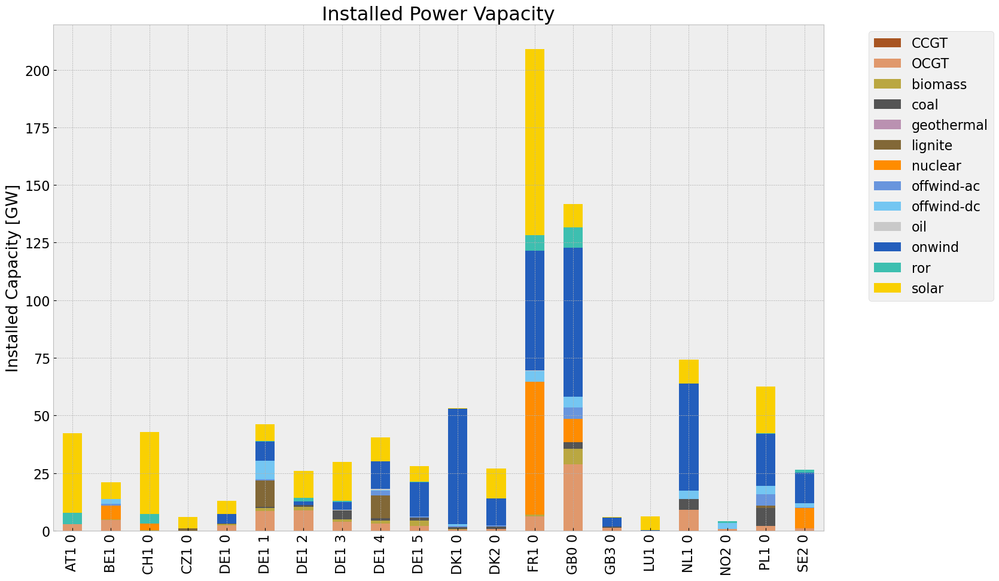

<Figure size 640x480 with 0 Axes>

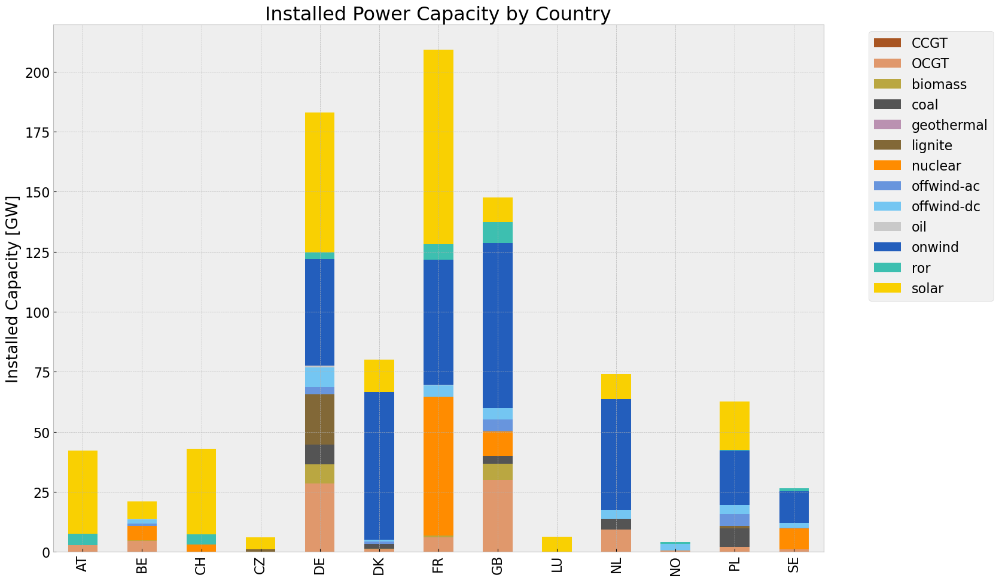

<Figure size 640x480 with 0 Axes>

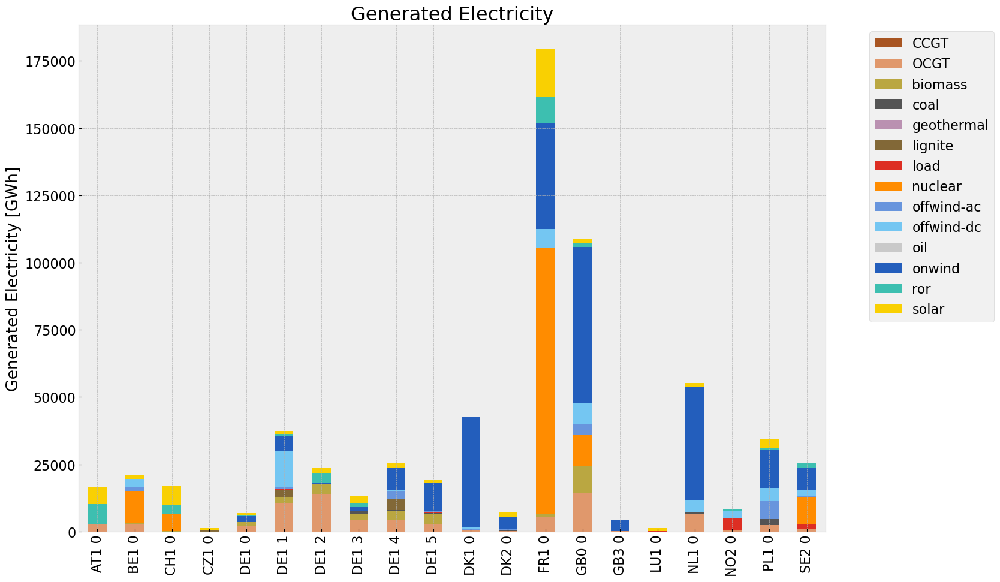

<Figure size 640x480 with 0 Axes>

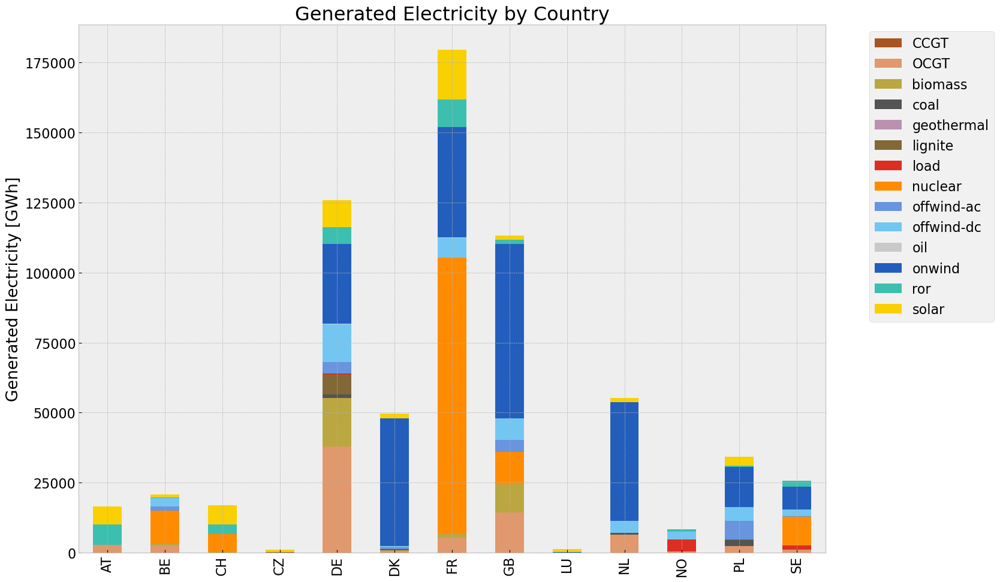

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:23: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  p_by_carrier = p_country.groupby(n.generators.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  sto = sto_ctr.groupby(n.storage_units.carrier, axis=1).sum() #MW
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:45: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  p_by_carrier.index = pd.date_range(start='2030-01-01', end='2030-12-31 21:00:00', freq='3H')
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3440809909.py:51: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  time = pd.date_range(start=start_date, end=end_date, freq='3H')
c:\Users\Jeremy\a

,Generation in MWh,efficiency,emissions in Tonnes CO2/MWh,emissions in Tonnes CO2
carrier,,,,
CCGT,0.000000e+00,0.580000,0.1980,0.000000e+00
OCGT,7.407232e+07,0.451621,0.1980,3.247485e+07
biomass,2.952247e+07,0.468000,0.0000,0.000000e+00
coal,4.561058e+06,0.329908,0.3361,4.646664e+06
geothermal,0.000000e+00,1.000000,0.1200,0.000000e+00
lignite,7.427059e+06,0.337285,0.4069,8.959998e+06
load,6.584710e+06,1.000000,0.0000,0.000000e+00
nuclear,1.386333e+08,0.326600,0.0000,0.000000e+00
offwind-ac,1.742926e+07,1.000000,0.0000,0.000000e+00


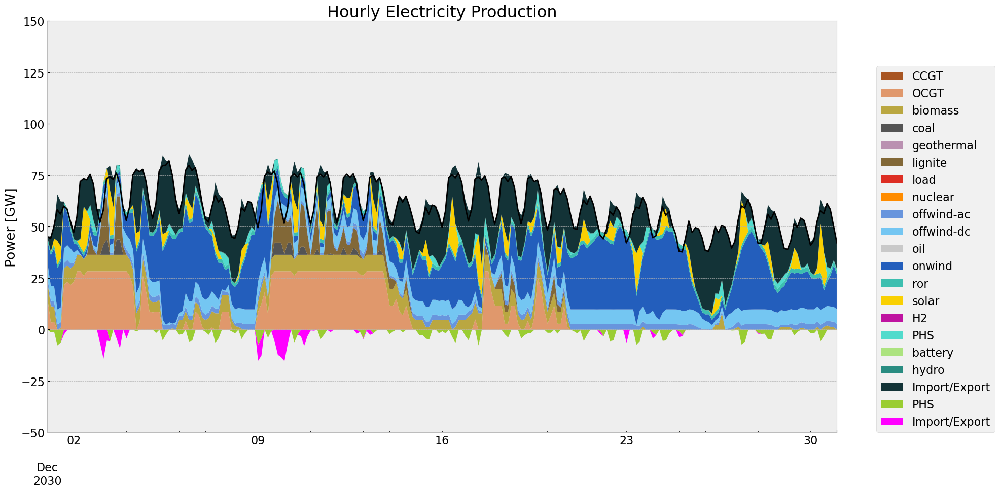

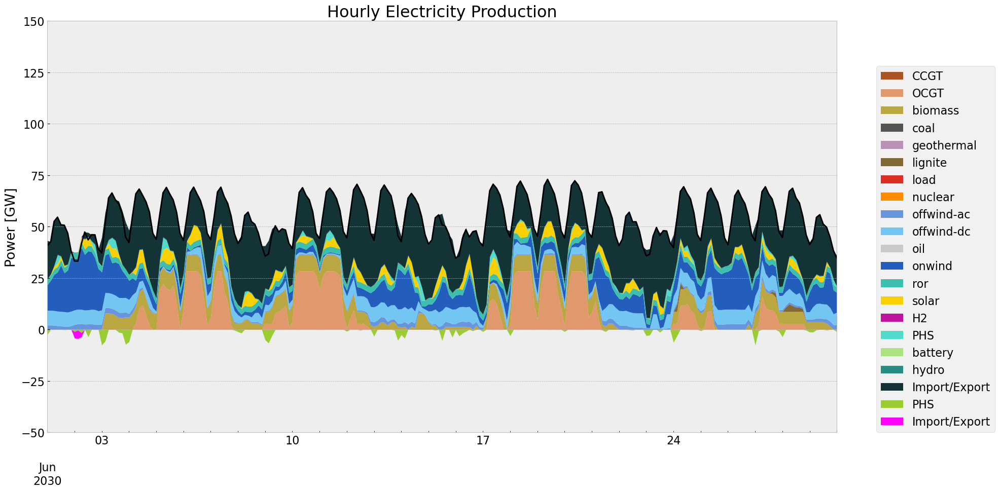

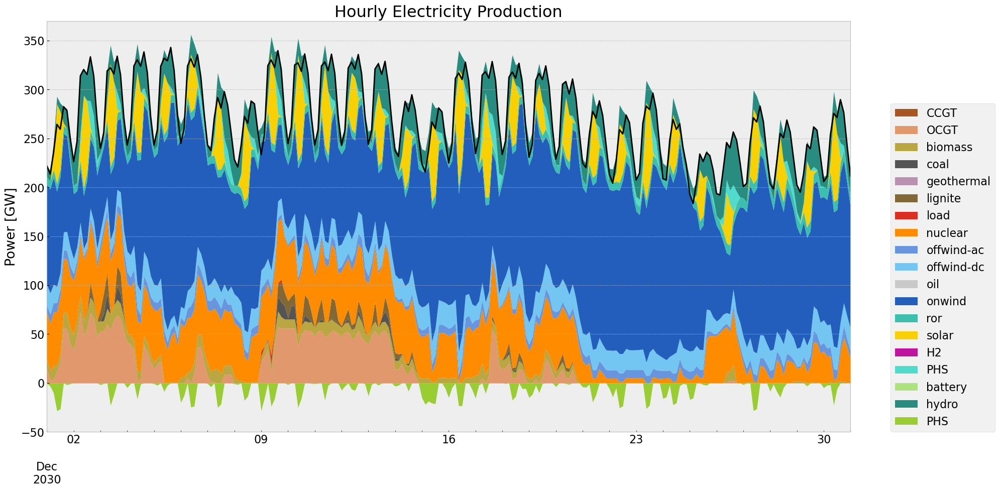

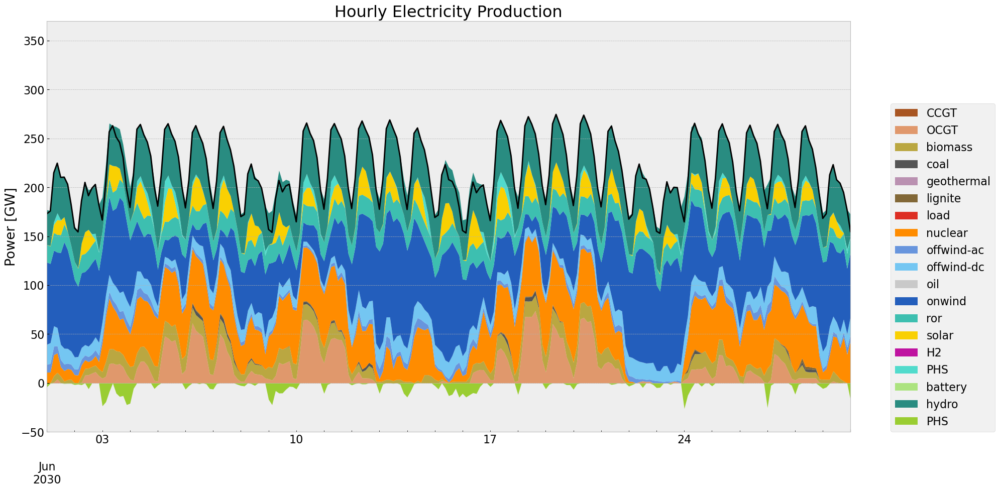

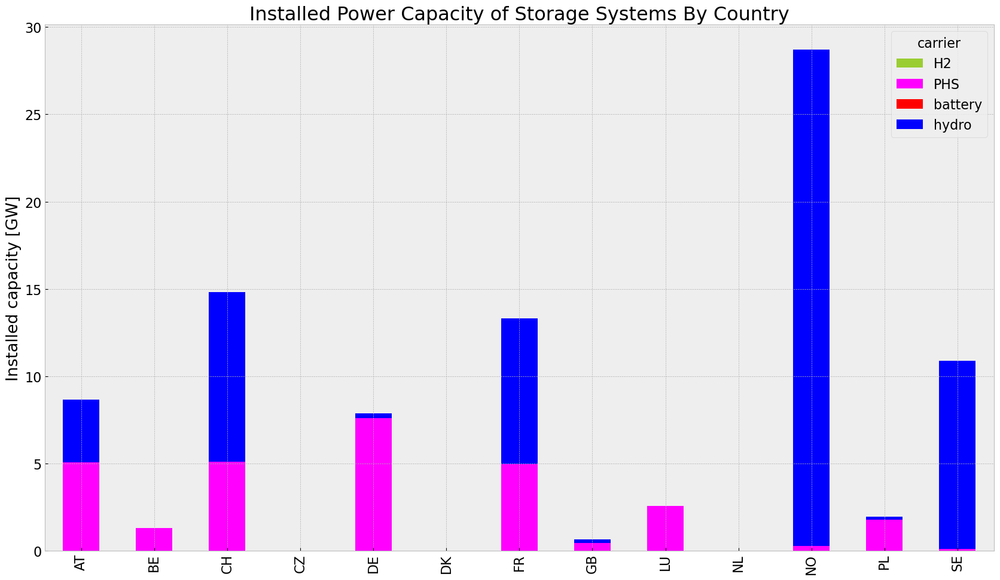

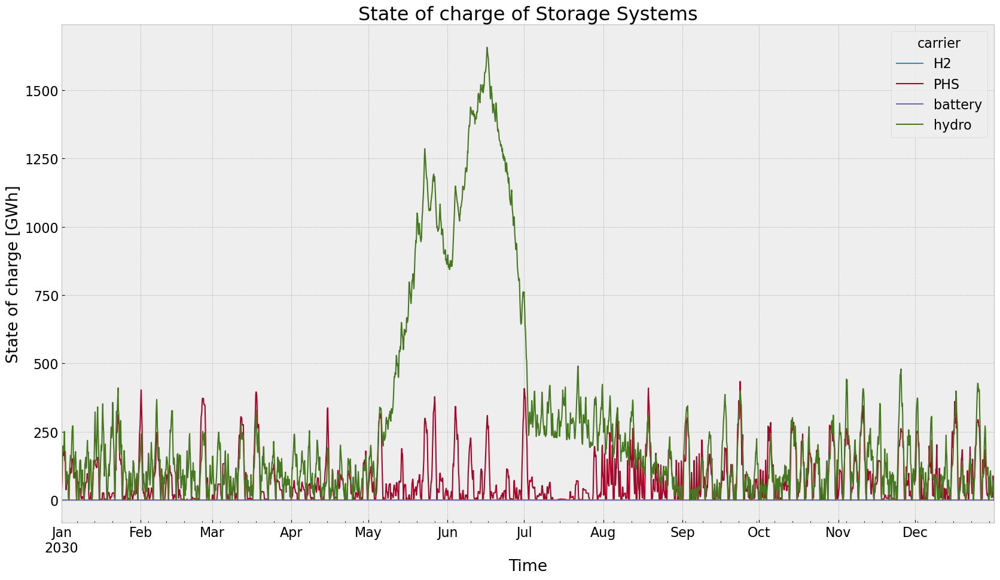

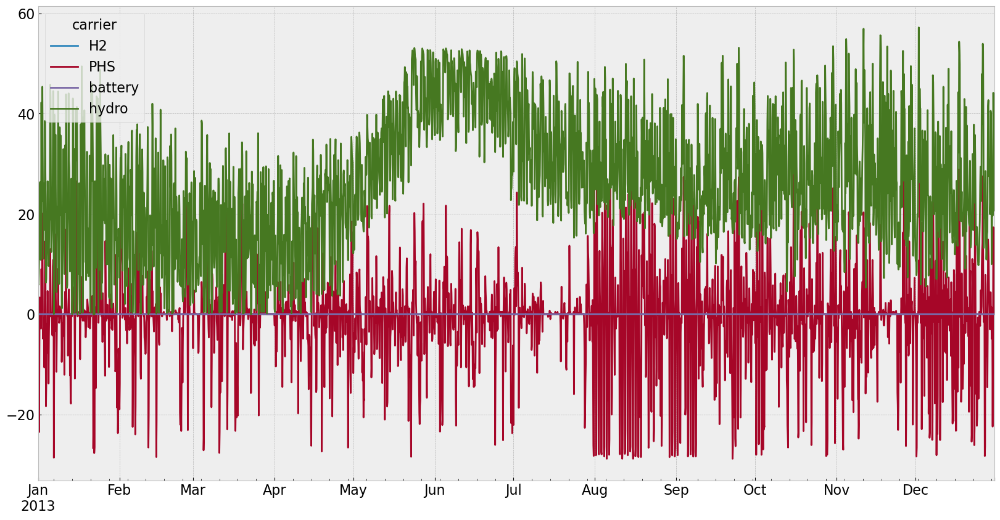

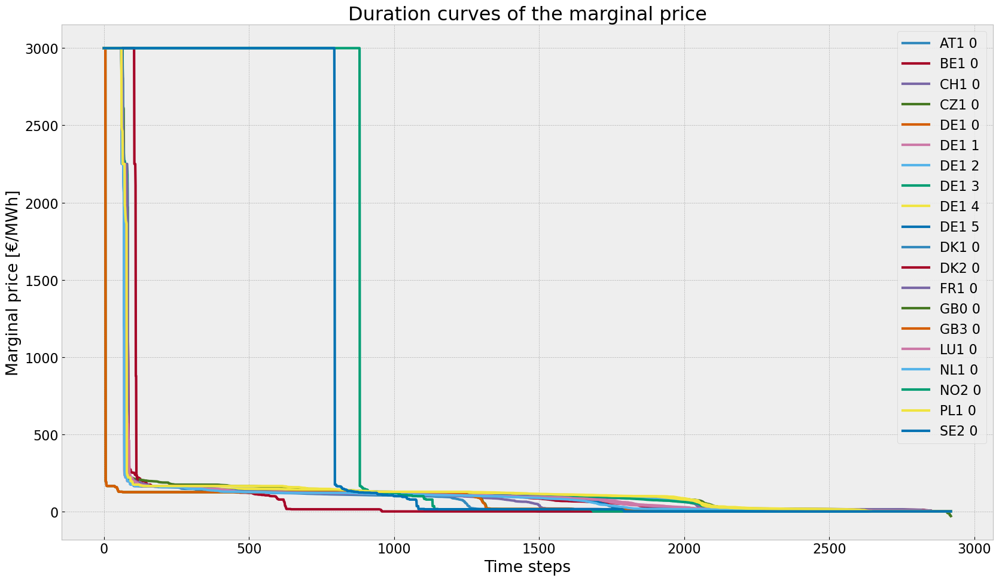

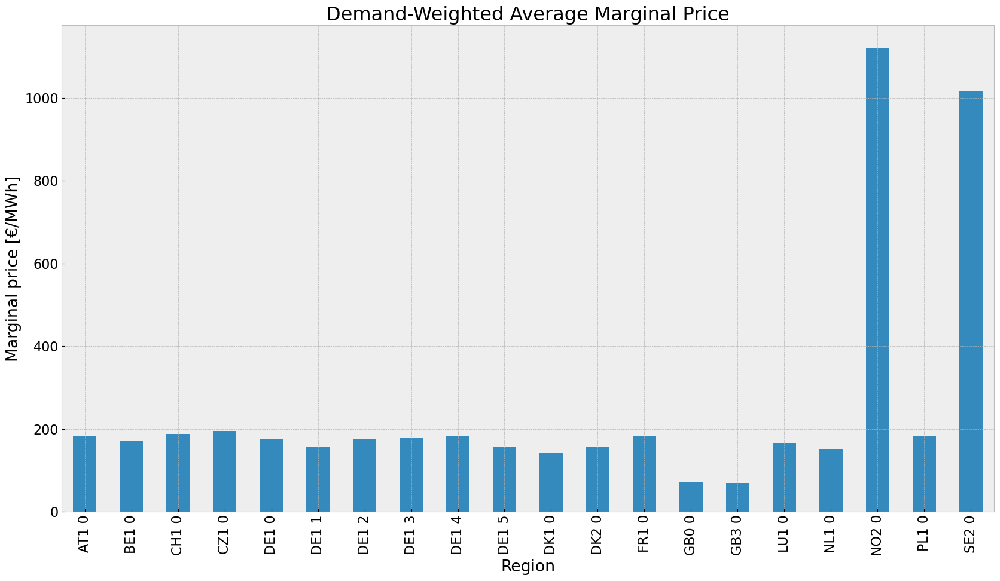

c:\Users\Jeremy\anaconda3\envs\pypsa-eur\Lib\site-packages\cartopy\mpl\style.py:76: UserWarning: facecolor will have no effect as it has been defined as "never".
  warnings.warn('facecolor will have no effect as it has been '


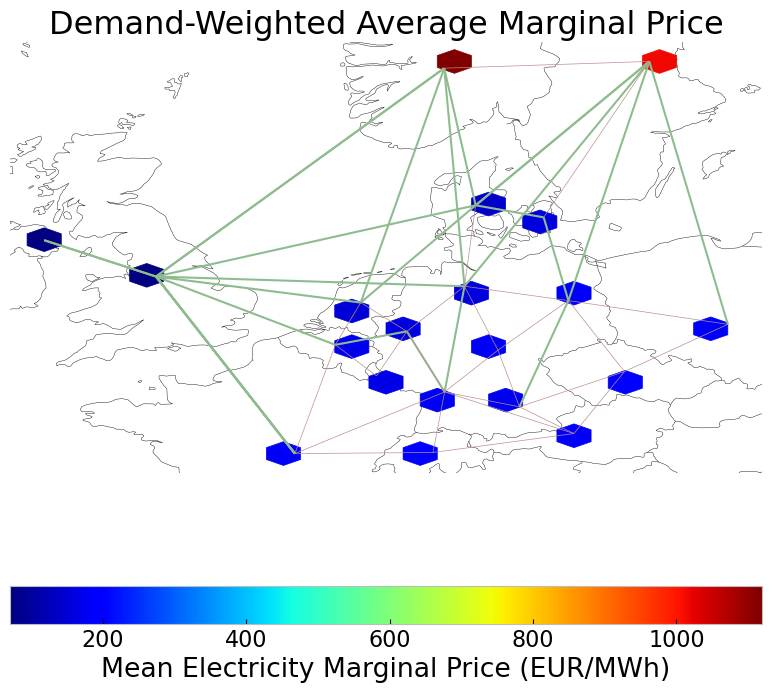

In [271]:
# Plotting
#installed cap
#capacities_noinv_roll = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum()
#capacities_noinv_roll.fillna(0, inplace=True)
#gen = (capacities_noinv_roll.unstack()/1000).drop(columns=['load'],inplace=False)


capacities_inv_roll = inst_cap_table(n4, color_cap)
cap_inv_roll_country = inst_cap_table_country(n4, color_cap)

#Generation table
# consolidated generation table
#carrier = n3.generators.carrier.unique()
#df_tot_generation = n3.generators_t.p.sum()

#generations = pd.Series(index = n3.generators.groupby(['bus', 'carrier']).p_nom_opt.sum().index)

#for r in region:
    #for tech in carrier:
       # key = f"{r} {tech}"
        #if key in df_tot_generation.index:
            #try:
               # generations.loc[r, tech] = df_tot_generation[key]
                #print(generations.loc[r, tech])
            #except KeyError:
                #print('error')
#generations.fillna(0, inplace=True)

#gen_noinv_roll =(generations.unstack()/1000)#GWh

gen_inv_roll  = gen_power_table(n4,colors_gen_table)
gen_inv_roll_country = gen_power_table_country(n4,colors_gen_table)

#Snapshot Summer and Winter
#p = n3.generators_t.p.groupby(n.generators.carrier, axis=1).sum().div(1e3)
#sto = n3.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3)    

gen_curve(n4, '2030-12-01', '2030-12-31', colors_gen,'DE')
gen_curve(n4, '2030-06-01', '2030-06-30', colors_gen,'DE')
#generation curve all countries
#winter
gen_curve_tot(n4, '2030-12-01', '2030-12-31', colors_gen)
#summer
gen_curve_tot(n4, '2030-06-01', '2030-06-30', colors_gen)

#installed storage unit & stores
store_inv_roll = inst_store_table(n4)

#State of Charge Storage unit
state_of_charge_plot(n4)
n4.storage_units_t.p.groupby(n.storage_units.carrier, axis=1).sum().div(1e3).loc[pd.date_range(start="2013-01-01", end="2013-12-31",freq='3H')].plot(figsize=(20,10))


#Electricitty Price duration curve
price_dur_curve_plot(n4)

#avg electricity price
price_regions_table(n4)
price_regions(n4)

#Emission
em_inv_roll =em_table(n4)
em_inv_roll

In [272]:
#e_balance = n3.statistics.energy_balance(aggregate_time=False, aggregate_bus=False).loc[:, :, "AC", :]
#e_balance.head()
#e_balance.to_csv('energy_balance_DE_offwind.csv', sep=',', index=True, header=True, encoding='utf-8')

# Scenario Analysis

## Installed Capacity

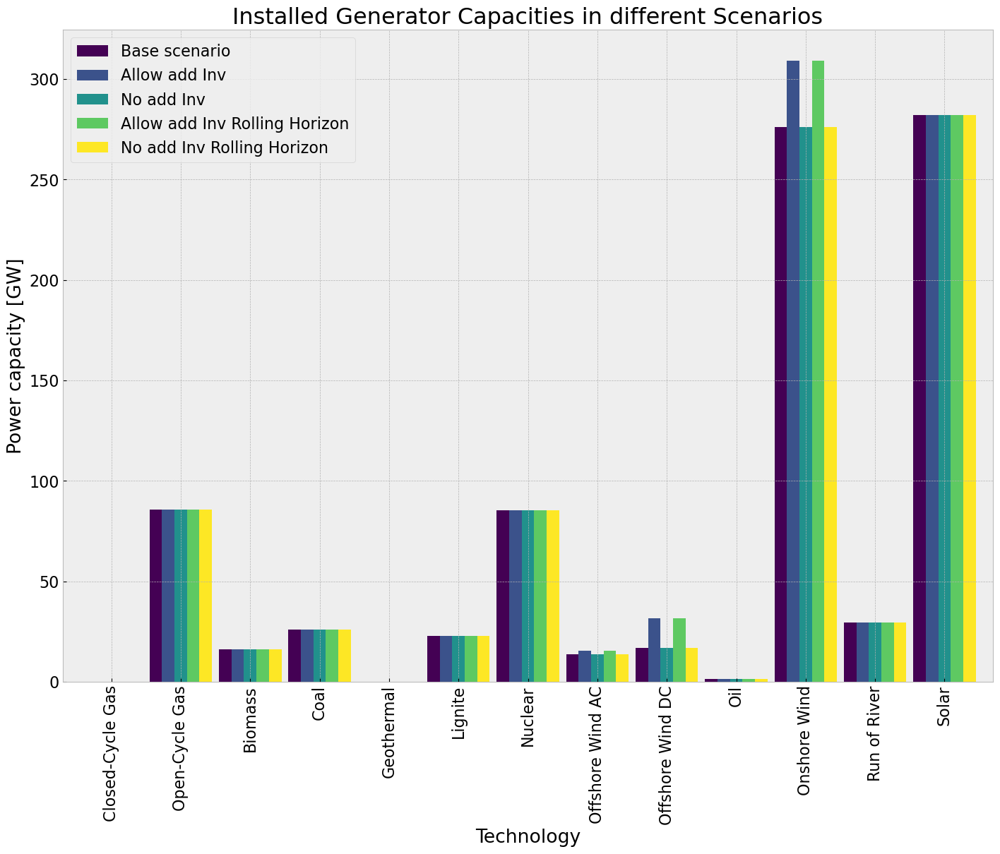

In [273]:
comp_inst_cap = pd.DataFrame(index=capacities_base.unstack().drop(columns=['load'],inplace=False).columns)

comp_inst_cap["Base scenario"] = capacities_base.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv"] = capacities_inv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv"] = capacities_noinv.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["Allow add Inv Rolling Horizon"] = capacities_inv_roll.groupby("carrier").sum().div(1e3).drop(index="load")
comp_inst_cap["No add Inv Rolling Horizon"] = capacities_noinv_roll.groupby("carrier").sum().div(1e3).drop(index="load")

comp_inst_cap.rename(index = {"coal": "Coal"}, inplace=True)
comp_inst_cap.rename(index = {"OCGT": "Open-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"CCGT": "Closed-Cycle Gas"}, inplace=True)
comp_inst_cap.rename(index = {"ror": "Run of River"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-ac": "Offshore Wind AC"}, inplace=True)
comp_inst_cap.rename(index = {"offwind-dc": "Offshore Wind DC"}, inplace=True)
comp_inst_cap.rename(index = {"onwind": "Onshore Wind"}, inplace=True)
comp_inst_cap.rename(index = {"solar": "Solar"}, inplace=True)
comp_inst_cap.rename(index = {"oil": "Oil"}, inplace=True)
comp_inst_cap.rename(index = {"geothermal": "Geothermal"}, inplace=True)
comp_inst_cap.rename(index = {"nuclear": "Nuclear"}, inplace=True)
comp_inst_cap.rename(index = {"biomass": "Biomass"}, inplace=True)
comp_inst_cap.rename(index = {"lignite": "Lignite"}, inplace=True)

comp_inst_cap.fillna(0, inplace=True)

comp_inst_cap.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_cap.columns))),
                        grid=True,
                        xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Generator Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.show()

### Analysis of extendable Generators

Extendable Generators: OCGT, Offshore Wind AC and DC, Onshore Wind, Solar

{'AC': '#70af1d', 'DC': '#8a1caf', 'biomass': '#baa741', 'coal': '#545454', 'lignite': '#826837', 'oil': '#c9c9c9', 'onwind': '#235ebc', 'nuclear': '#ff8c00', 'offwind-dc': '#74c6f2', 'offwind-ac': '#6895dd', 'OCGT': '#e0986c', 'CCGT': '#a85522', 'geothermal': '#ba91b1', 'solar': '#f9d002', 'hydro': '#298c81', 'PHS': '#51dbcc', 'ror': '#3dbfb0', '': '', 'battery': '#ace37f', 'H2': '#bf13a0', 'load': '#dd2e23'}


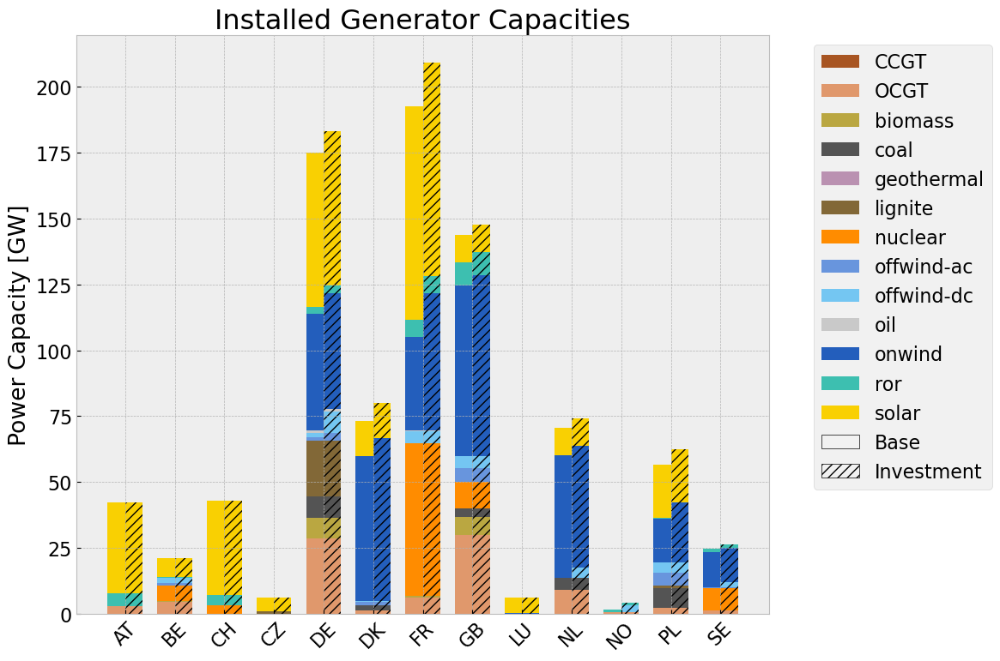

In [274]:
from matplotlib.patches import Patch

color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}
print(color_map)

base = cap_base_country
base.fillna(0, inplace=True)
inv = cap_inv_country
inv.fillna(0, inplace=True)

# Color mapping for generator types
color_map = {row.name: row['color'] for _, row in n.carriers.iterrows()}

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(base.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, base, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, inv, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Generator Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_cap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)


plt.show()

## Power Generation

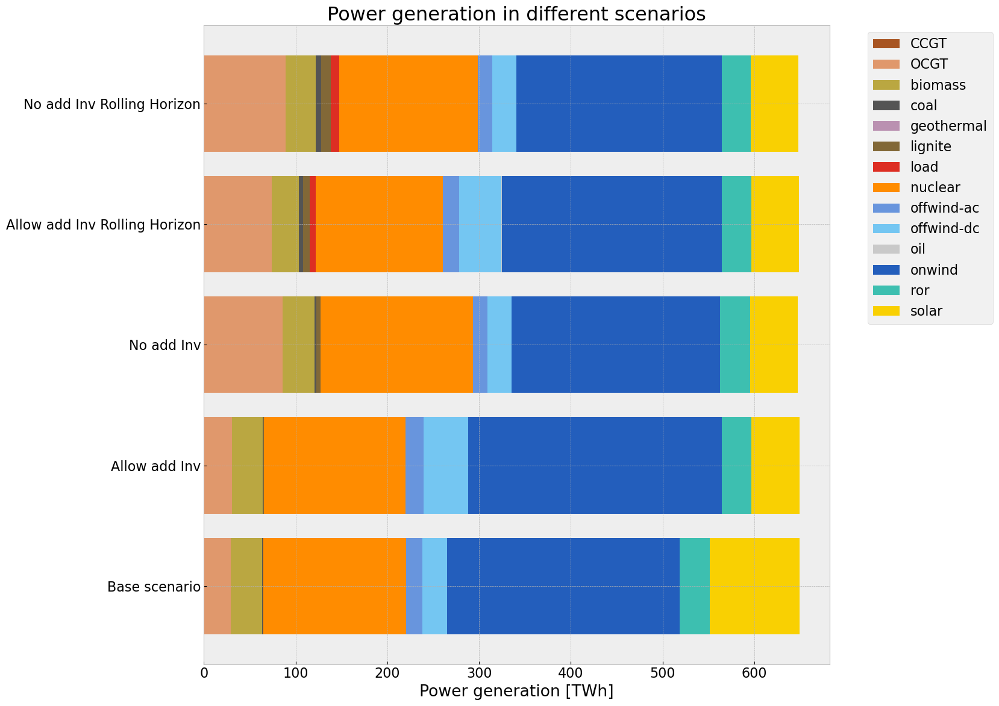

In [275]:
comp_gen_electr = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = tech_list_gen_table)

comp_gen_electr.loc["Base scenario"] = gen_base.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv"] = gen_inv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv"] = gen_noinv.sum().div(1e3) # TWh/a
comp_gen_electr.loc["Allow add Inv Rolling Horizon"] = gen_inv_roll.sum().div(1e3) # TWh/a
comp_gen_electr.loc["No add Inv Rolling Horizon"] = gen_noinv_roll.sum().div(1e3) # TWh/a



#comp_gen_electr.rename(columns = {"coal": "Coal"}, inplace=True)
#comp_gen_electr.rename(columns = {"gas": "Gas"}, inplace=True)
#comp_gen_electr.rename(columns = {"hydro": "Hydro"}, inplace=True)
#comp_gen_electr.rename(columns = {"offwind": "Offshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"onwind": "Onshore Wind"}, inplace=True)
#comp_gen_electr.rename(columns = {"solar": "Solar"}, inplace=True)
#comp_gen_electr.rename(columns = {"oil": "Oil"}, inplace=True)
#comp_gen_electr.rename(columns = {"geothermal": "Geothermal"}, inplace=True)
#comp_gen_electr.rename(columns = {"nuclear": "Nuclear"}, inplace=True)

comp_gen_electr.fillna(0, inplace=True)
comp_gen_electr.plot.barh(figsize=(17,12),
                        color=colors_gen_table,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Power generation [TWh]",
                        title=f"Power generation in different scenarios",
                        #xlim=[0,200],
                        width=0.8
)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_generation.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Installed Storage Capacities

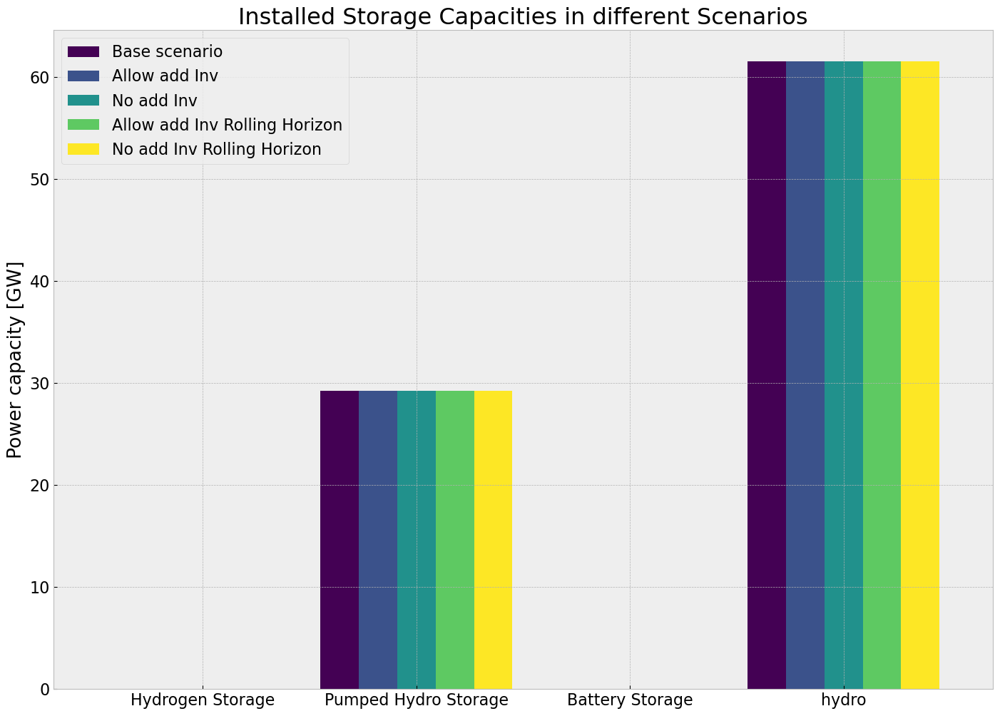

In [276]:
comp_inst_store = pd.DataFrame(index=store_base.unstack().columns)
comp_inst_store.index.name = ''

comp_inst_store["Base scenario"] = store_base.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv.groupby("carrier").sum()
comp_inst_store["No add Inv"] = store_noinv.groupby("carrier").sum()
comp_inst_store["Allow add Inv"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["Allow add Inv Rolling Horizon"] = store_inv_roll.groupby("carrier").sum()
comp_inst_store["No add Inv Rolling Horizon"] = store_noinv_roll.groupby("carrier").sum()

comp_inst_store.rename(index = {"battery": "Battery Storage"}, inplace=True)
comp_inst_store.rename(index = {"H2": "Hydrogen Storage"}, inplace=True)
comp_inst_store.rename(index = {"Hydro": "Reservoir & Dam"}, inplace=True)
comp_inst_store.rename(index = {"PHS": "Pumped Hydro Storage"}, inplace=True)


comp_inst_store.fillna(0, inplace=True)

comp_inst_store.plot.bar(figsize=(17,12),
                        color=cm.viridis(np.linspace(0, 1, len(comp_inst_store.columns))),
                        grid=True,
                        #xlabel="Technology",
                        ylabel="Power capacity [GW]",
                        title=f"Installed Storage Capacities in different Scenarios",
                        #ylim=[0,350],
                        width=0.9
)
plt.xticks(rotation=360, ha='center')
fig.tight_layout()
# Save plot to the current working directory
filename = "analysis_installed_cap.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

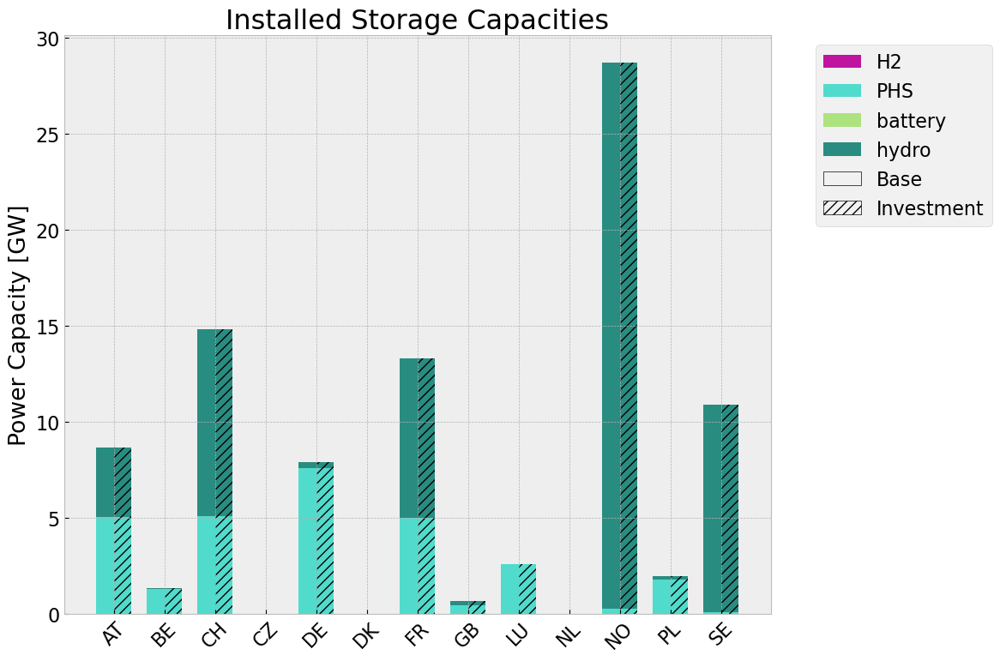

In [277]:
store_base_df = store_base.unstack()
store_inv_df = store_inv.unstack()

store_base_df.fillna(0, inplace=True)
store_inv_df.fillna(0, inplace=True)

# Setting up bar plot parameters
bar_width = 0.35
indices = np.arange(len(store_base_df.index))
base_indices = indices - bar_width / 2  # Shift slightly to the left
inv_indices = indices + bar_width / 2  # Shift slightly to the right

# Plot configuration
fig, ax = plt.subplots(figsize=(12, 8))

# Helper function to plot stacked bars with consistent colors
def plot_stack(ax, index, data, width, label_prefix, hatch_pattern):
    """Helper function to plot stacked bars."""
    bottom = np.zeros(len(index))
    for generator in data.columns:
        color = color_map.get(generator, "#7f7f7f")  # Default to grey if not specified
        ax.bar(index, data[generator], width, bottom=bottom, label=f'{generator}' if index is base_indices else "", color=color, hatch=hatch_pattern)
        bottom += data[generator]

# Plot the base DataFrame (no hatching)
plot_stack(ax, base_indices, store_base_df, bar_width, 'Base', '')

# Plot the inv DataFrame (with hatching)
plot_stack(ax, inv_indices, store_inv_df, bar_width, 'Inv', '///')

# Create custom legend entries for base and inv
custom_legend = [
    Patch(facecolor='none', edgecolor='black', label='Base', hatch=''),
    Patch(facecolor='none', edgecolor='black', label='Investment', hatch='///')
]

# Combine generator-specific legend entries with custom entries for base/inv
handles = ax.get_legend_handles_labels()[0] + custom_legend

# Add legend outside the chart to the right
ax.legend(handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust tick labels and grid
ax.set_title('Installed Storage Capacities')
ax.set_xticks(indices)
ax.set_xticklabels(base.index, rotation=45)
ax.set_ylabel('Power Capacity [GW]')
ax.grid(axis='y', linestyle='--', linewidth=0.5)

# Display the plot
fig.tight_layout()

# Save plot to the current working directory
filename = "analyis_storagecap_base_vs_inv.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()


## System Cost

In [278]:
tech_comp = system_cost_base.index.tolist()
comp_system_cost = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_cost.loc["Base scenario"] = system_cost_base # Million €/a
comp_system_cost.loc["Allow add Inv"] = system_cost_inv # Million €/a
#if tot_cost_0_PV > 0: 
#    comp_system_cost.loc["0% PV potential"] = system_cost_0_PV # Million €/a
#else: comp_system_cost.loc["0% PV potential"] = 0.0
#if tot_cost_20_PV > 0: 
#    comp_system_cost.loc["20% PV potential"] = system_cost_20_PV # Million €/a
#else: comp_system_cost.loc["20% PV potential"] = 0.0
comp_system_cost.loc["No add Inv"] = system_cost_noinv # Million €/a
comp_system_cost.loc["Allow add Inv Rolling Horizon"] = system_cost_inv_roll
comp_system_cost.loc["No add Inv Rolling Horizon"] = system_cost_noinv_roll # Million €/a

#if 'AC' in system_cost_base:
#   comp_system_cost.AC = comp_system_cost.AC-system_cost_base.AC # expenditure for already existing transmission lines

#comp_system_cost[comp_system_cost<0] = 0 # since we subtact the AC cost (for the 0% or 20%) 
comp_system_cost.drop('-', axis=1, inplace=True)
#comp_system_cost.iloc[0,0] = system_cost_base.AC


#comp_system_cost = comp_system_cost   #Million eur0/

#comp_system_cost.rename(columns = {"battery storage": "Battery storage"}, inplace=True)
#comp_system_cost.rename(columns = {"hydrogen storage underground": "Hydrogen storage underground"}, inplace=True)

comp_system_cost.fillna(0, inplace=True)
comp_system_cost = comp_system_cost.div(1e3) # Billion €

#move load shedding to the last col
# Specify the column name to move
column_to_move = 'Load shedding'

# Create a new list of column names without the column to move
new_columns = [col for col in comp_system_cost.columns if col != column_to_move]

# Append the column to move to the end
new_columns.append(column_to_move)

# Reorder the columns
comp_system_cost = comp_system_cost[new_columns]


C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3411115089.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3411115089.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


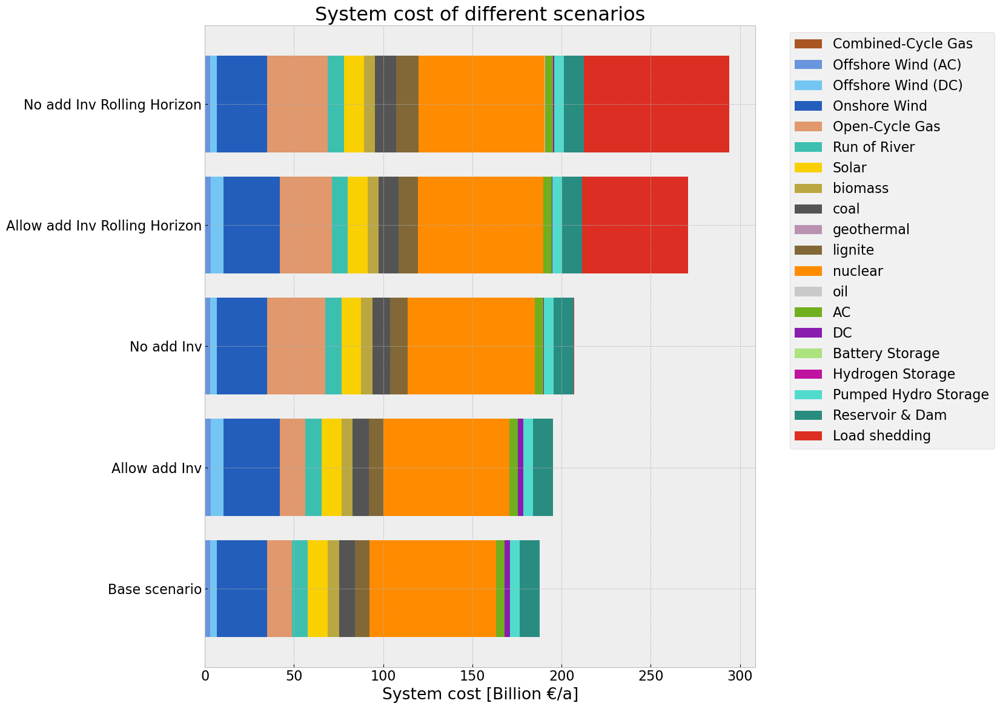

In [279]:
colors_comp = []

for i in range(len(comp_system_cost.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_system_cost.columns[i] == n.carriers.nice_name[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_cost.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="System cost [Billion €/a]",
                        title=f"System cost of different scenarios",
                        #xlim=[0,100],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_system_cost.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)

plt.show()

## Curtailment

In [280]:
comp_curtailment = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns = stat_base.loc["Generator"].index)

comp_curtailment.loc["Base scenario"] = stat_base.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv"] = stat_inv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv"] = stat_noinv.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["Allow add Inv Rolling Horizon"] = stat_inv_roll.loc["Generator"].Curtailment.div(1e6) # TWh
comp_curtailment.loc["No add Inv Rolling Horizon"] = stat_noinv_roll.loc["Generator"].Curtailment.div(1e6) # TWh

comp_curtailment.fillna(0, inplace=True)

In [281]:
color_curtailment=[]

for i in range(len(comp_curtailment.columns)):
    for j in range(len(n.carriers.nice_name)):
        if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
            color_curtailment.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found 

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3109801822.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  if comp_curtailment.columns[i] == n.carriers.nice_name[j]:
C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\3109801822.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color_curtailment.append(n.carriers.color[j])


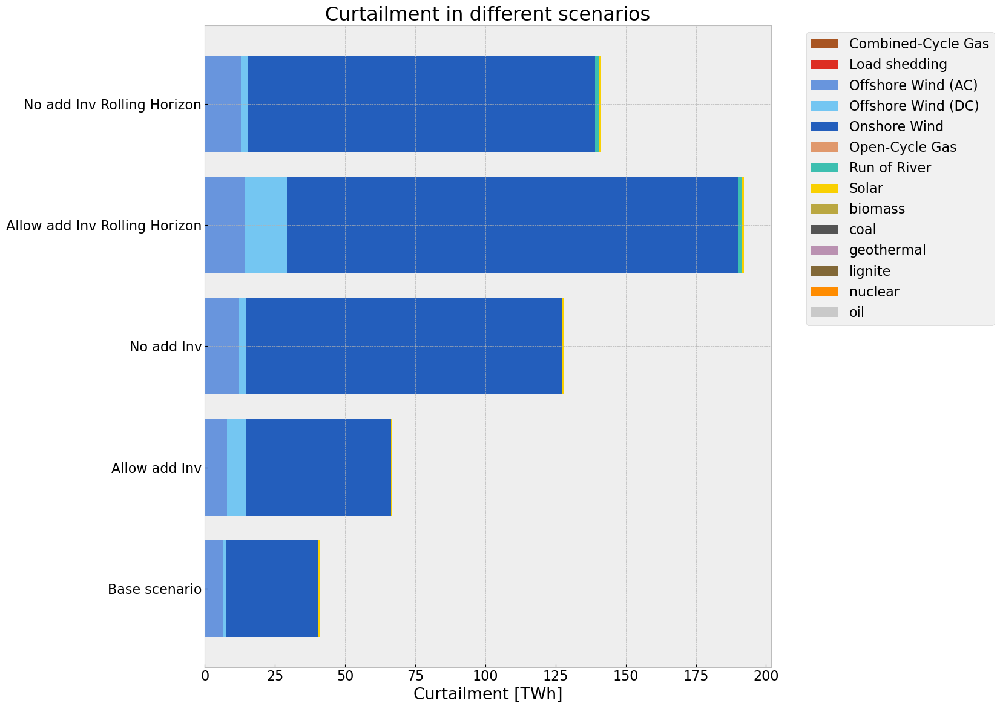

In [282]:
comp_curtailment.plot.barh(figsize=(17,12),
                        color=color_curtailment,
                        grid=True,
                        stacked=True, 
                        ylabel="",
                        xlabel="Curtailment [TWh]",
                        title=f"Curtailment in different scenarios",
                        #xlim=[0,120],
                        width=0.8
)
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_curtailment.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()

## Emission

C:\Users\Jeremy\AppData\Local\Temp\ipykernel_228\1032422005.py:20: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  colors_comp.append(n.carriers.color[j])


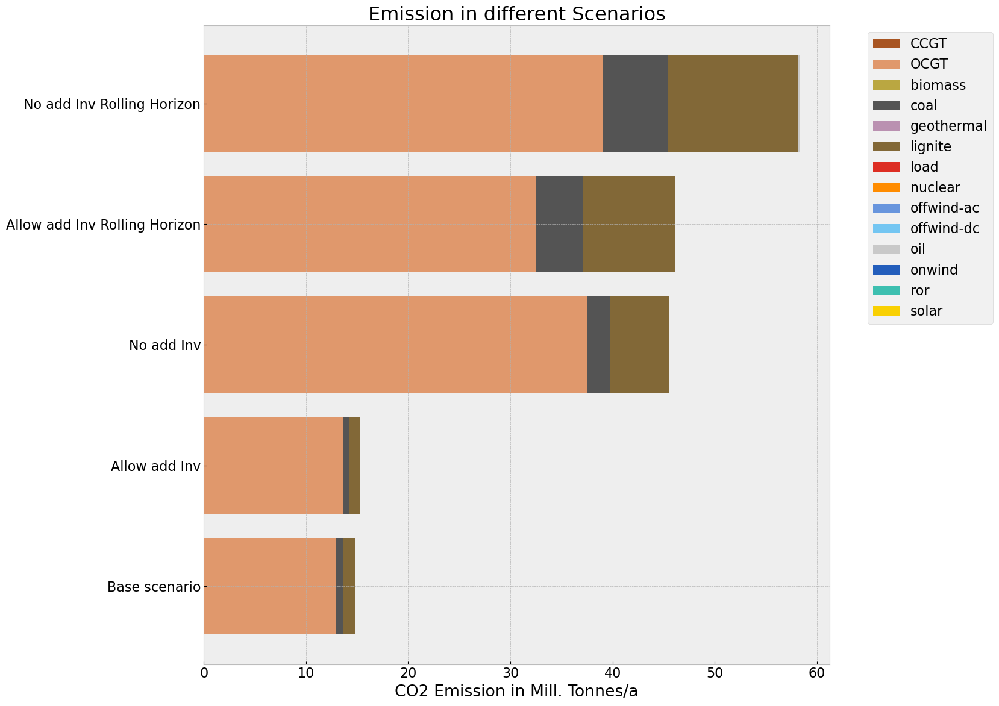

In [283]:
tech_comp = em_base.index.tolist()
comp_system_em = pd.DataFrame(index = ["Base scenario", "Allow add Inv", "No add Inv", "Allow add Inv Rolling Horizon","No add Inv Rolling Horizon"],
                                columns =tech_comp)

#demand = n.snapshot_weightings.generators @ n.loads_t.p_set.sum(axis=1) # the same in each scenario

comp_system_em.loc["Base scenario"] = em_base['emissions in Tonnes CO2']/1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv"] = em_inv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv"] = em_noinv['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["Allow add Inv Rolling Horizon"] = em_inv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a
comp_system_em.loc["No add Inv Rolling Horizon"] = em_noinv_roll['emissions in Tonnes CO2'] /1e6 # Mill. Tonnes CO2 /a

comp_system_em.fillna(0, inplace=True)

colors_comp = []

for i in range(len(comp_system_em.columns)):
    for j in range(len(n.carriers.index)):
        if comp_system_em.columns[i] == n.carriers.index[j]:
            colors_comp.append(n.carriers.color[j])
            #print(n.carriers.nice_name[j],comp_system_cost.columns[i],n.carriers.color[j])
            break  # break the inner loop once a match is found  



comp_system_em.plot.barh(figsize=(17,12),
                        color=colors_comp,
                        grid=True,
                        stacked=True,
                        ylabel="",
                        xlabel="CO2 Emission in Mill. Tonnes/a",
                        title=f"Emission in different Scenarios",
                        #xlim=[0,100],
                        width=0.8
)
#global_constraint
#plt.axvline(x=n.global_constraints.loc['CO2Limit','constant']/1e6, color='r', linestyle='-', linewidth=2, label='CO2 cap')
# Move legend outside of the plot
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# Save plot to the current working directory
filename = "analysis_emission.png"
output_path = os.path.join(os.getcwd(), filename)
plt.savefig(output_path)
plt.show()